In [30]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [31]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [32]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[798, 4016, 9861, 382, 6967, 4160, 4766, 6283, 7552, 1943, 6726, 1398, 4866, 7186, 2384, 8818, 5509, 3748, 1616, 7878]
log initialized
Average similarity between family members is 0.9661794552540458 at temperature -1
Average similarity between family and home is 0.9998612656511406 at temperature -1
Average similarity between students and their classroom is 0.7617409763419309 at temperature -1
Average classroom occupancy is 4.841269841269841 and number classrooms is 63
Average similarity between workers is 0.95591962208219 at temperature -1
Average office occupancy is 3.6055555555555556 and number offices is 180
Average friend similarity for adults: 0.860781143604935 for kids: 0.7310588499467698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.7227219475263098
avg restaurant similarity 0.5866955439843148
avg restaurant similarity 0.89531225114654
avg restaurant similarity 0.61408105815082
avg restaurant similarity 0.4383667987505185
avg restaurant similarity 0.6980417976460687
avg restaurant similarity 0.587440581435938
avg restaurant similarity 0.8198237700274486
avg restaurant similarity 0.5090069585958131
avg restaurant similarity 0.628573655519227
avg restaurant similarity 0.6942275009630593
avg restaurant similarity 0.5962937789964131
avg restaurant similarity 0.5552927008514392
avg restaurant similarity 0.6095668437942231
avg restaurant similarity 0.6303394846187457
avg restaurant similarity 0.554978459161761
avg restaurant similarity 0.5445315447154411
avg restaurant similarity 0.5905842379706666
avg restaurant similarity 0.6093259148018015
avg restaurant similarity 0.6553308246321714
avg restaurant similarity 0.7126176797751521
avg restaurant similarity 0.6917087896754497
avg restaurant si

avg restaurant similarity 0.5709144192933411
avg restaurant similarity 0.5416167924288949
avg restaurant similarity 0.5315568075168848
avg restaurant similarity 0.5575841243039008
avg restaurant similarity 0.5660221813645124
avg restaurant similarity 0.7135879453123151
avg restaurant similarity 0.6918131787860691
avg restaurant similarity 0.5963711171756444
avg restaurant similarity 0.6350456625467356
avg restaurant similarity 0.6276163475743982
avg restaurant similarity 0.5754692477182232
avg restaurant similarity 0.7247939636929388
avg restaurant similarity 0.6199031924391177
avg restaurant similarity 0.6725806756387539
avg restaurant similarity 0.6474885665359463
avg restaurant similarity 0.6836478225340561
avg restaurant similarity 0.6159126610489165
avg restaurant similarity 0.7429236668355599
avg restaurant similarity 0.5136375798467161
avg restaurant similarity 0.41351114972110886
avg restaurant similarity 0.6736817389789218
avg restaurant similarity 0.6580456628488058
avg resta

avg restaurant similarity 0.5767059449584688
avg restaurant similarity 0.7343618534772846
avg restaurant similarity 0.8821047584628194
avg restaurant similarity 0.5668694742938067
avg restaurant similarity 0.6304095313970496
avg restaurant similarity 0.5538854968321538
avg restaurant similarity 0.5869581126943396
avg restaurant similarity 0.7196996628175328
avg restaurant similarity 0.6119332856690808
avg restaurant similarity 0.6486371400369116
avg restaurant similarity 0.687912327867077
avg restaurant similarity 0.6167370138967895
avg restaurant similarity 0.6564462090094374
avg restaurant similarity 0.702135031320297
avg restaurant similarity 0.9997691381852842
avg restaurant similarity 0.4749625322550345
avg restaurant similarity 0.6914956880427662
avg restaurant similarity 0.34439301805313227
avg restaurant similarity 0.5504149822380343
avg restaurant similarity 0.6116414430584263
avg restaurant similarity 0.49625154941609556
avg restaurant similarity 0.5334572842176595
avg restau

avg restaurant similarity 0.6349157237812458
avg restaurant similarity 0.6070040940691573
avg restaurant similarity 0.5385191197238182
avg restaurant similarity 0.5019329282719435
avg restaurant similarity 0.6782515867166105
avg restaurant similarity 0.4738154929033995
avg restaurant similarity 0.627260705688932
avg restaurant similarity 0.6856792666613294
avg restaurant similarity 0.762262438356188
avg restaurant similarity 0.6169830102125956
avg restaurant similarity 0.6396961187592138
avg restaurant similarity 0.6794859842211981
avg restaurant similarity 0.4113176894457002
avg restaurant similarity 0.6761373974569284
avg restaurant similarity 0.6748634632242059
avg restaurant similarity 0.4038392112049517
avg restaurant similarity 0.6903101969377562
avg restaurant similarity 0.6510963765796137
avg restaurant similarity 0.7777745889454308
avg restaurant similarity 0.5427942704860406
avg restaurant similarity 0.8830441644533896
avg restaurant similarity 0.548646497589131
avg restauran

avg restaurant similarity 0.6458082431638397
avg restaurant similarity 0.5833089983083612
avg restaurant similarity 0.6460684790002514
avg restaurant similarity 0.6425204687440796
avg restaurant similarity 0.6568673138403608
avg restaurant similarity 0.6222041649597503
avg restaurant similarity 0.6862938240610319
avg restaurant similarity 0.5921159013159271
avg restaurant similarity 0.6948108060409485
avg restaurant similarity 0.691865752883244
avg restaurant similarity 0.6618871501162817
avg restaurant similarity 0.7904041139983359
avg restaurant similarity 0.6244027361845402
avg restaurant similarity 0.7516783619703109
avg restaurant similarity 0.7284062026564584
avg restaurant similarity 0.5618043386756059
avg restaurant similarity 0.5519419088578953
avg restaurant similarity 0.7013304049861228
avg restaurant similarity 0.7853274017448169
avg restaurant similarity 0.6832828041694992
avg restaurant similarity 0.7842155159661389
avg restaurant similarity 0.6834811582407391
avg restaur

avg restaurant similarity 0.7963481762754906
avg restaurant similarity 0.646121174973509
avg restaurant similarity 0.620153615630428
avg restaurant similarity 0.7072542300735104
avg restaurant similarity 0.6585721754914188
avg restaurant similarity 0.5532289592407226
avg restaurant similarity 0.725094074503945
avg restaurant similarity 0.6857936159541048
avg restaurant similarity 0.5968842319895955
avg restaurant similarity 0.6191373924318967
avg restaurant similarity 0.6444159507692249
avg restaurant similarity 0.645559099861689
avg restaurant similarity 0.584870235289388
avg restaurant similarity 0.735922184733009
avg restaurant similarity 0.6492966063592674
avg restaurant similarity 0.6659822927563348
avg restaurant similarity 0.5800175682581006
avg restaurant similarity 0.6446899800889174
avg restaurant similarity 0.751801970146056
avg restaurant similarity 0.6222365705814824
avg restaurant similarity 0.5980932786552134
avg restaurant similarity 0.6183099849926166
avg restaurant si

avg restaurant similarity 0.7753624285262163
avg restaurant similarity 0.5846756119250129
avg restaurant similarity 0.7188945202830717
avg restaurant similarity 0.6480645707125899
avg restaurant similarity 0.744376329247119
avg restaurant similarity 0.727778544108727
avg restaurant similarity 0.7141660167413801
avg restaurant similarity 0.6097559537744877
avg restaurant similarity 0.6413881945290549
avg restaurant similarity 0.9537673864410523
avg restaurant similarity 0.6154296285722459
avg restaurant similarity 0.694297367964877
avg restaurant similarity 0.5572768967397829
avg restaurant similarity 0.5715413336976443
avg restaurant similarity 0.5331874001457241
avg restaurant similarity 0.6956581231891489
avg restaurant similarity 0.6849205183101453
avg restaurant similarity 0.7776113099068016
avg restaurant similarity 0.5791081618291865
avg restaurant similarity 0.6630818486058774
avg restaurant similarity 0.7829528249456359
avg restaurant similarity 0.6650244125041157
avg restauran

avg restaurant similarity 0.5345072749891595
avg restaurant similarity 0.6541639636570296
avg restaurant similarity 0.7517292599049566
avg restaurant similarity 0.5326027164239522
avg restaurant similarity 0.6368814174581777
avg restaurant similarity 0.5161143890458852
avg restaurant similarity 0.7380708055505049
avg restaurant similarity 0.6694419391120418
avg restaurant similarity 0.6071317346709338
avg restaurant similarity 0.6355388787647751
avg restaurant similarity 0.718062795071327
avg restaurant similarity 0.6529130498353246
avg restaurant similarity 0.6974239252714746
avg restaurant similarity 0.6902980845304809
avg restaurant similarity 0.5963190268698291
avg restaurant similarity 0.5406510545253446
avg restaurant similarity 0.6673235485419557
avg restaurant similarity 0.6099692142806904
avg restaurant similarity 0.4294021284566304
avg restaurant similarity 0.5429574943580507
avg restaurant similarity 0.6741786209065892
avg restaurant similarity 0.4291292209449162
avg restaur

avg restaurant similarity 0.5713171973314704
avg restaurant similarity 0.4941124295862801
avg restaurant similarity 0.5151150601605272
avg restaurant similarity 0.7412080863637963
avg restaurant similarity 0.48570476522550576
avg restaurant similarity 0.5230411033596125
avg restaurant similarity 0.6861892137994177
avg restaurant similarity 0.6070049874903012
avg restaurant similarity 0.426980368739393
avg restaurant similarity 0.5209249981552898
avg restaurant similarity 0.7383356477956072
avg restaurant similarity 0.6333378833884745
avg restaurant similarity 0.471063457700014
avg restaurant similarity 0.5254819733330399
avg restaurant similarity 0.49249162541023866
avg restaurant similarity 0.44270702485301183
avg restaurant similarity 0.5701184508520076
avg restaurant similarity 0.5567693522414526
avg restaurant similarity 0.5358086150633823
avg restaurant similarity 0.7739306953999252
avg restaurant similarity 0.6866753445401093
avg restaurant similarity 0.5425935197143518
avg resta

avg restaurant similarity 0.537030233496451
avg restaurant similarity 0.4733789692593723
avg restaurant similarity 0.6495563277677135
avg restaurant similarity 0.6571455860438232
avg restaurant similarity 0.4254862637643965
avg restaurant similarity 0.4941124295862801
avg restaurant similarity 0.4505750558370076
avg restaurant similarity 0.6248425518559745
avg restaurant similarity 0.6050000598085835
avg restaurant similarity 0.5624899775160265
avg restaurant similarity 0.6686149624538796
avg restaurant similarity 0.6580391963595529
avg restaurant similarity 0.5115956133329211
avg restaurant similarity 0.5597995479058441
avg restaurant similarity 0.827084472437943
avg restaurant similarity 0.6540672296805827
avg restaurant similarity 0.6884052847714559
avg restaurant similarity 0.480324182409543
avg restaurant similarity 0.571552443455349
avg restaurant similarity 0.6040075183319937
avg restaurant similarity 0.5363031760502068
avg restaurant similarity 0.4831840686850789
avg restaurant

avg restaurant similarity 0.6675717312165822
avg restaurant similarity 0.7945746166651014
avg restaurant similarity 0.5493407877795079
avg restaurant similarity 0.7474243852810154
avg restaurant similarity 0.5392001184889926
avg restaurant similarity 0.5781654626237993
avg restaurant similarity 0.7026089034037127
avg restaurant similarity 0.6642176103697384
avg restaurant similarity 0.7325268266163532
avg restaurant similarity 0.7855177320949656
avg restaurant similarity 0.5938402263636603
avg restaurant similarity 0.5953126712555451
avg restaurant similarity 0.7061476270899619
avg restaurant similarity 0.7940780437937952
avg restaurant similarity 0.5334397325895684
avg restaurant similarity 0.6159311058726
avg restaurant similarity 0.7165025280041392
avg restaurant similarity 0.7054630054787114
avg restaurant similarity 0.6568375571186248
avg restaurant similarity 0.6460258624398543
avg restaurant similarity 0.6498299262121243
avg restaurant similarity 0.63449243887014
avg restaurant 

avg restaurant similarity 0.5205022884339836
avg restaurant similarity 0.6478796272313156
avg restaurant similarity 0.5984035594380641
avg restaurant similarity 0.7733500293472603
avg restaurant similarity 0.7074359601412895
avg restaurant similarity 0.4635728922984997
avg restaurant similarity 0.5786449271320079
avg restaurant similarity 0.7445594639759472
avg restaurant similarity 0.7975132558931122
avg restaurant similarity 0.5683944474134444
avg restaurant similarity 0.6237588786417921
avg restaurant similarity 0.6483686568482724
avg restaurant similarity 0.500635586170075
avg restaurant similarity 0.6392050931401816
avg restaurant similarity 0.4879326672128664
avg restaurant similarity 0.6144385044813557
avg restaurant similarity 0.6486666134551506
avg restaurant similarity 0.5822122783997036
avg restaurant similarity 0.6184875075687194
avg restaurant similarity 0.8661546228165888
avg restaurant similarity 0.5876287260377575
avg restaurant similarity 0.6063926933475491
avg restaur

avg restaurant similarity 0.6705433495142819
avg restaurant similarity 0.66730144542835
avg restaurant similarity 0.5662635426557352
avg restaurant similarity 0.6203027871072437
avg restaurant similarity 0.6344014130725123
avg restaurant similarity 0.6509669577275096
avg restaurant similarity 0.5948041967616146
avg restaurant similarity 0.6480879658531826
avg restaurant similarity 0.5433343084656528
avg restaurant similarity 0.7903372462670095
avg restaurant similarity 0.7669228224032816
avg restaurant similarity 0.7388782085450576
avg restaurant similarity 0.6349353285673771
avg restaurant similarity 0.5771891756986626
avg restaurant similarity 0.535957295414688
avg restaurant similarity 0.5321654717213188
avg restaurant similarity 0.7318434769833356
avg restaurant similarity 0.47960490445900966
avg restaurant similarity 0.5123189682078867
avg restaurant similarity 0.4345698174850874
avg restaurant similarity 0.6642814283610328
avg restaurant similarity 0.5219445949875344
avg restaura

avg restaurant similarity 0.8916742051905707
avg restaurant similarity 0.594792882352031
avg restaurant similarity 0.7176616608765096
avg restaurant similarity 0.7391297083788995
avg restaurant similarity 0.7411617309437518
avg restaurant similarity 0.6459186496583492
avg restaurant similarity 0.8076873305992753
avg restaurant similarity 0.43909860809345524
avg restaurant similarity 0.6452993133836403
avg restaurant similarity 0.6080879301398402
avg restaurant similarity 0.582960904340655
avg restaurant similarity 0.7765178900520615
avg restaurant similarity 0.6321652635070252
avg restaurant similarity 0.6123264877010911
avg restaurant similarity 0.5855539921217157
avg restaurant similarity 0.6553063911203164
avg restaurant similarity 0.6298801999181706
avg restaurant similarity 0.7482795723827462
avg restaurant similarity 0.7042951756956827
avg restaurant similarity 0.6517161379201841
avg restaurant similarity 0.7864317171569554
avg restaurant similarity 0.7226910458074556
avg restaur

avg restaurant similarity 0.6831822035492078
avg restaurant similarity 0.6943243959087037
avg restaurant similarity 0.60617959638826
avg restaurant similarity 0.49287741872050783
avg restaurant similarity 0.6647736644863997
avg restaurant similarity 0.53529688509452
avg restaurant similarity 0.8119056322059784
avg restaurant similarity 0.9997635625084356
avg restaurant similarity 0.3117408186925202
avg restaurant similarity 0.6833928032743125
avg restaurant similarity 0.7595094833481265
avg restaurant similarity 0.46834879162174337
avg restaurant similarity 0.6123090531345153
avg restaurant similarity 0.4167721192599065
avg restaurant similarity 0.6299953251435964
avg restaurant similarity 0.4492341808761522
avg restaurant similarity 0.5541660139584266
avg restaurant similarity 0.45869335182678306
avg restaurant similarity 0.5229746752180735
avg restaurant similarity 0.6502631070750662
avg restaurant similarity 0.6711684338474873
avg restaurant similarity 0.6114477212180834
avg restaur

avg restaurant similarity 0.685306905664761
avg restaurant similarity 0.5255327459923939
avg restaurant similarity 0.4946912945254038
avg restaurant similarity 0.509045424354582
avg restaurant similarity 0.49055415657486723
avg restaurant similarity 0.8326097321774317
avg restaurant similarity 0.625538233353198
avg restaurant similarity 0.6167013657108611
avg restaurant similarity 0.4235559358134835
avg restaurant similarity 0.5323609051632617
avg restaurant similarity 0.6747719502104128
avg restaurant similarity 0.6083441823809312
avg restaurant similarity 0.7325628610872416
avg restaurant similarity 0.6669400097866667
avg restaurant similarity 0.49125850695169043
avg restaurant similarity 0.5168555465407828
avg restaurant similarity 0.5435575425321498
avg restaurant similarity 0.529676430351342
avg restaurant similarity 0.47286190865393923
avg restaurant similarity 0.5117038589462144
avg restaurant similarity 0.47844448317273724
avg restaurant similarity 0.3739027712018216
avg restau

avg restaurant similarity 0.6495081959458939
avg restaurant similarity 0.7418613736910055
avg restaurant similarity 0.759495120609091
avg restaurant similarity 0.5907590632140058
avg restaurant similarity 0.6654300777340774
avg restaurant similarity 0.6646480807421867
avg restaurant similarity 0.6839180043625563
avg restaurant similarity 0.6161939811781426
avg restaurant similarity 0.5351110089150807
avg restaurant similarity 0.569456265223032
avg restaurant similarity 0.7093775369341307
avg restaurant similarity 0.5947677472594545
avg restaurant similarity 0.7103244672498331
avg restaurant similarity 0.6618105681656703
avg restaurant similarity 0.6708984204346938
avg restaurant similarity 0.49620175045466447
avg restaurant similarity 0.6599580609816804
avg restaurant similarity 0.7378423994134063
avg restaurant similarity 0.4693964289002907
avg restaurant similarity 0.4182433328062574
avg restaurant similarity 0.6213060379273581
avg restaurant similarity 0.5423101918423259
avg restaur

avg restaurant similarity 0.6819715379508621
avg restaurant similarity 0.5474987507553545
avg restaurant similarity 0.5562674321250882
avg restaurant similarity 0.6970281838487041
avg restaurant similarity 0.7128458811489456
avg restaurant similarity 0.6966439371635572
avg restaurant similarity 0.7783552694601326
avg restaurant similarity 0.473831774315182
avg restaurant similarity 0.7255446780986967
avg restaurant similarity 0.6374826641065698
avg restaurant similarity 0.5030630100399537
avg restaurant similarity 0.546307738858185
avg restaurant similarity 0.6754189971939747
avg restaurant similarity 0.5907858616949274
avg restaurant similarity 0.7677836448768619
avg restaurant similarity 0.6229215885179082
avg restaurant similarity 0.6376060974056663
avg restaurant similarity 0.7294283850202783
avg restaurant similarity 0.5793059105370854
avg restaurant similarity 0.7147465001682487
avg restaurant similarity 0.660424405364158
avg restaurant similarity 0.6234488133365192
avg restauran

avg restaurant similarity 0.5012366072276472
avg restaurant similarity 0.6674712137277422
avg restaurant similarity 0.6393953423387544
avg restaurant similarity 0.48394296024579075
avg restaurant similarity 0.7245706751031755
avg restaurant similarity 0.6297943947271287
avg restaurant similarity 0.609389410701823
avg restaurant similarity 0.7923514126597471
avg restaurant similarity 0.6993180961798833
avg restaurant similarity 0.7713069243303414
avg restaurant similarity 0.8315727543649737
avg restaurant similarity 0.6445479088673326
avg restaurant similarity 0.5623779837887631
avg restaurant similarity 0.5377719404924052
avg restaurant similarity 0.6999540323944001
avg restaurant similarity 0.6647707529236618
avg restaurant similarity 0.7056924722583342
avg restaurant similarity 0.7822978836830496
avg restaurant similarity 0.7559070805908369
avg restaurant similarity 0.7079504189018143
avg restaurant similarity 0.7836614958917258
avg restaurant similarity 0.6132492903746816
avg restau

avg restaurant similarity 0.7931166887891073
avg restaurant similarity 0.8894077673165128
avg restaurant similarity 0.7118962987407179
avg restaurant similarity 0.6102971198352848
avg restaurant similarity 0.5746497726717638
avg restaurant similarity 0.3845528403815029
avg restaurant similarity 0.5150593080547654
avg restaurant similarity 0.6614304841078963
avg restaurant similarity 0.5800479726751959
avg restaurant similarity 0.6617591593832036
avg restaurant similarity 0.6942823124220162
avg restaurant similarity 0.869597729939876
avg restaurant similarity 0.8582462897341827
avg restaurant similarity 0.9007605229005385
avg restaurant similarity 0.488098973133318
avg restaurant similarity 0.6929486375919766
avg restaurant similarity 0.3387145566561479
avg restaurant similarity 0.7466363149155241
avg restaurant similarity 0.6041716564498588
avg restaurant similarity 0.7203096443208574
avg restaurant similarity 0.7939278939638826
avg restaurant similarity 0.9997685279070571
avg restaura

avg restaurant similarity 0.6973351295847475
avg restaurant similarity 0.5585947286610901
avg restaurant similarity 0.8446823473136971
avg restaurant similarity 0.6436626246002384
avg restaurant similarity 0.5314553228555113
avg restaurant similarity 0.5517411067654792
avg restaurant similarity 0.8722002276315524
avg restaurant similarity 0.6055255310390222
avg restaurant similarity 0.5965168860505606
avg restaurant similarity 0.5955064962449905
avg restaurant similarity 0.6380292984441925
avg restaurant similarity 0.5403555045143834
avg restaurant similarity 0.530866968809533
avg restaurant similarity 0.6105162269689157
avg restaurant similarity 0.4968208323276444
avg restaurant similarity 0.6488575793597707
avg restaurant similarity 0.58251639404428
avg restaurant similarity 0.4961267315673571
avg restaurant similarity 0.6611082518956002
avg restaurant similarity 0.9992695272778009
avg restaurant similarity 0.7697126655763308
avg restaurant similarity 0.607850679117349
avg restaurant

avg restaurant similarity 0.7087476362233286
avg restaurant similarity 0.7498115903330295
avg restaurant similarity 0.739479099377048
avg restaurant similarity 0.8060724823451654
avg restaurant similarity 0.6350377177550863
avg restaurant similarity 0.7139924279499383
avg restaurant similarity 0.5876960781618054
avg restaurant similarity 0.6121140434532643
avg restaurant similarity 0.49986783186770184
avg restaurant similarity 0.7084953191858692
avg restaurant similarity 0.7465077828597337
avg restaurant similarity 0.6755419016883945
avg restaurant similarity 0.6043617511403804
avg restaurant similarity 0.5684240122298242
avg restaurant similarity 0.6951479775504747
avg restaurant similarity 0.6127481350240904
avg restaurant similarity 0.6309281477429546
avg restaurant similarity 0.7004507565913143
avg restaurant similarity 0.8312823817465882
avg restaurant similarity 0.6833494368590917
avg restaurant similarity 0.719873744238126
avg restaurant similarity 0.4186922332359614
avg restaur

avg restaurant similarity 0.528695964467843
avg restaurant similarity 0.6896410468445685
avg restaurant similarity 0.5994653654459757
avg restaurant similarity 0.701574205648342
avg restaurant similarity 0.6608263563247727
avg restaurant similarity 0.7999488753833356
avg restaurant similarity 0.588554947706211
avg restaurant similarity 0.5802174695734654
avg restaurant similarity 0.6645763558245978
avg restaurant similarity 0.5241054618961907
avg restaurant similarity 0.4018429846996596
avg restaurant similarity 0.6481688652266383
avg restaurant similarity 0.5898400900992824
avg restaurant similarity 0.6629323746683925
avg restaurant similarity 0.41270084508853305
avg restaurant similarity 0.999716032024397
avg restaurant similarity 0.4760315062027705
avg restaurant similarity 0.5281617232014746
avg restaurant similarity 0.6817128330394189
avg restaurant similarity 0.6841821134091638
avg restaurant similarity 0.5398418324417686
avg restaurant similarity 0.6524202111779651
avg restauran

avg restaurant similarity 0.5448053597948646
avg restaurant similarity 0.7551029653167552
avg restaurant similarity 0.8396636295383539
avg restaurant similarity 0.7806536025038227
avg restaurant similarity 0.8845118817321229
avg restaurant similarity 0.5683324275048838
avg restaurant similarity 0.739359159427571
avg restaurant similarity 0.5894446618667895
avg restaurant similarity 0.7262060173042403
avg restaurant similarity 0.7965219886917541
avg restaurant similarity 0.6138612248254132
avg restaurant similarity 0.5490582318157798
avg restaurant similarity 0.5541264204906441
avg restaurant similarity 0.7475384813604834
avg restaurant similarity 0.5852650799996201
avg restaurant similarity 0.6920621927190895
avg restaurant similarity 0.6331614137823129
avg restaurant similarity 0.6213674457768849
avg restaurant similarity 0.3129225861385088
avg restaurant similarity 0.6127744268157381
avg restaurant similarity 0.5249706994524461
avg restaurant similarity 0.7215213539271765
avg restaur

avg restaurant similarity 0.6640951146441197
avg restaurant similarity 0.5501862670483806
avg restaurant similarity 0.6117149534546552
avg restaurant similarity 0.6344500024737305
avg restaurant similarity 0.5737439420927349
avg restaurant similarity 0.5777968332997131
avg restaurant similarity 0.4546736912015963
avg restaurant similarity 0.6048949385549207
avg restaurant similarity 0.5264724095229897
avg restaurant similarity 0.5876911017377251
avg restaurant similarity 0.6000099234159594
avg restaurant similarity 0.5379049152957661
avg restaurant similarity 0.6740306714169716
avg restaurant similarity 0.6201098354533798
avg restaurant similarity 0.7166306622953623
avg restaurant similarity 0.6007772805800532
avg restaurant similarity 0.551674408324141
avg restaurant similarity 0.549235036701733
avg restaurant similarity 0.6455831304343247
avg restaurant similarity 0.691938082580187
avg restaurant similarity 0.7268650925676878
avg restaurant similarity 0.6466883997142191
avg restauran

avg restaurant similarity 0.7639031578514904
avg restaurant similarity 0.6096292380212733
avg restaurant similarity 0.546325147481189
avg restaurant similarity 0.7340177945357617
avg restaurant similarity 0.6161489369078453
avg restaurant similarity 0.6894922302916578
avg restaurant similarity 0.584079744907439
avg restaurant similarity 0.6401760600755908
avg restaurant similarity 0.5867351085184374
avg restaurant similarity 0.5336883101919621
avg restaurant similarity 0.6353229693556874
avg restaurant similarity 0.6464253140722908
avg restaurant similarity 0.6211528583866099
avg restaurant similarity 0.5889534578698634
avg restaurant similarity 0.6086007775009484
avg restaurant similarity 0.5916577600090757
avg restaurant similarity 0.7355505750267526
avg restaurant similarity 0.6410839039272556
avg restaurant similarity 0.6496127240102478
avg restaurant similarity 0.617572001604261
avg restaurant similarity 0.5092001043049721
avg restaurant similarity 0.6001052676437245
avg restauran

avg restaurant similarity 0.702014529810903
avg restaurant similarity 0.6414921064135707
avg restaurant similarity 0.5923276323777114
avg restaurant similarity 0.6663773849584231
avg restaurant similarity 0.550601318879487
avg restaurant similarity 0.47489003125380624
avg restaurant similarity 0.5472615154678839
avg restaurant similarity 0.7004600858733807
avg restaurant similarity 0.37525708516295614
avg restaurant similarity 0.6932033103857458
avg restaurant similarity 0.7211479867132387
avg restaurant similarity 0.8156498903427357
avg restaurant similarity 0.5686925453046949
avg restaurant similarity 0.7304788125842728
avg restaurant similarity 0.7929983910750157
avg restaurant similarity 0.581788323386537
avg restaurant similarity 0.8399873595937473
avg restaurant similarity 0.6761296561873125
avg restaurant similarity 0.6729544834179836
avg restaurant similarity 0.6281197069094648
avg restaurant similarity 0.6051731931413071
avg restaurant similarity 0.5090810087231062
avg restaur

avg restaurant similarity 0.7783095656826754
avg restaurant similarity 0.6453745322853932
avg restaurant similarity 0.7079202400896029
avg restaurant similarity 0.6055047567746765
avg restaurant similarity 0.7597572801804435
avg restaurant similarity 0.7885604532579199
avg restaurant similarity 0.6515096313982117
avg restaurant similarity 0.8339431842693399
avg restaurant similarity 0.7359895258594257
avg restaurant similarity 0.6511537867617506
avg restaurant similarity 0.8356829953159386
avg restaurant similarity 0.8133359017462695
avg restaurant similarity 0.5740488221771727
avg restaurant similarity 0.6013087505124126
avg restaurant similarity 0.5748640558081339
avg restaurant similarity 0.6910843757027023
avg restaurant similarity 0.6947427853432832
avg restaurant similarity 0.5463984338787202
avg restaurant similarity 0.8798169812199518
avg restaurant similarity 0.7252107267635841
avg restaurant similarity 0.6665893033463935
avg restaurant similarity 0.4330808488569286
avg restau

avg restaurant similarity 0.5074456644012313
avg restaurant similarity 0.47381376419930465
avg restaurant similarity 0.5284855844747863
avg restaurant similarity 0.6001815595041483
avg restaurant similarity 0.43193654661773284
avg restaurant similarity 0.4206273876888723
avg restaurant similarity 0.5747742451647575
avg restaurant similarity 0.5470027746084871
avg restaurant similarity 0.4972510367021945
avg restaurant similarity 0.5378456642051005
avg restaurant similarity 0.5880989274782673
avg restaurant similarity 0.5739030364984298
avg restaurant similarity 0.5524514511376584
avg restaurant similarity 0.4978440038620288
avg restaurant similarity 0.5061226617616164
avg restaurant similarity 0.4986390721465297
avg restaurant similarity 0.6111297269358384
avg restaurant similarity 0.6140954785679271
avg restaurant similarity 0.7633590506579229
avg restaurant similarity 0.6376610126337496
avg restaurant similarity 0.622030966603082
avg restaurant similarity 0.45800326635601574
avg rest

avg restaurant similarity 0.6178892573933641
avg restaurant similarity 0.6402768811965008
avg restaurant similarity 0.5306892097717726
avg restaurant similarity 0.39806150803743384
avg restaurant similarity 0.5909339012025252
avg restaurant similarity 0.5140902536497504
avg restaurant similarity 0.46208304220040325
avg restaurant similarity 0.3945387239240649
avg restaurant similarity 0.39130919421510213
avg restaurant similarity 0.44700699133806426
avg restaurant similarity 0.5153191175738788
avg restaurant similarity 0.4608000608545939
avg restaurant similarity 0.45994773296536184
avg restaurant similarity 0.5422099502827342
avg restaurant similarity 0.4279291882994148
avg restaurant similarity 0.5733214131748445
avg restaurant similarity 0.6113027307057168
avg restaurant similarity 0.4943152429012854
avg restaurant similarity 0.3095645551804773
avg restaurant similarity 0.5847461631932971
avg restaurant similarity 0.5352395786336215
avg restaurant similarity 0.533391735483476
avg re

avg restaurant similarity 0.5725211926349609
avg restaurant similarity 0.6941561253394899
avg restaurant similarity 0.5470145547180313
avg restaurant similarity 0.5928312245682197
avg restaurant similarity 0.5830166794037293
avg restaurant similarity 0.6268025765614076
avg restaurant similarity 0.7413477496191995
avg restaurant similarity 0.6781439953359992
avg restaurant similarity 0.5153952554557173
avg restaurant similarity 0.6523568477447811
avg restaurant similarity 0.5733224307362719
avg restaurant similarity 0.6521253570722376
avg restaurant similarity 0.6402890904596035
avg restaurant similarity 0.5334589873854096
avg restaurant similarity 0.5980214324842161
avg restaurant similarity 0.5322556371660234
avg restaurant similarity 0.5827483968745101
avg restaurant similarity 0.636444115086941
avg restaurant similarity 0.6686554575779691
avg restaurant similarity 0.5173365210917958
avg restaurant similarity 0.47994420192871873
avg restaurant similarity 0.7425767997994479
avg restau

avg restaurant similarity 0.6094118112697889
avg restaurant similarity 0.6102686393095264
avg restaurant similarity 0.6734903330459145
avg restaurant similarity 0.7348721860378896
avg restaurant similarity 0.7217008941191153
avg restaurant similarity 0.5879784090664183
avg restaurant similarity 0.7231724112775783
avg restaurant similarity 0.5210279313211302
avg restaurant similarity 0.5754691059663384
avg restaurant similarity 0.7620475295598869
avg restaurant similarity 0.70720920313037
avg restaurant similarity 0.5029697399545339
avg restaurant similarity 0.6580422602137278
avg restaurant similarity 0.6674182104838932
avg restaurant similarity 0.5868570507035593
avg restaurant similarity 0.6143687770121535
avg restaurant similarity 0.5595803307890608
avg restaurant similarity 0.5973488591130964
avg restaurant similarity 0.6183835399369969
avg restaurant similarity 0.5505781066328128
avg restaurant similarity 0.6674506033142837
avg restaurant similarity 0.711739973311936
avg restauran

avg restaurant similarity 0.567414566511769
avg restaurant similarity 0.625289571957446
avg restaurant similarity 0.7823900383190079
avg restaurant similarity 0.6180029638091458
avg restaurant similarity 0.6528947753518767
avg restaurant similarity 0.5938723747444412
avg restaurant similarity 0.7364408740713687
avg restaurant similarity 0.7433725670001845
avg restaurant similarity 0.5375650416307562
avg restaurant similarity 0.8581693031862603
avg restaurant similarity 0.6561228091283355
avg restaurant similarity 0.5546643792834998
avg restaurant similarity 0.6075155063126815
avg restaurant similarity 0.5115461161671655
avg restaurant similarity 0.5429554344751687
avg restaurant similarity 0.5028784821186326
avg restaurant similarity 0.5315084058499031
avg restaurant similarity 0.6135810922420422
avg restaurant similarity 0.5803950509978395
avg restaurant similarity 0.5933315793973736
avg restaurant similarity 0.4965001830808036
avg restaurant similarity 0.520430661830374
avg restauran

avg restaurant similarity 0.5302327580776246
avg restaurant similarity 0.6537894578671966
avg restaurant similarity 0.6853210647929765
avg restaurant similarity 0.8112632324783731
avg restaurant similarity 0.5319483183593468
avg restaurant similarity 0.5464564014010436
avg restaurant similarity 0.6936622395260875
avg restaurant similarity 0.48054429776904656
avg restaurant similarity 0.7207345131552351
avg restaurant similarity 0.7457186421849386
avg restaurant similarity 0.6452338840429005
avg restaurant similarity 0.6913577132508436
avg restaurant similarity 0.5916348991529319
avg restaurant similarity 0.5918227088571562
avg restaurant similarity 0.705600577789842
avg restaurant similarity 0.506299723613617
avg restaurant similarity 0.5907198984892461
avg restaurant similarity 0.5135899538776663
avg restaurant similarity 0.5285709579329663
avg restaurant similarity 0.6524784163691548
avg restaurant similarity 0.6212224903392941
avg restaurant similarity 0.47417168738190013
avg restau

avg restaurant similarity 0.6930931587055598
avg restaurant similarity 0.682478372485381
avg restaurant similarity 0.6816833963361706
avg restaurant similarity 0.7249573601338135
avg restaurant similarity 0.5981323989867383
avg restaurant similarity 0.638737678559256
avg restaurant similarity 0.6996597585509607
avg restaurant similarity 0.5878267858164853
avg restaurant similarity 0.6017469577380264
avg restaurant similarity 0.6310330837419067
avg restaurant similarity 0.9065668369070401
avg restaurant similarity 0.664649344428903
avg restaurant similarity 0.6430322290852463
avg restaurant similarity 0.6763109451574665
avg restaurant similarity 0.7386528161848059
avg restaurant similarity 0.5346669311528829
avg restaurant similarity 0.5653799207374048
avg restaurant similarity 0.5605745345549675
avg restaurant similarity 0.5501746381909309
avg restaurant similarity 0.6112707576701868
avg restaurant similarity 0.7485600797472166
avg restaurant similarity 0.5550552610106673
avg restauran

avg restaurant similarity 0.7784489349614441
avg restaurant similarity 0.7654664148971038
avg restaurant similarity 0.8112922191915657
avg restaurant similarity 0.693919277959399
avg restaurant similarity 0.689018273064956
avg restaurant similarity 0.6736344961049142
avg restaurant similarity 0.6334158708348725
avg restaurant similarity 0.6557729023146357
avg restaurant similarity 0.6392646382828564
avg restaurant similarity 0.6457858980596143
avg restaurant similarity 0.605259854940584
avg restaurant similarity 0.7922795372494567
avg restaurant similarity 0.6880130145650865
avg restaurant similarity 0.5307620221863009
avg restaurant similarity 0.8320638733022057
avg restaurant similarity 0.600800623535941
avg restaurant similarity 0.5789187014995725
avg restaurant similarity 0.686131904952548
avg restaurant similarity 0.6853604467313454
avg restaurant similarity 0.6806488223358975
avg restaurant similarity 0.5233534995993201
avg restaurant similarity 0.715515349822163
avg restaurant s

avg restaurant similarity 0.6459484008786032
avg restaurant similarity 0.5523773873912864
avg restaurant similarity 0.7223883278325772
avg restaurant similarity 0.5478685733755735
avg restaurant similarity 0.6098908493269305
avg restaurant similarity 0.6851557705739559
avg restaurant similarity 0.5916790479693863
avg restaurant similarity 0.6772008288357825
avg restaurant similarity 0.7651046856665465
avg restaurant similarity 0.5625573763536824
avg restaurant similarity 0.548266613890038
avg restaurant similarity 0.5998848451491237
avg restaurant similarity 0.6936337737128274
avg restaurant similarity 0.7051851093544675
avg restaurant similarity 0.5034345333460566
avg restaurant similarity 0.6548284503533732
avg restaurant similarity 0.7337352597793676
avg restaurant similarity 0.5829762554412053
avg restaurant similarity 0.6038792029713537
avg restaurant similarity 0.8529609981606272
avg restaurant similarity 0.6981534582872313
avg restaurant similarity 0.7253297459340299
avg restaur

avg restaurant similarity 0.6944164484429828
avg restaurant similarity 0.8943769642238075
avg restaurant similarity 0.4910036451268591
avg restaurant similarity 0.7029168758435815
avg restaurant similarity 0.5684454902889698
avg restaurant similarity 0.5634935139984563
avg restaurant similarity 0.7446186774948136
avg restaurant similarity 0.7531990912521862
avg restaurant similarity 0.7032392609625165
avg restaurant similarity 0.6411167532373945
avg restaurant similarity 0.537233405913442
avg restaurant similarity 0.6416155395119101
avg restaurant similarity 0.6388663561188198
avg restaurant similarity 0.5786229251902772
avg restaurant similarity 0.6015883101290426
avg restaurant similarity 0.569541610629385
avg restaurant similarity 0.7176085368809282
avg restaurant similarity 0.8064700448669907
avg restaurant similarity 0.6694928016981398
avg restaurant similarity 0.6008187238880227
avg restaurant similarity 0.43892284952671345
avg restaurant similarity 0.8003249913428827
avg restaur

avg restaurant similarity 0.41782356400428733
avg restaurant similarity 0.49138498937821967
avg restaurant similarity 0.5133593285956762
avg restaurant similarity 0.7922915087212994
avg restaurant similarity 0.6039486764724166
avg restaurant similarity 0.7597261807630864
avg restaurant similarity 0.6728473521070267
avg restaurant similarity 0.6702273442946589
avg restaurant similarity 0.6658829232971772
avg restaurant similarity 0.5139764503552315
avg restaurant similarity 0.25428142111430957
avg restaurant similarity 0.8169845562027803
avg restaurant similarity 0.5995052454293532
avg restaurant similarity 0.3544224055922897
avg restaurant similarity 0.6929967979630243
avg restaurant similarity 0.2912700746165458
avg restaurant similarity 0.8131191229820012
avg restaurant similarity 0.5037244912930765
avg restaurant similarity 0.6454587723709767
avg restaurant similarity 0.3912265945936121
avg restaurant similarity 0.5898575690743404
avg restaurant similarity 0.9458933330757348
avg res

avg restaurant similarity 0.8487044961899888
avg restaurant similarity 0.7699442185024193
avg restaurant similarity 0.686797367840866
avg restaurant similarity 0.6036351174752898
avg restaurant similarity 0.5296062347419982
avg restaurant similarity 0.670097686601939
avg restaurant similarity 0.6863539381011462
avg restaurant similarity 0.7107272937898945
avg restaurant similarity 0.9999143299716508
avg restaurant similarity 0.3392351668449679
avg restaurant similarity 0.6829180512564785
avg restaurant similarity 0.857249199924388
avg restaurant similarity 0.9059571629278975
avg restaurant similarity 0.4470770672807708
avg restaurant similarity 0.6028744477833895
avg restaurant similarity 0.5122221019086649
avg restaurant similarity 0.4862966785933481
avg restaurant similarity 0.5822617044488129
avg restaurant similarity 0.5208204221700758
avg restaurant similarity 0.5915785008897988
avg restaurant similarity 0.7621045388613651
avg restaurant similarity 0.8118158392539456
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

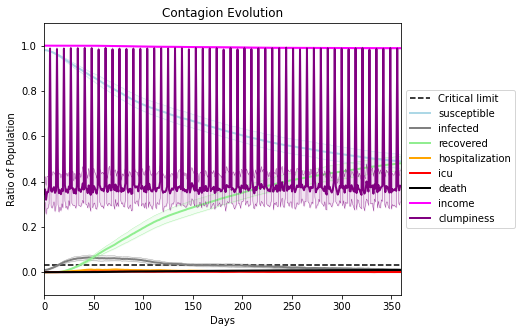

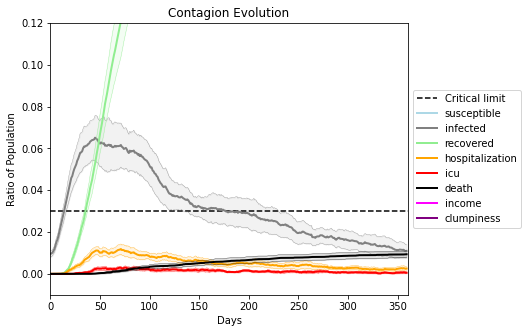

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8953, 8987, 3533, 2047, 6600, 1826, 3046, 1969, 2482, 7578, 6324, 4636, 9398, 2935, 320, 1324, 1357, 8906, 7670, 4302]
Average similarity between family members is 0.9719642791287061 at temperature -0.999
Average similarity between family and home is 0.9998556694285495 at temperature -1
Average similarity between students and their classroom is 0.7479357837747668 at temperature -0.999
Average classroom occupancy is 3.9705882352941178 and number classrooms is 68
Average similarity between workers is 0.9512605719087928 at temperature -0.999
Average office occupancy is 3.66120218579235 and number offices is 183
Average friend similarity for adults: 0.8634591327238851 for kids: 0.710905332291746
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.7518781924347064
avg restaurant similarity 0.7079184293857984
avg restaurant similarity 0.6902139112487881
avg restaurant similarity 0.5550181680179627
avg restaurant similarity 0.7323745624100981
avg restaurant similarity 0.6365019556993055
avg restaurant similarity 0.5878249332416566
avg restaurant similarity 0.9581389232898561
avg restaurant similarity 0.5159305557652935
avg restaurant similarity 0.637253384861842
avg restaurant similarity 0.8031522698491325
avg restaurant similarity 0.8161922016209676
avg restaurant similarity 0.632987563069001
avg restaurant similarity 0.5196048336167114
avg restaurant similarity 0.7519819328225812
avg restaurant similarity 0.9996127990705721
avg restaurant similarity 0.6291997507806146
avg restaurant similarity 0.6081676854269752
avg restaurant similarity 0.8240452816840966
avg restaurant similarity 0.999811260973861
avg restaurant similarity 0.5884121249862236
avg restaurant similarity 0.9998454569486016
avg restauran

avg restaurant similarity 0.7241650911873397
avg restaurant similarity 0.5999543721512689
avg restaurant similarity 0.6210095436302004
avg restaurant similarity 0.790417942056369
avg restaurant similarity 0.640680741927404
avg restaurant similarity 0.5837806991508708
avg restaurant similarity 0.6237374571068183
avg restaurant similarity 0.599485383235724
avg restaurant similarity 0.5750871478069729
avg restaurant similarity 0.7416355442967282
avg restaurant similarity 0.6403335352437671
avg restaurant similarity 0.6358295148462608
avg restaurant similarity 0.8026994971178394
avg restaurant similarity 0.8036654432958018
avg restaurant similarity 0.9152540329068815
avg restaurant similarity 0.703355081370296
avg restaurant similarity 0.8026241695112681
avg restaurant similarity 0.7121167285754465
avg restaurant similarity 0.600981228451179
avg restaurant similarity 0.7718147874618442
avg restaurant similarity 0.7547372899828155
avg restaurant similarity 0.727023032772331
avg restaurant s

avg restaurant similarity 0.7962034964511341
avg restaurant similarity 0.5543399663970748
avg restaurant similarity 0.6350999119130396
avg restaurant similarity 0.4296560480515457
avg restaurant similarity 0.6972665364311184
avg restaurant similarity 0.697303072748037
avg restaurant similarity 0.5896359730353835
avg restaurant similarity 0.6934683909660441
avg restaurant similarity 0.4807891085858663
avg restaurant similarity 0.670772259664818
avg restaurant similarity 0.758940540884842
avg restaurant similarity 0.45138530183801945
avg restaurant similarity 0.519385410704942
avg restaurant similarity 0.6794430687874506
avg restaurant similarity 0.5300441010078747
avg restaurant similarity 0.5637418011255159
avg restaurant similarity 0.7959367733648428
avg restaurant similarity 0.6174828525504363
avg restaurant similarity 0.5508061268628828
avg restaurant similarity 0.34734927592726417
avg restaurant similarity 0.5727961755057769
avg restaurant similarity 0.6081254227893549
avg restaura

avg restaurant similarity 0.547920324324122
avg restaurant similarity 0.6233872536817537
avg restaurant similarity 0.7391196929892849
avg restaurant similarity 0.7055030682709682
avg restaurant similarity 0.691185200376856
avg restaurant similarity 0.7133659063280593
avg restaurant similarity 0.583476620537881
avg restaurant similarity 0.6937171910339136
avg restaurant similarity 0.5814405265299523
avg restaurant similarity 0.46310745404496645
avg restaurant similarity 0.8165174318946845
avg restaurant similarity 0.5389792462416234
avg restaurant similarity 0.4049588733332464
avg restaurant similarity 0.6930010165155941
avg restaurant similarity 0.564706927101918
avg restaurant similarity 0.5471627563413226
avg restaurant similarity 0.8317063673630929
avg restaurant similarity 0.4455740686681306
avg restaurant similarity 0.7048057404850151
avg restaurant similarity 0.5901633912876546
avg restaurant similarity 0.6737941416070453
avg restaurant similarity 0.7966601659018958
avg restauran

avg restaurant similarity 0.6223606171548186
avg restaurant similarity 0.6646360473153077
avg restaurant similarity 0.4542475420680198
avg restaurant similarity 0.6327273325586541
avg restaurant similarity 0.7278790416252499
avg restaurant similarity 0.7385883536657243
avg restaurant similarity 0.4665497170269816
avg restaurant similarity 0.7788777585655403
avg restaurant similarity 0.7293004777716248
avg restaurant similarity 0.6668402805137501
avg restaurant similarity 0.40148023896563806
avg restaurant similarity 0.6505225932966617
avg restaurant similarity 0.5982341749014278
avg restaurant similarity 0.6540448927936444
avg restaurant similarity 0.7297826916202146
avg restaurant similarity 0.7257835910984985
avg restaurant similarity 0.5140255566816094
avg restaurant similarity 0.6729513273164728
avg restaurant similarity 0.5519874403232001
avg restaurant similarity 0.9427333837887675
avg restaurant similarity 0.6234778536385539
avg restaurant similarity 0.5676497685805073
avg resta

avg restaurant similarity 0.8824922748937636
avg restaurant similarity 0.6740099957073536
avg restaurant similarity 0.6768631604213557
avg restaurant similarity 0.5611053385767765
avg restaurant similarity 0.8036003069087552
avg restaurant similarity 0.49880140351712765
avg restaurant similarity 0.694630937090635
avg restaurant similarity 0.6140439381083421
avg restaurant similarity 0.5506096431401092
avg restaurant similarity 0.6610053197766419
avg restaurant similarity 0.8942071168120582
avg restaurant similarity 0.566791168036404
avg restaurant similarity 0.7471694430178726
avg restaurant similarity 0.7216546912156911
avg restaurant similarity 0.5724802425030451
avg restaurant similarity 0.544082290120384
avg restaurant similarity 0.5907728637396773
avg restaurant similarity 0.67348067755897
avg restaurant similarity 0.693194581745916
avg restaurant similarity 0.5809844977213996
avg restaurant similarity 0.8941892128998514
avg restaurant similarity 0.724551678028454
avg restaurant s

avg restaurant similarity 0.598972284465793
avg restaurant similarity 0.44452822395103664
avg restaurant similarity 0.3873159237510317
avg restaurant similarity 0.5246186437518178
avg restaurant similarity 0.6307508244177555
avg restaurant similarity 0.5766547154090815
avg restaurant similarity 0.5140812012451585
avg restaurant similarity 0.5479686542114073
avg restaurant similarity 0.7951262030248141
avg restaurant similarity 0.6297092420339087
avg restaurant similarity 0.46679616023251824
avg restaurant similarity 0.545472269812696
avg restaurant similarity 0.5765773247565402
avg restaurant similarity 0.5072121793032879
avg restaurant similarity 0.514289321859769
avg restaurant similarity 0.7645208018343003
avg restaurant similarity 0.7427239879722334
avg restaurant similarity 0.5204245449835679
avg restaurant similarity 0.6391961273796417
avg restaurant similarity 0.5189212512556485
avg restaurant similarity 0.4956701609559485
avg restaurant similarity 0.6496533235152308
avg restaur

avg restaurant similarity 0.5024008378996575
avg restaurant similarity 0.3411152859361214
avg restaurant similarity 0.5930556647315388
avg restaurant similarity 0.5626572316786582
avg restaurant similarity 0.4274646824001412
avg restaurant similarity 0.6357422351022189
avg restaurant similarity 0.524238071904942
avg restaurant similarity 0.722923496181294
avg restaurant similarity 0.5268162703085559
avg restaurant similarity 0.49923681292690075
avg restaurant similarity 0.7866732947429727
avg restaurant similarity 0.5594511168026274
avg restaurant similarity 0.41365594854110843
avg restaurant similarity 0.9370741838048398
avg restaurant similarity 0.9343113136011687
avg restaurant similarity 0.7718716443313763
avg restaurant similarity 0.3759547273912388
avg restaurant similarity 0.5366098419924703
avg restaurant similarity 0.4337254915716013
avg restaurant similarity 0.6454467162617609
avg restaurant similarity 0.7330265814248526
avg restaurant similarity 0.6732133096882004
avg restau

avg restaurant similarity 0.6499628574273114
avg restaurant similarity 0.6094342913861736
avg restaurant similarity 0.8128433693176648
avg restaurant similarity 0.6315792741282104
avg restaurant similarity 0.5520428456267044
avg restaurant similarity 0.7651342785371528
avg restaurant similarity 0.8250551254387299
avg restaurant similarity 0.9047197737159689
avg restaurant similarity 0.6788328083573697
avg restaurant similarity 0.6836815229601734
avg restaurant similarity 0.823983096464931
avg restaurant similarity 0.7179312040829948
avg restaurant similarity 0.7738392672336523
avg restaurant similarity 0.7498451881938918
avg restaurant similarity 0.933937737055758
avg restaurant similarity 0.8656263164335711
avg restaurant similarity 0.8397373562728753
avg restaurant similarity 0.8459280416735913
avg restaurant similarity 0.5898730842611277
avg restaurant similarity 0.7306460529678198
avg restaurant similarity 0.8219165746209192
avg restaurant similarity 0.7816539118580108
avg restaura

avg restaurant similarity 0.6757815071354566
avg restaurant similarity 0.7926966100158789
avg restaurant similarity 0.5743942998720684
avg restaurant similarity 0.6240427566756679
avg restaurant similarity 0.7722070095987571
avg restaurant similarity 0.6847156127582372
avg restaurant similarity 0.7848846015618391
avg restaurant similarity 0.6088029326685349
avg restaurant similarity 0.8879273764744182
avg restaurant similarity 0.7707880206580987
avg restaurant similarity 0.8409433425404876
avg restaurant similarity 0.8692870241106702
avg restaurant similarity 0.8025364374947254
avg restaurant similarity 0.7597486023950639
avg restaurant similarity 0.694261683213239
avg restaurant similarity 0.7076854934469131
avg restaurant similarity 0.7319827211611201
avg restaurant similarity 0.8992938364199244
avg restaurant similarity 0.727412064214783
avg restaurant similarity 0.710523531222011
avg restaurant similarity 0.7443222341034232
avg restaurant similarity 0.8008616594635913
avg restauran

avg restaurant similarity 0.5012292029660628
avg restaurant similarity 0.6043532308158757
avg restaurant similarity 0.5895644370931297
avg restaurant similarity 0.7853642264851143
avg restaurant similarity 0.5788114748678581
avg restaurant similarity 0.603847027663688
avg restaurant similarity 0.7061648857916301
avg restaurant similarity 0.6182639094901895
avg restaurant similarity 0.6296934315148849
avg restaurant similarity 0.6749854346410472
avg restaurant similarity 0.679603120745238
avg restaurant similarity 0.5164642672801789
avg restaurant similarity 0.7510495785414548
avg restaurant similarity 0.668946084933133
avg restaurant similarity 0.6698678798323177
avg restaurant similarity 0.6245184656471159
avg restaurant similarity 0.6066342883442782
avg restaurant similarity 0.5422859830187369
avg restaurant similarity 0.5537577497639443
avg restaurant similarity 0.6373343138870728
avg restaurant similarity 0.6979281416270782
avg restaurant similarity 0.6436765837836268
avg restauran

avg restaurant similarity 0.6096693127994968
avg restaurant similarity 0.552136007835476
avg restaurant similarity 0.7831002583521449
avg restaurant similarity 0.7072664018840294
avg restaurant similarity 0.612341391748654
avg restaurant similarity 0.8286296360495058
avg restaurant similarity 0.6625580560794896
avg restaurant similarity 0.5596683143244919
avg restaurant similarity 0.5427183748886761
avg restaurant similarity 0.49464203082098296
avg restaurant similarity 0.7776942372444773
avg restaurant similarity 0.7307362661832204
avg restaurant similarity 0.6466148078213966
avg restaurant similarity 0.44216667799290366
avg restaurant similarity 0.579231105582053
avg restaurant similarity 0.620345187116409
avg restaurant similarity 0.7256080008277437
avg restaurant similarity 0.45266964800125925
avg restaurant similarity 0.6652778797449396
avg restaurant similarity 0.5220477247987982
avg restaurant similarity 0.5521219162984085
avg restaurant similarity 0.5289253346388294
avg restaur

avg restaurant similarity 0.5396868437633785
avg restaurant similarity 0.5133528495568911
avg restaurant similarity 0.5959644645743485
avg restaurant similarity 0.5909405299908398
avg restaurant similarity 0.6444871152636562
avg restaurant similarity 0.7521197311387812
avg restaurant similarity 0.6855482528355705
avg restaurant similarity 0.5728625792767786
avg restaurant similarity 0.5101372194672906
avg restaurant similarity 0.5053074789389211
avg restaurant similarity 0.7184410711609163
avg restaurant similarity 0.4131414965015644
avg restaurant similarity 0.5659957366202216
avg restaurant similarity 0.6186757565467661
avg restaurant similarity 0.7384087436301892
avg restaurant similarity 0.644828997164642
avg restaurant similarity 0.49274054615929014
avg restaurant similarity 0.47428348842561646
avg restaurant similarity 0.6042767869180471
avg restaurant similarity 0.4864174361095141
avg restaurant similarity 0.45344178869932955
avg restaurant similarity 0.6034019740331376
avg rest

avg restaurant similarity 0.5008980704442262
avg restaurant similarity 0.5282740257603615
avg restaurant similarity 0.6174841997392357
avg restaurant similarity 0.580535272591158
avg restaurant similarity 0.5509591874540637
avg restaurant similarity 0.6078122994294958
avg restaurant similarity 0.8433129786449024
avg restaurant similarity 0.5466771252156717
avg restaurant similarity 0.46774716636734137
avg restaurant similarity 0.6385931690122023
avg restaurant similarity 0.6079411313811671
avg restaurant similarity 0.5960509991607502
avg restaurant similarity 0.5782651612178331
avg restaurant similarity 0.5520327943648743
avg restaurant similarity 0.41782651099392953
avg restaurant similarity 0.4552332509512744
avg restaurant similarity 0.5944025583298763
avg restaurant similarity 0.6010488571579533
avg restaurant similarity 0.48419448502888823
avg restaurant similarity 0.5949009595309257
avg restaurant similarity 0.6424512206135369
avg restaurant similarity 0.6017382076363029
avg rest

avg restaurant similarity 0.6649664799873656
avg restaurant similarity 0.7588150232536727
avg restaurant similarity 0.7321831584301799
avg restaurant similarity 0.741809700374041
avg restaurant similarity 0.5941493544242756
avg restaurant similarity 0.7283417793067435
avg restaurant similarity 0.7764559515898056
avg restaurant similarity 0.6294926359445787
avg restaurant similarity 0.731776781810274
avg restaurant similarity 0.8180213479904264
avg restaurant similarity 0.835211357242657
avg restaurant similarity 0.4989343892827159
avg restaurant similarity 0.6772201863749645
avg restaurant similarity 0.5289649617772315
avg restaurant similarity 0.8718091988262548
avg restaurant similarity 0.8003893068669783
avg restaurant similarity 0.7426953647159097
avg restaurant similarity 0.6098995258283108
avg restaurant similarity 0.7711833196733047
avg restaurant similarity 0.668922447943491
avg restaurant similarity 0.9997117020241828
avg restaurant similarity 0.6406230432612383
avg restaurant

avg restaurant similarity 0.7956227714245482
avg restaurant similarity 0.9103529238823111
avg restaurant similarity 0.7307356922334154
avg restaurant similarity 0.8635032624220021
avg restaurant similarity 0.7176428912334295
avg restaurant similarity 0.6016475703991123
avg restaurant similarity 0.7927771935048443
avg restaurant similarity 0.8145317002122233
avg restaurant similarity 0.7523468035694171
avg restaurant similarity 0.7085351431430962
avg restaurant similarity 0.6571571911312386
avg restaurant similarity 0.8441450545159038
avg restaurant similarity 0.7083948599562193
avg restaurant similarity 0.7643537196321035
avg restaurant similarity 0.6605779385894908
avg restaurant similarity 0.4498144068829089
avg restaurant similarity 0.9997929536352012
avg restaurant similarity 0.7025540223826454
avg restaurant similarity 0.8503668559499512
avg restaurant similarity 0.7529124505708502
avg restaurant similarity 0.48259199205212144
avg restaurant similarity 0.7681924278447491
avg resta

avg restaurant similarity 0.4957157413256298
avg restaurant similarity 0.6505026253435187
avg restaurant similarity 0.6302756220908414
avg restaurant similarity 0.6339817410150556
avg restaurant similarity 0.4926337788589434
avg restaurant similarity 0.7969528009838149
avg restaurant similarity 0.7806306693692306
avg restaurant similarity 0.49958284415401866
avg restaurant similarity 0.5216096554786317
avg restaurant similarity 0.5696259394810707
avg restaurant similarity 0.5878093262723749
avg restaurant similarity 0.5318686956491632
avg restaurant similarity 0.6156096592985932
avg restaurant similarity 0.7981267332501362
avg restaurant similarity 0.8421605189419693
avg restaurant similarity 0.6896222441851949
avg restaurant similarity 0.5519142551128347
avg restaurant similarity 0.5242877105204676
avg restaurant similarity 0.5299721304464791
avg restaurant similarity 0.5202831825310025
avg restaurant similarity 0.6669858829786794
avg restaurant similarity 0.5975079740124508
avg resta

avg restaurant similarity 0.6278024859312346
avg restaurant similarity 0.5937002815365466
avg restaurant similarity 0.6039231841757411
avg restaurant similarity 0.5347905677281861
avg restaurant similarity 0.4964723485458415
avg restaurant similarity 0.565760123609158
avg restaurant similarity 0.6341376768136728
avg restaurant similarity 0.8056166146323508
avg restaurant similarity 0.6526999118750109
avg restaurant similarity 0.5023211976186021
avg restaurant similarity 0.8744449830890922
avg restaurant similarity 0.6218079547664163
avg restaurant similarity 0.7286310046253941
avg restaurant similarity 0.6818487397300156
avg restaurant similarity 0.6433968030453588
avg restaurant similarity 0.5031827427564564
avg restaurant similarity 0.6527186324355471
avg restaurant similarity 0.5795564658503624
avg restaurant similarity 0.5800052740448292
avg restaurant similarity 0.5035628349837691
avg restaurant similarity 0.5772719236431885
avg restaurant similarity 0.637623192070451
avg restaura

avg restaurant similarity 0.5461463821382316
avg restaurant similarity 0.7485679795596782
avg restaurant similarity 0.7294316693886248
avg restaurant similarity 0.6887644571144242
avg restaurant similarity 0.6436520669428398
avg restaurant similarity 0.7047505233235942
avg restaurant similarity 0.5839112851246092
avg restaurant similarity 0.5127796104098787
avg restaurant similarity 0.7691496194618188
avg restaurant similarity 0.5493306176371039
avg restaurant similarity 0.5386378946018944
avg restaurant similarity 0.7226317294811588
avg restaurant similarity 0.6980033194778601
avg restaurant similarity 0.5791183494419574
avg restaurant similarity 0.7439517470250153
avg restaurant similarity 0.38687084380484127
avg restaurant similarity 0.5955402456138897
avg restaurant similarity 0.7164967502590652
avg restaurant similarity 0.6407153127213885
avg restaurant similarity 0.600937869589402
avg restaurant similarity 0.5361864019121821
avg restaurant similarity 0.6388136616428438
avg restau

avg restaurant similarity 0.6145539135114116
avg restaurant similarity 0.6564349346395466
avg restaurant similarity 0.45197311212568
avg restaurant similarity 0.7081511579395913
avg restaurant similarity 0.5944482627611308
avg restaurant similarity 0.6521554591822427
avg restaurant similarity 0.7623451687274027
avg restaurant similarity 0.6820320959632429
avg restaurant similarity 0.6409277529185405
avg restaurant similarity 0.7520063326774611
avg restaurant similarity 0.6775232486162414
avg restaurant similarity 0.6241357714729823
avg restaurant similarity 0.6840971130911608
avg restaurant similarity 0.6236959673515593
avg restaurant similarity 0.5526172925575195
avg restaurant similarity 0.6662980248070381
avg restaurant similarity 0.7606704198050778
avg restaurant similarity 0.5420890664372301
avg restaurant similarity 0.6503443059478696
avg restaurant similarity 0.6585299870845757
avg restaurant similarity 0.5227262880244067
avg restaurant similarity 0.5648905672123752
avg restaura

avg restaurant similarity 0.5419947355509059
avg restaurant similarity 0.6286012082131646
avg restaurant similarity 0.5610696400131535
avg restaurant similarity 0.6628404797511633
avg restaurant similarity 0.611244688018812
avg restaurant similarity 0.5482241901630328
avg restaurant similarity 0.5641805576112962
avg restaurant similarity 0.5192627883479237
avg restaurant similarity 0.5031739811906331
avg restaurant similarity 0.7216340998637223
avg restaurant similarity 0.6202689017873652
avg restaurant similarity 0.6437937896258259
avg restaurant similarity 0.6810508432640398
avg restaurant similarity 0.7519161883970896
avg restaurant similarity 0.5990038610839943
avg restaurant similarity 0.5783351786203675
avg restaurant similarity 0.6391379691921746
avg restaurant similarity 0.7347016666825601
avg restaurant similarity 0.509814881480789
avg restaurant similarity 0.6420120701378282
avg restaurant similarity 0.6252657981049936
avg restaurant similarity 0.7175642807901612
avg restaura

avg restaurant similarity 0.6522972118543371
avg restaurant similarity 0.7870469571582046
avg restaurant similarity 0.6082693111758604
avg restaurant similarity 0.5738388201091391
avg restaurant similarity 0.6221843572419267
avg restaurant similarity 0.712304100528829
avg restaurant similarity 0.7320663456636183
avg restaurant similarity 0.5887279561473149
avg restaurant similarity 0.519689779135595
avg restaurant similarity 0.8418580762278465
avg restaurant similarity 0.60559986606391
avg restaurant similarity 0.5579177965580352
avg restaurant similarity 0.5905158804326035
avg restaurant similarity 0.5724841741298972
avg restaurant similarity 0.5588905399265778
avg restaurant similarity 0.6321706059687451
avg restaurant similarity 0.6360845974700902
avg restaurant similarity 0.7092157968842714
avg restaurant similarity 0.5556920619469811
avg restaurant similarity 0.7223039212120529
avg restaurant similarity 0.5074412479861141
avg restaurant similarity 0.4847522741008492
avg restaurant

avg restaurant similarity 0.45965061579965677
avg restaurant similarity 0.7994177004921477
avg restaurant similarity 0.6219520497874835
avg restaurant similarity 0.653195813690198
avg restaurant similarity 0.4824500963765715
avg restaurant similarity 0.43267927764967523
avg restaurant similarity 0.6453810997206929
avg restaurant similarity 0.6283239371903846
avg restaurant similarity 0.5431076755627234
avg restaurant similarity 0.6627481599845343
avg restaurant similarity 0.617881496872145
avg restaurant similarity 0.49944761702645274
avg restaurant similarity 0.5531897020820093
avg restaurant similarity 0.9998151421647239
avg restaurant similarity 0.9014082013158479
avg restaurant similarity 0.5498845202994411
avg restaurant similarity 0.44881231437113683
avg restaurant similarity 0.5039818089099745
avg restaurant similarity 0.5928166479154884
avg restaurant similarity 0.7053322998324068
avg restaurant similarity 0.6173222439853047
avg restaurant similarity 0.6283239371903846
avg rest

avg restaurant similarity 0.5748492296995301
avg restaurant similarity 0.44168204428517194
avg restaurant similarity 0.31237919623010346
avg restaurant similarity 0.7084499176038394
avg restaurant similarity 0.7946563396810965
avg restaurant similarity 0.7533093672725637
avg restaurant similarity 0.6311527450803385
avg restaurant similarity 0.5032745802332436
avg restaurant similarity 0.3968555010930387
avg restaurant similarity 0.750848327037642
avg restaurant similarity 0.5789322524864272
avg restaurant similarity 0.5842637558213771
avg restaurant similarity 0.678278604787725
avg restaurant similarity 0.5861757989255713
avg restaurant similarity 0.7264755239254833
avg restaurant similarity 0.4800755491871604
avg restaurant similarity 0.7133807389342706
avg restaurant similarity 0.5759943126756815
avg restaurant similarity 0.691857094787659
avg restaurant similarity 0.6935186851105318
avg restaurant similarity 0.4745726761125862
avg restaurant similarity 0.7583641042870083
avg restaur

avg restaurant similarity 0.6822210957793102
avg restaurant similarity 0.8033452480051632
avg restaurant similarity 0.832334637246694
avg restaurant similarity 0.8154712309637101
avg restaurant similarity 0.7374413161371822
avg restaurant similarity 0.9997070880780532
avg restaurant similarity 0.7374535557183365
avg restaurant similarity 0.7179953972354655
avg restaurant similarity 0.7632640822976909
avg restaurant similarity 0.6203514376149936
avg restaurant similarity 0.5736263936624879
avg restaurant similarity 0.9369416789643621
avg restaurant similarity 0.5649304035235987
avg restaurant similarity 0.9996276480809382
avg restaurant similarity 0.7732659922727746
avg restaurant similarity 0.7485678922297415
avg restaurant similarity 0.737132264213577
avg restaurant similarity 0.5559490120328445
avg restaurant similarity 0.424756534560583
avg restaurant similarity 0.871271396736577
avg restaurant similarity 0.479736106976136
avg restaurant similarity 0.7418427278946078
avg restaurant 

avg restaurant similarity 0.7255223057266734
avg restaurant similarity 0.596239844897364
avg restaurant similarity 0.885620123291285
avg restaurant similarity 0.6353353351030735
avg restaurant similarity 0.9996865425374608
avg restaurant similarity 0.8348144871663766
avg restaurant similarity 0.859423801764156
avg restaurant similarity 0.8780819032147886
avg restaurant similarity 0.9997124535002326
avg restaurant similarity 0.7629900968543489
avg restaurant similarity 0.854357973097108
avg restaurant similarity 0.7000438213830736
avg restaurant similarity 0.8303807765826655
avg restaurant similarity 0.5555595088347023
avg restaurant similarity 0.7275855453927642
avg restaurant similarity 0.6972730084808983
avg restaurant similarity 0.6114168360815109
avg restaurant similarity 0.9996593593831662
avg restaurant similarity 0.7587642756919328
avg restaurant similarity 0.6380872910997114
avg restaurant similarity 0.9997070880780532
avg restaurant similarity 0.7803164858395832
avg restaurant

avg restaurant similarity 0.734511730184171
avg restaurant similarity 0.6130545885820353
avg restaurant similarity 0.7002403389191586
avg restaurant similarity 0.7573227881219368
avg restaurant similarity 0.68608185124765
avg restaurant similarity 0.5879911639869552
avg restaurant similarity 0.7049216064963542
avg restaurant similarity 0.5577918606565048
avg restaurant similarity 0.6404988902837225
avg restaurant similarity 0.510619790559678
avg restaurant similarity 0.7335354758832321
avg restaurant similarity 0.6595618630309993
avg restaurant similarity 0.6930809314181863
avg restaurant similarity 0.4848184599412753
avg restaurant similarity 0.7221824783353048
avg restaurant similarity 0.6064077908442999
avg restaurant similarity 0.750599016823837
avg restaurant similarity 0.692841126918802
avg restaurant similarity 0.686500871328404
avg restaurant similarity 0.6747924182078263
avg restaurant similarity 0.7652271134412983
avg restaurant similarity 0.672172873340575
avg restaurant sim

avg restaurant similarity 0.5980363977023342
avg restaurant similarity 0.5827112714889643
avg restaurant similarity 0.5915959422013058
avg restaurant similarity 0.6252363493378797
avg restaurant similarity 0.4904652623386741
avg restaurant similarity 0.6754437289096007
avg restaurant similarity 0.4548324481638335
avg restaurant similarity 0.574670656955799
avg restaurant similarity 0.5794428611575568
avg restaurant similarity 0.8652635666666528
avg restaurant similarity 0.513733493905167
avg restaurant similarity 0.7965381484647173
avg restaurant similarity 0.7297752209862267
avg restaurant similarity 0.5871980445403802
avg restaurant similarity 0.620278105580577
avg restaurant similarity 0.6171425859946612
avg restaurant similarity 0.5231309820794463
avg restaurant similarity 0.6276557189660729
avg restaurant similarity 0.6299972288100442
avg restaurant similarity 0.773734134148031
avg restaurant similarity 0.6543424965146516
avg restaurant similarity 0.6088531121700104
avg restaurant

avg restaurant similarity 0.6143343887481626
avg restaurant similarity 0.5943435838132615
avg restaurant similarity 0.6224942744563549
avg restaurant similarity 0.5443368329346787
avg restaurant similarity 0.572035347673195
avg restaurant similarity 0.6499128194373925
avg restaurant similarity 0.6786349105486819
avg restaurant similarity 0.631346558284805
avg restaurant similarity 0.6328511070166414
avg restaurant similarity 0.6039443752447315
avg restaurant similarity 0.5756779728040166
avg restaurant similarity 0.6791070432459058
avg restaurant similarity 0.5015357478140152
avg restaurant similarity 0.585090441893198
avg restaurant similarity 0.7127774741490294
avg restaurant similarity 0.56585349849092
avg restaurant similarity 0.6497976847923083
avg restaurant similarity 0.6065431832711012
avg restaurant similarity 0.7055213108635738
avg restaurant similarity 0.5996515672868838
avg restaurant similarity 0.5716412615153142
avg restaurant similarity 0.5421665528169403
avg restaurant 

avg restaurant similarity 0.605792959931976
avg restaurant similarity 0.6370733841490739
avg restaurant similarity 0.6026019476024713
avg restaurant similarity 0.7714880843142371
avg restaurant similarity 0.6863432700377055
avg restaurant similarity 0.8555069403739042
avg restaurant similarity 0.7024372879789427
avg restaurant similarity 0.6256501199465707
avg restaurant similarity 0.6924555973437673
avg restaurant similarity 0.6295485357683074
avg restaurant similarity 0.6553004787673729
avg restaurant similarity 0.6535200701134856
avg restaurant similarity 0.5463902053305788
avg restaurant similarity 0.6783387674729819
avg restaurant similarity 0.4414978172020029
avg restaurant similarity 0.7656045598819229
avg restaurant similarity 0.5949806753695889
avg restaurant similarity 0.4655074308185046
avg restaurant similarity 0.7906796201249477
avg restaurant similarity 0.6686236366386288
avg restaurant similarity 0.6108678456040593
avg restaurant similarity 0.6063000088986251
avg restaur

avg restaurant similarity 0.7414698682113082
avg restaurant similarity 0.6609400182322666
avg restaurant similarity 0.8956226980885078
avg restaurant similarity 0.6737010436253504
avg restaurant similarity 0.856698463120326
avg restaurant similarity 0.5143430141065578
avg restaurant similarity 0.7455887103072807
avg restaurant similarity 0.6273483195596217
avg restaurant similarity 0.7276149268363746
avg restaurant similarity 0.6795761498259795
avg restaurant similarity 0.7298745360342046
avg restaurant similarity 0.5993539669860639
avg restaurant similarity 0.8131754811030023
avg restaurant similarity 0.6999052432060633
avg restaurant similarity 0.7333352187140942
avg restaurant similarity 0.6370697162502427
avg restaurant similarity 0.8623793988608304
avg restaurant similarity 0.7995638929264646
avg restaurant similarity 0.7192871499364007
avg restaurant similarity 0.7446093555296669
avg restaurant similarity 0.7348435702803171
avg restaurant similarity 0.7397220367668249
avg restaur

avg restaurant similarity 0.5586284605734841
avg restaurant similarity 0.7828156797629547
avg restaurant similarity 0.6063608357570536
avg restaurant similarity 0.7108734864987512
avg restaurant similarity 0.5841442211386138
avg restaurant similarity 0.6842004332690115
avg restaurant similarity 0.6942177776076948
avg restaurant similarity 0.7451523352168765
avg restaurant similarity 0.7924242218915166
avg restaurant similarity 0.6528013259273381
avg restaurant similarity 0.7693603411650916
avg restaurant similarity 0.5057179053020256
avg restaurant similarity 0.7948397354493004
avg restaurant similarity 0.7500032618780159
avg restaurant similarity 0.6357849073318159
avg restaurant similarity 0.7057498068418958
avg restaurant similarity 0.9533145182929122
avg restaurant similarity 0.8603156518823968
avg restaurant similarity 0.7467768856489853
avg restaurant similarity 0.6284152305075563
avg restaurant similarity 0.8155215164752196
avg restaurant similarity 0.805039464298149
avg restaur

avg restaurant similarity 0.6272587001701335
avg restaurant similarity 0.561655447687222
avg restaurant similarity 0.6264836972714145
avg restaurant similarity 0.8086166346020761
avg restaurant similarity 0.8264118511708207
avg restaurant similarity 0.7026261459530707
avg restaurant similarity 0.8049895802646961
avg restaurant similarity 0.7425298034933322
avg restaurant similarity 0.6781787380822127
avg restaurant similarity 0.7439272658068248
avg restaurant similarity 0.7851136909031942
avg restaurant similarity 0.6407900237096189
avg restaurant similarity 0.7029238751451798
avg restaurant similarity 0.6387761017928105
avg restaurant similarity 0.5924327183867827
avg restaurant similarity 0.7958558377700341
avg restaurant similarity 0.5903240640876836
avg restaurant similarity 0.7741633224140917
avg restaurant similarity 0.7977093780332302
avg restaurant similarity 0.5789776800877392
avg restaurant similarity 0.6344872290495859
avg restaurant similarity 0.33685492143755813
avg restau

avg restaurant similarity 0.8484329483579987
avg restaurant similarity 0.7454516635296584
avg restaurant similarity 0.7189779130139686
avg restaurant similarity 0.7556481466035209
avg restaurant similarity 0.5871550757878553
avg restaurant similarity 0.6132179527802791
avg restaurant similarity 0.8573223947336915
avg restaurant similarity 0.9598172839591465
avg restaurant similarity 0.661191864952418
avg restaurant similarity 0.7838264366032242
avg restaurant similarity 0.5179511430992927
avg restaurant similarity 0.590381241524222
avg restaurant similarity 0.8124686226261776
avg restaurant similarity 0.7010447412851977
avg restaurant similarity 0.7180778255807683
avg restaurant similarity 0.8009911623671668
avg restaurant similarity 0.7359788224246248
avg restaurant similarity 0.6502247952075777
avg restaurant similarity 0.7162831299928212
avg restaurant similarity 0.5954821008717305
avg restaurant similarity 0.842896229322842
avg restaurant similarity 0.7331781096693742
avg restauran

avg restaurant similarity 0.7307164797375371
avg restaurant similarity 0.6246838931301514
avg restaurant similarity 0.7034647496592602
avg restaurant similarity 0.6251011255571057
avg restaurant similarity 0.6943086600790098
avg restaurant similarity 0.7852240834817269
avg restaurant similarity 0.7459792802692579
avg restaurant similarity 0.6415014561973226
avg restaurant similarity 0.7619221101795387
avg restaurant similarity 0.6270135970523033
avg restaurant similarity 0.7215772398651221
avg restaurant similarity 0.5599126989990835
avg restaurant similarity 0.519968218357378
avg restaurant similarity 0.6888177616376867
avg restaurant similarity 0.5959341010994225
avg restaurant similarity 0.5369288841515039
avg restaurant similarity 0.5418226255261532
avg restaurant similarity 0.6404130245663764
avg restaurant similarity 0.7834031941509121
avg restaurant similarity 0.6325178982195123
avg restaurant similarity 0.6062213772881856
avg restaurant similarity 0.6739227865151712
avg restaur

avg restaurant similarity 0.5540396514125494
avg restaurant similarity 0.7649411719856974
avg restaurant similarity 0.6488647747567416
avg restaurant similarity 0.7507041570825197
avg restaurant similarity 0.7388439481141498
avg restaurant similarity 0.6260886627063618
avg restaurant similarity 0.6136343656361218
avg restaurant similarity 0.6408287017044119
avg restaurant similarity 0.5778257722068513
avg restaurant similarity 0.8370728301337668
avg restaurant similarity 0.6045094067905294
avg restaurant similarity 0.6609992445379385
avg restaurant similarity 0.6728983126049974
avg restaurant similarity 0.7475758879777539
avg restaurant similarity 0.5676628991215936
avg restaurant similarity 0.6649036776674624
avg restaurant similarity 0.6128992761767312
avg restaurant similarity 0.6744070344188766
avg restaurant similarity 0.6734509149208391
avg restaurant similarity 0.6390601170278699
avg restaurant similarity 0.6863782054741506
avg restaurant similarity 0.6601058241368489
avg restau

avg restaurant similarity 0.5347963025139783
avg restaurant similarity 0.5656041103766577
avg restaurant similarity 0.7127069158861342
avg restaurant similarity 0.61519578842954
avg restaurant similarity 0.657695784042254
avg restaurant similarity 0.725792979888608
avg restaurant similarity 0.549728161198428
avg restaurant similarity 0.6077803168361323
avg restaurant similarity 0.5845591367596691
avg restaurant similarity 0.6506028840790031
avg restaurant similarity 0.5454643989060314
avg restaurant similarity 0.7392236183117666
avg restaurant similarity 0.6075482715278042
avg restaurant similarity 0.6929497523546648
avg restaurant similarity 0.6431969927714103
avg restaurant similarity 0.714695073917115
avg restaurant similarity 0.7163567627331039
avg restaurant similarity 0.5409998686222827
avg restaurant similarity 0.6990862109782103
avg restaurant similarity 0.7018927499054038
avg restaurant similarity 0.5881892583523324
avg restaurant similarity 0.7288145697067104
avg restaurant s

avg restaurant similarity 0.6148921844521511
avg restaurant similarity 0.518048471646816
avg restaurant similarity 0.6715393947202276
avg restaurant similarity 0.5711452149503612
avg restaurant similarity 0.4893210430860043
avg restaurant similarity 0.6459511156366651
avg restaurant similarity 0.5358449030151431
avg restaurant similarity 0.6155539945170626
avg restaurant similarity 0.5850453611017309
avg restaurant similarity 0.56984369387679
avg restaurant similarity 0.5243870987934549
avg restaurant similarity 0.42643575909076753
avg restaurant similarity 0.6901237158956729
avg restaurant similarity 0.7262614934465876
avg restaurant similarity 0.751233431558642
avg restaurant similarity 0.6127005122922052
avg restaurant similarity 0.7816269336856116
avg restaurant similarity 0.6836763137581048
avg restaurant similarity 0.663859480979861
avg restaurant similarity 0.7345317830519666
avg restaurant similarity 0.544538242174458
avg restaurant similarity 0.6154113622624979
avg restaurant 

avg restaurant similarity 0.6970013820340355
avg restaurant similarity 0.8066449471065235
avg restaurant similarity 0.7002981920390215
avg restaurant similarity 0.7441556841853707
avg restaurant similarity 0.5989282388985174
avg restaurant similarity 0.5164590049222675
avg restaurant similarity 0.7762676089927933
avg restaurant similarity 0.6614781603996184
avg restaurant similarity 0.647604208842817
avg restaurant similarity 0.6403124840331551
avg restaurant similarity 0.6513471041376435
avg restaurant similarity 0.7809721794011243
avg restaurant similarity 0.6421342888505962
avg restaurant similarity 0.6114768429424098
avg restaurant similarity 0.742818841665963
avg restaurant similarity 0.6429360197098225
avg restaurant similarity 0.8335637825063912
avg restaurant similarity 0.6875130613758272
avg restaurant similarity 0.7247594456278621
avg restaurant similarity 0.6744110304197838
avg restaurant similarity 0.7067549826933912
avg restaurant similarity 0.7551304393647993
avg restaura

avg restaurant similarity 0.6741865798745209
avg restaurant similarity 0.7653475888711136
avg restaurant similarity 0.6767817094909748
avg restaurant similarity 0.5208619621903867
avg restaurant similarity 0.7303973374274955
avg restaurant similarity 0.7334253852973526
avg restaurant similarity 0.7888359057610587
avg restaurant similarity 0.5890049241933388
avg restaurant similarity 0.7096137209813133
avg restaurant similarity 0.7452502509583154
avg restaurant similarity 0.7603077377031556
avg restaurant similarity 0.7221858540467283
avg restaurant similarity 0.7521495062127936
avg restaurant similarity 0.6225009269737901
avg restaurant similarity 0.6510917910058103
avg restaurant similarity 0.7339984600689312
avg restaurant similarity 0.7260430621375085
avg restaurant similarity 0.7398175234059831
avg restaurant similarity 0.6697609417340562
avg restaurant similarity 0.7200037941813134
avg restaurant similarity 0.768960002894115
avg restaurant similarity 0.7208761474925792
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

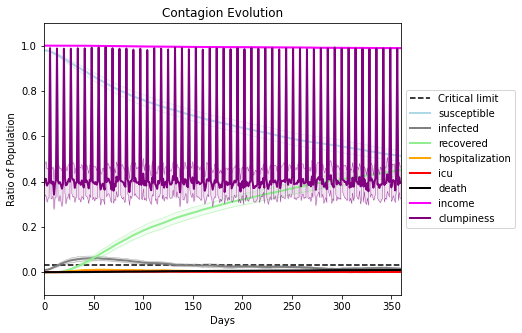

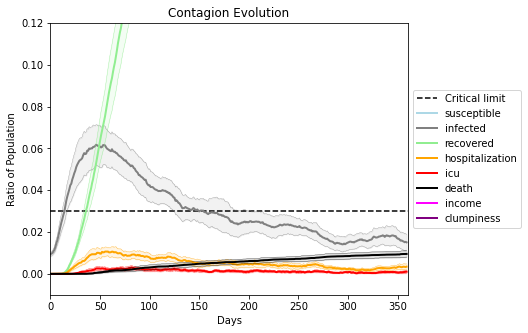

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[780, 3770, 9032, 3454, 8219, 8985, 3207, 5756, 31, 5064, 8536, 6660, 5696, 9003, 7420, 4668, 2640, 5021, 292, 3046]
Average similarity between family members is 0.9796622383959794 at temperature -0.998
Average similarity between family and home is 0.9998503878147513 at temperature -1
Average similarity between students and their classroom is 0.705449289548038 at temperature -0.998
Average classroom occupancy is 4.552238805970149 and number classrooms is 67
Average similarity between workers is 0.9706426307942859 at temperature -0.998
Average office occupancy is 3.3789473684210525 and number offices is 190
Average friend similarity for adults: 0.8503115396471532 for kids: 0.7292817106560812
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5250336068117157
avg restaurant similarity 0.3778566386926714
avg restaurant similarity 0.6094591979854468
avg restaurant similarity 0.41922529242771167
avg restaurant similarity 0.5833634626069778
avg restaurant similarity 0.704366477995531
avg restaurant similarity 0.5053895090728451
avg restaurant similarity 0.623461713488596
avg restaurant similarity 0.5929796883573599
avg restaurant similarity 0.48027979165213264
avg restaurant similarity 0.6593845133452299
avg restaurant similarity 0.6541250220128701
avg restaurant similarity 0.6725801515091754
avg restaurant similarity 0.636911590880602
avg restaurant similarity 0.7473380239576062
avg restaurant similarity 0.669289645560104
avg restaurant similarity 0.4331736298065804
avg restaurant similarity 0.5179430803859519
avg restaurant similarity 0.6315323383546995
avg restaurant similarity 0.5285636753659146
avg restaurant similarity 0.49931380169765016
avg restaurant similarity 0.6923503333491406
avg restaur

avg restaurant similarity 0.5453137332298261
avg restaurant similarity 0.37823166267544783
avg restaurant similarity 0.6938120137274952
avg restaurant similarity 0.5086070310527002
avg restaurant similarity 0.4275155412281336
avg restaurant similarity 0.41502715138276963
avg restaurant similarity 0.6357078138944068
avg restaurant similarity 0.45352484571534823
avg restaurant similarity 0.6300977204341698
avg restaurant similarity 0.412218393766964
avg restaurant similarity 0.6533236894622289
avg restaurant similarity 0.7147588088123874
avg restaurant similarity 0.9996492827027011
avg restaurant similarity 0.6369239794477002
avg restaurant similarity 0.44482057757208454
avg restaurant similarity 0.539063997023212
avg restaurant similarity 0.60410046056388
avg restaurant similarity 0.4474947461307807
avg restaurant similarity 0.767971159709258
avg restaurant similarity 0.6988306589646425
avg restaurant similarity 0.277044027154817
avg restaurant similarity 0.893834775727903
avg restauran

avg restaurant similarity 0.6533654640090867
avg restaurant similarity 0.9430484664490758
avg restaurant similarity 0.8528257899595578
avg restaurant similarity 0.8029341764756102
avg restaurant similarity 0.5697762134716275
avg restaurant similarity 0.5889898855808716
avg restaurant similarity 0.6756506489209714
avg restaurant similarity 0.645841817361048
avg restaurant similarity 0.8517540806257923
avg restaurant similarity 0.6910314397356351
avg restaurant similarity 0.722205621597832
avg restaurant similarity 0.7713006175465869
avg restaurant similarity 0.5985677710025206
avg restaurant similarity 0.7848283609239624
avg restaurant similarity 0.6051239888655938
avg restaurant similarity 0.6657876878139057
avg restaurant similarity 0.6775076942046108
avg restaurant similarity 0.5359796632370122
avg restaurant similarity 0.7145032146930215
avg restaurant similarity 0.7560643270918547
avg restaurant similarity 0.6109878506282405
avg restaurant similarity 0.7283528010190254
avg restaura

avg restaurant similarity 0.7676366344132582
avg restaurant similarity 0.8273437412100086
avg restaurant similarity 0.5478130268790065
avg restaurant similarity 0.7618434933050411
avg restaurant similarity 0.6591157358044955
avg restaurant similarity 0.4338697775231585
avg restaurant similarity 0.6990023433885779
avg restaurant similarity 0.5937519236490802
avg restaurant similarity 0.6786353828555062
avg restaurant similarity 0.7854930564609064
avg restaurant similarity 0.6098410908607633
avg restaurant similarity 0.918700563423669
avg restaurant similarity 0.584244800062441
avg restaurant similarity 0.7477962000689107
avg restaurant similarity 0.751690153846776
avg restaurant similarity 0.8083071065143732
avg restaurant similarity 0.8218623492105661
avg restaurant similarity 0.8694702122122362
avg restaurant similarity 0.670116252430512
avg restaurant similarity 0.6830988849619324
avg restaurant similarity 0.7265350807983247
avg restaurant similarity 0.7321979806168495
avg restaurant

avg restaurant similarity 0.6808048831783545
avg restaurant similarity 0.47634473633315394
avg restaurant similarity 0.6927273122100366
avg restaurant similarity 0.4992818265707482
avg restaurant similarity 0.555492141161658
avg restaurant similarity 0.4409986810793693
avg restaurant similarity 0.5750347115544323
avg restaurant similarity 0.7160974636173901
avg restaurant similarity 0.4991621004926409
avg restaurant similarity 0.6662664850289443
avg restaurant similarity 0.9997153883817662
avg restaurant similarity 0.4924800817224353
avg restaurant similarity 0.5020525058897997
avg restaurant similarity 0.49129732921954394
avg restaurant similarity 0.5402669924959224
avg restaurant similarity 0.5650988818595244
avg restaurant similarity 0.5971881247683248
avg restaurant similarity 0.5585643020904137
avg restaurant similarity 0.6170694094308894
avg restaurant similarity 0.5925517209189863
avg restaurant similarity 0.8067288561567562
avg restaurant similarity 0.5074045867987823
avg resta

avg restaurant similarity 0.49923420800177903
avg restaurant similarity 0.5157790237868165
avg restaurant similarity 0.8025948350139304
avg restaurant similarity 0.5918767948665647
avg restaurant similarity 0.7318544357802275
avg restaurant similarity 0.6535881496668617
avg restaurant similarity 0.4345722986934171
avg restaurant similarity 0.4986891867755869
avg restaurant similarity 0.5013046757680312
avg restaurant similarity 0.6909506379026773
avg restaurant similarity 0.573186315761404
avg restaurant similarity 0.5541151110150128
avg restaurant similarity 0.5335809924087035
avg restaurant similarity 0.5748214943267334
avg restaurant similarity 0.5371647197820361
avg restaurant similarity 0.6109252770598094
avg restaurant similarity 0.5579802260096004
avg restaurant similarity 0.6273043312043464
avg restaurant similarity 0.5777563107965975
avg restaurant similarity 0.6643492028935901
avg restaurant similarity 0.5259753968355695
avg restaurant similarity 0.5163174469783915
avg restau

avg restaurant similarity 0.5450276459543799
avg restaurant similarity 0.6326045512645566
avg restaurant similarity 0.6733433908286652
avg restaurant similarity 0.5421966414011118
avg restaurant similarity 0.6305868571186777
avg restaurant similarity 0.6087982330930557
avg restaurant similarity 0.7598466900879595
avg restaurant similarity 0.6966553625790851
avg restaurant similarity 0.6754240165692547
avg restaurant similarity 0.6717160702105738
avg restaurant similarity 0.7176330797664765
avg restaurant similarity 0.4534993234089908
avg restaurant similarity 0.6971757759393086
avg restaurant similarity 0.5954091972947728
avg restaurant similarity 0.747411119632953
avg restaurant similarity 0.619937657458769
avg restaurant similarity 0.675449642558422
avg restaurant similarity 0.5822082155433654
avg restaurant similarity 0.5681849292365931
avg restaurant similarity 0.608102789823494
avg restaurant similarity 0.6936178142279302
avg restaurant similarity 0.6685503496286218
avg restaurant

avg restaurant similarity 0.43863280718085135
avg restaurant similarity 0.7031654844453248
avg restaurant similarity 0.6598530580709454
avg restaurant similarity 0.6978321502523532
avg restaurant similarity 0.6822617438552302
avg restaurant similarity 0.7282479148274766
avg restaurant similarity 0.4302027123035508
avg restaurant similarity 0.6415641432252923
avg restaurant similarity 0.5562642607904065
avg restaurant similarity 0.5776702893257014
avg restaurant similarity 0.686555689622625
avg restaurant similarity 0.6564343897847618
avg restaurant similarity 0.8718157161401162
avg restaurant similarity 0.7692657886556414
avg restaurant similarity 0.7287496660761609
avg restaurant similarity 0.7640632273656612
avg restaurant similarity 0.7410437768303522
avg restaurant similarity 0.7193532230463582
avg restaurant similarity 0.80791517724793
avg restaurant similarity 0.7464964289037603
avg restaurant similarity 0.642886895169901
avg restaurant similarity 0.7086735032192721
avg restauran

avg restaurant similarity 0.6158157732349275
avg restaurant similarity 0.5458468512862578
avg restaurant similarity 0.5866707208273413
avg restaurant similarity 0.7353904471702797
avg restaurant similarity 0.6045097060047039
avg restaurant similarity 0.691515265552295
avg restaurant similarity 0.6800163733093787
avg restaurant similarity 0.6510082805222338
avg restaurant similarity 0.6193461867132494
avg restaurant similarity 0.7597058505687173
avg restaurant similarity 0.6388864812683022
avg restaurant similarity 0.7082908035296251
avg restaurant similarity 0.6766698024339719
avg restaurant similarity 0.6954829435081094
avg restaurant similarity 0.7489076845624799
avg restaurant similarity 0.7207304309814324
avg restaurant similarity 0.8816796013410727
avg restaurant similarity 0.7870562100983345
avg restaurant similarity 0.6928305533808543
avg restaurant similarity 0.6845824717096098
avg restaurant similarity 0.7391918180353433
avg restaurant similarity 0.6277181529096232
avg restaur

avg restaurant similarity 0.6571085977078509
avg restaurant similarity 0.7261106270508795
avg restaurant similarity 0.7156761042799255
avg restaurant similarity 0.7134523247247092
avg restaurant similarity 0.5712964691845905
avg restaurant similarity 0.637799816255454
avg restaurant similarity 0.7187119764079585
avg restaurant similarity 0.6858171449987039
avg restaurant similarity 0.5075053149796467
avg restaurant similarity 0.7419532559501448
avg restaurant similarity 0.6634920125096828
avg restaurant similarity 0.7518368918146174
avg restaurant similarity 0.72901818651089
avg restaurant similarity 0.6397235165154691
avg restaurant similarity 0.5873303174053007
avg restaurant similarity 0.5790701829208876
avg restaurant similarity 0.7107337074766906
avg restaurant similarity 0.6205241310078151
avg restaurant similarity 0.7875509538163914
avg restaurant similarity 0.7660886692296169
avg restaurant similarity 0.6121623376125737
avg restaurant similarity 0.6582707834625692
avg restauran

avg restaurant similarity 0.565381195054279
avg restaurant similarity 0.687349293778852
avg restaurant similarity 0.6984927327607507
avg restaurant similarity 0.47157067849264617
avg restaurant similarity 0.7704597947356802
avg restaurant similarity 0.5408504355669117
avg restaurant similarity 0.5548285922881316
avg restaurant similarity 0.6242613603674861
avg restaurant similarity 0.5652424779385992
avg restaurant similarity 0.5639117765180568
avg restaurant similarity 0.6030314581976722
avg restaurant similarity 0.6437155106092889
avg restaurant similarity 0.6171360088927529
avg restaurant similarity 0.70557685416392
avg restaurant similarity 0.42073149825838707
avg restaurant similarity 0.5426361902393869
avg restaurant similarity 0.6145971407906173
avg restaurant similarity 0.7474136697646016
avg restaurant similarity 0.6207004674842569
avg restaurant similarity 0.4802301271259434
avg restaurant similarity 0.5643656947713573
avg restaurant similarity 0.5895269682403641
avg restaura

avg restaurant similarity 0.5021555719174068
avg restaurant similarity 0.1528392495041802
avg restaurant similarity 0.4238148614075103
avg restaurant similarity 0.5869087844116393
avg restaurant similarity 0.6176594317438495
avg restaurant similarity 0.5871495936374304
avg restaurant similarity 0.6156672464708421
avg restaurant similarity 0.4858921437166541
avg restaurant similarity 0.551684674073159
avg restaurant similarity 0.6634613190341354
avg restaurant similarity 0.5161661275848516
avg restaurant similarity 0.5943744412884207
avg restaurant similarity 0.6150829135651574
avg restaurant similarity 0.6040187945719749
avg restaurant similarity 0.576011208117582
avg restaurant similarity 0.4991758033467885
avg restaurant similarity 0.6605264789935719
avg restaurant similarity 0.5175700754281168
avg restaurant similarity 0.6131212123171019
avg restaurant similarity 0.5756103633566862
avg restaurant similarity 0.4937400005767997
avg restaurant similarity 0.6168102468829714
avg restaura

avg restaurant similarity 0.666403251346061
avg restaurant similarity 0.8083649896083503
avg restaurant similarity 0.6270427617616431
avg restaurant similarity 0.69150223806353
avg restaurant similarity 0.5860344001854133
avg restaurant similarity 0.7932456637181946
avg restaurant similarity 0.7086567683301828
avg restaurant similarity 0.7088562392330091
avg restaurant similarity 0.7772658125967049
avg restaurant similarity 0.5757557917388939
avg restaurant similarity 0.6355654539267876
avg restaurant similarity 0.6621262618026124
avg restaurant similarity 0.631270029328207
avg restaurant similarity 0.6626420280666796
avg restaurant similarity 0.7101590246243983
avg restaurant similarity 0.6968365089749587
avg restaurant similarity 0.630076742572339
avg restaurant similarity 0.6114440272386913
avg restaurant similarity 0.6395061768348982
avg restaurant similarity 0.7573474624174383
avg restaurant similarity 0.6112836754208157
avg restaurant similarity 0.6476784525458785
avg restaurant 

avg restaurant similarity 0.6809567166572882
avg restaurant similarity 0.6091189824169423
avg restaurant similarity 0.7212584518194451
avg restaurant similarity 0.6873172494268074
avg restaurant similarity 0.777309917881732
avg restaurant similarity 0.7137588590160439
avg restaurant similarity 0.7471802723945539
avg restaurant similarity 0.5872384795469624
avg restaurant similarity 0.6451435658391222
avg restaurant similarity 0.6628591421390665
avg restaurant similarity 0.5543982111267743
avg restaurant similarity 0.6974979095038325
avg restaurant similarity 0.6628253817449239
avg restaurant similarity 0.5667594161481805
avg restaurant similarity 0.695920397185895
avg restaurant similarity 0.6456966789176288
avg restaurant similarity 0.6984030331357594
avg restaurant similarity 0.6932178680113327
avg restaurant similarity 0.7442855755544575
avg restaurant similarity 0.7106127963022312
avg restaurant similarity 0.8382558079055117
avg restaurant similarity 0.6937530267492744
avg restaura

avg restaurant similarity 0.8082512231862431
avg restaurant similarity 0.5928423178487946
avg restaurant similarity 0.5477192609902741
avg restaurant similarity 0.6563964117299644
avg restaurant similarity 0.609545757253402
avg restaurant similarity 0.6237045564535479
avg restaurant similarity 0.6656393010222611
avg restaurant similarity 0.41517731710417927
avg restaurant similarity 0.5732889309798295
avg restaurant similarity 0.6687339185071555
avg restaurant similarity 0.62927378292426
avg restaurant similarity 0.7432632305870126
avg restaurant similarity 0.7070637443784515
avg restaurant similarity 0.611731590087071
avg restaurant similarity 0.6545976771532783
avg restaurant similarity 0.652622938731266
avg restaurant similarity 0.5718606709004118
avg restaurant similarity 0.8416188456353637
avg restaurant similarity 0.6677060958611791
avg restaurant similarity 0.7527513282363423
avg restaurant similarity 0.7247455636698018
avg restaurant similarity 0.4906994060134821
avg restaurant

avg restaurant similarity 0.5691378001269849
avg restaurant similarity 0.7829248761901599
avg restaurant similarity 0.7368178078672059
avg restaurant similarity 0.5054498406432388
avg restaurant similarity 0.5085428520079296
avg restaurant similarity 0.5358708980124597
avg restaurant similarity 0.6447646101541992
avg restaurant similarity 0.7045493996388646
avg restaurant similarity 0.6827668976387411
avg restaurant similarity 0.5818981254160164
avg restaurant similarity 0.7738623746866344
avg restaurant similarity 0.6666472692488292
avg restaurant similarity 0.5982545296391005
avg restaurant similarity 0.5648560070944763
avg restaurant similarity 0.7055414052601641
avg restaurant similarity 0.594419866268715
avg restaurant similarity 0.879848781365867
avg restaurant similarity 0.5447592485793129
avg restaurant similarity 0.7238447581253332
avg restaurant similarity 0.8348481480930601
avg restaurant similarity 0.7783139060675006
avg restaurant similarity 0.7308381190758355
avg restaura

avg restaurant similarity 0.6087101448981977
avg restaurant similarity 0.7841305169489656
avg restaurant similarity 0.5224692479968375
avg restaurant similarity 0.5645232876189465
avg restaurant similarity 0.5704823411694161
avg restaurant similarity 0.7397410916112647
avg restaurant similarity 0.5476863017008105
avg restaurant similarity 0.7065859630258564
avg restaurant similarity 0.6312292639455307
avg restaurant similarity 0.5735320043717544
avg restaurant similarity 0.5694731615648179
avg restaurant similarity 0.6365753730435209
avg restaurant similarity 0.6082406120732
avg restaurant similarity 0.47552834256285204
avg restaurant similarity 0.7951959347874101
avg restaurant similarity 0.6709367365401684
avg restaurant similarity 0.5901870198001773
avg restaurant similarity 0.5050109215286414
avg restaurant similarity 0.5735090783110278
avg restaurant similarity 0.7403873800830216
avg restaurant similarity 0.5673626008534413
avg restaurant similarity 0.6722684220516639
avg restaura

avg restaurant similarity 0.5290272208015292
avg restaurant similarity 0.7115241977343725
avg restaurant similarity 0.6111550047960767
avg restaurant similarity 0.7512846182582913
avg restaurant similarity 0.668693757914685
avg restaurant similarity 0.6563395212205956
avg restaurant similarity 0.7580219797535772
avg restaurant similarity 0.8080891362206033
avg restaurant similarity 0.6314038085699032
avg restaurant similarity 0.5517938965597415
avg restaurant similarity 0.7946181151665468
avg restaurant similarity 0.5453584586520502
avg restaurant similarity 0.6416377823263271
avg restaurant similarity 0.6052397683982992
avg restaurant similarity 0.705064688208744
avg restaurant similarity 0.6433437003451214
avg restaurant similarity 0.5490015555547187
avg restaurant similarity 0.5752540303319431
avg restaurant similarity 0.5319512878066226
avg restaurant similarity 0.6643493472589569
avg restaurant similarity 0.6240847412985473
avg restaurant similarity 0.676948577493357
avg restauran

avg restaurant similarity 0.532532065274225
avg restaurant similarity 0.6702222591189562
avg restaurant similarity 0.3582746204341635
avg restaurant similarity 0.5997711153639522
avg restaurant similarity 0.5491721674195492
avg restaurant similarity 0.6833176437425093
avg restaurant similarity 0.49614542144766416
avg restaurant similarity 0.4793205976013887
avg restaurant similarity 0.9997964088318969
avg restaurant similarity 0.5296204413974728
avg restaurant similarity 0.7629166417123459
avg restaurant similarity 0.48699789895248907
avg restaurant similarity 0.5707275274100161
avg restaurant similarity 0.7537922828261949
avg restaurant similarity 0.6072864513318379
avg restaurant similarity 0.45935391957563365
avg restaurant similarity 0.6264839107410877
avg restaurant similarity 0.43564998660731524
avg restaurant similarity 0.5324583201868696
avg restaurant similarity 0.46151164739923295
avg restaurant similarity 0.7230195367708498
avg restaurant similarity 0.5186841183018512
avg re

avg restaurant similarity 0.647295014264351
avg restaurant similarity 0.4495855232319597
avg restaurant similarity 0.6519120320280681
avg restaurant similarity 0.7159837415695244
avg restaurant similarity 0.5107466279521473
avg restaurant similarity 0.7352637071932168
avg restaurant similarity 0.8023201838327342
avg restaurant similarity 0.6057386469207016
avg restaurant similarity 0.6694727254266063
avg restaurant similarity 0.6206241046210415
avg restaurant similarity 0.7106562229304835
avg restaurant similarity 0.7174858084778357
avg restaurant similarity 0.5053155849854823
avg restaurant similarity 0.5410382886316518
avg restaurant similarity 0.7477145281162347
avg restaurant similarity 0.6105045767049285
avg restaurant similarity 0.562925870376079
avg restaurant similarity 0.6330009195698358
avg restaurant similarity 0.6353311060176844
avg restaurant similarity 0.47028565468446537
avg restaurant similarity 0.7186600646677674
avg restaurant similarity 0.3656299506824722
avg restaur

avg restaurant similarity 0.7312367368534952
avg restaurant similarity 0.8000231115537696
avg restaurant similarity 0.6500677008100173
avg restaurant similarity 0.4834086854730879
avg restaurant similarity 0.6392858013214197
avg restaurant similarity 0.7207553301074788
avg restaurant similarity 0.7094946626711703
avg restaurant similarity 0.7109279603914426
avg restaurant similarity 0.702552272407722
avg restaurant similarity 0.6299336807560025
avg restaurant similarity 0.6618975505373527
avg restaurant similarity 0.44269907875160575
avg restaurant similarity 0.521418794215678
avg restaurant similarity 0.6883867284541343
avg restaurant similarity 0.6273647264416273
avg restaurant similarity 0.2889316372977639
avg restaurant similarity 0.7956039119985715
avg restaurant similarity 0.999810706466957
avg restaurant similarity 0.7973952761866743
avg restaurant similarity 0.9998493352090326
avg restaurant similarity 0.28368511443903066
avg restaurant similarity 0.7900563178020575
avg restaur

avg restaurant similarity 0.8079292608555015
avg restaurant similarity 0.8212268777477122
avg restaurant similarity 0.795602081360189
avg restaurant similarity 0.7322321987553427
avg restaurant similarity 0.49018631148531777
avg restaurant similarity 0.6173808790813402
avg restaurant similarity 0.6515008807125878
avg restaurant similarity 0.7683949526061905
avg restaurant similarity 0.7945308646750662
avg restaurant similarity 0.7282541044827973
avg restaurant similarity 0.6917447506963456
avg restaurant similarity 0.8077984519812127
avg restaurant similarity 0.5748924838984742
avg restaurant similarity 0.7070808357003251
avg restaurant similarity 0.48376336524630326
avg restaurant similarity 0.6093015955363661
avg restaurant similarity 0.6649650677902564
avg restaurant similarity 0.6748236182390652
avg restaurant similarity 0.6823685105833007
avg restaurant similarity 0.698171759183797
avg restaurant similarity 0.46635546503735925
avg restaurant similarity 0.6762716772263375
avg resta

avg restaurant similarity 0.6087319552382988
avg restaurant similarity 0.8030132373001353
avg restaurant similarity 0.9996431016294289
avg restaurant similarity 0.6379720155737436
avg restaurant similarity 0.7072320284685634
avg restaurant similarity 0.7318344237257454
avg restaurant similarity 0.8612913975819306
avg restaurant similarity 0.5242384048572557
avg restaurant similarity 0.4201889790025385
avg restaurant similarity 0.5687827110990548
avg restaurant similarity 0.8686612743418483
avg restaurant similarity 0.7192957644496132
avg restaurant similarity 0.7046675886597161
avg restaurant similarity 0.6372903289673751
avg restaurant similarity 0.8757745836249518
avg restaurant similarity 0.5616148788228076
avg restaurant similarity 0.9116101624515175
avg restaurant similarity 0.6107344326042583
avg restaurant similarity 0.6069096002185362
avg restaurant similarity 0.6510983873453369
avg restaurant similarity 0.5847087303508081
avg restaurant similarity 0.6525654652734296
avg restau

avg restaurant similarity 0.4883467233301568
avg restaurant similarity 0.5694516209157083
avg restaurant similarity 0.6888077743098502
avg restaurant similarity 0.9998818936794829
avg restaurant similarity 0.6860947714675251
avg restaurant similarity 0.5506437267416855
avg restaurant similarity 0.5548267208805308
avg restaurant similarity 0.6442249856341296
avg restaurant similarity 0.7174838053080362
avg restaurant similarity 0.8027334671005772
avg restaurant similarity 0.6331591987382093
avg restaurant similarity 0.8252678601625167
avg restaurant similarity 0.4837531589992201
avg restaurant similarity 0.6493469648673338
avg restaurant similarity 0.9997735308260217
avg restaurant similarity 0.6702195388651235
avg restaurant similarity 0.7775344860345629
avg restaurant similarity 0.6701044045031738
avg restaurant similarity 0.7117848168297646
avg restaurant similarity 0.5396520884700821
avg restaurant similarity 0.7123826062092117
avg restaurant similarity 0.8668768109848559
avg restau

avg restaurant similarity 0.5667658813564034
avg restaurant similarity 0.5445610593214579
avg restaurant similarity 0.5929677810780938
avg restaurant similarity 0.6370169136702474
avg restaurant similarity 0.5398959956049838
avg restaurant similarity 0.6417669612886326
avg restaurant similarity 0.5871603745518232
avg restaurant similarity 0.49147092849958857
avg restaurant similarity 0.5328848922635459
avg restaurant similarity 0.632491540216898
avg restaurant similarity 0.7125387651420694
avg restaurant similarity 0.7843798833932523
avg restaurant similarity 0.6462863835323445
avg restaurant similarity 0.7418313332083895
avg restaurant similarity 0.6493407518426325
avg restaurant similarity 0.9124223329978195
avg restaurant similarity 0.6154554347586095
avg restaurant similarity 0.5536079793668186
avg restaurant similarity 0.5210975001582325
avg restaurant similarity 0.5825559789176555
avg restaurant similarity 0.638992590347992
avg restaurant similarity 0.7312713824756294
avg restaur

avg restaurant similarity 0.6390854238659334
avg restaurant similarity 0.6313581481476149
avg restaurant similarity 0.5487827157871525
avg restaurant similarity 0.6615635391495843
avg restaurant similarity 0.7065468660192332
avg restaurant similarity 0.5042339694274857
avg restaurant similarity 0.5579775153225384
avg restaurant similarity 0.6453020822705465
avg restaurant similarity 0.6983976602084717
avg restaurant similarity 0.6761203005984909
avg restaurant similarity 0.5678188157052555
avg restaurant similarity 0.5682761483492363
avg restaurant similarity 0.801796186424896
avg restaurant similarity 0.5695046052758709
avg restaurant similarity 0.5369265632944198
avg restaurant similarity 0.5734889303182817
avg restaurant similarity 0.6485572180431223
avg restaurant similarity 0.5418846249574637
avg restaurant similarity 0.6851865278224347
avg restaurant similarity 0.6770494315522356
avg restaurant similarity 0.519416757210112
avg restaurant similarity 0.628114157319913
avg restauran

avg restaurant similarity 0.6357682690241282
avg restaurant similarity 0.7324675024600602
avg restaurant similarity 0.49561263888420515
avg restaurant similarity 0.6897641008181749
avg restaurant similarity 0.7040558130745704
avg restaurant similarity 0.47281913893691596
avg restaurant similarity 0.8279039715550564
avg restaurant similarity 0.7612067577523025
avg restaurant similarity 0.5031703426459844
avg restaurant similarity 0.7776322623776112
avg restaurant similarity 0.6467476998356613
avg restaurant similarity 0.5854394868925739
avg restaurant similarity 0.6624802417286655
avg restaurant similarity 0.7717509057071414
avg restaurant similarity 0.883050496725756
avg restaurant similarity 0.6900403570890142
avg restaurant similarity 0.4760920594298309
avg restaurant similarity 0.7802440007887969
avg restaurant similarity 0.6832724951096839
avg restaurant similarity 0.8480378432751786
avg restaurant similarity 0.682415618780432
avg restaurant similarity 0.6500126036463014
avg restau

avg restaurant similarity 0.6430340052000221
avg restaurant similarity 0.6965012809554147
avg restaurant similarity 0.7944443374291134
avg restaurant similarity 0.6960514646456429
avg restaurant similarity 0.5488262244043524
avg restaurant similarity 0.6123212844680427
avg restaurant similarity 0.52666506240695
avg restaurant similarity 0.7562069742158227
avg restaurant similarity 0.5657418562519732
avg restaurant similarity 0.6557186713712929
avg restaurant similarity 0.7499377027704108
avg restaurant similarity 0.7041614959705882
avg restaurant similarity 0.6524011349784
avg restaurant similarity 0.7614046662654512
avg restaurant similarity 0.7721261337752877
avg restaurant similarity 0.87120260048296
avg restaurant similarity 0.9397972807969974
avg restaurant similarity 0.9376608442593892
avg restaurant similarity 0.6650617541250827
avg restaurant similarity 0.9999101090643558
avg restaurant similarity 0.428479634486222
avg restaurant similarity 0.7283494618297204
avg restaurant sim

avg restaurant similarity 0.7177464551911698
avg restaurant similarity 0.7046499938108487
avg restaurant similarity 0.5201177793586439
avg restaurant similarity 0.5254865099262123
avg restaurant similarity 0.9313977055853707
avg restaurant similarity 0.7185634027004703
avg restaurant similarity 0.6388163401863497
avg restaurant similarity 0.4963856516106797
avg restaurant similarity 0.5435393976764727
avg restaurant similarity 0.6924930445460447
avg restaurant similarity 0.9995969837076941
avg restaurant similarity 0.6143578049919681
avg restaurant similarity 0.5792326998367372
avg restaurant similarity 0.5421290366107675
avg restaurant similarity 0.7446289206659998
avg restaurant similarity 0.560769555452089
avg restaurant similarity 0.7678596686726686
avg restaurant similarity 0.6810712255500867
avg restaurant similarity 0.6712711161142036
avg restaurant similarity 0.4820464956904167
avg restaurant similarity 0.7980354052551393
avg restaurant similarity 0.5098276219917758
avg restaur

avg restaurant similarity 0.7447653626226128
avg restaurant similarity 0.6737382229037869
avg restaurant similarity 0.5722949706150694
avg restaurant similarity 0.5421749048310222
avg restaurant similarity 0.6584358251068455
avg restaurant similarity 0.6252045376596973
avg restaurant similarity 0.458190785245742
avg restaurant similarity 0.5205843760508008
avg restaurant similarity 0.527589106275979
avg restaurant similarity 0.6527580419409882
avg restaurant similarity 0.7350073174199171
avg restaurant similarity 0.7209901963454319
avg restaurant similarity 0.8998155390054221
avg restaurant similarity 0.7801782791652441
avg restaurant similarity 0.6816973873615503
avg restaurant similarity 0.3676106467167455
avg restaurant similarity 0.7836299153779908
avg restaurant similarity 0.5978268535568678
avg restaurant similarity 0.5078385478964897
avg restaurant similarity 0.6364721238369772
avg restaurant similarity 0.5271387167307211
avg restaurant similarity 0.9998723986356923
avg restaura

avg restaurant similarity 0.7874270777634054
avg restaurant similarity 0.4442746747904156
avg restaurant similarity 0.493860791137307
avg restaurant similarity 0.6820015701504276
avg restaurant similarity 0.46728271328677784
avg restaurant similarity 0.703602191232275
avg restaurant similarity 0.6832946675822955
avg restaurant similarity 0.6801783072116776
avg restaurant similarity 0.4923947632802425
avg restaurant similarity 0.5206910419761976
avg restaurant similarity 0.5083671216993577
avg restaurant similarity 0.3871695797513921
avg restaurant similarity 0.6808917488720277
avg restaurant similarity 0.5269668688617177
avg restaurant similarity 0.5132408216372076
avg restaurant similarity 0.5472831457197558
avg restaurant similarity 0.659147533194816
avg restaurant similarity 0.6488633176736883
avg restaurant similarity 0.5177256037453598
avg restaurant similarity 0.7516351574220643
avg restaurant similarity 0.6738274445785241
avg restaurant similarity 0.4651250645703387
avg restaura

avg restaurant similarity 0.5157406398289529
avg restaurant similarity 0.5810851519046518
avg restaurant similarity 0.5418642928243099
avg restaurant similarity 0.5554325125154619
avg restaurant similarity 0.47600292992886384
avg restaurant similarity 0.5601686525949773
avg restaurant similarity 0.4815705767785525
avg restaurant similarity 0.2963426096882734
avg restaurant similarity 0.5427350584231005
avg restaurant similarity 0.6441998918881092
avg restaurant similarity 0.5521564383152622
avg restaurant similarity 0.6711565016757385
avg restaurant similarity 0.7123856177693856
avg restaurant similarity 0.5411753668324376
avg restaurant similarity 0.644457355972414
avg restaurant similarity 0.4801104420023951
avg restaurant similarity 0.5718070988772916
avg restaurant similarity 0.6809957074684575
avg restaurant similarity 0.49993175508013765
avg restaurant similarity 0.6870511241769558
avg restaurant similarity 0.6078082685420104
avg restaurant similarity 0.48263083023498315
avg rest

avg restaurant similarity 0.5420668985042798
avg restaurant similarity 0.7106092885210947
avg restaurant similarity 0.6648508226999567
avg restaurant similarity 0.6366843550545656
avg restaurant similarity 0.7246329414590154
avg restaurant similarity 0.4440756882942753
avg restaurant similarity 0.6624903382676997
avg restaurant similarity 0.7612215225617952
avg restaurant similarity 0.7776530046615364
avg restaurant similarity 0.6652383131346541
avg restaurant similarity 0.6788113474992793
avg restaurant similarity 0.7295907133677614
avg restaurant similarity 0.7229258227941678
avg restaurant similarity 0.7176944695648655
avg restaurant similarity 0.6043729744063818
avg restaurant similarity 0.7224549326640648
avg restaurant similarity 0.8795648254341069
avg restaurant similarity 0.762299427644711
avg restaurant similarity 0.677358614191148
avg restaurant similarity 0.6283789412474551
avg restaurant similarity 0.31487606937867385
avg restaurant similarity 0.6588046465716858
avg restaur

avg restaurant similarity 0.7189326407592048
avg restaurant similarity 0.6774425541175557
avg restaurant similarity 0.5383499009896365
avg restaurant similarity 0.7553700180185563
avg restaurant similarity 0.6215837227734815
avg restaurant similarity 0.728188300032863
avg restaurant similarity 0.612715492916056
avg restaurant similarity 0.620626911198912
avg restaurant similarity 0.7865107116276855
avg restaurant similarity 0.5207309154531032
avg restaurant similarity 0.6710402024590486
avg restaurant similarity 0.6674683605650439
avg restaurant similarity 0.665371055540852
avg restaurant similarity 0.5914066850622455
avg restaurant similarity 0.6634248889815748
avg restaurant similarity 0.6284258515333899
avg restaurant similarity 0.7177682632227002
avg restaurant similarity 0.5514234820807229
avg restaurant similarity 0.5531026747397102
avg restaurant similarity 0.7777909070509491
avg restaurant similarity 0.6561165338611309
avg restaurant similarity 0.6365376774384517
avg restaurant

avg restaurant similarity 0.6879921227306552
avg restaurant similarity 0.566760581376205
avg restaurant similarity 0.6548509202197518
avg restaurant similarity 0.6648822775657914
avg restaurant similarity 0.5295997015407601
avg restaurant similarity 0.5275079292201904
avg restaurant similarity 0.7282184451620988
avg restaurant similarity 0.6699753208647008
avg restaurant similarity 0.6933344063089617
avg restaurant similarity 0.59908192193606
avg restaurant similarity 0.6987987851440013
avg restaurant similarity 0.7678285767058685
avg restaurant similarity 0.4527090644308818
avg restaurant similarity 0.81460106741275
avg restaurant similarity 0.4745766112759075
avg restaurant similarity 0.5493635704227877
avg restaurant similarity 0.6512523714217912
avg restaurant similarity 0.3976473048740624
avg restaurant similarity 0.6349554442219609
avg restaurant similarity 0.7407670985671855
avg restaurant similarity 0.3203586597502877
avg restaurant similarity 0.6418195660965653
avg restaurant 

avg restaurant similarity 0.5794611077320145
avg restaurant similarity 0.7688440645826243
avg restaurant similarity 0.5701514300735357
avg restaurant similarity 0.5670480684534721
avg restaurant similarity 0.6699108720726046
avg restaurant similarity 0.5913034078490055
avg restaurant similarity 0.7527099032618424
avg restaurant similarity 0.7239071938283848
avg restaurant similarity 0.6583081871093326
avg restaurant similarity 0.6893272748329852
avg restaurant similarity 0.6289187268256479
avg restaurant similarity 0.5327587615951713
avg restaurant similarity 0.6405426456585052
avg restaurant similarity 0.614733318861465
avg restaurant similarity 0.70772586361155
avg restaurant similarity 0.5625192824050536
avg restaurant similarity 0.5582362425062816
avg restaurant similarity 0.4698437832868458
avg restaurant similarity 0.6405565887307393
avg restaurant similarity 0.6495318228945326
avg restaurant similarity 0.5943578814516257
avg restaurant similarity 0.5106845676419797
avg restauran

avg restaurant similarity 0.6423538238013242
avg restaurant similarity 0.7231548468605897
avg restaurant similarity 0.6267043270937924
avg restaurant similarity 0.6248323337566767
avg restaurant similarity 0.5810542977792957
avg restaurant similarity 0.4410594762195325
avg restaurant similarity 0.625053507420774
avg restaurant similarity 0.6222166732078015
avg restaurant similarity 0.593972513454632
avg restaurant similarity 0.7580994281545443
avg restaurant similarity 0.6294185110499437
avg restaurant similarity 0.6379876059711386
avg restaurant similarity 0.7255546996123234
avg restaurant similarity 0.5996095925196503
avg restaurant similarity 0.5376123799614851
avg restaurant similarity 0.9995865599847216
avg restaurant similarity 0.689736008146987
avg restaurant similarity 0.9995865599847216
avg restaurant similarity 0.7362871007246005
avg restaurant similarity 0.6838683999967325
avg restaurant similarity 0.6001110321321368
avg restaurant similarity 0.6909451019326736
avg restauran

avg restaurant similarity 0.6585821689532579
avg restaurant similarity 0.7469568508003177
avg restaurant similarity 0.5094385582745914
avg restaurant similarity 0.5993998070463341
avg restaurant similarity 0.44880049693971114
avg restaurant similarity 0.6715955758487793
avg restaurant similarity 0.6836799080752565
avg restaurant similarity 0.6875297558255643
avg restaurant similarity 0.7292847265113013
avg restaurant similarity 0.5546541286803672
avg restaurant similarity 0.6150974333793012
avg restaurant similarity 0.709426772361053
avg restaurant similarity 0.7851173284450319
avg restaurant similarity 0.6458367332382244
avg restaurant similarity 0.5645171402366691
avg restaurant similarity 0.7533946856042063
avg restaurant similarity 0.5440558426730082
avg restaurant similarity 0.598488788839853
avg restaurant similarity 0.6230319727687439
avg restaurant similarity 0.7963250842763965
avg restaurant similarity 0.6875745197379363
avg restaurant similarity 0.6650469236266844
avg restaur

avg restaurant similarity 0.541770907505782
avg restaurant similarity 0.6473485706949476
avg restaurant similarity 0.6480842819909111
avg restaurant similarity 0.655353281700291
avg restaurant similarity 0.6844808310191585
avg restaurant similarity 0.5470132746184795
avg restaurant similarity 0.5870661200577793
avg restaurant similarity 0.6821789256475728
avg restaurant similarity 0.6893750666985066
avg restaurant similarity 0.5586263547270696
avg restaurant similarity 0.7029156942464511
avg restaurant similarity 0.5364710566059265
avg restaurant similarity 0.8650878253567394
avg restaurant similarity 0.6665534947760499
avg restaurant similarity 0.6824886617941318
avg restaurant similarity 0.6720282650888566
avg restaurant similarity 0.7521930476116562
avg restaurant similarity 0.5833351419612183
avg restaurant similarity 0.6065909480104382
avg restaurant similarity 0.800908348804413
avg restaurant similarity 0.633535525674244
avg restaurant similarity 0.6110498952467925
avg restaurant

avg restaurant similarity 0.6793863127597867
avg restaurant similarity 0.6818508940867373
avg restaurant similarity 0.7118411817490458
avg restaurant similarity 0.5357615424531857
avg restaurant similarity 0.6234666381834064
avg restaurant similarity 0.7306551628447463
avg restaurant similarity 0.7090302198076469
avg restaurant similarity 0.8080962821205785
avg restaurant similarity 0.6695882423850962
avg restaurant similarity 0.6934772456379179
avg restaurant similarity 0.7019516912917498
avg restaurant similarity 0.5995422898507512
avg restaurant similarity 0.7828070051805651
avg restaurant similarity 0.5488840839422019
avg restaurant similarity 0.5834773129968538
avg restaurant similarity 0.7399745153598691
avg restaurant similarity 0.72598491569524
avg restaurant similarity 0.5624357752630186
avg restaurant similarity 0.6683201583060799
avg restaurant similarity 0.626129420503986
avg restaurant similarity 0.7067510271886527
avg restaurant similarity 0.6521260273749595
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

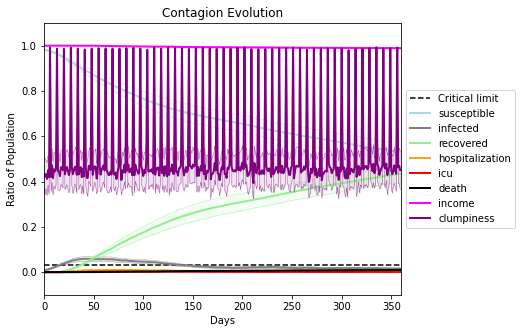

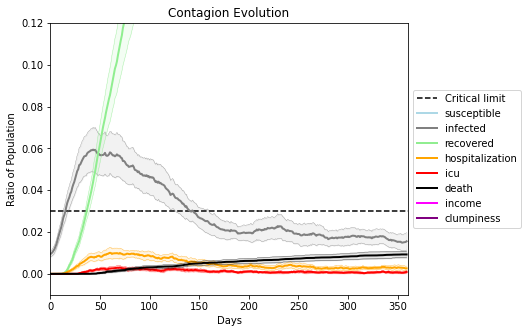

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9427, 9210, 8309, 2106, 7833, 6819, 6181, 7452, 4899, 3655, 4709, 5214, 1956, 7676, 377, 7635, 8924, 2898, 3483, 7632]
Average similarity between family members is 0.9617913705219167 at temperature -0.9975
Average similarity between family and home is 0.9998549868977646 at temperature -1
Average similarity between students and their classroom is 0.6701960255963268 at temperature -0.9975
Average classroom occupancy is 3.8714285714285714 and number classrooms is 70
Average similarity between workers is 0.941018911148099 at temperature -0.9975
Average office occupancy is 3.560846560846561 and number offices is 189
Average friend similarity for adults: 0.8665013472884819 for kids: 0.7058649525266112
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.6693455565290112
avg restaurant similarity 0.7986619321563214
avg restaurant similarity 0.9321726808799262
avg restaurant similarity 0.5836154520514228
avg restaurant similarity 0.4492970895577378
avg restaurant similarity 0.619211260710358
avg restaurant similarity 0.745222065919354
avg restaurant similarity 0.6531392498485725
avg restaurant similarity 0.6838513047984826
avg restaurant similarity 0.8636214047890778
avg restaurant similarity 0.5293310490350722
avg restaurant similarity 0.7678348266079639
avg restaurant similarity 0.6079662280769134
avg restaurant similarity 0.5392658354749078
avg restaurant similarity 0.6312650443798302
avg restaurant similarity 0.841890483290444
avg restaurant similarity 0.556764463159731
avg restaurant similarity 0.5373968908429244
avg restaurant similarity 0.9461870941809174
avg restaurant similarity 0.46552672897735115
avg restaurant similarity 0.6809803388540167
avg restaurant similarity 0.4124699337131402
avg restauran

avg restaurant similarity 0.5923860177800445
avg restaurant similarity 0.4563972694014041
avg restaurant similarity 0.9997680691350206
avg restaurant similarity 0.5536507692904077
avg restaurant similarity 0.6069431133482114
avg restaurant similarity 0.4457361569324142
avg restaurant similarity 0.6729110300805053
avg restaurant similarity 0.5753440290818617
avg restaurant similarity 0.3793450020259139
avg restaurant similarity 0.40532015215044304
avg restaurant similarity 0.672378871318289
avg restaurant similarity 0.5290377226017771
avg restaurant similarity 0.6549583118952572
avg restaurant similarity 0.5211457143438857
avg restaurant similarity 0.6085493078564694
avg restaurant similarity 0.6431806171908335
avg restaurant similarity 0.3917371664715834
avg restaurant similarity 0.6260871961159542
avg restaurant similarity 0.6123442150908389
avg restaurant similarity 0.5779704330864567
avg restaurant similarity 0.4165921725514082
avg restaurant similarity 0.8383220518425565
avg restau

avg restaurant similarity 0.5507824635851756
avg restaurant similarity 0.48433387630894775
avg restaurant similarity 0.6493205349236955
avg restaurant similarity 0.5371442510323484
avg restaurant similarity 0.587451964365693
avg restaurant similarity 0.4994931362702679
avg restaurant similarity 0.5727460524669415
avg restaurant similarity 0.4860670756552026
avg restaurant similarity 0.5478483453275714
avg restaurant similarity 0.5416610025151538
avg restaurant similarity 0.5898774976443487
avg restaurant similarity 0.6801727766948638
avg restaurant similarity 0.5776879543878567
avg restaurant similarity 0.4778093799880743
avg restaurant similarity 0.62674979836386
avg restaurant similarity 0.5579744636407097
avg restaurant similarity 0.4822084619363302
avg restaurant similarity 0.5597057087896797
avg restaurant similarity 0.46961572757356185
avg restaurant similarity 0.5607630433713882
avg restaurant similarity 0.5750361218245545
avg restaurant similarity 0.44540630122803654
avg restau

avg restaurant similarity 0.5186599954982557
avg restaurant similarity 0.653857875618987
avg restaurant similarity 0.5705283380763403
avg restaurant similarity 0.4958404415213392
avg restaurant similarity 0.6581173798537735
avg restaurant similarity 0.5242480822356342
avg restaurant similarity 0.6610528581329528
avg restaurant similarity 0.5723184795790666
avg restaurant similarity 0.6002396684672427
avg restaurant similarity 0.5585306358763464
avg restaurant similarity 0.526785453496116
avg restaurant similarity 0.6868327837875674
avg restaurant similarity 0.647389833606536
avg restaurant similarity 0.4281168541573735
avg restaurant similarity 0.5342751340332319
avg restaurant similarity 0.4953866386699264
avg restaurant similarity 0.5095264196287383
avg restaurant similarity 0.566112739773991
avg restaurant similarity 0.5133120032443407
avg restaurant similarity 0.5399742456514718
avg restaurant similarity 0.6556553491192683
avg restaurant similarity 0.6336939851453031
avg restaurant

avg restaurant similarity 0.7935396019899906
avg restaurant similarity 0.5374462523407195
avg restaurant similarity 0.7868732802604184
avg restaurant similarity 0.7197506191630887
avg restaurant similarity 0.7360075285332826
avg restaurant similarity 0.7043866221148571
avg restaurant similarity 0.7490525271553297
avg restaurant similarity 0.5729703175772606
avg restaurant similarity 0.641000469350015
avg restaurant similarity 0.48096123790556916
avg restaurant similarity 0.5217068362331206
avg restaurant similarity 0.6327271244398346
avg restaurant similarity 0.7727387798482122
avg restaurant similarity 0.7566886606247037
avg restaurant similarity 0.6556086102300687
avg restaurant similarity 0.7176649918304713
avg restaurant similarity 0.6760553214421264
avg restaurant similarity 0.31774558794272056
avg restaurant similarity 0.6740697885924205
avg restaurant similarity 0.4071237634966675
avg restaurant similarity 0.6036499331351131
avg restaurant similarity 0.8549501678302369
avg resta

avg restaurant similarity 0.6361558665916803
avg restaurant similarity 0.7031724900290933
avg restaurant similarity 0.6096357947242256
avg restaurant similarity 0.577958597988909
avg restaurant similarity 0.625796649141092
avg restaurant similarity 0.7780953604735401
avg restaurant similarity 0.7236254221027646
avg restaurant similarity 0.6813409559018674
avg restaurant similarity 0.7488979696261605
avg restaurant similarity 0.6631681374711579
avg restaurant similarity 0.9998097765345452
avg restaurant similarity 0.6667371101661801
avg restaurant similarity 0.6205948469156449
avg restaurant similarity 0.5781026170512115
avg restaurant similarity 0.7157458063991251
avg restaurant similarity 0.6574711148701088
avg restaurant similarity 0.6938983592657876
avg restaurant similarity 0.6121942384388045
avg restaurant similarity 0.6786839386838661
avg restaurant similarity 0.6452474647633575
avg restaurant similarity 0.792167513940838
avg restaurant similarity 0.5194185672487758
avg restauran

avg restaurant similarity 0.5672858339052451
avg restaurant similarity 0.6429409162784366
avg restaurant similarity 0.5453478070271788
avg restaurant similarity 0.5833988132203515
avg restaurant similarity 0.6611602610039529
avg restaurant similarity 0.548865672270705
avg restaurant similarity 0.4773189183863828
avg restaurant similarity 0.6419242047124522
avg restaurant similarity 0.5454441379599309
avg restaurant similarity 0.5976985004254433
avg restaurant similarity 0.4357740489524886
avg restaurant similarity 0.5939130765366724
avg restaurant similarity 0.6135807832932695
avg restaurant similarity 0.4363456426626578
avg restaurant similarity 0.6556855453818925
avg restaurant similarity 0.6362469529746961
avg restaurant similarity 0.6271123849050615
avg restaurant similarity 0.5651218296867607
avg restaurant similarity 0.5680762527073735
avg restaurant similarity 0.6306245156573989
avg restaurant similarity 0.5549933016817976
avg restaurant similarity 0.640276222697863
avg restaura

avg restaurant similarity 0.621745148515338
avg restaurant similarity 0.7834520047604523
avg restaurant similarity 0.6574496206364502
avg restaurant similarity 0.6328005080663358
avg restaurant similarity 0.5410092142981622
avg restaurant similarity 0.7103509651089032
avg restaurant similarity 0.7017110855166243
avg restaurant similarity 0.5858738989780635
avg restaurant similarity 0.6474216610394224
avg restaurant similarity 0.49672506211935574
avg restaurant similarity 0.585089910859559
avg restaurant similarity 0.5380417753592297
avg restaurant similarity 0.6443165667969639
avg restaurant similarity 0.572963254641381
avg restaurant similarity 0.5037791418884685
avg restaurant similarity 0.5718404828335553
avg restaurant similarity 0.5665697131974957
avg restaurant similarity 0.6032619027323377
avg restaurant similarity 0.6101181523234286
avg restaurant similarity 0.7225646503180281
avg restaurant similarity 0.5420614677906652
avg restaurant similarity 0.534530555691117
avg restauran

avg restaurant similarity 0.6059846527838718
avg restaurant similarity 0.5189858016673126
avg restaurant similarity 0.5780953756143705
avg restaurant similarity 0.5164354600121804
avg restaurant similarity 0.5315763508759913
avg restaurant similarity 0.544248223736478
avg restaurant similarity 0.5815973253338226
avg restaurant similarity 0.48783478838161165
avg restaurant similarity 0.5921909025184576
avg restaurant similarity 0.5464451396968897
avg restaurant similarity 0.5129319375665236
avg restaurant similarity 0.6785914942414355
avg restaurant similarity 0.6191456057629147
avg restaurant similarity 0.5373517350270727
avg restaurant similarity 0.635878488006716
avg restaurant similarity 0.5013403029808045
avg restaurant similarity 0.6016067009964561
avg restaurant similarity 0.608953597732351
avg restaurant similarity 0.5594994575786114
avg restaurant similarity 0.7516125996212855
avg restaurant similarity 0.5006567238642674
avg restaurant similarity 0.6230280947569652
avg restaura

avg restaurant similarity 0.6439848391958551
avg restaurant similarity 0.5198506153964177
avg restaurant similarity 0.5845998187789332
avg restaurant similarity 0.5740732300405119
avg restaurant similarity 0.59396533498208
avg restaurant similarity 0.5031604973758419
avg restaurant similarity 0.564336394871336
avg restaurant similarity 0.49717836283155753
avg restaurant similarity 0.4962871531632137
avg restaurant similarity 0.6740064678164758
avg restaurant similarity 0.5527587224172684
avg restaurant similarity 0.5718665602395293
avg restaurant similarity 0.5773197049961303
avg restaurant similarity 0.4444675971514125
avg restaurant similarity 0.5562957053687348
avg restaurant similarity 0.451894661693999
avg restaurant similarity 0.48249538502527384
avg restaurant similarity 0.5453631368305372
avg restaurant similarity 0.5929305381161747
avg restaurant similarity 0.7493867480483136
avg restaurant similarity 0.6249681640326851
avg restaurant similarity 0.6641603674107419
avg restaura

avg restaurant similarity 0.611005688117921
avg restaurant similarity 0.7715466973830072
avg restaurant similarity 0.5805729893131939
avg restaurant similarity 0.6126051846033249
avg restaurant similarity 0.6110900817452701
avg restaurant similarity 0.6249555062969746
avg restaurant similarity 0.6711372115499472
avg restaurant similarity 0.8390448366718765
avg restaurant similarity 0.5404300846438839
avg restaurant similarity 0.6684767070629147
avg restaurant similarity 0.6596453772598946
avg restaurant similarity 0.6526927766192188
avg restaurant similarity 0.7993924680684166
avg restaurant similarity 0.6078200731317297
avg restaurant similarity 0.5059550250767973
avg restaurant similarity 0.5599444095472708
avg restaurant similarity 0.6979069302490771
avg restaurant similarity 0.6106279760151307
avg restaurant similarity 0.721322844162938
avg restaurant similarity 0.5595254475513669
avg restaurant similarity 0.7410613045666586
avg restaurant similarity 0.5768231400692743
avg restaura

avg restaurant similarity 0.7991578894660231
avg restaurant similarity 0.6238283800484141
avg restaurant similarity 0.6216253391333937
avg restaurant similarity 0.5934378356101536
avg restaurant similarity 0.7692126113926845
avg restaurant similarity 0.6576027898239726
avg restaurant similarity 0.6374327167598489
avg restaurant similarity 0.5854408562644756
avg restaurant similarity 0.8196437795648377
avg restaurant similarity 0.7559502546748978
avg restaurant similarity 0.7745719268542294
avg restaurant similarity 0.8090550215533867
avg restaurant similarity 0.5341144144443747
avg restaurant similarity 0.5984842368036599
avg restaurant similarity 0.6062653251467024
avg restaurant similarity 0.5784821173075246
avg restaurant similarity 0.9008997010831062
avg restaurant similarity 0.677966945280694
avg restaurant similarity 0.7202014398688754
avg restaurant similarity 0.7845331154593553
avg restaurant similarity 0.7913147602381149
avg restaurant similarity 0.40046176687144475
avg restau

avg restaurant similarity 0.6669145811814818
avg restaurant similarity 0.6410984186520395
avg restaurant similarity 0.579893256382655
avg restaurant similarity 0.9998394758091453
avg restaurant similarity 0.6949672664053548
avg restaurant similarity 0.548019129339553
avg restaurant similarity 0.6394303524585455
avg restaurant similarity 0.835306318048774
avg restaurant similarity 0.33969927817575574
avg restaurant similarity 0.6032689701428708
avg restaurant similarity 0.7511758297319377
avg restaurant similarity 0.6344486292931555
avg restaurant similarity 0.6092207867947895
avg restaurant similarity 0.5808213607394598
avg restaurant similarity 0.5822231098999862
avg restaurant similarity 0.5276771595882305
avg restaurant similarity 0.7865633345209232
avg restaurant similarity 0.5028181335833418
avg restaurant similarity 0.7937676827234319
avg restaurant similarity 0.8243046573578208
avg restaurant similarity 0.7333013047423392
avg restaurant similarity 0.4423419359615322
avg restaura

avg restaurant similarity 0.4953776523190697
avg restaurant similarity 0.5157558508869824
avg restaurant similarity 0.838104169062194
avg restaurant similarity 0.7551233785045309
avg restaurant similarity 0.5852657095763372
avg restaurant similarity 0.6631378869079859
avg restaurant similarity 0.8353723396618049
avg restaurant similarity 0.6622286900674681
avg restaurant similarity 0.3368648326119511
avg restaurant similarity 0.8230332666668616
avg restaurant similarity 0.7975498367777606
avg restaurant similarity 0.6389960032208103
avg restaurant similarity 0.733704054878137
avg restaurant similarity 0.759596420888297
avg restaurant similarity 0.2959345565168053
avg restaurant similarity 0.6972676429792449
avg restaurant similarity 0.4469739851185447
avg restaurant similarity 0.8104125386651373
avg restaurant similarity 0.9998394758091453
avg restaurant similarity 0.9671476297373158
avg restaurant similarity 0.5154299235845893
avg restaurant similarity 0.558541494915168
avg restaurant

avg restaurant similarity 0.7762199597571364
avg restaurant similarity 0.7508910346160445
avg restaurant similarity 0.6854178218540325
avg restaurant similarity 0.8068225769659987
avg restaurant similarity 0.8213068237327775
avg restaurant similarity 0.5839621792829478
avg restaurant similarity 0.6653941211244164
avg restaurant similarity 0.6866631725057848
avg restaurant similarity 0.8857350467272695
avg restaurant similarity 0.6488875406437826
avg restaurant similarity 0.5901975307953922
avg restaurant similarity 0.7785610108776321
avg restaurant similarity 0.45368877301404953
avg restaurant similarity 0.6549946758901252
avg restaurant similarity 0.7236229050221166
avg restaurant similarity 0.430589983861624
avg restaurant similarity 0.5799045674599071
avg restaurant similarity 0.5212004967264585
avg restaurant similarity 0.8700321573367493
avg restaurant similarity 0.6377131917230329
avg restaurant similarity 0.5986345776817015
avg restaurant similarity 0.7900389168873425
avg restau

avg restaurant similarity 0.36046591624748686
avg restaurant similarity 0.5057436951184222
avg restaurant similarity 0.5899142443923464
avg restaurant similarity 0.642914176385102
avg restaurant similarity 0.6547071419959956
avg restaurant similarity 0.5618677543046839
avg restaurant similarity 0.668324668895106
avg restaurant similarity 0.5332301096732321
avg restaurant similarity 0.517362127491607
avg restaurant similarity 0.71352057086478
avg restaurant similarity 0.6813552960456194
avg restaurant similarity 0.6117234969464121
avg restaurant similarity 0.8085486439200563
avg restaurant similarity 0.707673572961271
avg restaurant similarity 0.7653299893961083
avg restaurant similarity 0.5305087901778788
avg restaurant similarity 0.6986595649591126
avg restaurant similarity 0.6132635272480996
avg restaurant similarity 0.6705064279717229
avg restaurant similarity 0.5151362450959359
avg restaurant similarity 0.7165403254734876
avg restaurant similarity 0.7183919805195007
avg restaurant 

avg restaurant similarity 0.7356983450392982
avg restaurant similarity 0.6232118462002815
avg restaurant similarity 0.596455587552519
avg restaurant similarity 0.6450590988709338
avg restaurant similarity 0.7901312704380431
avg restaurant similarity 0.768149082608594
avg restaurant similarity 0.49166573901021443
avg restaurant similarity 0.8198404541503512
avg restaurant similarity 0.5813313959262494
avg restaurant similarity 0.716471127405898
avg restaurant similarity 0.692567876952132
avg restaurant similarity 0.6160955553490982
avg restaurant similarity 0.5772501286253665
avg restaurant similarity 0.8560771758579175
avg restaurant similarity 0.6908112423865447
avg restaurant similarity 0.47597940050323806
avg restaurant similarity 0.5647595591486322
avg restaurant similarity 0.47114482731179785
avg restaurant similarity 0.5405020114378893
avg restaurant similarity 0.738118980636114
avg restaurant similarity 0.5694766335119804
avg restaurant similarity 0.6518912691998032
avg restaura

avg restaurant similarity 0.5430717181952274
avg restaurant similarity 0.6167368393223929
avg restaurant similarity 0.6453006212786793
avg restaurant similarity 0.644669698310891
avg restaurant similarity 0.6905105026286212
avg restaurant similarity 0.5856526985978155
avg restaurant similarity 0.6082428947138511
avg restaurant similarity 0.7729140080993282
avg restaurant similarity 0.6578332710126816
avg restaurant similarity 0.6905154972933325
avg restaurant similarity 0.8565225126172351
avg restaurant similarity 0.7466305855183504
avg restaurant similarity 0.49540987999001895
avg restaurant similarity 0.6184405747042125
avg restaurant similarity 0.6978604349392321
avg restaurant similarity 0.5925017080701628
avg restaurant similarity 0.6687271402149557
avg restaurant similarity 0.781485624631803
avg restaurant similarity 0.7839856114768885
avg restaurant similarity 0.6452586712004909
avg restaurant similarity 0.58313373815173
avg restaurant similarity 0.5403769054739512
avg restauran

avg restaurant similarity 0.6517067290790775
avg restaurant similarity 0.9665241892191504
avg restaurant similarity 0.8787031005669739
avg restaurant similarity 0.7166493146727363
avg restaurant similarity 0.7443105929565408
avg restaurant similarity 0.7111416133508756
avg restaurant similarity 0.7648109821327878
avg restaurant similarity 0.5378378395424974
avg restaurant similarity 0.7317974863231804
avg restaurant similarity 0.757021583628022
avg restaurant similarity 0.6515952554889387
avg restaurant similarity 0.4082361421463738
avg restaurant similarity 0.6388253739657257
avg restaurant similarity 0.6892553259733495
avg restaurant similarity 0.8059050031810511
avg restaurant similarity 0.9147632231494884
avg restaurant similarity 0.7334711174014615
avg restaurant similarity 0.7460535002281331
avg restaurant similarity 0.6496159475833081
avg restaurant similarity 0.500036682214142
avg restaurant similarity 0.7894330607198727
avg restaurant similarity 0.7016973407801796
avg restaura

avg restaurant similarity 0.7500796887535496
avg restaurant similarity 0.6066473142814743
avg restaurant similarity 0.7399219080456524
avg restaurant similarity 0.43485857463422617
avg restaurant similarity 0.6242508283896322
avg restaurant similarity 0.7430261660082724
avg restaurant similarity 0.7467680448664561
avg restaurant similarity 0.6192517046209783
avg restaurant similarity 0.7009559193280792
avg restaurant similarity 0.6698172405914263
avg restaurant similarity 0.7665547165463082
avg restaurant similarity 0.8564942625210298
avg restaurant similarity 0.6178907682466436
avg restaurant similarity 0.6199292395838991
avg restaurant similarity 0.817180827209215
avg restaurant similarity 0.8566324665278587
avg restaurant similarity 0.8024369768503675
avg restaurant similarity 0.5950048459921365
avg restaurant similarity 0.7945906957138278
avg restaurant similarity 0.7023540681664141
avg restaurant similarity 0.7235440564029082
avg restaurant similarity 0.6093532567131748
avg restau

avg restaurant similarity 0.6182431881949481
avg restaurant similarity 0.7488118900079228
avg restaurant similarity 0.4599496515874151
avg restaurant similarity 0.6306404766400202
avg restaurant similarity 0.6455566222342105
avg restaurant similarity 0.3602463931017312
avg restaurant similarity 0.4964810889866062
avg restaurant similarity 0.6215243619551214
avg restaurant similarity 0.5931073645577141
avg restaurant similarity 0.7564259849471917
avg restaurant similarity 0.4857910471772069
avg restaurant similarity 0.516654617505256
avg restaurant similarity 0.6674757127481776
avg restaurant similarity 0.5102464486233519
avg restaurant similarity 0.4901747859536886
avg restaurant similarity 0.6509938947686259
avg restaurant similarity 0.5836154105519756
avg restaurant similarity 0.58221641833957
avg restaurant similarity 0.5949646808183728
avg restaurant similarity 0.9276313173590934
avg restaurant similarity 0.5615254461682128
avg restaurant similarity 0.5577128800421187
avg restauran

avg restaurant similarity 0.6447183613066666
avg restaurant similarity 0.5205293336354792
avg restaurant similarity 0.5601666130999851
avg restaurant similarity 0.6827235997980384
avg restaurant similarity 0.48566395373630644
avg restaurant similarity 0.5643445459379584
avg restaurant similarity 0.726162775696002
avg restaurant similarity 0.5047148140078758
avg restaurant similarity 0.6355522089657255
avg restaurant similarity 0.5595387471473081
avg restaurant similarity 0.6399759407221941
avg restaurant similarity 0.4832083614576902
avg restaurant similarity 0.5148134492716933
avg restaurant similarity 0.6015751041445732
avg restaurant similarity 0.53282254771299
avg restaurant similarity 0.5860992545663946
avg restaurant similarity 0.661272256445125
avg restaurant similarity 0.43126757505235513
avg restaurant similarity 0.7323722362387638
avg restaurant similarity 0.6254750439711371
avg restaurant similarity 0.627027956390447
avg restaurant similarity 0.5928273682075799
avg restauran

avg restaurant similarity 0.6315942289272022
avg restaurant similarity 0.6399587203383207
avg restaurant similarity 0.7647099453461489
avg restaurant similarity 0.5208845255533617
avg restaurant similarity 0.4943007174855394
avg restaurant similarity 0.48248664585510503
avg restaurant similarity 0.5595380895767577
avg restaurant similarity 0.6187589039008156
avg restaurant similarity 0.6931010863374165
avg restaurant similarity 0.5515674255797568
avg restaurant similarity 0.6083451917148422
avg restaurant similarity 0.6498032582084103
avg restaurant similarity 0.5563362059368859
avg restaurant similarity 0.41328694746416117
avg restaurant similarity 0.8421093752355349
avg restaurant similarity 0.5553771452148053
avg restaurant similarity 0.6047076938822027
avg restaurant similarity 0.727221035685046
avg restaurant similarity 0.6027300075101467
avg restaurant similarity 0.6136921038139225
avg restaurant similarity 0.5783668928875967
avg restaurant similarity 0.6445071399230075
avg resta

avg restaurant similarity 0.4346740526389118
avg restaurant similarity 0.6519839614781391
avg restaurant similarity 0.6051210302559611
avg restaurant similarity 0.3572313138506875
avg restaurant similarity 0.7251429035213222
avg restaurant similarity 0.6232505707309194
avg restaurant similarity 0.6161977696158427
avg restaurant similarity 0.526851514288353
avg restaurant similarity 0.588311766592341
avg restaurant similarity 0.616955694765545
avg restaurant similarity 0.5505938494363313
avg restaurant similarity 0.8243684340456028
avg restaurant similarity 0.6737484055891801
avg restaurant similarity 0.7397569184664071
avg restaurant similarity 0.7002934073021035
avg restaurant similarity 0.6846189951768265
avg restaurant similarity 0.9997327434985764
avg restaurant similarity 0.15947174918163012
avg restaurant similarity 0.6673250408531183
avg restaurant similarity 0.6751574036015288
avg restaurant similarity 0.677770322693362
avg restaurant similarity 0.5365389568843101
avg restauran

avg restaurant similarity 0.5745759240902578
avg restaurant similarity 0.7344238404909784
avg restaurant similarity 0.7553745038493882
avg restaurant similarity 0.5624390427906284
avg restaurant similarity 0.6039611709625802
avg restaurant similarity 0.5752026089255443
avg restaurant similarity 0.6424075077735001
avg restaurant similarity 0.6184573671046578
avg restaurant similarity 0.5975113759774462
avg restaurant similarity 0.7139391494597093
avg restaurant similarity 0.6340025429598961
avg restaurant similarity 0.6076539821228808
avg restaurant similarity 0.6213607575459051
avg restaurant similarity 0.7397286949407988
avg restaurant similarity 0.9280509588725924
avg restaurant similarity 0.677484066585495
avg restaurant similarity 0.643800829480731
avg restaurant similarity 0.7246659061104337
avg restaurant similarity 0.7050435910114805
avg restaurant similarity 0.7524067412494515
avg restaurant similarity 0.8720410732806093
avg restaurant similarity 0.896608541637865
avg restauran

avg restaurant similarity 0.5071541104762203
avg restaurant similarity 0.689354418450531
avg restaurant similarity 0.5581550348740519
avg restaurant similarity 0.5179009105131018
avg restaurant similarity 0.6232547276922232
avg restaurant similarity 0.6701545940979523
avg restaurant similarity 0.571404252359062
avg restaurant similarity 0.5047681009095665
avg restaurant similarity 0.7699958887771766
avg restaurant similarity 0.6781240919664493
avg restaurant similarity 0.7234392761852634
avg restaurant similarity 0.6131603152260142
avg restaurant similarity 0.6492638179242439
avg restaurant similarity 0.6069870498292267
avg restaurant similarity 0.733601464439228
avg restaurant similarity 0.6055162869822083
avg restaurant similarity 0.7905681913939998
avg restaurant similarity 0.5399246915397232
avg restaurant similarity 0.6551182843877205
avg restaurant similarity 0.5335903824501069
avg restaurant similarity 0.8078235853292476
avg restaurant similarity 0.7072467598075689
avg restauran

avg restaurant similarity 0.6258486273445388
avg restaurant similarity 0.719663759429905
avg restaurant similarity 0.570594501575126
avg restaurant similarity 0.5992075583084722
avg restaurant similarity 0.6032635251956506
avg restaurant similarity 0.5824143393362731
avg restaurant similarity 0.7842673308128136
avg restaurant similarity 0.5293470545330735
avg restaurant similarity 0.6300471754922232
avg restaurant similarity 0.7820880317066894
avg restaurant similarity 0.6816195820140862
avg restaurant similarity 0.37258543868993893
avg restaurant similarity 0.518085110778207
avg restaurant similarity 0.464103951592156
avg restaurant similarity 0.2921109004252669
avg restaurant similarity 0.7188447949182803
avg restaurant similarity 0.6426611867955772
avg restaurant similarity 0.7824015148077549
avg restaurant similarity 0.4193035253090989
avg restaurant similarity 0.837206634075118
avg restaurant similarity 0.9406170779140851
avg restaurant similarity 0.5950937422075596
avg restaurant

avg restaurant similarity 0.5662505952599578
avg restaurant similarity 0.5532497545446502
avg restaurant similarity 0.5315479406930655
avg restaurant similarity 0.571646761814103
avg restaurant similarity 0.7639167906847066
avg restaurant similarity 0.7369661393554594
avg restaurant similarity 0.5721164019420972
avg restaurant similarity 0.3523015816088432
avg restaurant similarity 0.810753986862057
avg restaurant similarity 0.6243593293389881
avg restaurant similarity 0.5558529143228255
avg restaurant similarity 0.6890970998673601
avg restaurant similarity 0.6429184561999609
avg restaurant similarity 0.6572936194936263
avg restaurant similarity 0.6489858149799062
avg restaurant similarity 0.5435856712715801
avg restaurant similarity 0.6635779516312792
avg restaurant similarity 0.570852456070228
avg restaurant similarity 0.3869282546647091
avg restaurant similarity 0.6565648665405903
avg restaurant similarity 0.6560451562092134
avg restaurant similarity 0.5293048697759993
avg restauran

avg restaurant similarity 0.7212674120359461
avg restaurant similarity 0.8542736242676567
avg restaurant similarity 0.5494658246469689
avg restaurant similarity 0.6758559473397485
avg restaurant similarity 0.5697781513717624
avg restaurant similarity 0.5416554628275234
avg restaurant similarity 0.5927914114008342
avg restaurant similarity 0.34202978873219936
avg restaurant similarity 0.8426353470598142
avg restaurant similarity 0.7870041251267109
avg restaurant similarity 0.6882623228976978
avg restaurant similarity 0.6942706877334497
avg restaurant similarity 0.6138101164656253
avg restaurant similarity 0.6737411856007343
avg restaurant similarity 0.920759074026307
avg restaurant similarity 0.39288604813318073
avg restaurant similarity 0.8704975926630539
avg restaurant similarity 0.8709686559425218
avg restaurant similarity 0.6671440780072456
avg restaurant similarity 0.7798246579863255
avg restaurant similarity 0.6283119543418848
avg restaurant similarity 0.6391398219352074
avg resta

avg restaurant similarity 0.6138245603248534
avg restaurant similarity 0.6608269567906367
avg restaurant similarity 0.6844920673593458
avg restaurant similarity 0.5193827688870747
avg restaurant similarity 0.8350646429655868
avg restaurant similarity 0.9998923144955905
avg restaurant similarity 0.4503603996413378
avg restaurant similarity 0.5652607092056067
avg restaurant similarity 0.7365240184720523
avg restaurant similarity 0.9997623646211327
avg restaurant similarity 0.6728627303276519
avg restaurant similarity 0.6829460780692902
avg restaurant similarity 0.4221991334632301
avg restaurant similarity 0.9998242647246989
avg restaurant similarity 0.4796804257857463
avg restaurant similarity 0.7711590365071198
avg restaurant similarity 0.712637842597548
avg restaurant similarity 0.6482602974438104
avg restaurant similarity 0.5556905851349072
avg restaurant similarity 0.8011790347700273
avg restaurant similarity 0.8700445666792084
avg restaurant similarity 0.575388983136877
avg restaura

avg restaurant similarity 0.659588597610551
avg restaurant similarity 0.6135698819990186
avg restaurant similarity 0.753099730163405
avg restaurant similarity 0.7385937564137213
avg restaurant similarity 0.777706858694057
avg restaurant similarity 0.5927427347553014
avg restaurant similarity 0.7476787980205597
avg restaurant similarity 0.7180359911227592
avg restaurant similarity 0.5623577615845456
avg restaurant similarity 0.509399078178899
avg restaurant similarity 0.7538442081532649
avg restaurant similarity 0.624456903774377
avg restaurant similarity 0.665200334798709
avg restaurant similarity 0.673626911668028
avg restaurant similarity 0.8977779290070725
avg restaurant similarity 0.5583020377179957
avg restaurant similarity 0.7065330846606183
avg restaurant similarity 0.6772934880288121
avg restaurant similarity 0.5318688803978973
avg restaurant similarity 0.6606382832497911
avg restaurant similarity 0.589372672507867
avg restaurant similarity 0.5888100739567661
avg restaurant sim

avg restaurant similarity 0.6923060489439072
avg restaurant similarity 0.718543840755705
avg restaurant similarity 0.7145539002734453
avg restaurant similarity 0.5509355000180435
avg restaurant similarity 0.4991398730584197
avg restaurant similarity 0.6134720365027357
avg restaurant similarity 0.7836003832248355
avg restaurant similarity 0.5895276871664994
avg restaurant similarity 0.6684085614880142
avg restaurant similarity 0.6686776514440183
avg restaurant similarity 0.6755992231398726
avg restaurant similarity 0.7509728019385915
avg restaurant similarity 0.8653220485263777
avg restaurant similarity 0.6568513617266202
avg restaurant similarity 0.5564992665736724
avg restaurant similarity 0.574308688582069
avg restaurant similarity 0.5356638732301792
avg restaurant similarity 0.6518158133539713
avg restaurant similarity 0.6129947581374998
avg restaurant similarity 0.7792867750157896
avg restaurant similarity 0.6124046447326932
avg restaurant similarity 0.6357984706002552
avg restaura

avg restaurant similarity 0.487506704293369
avg restaurant similarity 0.5717917624188157
avg restaurant similarity 0.6542189817649621
avg restaurant similarity 0.7665641835432344
avg restaurant similarity 0.7576702035792405
avg restaurant similarity 0.6182607359366387
avg restaurant similarity 0.7600985716990853
avg restaurant similarity 0.7963225943369148
avg restaurant similarity 0.8280816390666277
avg restaurant similarity 0.7349894745833363
avg restaurant similarity 0.6196047503135973
avg restaurant similarity 0.8206648211829637
avg restaurant similarity 0.7393247467676823
avg restaurant similarity 0.33582363556990813
avg restaurant similarity 0.8640225421426609
avg restaurant similarity 0.8115893350604544
avg restaurant similarity 0.4993621691658565
avg restaurant similarity 0.4762089851957695
avg restaurant similarity 0.5768665496494247
avg restaurant similarity 0.656541170704183
avg restaurant similarity 0.9997301879094842
avg restaurant similarity 0.8930068159825797
avg restaur

avg restaurant similarity 0.5990344047216716
avg restaurant similarity 0.7012467686673116
avg restaurant similarity 0.6950935383720303
avg restaurant similarity 0.7030341955441569
avg restaurant similarity 0.7469052002252187
avg restaurant similarity 0.77176306557219
avg restaurant similarity 0.879765262001508
avg restaurant similarity 0.6723720523170745
avg restaurant similarity 0.8660760333915118
avg restaurant similarity 0.9098999286851341
avg restaurant similarity 0.6758173254999285
avg restaurant similarity 0.7087737260726451
avg restaurant similarity 0.7348316482990723
avg restaurant similarity 0.8172513947033242
avg restaurant similarity 0.6541924382932811
avg restaurant similarity 0.7669011858700698
avg restaurant similarity 0.7394188558319792
avg restaurant similarity 0.8516793111136215
avg restaurant similarity 0.6997032969854855
avg restaurant similarity 0.599110312659832
avg restaurant similarity 0.5470273590989161
avg restaurant similarity 0.6395892970191472
avg restaurant

avg restaurant similarity 0.629171366441124
avg restaurant similarity 0.4645815900058141
avg restaurant similarity 0.704987646344059
avg restaurant similarity 0.7203990514045373
avg restaurant similarity 0.5993170475728845
avg restaurant similarity 0.5787180702053647
avg restaurant similarity 0.6790832769112646
avg restaurant similarity 0.6487664731555105
avg restaurant similarity 0.7361259460469377
avg restaurant similarity 0.7497322942118998
avg restaurant similarity 0.6372813299703708
avg restaurant similarity 0.578279450355178
avg restaurant similarity 0.3136774665762529
avg restaurant similarity 0.6906165236160788
avg restaurant similarity 0.693964476235549
avg restaurant similarity 0.6118498432702864
avg restaurant similarity 0.6300315730640806
avg restaurant similarity 0.7678246447505074
avg restaurant similarity 0.5822366333908142
avg restaurant similarity 0.5558109522446022
avg restaurant similarity 0.7430428691390456
avg restaurant similarity 0.5905880566128829
avg restaurant

avg restaurant similarity 0.6468353594454448
avg restaurant similarity 0.8156343406192952
avg restaurant similarity 0.5787158182552312
avg restaurant similarity 0.5680736420409771
avg restaurant similarity 0.615741420932318
avg restaurant similarity 0.6779673713827127
avg restaurant similarity 0.7002079251786062
avg restaurant similarity 0.8136787850351843
avg restaurant similarity 0.743777630045141
avg restaurant similarity 0.6733022989748987
avg restaurant similarity 0.6991731736749229
avg restaurant similarity 0.47614557514347877
avg restaurant similarity 0.6084033010138451
avg restaurant similarity 0.677219619101291
avg restaurant similarity 0.8516080416504845
avg restaurant similarity 0.5858341452382
avg restaurant similarity 0.7136238017469733
avg restaurant similarity 0.562824980802764
avg restaurant similarity 0.5868061249644619
avg restaurant similarity 0.5969366549987586
avg restaurant similarity 0.5343147565329992
avg restaurant similarity 0.5336530373064623
avg restaurant s

avg restaurant similarity 0.5722146107154464
avg restaurant similarity 0.5534317483537735
avg restaurant similarity 0.47561294268970544
avg restaurant similarity 0.5473782952273114
avg restaurant similarity 0.6795908373528458
avg restaurant similarity 0.42113689209805155
avg restaurant similarity 0.7217798416497457
avg restaurant similarity 0.6455030774985765
avg restaurant similarity 0.6936037780416318
avg restaurant similarity 0.8437748286433003
avg restaurant similarity 0.6365326356329942
avg restaurant similarity 0.6638436376834413
avg restaurant similarity 0.6190100480128621
avg restaurant similarity 0.5598009163024253
avg restaurant similarity 0.6757128580219021
avg restaurant similarity 0.6773744818643447
avg restaurant similarity 0.6613372999501357
avg restaurant similarity 0.7125685408414765
avg restaurant similarity 0.6418248155703308
avg restaurant similarity 0.7350049830928564
avg restaurant similarity 0.725562048492439
avg restaurant similarity 0.587412305884385
avg restau

avg restaurant similarity 0.509928968834971
avg restaurant similarity 0.7358595572421947
avg restaurant similarity 0.5408088493776977
avg restaurant similarity 0.6156368486776191
avg restaurant similarity 0.6028686577505562
avg restaurant similarity 0.7064170026582971
avg restaurant similarity 0.5067758274070655
avg restaurant similarity 0.6683511251902199
avg restaurant similarity 0.6172491725154238
avg restaurant similarity 0.4720609812606005
avg restaurant similarity 0.664821428031087
avg restaurant similarity 0.5503050940399188
avg restaurant similarity 0.6721130921546025
avg restaurant similarity 0.36792655011124364
avg restaurant similarity 0.7071305728190916
avg restaurant similarity 0.7363886489307665
avg restaurant similarity 0.5217251523855961
avg restaurant similarity 0.544530933388349
avg restaurant similarity 0.6038077131418016
avg restaurant similarity 0.6952160841016108
avg restaurant similarity 0.48587538868567093
avg restaurant similarity 0.7355879842658166
avg restaur

avg restaurant similarity 0.503116379155429
avg restaurant similarity 0.44419056033175836
avg restaurant similarity 0.7488492675249868
avg restaurant similarity 0.6481312226981115
avg restaurant similarity 0.5595724673542063
avg restaurant similarity 0.4460577566633013
avg restaurant similarity 0.46772021964948673
avg restaurant similarity 0.6642970015896663
avg restaurant similarity 0.6382403386778486
avg restaurant similarity 0.8299828987888548
avg restaurant similarity 0.595858856046338
avg restaurant similarity 0.6947945032113119
avg restaurant similarity 0.3600586201782321
avg restaurant similarity 0.4368115232617433
avg restaurant similarity 0.4807508220485978
avg restaurant similarity 0.5456793903485441
avg restaurant similarity 0.6804094571464283
avg restaurant similarity 0.5095086007647881
avg restaurant similarity 0.6312699546443037
avg restaurant similarity 0.7419219230075942
avg restaurant similarity 0.6027880496322989
avg restaurant similarity 0.6515649220240523
avg restau

avg restaurant similarity 0.6323743075771978
avg restaurant similarity 0.3942063998775734
avg restaurant similarity 0.6103171466738693
avg restaurant similarity 0.5634433971221556
avg restaurant similarity 0.5224350300798711
avg restaurant similarity 0.4945506714558787
avg restaurant similarity 0.26378865706776705
avg restaurant similarity 0.6174224470050547
avg restaurant similarity 0.7444497112272542
avg restaurant similarity 0.5387045519573825
avg restaurant similarity 0.29141126343293106
avg restaurant similarity 0.5267270505372956
avg restaurant similarity 0.6654805730360875
avg restaurant similarity 0.6361029199199444
avg restaurant similarity 0.43692850915416326
avg restaurant similarity 0.707249829363943
avg restaurant similarity 0.8038481917833598
avg restaurant similarity 0.7998572508263135
avg restaurant similarity 0.6169865537654285
avg restaurant similarity 0.9997172677296748
avg restaurant similarity 0.599611809214159
avg restaurant similarity 0.6107146327389731
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

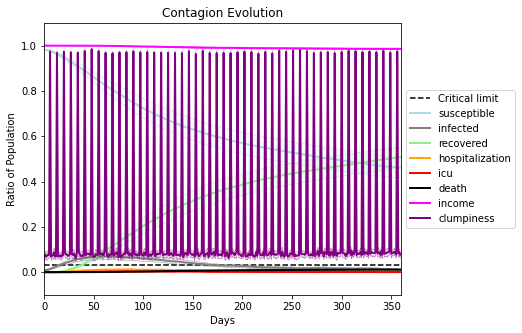

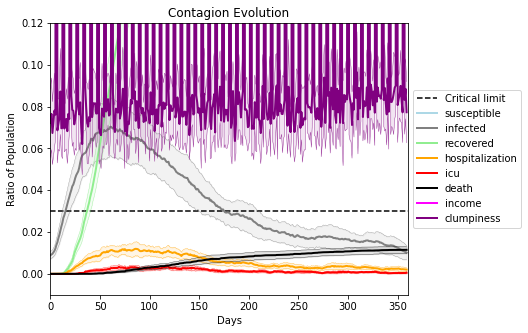

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5336, 1236, 1290, 1238, 9180, 118, 9849, 2000, 3746, 1042, 2448, 7350, 6261, 6214, 5032, 3302, 9281, 767, 5870, 7050]
Average similarity between family members is 0.9617641376024734 at temperature -0.997
Average similarity between family and home is 0.9998547352819508 at temperature -1
Average similarity between students and their classroom is 0.6549873247803468 at temperature -0.997
Average classroom occupancy is 3.8088235294117645 and number classrooms is 68
Average similarity between workers is 0.9421916842211 at temperature -0.997
Average office occupancy is 3.606217616580311 and number offices is 193
Average friend similarity for adults: 0.8735884089977712 for kids: 0.6811744613069172
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.6923095405399599
avg restaurant similarity 0.7465687073432031
avg restaurant similarity 0.46959125720887646
avg restaurant similarity 0.5802951708627516
avg restaurant similarity 0.4950178496701905
avg restaurant similarity 0.5491529603745541
avg restaurant similarity 0.6327726707638336
avg restaurant similarity 0.6489906884404327
avg restaurant similarity 0.6930514996086287
avg restaurant similarity 0.66730647334815
avg restaurant similarity 0.5934633056301128
avg restaurant similarity 0.5223834017305837
avg restaurant similarity 0.5551138480144181
avg restaurant similarity 0.4517058645710771
avg restaurant similarity 0.5285105098109298
avg restaurant similarity 0.6307955139497651
avg restaurant similarity 0.7155255828215586
avg restaurant similarity 0.7464342132741763
avg restaurant similarity 0.4816090064210574
avg restaurant similarity 0.5713630479532084
avg restaurant similarity 0.5984027410998644
avg restaurant similarity 0.6090733599923425
avg restaur

avg restaurant similarity 0.4804253848274238
avg restaurant similarity 0.5537765747761825
avg restaurant similarity 0.3884064212589762
avg restaurant similarity 0.6717905961255414
avg restaurant similarity 0.6018338346976627
avg restaurant similarity 0.5253753100189604
avg restaurant similarity 0.5297427049771806
avg restaurant similarity 0.553738535318764
avg restaurant similarity 0.9998610456141142
avg restaurant similarity 0.5396221377622915
avg restaurant similarity 0.589842358121707
avg restaurant similarity 0.5763748973145121
avg restaurant similarity 0.6470144797477385
avg restaurant similarity 0.4828661271166499
avg restaurant similarity 0.6688143785727495
avg restaurant similarity 0.7771874636182589
avg restaurant similarity 0.6573587770871402
avg restaurant similarity 0.7011122313411721
avg restaurant similarity 0.5978681961231921
avg restaurant similarity 0.5296447090573209
avg restaurant similarity 0.6033187567893025
avg restaurant similarity 0.7781886876133776
avg restaura

avg restaurant similarity 0.5158183819667078
avg restaurant similarity 0.48692463180867185
avg restaurant similarity 0.5602692995249308
avg restaurant similarity 0.5411428717098213
avg restaurant similarity 0.7249807683480796
avg restaurant similarity 0.5797254927010993
avg restaurant similarity 0.6602470598041155
avg restaurant similarity 0.726729374190519
avg restaurant similarity 0.691864568211063
avg restaurant similarity 0.5493812587488661
avg restaurant similarity 0.6057604384893805
avg restaurant similarity 0.696578881940095
avg restaurant similarity 0.5011701872952252
avg restaurant similarity 0.517245064054486
avg restaurant similarity 0.6506799635795675
avg restaurant similarity 0.4867738555611842
avg restaurant similarity 0.5279005293773574
avg restaurant similarity 0.6407170255491208
avg restaurant similarity 0.5485650267848285
avg restaurant similarity 0.5851616163903917
avg restaurant similarity 0.574627618678137
avg restaurant similarity 0.6172021235943458
avg restaurant

avg restaurant similarity 0.6153878680021515
avg restaurant similarity 0.6549279747377399
avg restaurant similarity 0.6471531204733966
avg restaurant similarity 0.4971264029229034
avg restaurant similarity 0.5478366943672621
avg restaurant similarity 0.6052017305881525
avg restaurant similarity 0.6802025357233954
avg restaurant similarity 0.7335735611226993
avg restaurant similarity 0.6530310937874922
avg restaurant similarity 0.6125425827946641
avg restaurant similarity 0.4522560281547231
avg restaurant similarity 0.6440339266775233
avg restaurant similarity 0.5529275785399483
avg restaurant similarity 0.7997180814645755
avg restaurant similarity 0.4223342511758695
avg restaurant similarity 0.44221917370092445
avg restaurant similarity 0.5975535325970847
avg restaurant similarity 0.6915429831261619
avg restaurant similarity 0.629075671876858
avg restaurant similarity 0.6786242498712409
avg restaurant similarity 0.6022147498476417
avg restaurant similarity 0.5327118701673066
avg restau

avg restaurant similarity 0.6154226943445259
avg restaurant similarity 0.5891867061121615
avg restaurant similarity 0.7648781279856296
avg restaurant similarity 0.5162729350398098
avg restaurant similarity 0.9998504930312933
avg restaurant similarity 0.35936298248188914
avg restaurant similarity 0.46667952068992996
avg restaurant similarity 0.5149302783621051
avg restaurant similarity 0.47760691475149786
avg restaurant similarity 0.5958507601824429
avg restaurant similarity 0.4852356511404851
avg restaurant similarity 0.5796217801705607
avg restaurant similarity 0.7569297877835263
avg restaurant similarity 0.6637908672176628
avg restaurant similarity 0.8087902912148842
avg restaurant similarity 0.9998618349533022
avg restaurant similarity 0.6336273023930005
avg restaurant similarity 0.6643170306318159
avg restaurant similarity 0.5936229477035465
avg restaurant similarity 0.7048096752897844
avg restaurant similarity 0.789001226557477
avg restaurant similarity 0.5622382984843528
avg rest

avg restaurant similarity 0.5561639639431817
avg restaurant similarity 0.5417894154627002
avg restaurant similarity 0.70750026177274
avg restaurant similarity 0.5973106088518999
avg restaurant similarity 0.5250961546009885
avg restaurant similarity 0.741122431789179
avg restaurant similarity 0.44661677066554106
avg restaurant similarity 0.316333702771467
avg restaurant similarity 0.4327513661581922
avg restaurant similarity 0.5337637408347978
avg restaurant similarity 0.4955831299643977
avg restaurant similarity 0.5869944842368556
avg restaurant similarity 0.7078278819285369
avg restaurant similarity 0.6729454612893808
avg restaurant similarity 0.5836857567928758
avg restaurant similarity 0.6960799370449521
avg restaurant similarity 0.7350806700878855
avg restaurant similarity 0.5302974045540043
avg restaurant similarity 0.485760195888273
avg restaurant similarity 0.5579081998722965
avg restaurant similarity 0.724065692689151
avg restaurant similarity 0.6581350436773475
avg restaurant 

avg restaurant similarity 0.654329067946333
avg restaurant similarity 0.652210744244848
avg restaurant similarity 0.9055801469117105
avg restaurant similarity 0.8429576320721153
avg restaurant similarity 0.658955852142869
avg restaurant similarity 0.5917192194397548
avg restaurant similarity 0.7245100576669885
avg restaurant similarity 0.5420908648767578
avg restaurant similarity 0.9998202608177394
avg restaurant similarity 0.7092974084044211
avg restaurant similarity 0.7405662622909589
avg restaurant similarity 0.7711347821242898
avg restaurant similarity 0.7339730015778917
avg restaurant similarity 0.7096221944064609
avg restaurant similarity 0.6351645962243186
avg restaurant similarity 0.7973629684626489
avg restaurant similarity 0.7224510167126209
avg restaurant similarity 0.6912130646545509
avg restaurant similarity 0.8641648615530377
avg restaurant similarity 0.4778865350427235
avg restaurant similarity 0.6192069340352756
avg restaurant similarity 0.7366677345346025
avg restauran

avg restaurant similarity 0.5644305490945217
avg restaurant similarity 0.8703424744195205
avg restaurant similarity 0.4802735915033116
avg restaurant similarity 0.5160023709589767
avg restaurant similarity 0.46099233339428797
avg restaurant similarity 0.5061053992429715
avg restaurant similarity 0.8843800343143235
avg restaurant similarity 0.767797093144783
avg restaurant similarity 0.5550167145738205
avg restaurant similarity 0.6000917716195354
avg restaurant similarity 0.4172792557351631
avg restaurant similarity 0.5661171871025202
avg restaurant similarity 0.3087574392083009
avg restaurant similarity 0.7871253545026176
avg restaurant similarity 0.6825262764365378
avg restaurant similarity 0.5063704908426183
avg restaurant similarity 0.9241625090922282
avg restaurant similarity 0.6930006145113206
avg restaurant similarity 0.6771502902582938
avg restaurant similarity 0.7408945264299028
avg restaurant similarity 0.7198193741128197
avg restaurant similarity 0.7412538254219417
avg restau

avg restaurant similarity 0.5945515375437398
avg restaurant similarity 0.6509572205453609
avg restaurant similarity 0.8548215147269148
avg restaurant similarity 0.6159050195770873
avg restaurant similarity 0.7079294639747267
avg restaurant similarity 0.7158719950394374
avg restaurant similarity 0.6690803646030673
avg restaurant similarity 0.4666191582620886
avg restaurant similarity 0.5354313208019179
avg restaurant similarity 0.5927174437077543
avg restaurant similarity 0.6571316499529228
avg restaurant similarity 0.664179252461909
avg restaurant similarity 0.6582180816181866
avg restaurant similarity 0.6296947409296695
avg restaurant similarity 0.7030729321207876
avg restaurant similarity 0.7793652915407114
avg restaurant similarity 0.6236300376991257
avg restaurant similarity 0.4568757603319422
avg restaurant similarity 0.7283833536725619
avg restaurant similarity 0.527336513479603
avg restaurant similarity 0.5904655857230914
avg restaurant similarity 0.5601763792845746
avg restaura

avg restaurant similarity 0.6822241163624433
avg restaurant similarity 0.6318483409745015
avg restaurant similarity 0.6956135658262159
avg restaurant similarity 0.6818291948053867
avg restaurant similarity 0.5496003675486758
avg restaurant similarity 0.7179677189844897
avg restaurant similarity 0.6803185175758225
avg restaurant similarity 0.6328372344131759
avg restaurant similarity 0.560099822181973
avg restaurant similarity 0.6995234693812314
avg restaurant similarity 0.7928382898316508
avg restaurant similarity 0.5996087602729768
avg restaurant similarity 0.7187176651018395
avg restaurant similarity 0.605943664972316
avg restaurant similarity 0.7540498994730341
avg restaurant similarity 0.7866931278078758
avg restaurant similarity 0.8146111156167839
avg restaurant similarity 0.6534997821313054
avg restaurant similarity 0.6907788732862695
avg restaurant similarity 0.7564044766289478
avg restaurant similarity 0.5655268487658851
avg restaurant similarity 0.6771265721307633
avg restaura

avg restaurant similarity 0.500409668385063
avg restaurant similarity 0.5177766845683949
avg restaurant similarity 0.6548272928776968
avg restaurant similarity 0.6098982318381704
avg restaurant similarity 0.5548694449442577
avg restaurant similarity 0.6318562666588875
avg restaurant similarity 0.6263022468246583
avg restaurant similarity 0.6198033271296154
avg restaurant similarity 0.6672263369801921
avg restaurant similarity 0.5530553367342371
avg restaurant similarity 0.6822372899632598
avg restaurant similarity 0.6779569958996069
avg restaurant similarity 0.3523545146677314
avg restaurant similarity 0.5510019068103121
avg restaurant similarity 0.7822570502064721
avg restaurant similarity 0.6534640008651
avg restaurant similarity 0.6837719823575823
avg restaurant similarity 0.5946776765481763
avg restaurant similarity 0.6987122495734236
avg restaurant similarity 0.7587003535903679
avg restaurant similarity 0.5974613105768697
avg restaurant similarity 0.6935287009657845
avg restaurant

avg restaurant similarity 0.5822113613691674
avg restaurant similarity 0.6406336151486616
avg restaurant similarity 0.533315062742208
avg restaurant similarity 0.6535152352877774
avg restaurant similarity 0.6375626774721903
avg restaurant similarity 0.3764695956513107
avg restaurant similarity 0.576332718995445
avg restaurant similarity 0.5268938821083916
avg restaurant similarity 0.5954140611968356
avg restaurant similarity 0.6388924079601176
avg restaurant similarity 0.6112166112412452
avg restaurant similarity 0.5319802691477303
avg restaurant similarity 0.7276797040056054
avg restaurant similarity 0.5450816006484364
avg restaurant similarity 0.5223038297261158
avg restaurant similarity 0.6365126919815993
avg restaurant similarity 0.682301827193585
avg restaurant similarity 0.6618333591421957
avg restaurant similarity 0.5702310254633266
avg restaurant similarity 0.6026001906661255
avg restaurant similarity 0.5744509865163618
avg restaurant similarity 0.5813920772938952
avg restauran

avg restaurant similarity 0.5495229283258151
avg restaurant similarity 0.7266304595282653
avg restaurant similarity 0.4229021803095756
avg restaurant similarity 0.6039405897488533
avg restaurant similarity 0.5480010849435847
avg restaurant similarity 0.42616260216365354
avg restaurant similarity 0.5754033686515416
avg restaurant similarity 0.490391370592432
avg restaurant similarity 0.7454951985757274
avg restaurant similarity 0.46893911350771017
avg restaurant similarity 0.6133669615432661
avg restaurant similarity 0.7500070001423559
avg restaurant similarity 0.5412906141622064
avg restaurant similarity 0.522106555401475
avg restaurant similarity 0.5303878341166549
avg restaurant similarity 0.5674057588584968
avg restaurant similarity 0.6636538462043413
avg restaurant similarity 0.7909489480847539
avg restaurant similarity 0.6972330953693819
avg restaurant similarity 0.5593849232388381
avg restaurant similarity 0.5757892530511551
avg restaurant similarity 0.7124398651573455
avg restau

avg restaurant similarity 0.5417507044230668
avg restaurant similarity 0.6234151621135922
avg restaurant similarity 0.6247822081197715
avg restaurant similarity 0.40842243403437595
avg restaurant similarity 0.5770202244408285
avg restaurant similarity 0.1915968546377022
avg restaurant similarity 0.6987519953281859
avg restaurant similarity 0.7158404879900896
avg restaurant similarity 0.5759737380878436
avg restaurant similarity 0.6600896045043538
avg restaurant similarity 0.498102035989338
avg restaurant similarity 0.6326227626206702
avg restaurant similarity 0.6237230331553871
avg restaurant similarity 0.6695061414524047
avg restaurant similarity 0.5101728575340606
avg restaurant similarity 0.5578894647081923
avg restaurant similarity 0.638007466506066
avg restaurant similarity 0.5560328961664823
avg restaurant similarity 0.44948937341572937
avg restaurant similarity 0.6431054359811366
avg restaurant similarity 0.6845548609258898
avg restaurant similarity 0.8032296439302936
avg restau

avg restaurant similarity 0.436692407877879
avg restaurant similarity 0.6532383715109472
avg restaurant similarity 0.6436287979322621
avg restaurant similarity 0.7433374334829902
avg restaurant similarity 0.6080979913736143
avg restaurant similarity 0.7611165553041255
avg restaurant similarity 0.5198203929855411
avg restaurant similarity 0.6469904740603588
avg restaurant similarity 0.5881607990963102
avg restaurant similarity 0.6142015273489145
avg restaurant similarity 0.6259026353935238
avg restaurant similarity 0.733542208556579
avg restaurant similarity 0.6493857472883366
avg restaurant similarity 0.5656471377155508
avg restaurant similarity 0.6013785389370498
avg restaurant similarity 0.6557904130591605
avg restaurant similarity 0.5974786467563794
avg restaurant similarity 0.7502706434458377
avg restaurant similarity 0.7180227446488296
avg restaurant similarity 0.7768880145999258
avg restaurant similarity 0.39672906844181305
avg restaurant similarity 0.6449013032929467
avg restaur

avg restaurant similarity 0.6479806131587172
avg restaurant similarity 0.6899390451605444
avg restaurant similarity 0.6637399828179851
avg restaurant similarity 0.6689485386905922
avg restaurant similarity 0.8396100962549108
avg restaurant similarity 0.6997034770931695
avg restaurant similarity 0.6485600484608638
avg restaurant similarity 0.5506291918492054
avg restaurant similarity 0.707922983468281
avg restaurant similarity 0.6857191949197993
avg restaurant similarity 0.4799623243101237
avg restaurant similarity 0.6443410408559466
avg restaurant similarity 0.7510093910500651
avg restaurant similarity 0.6222798401457533
avg restaurant similarity 0.7700945647461257
avg restaurant similarity 0.6429824014920911
avg restaurant similarity 0.5372365690353396
avg restaurant similarity 0.6896645202950763
avg restaurant similarity 0.5700273222542728
avg restaurant similarity 0.5220398869409142
avg restaurant similarity 0.6688571814741598
avg restaurant similarity 0.6676021815530075
avg restaur

avg restaurant similarity 0.5831354430410196
avg restaurant similarity 0.5540973780868451
avg restaurant similarity 0.7352387919156573
avg restaurant similarity 0.6064634151390322
avg restaurant similarity 0.5914295836170432
avg restaurant similarity 0.5687677986892363
avg restaurant similarity 0.5277803434475001
avg restaurant similarity 0.7124685991168721
avg restaurant similarity 0.6441006560335292
avg restaurant similarity 0.5552498074351896
avg restaurant similarity 0.6166639164892613
avg restaurant similarity 0.7468940733858386
avg restaurant similarity 0.6091740854337792
avg restaurant similarity 0.7222856327124629
avg restaurant similarity 0.5815524500013212
avg restaurant similarity 0.5461433452339615
avg restaurant similarity 0.6074107683122822
avg restaurant similarity 0.5577018436096685
avg restaurant similarity 0.6286521733478584
avg restaurant similarity 0.59398018174075
avg restaurant similarity 0.5456235423848388
avg restaurant similarity 0.5597750508196647
avg restaura

avg restaurant similarity 0.5853849426263532
avg restaurant similarity 0.730751029538644
avg restaurant similarity 0.5883407281293364
avg restaurant similarity 0.6126566196733514
avg restaurant similarity 0.6059052633012103
avg restaurant similarity 0.5825905858790035
avg restaurant similarity 0.5988707641427905
avg restaurant similarity 0.536278579348634
avg restaurant similarity 0.5277246261897834
avg restaurant similarity 0.6853523207206049
avg restaurant similarity 0.644826571994061
avg restaurant similarity 0.5425493534613401
avg restaurant similarity 0.5376833085583745
avg restaurant similarity 0.5784031015411
avg restaurant similarity 0.40486446106712415
avg restaurant similarity 0.5766111602160732
avg restaurant similarity 0.6085146946892722
avg restaurant similarity 0.5935987877621743
avg restaurant similarity 0.6644908580705777
avg restaurant similarity 0.6135240465736926
avg restaurant similarity 0.6051479276136341
avg restaurant similarity 0.5456235022002125
avg restaurant 

avg restaurant similarity 0.6948497402927181
avg restaurant similarity 0.56658133347923
avg restaurant similarity 0.5348980496690936
avg restaurant similarity 0.6816340791719369
avg restaurant similarity 0.580418786001886
avg restaurant similarity 0.589544894366541
avg restaurant similarity 0.6260234922166336
avg restaurant similarity 0.43258206147529954
avg restaurant similarity 0.5573236047397546
avg restaurant similarity 0.5672071020951305
avg restaurant similarity 0.4130347401634859
avg restaurant similarity 0.47702315335371787
avg restaurant similarity 0.5660902018471856
avg restaurant similarity 0.5720759591257569
avg restaurant similarity 0.4553650106394507
avg restaurant similarity 0.6673136542734569
avg restaurant similarity 0.5544219195562756
avg restaurant similarity 0.5988110698007022
avg restaurant similarity 0.7707944787761093
avg restaurant similarity 0.6758451062868489
avg restaurant similarity 0.6176756100373663
avg restaurant similarity 0.6135587687398274
avg restaura

avg restaurant similarity 0.5222593484757878
avg restaurant similarity 0.6427446858222072
avg restaurant similarity 0.5345042883914418
avg restaurant similarity 0.6241031405075311
avg restaurant similarity 0.5918367344940917
avg restaurant similarity 0.574814850348421
avg restaurant similarity 0.6285314628072917
avg restaurant similarity 0.5991271131997904
avg restaurant similarity 0.5623913875224803
avg restaurant similarity 0.4913329821600687
avg restaurant similarity 0.7414432512960794
avg restaurant similarity 0.5642620475356882
avg restaurant similarity 0.5054109380513799
avg restaurant similarity 0.3955906886064768
avg restaurant similarity 0.5807211301802969
avg restaurant similarity 0.6319394427201602
avg restaurant similarity 0.7267421779488453
avg restaurant similarity 0.34883978347289524
avg restaurant similarity 0.8333487841535911
avg restaurant similarity 0.6224421750937927
avg restaurant similarity 0.4674085768869002
avg restaurant similarity 0.5963694387272237
avg restau

avg restaurant similarity 0.6664748372534356
avg restaurant similarity 0.6347996033296603
avg restaurant similarity 0.5369986485695494
avg restaurant similarity 0.6160015546853491
avg restaurant similarity 0.5155861741287106
avg restaurant similarity 0.5201884392769264
avg restaurant similarity 0.5213685032526981
avg restaurant similarity 0.5758198677650953
avg restaurant similarity 0.5825700037689288
avg restaurant similarity 0.5779137114237903
avg restaurant similarity 0.6493631713371951
avg restaurant similarity 0.5071795765683844
avg restaurant similarity 0.5420337533908287
avg restaurant similarity 0.5770711913932892
avg restaurant similarity 0.626559496080469
avg restaurant similarity 0.6738540623363253
avg restaurant similarity 0.5214715914318574
avg restaurant similarity 0.6227030406156477
avg restaurant similarity 0.5919166012860294
avg restaurant similarity 0.7360864604901577
avg restaurant similarity 0.4671295521502637
avg restaurant similarity 0.5906322672095801
avg restaur

avg restaurant similarity 0.586312353713597
avg restaurant similarity 0.5888874696086848
avg restaurant similarity 0.5081215772227381
avg restaurant similarity 0.7948531601494606
avg restaurant similarity 0.7656562127161852
avg restaurant similarity 0.6555800750426527
avg restaurant similarity 0.6626675748716245
avg restaurant similarity 0.733270861645334
avg restaurant similarity 0.418642823929608
avg restaurant similarity 0.4507470326256064
avg restaurant similarity 0.4887076339953857
avg restaurant similarity 0.6785298845799063
avg restaurant similarity 0.6073966971477033
avg restaurant similarity 0.5553526830298823
avg restaurant similarity 0.5962229476468502
avg restaurant similarity 0.53692272315112
avg restaurant similarity 0.5897436392953221
avg restaurant similarity 0.6145760530502976
avg restaurant similarity 0.5467287592140874
avg restaurant similarity 0.6095288470469605
avg restaurant similarity 0.5702471392798842
avg restaurant similarity 0.5587944574032411
avg restaurant 

avg restaurant similarity 0.47840947493047914
avg restaurant similarity 0.6904160172981297
avg restaurant similarity 0.6574709792642636
avg restaurant similarity 0.7763017248469161
avg restaurant similarity 0.6147517442188661
avg restaurant similarity 0.5249717276933836
avg restaurant similarity 0.7115918628881969
avg restaurant similarity 0.6498142054251129
avg restaurant similarity 0.4795091340795277
avg restaurant similarity 0.5589598503227763
avg restaurant similarity 0.5550814484184371
avg restaurant similarity 0.6787006443367793
avg restaurant similarity 0.45471610107524124
avg restaurant similarity 0.531543240034701
avg restaurant similarity 0.5459208801322416
avg restaurant similarity 0.859252480269052
avg restaurant similarity 0.6868579760808998
avg restaurant similarity 0.6124188262232679
avg restaurant similarity 0.6507530815568141
avg restaurant similarity 0.9987280459224699
avg restaurant similarity 0.5024201712203082
avg restaurant similarity 0.6759795609687593
avg restau

avg restaurant similarity 0.8772556415144672
avg restaurant similarity 0.49677338419590333
avg restaurant similarity 0.6639352164701625
avg restaurant similarity 0.6604515591304263
avg restaurant similarity 0.5933098389204934
avg restaurant similarity 0.7175147659087119
avg restaurant similarity 0.39227823344197355
avg restaurant similarity 0.5957792431715808
avg restaurant similarity 0.6288163731896782
avg restaurant similarity 0.5494759288270705
avg restaurant similarity 0.6517113453674142
avg restaurant similarity 0.6778887542302502
avg restaurant similarity 0.7361878947777336
avg restaurant similarity 0.7721838143453565
avg restaurant similarity 0.5998851850402475
avg restaurant similarity 0.7564470457894661
avg restaurant similarity 0.619467863722754
avg restaurant similarity 0.7802832065695835
avg restaurant similarity 0.7308539075132747
avg restaurant similarity 0.7558857842521884
avg restaurant similarity 0.6086867523548074
avg restaurant similarity 0.672661272697711
avg restau

avg restaurant similarity 0.3971896259356988
avg restaurant similarity 0.6552147309152482
avg restaurant similarity 0.40202977026543646
avg restaurant similarity 0.7460631859907363
avg restaurant similarity 0.6719471550035958
avg restaurant similarity 0.522221667772651
avg restaurant similarity 0.6440574079304207
avg restaurant similarity 0.5663517530997791
avg restaurant similarity 0.46595985238969995
avg restaurant similarity 0.6204033226896581
avg restaurant similarity 0.6103327645776936
avg restaurant similarity 0.7242002287649767
avg restaurant similarity 0.5717318917355878
avg restaurant similarity 0.49040463683637514
avg restaurant similarity 0.3526683527706331
avg restaurant similarity 0.6514656118336022
avg restaurant similarity 0.5229518889214755
avg restaurant similarity 0.5837106688106586
avg restaurant similarity 0.558030809769605
avg restaurant similarity 0.9997163015517787
avg restaurant similarity 0.21739257418118701
avg restaurant similarity 0.5936776854980872
avg rest

avg restaurant similarity 0.5205370060235256
avg restaurant similarity 0.723886837162876
avg restaurant similarity 0.358318890442911
avg restaurant similarity 0.5577533977814537
avg restaurant similarity 0.4522513093016074
avg restaurant similarity 0.6661171572250719
avg restaurant similarity 0.8262222730239979
avg restaurant similarity 0.7594252696877563
avg restaurant similarity 0.5205929327498713
avg restaurant similarity 0.5028991864303005
avg restaurant similarity 0.7151033136541742
avg restaurant similarity 0.7076111731271625
avg restaurant similarity 0.5755845849456029
avg restaurant similarity 0.6049063512531839
avg restaurant similarity 0.7042608654516277
avg restaurant similarity 0.5684061890055616
avg restaurant similarity 0.5544590909863297
avg restaurant similarity 0.5693712363217899
avg restaurant similarity 0.6930823869562257
avg restaurant similarity 0.6215169873143407
avg restaurant similarity 0.543918666432264
avg restaurant similarity 0.6140699682726535
avg restauran

avg restaurant similarity 0.7172065067089335
avg restaurant similarity 0.9999046272460255
avg restaurant similarity 0.5870303807708628
avg restaurant similarity 0.6247459723371139
avg restaurant similarity 0.4919392821727248
avg restaurant similarity 0.5924745311830968
avg restaurant similarity 0.7178667637248384
avg restaurant similarity 0.5515497703437837
avg restaurant similarity 0.649559277664414
avg restaurant similarity 0.6132681571624679
avg restaurant similarity 0.46761727990323565
avg restaurant similarity 0.6477989483484234
avg restaurant similarity 0.6291986595077471
avg restaurant similarity 0.6667801966152022
avg restaurant similarity 0.6060413425215547
avg restaurant similarity 0.8107827133331114
avg restaurant similarity 0.4713954919146664
avg restaurant similarity 0.7407199551075153
avg restaurant similarity 0.41108838732304487
avg restaurant similarity 0.5794174538065799
avg restaurant similarity 0.6477640837425958
avg restaurant similarity 0.5725719097487103
avg resta

avg restaurant similarity 0.5650276284676026
avg restaurant similarity 0.6548287762257919
avg restaurant similarity 0.5677893895809648
avg restaurant similarity 0.7389272787818311
avg restaurant similarity 0.6198727246909994
avg restaurant similarity 0.7541198495405091
avg restaurant similarity 0.6211745459093733
avg restaurant similarity 0.540012890441896
avg restaurant similarity 0.6401484508008582
avg restaurant similarity 0.40403814233985413
avg restaurant similarity 0.4672417517108777
avg restaurant similarity 0.5570015751637204
avg restaurant similarity 0.4501379184573899
avg restaurant similarity 0.4763158557502775
avg restaurant similarity 0.7734211703515277
avg restaurant similarity 0.5959586585147252
avg restaurant similarity 0.5283668428415371
avg restaurant similarity 0.6133904188559454
avg restaurant similarity 0.5373805748927596
avg restaurant similarity 0.6283752656131912
avg restaurant similarity 0.5660998015447147
avg restaurant similarity 0.5067066165866903
avg restau

avg restaurant similarity 0.5256510819240342
avg restaurant similarity 0.48463566213739223
avg restaurant similarity 0.6372037485259481
avg restaurant similarity 0.4831601746001585
avg restaurant similarity 0.5428014114094327
avg restaurant similarity 0.6845298357644959
avg restaurant similarity 0.41921896620623583
avg restaurant similarity 0.524165759704063
avg restaurant similarity 0.5155123455779733
avg restaurant similarity 0.562513003111396
avg restaurant similarity 0.4945446724458858
avg restaurant similarity 0.5957738649263502
avg restaurant similarity 0.5405321930808269
avg restaurant similarity 0.5779480970985335
avg restaurant similarity 0.8133542732960476
avg restaurant similarity 0.6181216722364767
avg restaurant similarity 0.5376744103705124
avg restaurant similarity 0.6126820614814877
avg restaurant similarity 0.7790845307373623
avg restaurant similarity 0.4055366563760668
avg restaurant similarity 0.5078633998043499
avg restaurant similarity 0.7269900955088003
avg restau

avg restaurant similarity 0.5688122870601913
avg restaurant similarity 0.504941154182586
avg restaurant similarity 0.5521302526788964
avg restaurant similarity 0.6046392394975718
avg restaurant similarity 0.8105180397395095
avg restaurant similarity 0.6711778717783918
avg restaurant similarity 0.7213175554567308
avg restaurant similarity 0.5367218271981351
avg restaurant similarity 0.6240584361365548
avg restaurant similarity 0.41705990614853544
avg restaurant similarity 0.5333503712489831
avg restaurant similarity 0.4604426267038247
avg restaurant similarity 0.6787673560192519
avg restaurant similarity 0.6092938100629867
avg restaurant similarity 0.5398323719156977
avg restaurant similarity 0.5791751560471549
avg restaurant similarity 0.7481735188188079
avg restaurant similarity 0.5336807859939069
avg restaurant similarity 0.5297273749807582
avg restaurant similarity 0.6568113797727642
avg restaurant similarity 0.4788126869379521
avg restaurant similarity 0.5328651552009896
avg restau

avg restaurant similarity 0.7295790054754864
avg restaurant similarity 0.6866657481667038
avg restaurant similarity 0.6179158519010154
avg restaurant similarity 0.5891702636427867
avg restaurant similarity 0.7002984296359221
avg restaurant similarity 0.6362462255426248
avg restaurant similarity 0.7320369147064526
avg restaurant similarity 0.52670682285759
avg restaurant similarity 0.6854320822183992
avg restaurant similarity 0.8090994468917385
avg restaurant similarity 0.6490076683532007
avg restaurant similarity 0.6144557709805941
avg restaurant similarity 0.7832598235178093
avg restaurant similarity 0.652228886915026
avg restaurant similarity 0.7189454802147407
avg restaurant similarity 0.7360089529419804
avg restaurant similarity 0.6145568878161559
avg restaurant similarity 0.7433163208781005
avg restaurant similarity 0.6653287330421644
avg restaurant similarity 0.7650079528253574
avg restaurant similarity 0.6485162750697313
avg restaurant similarity 0.6831220627555767
avg restauran

avg restaurant similarity 0.860820695518616
avg restaurant similarity 0.7868705179773372
avg restaurant similarity 0.64016334718148
avg restaurant similarity 0.6282711290301514
avg restaurant similarity 0.9373024616780237
avg restaurant similarity 0.734853752347171
avg restaurant similarity 0.5100129251446553
avg restaurant similarity 0.661739141898607
avg restaurant similarity 0.6565036526078658
avg restaurant similarity 0.7283894862951896
avg restaurant similarity 0.5647537344490968
avg restaurant similarity 0.7882830975848784
avg restaurant similarity 0.7228662054614071
avg restaurant similarity 0.5366953566815237
avg restaurant similarity 0.6304024059936931
avg restaurant similarity 0.8085843487077359
avg restaurant similarity 0.5748234468655367
avg restaurant similarity 0.7185820780956251
avg restaurant similarity 0.7786902744756804
avg restaurant similarity 0.7662547830327893
avg restaurant similarity 0.5653011020403672
avg restaurant similarity 0.5665695573226007
avg restaurant 

avg restaurant similarity 0.560820091518417
avg restaurant similarity 0.5322214821616897
avg restaurant similarity 0.4135739551107641
avg restaurant similarity 0.5037616867812466
avg restaurant similarity 0.5034730362801535
avg restaurant similarity 0.6559570590727486
avg restaurant similarity 0.6639918102234811
avg restaurant similarity 0.7451440367955243
avg restaurant similarity 0.5602721115487952
avg restaurant similarity 0.617346091736747
avg restaurant similarity 0.39033487775820075
avg restaurant similarity 0.5734263276437979
avg restaurant similarity 0.7253033394720022
avg restaurant similarity 0.7473959615511502
avg restaurant similarity 0.5927620991919323
avg restaurant similarity 0.5328102978783793
avg restaurant similarity 0.4646761783135268
avg restaurant similarity 0.44416917791549393
avg restaurant similarity 0.4567482773745271
avg restaurant similarity 0.7972190427654581
avg restaurant similarity 0.5967755071328875
avg restaurant similarity 0.9996921177276654
avg restau

avg restaurant similarity 0.5440515790650907
avg restaurant similarity 0.6728952174176417
avg restaurant similarity 0.5702192169293473
avg restaurant similarity 0.8141861177775053
avg restaurant similarity 0.6184853732235422
avg restaurant similarity 0.6678046245068266
avg restaurant similarity 0.6987369261908114
avg restaurant similarity 0.39873974626946557
avg restaurant similarity 0.4594027636324926
avg restaurant similarity 0.6103006007592773
avg restaurant similarity 0.5744209862699488
avg restaurant similarity 0.5748493969540102
avg restaurant similarity 0.7138700398458645
avg restaurant similarity 0.4727080510087882
avg restaurant similarity 0.6685925420100584
avg restaurant similarity 0.7881514715652578
avg restaurant similarity 0.8037936580900441
avg restaurant similarity 0.6127170874545287
avg restaurant similarity 0.38072938452836597
avg restaurant similarity 0.6236912259878971
avg restaurant similarity 0.6725187002442063
avg restaurant similarity 0.5442865495636847
avg rest

avg restaurant similarity 0.71265443769568
avg restaurant similarity 0.6102044036488368
avg restaurant similarity 0.1899374489460469
avg restaurant similarity 0.5808064041132581
avg restaurant similarity 0.6557382638877843
avg restaurant similarity 0.5140710150297754
avg restaurant similarity 0.7052179720614022
avg restaurant similarity 0.595557036472305
avg restaurant similarity 0.7867345068045701
avg restaurant similarity 0.7736257403519646
avg restaurant similarity 0.6608247577226941
avg restaurant similarity 0.9004130381977724
avg restaurant similarity 0.6084262567927121
avg restaurant similarity 0.6738586301133745
avg restaurant similarity 0.7251632122639983
avg restaurant similarity 0.6091530750110035
avg restaurant similarity 0.5024447819394772
avg restaurant similarity 0.9999621328175916
avg restaurant similarity 0.6151625050687575
avg restaurant similarity 0.4537302263978016
avg restaurant similarity 0.5081816141192113
avg restaurant similarity 0.6260238117052067
avg restauran

avg restaurant similarity 0.6702485194624018
avg restaurant similarity 0.6077235251816648
avg restaurant similarity 0.6552039985854246
avg restaurant similarity 0.8130443926734001
avg restaurant similarity 0.6136742090264606
avg restaurant similarity 0.532590190883272
avg restaurant similarity 0.4873595206876409
avg restaurant similarity 0.6043790396076393
avg restaurant similarity 0.6253802235473149
avg restaurant similarity 0.5030567412969966
avg restaurant similarity 0.7757053888351428
avg restaurant similarity 0.6917387841339484
avg restaurant similarity 0.6184906436706473
avg restaurant similarity 0.7398134651522283
avg restaurant similarity 0.49774725505107825
avg restaurant similarity 0.6940160116738675
avg restaurant similarity 0.5725022986189631
avg restaurant similarity 0.5917823745010478
avg restaurant similarity 0.9999085297701514
avg restaurant similarity 0.8200337582037405
avg restaurant similarity 0.6450516753353029
avg restaurant similarity 0.6694103208212143
avg restau

avg restaurant similarity 0.5010586093326965
avg restaurant similarity 0.8225633825659393
avg restaurant similarity 0.613462303020335
avg restaurant similarity 0.7015522112145717
avg restaurant similarity 0.9095466428089138
avg restaurant similarity 0.8966330545981602
avg restaurant similarity 0.5233025974195413
avg restaurant similarity 0.6062102211034576
avg restaurant similarity 0.5107133349196133
avg restaurant similarity 0.626007731189024
avg restaurant similarity 0.48652206682241633
avg restaurant similarity 0.6944001029329975
avg restaurant similarity 0.31927987053175144
avg restaurant similarity 0.5782548619987072
avg restaurant similarity 0.7790068349754029
avg restaurant similarity 0.3544390747516356
avg restaurant similarity 0.6743428133524594
avg restaurant similarity 0.7439826487468093
avg restaurant similarity 0.6796196233473956
avg restaurant similarity 0.6838385716021967
avg restaurant similarity 0.5704515610711997
avg restaurant similarity 0.6914760499578905
avg restau

avg restaurant similarity 0.593632574680128
avg restaurant similarity 0.6722931519647708
avg restaurant similarity 0.49366625247553314
avg restaurant similarity 0.6037507248199173
avg restaurant similarity 0.9998804323313851
avg restaurant similarity 0.49030104535824215
avg restaurant similarity 0.6172213591931863
avg restaurant similarity 0.5295020067642306
avg restaurant similarity 0.7572605174888087
avg restaurant similarity 0.6762672262299776
avg restaurant similarity 0.6714749599228722
avg restaurant similarity 0.9539805914347488
avg restaurant similarity 0.5788085767754245
avg restaurant similarity 0.5996056978760356
avg restaurant similarity 0.6100033050714688
avg restaurant similarity 0.7084797558377594
avg restaurant similarity 0.5989053828434553
avg restaurant similarity 0.453269532818667
avg restaurant similarity 0.5740568709255869
avg restaurant similarity 0.5376005451160548
avg restaurant similarity 0.6326429831703946
avg restaurant similarity 0.6609340346906796
avg restau

avg restaurant similarity 0.6112479505398946
avg restaurant similarity 0.69496454238423
avg restaurant similarity 0.5502449031991501
avg restaurant similarity 0.614155884694444
avg restaurant similarity 0.6941524870466353
avg restaurant similarity 0.7379037944200628
avg restaurant similarity 0.6703536533394641
avg restaurant similarity 0.6945253012784052
avg restaurant similarity 0.6519983781813616
avg restaurant similarity 0.508014971641198
avg restaurant similarity 0.5627848318888934
avg restaurant similarity 0.6697840898879086
avg restaurant similarity 0.42913237388115233
avg restaurant similarity 0.3017056023951906
avg restaurant similarity 0.8346981834859912
avg restaurant similarity 0.7138937845473986
avg restaurant similarity 0.26680454346569676
avg restaurant similarity 0.6485196206098406
avg restaurant similarity 0.7161147706841127
avg restaurant similarity 0.42034175335197504
avg restaurant similarity 0.34364098020539985
avg restaurant similarity 0.6947362094452556
avg restau

avg restaurant similarity 0.6706676756995349
avg restaurant similarity 0.47775181020372753
avg restaurant similarity 0.5091483365083666
avg restaurant similarity 0.672584905140751
avg restaurant similarity 0.6666407794612011
avg restaurant similarity 0.5758537647511577
avg restaurant similarity 0.5117103729644852
avg restaurant similarity 0.6835380647604409
avg restaurant similarity 0.6731810514793882
avg restaurant similarity 0.6573068947467093
avg restaurant similarity 0.9997685760854111
avg restaurant similarity 0.8966940851840154
avg restaurant similarity 0.7499470315362088
avg restaurant similarity 0.8136768334580765
avg restaurant similarity 0.2810597128949015
avg restaurant similarity 0.506761006972549
avg restaurant similarity 0.7412640698548321
avg restaurant similarity 0.44844026458480296
avg restaurant similarity 0.5369661930375493
avg restaurant similarity 0.4921645736555479
avg restaurant similarity 0.5607283097739505
avg restaurant similarity 0.5638200449776413
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

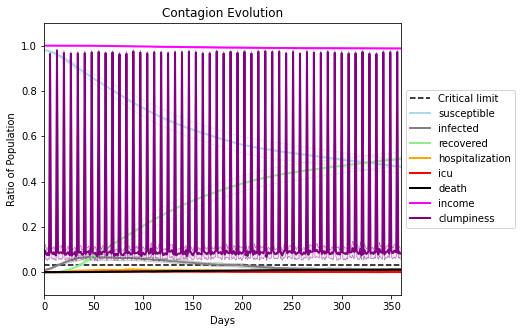

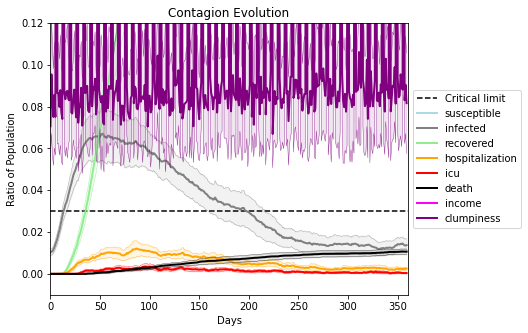

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1740, 8849, 9541, 1972, 3233, 7381, 4061, 8473, 9477, 8774, 7867, 1632, 5062, 9575, 8139, 2987, 8939, 8426, 6212, 8020]
Average similarity between family members is 0.9566103853734419 at temperature -0.996
Average similarity between family and home is 0.9998644579960367 at temperature -1
Average similarity between students and their classroom is 0.6119919697572486 at temperature -0.996
Average classroom occupancy is 4.0625 and number classrooms is 64
Average similarity between workers is 0.9302322864438005 at temperature -0.996
Average office occupancy is 3.4619289340101522 and number offices is 197
Average friend similarity for adults: 0.8599716472658755 for kids: 0.6879825072602161
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogene

avg restaurant similarity 0.6662198393520283
avg restaurant similarity 0.7964517310238369
avg restaurant similarity 0.7043992835641201
avg restaurant similarity 0.7609418153966822
avg restaurant similarity 0.7843991727989247
avg restaurant similarity 0.7937255915301947
avg restaurant similarity 0.7416147591295957
avg restaurant similarity 0.7311206803491759
avg restaurant similarity 0.6469312341148472
avg restaurant similarity 0.7652946322802219
avg restaurant similarity 0.7910220679247715
avg restaurant similarity 0.6860400208739732
avg restaurant similarity 0.7388196178965883
avg restaurant similarity 0.7334611571443979
avg restaurant similarity 0.8251348242478374
avg restaurant similarity 0.579144706054536
avg restaurant similarity 0.8227537916035619
avg restaurant similarity 0.8090926941272718
avg restaurant similarity 0.714889825934903
avg restaurant similarity 0.8897842362457412
avg restaurant similarity 0.6170026974631759
avg restaurant similarity 0.6852109661342098
avg restaura

avg restaurant similarity 0.7556026432205832
avg restaurant similarity 0.5857573262298403
avg restaurant similarity 0.706297030665116
avg restaurant similarity 0.7658469278969084
avg restaurant similarity 0.6110417561977285
avg restaurant similarity 0.7437361216079665
avg restaurant similarity 0.7500412288978011
avg restaurant similarity 0.7754017013075115
avg restaurant similarity 0.8191371823742366
avg restaurant similarity 0.44175452087641165
avg restaurant similarity 0.8392169380160527
avg restaurant similarity 0.6791153738735074
avg restaurant similarity 0.722300591344696
avg restaurant similarity 0.7264204629653895
avg restaurant similarity 0.7933896643299958
avg restaurant similarity 0.7177176447081565
avg restaurant similarity 0.5316527249956944
avg restaurant similarity 0.7542696223320168
avg restaurant similarity 0.8209495462260583
avg restaurant similarity 0.80791512968679
avg restaurant similarity 0.5792672487831723
avg restaurant similarity 0.7220752863391681
avg restauran

avg restaurant similarity 0.5463202642489364
avg restaurant similarity 0.5111002413468609
avg restaurant similarity 0.697821824095787
avg restaurant similarity 0.792867868145288
avg restaurant similarity 0.5431590337483189
avg restaurant similarity 0.5769485354137268
avg restaurant similarity 0.8186007642161569
avg restaurant similarity 0.6671731909313623
avg restaurant similarity 0.694942607637859
avg restaurant similarity 0.5856603032653542
avg restaurant similarity 0.5238691843115139
avg restaurant similarity 0.8930775794628328
avg restaurant similarity 0.6740575100198577
avg restaurant similarity 0.8630068093995391
avg restaurant similarity 0.7035929626194333
avg restaurant similarity 0.6851454347227977
avg restaurant similarity 0.5151513840018436
avg restaurant similarity 0.557891845523075
avg restaurant similarity 0.8054913780004097
avg restaurant similarity 0.42463229907702393
avg restaurant similarity 0.6595271422261402
avg restaurant similarity 0.6323549497459924
avg restauran

avg restaurant similarity 0.6151738349885989
avg restaurant similarity 0.5466940912140646
avg restaurant similarity 0.5917972143109931
avg restaurant similarity 0.8051115460296803
avg restaurant similarity 0.6931196177973903
avg restaurant similarity 0.7293244023932139
avg restaurant similarity 0.6401900859459786
avg restaurant similarity 0.6030765189710305
avg restaurant similarity 0.6441748787892174
avg restaurant similarity 0.5149152124022656
avg restaurant similarity 0.6819381666142481
avg restaurant similarity 0.7501639913168071
avg restaurant similarity 0.6306682280057749
avg restaurant similarity 0.6303319231796957
avg restaurant similarity 0.5952546842244887
avg restaurant similarity 0.6547425615554985
avg restaurant similarity 0.5318249982861734
avg restaurant similarity 0.6029053972121716
avg restaurant similarity 0.6429078509774776
avg restaurant similarity 0.5651443251702996
avg restaurant similarity 0.45297562886600407
avg restaurant similarity 0.6527356052815032
avg resta

avg restaurant similarity 0.4700098909806607
avg restaurant similarity 0.4583621127202975
avg restaurant similarity 0.5037676929942684
avg restaurant similarity 0.5068758144755013
avg restaurant similarity 0.669326193581708
avg restaurant similarity 0.4480110760774374
avg restaurant similarity 0.6105568402923516
avg restaurant similarity 0.5236325552772902
avg restaurant similarity 0.5771147480260252
avg restaurant similarity 0.6248263991052494
avg restaurant similarity 0.6297019466302182
avg restaurant similarity 0.5947734117692896
avg restaurant similarity 0.5218178745865008
avg restaurant similarity 0.4723669405376684
avg restaurant similarity 0.6589270123262504
avg restaurant similarity 0.5966784824851625
avg restaurant similarity 0.4556446177932608
avg restaurant similarity 0.47960423414289655
avg restaurant similarity 0.45400272630813654
avg restaurant similarity 0.3637030235734872
avg restaurant similarity 0.44034494469593966
avg restaurant similarity 0.49875533689090723
avg res

avg restaurant similarity 0.7088274472416267
avg restaurant similarity 0.47293691438636404
avg restaurant similarity 0.5750045380796704
avg restaurant similarity 0.4427485335838682
avg restaurant similarity 0.515689799261968
avg restaurant similarity 0.6024172318357975
avg restaurant similarity 0.5908372892283317
avg restaurant similarity 0.622994770556171
avg restaurant similarity 0.6188406868021724
avg restaurant similarity 0.5286331820934291
avg restaurant similarity 0.44809701921816775
avg restaurant similarity 0.4759624721805305
avg restaurant similarity 0.5329818963040567
avg restaurant similarity 0.5665387164749378
avg restaurant similarity 0.6413095125957189
avg restaurant similarity 0.43481572213793124
avg restaurant similarity 0.5179154902971944
avg restaurant similarity 0.5967216433144419
avg restaurant similarity 0.5855171355165295
avg restaurant similarity 0.6239046984318167
avg restaurant similarity 0.5878322616915568
avg restaurant similarity 0.5079944240419629
avg resta

avg restaurant similarity 0.6931196851078902
avg restaurant similarity 0.6032495115046547
avg restaurant similarity 0.4448302806873903
avg restaurant similarity 0.5538728877014198
avg restaurant similarity 0.5364892707205909
avg restaurant similarity 0.6026641395625595
avg restaurant similarity 0.6499797286369534
avg restaurant similarity 0.5915400141264786
avg restaurant similarity 0.5376027765734197
avg restaurant similarity 0.5371911601958395
avg restaurant similarity 0.6098225561678026
avg restaurant similarity 0.499343519306811
avg restaurant similarity 0.45744639535404613
avg restaurant similarity 0.797164379273015
avg restaurant similarity 0.5042442428675065
avg restaurant similarity 0.48640927521025557
avg restaurant similarity 0.5127140745205292
avg restaurant similarity 0.6631159475446585
avg restaurant similarity 0.6065518627969616
avg restaurant similarity 0.5525690064037123
avg restaurant similarity 0.6532269172927443
avg restaurant similarity 0.4636836415517791
avg restau

avg restaurant similarity 0.6413396255628535
avg restaurant similarity 0.6348086709136397
avg restaurant similarity 0.754774384711573
avg restaurant similarity 0.5280202341941602
avg restaurant similarity 0.35857763095502426
avg restaurant similarity 0.5600678695974942
avg restaurant similarity 0.7531740304719629
avg restaurant similarity 0.5135373648519798
avg restaurant similarity 0.5604875527357749
avg restaurant similarity 0.6270789136876201
avg restaurant similarity 0.6745353063395386
avg restaurant similarity 0.6657718025547592
avg restaurant similarity 0.5380624431471949
avg restaurant similarity 0.58504981188964
avg restaurant similarity 0.5937862898094747
avg restaurant similarity 0.6794225679962217
avg restaurant similarity 0.6237174276357663
avg restaurant similarity 0.483507406451872
avg restaurant similarity 0.5255966810028563
avg restaurant similarity 0.5850164141886944
avg restaurant similarity 0.5196767099361395
avg restaurant similarity 0.6653136971072018
avg restauran

avg restaurant similarity 0.5333082783481258
avg restaurant similarity 0.6129701609121015
avg restaurant similarity 0.5370924197361174
avg restaurant similarity 0.6371867488542315
avg restaurant similarity 0.5993416243238585
avg restaurant similarity 0.5968591356055355
avg restaurant similarity 0.5810896668229371
avg restaurant similarity 0.4800100836921456
avg restaurant similarity 0.8763236743470659
avg restaurant similarity 0.6752588056632384
avg restaurant similarity 0.5742591312867954
avg restaurant similarity 0.583884900861467
avg restaurant similarity 0.6604456028292611
avg restaurant similarity 0.4787166310693889
avg restaurant similarity 0.81116257789504
avg restaurant similarity 0.7324207902561386
avg restaurant similarity 0.5487817279528908
avg restaurant similarity 0.45071061169260235
avg restaurant similarity 0.4416072152213903
avg restaurant similarity 0.7768932386820825
avg restaurant similarity 0.61254598857651
avg restaurant similarity 0.6511537479453614
avg restaurant

avg restaurant similarity 0.5802270385416854
avg restaurant similarity 0.7218849746606035
avg restaurant similarity 0.5228800053290426
avg restaurant similarity 0.8528632763251004
avg restaurant similarity 0.6477043953928167
avg restaurant similarity 0.5100591601955489
avg restaurant similarity 0.5073285895062404
avg restaurant similarity 0.7065593484962455
avg restaurant similarity 0.7144226575515912
avg restaurant similarity 0.7243335697308073
avg restaurant similarity 0.585139240438782
avg restaurant similarity 0.5895433552682428
avg restaurant similarity 0.6533749064320573
avg restaurant similarity 0.7034657436043762
avg restaurant similarity 0.4431281131873738
avg restaurant similarity 0.9265216025519138
avg restaurant similarity 0.5864486046744714
avg restaurant similarity 0.6768871751766159
avg restaurant similarity 0.5383323075966936
avg restaurant similarity 0.7156260640717392
avg restaurant similarity 0.6983899094415046
avg restaurant similarity 0.6052922332523487
avg restaur

avg restaurant similarity 0.48075825283300067
avg restaurant similarity 0.6166113904822185
avg restaurant similarity 0.5786180544810535
avg restaurant similarity 0.5666459781369655
avg restaurant similarity 0.6361400800360281
avg restaurant similarity 0.715574493758239
avg restaurant similarity 0.5759723309221015
avg restaurant similarity 0.5724618319066086
avg restaurant similarity 0.7029291276476795
avg restaurant similarity 0.6272995848604743
avg restaurant similarity 0.5995243044660971
avg restaurant similarity 0.6246103612205905
avg restaurant similarity 0.5145118660735013
avg restaurant similarity 0.7534169450390559
avg restaurant similarity 0.7543460712728323
avg restaurant similarity 0.4387902766363519
avg restaurant similarity 0.7297281626947653
avg restaurant similarity 0.5437759697717793
avg restaurant similarity 0.6935479442556712
avg restaurant similarity 0.6267655749230951
avg restaurant similarity 0.6308817894576428
avg restaurant similarity 0.6578766325786654
avg restau

avg restaurant similarity 0.5803774655478573
avg restaurant similarity 0.6012829977924241
avg restaurant similarity 0.5397078757030155
avg restaurant similarity 0.6094002752588857
avg restaurant similarity 0.480740147124332
avg restaurant similarity 0.6628614887134039
avg restaurant similarity 0.5897185665472645
avg restaurant similarity 0.6661935374267646
avg restaurant similarity 0.47887642177233225
avg restaurant similarity 0.5552493029882126
avg restaurant similarity 0.39114050698320335
avg restaurant similarity 0.7040369808750926
avg restaurant similarity 0.49989551841126423
avg restaurant similarity 0.6824904790614778
avg restaurant similarity 0.6903290972660077
avg restaurant similarity 0.7236627045565105
avg restaurant similarity 0.7202688998851012
avg restaurant similarity 0.513407789648746
avg restaurant similarity 0.6280156657289371
avg restaurant similarity 0.6972101938556942
avg restaurant similarity 0.5790612632037164
avg restaurant similarity 0.6676745984906881
avg resta

avg restaurant similarity 0.5875054233549073
avg restaurant similarity 0.6413514505778508
avg restaurant similarity 0.6936031218182254
avg restaurant similarity 0.7338531276794492
avg restaurant similarity 0.6783589262561703
avg restaurant similarity 0.670199847316169
avg restaurant similarity 0.4876504475148183
avg restaurant similarity 0.6581067794898195
avg restaurant similarity 0.7797127978998386
avg restaurant similarity 0.39523224502888493
avg restaurant similarity 0.5939331577899176
avg restaurant similarity 0.6131775669310151
avg restaurant similarity 0.6380037830867575
avg restaurant similarity 0.42045924158520387
avg restaurant similarity 0.48349772989226525
avg restaurant similarity 0.6462215736234711
avg restaurant similarity 0.526816371505817
avg restaurant similarity 0.5863747248937
avg restaurant similarity 0.54544674140605
avg restaurant similarity 0.5788675681152384
avg restaurant similarity 0.5944217692454212
avg restaurant similarity 0.6088647582229333
avg restaurant

avg restaurant similarity 0.5691298349767613
avg restaurant similarity 0.5125656197607513
avg restaurant similarity 0.5323887032209779
avg restaurant similarity 0.63980732315533
avg restaurant similarity 0.4684452669624569
avg restaurant similarity 0.6498321493388678
avg restaurant similarity 0.6385901745557524
avg restaurant similarity 0.774476391215217
avg restaurant similarity 0.6506943983484417
avg restaurant similarity 0.638869306704816
avg restaurant similarity 0.7278002605030789
avg restaurant similarity 0.6979578311100334
avg restaurant similarity 0.6646968498669943
avg restaurant similarity 0.6183629303808658
avg restaurant similarity 0.5901779108045986
avg restaurant similarity 0.577861627482975
avg restaurant similarity 0.5213254908920434
avg restaurant similarity 0.5882439167949561
avg restaurant similarity 0.640934211687836
avg restaurant similarity 0.6852985688346194
avg restaurant similarity 0.5154983209978167
avg restaurant similarity 0.3082825703738879
avg restaurant s

avg restaurant similarity 0.7235915632803255
avg restaurant similarity 0.8511665923733075
avg restaurant similarity 0.7215405754587992
avg restaurant similarity 0.5603959733908551
avg restaurant similarity 0.6930509498384236
avg restaurant similarity 0.9288608758809976
avg restaurant similarity 0.8371837780969881
avg restaurant similarity 0.5754733852155005
avg restaurant similarity 0.798695214212844
avg restaurant similarity 0.6009465832049404
avg restaurant similarity 0.781727761022828
avg restaurant similarity 0.7632037258630827
avg restaurant similarity 0.8097956790929037
avg restaurant similarity 0.47387633680684116
avg restaurant similarity 0.5220637001515374
avg restaurant similarity 0.8326900076111808
avg restaurant similarity 0.5485577241915836
avg restaurant similarity 0.6687064636604179
avg restaurant similarity 0.597231722719472
avg restaurant similarity 0.732730326254107
avg restaurant similarity 0.706977492962235
avg restaurant similarity 0.49417746584763417
avg restauran

avg restaurant similarity 0.8200093409958601
avg restaurant similarity 0.6768922045043866
avg restaurant similarity 0.8230161880686333
avg restaurant similarity 0.7287163161021418
avg restaurant similarity 0.6479224762263294
avg restaurant similarity 0.5859537015491176
avg restaurant similarity 0.6534368951675712
avg restaurant similarity 0.7081418704238308
avg restaurant similarity 0.6940884399685396
avg restaurant similarity 0.7415469672007617
avg restaurant similarity 0.5322870983738078
avg restaurant similarity 0.6467092580848143
avg restaurant similarity 0.6878313851258464
avg restaurant similarity 0.7378529395072813
avg restaurant similarity 0.7488103699412078
avg restaurant similarity 0.701073351216703
avg restaurant similarity 0.46351384235238813
avg restaurant similarity 0.6430205951961324
avg restaurant similarity 0.7643893970987268
avg restaurant similarity 0.7745182219147696
avg restaurant similarity 0.7872306415793118
avg restaurant similarity 0.9387632276528666
avg restau

avg restaurant similarity 0.6735990178930407
avg restaurant similarity 0.6563451115679212
avg restaurant similarity 0.6071731552481187
avg restaurant similarity 0.7536197109179952
avg restaurant similarity 0.5773735200282157
avg restaurant similarity 0.584636313246308
avg restaurant similarity 0.581355430409386
avg restaurant similarity 0.5770427764391745
avg restaurant similarity 0.6186722520683849
avg restaurant similarity 0.5351492467681053
avg restaurant similarity 0.7347318258263413
avg restaurant similarity 0.5725696375249634
avg restaurant similarity 0.5972038414956459
avg restaurant similarity 0.5840043855809571
avg restaurant similarity 0.7034841145836512
avg restaurant similarity 0.6960030758834399
avg restaurant similarity 0.5986658898788104
avg restaurant similarity 0.6673045934395938
avg restaurant similarity 0.7695282974371908
avg restaurant similarity 0.6486228444799952
avg restaurant similarity 0.7376126205735704
avg restaurant similarity 0.5877796799588222
avg restaura

avg restaurant similarity 0.6384572220272935
avg restaurant similarity 0.567695741754482
avg restaurant similarity 0.6679325467706063
avg restaurant similarity 0.7296646065027305
avg restaurant similarity 0.6307811453427036
avg restaurant similarity 0.48930909316938676
avg restaurant similarity 0.7005233289556172
avg restaurant similarity 0.46976359890992603
avg restaurant similarity 0.6651355875037063
avg restaurant similarity 0.797731599021863
avg restaurant similarity 0.5425684311660863
avg restaurant similarity 0.7265116593799875
avg restaurant similarity 0.6144946338949108
avg restaurant similarity 0.5918552956227985
avg restaurant similarity 0.608007619790006
avg restaurant similarity 0.6019408598891808
avg restaurant similarity 0.5702769569340714
avg restaurant similarity 0.6771019623958748
avg restaurant similarity 0.7660801554452525
avg restaurant similarity 0.614710750895303
avg restaurant similarity 0.6496012931850726
avg restaurant similarity 0.6569965881991482
avg restaura

avg restaurant similarity 0.612272819517606
avg restaurant similarity 0.47297432565895475
avg restaurant similarity 0.562331282073001
avg restaurant similarity 0.5390282938997006
avg restaurant similarity 0.6427691264327499
avg restaurant similarity 0.513600293857529
avg restaurant similarity 0.7317750538035463
avg restaurant similarity 0.6182505144731453
avg restaurant similarity 0.5097350139726746
avg restaurant similarity 0.559180881814499
avg restaurant similarity 0.694394005989535
avg restaurant similarity 0.5804363772042218
avg restaurant similarity 0.47192299301593293
avg restaurant similarity 0.4523549063578001
avg restaurant similarity 0.532524743840773
avg restaurant similarity 0.5888467334186966
avg restaurant similarity 0.7608693207557229
avg restaurant similarity 0.5290825651688017
avg restaurant similarity 0.5099018913746746
avg restaurant similarity 0.5312869526155714
avg restaurant similarity 0.6542555641922376
avg restaurant similarity 0.5564592552465049
avg restaurant

avg restaurant similarity 0.5168785036980004
avg restaurant similarity 0.4449523842041207
avg restaurant similarity 0.6253256547588044
avg restaurant similarity 0.6122195211963509
avg restaurant similarity 0.5813537104406316
avg restaurant similarity 0.6808294986699841
avg restaurant similarity 0.45617064845203836
avg restaurant similarity 0.5603143453091919
avg restaurant similarity 0.6970213079953149
avg restaurant similarity 0.7226956984607428
avg restaurant similarity 0.7054259859376614
avg restaurant similarity 0.7863114308556179
avg restaurant similarity 0.5483927425288123
avg restaurant similarity 0.7689548083557285
avg restaurant similarity 0.6382814237035488
avg restaurant similarity 0.5465129825348036
avg restaurant similarity 0.6235034763598424
avg restaurant similarity 0.6284273197442977
avg restaurant similarity 0.47338036819791773
avg restaurant similarity 0.8078160014118032
avg restaurant similarity 0.6125576792394447
avg restaurant similarity 0.6098097253807773
avg rest

avg restaurant similarity 0.9996835218291986
avg restaurant similarity 0.4394606889127629
avg restaurant similarity 0.6062904846736465
avg restaurant similarity 0.999453802267057
avg restaurant similarity 0.7024657909895828
avg restaurant similarity 0.8313078943976818
avg restaurant similarity 0.6939053826943149
avg restaurant similarity 0.624148830454831
avg restaurant similarity 0.616063055438659
avg restaurant similarity 0.762576505604659
avg restaurant similarity 0.5498652328519633
avg restaurant similarity 0.614655583053396
avg restaurant similarity 0.5959038598064545
avg restaurant similarity 0.46636530893832423
avg restaurant similarity 0.30599752647353123
avg restaurant similarity 0.671188937137027
avg restaurant similarity 0.7488130578871707
avg restaurant similarity 0.4549203236790226
avg restaurant similarity 0.79302724352141
avg restaurant similarity 0.43292385302868674
avg restaurant similarity 0.3956064920540284
avg restaurant similarity 0.5158750410068924
avg restaurant 

avg restaurant similarity 0.2329125829947597
avg restaurant similarity 0.9998164981191253
avg restaurant similarity 0.4412405530408538
avg restaurant similarity 0.6404114394015014
avg restaurant similarity 0.9442027030516479
avg restaurant similarity 0.5845074410081009
avg restaurant similarity 0.5447797277423068
avg restaurant similarity 0.7065171729417352
avg restaurant similarity 0.5666133132406598
avg restaurant similarity 0.6748055058721302
avg restaurant similarity 0.6596353868416235
avg restaurant similarity 0.39216985512202684
avg restaurant similarity 0.8349881069402711
avg restaurant similarity 0.2840215002382216
avg restaurant similarity 0.5193938971477714
avg restaurant similarity 0.8328026282995937
avg restaurant similarity 0.8318155343564796
avg restaurant similarity 0.7210517170809043
avg restaurant similarity 0.4964262362116367
avg restaurant similarity 0.7611080768468665
avg restaurant similarity 0.7875997830893109
avg restaurant similarity 0.7065279662729164
avg resta

avg restaurant similarity 0.4485685599498667
avg restaurant similarity 0.7675227216540591
avg restaurant similarity 0.5862816401412786
avg restaurant similarity 0.48878239751907826
avg restaurant similarity 0.4685015193630362
avg restaurant similarity 0.6302470991453982
avg restaurant similarity 0.47607788214450203
avg restaurant similarity 0.5947430326273832
avg restaurant similarity 0.5487658045857102
avg restaurant similarity 0.47369682155975534
avg restaurant similarity 0.47978490144793073
avg restaurant similarity 0.6179147374831875
avg restaurant similarity 0.509325103062884
avg restaurant similarity 0.5851947837955588
avg restaurant similarity 0.6115568491934862
avg restaurant similarity 0.4560476176330437
avg restaurant similarity 0.7115458733230863
avg restaurant similarity 0.4738010493414261
avg restaurant similarity 0.39823783711497446
avg restaurant similarity 0.9996944171672346
avg restaurant similarity 0.7315571284030736
avg restaurant similarity 0.2888766807146109
avg re

avg restaurant similarity 0.4236733148053789
avg restaurant similarity 0.7637801039651457
avg restaurant similarity 0.6814847308540886
avg restaurant similarity 0.3760810477368741
avg restaurant similarity 0.7958432426913316
avg restaurant similarity 0.4957452117990551
avg restaurant similarity 0.3813310110467488
avg restaurant similarity 0.47990481238235183
avg restaurant similarity 0.5955217664452104
avg restaurant similarity 0.6401220824873698
avg restaurant similarity 0.5685099588647561
avg restaurant similarity 0.5336681907774992
avg restaurant similarity 0.48461407392267764
avg restaurant similarity 0.19495210988704692
avg restaurant similarity 0.7390471030087988
avg restaurant similarity 0.2819303447997471
avg restaurant similarity 0.34772994531413
avg restaurant similarity 0.5105733585146424
avg restaurant similarity 0.4300185022863525
avg restaurant similarity 0.5877030444116357
avg restaurant similarity 0.5572141913253537
avg restaurant similarity 0.2497537191366006
avg resta

avg restaurant similarity 0.5279355780064345
avg restaurant similarity 0.47365976851225944
avg restaurant similarity 0.6554431686318701
avg restaurant similarity 0.6081137757623083
avg restaurant similarity 0.8170367218507052
avg restaurant similarity 0.38727054774461256
avg restaurant similarity 0.5292263734210236
avg restaurant similarity 0.6865872633296227
avg restaurant similarity 0.5820553404512617
avg restaurant similarity 0.8069095956056793
avg restaurant similarity 0.6123943432798372
avg restaurant similarity 0.5099389873838432
avg restaurant similarity 0.6668463094916264
avg restaurant similarity 0.709043895140048
avg restaurant similarity 0.3372543117079144
avg restaurant similarity 0.47063989276970536
avg restaurant similarity 0.46494689348787827
avg restaurant similarity 0.4717781819107091
avg restaurant similarity 0.4737400529949749
avg restaurant similarity 0.501886027637847
avg restaurant similarity 0.5569268299980576
avg restaurant similarity 0.8256107692145995
avg rest

avg restaurant similarity 0.5699263429742367
avg restaurant similarity 0.7522504584921125
avg restaurant similarity 0.5236131617148686
avg restaurant similarity 0.5616871343993488
avg restaurant similarity 0.5991167070284975
avg restaurant similarity 0.7501873069185989
avg restaurant similarity 0.5268112482932026
avg restaurant similarity 0.8063878295810368
avg restaurant similarity 0.8323598790787621
avg restaurant similarity 0.6387441524165854
avg restaurant similarity 0.5901497833999921
avg restaurant similarity 0.7738814056358589
avg restaurant similarity 0.5916299476139222
avg restaurant similarity 0.5518350526061433
avg restaurant similarity 0.6251045982575997
avg restaurant similarity 0.7728444017678806
avg restaurant similarity 0.6303880968573756
avg restaurant similarity 0.62031772427181
avg restaurant similarity 0.763027379427999
avg restaurant similarity 0.563036391556314
avg restaurant similarity 0.9996605310126805
avg restaurant similarity 0.7427897496189221
avg restaurant

avg restaurant similarity 0.8185782249748548
avg restaurant similarity 0.41936967932089975
avg restaurant similarity 0.539186254114375
avg restaurant similarity 0.7361668521436262
avg restaurant similarity 0.7446068444905823
avg restaurant similarity 0.5467546643217372
avg restaurant similarity 0.5254472097525615
avg restaurant similarity 0.5344034911432205
avg restaurant similarity 0.6827403762858666
avg restaurant similarity 0.5685167181864463
avg restaurant similarity 0.6330111245468486
avg restaurant similarity 0.5308338039812477
avg restaurant similarity 0.6038130616383164
avg restaurant similarity 0.6379922090560057
avg restaurant similarity 0.5687783063217697
avg restaurant similarity 0.764989677937685
avg restaurant similarity 0.7979880241000127
avg restaurant similarity 0.6184315812234568
avg restaurant similarity 0.5569945101615472
avg restaurant similarity 0.6783450426271479
avg restaurant similarity 0.4593750054689336
avg restaurant similarity 0.5341413639877493
avg restaur

avg restaurant similarity 0.6579102125456577
avg restaurant similarity 0.7786548724491584
avg restaurant similarity 0.5156378219039621
avg restaurant similarity 0.4843337618036173
avg restaurant similarity 0.6286302263806067
avg restaurant similarity 0.6661310451878604
avg restaurant similarity 0.7833659960367838
avg restaurant similarity 0.6328902720517724
avg restaurant similarity 0.6685876560310279
avg restaurant similarity 0.7751102458466206
avg restaurant similarity 0.5099708194979998
avg restaurant similarity 0.5187673545469883
avg restaurant similarity 0.7660869652134242
avg restaurant similarity 0.6606580842101047
avg restaurant similarity 0.6221330031661336
avg restaurant similarity 0.6498792375219691
avg restaurant similarity 0.7418719101452405
avg restaurant similarity 0.8067556863213633
avg restaurant similarity 0.4286613340946614
avg restaurant similarity 0.6793253133038301
avg restaurant similarity 0.6637015997664749
avg restaurant similarity 0.5691282097543278
avg restau

avg restaurant similarity 0.5463641594496893
avg restaurant similarity 0.6294868005124116
avg restaurant similarity 0.6130021182358205
avg restaurant similarity 0.5636599441620218
avg restaurant similarity 0.5504387681272528
avg restaurant similarity 0.999627439032607
avg restaurant similarity 0.609572576030065
avg restaurant similarity 0.5748383069962788
avg restaurant similarity 0.7658118159062874
avg restaurant similarity 0.4576140247228051
avg restaurant similarity 0.494015557320729
avg restaurant similarity 0.3848004565082064
avg restaurant similarity 0.5432067486806132
avg restaurant similarity 0.5459229572975427
avg restaurant similarity 0.18888631532119315
avg restaurant similarity 0.5703664023745044
avg restaurant similarity 0.25112389912656063
avg restaurant similarity 0.46216424079562224
avg restaurant similarity 0.6803225040758827
avg restaurant similarity 0.5110665303911524
avg restaurant similarity 0.4245995685428465
avg restaurant similarity 0.6795923152442929
avg restau

avg restaurant similarity 0.40177038273579596
avg restaurant similarity 0.45490539145987924
avg restaurant similarity 0.5289205246717665
avg restaurant similarity 0.6528741736084874
avg restaurant similarity 0.41472120955223185
avg restaurant similarity 0.3663913350675585
avg restaurant similarity 0.4190634539462318
avg restaurant similarity 0.9998109401819488
avg restaurant similarity 0.6747204609500606
avg restaurant similarity 0.6351924007845418
avg restaurant similarity 0.44249606820420223
avg restaurant similarity 0.585785339266942
avg restaurant similarity 0.5988605191320315
avg restaurant similarity 0.5663241093267217
avg restaurant similarity 0.9996892588376259
avg restaurant similarity 0.41291357601165857
avg restaurant similarity 0.599025872714773
avg restaurant similarity 0.5563480413015816
avg restaurant similarity 0.6437105416522432
avg restaurant similarity 0.4155344815884279
avg restaurant similarity 0.46738912771478924
avg restaurant similarity 0.5352309319464932
avg re

avg restaurant similarity 0.85233857392042
avg restaurant similarity 0.6719459619794711
avg restaurant similarity 0.6584928776134379
avg restaurant similarity 0.7711470208781879
avg restaurant similarity 0.704834614714226
avg restaurant similarity 0.6187346629074821
avg restaurant similarity 0.6723502460297056
avg restaurant similarity 0.5629866034612689
avg restaurant similarity 0.6455381001388103
avg restaurant similarity 0.7291024955604782
avg restaurant similarity 0.4744806940273396
avg restaurant similarity 0.7209568936339842
avg restaurant similarity 0.5831148861931235
avg restaurant similarity 0.5524930934014741
avg restaurant similarity 0.6407639891892565
avg restaurant similarity 0.6543976676394714
avg restaurant similarity 0.5611734046263707
avg restaurant similarity 0.6491132738689319
avg restaurant similarity 0.6347701856078769
avg restaurant similarity 0.7782778490245901
avg restaurant similarity 0.6154783562019178
avg restaurant similarity 0.6999407060363463
avg restauran

avg restaurant similarity 0.6445839346358658
avg restaurant similarity 0.6411843767217912
avg restaurant similarity 0.7362691725026729
avg restaurant similarity 0.7006810004654997
avg restaurant similarity 0.6203576219221917
avg restaurant similarity 0.6986588004954718
avg restaurant similarity 0.6751772457648377
avg restaurant similarity 0.6268165182888203
avg restaurant similarity 0.5990121530238179
avg restaurant similarity 0.7128866914331395
avg restaurant similarity 0.5948952176814262
avg restaurant similarity 0.7225280585298175
avg restaurant similarity 0.797333148390196
avg restaurant similarity 0.6447686717364339
avg restaurant similarity 0.6389215003607577
avg restaurant similarity 0.6721889321469804
avg restaurant similarity 0.7155025323981422
avg restaurant similarity 0.6287724384580994
avg restaurant similarity 0.6266991230028812
avg restaurant similarity 0.5491001929213298
avg restaurant similarity 0.6388656785989238
avg restaurant similarity 0.7652311609242184
avg restaur

avg restaurant similarity 0.6076993381803837
avg restaurant similarity 0.626265467647614
avg restaurant similarity 0.7165958293899656
avg restaurant similarity 0.6565362363712179
avg restaurant similarity 0.5669528953850992
avg restaurant similarity 0.7391610963893527
avg restaurant similarity 0.8789084023681155
avg restaurant similarity 0.5790243299773101
avg restaurant similarity 0.5923064126852932
avg restaurant similarity 0.957219083788962
avg restaurant similarity 0.752707689693099
avg restaurant similarity 0.6166481830108799
avg restaurant similarity 0.76802769688114
avg restaurant similarity 0.7725417952617595
avg restaurant similarity 0.7330002847518696
avg restaurant similarity 0.5555015592032414
avg restaurant similarity 0.5908293399338465
avg restaurant similarity 0.7235231504381631
avg restaurant similarity 0.8510921452674727
avg restaurant similarity 0.8092550881494822
avg restaurant similarity 0.7216594880867577
avg restaurant similarity 0.6468616778658048
avg restaurant 

avg restaurant similarity 0.6808352882173657
avg restaurant similarity 0.5093577545009401
avg restaurant similarity 0.6880297501263104
avg restaurant similarity 0.8125344543465938
avg restaurant similarity 0.6413497202232106
avg restaurant similarity 0.9997003742622361
avg restaurant similarity 0.6155158407499896
avg restaurant similarity 0.7351004501049083
avg restaurant similarity 0.6180285675831783
avg restaurant similarity 0.6652497360611063
avg restaurant similarity 0.7089228477817547
avg restaurant similarity 0.46613104478358486
avg restaurant similarity 0.6200761613081726
avg restaurant similarity 0.6263083607607619
avg restaurant similarity 0.5727798051574942
avg restaurant similarity 0.6816275983109037
avg restaurant similarity 0.6685767413964171
avg restaurant similarity 0.7493048866956359
avg restaurant similarity 0.4609712453836657
avg restaurant similarity 0.8250287114989736
avg restaurant similarity 0.7192899944255273
avg restaurant similarity 0.7127845856476167
avg resta

avg restaurant similarity 0.46358319885182836
avg restaurant similarity 0.7196189298950032
avg restaurant similarity 0.7192173123824104
avg restaurant similarity 0.5864824792163359
avg restaurant similarity 0.6410588515253064
avg restaurant similarity 0.5860271523362062
avg restaurant similarity 0.6170501629629649
avg restaurant similarity 0.5705032521796001
avg restaurant similarity 0.6783764878643364
avg restaurant similarity 0.6427246285763085
avg restaurant similarity 0.7600868365452925
avg restaurant similarity 0.6417714054212192
avg restaurant similarity 0.6505186030034961
avg restaurant similarity 0.7944975553196034
avg restaurant similarity 0.7835703908520446
avg restaurant similarity 0.7365763011799897
avg restaurant similarity 0.3839733037434473
avg restaurant similarity 0.5364881335828477
avg restaurant similarity 0.6677694070171573
avg restaurant similarity 0.5234458000538749
avg restaurant similarity 0.5827429715594613
avg restaurant similarity 0.5594491096554207
avg resta

avg restaurant similarity 0.8211375900483526
avg restaurant similarity 0.7987021629287436
avg restaurant similarity 0.6343482786189527
avg restaurant similarity 0.5905501129731541
avg restaurant similarity 0.6768835592512219
avg restaurant similarity 0.5515049226465079
avg restaurant similarity 0.5739171224987142
avg restaurant similarity 0.531339354454624
avg restaurant similarity 0.6032679298484938
avg restaurant similarity 0.6579938449818318
avg restaurant similarity 0.6854590425947613
avg restaurant similarity 0.6633398214331119
avg restaurant similarity 0.6778361256410116
avg restaurant similarity 0.5555213343628149
avg restaurant similarity 0.5201069819338905
avg restaurant similarity 0.4798218184797694
avg restaurant similarity 0.8230534879051999
avg restaurant similarity 0.8112300386313893
avg restaurant similarity 0.39099450483650317
avg restaurant similarity 0.6029047203666571
avg restaurant similarity 0.6133214399693694
avg restaurant similarity 0.6471536546635683
avg restau

avg restaurant similarity 0.46853789502959525
avg restaurant similarity 0.6202497326902189
avg restaurant similarity 0.5229130269777408
avg restaurant similarity 0.5207686111044262
avg restaurant similarity 0.5122962379230495
avg restaurant similarity 0.5714326986366371
avg restaurant similarity 0.5384608240382301
avg restaurant similarity 0.6687218743791512
avg restaurant similarity 0.5417646195016482
avg restaurant similarity 0.5665073266329999
avg restaurant similarity 0.5123880109113923
avg restaurant similarity 0.516488465908623
avg restaurant similarity 0.708008419849983
avg restaurant similarity 0.6150095561430434
avg restaurant similarity 0.43373307588827786
avg restaurant similarity 0.5172185130192926
avg restaurant similarity 0.5515917437517648
avg restaurant similarity 0.5045320800801268
avg restaurant similarity 0.5421907639288817
avg restaurant similarity 0.6241288761657776
avg restaurant similarity 0.5921880132884864
avg restaurant similarity 0.4815462761450065
avg restau

avg restaurant similarity 0.5877837670384822
avg restaurant similarity 0.5245321790962635
avg restaurant similarity 0.5738701928890354
avg restaurant similarity 0.5605237914722576
avg restaurant similarity 0.5641828495102829
avg restaurant similarity 0.5390588440155404
avg restaurant similarity 0.5774897918423507
avg restaurant similarity 0.5684443247822989
avg restaurant similarity 0.6527869262351786
avg restaurant similarity 0.6194057984767894
avg restaurant similarity 0.6055230822158907
avg restaurant similarity 0.5834321692676134
avg restaurant similarity 0.45686934771953097
avg restaurant similarity 0.5513343597523465
avg restaurant similarity 0.4212944487376642
avg restaurant similarity 0.7969066461195723
avg restaurant similarity 0.5426552236236041
avg restaurant similarity 0.5237954592879966
avg restaurant similarity 0.5247677140526691
avg restaurant similarity 0.5278481616166935
avg restaurant similarity 0.6386800294595961
avg restaurant similarity 0.45270426658034
avg restaur

avg restaurant similarity 0.620028411765148
avg restaurant similarity 0.3648473840155078
avg restaurant similarity 0.5984085969580595
avg restaurant similarity 0.5260880822721961
avg restaurant similarity 0.5636436931216867
avg restaurant similarity 0.5022677542802065
avg restaurant similarity 0.6499704916447804
avg restaurant similarity 0.6838290634247328
avg restaurant similarity 0.5989401887338346
avg restaurant similarity 0.6617047418907205
avg restaurant similarity 0.6961885261312427
avg restaurant similarity 0.5210398604378809
avg restaurant similarity 0.6213482734470067
avg restaurant similarity 0.6794994856236896
avg restaurant similarity 0.4675792911513179
avg restaurant similarity 0.6615966413994007
avg restaurant similarity 0.42027619651946097
avg restaurant similarity 0.5359894587095949
avg restaurant similarity 0.700113645035411
avg restaurant similarity 0.33544920211165896
avg restaurant similarity 0.6825284964028665
avg restaurant similarity 0.5670803902141964
avg restau

avg restaurant similarity 0.6998643580849123
avg restaurant similarity 0.48804420012375677
avg restaurant similarity 0.6688606421664852
avg restaurant similarity 0.5411900163386445
avg restaurant similarity 0.47826324528716185
avg restaurant similarity 0.5410432811807927
avg restaurant similarity 0.5570590341377877
avg restaurant similarity 0.45758237382479783
avg restaurant similarity 0.6400555622481359
avg restaurant similarity 0.6159427166074536
avg restaurant similarity 0.36978254228152607
avg restaurant similarity 0.6589416754295058
avg restaurant similarity 0.6805071957757496
avg restaurant similarity 0.611769866963968
avg restaurant similarity 0.7307405665381174
avg restaurant similarity 0.7670656949332769
avg restaurant similarity 0.8842523941674054
avg restaurant similarity 0.6093996091704506
avg restaurant similarity 0.7400987691793577
avg restaurant similarity 0.44125811795426834
avg restaurant similarity 0.539082179532714
avg restaurant similarity 0.682745345145075
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

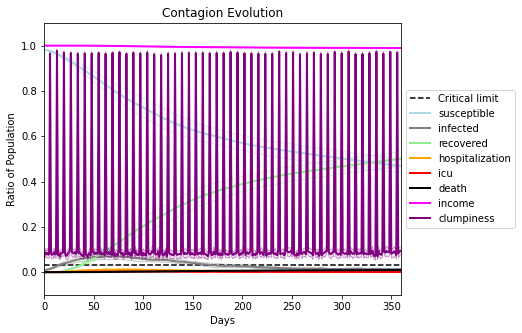

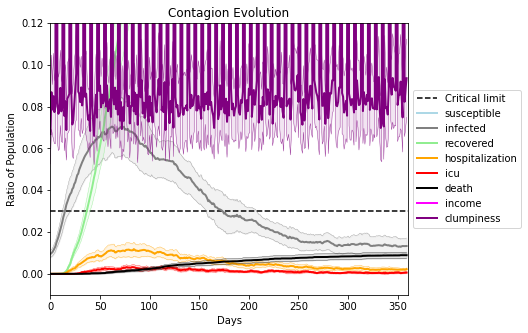

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3814, 5407, 1027, 6946, 682, 4793, 9129, 3247, 3843, 9598, 5417, 326, 5283, 777, 3499, 9115, 8006, 5716, 3790, 3279]
Average similarity between family members is 0.941684069190298 at temperature -0.995
Average similarity between family and home is 0.9998467910450602 at temperature -1
Average similarity between students and their classroom is 0.5867120064779264 at temperature -0.995
Average classroom occupancy is 4.582089552238806 and number classrooms is 67
Average similarity between workers is 0.8951597460222634 at temperature -0.995
Average office occupancy is 3.345549738219895 and number offices is 191
Average friend similarity for adults: 0.8472151988385014 for kids: 0.7084392989690322
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5991755537336912
avg restaurant similarity 0.4675234562100596
avg restaurant similarity 0.588943373427049
avg restaurant similarity 0.6321616635529302
avg restaurant similarity 0.5524680996772917
avg restaurant similarity 0.938606754591972
avg restaurant similarity 0.6891310205853756
avg restaurant similarity 0.5343602453941549
avg restaurant similarity 0.5325898388373436
avg restaurant similarity 0.44429372053538685
avg restaurant similarity 0.746898151603702
avg restaurant similarity 0.6894325344961647
avg restaurant similarity 0.7242900922871167
avg restaurant similarity 0.5384028066022599
avg restaurant similarity 0.6648759471415253
avg restaurant similarity 0.43193085216693267
avg restaurant similarity 0.19706014396986204
avg restaurant similarity 0.5661820657574579
avg restaurant similarity 0.6868550304109073
avg restaurant similarity 0.7677385437278554
avg restaurant similarity 0.6556944258682952
avg restaurant similarity 0.5760673048115644
avg restau

avg restaurant similarity 0.5357428330374701
avg restaurant similarity 0.5047492583630437
avg restaurant similarity 0.37019732988831233
avg restaurant similarity 0.5727662032600297
avg restaurant similarity 0.2965712564546117
avg restaurant similarity 0.5835626079802412
avg restaurant similarity 0.6127526408463461
avg restaurant similarity 0.44662175977839985
avg restaurant similarity 0.7307324049316765
avg restaurant similarity 0.6491224985432867
avg restaurant similarity 0.47645630470494627
avg restaurant similarity 0.6050185410372014
avg restaurant similarity 0.5744759105825594
avg restaurant similarity 0.601250206494878
avg restaurant similarity 0.5523802013258098
avg restaurant similarity 0.41940255528621206
avg restaurant similarity 0.5003197091768611
avg restaurant similarity 0.6478302011645221
avg restaurant similarity 0.6293455143347368
avg restaurant similarity 0.42637990421792815
avg restaurant similarity 0.5777762349007971
avg restaurant similarity 0.503166211095342
avg res

avg restaurant similarity 0.5418997546804633
avg restaurant similarity 0.5540080060193034
avg restaurant similarity 0.4521384352284231
avg restaurant similarity 0.42934293682972297
avg restaurant similarity 0.5549730545261686
avg restaurant similarity 0.5093119317817353
avg restaurant similarity 0.513107946864509
avg restaurant similarity 0.4617689183719914
avg restaurant similarity 0.48193056743884277
avg restaurant similarity 0.7057394275520693
avg restaurant similarity 0.5015274241145362
avg restaurant similarity 0.4747908722775639
avg restaurant similarity 0.48701435108839525
avg restaurant similarity 0.999807133876635
avg restaurant similarity 0.3547426783762035
avg restaurant similarity 0.4601806369615974
avg restaurant similarity 0.34193641973302247
avg restaurant similarity 0.41848447899973423
avg restaurant similarity 0.4728873427353171
avg restaurant similarity 0.8678545869421392
avg restaurant similarity 0.39617437653273485
avg restaurant similarity 0.3760931192553653
avg re

avg restaurant similarity 0.41124832621177254
avg restaurant similarity 0.857562336224841
avg restaurant similarity 0.48466298050738416
avg restaurant similarity 0.48109595701549734
avg restaurant similarity 0.4658682458127359
avg restaurant similarity 0.4232203584160719
avg restaurant similarity 0.3970489807983689
avg restaurant similarity 0.46943066643729603
avg restaurant similarity 0.4911724748878325
avg restaurant similarity 0.49286286012889974
avg restaurant similarity 0.5938230377853764
avg restaurant similarity 0.6225793736826246
avg restaurant similarity 0.5715241024594128
avg restaurant similarity 0.43685139287176983
avg restaurant similarity 0.4771824998017087
avg restaurant similarity 0.5440693790060661
avg restaurant similarity 0.4700708363260883
avg restaurant similarity 0.4772484835531761
avg restaurant similarity 0.4978310541691638
avg restaurant similarity 0.36314455734601736
avg restaurant similarity 0.33952545026673836
avg restaurant similarity 0.3855194046753738
avg

avg restaurant similarity 0.6895359433510465
avg restaurant similarity 0.8093210337741117
avg restaurant similarity 0.6454537119772515
avg restaurant similarity 0.5135533676856912
avg restaurant similarity 0.4676439094933867
avg restaurant similarity 0.5806331435301418
avg restaurant similarity 0.620784080977132
avg restaurant similarity 0.6465624374087754
avg restaurant similarity 0.5947291743842565
avg restaurant similarity 0.37855884127649597
avg restaurant similarity 0.490291565015723
avg restaurant similarity 0.3672709877056755
avg restaurant similarity 0.6308398383645119
avg restaurant similarity 0.6604491505633121
avg restaurant similarity 0.4912019594634924
avg restaurant similarity 0.49433682728686934
avg restaurant similarity 0.6082253390261461
avg restaurant similarity 0.6292588491166341
avg restaurant similarity 0.37255952131313663
avg restaurant similarity 0.6675944265175724
avg restaurant similarity 0.4693719435203461
avg restaurant similarity 0.5219693827390524
avg resta

avg restaurant similarity 0.4929544405463987
avg restaurant similarity 0.5636092116648911
avg restaurant similarity 0.4736253764153502
avg restaurant similarity 0.8272569341221041
avg restaurant similarity 0.42848222797085184
avg restaurant similarity 0.5385684053741685
avg restaurant similarity 0.7678933427983788
avg restaurant similarity 0.5405970127826115
avg restaurant similarity 0.6345997394265874
avg restaurant similarity 0.451124202581302
avg restaurant similarity 0.6209113450733876
avg restaurant similarity 0.5888560428943137
avg restaurant similarity 0.7129640169803177
avg restaurant similarity 0.5933820369345825
avg restaurant similarity 0.6383835457538087
avg restaurant similarity 0.4064648684689769
avg restaurant similarity 0.7266059587369286
avg restaurant similarity 0.6178933125125528
avg restaurant similarity 0.38886177099392283
avg restaurant similarity 0.594957375762639
avg restaurant similarity 0.7214056380981185
avg restaurant similarity 0.6035547906082818
avg restau

avg restaurant similarity 0.3509212361385201
avg restaurant similarity 0.6767596697920955
avg restaurant similarity 0.7226115193900504
avg restaurant similarity 0.5593250069789465
avg restaurant similarity 0.3963718647509351
avg restaurant similarity 0.4481182996401778
avg restaurant similarity 0.468175635595842
avg restaurant similarity 0.5436770479990152
avg restaurant similarity 0.5697657986817073
avg restaurant similarity 0.5171514587917221
avg restaurant similarity 0.6381616317782794
avg restaurant similarity 0.834193191558001
avg restaurant similarity 0.5376740178680439
avg restaurant similarity 0.6323690980414631
avg restaurant similarity 0.5493855383664876
avg restaurant similarity 0.4778093319341366
avg restaurant similarity 0.435976650263533
avg restaurant similarity 0.47928857562369465
avg restaurant similarity 0.7795395372182329
avg restaurant similarity 0.541601855512122
avg restaurant similarity 0.47979798323205247
avg restaurant similarity 0.6109701244339704
avg restaura

avg restaurant similarity 0.564516823445356
avg restaurant similarity 0.5658347960994319
avg restaurant similarity 0.5862582937146715
avg restaurant similarity 0.5414198002820785
avg restaurant similarity 0.6502828026576547
avg restaurant similarity 0.5135929350358082
avg restaurant similarity 0.7398660264042604
avg restaurant similarity 0.5261486715989414
avg restaurant similarity 0.6349716876682583
avg restaurant similarity 0.5646329680890596
avg restaurant similarity 0.6252822593311618
avg restaurant similarity 0.5781457190744329
avg restaurant similarity 0.3901700063163962
avg restaurant similarity 0.6047645579535159
avg restaurant similarity 0.5134728117615619
avg restaurant similarity 0.3831781446726838
avg restaurant similarity 0.5542291718600478
avg restaurant similarity 0.5851959121814293
avg restaurant similarity 0.5086902772513199
avg restaurant similarity 0.6494097727650295
avg restaurant similarity 0.3639744408603129
avg restaurant similarity 0.5315563952739477
avg restaur

avg restaurant similarity 0.5981064069867144
avg restaurant similarity 0.7171794137252856
avg restaurant similarity 0.4951625572704631
avg restaurant similarity 0.5778986658729101
avg restaurant similarity 0.5285271059469895
avg restaurant similarity 0.5709859974383797
avg restaurant similarity 0.5858189582747899
avg restaurant similarity 0.5949061647494425
avg restaurant similarity 0.5928291456243762
avg restaurant similarity 0.5244111852693568
avg restaurant similarity 0.5563701397190244
avg restaurant similarity 0.6422308061597145
avg restaurant similarity 0.5686669741626964
avg restaurant similarity 0.6457064950807714
avg restaurant similarity 0.5914286040624751
avg restaurant similarity 0.8962769868231169
avg restaurant similarity 0.6141375814083123
avg restaurant similarity 0.7858141387297526
avg restaurant similarity 0.5318180275701072
avg restaurant similarity 0.6511396907727044
avg restaurant similarity 0.6784520687809892
avg restaurant similarity 0.4921631550259831
avg restau

avg restaurant similarity 0.6274918789436927
avg restaurant similarity 0.49122799927647304
avg restaurant similarity 0.6668844061645611
avg restaurant similarity 0.5815629698677707
avg restaurant similarity 0.48069109581395963
avg restaurant similarity 0.5480743086324645
avg restaurant similarity 0.6664370770349645
avg restaurant similarity 0.5859398598717749
avg restaurant similarity 0.5768745091106748
avg restaurant similarity 0.5263613279415594
avg restaurant similarity 0.5825692821685619
avg restaurant similarity 0.6793157576740075
avg restaurant similarity 0.6306437208817651
avg restaurant similarity 0.44177686453819115
avg restaurant similarity 0.47433220034914864
avg restaurant similarity 0.8929106531749788
avg restaurant similarity 0.6356374434241889
avg restaurant similarity 0.5648516600196044
avg restaurant similarity 0.6729332324787793
avg restaurant similarity 0.6727342260149229
avg restaurant similarity 0.7203257350916911
avg restaurant similarity 0.6050998018234249
avg re

avg restaurant similarity 0.5439287271701869
avg restaurant similarity 0.5662547029129922
avg restaurant similarity 0.5179215499740617
avg restaurant similarity 0.6038570859516752
avg restaurant similarity 0.6872682568201165
avg restaurant similarity 0.5590679426337758
avg restaurant similarity 0.7040852615504283
avg restaurant similarity 0.6107648330134211
avg restaurant similarity 0.5880858892348152
avg restaurant similarity 0.46631370940119976
avg restaurant similarity 0.7588931490707427
avg restaurant similarity 0.6712573134147705
avg restaurant similarity 0.5465246903784451
avg restaurant similarity 0.5332317957241358
avg restaurant similarity 0.7501278319184772
avg restaurant similarity 0.5768285959320878
avg restaurant similarity 0.5742785877126688
avg restaurant similarity 0.6160346233780406
avg restaurant similarity 0.5888573074748945
avg restaurant similarity 0.692576357062169
avg restaurant similarity 0.9997339344424792
avg restaurant similarity 0.5358424042482527
avg restau

avg restaurant similarity 0.639270931014959
avg restaurant similarity 0.6257555017882643
avg restaurant similarity 0.5789790455936372
avg restaurant similarity 0.5917566356694002
avg restaurant similarity 0.6304788496714449
avg restaurant similarity 0.5805133620337747
avg restaurant similarity 0.634250832024025
avg restaurant similarity 0.5919569926769037
avg restaurant similarity 0.6447915279269956
avg restaurant similarity 0.5527893164728109
avg restaurant similarity 0.7033322719042535
avg restaurant similarity 0.5694425308987797
avg restaurant similarity 0.6155140982061909
avg restaurant similarity 0.5841252346447733
avg restaurant similarity 0.3051933967026912
avg restaurant similarity 0.5345431427757213
avg restaurant similarity 0.6374053825657805
avg restaurant similarity 0.4776882549905952
avg restaurant similarity 0.5634675848995689
avg restaurant similarity 0.6077295387289281
avg restaurant similarity 0.6919080038149075
avg restaurant similarity 0.7299303238929383
avg restaura

avg restaurant similarity 0.6645134764457972
avg restaurant similarity 0.4882842184718686
avg restaurant similarity 0.673030438493111
avg restaurant similarity 0.5943361147515944
avg restaurant similarity 0.5137692798200609
avg restaurant similarity 0.6091601432088182
avg restaurant similarity 0.5456593123725614
avg restaurant similarity 0.5126182134929084
avg restaurant similarity 0.578866696059024
avg restaurant similarity 0.5679472312249345
avg restaurant similarity 0.5505213972708908
avg restaurant similarity 0.7116645857042049
avg restaurant similarity 0.5449374581407062
avg restaurant similarity 0.6271651031668137
avg restaurant similarity 0.5930302128172479
avg restaurant similarity 0.5781789348912948
avg restaurant similarity 0.6225907234234399
avg restaurant similarity 0.7211119895351903
avg restaurant similarity 0.5662950328362194
avg restaurant similarity 0.5860670470706257
avg restaurant similarity 0.590862701865023
avg restaurant similarity 0.5818880575225858
avg restauran

avg restaurant similarity 0.5256892068311566
avg restaurant similarity 0.5910291876832244
avg restaurant similarity 0.6467507143788158
avg restaurant similarity 0.5183345440407449
avg restaurant similarity 0.4450441413871831
avg restaurant similarity 0.46151437147352486
avg restaurant similarity 0.5062358267341095
avg restaurant similarity 0.5504974957836918
avg restaurant similarity 0.5569064457378265
avg restaurant similarity 0.6300850694532031
avg restaurant similarity 0.49641476405042984
avg restaurant similarity 0.41170144646561047
avg restaurant similarity 0.5913488714917922
avg restaurant similarity 0.5121561086580679
avg restaurant similarity 0.5148326404064844
avg restaurant similarity 0.49164990012820975
avg restaurant similarity 0.5607314733159761
avg restaurant similarity 0.5231328320376025
avg restaurant similarity 0.5480737760598536
avg restaurant similarity 0.6487681067458667
avg restaurant similarity 0.49844143583221184
avg restaurant similarity 0.5937152813579549
avg r

avg restaurant similarity 0.5875396257826664
avg restaurant similarity 0.6397556085476773
avg restaurant similarity 0.582726923972385
avg restaurant similarity 0.5507601350597172
avg restaurant similarity 0.5654705139715515
avg restaurant similarity 0.5553520301240431
avg restaurant similarity 0.6694600351658387
avg restaurant similarity 0.5786170505813775
avg restaurant similarity 0.4940411850486849
avg restaurant similarity 0.728812116502263
avg restaurant similarity 0.6118051281716507
avg restaurant similarity 0.35363226888340826
avg restaurant similarity 0.5849894141821033
avg restaurant similarity 0.5924896454946951
avg restaurant similarity 0.5763468077061635
avg restaurant similarity 0.5955609449475995
avg restaurant similarity 0.49317669354685645
avg restaurant similarity 0.4634688463807214
avg restaurant similarity 0.5324016108719382
avg restaurant similarity 0.6494379462582796
avg restaurant similarity 0.5455658756776355
avg restaurant similarity 0.5549563813718204
avg restau

avg restaurant similarity 0.4471184346494713
avg restaurant similarity 0.5598460574052231
avg restaurant similarity 0.9100943164558296
avg restaurant similarity 0.577333068861476
avg restaurant similarity 0.740169964991735
avg restaurant similarity 0.4160553934033715
avg restaurant similarity 0.5301051172629654
avg restaurant similarity 0.4777642126861852
avg restaurant similarity 0.39707206221673114
avg restaurant similarity 0.49739127369717245
avg restaurant similarity 0.5746150772275044
avg restaurant similarity 0.47492537956155223
avg restaurant similarity 0.615664593157052
avg restaurant similarity 0.6270786602342817
avg restaurant similarity 0.469804584763811
avg restaurant similarity 0.630668268899882
avg restaurant similarity 0.5126690899165651
avg restaurant similarity 0.45198827177175976
avg restaurant similarity 0.5278694359390703
avg restaurant similarity 0.4932788321171548
avg restaurant similarity 0.6872903267399687
avg restaurant similarity 0.6733167016170648
avg restaur

avg restaurant similarity 0.841077206679243
avg restaurant similarity 0.48046245050627484
avg restaurant similarity 0.6408590212545064
avg restaurant similarity 0.6505409441478496
avg restaurant similarity 0.6255454802391465
avg restaurant similarity 0.6447621042402562
avg restaurant similarity 0.6423769058805952
avg restaurant similarity 0.5821545571303454
avg restaurant similarity 0.5132225641523458
avg restaurant similarity 0.5944623486743521
avg restaurant similarity 0.8960424552070918
avg restaurant similarity 0.4882166091377485
avg restaurant similarity 0.6062865068710332
avg restaurant similarity 0.5218734544761844
avg restaurant similarity 0.7786375070433303
avg restaurant similarity 0.6318989208651072
avg restaurant similarity 0.638357941193731
avg restaurant similarity 0.6563275771397786
avg restaurant similarity 0.5038223359398527
avg restaurant similarity 0.6772575085586243
avg restaurant similarity 0.4948486304926257
avg restaurant similarity 0.5354504580796419
avg restaur

avg restaurant similarity 0.6169865421930347
avg restaurant similarity 0.587701370982375
avg restaurant similarity 0.5651579759085493
avg restaurant similarity 0.44906031253285733
avg restaurant similarity 0.45718523899112523
avg restaurant similarity 0.5904410433945216
avg restaurant similarity 0.6070713260843444
avg restaurant similarity 0.6711579282146805
avg restaurant similarity 0.5458594427221286
avg restaurant similarity 0.3236979060606243
avg restaurant similarity 0.8337000643337543
avg restaurant similarity 0.6172858276640764
avg restaurant similarity 0.5788205185105111
avg restaurant similarity 0.717635629303866
avg restaurant similarity 0.5991363646923683
avg restaurant similarity 0.4977588920684125
avg restaurant similarity 0.37742098867223095
avg restaurant similarity 0.5316483138725608
avg restaurant similarity 0.35544335352760004
avg restaurant similarity 0.5772732401177467
avg restaurant similarity 0.602435108924293
avg restaurant similarity 0.665351170715449
avg restau

avg restaurant similarity 0.4999310477590733
avg restaurant similarity 0.5742244700509627
avg restaurant similarity 0.5386815323300952
avg restaurant similarity 0.5505160382037181
avg restaurant similarity 0.582463112395812
avg restaurant similarity 0.5673589279462893
avg restaurant similarity 0.5849333270659004
avg restaurant similarity 0.5408688072538329
avg restaurant similarity 0.41965737826946803
avg restaurant similarity 0.7254418551699812
avg restaurant similarity 0.6225455998668096
avg restaurant similarity 0.5024508026557881
avg restaurant similarity 0.5432728489645424
avg restaurant similarity 0.6184737722097136
avg restaurant similarity 0.6268235278711788
avg restaurant similarity 0.5054976936288481
avg restaurant similarity 0.5102569660197893
avg restaurant similarity 0.7030101805236266
avg restaurant similarity 0.5943811676852307
avg restaurant similarity 0.522709751257961
avg restaurant similarity 0.566166584290361
avg restaurant similarity 0.7300373805506988
avg restaura

avg restaurant similarity 0.5627561213858896
avg restaurant similarity 0.5538834433248596
avg restaurant similarity 0.5899036478626843
avg restaurant similarity 0.6071904812062316
avg restaurant similarity 0.4903266973167124
avg restaurant similarity 0.5918978626726102
avg restaurant similarity 0.5431790035756356
avg restaurant similarity 0.568053973063128
avg restaurant similarity 0.6154211669351539
avg restaurant similarity 0.5134428811480478
avg restaurant similarity 0.5025329932929636
avg restaurant similarity 0.5731826502487133
avg restaurant similarity 0.5930206030407065
avg restaurant similarity 0.6440548610364889
avg restaurant similarity 0.6023629880539443
avg restaurant similarity 0.558922455343994
avg restaurant similarity 0.6039795158231769
avg restaurant similarity 0.6372104000194667
avg restaurant similarity 0.5304439641822692
avg restaurant similarity 0.543106495418775
avg restaurant similarity 0.6320980468721868
avg restaurant similarity 0.5470452354441775
avg restauran

avg restaurant similarity 0.47393079449890846
avg restaurant similarity 0.5764882249548604
avg restaurant similarity 0.5604085925855666
avg restaurant similarity 0.7279364107884326
avg restaurant similarity 0.5517244195154606
avg restaurant similarity 0.6076084543768309
avg restaurant similarity 0.45537655412212985
avg restaurant similarity 0.6590948940130168
avg restaurant similarity 0.7442666748598339
avg restaurant similarity 0.6338954140752163
avg restaurant similarity 0.5954870324700547
avg restaurant similarity 0.3983801020045333
avg restaurant similarity 0.6157661717198617
avg restaurant similarity 0.5022201171193781
avg restaurant similarity 0.5792707337632675
avg restaurant similarity 0.39122701148958555
avg restaurant similarity 0.6356677349657489
avg restaurant similarity 0.6841242660254201
avg restaurant similarity 0.46588302328267917
avg restaurant similarity 0.6798671482927169
avg restaurant similarity 0.7161478648279195
avg restaurant similarity 0.999428817396335
avg res

avg restaurant similarity 0.5888395086289945
avg restaurant similarity 0.6384855442315378
avg restaurant similarity 0.5957714031822586
avg restaurant similarity 0.4538689977372806
avg restaurant similarity 0.6262953231914771
avg restaurant similarity 0.6383994305412866
avg restaurant similarity 0.4326124558901645
avg restaurant similarity 0.6320799251397604
avg restaurant similarity 0.8384831694800741
avg restaurant similarity 0.5180004926090149
avg restaurant similarity 0.5316012329357582
avg restaurant similarity 0.5776957941150845
avg restaurant similarity 0.505133940997921
avg restaurant similarity 0.5640280889117205
avg restaurant similarity 0.6000978737882379
avg restaurant similarity 0.5814063609787848
avg restaurant similarity 0.5329039856487576
avg restaurant similarity 0.633816887012591
avg restaurant similarity 0.6143718504715326
avg restaurant similarity 0.6354420653098966
avg restaurant similarity 0.5752128839365466
avg restaurant similarity 0.42794768373107533
avg restaur

avg restaurant similarity 0.5955999915577542
avg restaurant similarity 0.5170543518114095
avg restaurant similarity 0.5904195694617104
avg restaurant similarity 0.4255110621403553
avg restaurant similarity 0.487734331591896
avg restaurant similarity 0.4982593496188694
avg restaurant similarity 0.40455377288031535
avg restaurant similarity 0.5693612899731885
avg restaurant similarity 0.5916029069286106
avg restaurant similarity 0.5646970139037193
avg restaurant similarity 0.47198754841216317
avg restaurant similarity 0.3904890909689711
avg restaurant similarity 0.5856958150680881
avg restaurant similarity 0.4546314341875733
avg restaurant similarity 0.6664905234097355
avg restaurant similarity 0.47089316322806973
avg restaurant similarity 0.48403911583940173
avg restaurant similarity 0.6021004962135684
avg restaurant similarity 0.6230433610761499
avg restaurant similarity 0.4675415525913202
avg restaurant similarity 0.5685630051924359
avg restaurant similarity 0.5572172719279157
avg res

avg restaurant similarity 0.45773492760221024
avg restaurant similarity 0.43282295451529706
avg restaurant similarity 0.5849145079783891
avg restaurant similarity 0.5544805732924509
avg restaurant similarity 0.5148324265627555
avg restaurant similarity 0.5834630999126672
avg restaurant similarity 0.5244939343077888
avg restaurant similarity 0.4114063547929764
avg restaurant similarity 0.4939222158679238
avg restaurant similarity 0.5809624297565068
avg restaurant similarity 0.6015104854910001
avg restaurant similarity 0.6298659895732606
avg restaurant similarity 0.4505126286968523
avg restaurant similarity 0.5313315785173526
avg restaurant similarity 0.45493909937929206
avg restaurant similarity 0.4703577592726571
avg restaurant similarity 0.6373134508902668
avg restaurant similarity 0.5026810551777261
avg restaurant similarity 0.7190709291213749
avg restaurant similarity 0.471334168444302
avg restaurant similarity 0.757108915562654
avg restaurant similarity 0.539911264022094
avg restau

avg restaurant similarity 0.6380603634977873
avg restaurant similarity 0.5212584304852397
avg restaurant similarity 0.7025654382031928
avg restaurant similarity 0.6655728718872785
avg restaurant similarity 0.6718029860657091
avg restaurant similarity 0.6853906265210084
avg restaurant similarity 0.756598771874492
avg restaurant similarity 0.44138329458297954
avg restaurant similarity 0.6858104430273645
avg restaurant similarity 0.8032097794723723
avg restaurant similarity 0.7133072701453038
avg restaurant similarity 0.5103923868997776
avg restaurant similarity 0.5351707423550669
avg restaurant similarity 0.4888568572148756
avg restaurant similarity 0.5721099666942109
avg restaurant similarity 0.6182480958876646
avg restaurant similarity 0.7589254006582229
avg restaurant similarity 0.7522995794144701
avg restaurant similarity 0.7980845472524456
avg restaurant similarity 0.6419043792048998
avg restaurant similarity 0.5104061583132316
avg restaurant similarity 0.6651088297439953
avg restau

avg restaurant similarity 0.5603812183125949
avg restaurant similarity 0.584322618818552
avg restaurant similarity 0.5398799990748137
avg restaurant similarity 0.5569266497235642
avg restaurant similarity 0.613359994021386
avg restaurant similarity 0.5575362011966913
avg restaurant similarity 0.6568459126256652
avg restaurant similarity 0.6530223345964008
avg restaurant similarity 0.49195325288901515
avg restaurant similarity 0.52122182435298
avg restaurant similarity 0.6142384461361364
avg restaurant similarity 0.8816580515048262
avg restaurant similarity 0.5788319359307104
avg restaurant similarity 0.641161347751537
avg restaurant similarity 0.548578330298078
avg restaurant similarity 0.625770449511673
avg restaurant similarity 0.5171079280133722
avg restaurant similarity 0.6278318148107663
avg restaurant similarity 0.6238376418261989
avg restaurant similarity 0.4581210396905926
avg restaurant similarity 0.6367279705716252
avg restaurant similarity 0.6002535627134655
avg restaurant s

avg restaurant similarity 0.8169932111184028
avg restaurant similarity 0.5252781241987654
avg restaurant similarity 0.631144286320026
avg restaurant similarity 0.536743714662171
avg restaurant similarity 0.5319906511472741
avg restaurant similarity 0.5605390653398836
avg restaurant similarity 0.6744826942903919
avg restaurant similarity 0.565703332662787
avg restaurant similarity 0.5359599492155238
avg restaurant similarity 0.6705455292575232
avg restaurant similarity 0.6534005869262657
avg restaurant similarity 0.6048809443036125
avg restaurant similarity 0.6365963032448563
avg restaurant similarity 0.5719597150747281
avg restaurant similarity 0.3774688443934177
avg restaurant similarity 0.5256272793583932
avg restaurant similarity 0.7436578652740192
avg restaurant similarity 0.5442043415663554
avg restaurant similarity 0.5886180280970286
avg restaurant similarity 0.4658719325857036
avg restaurant similarity 0.37853980954071514
avg restaurant similarity 0.5611128038165464
avg restaura

avg restaurant similarity 0.49664482574032875
avg restaurant similarity 0.5756014838545194
avg restaurant similarity 0.4809285368563084
avg restaurant similarity 0.5855950306671992
avg restaurant similarity 0.4744614242439091
avg restaurant similarity 0.5289809610267149
avg restaurant similarity 0.530473281371949
avg restaurant similarity 0.5657536666643419
avg restaurant similarity 0.6374297113093438
avg restaurant similarity 0.6851065957021722
avg restaurant similarity 0.5856393582047887
avg restaurant similarity 0.528682051085947
avg restaurant similarity 0.5288403305295215
avg restaurant similarity 0.5349167854717494
avg restaurant similarity 0.6385866583100871
avg restaurant similarity 0.5160026413082607
avg restaurant similarity 0.576421143792776
avg restaurant similarity 0.6277364506950501
avg restaurant similarity 0.44765763484766036
avg restaurant similarity 0.530163017552199
avg restaurant similarity 0.6750212638016877
avg restaurant similarity 0.48367731732626584
avg restaur

avg restaurant similarity 0.6057157399371154
avg restaurant similarity 0.6809347924495952
avg restaurant similarity 0.3683122906067868
avg restaurant similarity 0.5438973715499887
avg restaurant similarity 0.5232561739699176
avg restaurant similarity 0.2845273509502779
avg restaurant similarity 0.6051698197881704
avg restaurant similarity 0.6387933646919236
avg restaurant similarity 0.4799271924288643
avg restaurant similarity 0.501728510464084
avg restaurant similarity 0.4318345153934543
avg restaurant similarity 0.6513692243482977
avg restaurant similarity 0.6730655270092035
avg restaurant similarity 0.5408732162918465
avg restaurant similarity 0.6245629678677492
avg restaurant similarity 0.5115189309397384
avg restaurant similarity 0.519140528995344
avg restaurant similarity 0.555539970265652
avg restaurant similarity 0.4679890265116974
avg restaurant similarity 0.7374932274116964
avg restaurant similarity 0.5458806406662645
avg restaurant similarity 0.5959725552050759
avg restauran

avg restaurant similarity 0.6020315048447934
avg restaurant similarity 0.5595110635112291
avg restaurant similarity 0.39677648822350015
avg restaurant similarity 0.497854622628172
avg restaurant similarity 0.46738689570775105
avg restaurant similarity 0.7984835656938984
avg restaurant similarity 0.48378495119299003
avg restaurant similarity 0.4460833480128134
avg restaurant similarity 0.48848221846876966
avg restaurant similarity 0.43083753147406156
avg restaurant similarity 0.5363433969920628
avg restaurant similarity 0.4616905958170711
avg restaurant similarity 0.5350297674805536
avg restaurant similarity 0.34356665551954224
avg restaurant similarity 0.4865269378400243
avg restaurant similarity 0.5179297265954194
avg restaurant similarity 0.47093592480520763
avg restaurant similarity 0.5405963572367637
avg restaurant similarity 0.43915296488542455
avg restaurant similarity 0.48186726635047633
avg restaurant similarity 0.6234981033603285
avg restaurant similarity 0.3411139597897169
av

avg restaurant similarity 0.5929017914619908
avg restaurant similarity 0.7491236579234024
avg restaurant similarity 0.5723434093093973
avg restaurant similarity 0.5318033654882817
avg restaurant similarity 0.6069648098697267
avg restaurant similarity 0.4571878860575828
avg restaurant similarity 0.7061040485559684
avg restaurant similarity 0.553765051516376
avg restaurant similarity 0.4803577363001006
avg restaurant similarity 0.6971815653263287
avg restaurant similarity 0.5411317827353362
avg restaurant similarity 0.5264079569622305
avg restaurant similarity 0.6550337901971375
avg restaurant similarity 0.5494346842170732
avg restaurant similarity 0.7262071144801858
avg restaurant similarity 0.5850205291756229
avg restaurant similarity 0.6312218799691448
avg restaurant similarity 0.4658633140294768
avg restaurant similarity 0.6997261531880091
avg restaurant similarity 0.6738243267934408
avg restaurant similarity 0.6891833511413229
avg restaurant similarity 0.5512344204777014
avg restaur

avg restaurant similarity 0.5555037692753603
avg restaurant similarity 0.6638962892944008
avg restaurant similarity 0.5823133008562462
avg restaurant similarity 0.5241412192383668
avg restaurant similarity 0.7121673737549625
avg restaurant similarity 0.41111942103649446
avg restaurant similarity 0.35417842680998013
avg restaurant similarity 0.5075055309443217
avg restaurant similarity 0.6207098305859261
avg restaurant similarity 0.7649305081870287
avg restaurant similarity 0.4646466944055044
avg restaurant similarity 0.7214595321576271
avg restaurant similarity 0.6132908703962207
avg restaurant similarity 0.8545701707153028
avg restaurant similarity 0.6069645941008239
avg restaurant similarity 0.9998105667991097
avg restaurant similarity 0.6982482943705112
avg restaurant similarity 0.5256254414290231
avg restaurant similarity 0.8560024010854224
avg restaurant similarity 0.461225674626336
avg restaurant similarity 0.530827000684492
avg restaurant similarity 0.6970688516482492
avg restau

avg restaurant similarity 0.5590836362873222
avg restaurant similarity 0.8476730282091038
avg restaurant similarity 0.6164697190552186
avg restaurant similarity 0.5939626986384577
avg restaurant similarity 0.6789197680176399
avg restaurant similarity 0.4299512914277283
avg restaurant similarity 0.6491487670534025
avg restaurant similarity 0.7370831280279074
avg restaurant similarity 0.4539782047940407
avg restaurant similarity 0.7644966254446333
avg restaurant similarity 0.7320996817380212
avg restaurant similarity 0.6776627296152714
avg restaurant similarity 0.6493485313598164
avg restaurant similarity 0.4188080492355976
avg restaurant similarity 0.6129613477412801
avg restaurant similarity 0.7153195774563789
avg restaurant similarity 0.4607892797774291
avg restaurant similarity 0.5607153164074106
avg restaurant similarity 0.4867663664100947
avg restaurant similarity 0.5529703080182725
avg restaurant similarity 0.6217528706911132
avg restaurant similarity 0.4222455767736295
avg restau

avg restaurant similarity 0.4905006137986327
avg restaurant similarity 0.6013243653645269
avg restaurant similarity 0.999710860419289
avg restaurant similarity 0.4447269275776076
avg restaurant similarity 0.6650922178254375
avg restaurant similarity 0.6236347037994248
avg restaurant similarity 0.4845273719746425
avg restaurant similarity 0.7117976006190673
avg restaurant similarity 0.5700936927244689
avg restaurant similarity 0.6116768624775779
avg restaurant similarity 0.5462664802148803
avg restaurant similarity 0.45293018332900975
avg restaurant similarity 0.7085689275824752
avg restaurant similarity 0.5683488124777414
avg restaurant similarity 0.484577164806966
avg restaurant similarity 0.5015825405527404
avg restaurant similarity 0.7025958149151191
avg restaurant similarity 0.6859947172180497
avg restaurant similarity 0.5036474496286463
avg restaurant similarity 0.5471899399640486
avg restaurant similarity 0.35975599543657805
avg restaurant similarity 0.5321066059257754
avg restau

avg restaurant similarity 0.6685567875937778
avg restaurant similarity 0.4009878447188061
avg restaurant similarity 0.5291286483277375
avg restaurant similarity 0.5023711828987445
avg restaurant similarity 0.4714342655767607
avg restaurant similarity 0.5502068395822732
avg restaurant similarity 0.5397293963842453
avg restaurant similarity 0.4157975609358388
avg restaurant similarity 0.6556172216739821
avg restaurant similarity 0.5726405202423965
avg restaurant similarity 0.5896988258292236
avg restaurant similarity 0.5247271982406576
avg restaurant similarity 0.6460683950336076
avg restaurant similarity 0.558854654163376
avg restaurant similarity 0.4749487799388592
avg restaurant similarity 0.43697699531147227
avg restaurant similarity 0.6601353074463558
avg restaurant similarity 0.6737785633565989
avg restaurant similarity 0.7056804130343673
avg restaurant similarity 0.6132077146142758
avg restaurant similarity 0.5848433810232602
avg restaurant similarity 0.5625361841113481
avg restau

avg restaurant similarity 0.47542473568355226
avg restaurant similarity 0.5544468396800859
avg restaurant similarity 0.5805752239873619
avg restaurant similarity 0.6451301448203293
avg restaurant similarity 0.5772545194808147
avg restaurant similarity 0.4852863616136637
avg restaurant similarity 0.6659648526046789
avg restaurant similarity 0.6910284921243685
avg restaurant similarity 0.33433110592505494
avg restaurant similarity 0.6611406456922408
avg restaurant similarity 0.47410272094528394
avg restaurant similarity 0.43431848414440793
avg restaurant similarity 0.4306771256171398
avg restaurant similarity 0.43145224752609806
avg restaurant similarity 0.6274419486408527
avg restaurant similarity 0.41565825415582175
avg restaurant similarity 0.4642646179444017
avg restaurant similarity 0.574557145422026
avg restaurant similarity 0.596744016377591
avg restaurant similarity 0.6632521383063328
avg restaurant similarity 0.5343319726778506
avg restaurant similarity 0.5162421419674621
avg re

avg restaurant similarity 0.3526289816610425
avg restaurant similarity 0.6123225803458296
avg restaurant similarity 0.4739034592564681
avg restaurant similarity 0.46753026312733353
avg restaurant similarity 0.5349391282920972
avg restaurant similarity 0.6117390507721493
avg restaurant similarity 0.506955664195329
avg restaurant similarity 0.5621296977427288
avg restaurant similarity 0.47549990513278084
avg restaurant similarity 0.44967250323006713
avg restaurant similarity 0.5567018657442725
avg restaurant similarity 0.5181843737418448
avg restaurant similarity 0.3959254945401895
avg restaurant similarity 0.7340252052256302
avg restaurant similarity 0.44145534328007635
avg restaurant similarity 0.3086832475233955
avg restaurant similarity 0.7356103780793983
avg restaurant similarity 0.5393079361612847
avg restaurant similarity 0.6408457951449279
avg restaurant similarity 0.5874379091390625
avg restaurant similarity 0.37071535571062236
avg restaurant similarity 0.457910120146353
avg res

avg restaurant similarity 0.5015758572572733
avg restaurant similarity 0.5863433358543347
avg restaurant similarity 0.6356926895425561
avg restaurant similarity 0.4780735727040457
avg restaurant similarity 0.12922355731579074
avg restaurant similarity 0.6428514495237551
avg restaurant similarity 0.7652978756700862
avg restaurant similarity 0.7842917097160633
avg restaurant similarity 0.4923275830460483
avg restaurant similarity 0.5401267743541758
avg restaurant similarity 0.3626737422051927
avg restaurant similarity 0.5366158814628837
avg restaurant similarity 0.6002335421809043
avg restaurant similarity 0.5549351863817792
avg restaurant similarity 0.5606808108470616
avg restaurant similarity 0.5664947215956628
avg restaurant similarity 0.7808606773594505
avg restaurant similarity 0.21328838781110077
avg restaurant similarity 0.601883479418265
avg restaurant similarity 0.5732786293171451
avg restaurant similarity 0.5083431056709972
avg restaurant similarity 0.23574911850925928
avg rest

avg restaurant similarity 0.4819387798551187
avg restaurant similarity 0.7586048492090517
avg restaurant similarity 0.49590556194502877
avg restaurant similarity 0.6139000324717427
avg restaurant similarity 0.5411825791949159
avg restaurant similarity 0.3664039403109114
avg restaurant similarity 0.7895439429325275
avg restaurant similarity 0.49875291337709526
avg restaurant similarity 0.5426736167391688
avg restaurant similarity 0.5665069641057848
avg restaurant similarity 0.5471999409867684
avg restaurant similarity 0.5807614216630903
avg restaurant similarity 0.8496819201827951
avg restaurant similarity 0.40408018660826484
avg restaurant similarity 0.49663064588791933
avg restaurant similarity 0.6926638284465197
avg restaurant similarity 0.4390897025889802
avg restaurant similarity 0.6729469131514274
avg restaurant similarity 0.48549506217703764
avg restaurant similarity 0.6086200292083997
avg restaurant similarity 0.45445287911330834
avg restaurant similarity 0.571714507918034
avg r

avg restaurant similarity 0.9998497452718415
avg restaurant similarity 0.6366554578634315
avg restaurant similarity 0.34676574917644104
avg restaurant similarity 0.6799145858237177
avg restaurant similarity 0.5545389127235131
avg restaurant similarity 0.6851831577881571
avg restaurant similarity 0.7350787435001895
avg restaurant similarity 0.506956265757566
avg restaurant similarity 0.5038799171905756
avg restaurant similarity 0.45335942059797124
avg restaurant similarity 0.5594406991794567
avg restaurant similarity 0.7051461133026286
avg restaurant similarity 0.37631563307223737
avg restaurant similarity 0.5151442637190169
avg restaurant similarity 0.6228359043971528
avg restaurant similarity 0.5707692927298826
avg restaurant similarity 0.4084933875647379
avg restaurant similarity 0.3466763009514457
avg restaurant similarity 0.7004625427434428
avg restaurant similarity 0.5941974580841102
avg restaurant similarity 0.5832833082335669
avg restaurant similarity 0.3515874149052001
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

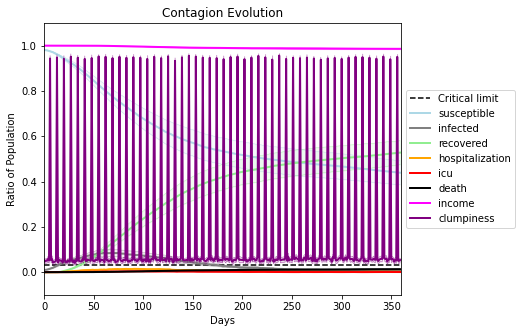

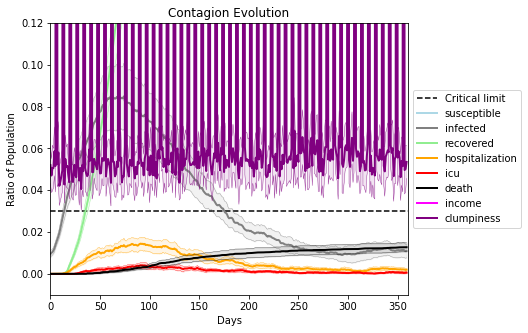

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1646, 6258, 4481, 3232, 7276, 3319, 9390, 8311, 5134, 8518, 4805, 9250, 3854, 6734, 4911, 7485, 4819, 7673, 1152, 6265]
Average similarity between family members is 0.9348973930954134 at temperature -0.994
Average similarity between family and home is 0.9998481584317899 at temperature -1
Average similarity between students and their classroom is 0.5786819457704072 at temperature -0.994
Average classroom occupancy is 4 and number classrooms is 69
Average similarity between workers is 0.8928388643104543 at temperature -0.994
Average office occupancy is 3.4659685863874348 and number offices is 191
Average friend similarity for adults: 0.8527276197502583 for kids: 0.6715207910832528
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.551858510862114
avg restaurant similarity 0.4507551803750906
avg restaurant similarity 0.5197617808571172
avg restaurant similarity 0.45942338462642873
avg restaurant similarity 0.33142664819110185
avg restaurant similarity 0.35331027849194624
avg restaurant similarity 0.5976559872920386
avg restaurant similarity 0.5297776103384078
avg restaurant similarity 0.32343042706921543
avg restaurant similarity 0.43600899023687595
avg restaurant similarity 0.5265786774791914
avg restaurant similarity 0.36287204566746006
avg restaurant similarity 0.6139199389852349
avg restaurant similarity 0.4582506663248716
avg restaurant similarity 0.6900363411738903
avg restaurant similarity 0.6147823394844015
avg restaurant similarity 0.5988725263007996
avg restaurant similarity 0.5211137664480774
avg restaurant similarity 0.5233707869126655
avg restaurant similarity 0.24987323757955276
avg restaurant similarity 0.5452255193045008
avg restaurant similarity 0.3966239057715247
avg 

avg restaurant similarity 0.4442949966141018
avg restaurant similarity 0.6400252764156724
avg restaurant similarity 0.39255475148373953
avg restaurant similarity 0.5728127696743638
avg restaurant similarity 0.4538589441760335
avg restaurant similarity 0.8786776056603924
avg restaurant similarity 0.44642339684048027
avg restaurant similarity 0.1468452585584906
avg restaurant similarity 0.48795463470526496
avg restaurant similarity 0.4924759764642429
avg restaurant similarity 0.3514258737092914
avg restaurant similarity 0.7170404651512754
avg restaurant similarity 0.20035835136323515
avg restaurant similarity 0.6926603855011052
avg restaurant similarity 0.5258871238953798
avg restaurant similarity 0.47083598586456604
avg restaurant similarity 0.7677736877241836
avg restaurant similarity 0.5419408988292338
avg restaurant similarity 0.5384179022014978
avg restaurant similarity 0.3877267912033367
avg restaurant similarity 0.4441499064497566
avg restaurant similarity 0.5856523016602665
avg r

avg restaurant similarity 0.43539101919909073
avg restaurant similarity 0.5819725922946601
avg restaurant similarity 0.5665573221601777
avg restaurant similarity 0.9334690183405764
avg restaurant similarity 0.5432827736754159
avg restaurant similarity 0.44604577734250866
avg restaurant similarity 0.6230572676024517
avg restaurant similarity 0.5860920212819805
avg restaurant similarity 0.6215805785033063
avg restaurant similarity 0.6789000705776924
avg restaurant similarity 0.6252417576466679
avg restaurant similarity 0.6880306527585697
avg restaurant similarity 0.4593647614351246
avg restaurant similarity 0.5324405720632607
avg restaurant similarity 0.42820117359770493
avg restaurant similarity 0.37358792714576106
avg restaurant similarity 0.9997317120481565
avg restaurant similarity 0.5801696114628871
avg restaurant similarity 0.5486721826701163
avg restaurant similarity 0.5119517194919478
avg restaurant similarity 0.7130433485681288
avg restaurant similarity 0.644491181190226
avg res

avg restaurant similarity 0.8394894699567131
avg restaurant similarity 0.5739153558532507
avg restaurant similarity 0.7188425753988036
avg restaurant similarity 0.5344254883291151
avg restaurant similarity 0.42563535270490627
avg restaurant similarity 0.5571814406291687
avg restaurant similarity 0.49812364233079937
avg restaurant similarity 0.5143967184245006
avg restaurant similarity 0.7081205937256594
avg restaurant similarity 0.76211275767345
avg restaurant similarity 0.5918129210633255
avg restaurant similarity 0.4241945477118203
avg restaurant similarity 0.40449784231971336
avg restaurant similarity 0.6289549149545468
avg restaurant similarity 0.5594468965320615
avg restaurant similarity 0.6626871638313244
avg restaurant similarity 0.6762612023026596
avg restaurant similarity 0.6653168329534921
avg restaurant similarity 0.5796180243805034
avg restaurant similarity 0.8236968981377293
avg restaurant similarity 0.6027202746708437
avg restaurant similarity 0.5541886938455142
avg resta

avg restaurant similarity 0.5736050346648909
avg restaurant similarity 0.6298782257861969
avg restaurant similarity 0.728022841869537
avg restaurant similarity 0.6430311155335601
avg restaurant similarity 0.7487315559561631
avg restaurant similarity 0.5691328525487342
avg restaurant similarity 0.6715601451921838
avg restaurant similarity 0.5364461780569929
avg restaurant similarity 0.565155643165543
avg restaurant similarity 0.711649821838543
avg restaurant similarity 0.40162216632849707
avg restaurant similarity 0.6266057538031188
avg restaurant similarity 0.6407807555477647
avg restaurant similarity 0.48368211216972
avg restaurant similarity 0.9996931491867663
avg restaurant similarity 0.7010512885184081
avg restaurant similarity 0.5170298288918979
avg restaurant similarity 0.6027284110719509
avg restaurant similarity 0.6369894962834539
avg restaurant similarity 0.5163733550999146
avg restaurant similarity 0.5934590670412967
avg restaurant similarity 0.4780736681079989
avg restaurant

avg restaurant similarity 0.5619089650863398
avg restaurant similarity 0.7010986869641221
avg restaurant similarity 0.5235860202019618
avg restaurant similarity 0.6543078183549033
avg restaurant similarity 0.7561014909732501
avg restaurant similarity 0.6788039023030138
avg restaurant similarity 0.6115065723347602
avg restaurant similarity 0.5073441951235812
avg restaurant similarity 0.8305595764670983
avg restaurant similarity 0.6246958381509662
avg restaurant similarity 0.7582994775782854
avg restaurant similarity 0.5490912410712363
avg restaurant similarity 0.5570085166300439
avg restaurant similarity 0.7216753744128339
avg restaurant similarity 0.8442658772031457
avg restaurant similarity 0.5610929716919217
avg restaurant similarity 0.6563279547790338
avg restaurant similarity 0.46501013895060855
avg restaurant similarity 0.7257805280594393
avg restaurant similarity 0.5594883512939144
avg restaurant similarity 0.5923644575737758
avg restaurant similarity 0.549474095000037
avg restau

avg restaurant similarity 0.44795540935134115
avg restaurant similarity 0.6137181072720242
avg restaurant similarity 0.5826879310745672
avg restaurant similarity 0.726463042813507
avg restaurant similarity 0.5516168722188853
avg restaurant similarity 0.6674371449679916
avg restaurant similarity 0.6720153251097989
avg restaurant similarity 0.5112801162197188
avg restaurant similarity 0.6508744339949244
avg restaurant similarity 0.42455627958622716
avg restaurant similarity 0.4639983469043956
avg restaurant similarity 0.6990248421299623
avg restaurant similarity 0.6200790882676371
avg restaurant similarity 0.833067369023142
avg restaurant similarity 0.7000662717849891
avg restaurant similarity 0.36703768543213316
avg restaurant similarity 0.6944477031535741
avg restaurant similarity 0.6159724156768781
avg restaurant similarity 0.46637276293049207
avg restaurant similarity 0.7049976063476934
avg restaurant similarity 0.5785287877411338
avg restaurant similarity 0.5626129950426578
avg rest

avg restaurant similarity 0.582544574513949
avg restaurant similarity 0.5628552067021417
avg restaurant similarity 0.5299443043326524
avg restaurant similarity 0.7053200878823398
avg restaurant similarity 0.4555768682240188
avg restaurant similarity 0.688128960963663
avg restaurant similarity 0.6184938151531916
avg restaurant similarity 0.5621570983173629
avg restaurant similarity 0.9999618091040947
avg restaurant similarity 0.9993998085670291
avg restaurant similarity 0.5942129781532329
avg restaurant similarity 0.517962558396436
avg restaurant similarity 0.999706278276151
avg restaurant similarity 0.6601505607865154
avg restaurant similarity 0.5288866986644748
avg restaurant similarity 0.7150058382240917
avg restaurant similarity 0.5090141300469082
avg restaurant similarity 0.5947561997427923
avg restaurant similarity 0.9997801210713277
avg restaurant similarity 0.5538530964964332
avg restaurant similarity 0.5972766639406666
avg restaurant similarity 0.7109188698784028
avg restaurant

avg restaurant similarity 0.5091491169279274
avg restaurant similarity 0.5714984352780205
avg restaurant similarity 0.4783618958983907
avg restaurant similarity 0.6158208855697282
avg restaurant similarity 0.5335011113652758
avg restaurant similarity 0.43516835107476026
avg restaurant similarity 0.6533007048530023
avg restaurant similarity 0.49378401156512236
avg restaurant similarity 0.5393771711765222
avg restaurant similarity 0.562999134806418
avg restaurant similarity 0.6635146050121541
avg restaurant similarity 0.5355630505345518
avg restaurant similarity 0.596374304749896
avg restaurant similarity 0.6395984989940958
avg restaurant similarity 0.5440131534949575
avg restaurant similarity 0.6919373816096358
avg restaurant similarity 0.5645316680232074
avg restaurant similarity 0.5259855242817133
avg restaurant similarity 0.5683430934012885
avg restaurant similarity 0.5593061606179517
avg restaurant similarity 0.5986154234481889
avg restaurant similarity 0.6187302213164234
avg restau

avg restaurant similarity 0.601612944771109
avg restaurant similarity 0.6247573954758108
avg restaurant similarity 0.6339601533554943
avg restaurant similarity 0.5763831616730724
avg restaurant similarity 0.4494726905460039
avg restaurant similarity 0.5514440850807056
avg restaurant similarity 0.5408929958694025
avg restaurant similarity 0.5106938751515926
avg restaurant similarity 0.5556761075139155
avg restaurant similarity 0.5813644286156883
avg restaurant similarity 0.5649076606836297
avg restaurant similarity 0.7117976711903585
avg restaurant similarity 0.5255343913784869
avg restaurant similarity 0.5134221475117675
avg restaurant similarity 0.42999847406479497
avg restaurant similarity 0.6220170247330684
avg restaurant similarity 0.5598357252458144
avg restaurant similarity 0.4702590747215544
avg restaurant similarity 0.683921892756171
avg restaurant similarity 0.520643577407772
avg restaurant similarity 0.5701327649051959
avg restaurant similarity 0.546860159348287
avg restauran

avg restaurant similarity 0.6332087256617773
avg restaurant similarity 0.4887325746799767
avg restaurant similarity 0.6324535761248259
avg restaurant similarity 0.5405733802353395
avg restaurant similarity 0.5678654926425424
avg restaurant similarity 0.664019366013348
avg restaurant similarity 0.5321018444843444
avg restaurant similarity 0.6306103493446926
avg restaurant similarity 0.5752815230734829
avg restaurant similarity 0.6436691833323794
avg restaurant similarity 0.49415420457259174
avg restaurant similarity 0.68197060344513
avg restaurant similarity 0.5126217642466543
avg restaurant similarity 0.5314485809923211
avg restaurant similarity 0.7797608665407841
avg restaurant similarity 0.5699597306588426
avg restaurant similarity 0.7076966934194345
avg restaurant similarity 0.37921031379193737
avg restaurant similarity 0.6124430923323209
avg restaurant similarity 0.48318347362839165
avg restaurant similarity 0.34194211857859425
avg restaurant similarity 0.6278237323964881
avg resta

avg restaurant similarity 0.7349715978445122
avg restaurant similarity 0.6937491244784406
avg restaurant similarity 0.5268403624692105
avg restaurant similarity 0.6367587494755971
avg restaurant similarity 0.38574152290939906
avg restaurant similarity 0.5234176098700267
avg restaurant similarity 0.5909309062499001
avg restaurant similarity 0.5251081547442223
avg restaurant similarity 0.5550348843341429
avg restaurant similarity 0.5751814707514258
avg restaurant similarity 0.5758549211610882
avg restaurant similarity 0.5102281138149227
avg restaurant similarity 0.5997371167917538
avg restaurant similarity 0.6166148977699148
avg restaurant similarity 0.6007941814890844
avg restaurant similarity 0.533358244105164
avg restaurant similarity 0.5619113673471137
avg restaurant similarity 0.503219666985134
avg restaurant similarity 0.6386271113143462
avg restaurant similarity 0.494417714307237
avg restaurant similarity 0.6209358544114296
avg restaurant similarity 0.6851182876012388
avg restaura

avg restaurant similarity 0.6317866092523146
avg restaurant similarity 0.5778822215247186
avg restaurant similarity 0.5619458182520847
avg restaurant similarity 0.654407071028946
avg restaurant similarity 0.5331818388061814
avg restaurant similarity 0.6355061580508392
avg restaurant similarity 0.6465609529070483
avg restaurant similarity 0.5227867989601738
avg restaurant similarity 0.6868206322050904
avg restaurant similarity 0.489243190084999
avg restaurant similarity 0.5772596997846403
avg restaurant similarity 0.6553102515028536
avg restaurant similarity 0.46793554915454016
avg restaurant similarity 0.4730890045990429
avg restaurant similarity 0.6449306840527866
avg restaurant similarity 0.5287522998769174
avg restaurant similarity 0.7331463619542244
avg restaurant similarity 0.4673251336724462
avg restaurant similarity 0.5443723521106882
avg restaurant similarity 0.6156818117993055
avg restaurant similarity 0.4149521089816591
avg restaurant similarity 0.5288662004162343
avg restaur

avg restaurant similarity 0.4873907153023233
avg restaurant similarity 0.4817213333114456
avg restaurant similarity 0.5487018124707437
avg restaurant similarity 0.5986315484374879
avg restaurant similarity 0.6786577475376344
avg restaurant similarity 0.6868491283490206
avg restaurant similarity 0.7337157481664205
avg restaurant similarity 0.8921222943137473
avg restaurant similarity 0.7759678936883581
avg restaurant similarity 0.5956327549586291
avg restaurant similarity 0.5989952567671085
avg restaurant similarity 0.5889575066346779
avg restaurant similarity 0.47245549024116074
avg restaurant similarity 0.6431652424479757
avg restaurant similarity 0.6488034600218909
avg restaurant similarity 0.3894837509357929
avg restaurant similarity 0.7436443761915524
avg restaurant similarity 0.3433400475195487
avg restaurant similarity 0.665629028157183
avg restaurant similarity 0.9996006777512461
avg restaurant similarity 0.8366066197101165
avg restaurant similarity 0.7250596135064034
avg restau

avg restaurant similarity 0.3637106626504996
avg restaurant similarity 0.7707020847130689
avg restaurant similarity 0.6733034030803404
avg restaurant similarity 0.6171768425619093
avg restaurant similarity 0.6081639521936827
avg restaurant similarity 0.6864369004493723
avg restaurant similarity 0.771546471839565
avg restaurant similarity 0.6716804926326745
avg restaurant similarity 0.6505780711791763
avg restaurant similarity 0.6581582348286866
avg restaurant similarity 0.5650835614294754
avg restaurant similarity 0.6789057122601079
avg restaurant similarity 0.5550026467980946
avg restaurant similarity 0.6151048569380443
avg restaurant similarity 0.6685552837756131
avg restaurant similarity 0.6156128906399325
avg restaurant similarity 0.6174629573738252
avg restaurant similarity 0.749047067562839
avg restaurant similarity 0.6448424568552248
avg restaurant similarity 0.660552238170778
avg restaurant similarity 0.6527452148818917
avg restaurant similarity 0.5489784323777763
avg restauran

avg restaurant similarity 0.6255592314924466
avg restaurant similarity 0.6964579855748163
avg restaurant similarity 0.3880143636765334
avg restaurant similarity 0.793810797428821
avg restaurant similarity 0.43275181806202295
avg restaurant similarity 0.719847601249422
avg restaurant similarity 0.6706077773019921
avg restaurant similarity 0.6588450877424611
avg restaurant similarity 0.7342687696839865
avg restaurant similarity 0.5182939130733935
avg restaurant similarity 0.522549602420092
avg restaurant similarity 0.7011896865213642
avg restaurant similarity 0.5999020540650272
avg restaurant similarity 0.5198396578345091
avg restaurant similarity 0.600362305656008
avg restaurant similarity 0.5564923412211672
avg restaurant similarity 0.699123751505251
avg restaurant similarity 0.6786810010763291
avg restaurant similarity 0.5630817427758433
avg restaurant similarity 0.6392430825400278
avg restaurant similarity 0.6043836833584343
avg restaurant similarity 0.6028869320260649
avg restaurant

avg restaurant similarity 0.6598724329773408
avg restaurant similarity 0.5318775475427856
avg restaurant similarity 0.6337219490340251
avg restaurant similarity 0.5379763679980976
avg restaurant similarity 0.42721207254017224
avg restaurant similarity 0.4717082996158723
avg restaurant similarity 0.32791258770078
avg restaurant similarity 0.6091278501315897
avg restaurant similarity 0.4663020493412431
avg restaurant similarity 0.5845657905519223
avg restaurant similarity 0.637210862652278
avg restaurant similarity 0.42734408287343895
avg restaurant similarity 0.6201640825559489
avg restaurant similarity 0.5733123110513062
avg restaurant similarity 0.64800498666952
avg restaurant similarity 0.5445529157786166
avg restaurant similarity 0.6501146913762803
avg restaurant similarity 0.7909014979465498
avg restaurant similarity 0.4837995677994671
avg restaurant similarity 0.4773665874156938
avg restaurant similarity 0.27547489406597464
avg restaurant similarity 0.40557000937033627
avg restaur

avg restaurant similarity 0.5488738403833034
avg restaurant similarity 0.6010132703661112
avg restaurant similarity 0.6140212938818995
avg restaurant similarity 0.5153037664312743
avg restaurant similarity 0.7895132830950592
avg restaurant similarity 0.3129594874553208
avg restaurant similarity 0.42990506555231295
avg restaurant similarity 0.5507755725591025
avg restaurant similarity 0.6449690138188013
avg restaurant similarity 0.5353160191038758
avg restaurant similarity 0.6302941859708343
avg restaurant similarity 0.5764505917539448
avg restaurant similarity 0.5005731172229072
avg restaurant similarity 0.5017302233371383
avg restaurant similarity 0.4318605221783076
avg restaurant similarity 0.5930491367738752
avg restaurant similarity 0.534111341761847
avg restaurant similarity 0.5640756705569342
avg restaurant similarity 0.4090783706845551
avg restaurant similarity 0.45387476592322984
avg restaurant similarity 0.6742355011645511
avg restaurant similarity 0.5308578227309444
avg resta

avg restaurant similarity 0.8212323398069807
avg restaurant similarity 0.6369563925760181
avg restaurant similarity 0.4401740635038614
avg restaurant similarity 0.4047823593422198
avg restaurant similarity 0.6455827297420956
avg restaurant similarity 0.35913852103152666
avg restaurant similarity 0.3348718448717951
avg restaurant similarity 0.6945463259987145
avg restaurant similarity 0.6892673575365824
avg restaurant similarity 0.5039147685611445
avg restaurant similarity 0.406775998885333
avg restaurant similarity 0.8046279410989003
avg restaurant similarity 0.3981699053608129
avg restaurant similarity 0.4619079603238524
avg restaurant similarity 0.6039218000880154
avg restaurant similarity 0.7654575545876783
avg restaurant similarity 0.5816462963263984
avg restaurant similarity 0.5195300922266619
avg restaurant similarity 0.455748441564908
avg restaurant similarity 0.6179940469305155
avg restaurant similarity 0.545055283028208
avg restaurant similarity 0.6662042925699816
avg restaura

avg restaurant similarity 0.413088086287622
avg restaurant similarity 0.507602250688822
avg restaurant similarity 0.5113419641458966
avg restaurant similarity 0.49311265335331256
avg restaurant similarity 0.612105749039223
avg restaurant similarity 0.3805810686158075
avg restaurant similarity 0.6149228970167694
avg restaurant similarity 0.7151057740748165
avg restaurant similarity 0.41918506676150474
avg restaurant similarity 0.3713079088661853
avg restaurant similarity 0.2880033269090305
avg restaurant similarity 0.4655795562364757
avg restaurant similarity 0.770264717221001
avg restaurant similarity 0.49992308518460177
avg restaurant similarity 0.6178088727202039
avg restaurant similarity 0.6461489216658648
avg restaurant similarity 0.6512890168256045
avg restaurant similarity 0.5864730444957913
avg restaurant similarity 0.5353168243016264
avg restaurant similarity 0.7220387189975691
avg restaurant similarity 0.7828649996125823
avg restaurant similarity 0.6687719719273167
avg restaur

avg restaurant similarity 0.48286541995398746
avg restaurant similarity 0.6484215087845715
avg restaurant similarity 0.398924582728552
avg restaurant similarity 0.487221995800866
avg restaurant similarity 0.4202972351550327
avg restaurant similarity 0.4020066350312667
avg restaurant similarity 0.6174223777280341
avg restaurant similarity 0.575297706927195
avg restaurant similarity 0.8255488315434522
avg restaurant similarity 0.7011355885597904
avg restaurant similarity 0.5239554861607493
avg restaurant similarity 0.9996574348116575
avg restaurant similarity 0.3349827609430484
avg restaurant similarity 0.6724031413154744
avg restaurant similarity 0.5782283019874009
avg restaurant similarity 0.5430880060243454
avg restaurant similarity 0.700617844057779
avg restaurant similarity 0.3605092463872588
avg restaurant similarity 0.6378190552116504
avg restaurant similarity 0.4547713740851537
avg restaurant similarity 0.5524369477612076
avg restaurant similarity 0.44233616219569155
avg restaura

avg restaurant similarity 0.5172591976166238
avg restaurant similarity 0.48591544319968694
avg restaurant similarity 0.5738380386055731
avg restaurant similarity 0.38042671525386185
avg restaurant similarity 0.4978141517498929
avg restaurant similarity 0.5964834558167541
avg restaurant similarity 0.9998526800621315
avg restaurant similarity 0.661611663979185
avg restaurant similarity 0.3761980982334976
avg restaurant similarity 0.6162024376247204
avg restaurant similarity 0.5468891870943615
avg restaurant similarity 0.5768084928601473
avg restaurant similarity 0.4621081618444271
avg restaurant similarity 0.5686396679238878
avg restaurant similarity 0.5772464624358614
avg restaurant similarity 0.5959405064870118
avg restaurant similarity 0.36951907645238574
avg restaurant similarity 0.4712941573969676
avg restaurant similarity 0.46674367096390934
avg restaurant similarity 0.46848678487248535
avg restaurant similarity 0.8309897542315273
avg restaurant similarity 0.3967230512228279
avg re

avg restaurant similarity 0.4576461406994912
avg restaurant similarity 0.707140515284293
avg restaurant similarity 0.7209989813255278
avg restaurant similarity 0.6137850662332532
avg restaurant similarity 0.44491503529108667
avg restaurant similarity 0.6712011208670337
avg restaurant similarity 0.5819212876922621
avg restaurant similarity 0.6417385067190747
avg restaurant similarity 0.6393608201076665
avg restaurant similarity 0.5456978733582943
avg restaurant similarity 0.4211263592697366
avg restaurant similarity 0.5644212157684881
avg restaurant similarity 0.7657952277812312
avg restaurant similarity 0.6065347554236699
avg restaurant similarity 0.48063428173867206
avg restaurant similarity 0.4888567537823049
avg restaurant similarity 0.5849168003402192
avg restaurant similarity 0.567112702557045
avg restaurant similarity 0.7593994224326858
avg restaurant similarity 0.825313664989188
avg restaurant similarity 0.8272382515185736
avg restaurant similarity 0.6891374307490352
avg restaur

avg restaurant similarity 0.5539228827767113
avg restaurant similarity 0.6470672108645021
avg restaurant similarity 0.715155474444576
avg restaurant similarity 0.5823106205328396
avg restaurant similarity 0.705926875146685
avg restaurant similarity 0.5498427670640926
avg restaurant similarity 0.6404854257724895
avg restaurant similarity 0.7872341004319239
avg restaurant similarity 0.5035612437424587
avg restaurant similarity 0.623831537390688
avg restaurant similarity 0.6325655269885412
avg restaurant similarity 0.6035700010099682
avg restaurant similarity 0.6977105882350733
avg restaurant similarity 0.7070027339471563
avg restaurant similarity 0.5856853876346487
avg restaurant similarity 0.6611567347289591
avg restaurant similarity 0.539754253878209
avg restaurant similarity 0.8311556937944998
avg restaurant similarity 0.681040904126678
avg restaurant similarity 0.5887575220808989
avg restaurant similarity 0.5866929349678868
avg restaurant similarity 0.6750467232924876
avg restaurant 

avg restaurant similarity 0.5963380625872573
avg restaurant similarity 0.563623681562089
avg restaurant similarity 0.4424620495781894
avg restaurant similarity 0.5357097413266545
avg restaurant similarity 0.40296170384944857
avg restaurant similarity 0.36501386466143276
avg restaurant similarity 0.5663489286725718
avg restaurant similarity 0.5832430040673119
avg restaurant similarity 0.5033072524253528
avg restaurant similarity 0.399082103421904
avg restaurant similarity 0.47911359428130496
avg restaurant similarity 0.538206576150697
avg restaurant similarity 0.5498193404047452
avg restaurant similarity 0.4543156321580024
avg restaurant similarity 0.5863162631438203
avg restaurant similarity 0.8977579856992416
avg restaurant similarity 0.48879078767199696
avg restaurant similarity 0.5146672485498285
avg restaurant similarity 0.4484595423320496
avg restaurant similarity 0.4652751921400107
avg restaurant similarity 0.4322323154172555
avg restaurant similarity 0.5038495922274204
avg resta

avg restaurant similarity 0.613858742649996
avg restaurant similarity 0.34716748220269467
avg restaurant similarity 0.5229170553336253
avg restaurant similarity 0.5254486567889763
avg restaurant similarity 0.465461788354897
avg restaurant similarity 0.4234467009103873
avg restaurant similarity 0.49917054206882966
avg restaurant similarity 0.3787477807592139
avg restaurant similarity 0.5467588990430678
avg restaurant similarity 0.5493223565130326
avg restaurant similarity 0.6050832971722001
avg restaurant similarity 0.5218435820696129
avg restaurant similarity 0.5526273423220127
avg restaurant similarity 0.6852697308807847
avg restaurant similarity 0.5018230206839166
avg restaurant similarity 0.47819144540863195
avg restaurant similarity 0.5315756335096568
avg restaurant similarity 0.4416027298006367
avg restaurant similarity 0.3200967873902471
avg restaurant similarity 0.6464677939917735
avg restaurant similarity 0.43048681103827097
avg restaurant similarity 0.5645145108686785
avg rest

avg restaurant similarity 0.6846908203598461
avg restaurant similarity 0.6350896413142152
avg restaurant similarity 0.7247300328046088
avg restaurant similarity 0.7339332465068555
avg restaurant similarity 0.46710369850347205
avg restaurant similarity 0.5131077657305426
avg restaurant similarity 0.6565676855189881
avg restaurant similarity 0.6155487896416377
avg restaurant similarity 0.430248408882822
avg restaurant similarity 0.32577948716909666
avg restaurant similarity 0.6732953396464638
avg restaurant similarity 0.42858239509507556
avg restaurant similarity 0.4726348868152501
avg restaurant similarity 0.6142198261687288
avg restaurant similarity 0.7979234040687297
avg restaurant similarity 0.724286148490532
avg restaurant similarity 0.5020494507431777
avg restaurant similarity 0.7924730858930684
avg restaurant similarity 0.5348579230480452
avg restaurant similarity 0.6434691540216195
avg restaurant similarity 0.6059830480281068
avg restaurant similarity 0.6731460330241792
avg resta

avg restaurant similarity 0.625312014839556
avg restaurant similarity 0.6840510735941555
avg restaurant similarity 0.43755309343521365
avg restaurant similarity 0.6032171878358623
avg restaurant similarity 0.7339297012701296
avg restaurant similarity 0.5759645867087526
avg restaurant similarity 0.6542064053637568
avg restaurant similarity 0.746652946396873
avg restaurant similarity 0.6916753085987658
avg restaurant similarity 0.6685082926986158
avg restaurant similarity 0.4724832655308941
avg restaurant similarity 0.5261305144409467
avg restaurant similarity 0.6688185892700718
avg restaurant similarity 0.7753824537010896
avg restaurant similarity 0.583780143593789
avg restaurant similarity 0.5604756017532867
avg restaurant similarity 0.5661536770807604
avg restaurant similarity 0.7465221965670159
avg restaurant similarity 0.45375104335440997
avg restaurant similarity 0.4273347223602134
avg restaurant similarity 0.62377150300181
avg restaurant similarity 0.4581252814733932
avg restauran

avg restaurant similarity 0.633517317658159
avg restaurant similarity 0.5674497854901743
avg restaurant similarity 0.6498245063025595
avg restaurant similarity 0.5723511584045008
avg restaurant similarity 0.7405821275763932
avg restaurant similarity 0.5057938815581555
avg restaurant similarity 0.5641782210989965
avg restaurant similarity 0.4741309619072061
avg restaurant similarity 0.6620544162677985
avg restaurant similarity 0.5800657984618067
avg restaurant similarity 0.617851299342397
avg restaurant similarity 0.46410752297819585
avg restaurant similarity 0.3994455036829916
avg restaurant similarity 0.908462032069989
avg restaurant similarity 0.6866980772783156
avg restaurant similarity 0.6055318542435171
avg restaurant similarity 0.6550960849897176
avg restaurant similarity 0.4297356353501833
avg restaurant similarity 0.5375415476333113
avg restaurant similarity 0.5856123029431186
avg restaurant similarity 0.4216937128975414
avg restaurant similarity 0.5443918534580647
avg restaura

avg restaurant similarity 0.5405486411795452
avg restaurant similarity 0.6970778170246177
avg restaurant similarity 0.601644460293779
avg restaurant similarity 0.5308053365923812
avg restaurant similarity 0.7380729473268034
avg restaurant similarity 0.5309661487899056
avg restaurant similarity 0.5465928092627674
avg restaurant similarity 0.4572972167999531
avg restaurant similarity 0.518756228833259
avg restaurant similarity 0.7173834173027872
avg restaurant similarity 0.46193154809770637
avg restaurant similarity 0.4221570566783937
avg restaurant similarity 0.7128199028452563
avg restaurant similarity 0.6940343894580341
avg restaurant similarity 0.6223502083231706
avg restaurant similarity 0.5440990962130294
avg restaurant similarity 0.7066158352920424
avg restaurant similarity 0.682187859988854
avg restaurant similarity 0.6337158288834209
avg restaurant similarity 0.6156436363549571
avg restaurant similarity 0.5693028973401917
avg restaurant similarity 0.4828323389843554
avg restaura

avg restaurant similarity 0.5355127988667037
avg restaurant similarity 0.7700206849413206
avg restaurant similarity 0.5915036577448414
avg restaurant similarity 0.360719618233181
avg restaurant similarity 0.48106177347735546
avg restaurant similarity 0.34218740254606067
avg restaurant similarity 0.6560110494556514
avg restaurant similarity 0.8132524993031652
avg restaurant similarity 0.6812814870635205
avg restaurant similarity 0.4331657056052591
avg restaurant similarity 0.5702463524903217
avg restaurant similarity 0.5676384756911246
avg restaurant similarity 0.5030264644958898
avg restaurant similarity 0.5194779439577274
avg restaurant similarity 0.6583950327664988
avg restaurant similarity 0.49526418514681564
avg restaurant similarity 0.47551309936896524
avg restaurant similarity 0.551121850462633
avg restaurant similarity 0.46205750842169685
avg restaurant similarity 0.5620222857412221
avg restaurant similarity 0.41083438375990594
avg restaurant similarity 0.558164325781127
avg res

avg restaurant similarity 0.6340512130599862
avg restaurant similarity 0.45594414294638724
avg restaurant similarity 0.5596134246360005
avg restaurant similarity 0.568352399665201
avg restaurant similarity 0.3934146522356731
avg restaurant similarity 0.5988741734436654
avg restaurant similarity 0.47866404461669243
avg restaurant similarity 0.48765652219043865
avg restaurant similarity 0.7177584584795734
avg restaurant similarity 0.345175207057246
avg restaurant similarity 0.2739335366960576
avg restaurant similarity 0.6982630810915462
avg restaurant similarity 0.4801866806898354
avg restaurant similarity 0.6889858907060242
avg restaurant similarity 0.6365003642260098
avg restaurant similarity 0.7171641845119067
avg restaurant similarity 0.3907703047701503
avg restaurant similarity 0.6952776304405641
avg restaurant similarity 0.45284382635227
avg restaurant similarity 0.7657515258102086
avg restaurant similarity 0.6384118371291625
avg restaurant similarity 0.5841320665564057
avg restaur

avg restaurant similarity 0.5254936752465241
avg restaurant similarity 0.5588308053264444
avg restaurant similarity 0.731700148981255
avg restaurant similarity 0.5755148916484902
avg restaurant similarity 0.5499991794377599
avg restaurant similarity 0.6888045205232604
avg restaurant similarity 0.29345493370476966
avg restaurant similarity 0.4721339260788211
avg restaurant similarity 0.6242667459113572
avg restaurant similarity 0.3474876822969593
avg restaurant similarity 0.8403475052612959
avg restaurant similarity 0.2706676842164159
avg restaurant similarity 0.5264812181511977
avg restaurant similarity 0.4514928868573649
avg restaurant similarity 0.4403283721469736
avg restaurant similarity 0.5314666558890954
avg restaurant similarity 0.541782083634997
avg restaurant similarity 0.5872028970842076
avg restaurant similarity 0.44256119124353605
avg restaurant similarity 0.5473249034140276
avg restaurant similarity 0.6308903157128963
avg restaurant similarity 0.766948003723779
avg restaur

avg restaurant similarity 0.4329678486863094
avg restaurant similarity 0.6451067657273281
avg restaurant similarity 0.7655401208367697
avg restaurant similarity 0.4988845678340252
avg restaurant similarity 0.589668511797785
avg restaurant similarity 0.6017056817971262
avg restaurant similarity 0.5591452821708964
avg restaurant similarity 0.6591777254498261
avg restaurant similarity 0.5912821239352556
avg restaurant similarity 0.6737947510451144
avg restaurant similarity 0.46166074148915875
avg restaurant similarity 0.5266023540697373
avg restaurant similarity 0.6439610161583601
avg restaurant similarity 0.5077806915488098
avg restaurant similarity 0.6338202693436884
avg restaurant similarity 0.4987568622765564
avg restaurant similarity 0.26168571598841944
avg restaurant similarity 0.4438961120945383
avg restaurant similarity 0.5178197860606059
avg restaurant similarity 0.4109928028362686
avg restaurant similarity 0.5221750300699897
avg restaurant similarity 0.6641297305655621
avg resta

avg restaurant similarity 0.5274813798620602
avg restaurant similarity 0.7291227201637789
avg restaurant similarity 0.5660596991817128
avg restaurant similarity 0.4172185108627308
avg restaurant similarity 0.5857427489420158
avg restaurant similarity 0.48701725437563104
avg restaurant similarity 0.6392702046880189
avg restaurant similarity 0.8137662165776924
avg restaurant similarity 0.5020606574637052
avg restaurant similarity 0.6010867695368454
avg restaurant similarity 0.677303367425545
avg restaurant similarity 0.5262643250346363
avg restaurant similarity 0.5457722969122515
avg restaurant similarity 0.6527832998039806
avg restaurant similarity 0.5322679586709061
avg restaurant similarity 0.539657877686365
avg restaurant similarity 0.6472488066180798
avg restaurant similarity 0.4126458381709991
avg restaurant similarity 0.474474433566668
avg restaurant similarity 0.6236959515031706
avg restaurant similarity 0.3743506422333178
avg restaurant similarity 0.7078047541573304
avg restaura

avg restaurant similarity 0.6516270268194995
avg restaurant similarity 0.5458571943617331
avg restaurant similarity 0.6197625669766662
avg restaurant similarity 0.6034108643472031
avg restaurant similarity 0.46851053646781105
avg restaurant similarity 0.5385853698298979
avg restaurant similarity 0.47754021043544204
avg restaurant similarity 0.4120286176408867
avg restaurant similarity 0.5936454486248741
avg restaurant similarity 0.6213265160550119
avg restaurant similarity 0.5348036560307806
avg restaurant similarity 0.6256591581536534
avg restaurant similarity 0.5578554377610581
avg restaurant similarity 0.4758984790294892
avg restaurant similarity 0.48030325251113803
avg restaurant similarity 0.663608477786786
avg restaurant similarity 0.654828573133483
avg restaurant similarity 0.4944414748994323
avg restaurant similarity 0.6463432377981138
avg restaurant similarity 0.5726273562111419
avg restaurant similarity 0.4979393664942019
avg restaurant similarity 0.6368834123080046
avg resta

avg restaurant similarity 0.4465902186575496
avg restaurant similarity 0.6268142789432356
avg restaurant similarity 0.6856056912924817
avg restaurant similarity 0.5862388735218059
avg restaurant similarity 0.7119580561029758
avg restaurant similarity 0.7390655374892414
avg restaurant similarity 0.9997277954599781
avg restaurant similarity 0.7065178585422534
avg restaurant similarity 0.5767505669526203
avg restaurant similarity 0.6140672750100238
avg restaurant similarity 0.3449286888429722
avg restaurant similarity 0.8011497044390313
avg restaurant similarity 0.6259424652058128
avg restaurant similarity 0.5823678183689032
avg restaurant similarity 0.8122818967754
avg restaurant similarity 0.5955306813058724
avg restaurant similarity 0.640251168323115
avg restaurant similarity 0.5760513766808729
avg restaurant similarity 0.49711608657726397
avg restaurant similarity 0.4389514923085849
avg restaurant similarity 0.6008650953659717
avg restaurant similarity 0.4760942216825986
avg restauran

avg restaurant similarity 0.7666183584541769
avg restaurant similarity 0.5604944089836689
avg restaurant similarity 0.665168948153259
avg restaurant similarity 0.4758687698313338
avg restaurant similarity 0.5270388109025808
avg restaurant similarity 0.6578659763899426
avg restaurant similarity 0.650825475773016
avg restaurant similarity 0.7448111150861297
avg restaurant similarity 0.6559377564695341
avg restaurant similarity 0.7598751918101634
avg restaurant similarity 0.6955456767260608
avg restaurant similarity 0.6200364050901352
avg restaurant similarity 0.5926320595971598
avg restaurant similarity 0.513610041435679
avg restaurant similarity 0.4932111924877979
avg restaurant similarity 0.6088433334854789
avg restaurant similarity 0.7620182347253445
avg restaurant similarity 0.39452482104131226
avg restaurant similarity 0.6767756360706638
avg restaurant similarity 0.5026284275433641
avg restaurant similarity 0.5063331794161278
avg restaurant similarity 0.4454740569837044
avg restaura

avg restaurant similarity 0.6393414792672631
avg restaurant similarity 0.7283009214481334
avg restaurant similarity 0.7514161223707061
avg restaurant similarity 0.5537622842207123
avg restaurant similarity 0.6005124013144184
avg restaurant similarity 0.5725313611186518
avg restaurant similarity 0.43652185940436483
avg restaurant similarity 0.49974441428507016
avg restaurant similarity 0.6626262431658143
avg restaurant similarity 0.6688822093697853
avg restaurant similarity 0.7751325846219244
avg restaurant similarity 0.7516453534327479
avg restaurant similarity 0.7858106547762281
avg restaurant similarity 0.6512361117848925
avg restaurant similarity 0.6632182452455864
avg restaurant similarity 0.7068827156716004
avg restaurant similarity 0.5437838456780212
avg restaurant similarity 0.6219791836037026
avg restaurant similarity 0.47035236818077153
avg restaurant similarity 0.3661635334213583
avg restaurant similarity 0.5154439147368317
avg restaurant similarity 0.5752854566505171
avg res

avg restaurant similarity 0.565318930618405
avg restaurant similarity 0.42162903782889605
avg restaurant similarity 0.5504297333943237
avg restaurant similarity 0.5490875706189405
avg restaurant similarity 0.6708459476010853
avg restaurant similarity 0.6755532459128687
avg restaurant similarity 0.5591199002380559
avg restaurant similarity 0.40074859349449654
avg restaurant similarity 0.47345325033724406
avg restaurant similarity 0.679052373430933
avg restaurant similarity 0.6579528129160422
avg restaurant similarity 0.5462271158328047
avg restaurant similarity 0.8169134824765095
avg restaurant similarity 0.5870938681874045
avg restaurant similarity 0.5679415937979808
avg restaurant similarity 0.5726013668033046
avg restaurant similarity 0.4491796694308644
avg restaurant similarity 0.6616961322377043
avg restaurant similarity 0.5804610112265919
avg restaurant similarity 0.44948503720897465
avg restaurant similarity 0.5252392144493532
avg restaurant similarity 0.3908551536528906
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

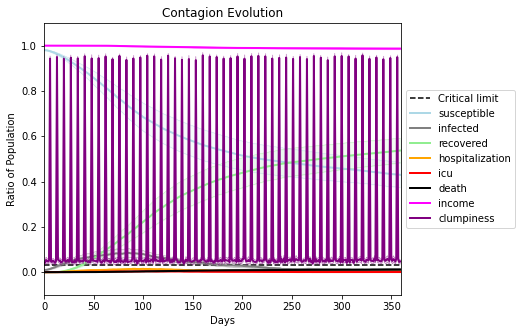

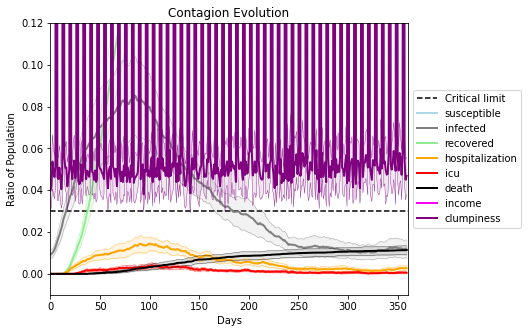

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6163, 6253, 2684, 7725, 1967, 6076, 1798, 4499, 6363, 7483, 1449, 4734, 7523, 8636, 6765, 5507, 9676, 291, 9632, 3057]
Average similarity between family members is 0.9304702449586146 at temperature -0.993
Average similarity between family and home is 0.9998568769373679 at temperature -1
Average similarity between students and their classroom is 0.5301897526684622 at temperature -0.993
Average classroom occupancy is 4.231884057971015 and number classrooms is 69
Average similarity between workers is 0.8738067676749314 at temperature -0.993
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.8503264239406323 for kids: 0.6597728018032458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.49663490151793416
avg restaurant similarity 0.538680065721473
avg restaurant similarity 0.49958616326293176
avg restaurant similarity 0.5660950931692219
avg restaurant similarity 0.5272787705172057
avg restaurant similarity 0.641202541931033
avg restaurant similarity 0.4259415291130204
avg restaurant similarity 0.565614036866542
avg restaurant similarity 0.4448686375188873
avg restaurant similarity 0.6083489075189936
avg restaurant similarity 0.8831227572934088
avg restaurant similarity 0.5837087944768539
avg restaurant similarity 0.5077903425534005
avg restaurant similarity 0.5826012005061957
avg restaurant similarity 0.7084141357953013
avg restaurant similarity 0.6368652643126467
avg restaurant similarity 0.5788035900727869
avg restaurant similarity 0.5842646291975151
avg restaurant similarity 0.5883122599102247
avg restaurant similarity 0.507635565600548
avg restaurant similarity 0.7738819830122569
avg restaurant similarity 0.6753706116448548
avg restaura

avg restaurant similarity 0.5619881960845058
avg restaurant similarity 0.4293387551034978
avg restaurant similarity 0.5683982257339051
avg restaurant similarity 0.6031767428096431
avg restaurant similarity 0.5769742906671639
avg restaurant similarity 0.6781403101811939
avg restaurant similarity 0.48336105281464975
avg restaurant similarity 0.43346239409329107
avg restaurant similarity 0.7430510062658454
avg restaurant similarity 0.5109532690330361
avg restaurant similarity 0.5897750701491344
avg restaurant similarity 0.6149457396418686
avg restaurant similarity 0.5081434459499854
avg restaurant similarity 0.7228000296550551
avg restaurant similarity 0.5683893475332155
avg restaurant similarity 0.7072362928130047
avg restaurant similarity 0.3504445850881669
avg restaurant similarity 0.6194088535660182
avg restaurant similarity 0.6034868338004349
avg restaurant similarity 0.48707126507365245
avg restaurant similarity 0.6227757837271093
avg restaurant similarity 0.4662255198140224
avg res

avg restaurant similarity 0.587515285415385
avg restaurant similarity 0.7518675671507707
avg restaurant similarity 0.5987312942532727
avg restaurant similarity 0.6657434454817469
avg restaurant similarity 0.532897755258732
avg restaurant similarity 0.7134345856217322
avg restaurant similarity 0.6611088831394493
avg restaurant similarity 0.45157901464838635
avg restaurant similarity 0.6152530616205182
avg restaurant similarity 0.4669058551472814
avg restaurant similarity 0.7331659368924109
avg restaurant similarity 0.6214557096889103
avg restaurant similarity 0.4828182739844078
avg restaurant similarity 0.6191528606925341
avg restaurant similarity 0.4992306951467197
avg restaurant similarity 0.6586335592563256
avg restaurant similarity 0.4889606439189833
avg restaurant similarity 0.6192834045806697
avg restaurant similarity 0.6047812202365331
avg restaurant similarity 0.2778841794015008
avg restaurant similarity 0.6727631296663528
avg restaurant similarity 0.6283248766714474
avg restaur

avg restaurant similarity 0.729694032076817
avg restaurant similarity 0.7144939666790326
avg restaurant similarity 0.5996426864367552
avg restaurant similarity 0.6001307645508396
avg restaurant similarity 0.7154244002618627
avg restaurant similarity 0.5789448518037287
avg restaurant similarity 0.5371724945403448
avg restaurant similarity 0.6394517080412712
avg restaurant similarity 0.5274840427314655
avg restaurant similarity 0.6052305597564813
avg restaurant similarity 0.6131836445186046
avg restaurant similarity 0.42617849780657874
avg restaurant similarity 0.6195550597556608
avg restaurant similarity 0.461721156124128
avg restaurant similarity 0.4148331224067273
avg restaurant similarity 0.7875864945009358
avg restaurant similarity 0.5799150434651251
avg restaurant similarity 0.7709775408998041
avg restaurant similarity 0.5128367133021209
avg restaurant similarity 0.6343874846675729
avg restaurant similarity 0.3369343630498811
avg restaurant similarity 0.529465359781091
avg restaura

avg restaurant similarity 0.5794040971481604
avg restaurant similarity 0.5184537307481567
avg restaurant similarity 0.42927761416556204
avg restaurant similarity 0.5054856507491113
avg restaurant similarity 0.46899454043296285
avg restaurant similarity 0.485038273795014
avg restaurant similarity 0.5552785318211135
avg restaurant similarity 0.5982051729085549
avg restaurant similarity 0.5334592449218832
avg restaurant similarity 0.51086650176283
avg restaurant similarity 0.6842060800536731
avg restaurant similarity 0.5999418252212938
avg restaurant similarity 0.4318629357123913
avg restaurant similarity 0.4775738361535351
avg restaurant similarity 0.5283587102725155
avg restaurant similarity 0.6873347534908768
avg restaurant similarity 0.5118778863909978
avg restaurant similarity 0.6830093321243729
avg restaurant similarity 0.5324210405407193
avg restaurant similarity 0.517355520056384
avg restaurant similarity 0.49328658706341644
avg restaurant similarity 0.6487310649855718
avg restaur

avg restaurant similarity 0.5895352264947277
avg restaurant similarity 0.5159554549664913
avg restaurant similarity 0.6225298784341173
avg restaurant similarity 0.4612588263961641
avg restaurant similarity 0.6246346948122322
avg restaurant similarity 0.631526191854267
avg restaurant similarity 0.490038486286238
avg restaurant similarity 0.5939256912275348
avg restaurant similarity 0.5533579792511034
avg restaurant similarity 0.5494065644839492
avg restaurant similarity 0.6530197203489405
avg restaurant similarity 0.5334184309318053
avg restaurant similarity 0.6231366340811446
avg restaurant similarity 0.6331585091873292
avg restaurant similarity 0.47792309006866396
avg restaurant similarity 0.46312385228272557
avg restaurant similarity 0.5884010683814993
avg restaurant similarity 0.6388934367629392
avg restaurant similarity 0.6716198217940114
avg restaurant similarity 0.42740795178440183
avg restaurant similarity 0.5399722582677021
avg restaurant similarity 0.6347921692287406
avg resta

avg restaurant similarity 0.6081339985378064
avg restaurant similarity 0.5252383543490116
avg restaurant similarity 0.6124010227449229
avg restaurant similarity 0.5763641265221199
avg restaurant similarity 0.41200909654674966
avg restaurant similarity 0.5721314183762227
avg restaurant similarity 0.6029319034884372
avg restaurant similarity 0.5369522189476831
avg restaurant similarity 0.5720223251565699
avg restaurant similarity 0.5529113450244821
avg restaurant similarity 0.9479722374727413
avg restaurant similarity 0.6357103658679544
avg restaurant similarity 0.6297509371325987
avg restaurant similarity 0.46340249392215405
avg restaurant similarity 0.9361833384901143
avg restaurant similarity 0.5053305468801153
avg restaurant similarity 0.6261712931899766
avg restaurant similarity 0.5293406680084736
avg restaurant similarity 0.3983713139191092
avg restaurant similarity 0.5749598820650681
avg restaurant similarity 0.595058698983283
avg restaurant similarity 0.5664499958480962
avg resta

avg restaurant similarity 0.6612518072988797
avg restaurant similarity 0.5393231316913132
avg restaurant similarity 0.6478109122438573
avg restaurant similarity 0.549737542070198
avg restaurant similarity 0.5961727562541209
avg restaurant similarity 0.6385481511356749
avg restaurant similarity 0.5930136598158066
avg restaurant similarity 0.47297192552653833
avg restaurant similarity 0.5351807515688729
avg restaurant similarity 0.7210157760927208
avg restaurant similarity 0.5235650763420127
avg restaurant similarity 0.6148811134564144
avg restaurant similarity 0.7472736443214613
avg restaurant similarity 0.5888490228827417
avg restaurant similarity 0.44984681894085804
avg restaurant similarity 0.5479085442357676
avg restaurant similarity 0.5837923047448492
avg restaurant similarity 0.6056400673219213
avg restaurant similarity 0.5929297714785255
avg restaurant similarity 0.6560234775307606
avg restaurant similarity 0.7236595924876066
avg restaurant similarity 0.47277227046399894
avg rest

avg restaurant similarity 0.5750281071484056
avg restaurant similarity 0.4670487615327408
avg restaurant similarity 0.48586354897107153
avg restaurant similarity 0.4825195150153159
avg restaurant similarity 0.6284114900231744
avg restaurant similarity 0.7122040543555663
avg restaurant similarity 0.4720130673628011
avg restaurant similarity 0.515827823595417
avg restaurant similarity 0.5929295085187352
avg restaurant similarity 0.39674622223324574
avg restaurant similarity 0.6732730627076644
avg restaurant similarity 0.5089636632573626
avg restaurant similarity 0.49822103320646416
avg restaurant similarity 0.42453827745612216
avg restaurant similarity 0.5342766302184235
avg restaurant similarity 0.58985802451547
avg restaurant similarity 0.766847953188491
avg restaurant similarity 0.4397905542169946
avg restaurant similarity 0.5223584542003323
avg restaurant similarity 0.6713326966572188
avg restaurant similarity 0.6708379399350131
avg restaurant similarity 0.4761275364901898
avg restau

avg restaurant similarity 0.40855087757857217
avg restaurant similarity 0.4129829714123738
avg restaurant similarity 0.7201919606064087
avg restaurant similarity 0.6771668478008589
avg restaurant similarity 0.6195530117081343
avg restaurant similarity 0.5218338219564974
avg restaurant similarity 0.40698740465312255
avg restaurant similarity 0.6309402001061606
avg restaurant similarity 0.5454419180503128
avg restaurant similarity 0.6971735060744068
avg restaurant similarity 0.6296606070081394
avg restaurant similarity 0.6104583605670433
avg restaurant similarity 0.36529731839132795
avg restaurant similarity 0.3390637531355864
avg restaurant similarity 0.5446816899192198
avg restaurant similarity 0.4738975969303186
avg restaurant similarity 0.48001161016810723
avg restaurant similarity 0.7050499308048144
avg restaurant similarity 0.5152718631045513
avg restaurant similarity 0.6114538919514063
avg restaurant similarity 0.4979111187074574
avg restaurant similarity 0.5711373724174207
avg re

avg restaurant similarity 0.5417506441324434
avg restaurant similarity 0.5591255273145953
avg restaurant similarity 0.6374045668256803
avg restaurant similarity 0.4748013640574186
avg restaurant similarity 0.5351464244441817
avg restaurant similarity 0.6998636352652066
avg restaurant similarity 0.46563806259988655
avg restaurant similarity 0.4321157240806477
avg restaurant similarity 0.42794885005490757
avg restaurant similarity 0.5440404523447888
avg restaurant similarity 0.6740702323889556
avg restaurant similarity 0.5571954451064021
avg restaurant similarity 0.6523466830584832
avg restaurant similarity 0.4311388539174988
avg restaurant similarity 0.7496879253184643
avg restaurant similarity 0.5447858939027301
avg restaurant similarity 0.5067047031459907
avg restaurant similarity 0.6227835984159548
avg restaurant similarity 0.6311769508007232
avg restaurant similarity 0.5329131533271292
avg restaurant similarity 0.5904455351370949
avg restaurant similarity 0.5290421736030235
avg rest

avg restaurant similarity 0.7037786491633727
avg restaurant similarity 0.510443585998193
avg restaurant similarity 0.5480979405576542
avg restaurant similarity 0.5250382709429592
avg restaurant similarity 0.5236850483554137
avg restaurant similarity 0.5821075042206528
avg restaurant similarity 0.4714738233559572
avg restaurant similarity 0.4865129633957681
avg restaurant similarity 0.2502388727115914
avg restaurant similarity 0.4540366485376063
avg restaurant similarity 0.4591741483610908
avg restaurant similarity 0.4229624397865566
avg restaurant similarity 0.6693026003998621
avg restaurant similarity 0.3638675421240518
avg restaurant similarity 0.40134779340279003
avg restaurant similarity 0.4467349585392805
avg restaurant similarity 0.5887546821307604
avg restaurant similarity 0.7984700265586079
avg restaurant similarity 0.5522849354113373
avg restaurant similarity 0.41797771498556946
avg restaurant similarity 0.39874479064955326
avg restaurant similarity 0.6289354474365539
avg rest

avg restaurant similarity 0.49773064474558987
avg restaurant similarity 0.5645349400970662
avg restaurant similarity 0.6819541320281812
avg restaurant similarity 0.5249885385578021
avg restaurant similarity 0.4307001098356604
avg restaurant similarity 0.7541457169986259
avg restaurant similarity 0.5036674141715072
avg restaurant similarity 0.41867855023569206
avg restaurant similarity 0.6089365330181457
avg restaurant similarity 0.7716601379980257
avg restaurant similarity 0.6807136638800136
avg restaurant similarity 0.6060305538893757
avg restaurant similarity 0.5614992482724097
avg restaurant similarity 0.6660532601536159
avg restaurant similarity 0.4796966760061355
avg restaurant similarity 0.5838817935727143
avg restaurant similarity 0.6109573856831102
avg restaurant similarity 0.7732524721394995
avg restaurant similarity 0.5866847633048455
avg restaurant similarity 0.472316540080366
avg restaurant similarity 0.538595814166494
avg restaurant similarity 0.6398993548435882
avg restau

avg restaurant similarity 0.5914540001148962
avg restaurant similarity 0.5032522826715086
avg restaurant similarity 0.518206756376957
avg restaurant similarity 0.5513178138426251
avg restaurant similarity 0.6178666197217852
avg restaurant similarity 0.5485958138661707
avg restaurant similarity 0.425178047339751
avg restaurant similarity 0.5288166224826089
avg restaurant similarity 0.6179736878626421
avg restaurant similarity 0.6690958188870844
avg restaurant similarity 0.560145277713221
avg restaurant similarity 0.4492536130921255
avg restaurant similarity 0.7138445679494339
avg restaurant similarity 0.7456194048804119
avg restaurant similarity 0.5009217765805534
avg restaurant similarity 0.6069213226008748
avg restaurant similarity 0.5607671582232072
avg restaurant similarity 0.7735192647984979
avg restaurant similarity 0.4989322893571149
avg restaurant similarity 0.47005730144936425
avg restaurant similarity 0.6193184924992741
avg restaurant similarity 0.5177781145052064
avg restaura

avg restaurant similarity 0.6504385267195849
avg restaurant similarity 0.5229304607567857
avg restaurant similarity 0.5055812595859552
avg restaurant similarity 0.7060812353517498
avg restaurant similarity 0.6089009640951868
avg restaurant similarity 0.6001307860025582
avg restaurant similarity 0.5728776526350375
avg restaurant similarity 0.6467320384566263
avg restaurant similarity 0.5872848771778201
avg restaurant similarity 0.5495376559695861
avg restaurant similarity 0.5405706824226404
avg restaurant similarity 0.5419191775844515
avg restaurant similarity 0.5786536034215204
avg restaurant similarity 0.4173700714378152
avg restaurant similarity 0.6902700574456035
avg restaurant similarity 0.5993165942746085
avg restaurant similarity 0.6873651998958147
avg restaurant similarity 0.5993348398513486
avg restaurant similarity 0.5391806816981135
avg restaurant similarity 0.5164884114295366
avg restaurant similarity 0.6016716524749954
avg restaurant similarity 0.7953176812345638
avg restau

avg restaurant similarity 0.5241461080517436
avg restaurant similarity 0.39577725950003056
avg restaurant similarity 0.6510450767239959
avg restaurant similarity 0.5629473881434718
avg restaurant similarity 0.6023689079418612
avg restaurant similarity 0.5773608424301155
avg restaurant similarity 0.4036453037101178
avg restaurant similarity 0.5572102795553151
avg restaurant similarity 0.4586503608171654
avg restaurant similarity 0.5407567421009104
avg restaurant similarity 0.5343031608194789
avg restaurant similarity 0.4898309971007963
avg restaurant similarity 0.6287680647038064
avg restaurant similarity 0.7418718342056293
avg restaurant similarity 0.5490710090791571
avg restaurant similarity 0.5149778575320271
avg restaurant similarity 0.7509925675304698
avg restaurant similarity 0.3768171482200446
avg restaurant similarity 0.46848787071500175
avg restaurant similarity 0.6189004116588045
avg restaurant similarity 0.5257693153643774
avg restaurant similarity 0.48414425153985197
avg res

avg restaurant similarity 0.6817803234827479
avg restaurant similarity 0.6987819904492538
avg restaurant similarity 0.5169108770353988
avg restaurant similarity 0.3403100140528233
avg restaurant similarity 0.5815786169363877
avg restaurant similarity 0.5668337377564805
avg restaurant similarity 0.4930764319522251
avg restaurant similarity 0.5122055979441058
avg restaurant similarity 0.5744386224361895
avg restaurant similarity 0.5569955227081727
avg restaurant similarity 0.6140839519666607
avg restaurant similarity 0.44893965455564216
avg restaurant similarity 0.5413761059701133
avg restaurant similarity 0.5605273003084392
avg restaurant similarity 0.4178523198667696
avg restaurant similarity 0.9219931634558421
avg restaurant similarity 0.8252473676513185
avg restaurant similarity 0.633425649377734
avg restaurant similarity 0.9996760102802773
avg restaurant similarity 0.3600843452521766
avg restaurant similarity 0.6085219921745564
avg restaurant similarity 0.5292039725949899
avg restau

avg restaurant similarity 0.6540275710765072
avg restaurant similarity 0.8195479049983315
avg restaurant similarity 0.7352817470675982
avg restaurant similarity 0.5048814557372376
avg restaurant similarity 0.6936118051239489
avg restaurant similarity 0.5035861783195226
avg restaurant similarity 0.5635163785506392
avg restaurant similarity 0.5912325006694221
avg restaurant similarity 0.6759433514085237
avg restaurant similarity 0.5220666590037649
avg restaurant similarity 0.5333876011404223
avg restaurant similarity 0.6481737766908496
avg restaurant similarity 0.6116517514866291
avg restaurant similarity 0.5721937364499933
avg restaurant similarity 0.37904855070847265
avg restaurant similarity 0.620800211574332
avg restaurant similarity 0.6485683986279058
avg restaurant similarity 0.7347682810300635
avg restaurant similarity 0.8783749168647078
avg restaurant similarity 0.800489742505782
avg restaurant similarity 0.7403156645133878
avg restaurant similarity 0.5373157014452544
avg restaur

avg restaurant similarity 0.5375881221319709
avg restaurant similarity 0.5332006496317813
avg restaurant similarity 0.639034438500842
avg restaurant similarity 0.4886752703386746
avg restaurant similarity 0.3674123894473691
avg restaurant similarity 0.6949339642723736
avg restaurant similarity 0.5080075911880066
avg restaurant similarity 0.5836218766365648
avg restaurant similarity 0.5292272249668826
avg restaurant similarity 0.6442932383264649
avg restaurant similarity 0.5947420566221413
avg restaurant similarity 0.5121926327090753
avg restaurant similarity 0.43555555986421207
avg restaurant similarity 0.5721958035797153
avg restaurant similarity 0.5899300708495202
avg restaurant similarity 0.5508028735034559
avg restaurant similarity 0.46378579302199285
avg restaurant similarity 0.5954355017093735
avg restaurant similarity 0.46942251656799827
avg restaurant similarity 0.536561226269507
avg restaurant similarity 0.5585528029964163
avg restaurant similarity 0.5648527832151906
avg resta

avg restaurant similarity 0.5635351854654043
avg restaurant similarity 0.48690919786520426
avg restaurant similarity 0.4658701701646362
avg restaurant similarity 0.5597182103067018
avg restaurant similarity 0.39855325024845495
avg restaurant similarity 0.5950733245414397
avg restaurant similarity 0.657183187821357
avg restaurant similarity 0.6255817336186433
avg restaurant similarity 0.5146371830193787
avg restaurant similarity 0.43874837648662984
avg restaurant similarity 0.7105920823295503
avg restaurant similarity 0.5511413300764453
avg restaurant similarity 0.5977973250381913
avg restaurant similarity 0.626096191330104
avg restaurant similarity 0.655587357079401
avg restaurant similarity 0.5458523018650965
avg restaurant similarity 0.6216747498948538
avg restaurant similarity 0.5070916490320797
avg restaurant similarity 0.43519896397031754
avg restaurant similarity 0.5846903293745921
avg restaurant similarity 0.3895497401784976
avg restaurant similarity 0.5918890118623353
avg resta

avg restaurant similarity 0.5955958508486263
avg restaurant similarity 0.6597081031827292
avg restaurant similarity 0.4918575357453332
avg restaurant similarity 0.5972434466851786
avg restaurant similarity 0.5034512088144727
avg restaurant similarity 0.5925360745593361
avg restaurant similarity 0.6451653254581708
avg restaurant similarity 0.4619184723310753
avg restaurant similarity 0.5606622913869644
avg restaurant similarity 0.5513043088505786
avg restaurant similarity 0.5306842892931988
avg restaurant similarity 0.5909729244743198
avg restaurant similarity 0.4792286822050363
avg restaurant similarity 0.5036088439210309
avg restaurant similarity 0.695494886734741
avg restaurant similarity 0.5302715571069005
avg restaurant similarity 0.5341910494972516
avg restaurant similarity 0.5082889099151153
avg restaurant similarity 0.6442847573102233
avg restaurant similarity 0.42479340190077897
avg restaurant similarity 0.6449521660357631
avg restaurant similarity 0.823931869092927
avg restaur

avg restaurant similarity 0.48393961011293374
avg restaurant similarity 0.2801682312591264
avg restaurant similarity 0.549532613476412
avg restaurant similarity 0.5329539359856099
avg restaurant similarity 0.49755523886446906
avg restaurant similarity 0.6571810346258559
avg restaurant similarity 0.5435521127004956
avg restaurant similarity 0.5640217771713714
avg restaurant similarity 0.6771934961140205
avg restaurant similarity 0.6015478394198358
avg restaurant similarity 0.49508089637714253
avg restaurant similarity 0.6388122507185363
avg restaurant similarity 0.6124914476653021
avg restaurant similarity 0.615905208379195
avg restaurant similarity 0.6244164290863394
avg restaurant similarity 0.6422566722365217
avg restaurant similarity 0.507365741321482
avg restaurant similarity 0.5293250999511784
avg restaurant similarity 0.3497114781006636
avg restaurant similarity 0.5004904158802383
avg restaurant similarity 0.6184187284439908
avg restaurant similarity 0.6073464087603373
avg restau

avg restaurant similarity 0.5302002666099864
avg restaurant similarity 0.48285136181237814
avg restaurant similarity 0.5364892170704321
avg restaurant similarity 0.530752781534838
avg restaurant similarity 0.4989285847992998
avg restaurant similarity 0.6531764958790008
avg restaurant similarity 0.46844459180694076
avg restaurant similarity 0.7121803779931092
avg restaurant similarity 0.591362794531913
avg restaurant similarity 0.5299425819970889
avg restaurant similarity 0.5481990243838389
avg restaurant similarity 0.5179298831639129
avg restaurant similarity 0.6339293292390115
avg restaurant similarity 0.47380752548159943
avg restaurant similarity 0.5305586561078434
avg restaurant similarity 0.7199160573266723
avg restaurant similarity 0.7473481618856311
avg restaurant similarity 0.5710090902656976
avg restaurant similarity 0.5354017878917728
avg restaurant similarity 0.827667771207667
avg restaurant similarity 0.40881333109733475
avg restaurant similarity 0.5601553252253431
avg resta

avg restaurant similarity 0.5135007504770076
avg restaurant similarity 0.5878724469670334
avg restaurant similarity 0.5235194396128727
avg restaurant similarity 0.5944514897957104
avg restaurant similarity 0.6089537093949017
avg restaurant similarity 0.6406308302573172
avg restaurant similarity 0.5732112851913632
avg restaurant similarity 0.5373526145413365
avg restaurant similarity 0.48121819304869207
avg restaurant similarity 0.5745345544035062
avg restaurant similarity 0.5874467358336812
avg restaurant similarity 0.5434871311433395
avg restaurant similarity 0.604850705947747
avg restaurant similarity 0.6205987882075991
avg restaurant similarity 0.5272666026869565
avg restaurant similarity 0.6547273876645333
avg restaurant similarity 0.5786502863542652
avg restaurant similarity 0.5867785384724209
avg restaurant similarity 0.5060041504658858
avg restaurant similarity 0.6330965081798694
avg restaurant similarity 0.5582063288989001
avg restaurant similarity 0.6598772082899328
avg restau

avg restaurant similarity 0.37318838025632173
avg restaurant similarity 0.38475191231054434
avg restaurant similarity 0.4154291541302248
avg restaurant similarity 0.5263668632874402
avg restaurant similarity 0.3541466598024524
avg restaurant similarity 0.5195954133113554
avg restaurant similarity 0.5363721117214763
avg restaurant similarity 0.5148181549844955
avg restaurant similarity 0.5915962862693444
avg restaurant similarity 0.7146636541690695
avg restaurant similarity 0.5805738047843939
avg restaurant similarity 0.3380567047352841
avg restaurant similarity 0.5369283224929056
avg restaurant similarity 0.44527710330189796
avg restaurant similarity 0.4903511715750389
avg restaurant similarity 0.3881872085134837
avg restaurant similarity 0.3311797459412701
avg restaurant similarity 0.4612090952541645
avg restaurant similarity 0.6764865719213515
avg restaurant similarity 0.35398481663312625
avg restaurant similarity 0.37619243490017124
avg restaurant similarity 0.52983458309582
avg res

avg restaurant similarity 0.5605271097712967
avg restaurant similarity 0.305801470009559
avg restaurant similarity 0.4208393498075236
avg restaurant similarity 0.3880794357082741
avg restaurant similarity 0.4718839127916574
avg restaurant similarity 0.38718186112263503
avg restaurant similarity 0.44887858909416006
avg restaurant similarity 0.43925009472411897
avg restaurant similarity 0.48260198790906217
avg restaurant similarity 0.46056345122627135
avg restaurant similarity 0.49778477461558296
avg restaurant similarity 0.45145177825313637
avg restaurant similarity 0.6875661581231897
avg restaurant similarity 0.35051753308198746
avg restaurant similarity 0.49417505637453263
avg restaurant similarity 0.4405624122052333
avg restaurant similarity 0.2398619983360843
avg restaurant similarity 0.41764841102975375
avg restaurant similarity 0.4542128825764987
avg restaurant similarity 0.4487118861938504
avg restaurant similarity 0.41298674326658597
avg restaurant similarity 0.3778320521210653


avg restaurant similarity 0.5021528236938481
avg restaurant similarity 0.533655985041023
avg restaurant similarity 0.5178071705259579
avg restaurant similarity 0.7751311061711235
avg restaurant similarity 0.5825131389421847
avg restaurant similarity 0.5116682044607018
avg restaurant similarity 0.3849579867463956
avg restaurant similarity 0.7022275782738275
avg restaurant similarity 0.4907064897373375
avg restaurant similarity 0.6162246452595465
avg restaurant similarity 0.4105552085935438
avg restaurant similarity 0.38367504968778665
avg restaurant similarity 0.4739538539705196
avg restaurant similarity 0.47202374521248724
avg restaurant similarity 0.5468528492946066
avg restaurant similarity 0.4084391447783935
avg restaurant similarity 0.5700513479420493
avg restaurant similarity 0.4924751818296136
avg restaurant similarity 0.41272037983148546
avg restaurant similarity 0.46978791357790634
avg restaurant similarity 0.4842129283325734
avg restaurant similarity 0.5957889885849045
avg res

avg restaurant similarity 0.5532088641688888
avg restaurant similarity 0.47162645732554215
avg restaurant similarity 0.4196298344529543
avg restaurant similarity 0.40004549331240163
avg restaurant similarity 0.5698413905109316
avg restaurant similarity 0.4226314215301314
avg restaurant similarity 0.4073651838918276
avg restaurant similarity 0.48777445956613025
avg restaurant similarity 0.4800022443102753
avg restaurant similarity 0.41956908421398253
avg restaurant similarity 0.4681164080753779
avg restaurant similarity 0.34462529155279414
avg restaurant similarity 0.5241598606827476
avg restaurant similarity 0.7823913214256604
avg restaurant similarity 0.571437846299149
avg restaurant similarity 0.6257560689840548
avg restaurant similarity 0.5547619738061217
avg restaurant similarity 0.5374899026756247
avg restaurant similarity 0.5797964830516928
avg restaurant similarity 0.7692490992057222
avg restaurant similarity 0.6352605636021392
avg restaurant similarity 0.41016405078616514
avg r

avg restaurant similarity 0.5021595933115924
avg restaurant similarity 0.4157937766246531
avg restaurant similarity 0.4785051700891531
avg restaurant similarity 0.6333027378710633
avg restaurant similarity 0.48433463374280944
avg restaurant similarity 0.7867689962799865
avg restaurant similarity 0.6225056597821093
avg restaurant similarity 0.4219398741909067
avg restaurant similarity 0.6378672711781538
avg restaurant similarity 0.6596098354056056
avg restaurant similarity 0.4359810710760983
avg restaurant similarity 0.46341422167891516
avg restaurant similarity 0.6992434575304873
avg restaurant similarity 0.5354490739630613
avg restaurant similarity 0.5972033725795901
avg restaurant similarity 0.6651191066472867
avg restaurant similarity 0.41546517220772344
avg restaurant similarity 0.49820271032191416
avg restaurant similarity 0.9486974762909239
avg restaurant similarity 0.5950434407654986
avg restaurant similarity 0.480403051316734
avg restaurant similarity 0.428515489210249
avg rest

avg restaurant similarity 0.31054718666109316
avg restaurant similarity 0.8665380645820566
avg restaurant similarity 0.5346098528025236
avg restaurant similarity 0.5404121203776192
avg restaurant similarity 0.5752623370849442
avg restaurant similarity 0.5052286394733834
avg restaurant similarity 0.46974148241880975
avg restaurant similarity 0.6063936123575048
avg restaurant similarity 0.5117887440463724
avg restaurant similarity 0.5664627174523472
avg restaurant similarity 0.48924422377373655
avg restaurant similarity 0.74246036273887
avg restaurant similarity 0.5143068401365427
avg restaurant similarity 0.5786233034584463
avg restaurant similarity 0.47873048463278023
avg restaurant similarity 0.4648047871310849
avg restaurant similarity 0.407744710273124
avg restaurant similarity 0.5500781292086282
avg restaurant similarity 0.33395947371334106
avg restaurant similarity 0.6171010849186227
avg restaurant similarity 0.42847062074763453
avg restaurant similarity 0.2525752148737776
avg res

avg restaurant similarity 0.5842429521415744
avg restaurant similarity 0.537829312021321
avg restaurant similarity 0.6232240060329985
avg restaurant similarity 0.44691202741321306
avg restaurant similarity 0.545723763129534
avg restaurant similarity 0.5076380450103422
avg restaurant similarity 0.5332876024660983
avg restaurant similarity 0.6159287422181743
avg restaurant similarity 0.5460578563694775
avg restaurant similarity 0.5650969659524078
avg restaurant similarity 0.6705842388044991
avg restaurant similarity 0.5535922560847538
avg restaurant similarity 0.5162264809771079
avg restaurant similarity 0.5359732183323399
avg restaurant similarity 0.7239971184832473
avg restaurant similarity 0.4668845407534606
avg restaurant similarity 0.6503197027487733
avg restaurant similarity 0.5400685057329484
avg restaurant similarity 0.6440606891551993
avg restaurant similarity 0.6069242079684084
avg restaurant similarity 0.6653435368511504
avg restaurant similarity 0.650729205806337
avg restaura

avg restaurant similarity 0.49246170718730387
avg restaurant similarity 0.42743618859033605
avg restaurant similarity 0.5878484621445363
avg restaurant similarity 0.6388998949714327
avg restaurant similarity 0.570165763387313
avg restaurant similarity 0.6473124478428938
avg restaurant similarity 0.7163128437782192
avg restaurant similarity 0.47668950510118907
avg restaurant similarity 0.5966963867368643
avg restaurant similarity 0.6085487942762738
avg restaurant similarity 0.6090280726637671
avg restaurant similarity 0.546864592275072
avg restaurant similarity 0.5468742062010193
avg restaurant similarity 0.5290453258270831
avg restaurant similarity 0.5369928900827577
avg restaurant similarity 0.4560288426464084
avg restaurant similarity 0.5431050768537166
avg restaurant similarity 0.6044384885525264
avg restaurant similarity 0.5323550792243767
avg restaurant similarity 0.6331056409899067
avg restaurant similarity 0.648313455177253
avg restaurant similarity 0.697237508697552
avg restaur

avg restaurant similarity 0.5147469384257508
avg restaurant similarity 0.492617427880314
avg restaurant similarity 0.6745549598336249
avg restaurant similarity 0.47297309388153747
avg restaurant similarity 0.41867908261453873
avg restaurant similarity 0.5518364076599489
avg restaurant similarity 0.5375185426309679
avg restaurant similarity 0.6073028878206769
avg restaurant similarity 0.49891073199613406
avg restaurant similarity 0.6184050973261314
avg restaurant similarity 0.4898938093925819
avg restaurant similarity 0.43494567800148926
avg restaurant similarity 0.3394981372330473
avg restaurant similarity 0.5741601419048873
avg restaurant similarity 0.5939388108766064
avg restaurant similarity 0.6128484011637951
avg restaurant similarity 0.31157455235838166
avg restaurant similarity 0.6387948227463264
avg restaurant similarity 0.40130602935965176
avg restaurant similarity 0.5713416637414475
avg restaurant similarity 0.4786827951031265
avg restaurant similarity 0.8494423037220518
avg r

avg restaurant similarity 0.5067046929394703
avg restaurant similarity 0.66264756898111
avg restaurant similarity 0.5718137569229209
avg restaurant similarity 0.7771436870863606
avg restaurant similarity 0.36715126345743343
avg restaurant similarity 0.6469505217175254
avg restaurant similarity 0.5530225729425168
avg restaurant similarity 0.6358948355126928
avg restaurant similarity 0.6014448311095381
avg restaurant similarity 0.6129155501059859
avg restaurant similarity 0.5167577415463543
avg restaurant similarity 0.5228437007117622
avg restaurant similarity 0.5337114129442847
avg restaurant similarity 0.7264816348830185
avg restaurant similarity 0.2949131057479498
avg restaurant similarity 0.5625899762535888
avg restaurant similarity 0.393434873051388
avg restaurant similarity 0.44182618155863873
avg restaurant similarity 0.6441390577252244
avg restaurant similarity 0.5090289967806569
avg restaurant similarity 0.34240348784653774
avg restaurant similarity 0.5750262430896059
avg restau

avg restaurant similarity 0.4117986206625437
avg restaurant similarity 0.3839999793281746
avg restaurant similarity 0.5063301355289143
avg restaurant similarity 0.6343797598204605
avg restaurant similarity 0.5298883060701922
avg restaurant similarity 0.6265820971386793
avg restaurant similarity 0.44503051898004475
avg restaurant similarity 0.3620337833263284
avg restaurant similarity 0.6159227027527637
avg restaurant similarity 0.47772123694251134
avg restaurant similarity 0.6391665621290064
avg restaurant similarity 0.3752645838261442
avg restaurant similarity 0.5080829885388187
avg restaurant similarity 0.5874937642959146
avg restaurant similarity 0.502003346337754
avg restaurant similarity 0.640027715325621
avg restaurant similarity 0.32286741092928267
avg restaurant similarity 0.43377452783637005
avg restaurant similarity 0.40066390995815104
avg restaurant similarity 0.5417175613319127
avg restaurant similarity 0.4429577167097105
avg restaurant similarity 0.5210865198114458
avg res

avg restaurant similarity 0.5650391283430929
avg restaurant similarity 0.38855527647510907
avg restaurant similarity 0.38794520274153493
avg restaurant similarity 0.3407730029621232
avg restaurant similarity 0.48212252276163253
avg restaurant similarity 0.38987671775630317
avg restaurant similarity 0.5268672992164558
avg restaurant similarity 0.5536691789026316
avg restaurant similarity 0.5147462761915441
avg restaurant similarity 0.46516851141505583
avg restaurant similarity 0.44277084118245813
avg restaurant similarity 0.4806677718484412
avg restaurant similarity 0.5192736772620851
avg restaurant similarity 0.5425366726392824
avg restaurant similarity 0.5441746719082484
avg restaurant similarity 0.5554562731040038
avg restaurant similarity 0.5873343940660365
avg restaurant similarity 0.5219754382464209
avg restaurant similarity 0.7639836908028699
avg restaurant similarity 0.6530526510332914
avg restaurant similarity 0.5166654404570487
avg restaurant similarity 0.4544173933211766
avg 

avg restaurant similarity 0.6138790577937112
avg restaurant similarity 0.5529837888428597
avg restaurant similarity 0.5834990288615997
avg restaurant similarity 0.6666064684994348
avg restaurant similarity 0.5772510667170953
avg restaurant similarity 0.4494801277992496
avg restaurant similarity 0.5518673813984483
avg restaurant similarity 0.4460612839493483
avg restaurant similarity 0.4692002947371837
avg restaurant similarity 0.5094569837265966
avg restaurant similarity 0.4527289772865135
avg restaurant similarity 0.5293838299743931
avg restaurant similarity 0.4929259336180779
avg restaurant similarity 0.42956359448873693
avg restaurant similarity 0.46908552948262094
avg restaurant similarity 0.6953256592063946
avg restaurant similarity 0.5828360761677682
avg restaurant similarity 0.4623418417213402
avg restaurant similarity 0.7239972993529855
avg restaurant similarity 0.43518047189881237
avg restaurant similarity 0.6476148076251854
avg restaurant similarity 0.5908183770643823
avg res

avg restaurant similarity 0.684690275199308
avg restaurant similarity 0.5938410310987285
avg restaurant similarity 0.6955854989188359
avg restaurant similarity 0.6145837351060125
avg restaurant similarity 0.5835043005911839
avg restaurant similarity 0.8358544686805468
avg restaurant similarity 0.6956079542808355
avg restaurant similarity 0.7694125681735235
avg restaurant similarity 0.6617610805565987
avg restaurant similarity 0.4892389160989097
avg restaurant similarity 0.7368971398239599
avg restaurant similarity 0.5786076257396624
avg restaurant similarity 0.5921221792696924
avg restaurant similarity 0.559430967932231
avg restaurant similarity 0.44016183529400854
avg restaurant similarity 0.516703373339306
avg restaurant similarity 0.45485907413819177
avg restaurant similarity 0.49083270791559275
avg restaurant similarity 0.6120978617446343
avg restaurant similarity 0.48788963584710676
avg restaurant similarity 0.48449713347434376
avg restaurant similarity 0.5774691297458805
avg rest

avg restaurant similarity 0.5756968535947384
avg restaurant similarity 0.4828860030326029
avg restaurant similarity 0.6767584662896274
avg restaurant similarity 0.5412167825782319
avg restaurant similarity 0.603564912686487
avg restaurant similarity 0.5306191502005693
avg restaurant similarity 0.5034623330190764
avg restaurant similarity 0.4693296987278038
avg restaurant similarity 0.6761919793314108
avg restaurant similarity 0.5534993641191708
avg restaurant similarity 0.4542041098499858
avg restaurant similarity 0.5047814252089609
avg restaurant similarity 0.5597047706236709
avg restaurant similarity 0.5772056361783047
avg restaurant similarity 0.47147807455103297
avg restaurant similarity 0.41493597092292966
avg restaurant similarity 0.6061138952655943
avg restaurant similarity 0.6474214918372817
avg restaurant similarity 0.4769555733906771
avg restaurant similarity 0.6524385253163604
avg restaurant similarity 0.6335812642558415
avg restaurant similarity 0.5518934263847528
avg resta

avg restaurant similarity 0.5741488588138293
avg restaurant similarity 0.5920555198435481
avg restaurant similarity 0.6108030326023544
avg restaurant similarity 0.48119969503700005
avg restaurant similarity 0.6098749857318793
avg restaurant similarity 0.5632836557432789
avg restaurant similarity 0.6709878805048399
avg restaurant similarity 0.5780854563029262
avg restaurant similarity 0.49210191743861514
avg restaurant similarity 0.6220687993844207
avg restaurant similarity 0.5398258919415766
avg restaurant similarity 0.584056224713349
avg restaurant similarity 0.6913836176879754
avg restaurant similarity 0.5587085516768642
avg restaurant similarity 0.44449711580824935
avg restaurant similarity 0.5176673234939547
avg restaurant similarity 0.615851349271633
avg restaurant similarity 0.5172416829676575
avg restaurant similarity 0.45239468420459794
avg restaurant similarity 0.5008013015051574
avg restaurant similarity 0.5813008677732802
avg restaurant similarity 0.5364299479608156
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

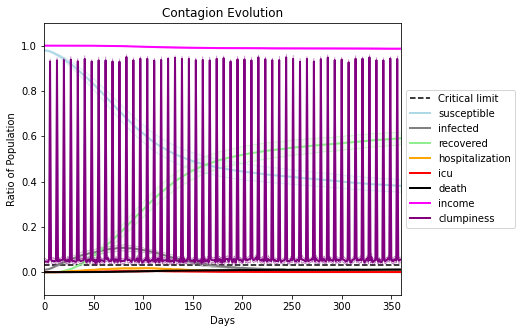

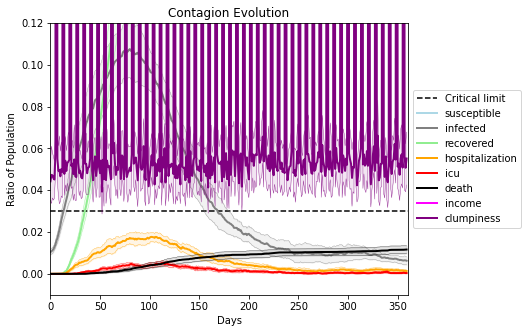

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3178, 6209, 8035, 8666, 9413, 3891, 5999, 6067, 6296, 1759, 2685, 8709, 1938, 9993, 3139, 5894, 9596, 8328, 3688, 5968]
Average similarity between family members is 0.9238968677129644 at temperature -0.992
Average similarity between family and home is 0.9998611878321362 at temperature -1
Average similarity between students and their classroom is 0.5395200641759178 at temperature -0.992
Average classroom occupancy is 4.014705882352941 and number classrooms is 68
Average similarity between workers is 0.8647012203818877 at temperature -0.992
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.8482159221439575 for kids: 0.6670140850917756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.40226360530986155
avg restaurant similarity 0.549332577454486
avg restaurant similarity 0.5740245943793996
avg restaurant similarity 0.5125493535975254
avg restaurant similarity 0.31852443234633215
avg restaurant similarity 0.21164028310354044
avg restaurant similarity 0.4856103167071842
avg restaurant similarity 0.568822590098192
avg restaurant similarity 0.3772012494838442
avg restaurant similarity 0.41835482968780463
avg restaurant similarity 0.4614968462382231
avg restaurant similarity 0.4589732086219818
avg restaurant similarity 0.58194966526726
avg restaurant similarity 0.5266817814721091
avg restaurant similarity 0.4772921208662172
avg restaurant similarity 0.28037251150792725
avg restaurant similarity 0.4283895693285686
avg restaurant similarity 0.45498609047418637
avg restaurant similarity 0.4275628566380086
avg restaurant similarity 0.42125623427487496
avg restaurant similarity 0.5126593876694969
avg restaurant similarity 0.5786061897807168
avg res

avg restaurant similarity 0.3969276404896377
avg restaurant similarity 0.6645999144313954
avg restaurant similarity 0.38384152952429823
avg restaurant similarity 0.46438482259523106
avg restaurant similarity 0.43009044967158916
avg restaurant similarity 0.5359465908934665
avg restaurant similarity 0.5623055402716022
avg restaurant similarity 0.4723959684336217
avg restaurant similarity 0.47001295379762126
avg restaurant similarity 0.4864899805597592
avg restaurant similarity 0.4838606259765172
avg restaurant similarity 0.4536302558865843
avg restaurant similarity 0.42238378720545483
avg restaurant similarity 0.5065075430265651
avg restaurant similarity 0.5971816520156227
avg restaurant similarity 0.6309216393559337
avg restaurant similarity 0.4026646843090817
avg restaurant similarity 0.5648666976240891
avg restaurant similarity 0.608459191275146
avg restaurant similarity 0.6114675019492443
avg restaurant similarity 0.47307350699757794
avg restaurant similarity 0.8998318045244159
avg r

avg restaurant similarity 0.5726423278469461
avg restaurant similarity 0.5897423318339975
avg restaurant similarity 0.42422150299021677
avg restaurant similarity 0.5301311013721789
avg restaurant similarity 0.5601731658236223
avg restaurant similarity 0.6162850955137927
avg restaurant similarity 0.5505625556714198
avg restaurant similarity 0.6412785763943004
avg restaurant similarity 0.47436528183320076
avg restaurant similarity 0.4571899636155787
avg restaurant similarity 0.4706172695230417
avg restaurant similarity 0.4184236282177932
avg restaurant similarity 0.5054661271854757
avg restaurant similarity 0.8190592106045909
avg restaurant similarity 0.45490592717704853
avg restaurant similarity 0.6673968969938223
avg restaurant similarity 0.46458235431075945
avg restaurant similarity 0.5918174587221218
avg restaurant similarity 0.5708112085685277
avg restaurant similarity 0.5272246908265188
avg restaurant similarity 0.4424187832844166
avg restaurant similarity 0.5796458720559907
avg re

avg restaurant similarity 0.6127234139845869
avg restaurant similarity 0.5297392727810771
avg restaurant similarity 0.5004841404820138
avg restaurant similarity 0.5278202874542769
avg restaurant similarity 0.5220204517951246
avg restaurant similarity 0.327709203025495
avg restaurant similarity 0.6064750461597673
avg restaurant similarity 0.48447801636313026
avg restaurant similarity 0.39244832924031436
avg restaurant similarity 0.5793740668116862
avg restaurant similarity 0.5055060744702905
avg restaurant similarity 0.45650138820107794
avg restaurant similarity 0.32318605431647857
avg restaurant similarity 0.5769014048843513
avg restaurant similarity 0.3380701123247187
avg restaurant similarity 0.6604675072773178
avg restaurant similarity 0.5754394911164761
avg restaurant similarity 0.3671549920127742
avg restaurant similarity 0.472508040284488
avg restaurant similarity 0.537033620381755
avg restaurant similarity 0.46910492655877156
avg restaurant similarity 0.5206636428738717
avg rest

avg restaurant similarity 0.8521900226002026
avg restaurant similarity 0.7102944027876686
avg restaurant similarity 0.7650938843352534
avg restaurant similarity 0.686040441049051
avg restaurant similarity 0.6299845296561003
avg restaurant similarity 0.9672788253421253
avg restaurant similarity 0.5889852998343004
avg restaurant similarity 0.6276893157595288
avg restaurant similarity 0.5954523897451629
avg restaurant similarity 0.735817616179743
avg restaurant similarity 0.6931362273959679
avg restaurant similarity 0.4295501000557806
avg restaurant similarity 0.4536736954613815
avg restaurant similarity 0.8994205441040656
avg restaurant similarity 0.6872259162273836
avg restaurant similarity 0.7348113758630616
avg restaurant similarity 0.6244891533541482
avg restaurant similarity 0.6011548015224755
avg restaurant similarity 0.6458659525225261
avg restaurant similarity 0.36133379055835124
avg restaurant similarity 0.7868015994236192
avg restaurant similarity 0.5459441521035321
avg restaur

avg restaurant similarity 0.4849260747672171
avg restaurant similarity 0.6014391160578445
avg restaurant similarity 0.49263065684541446
avg restaurant similarity 0.5517085569053997
avg restaurant similarity 0.47924104843009163
avg restaurant similarity 0.6295984771628808
avg restaurant similarity 0.6411362862776727
avg restaurant similarity 0.6005062100643483
avg restaurant similarity 0.5894438450924105
avg restaurant similarity 0.8377978472757862
avg restaurant similarity 0.5856487961719035
avg restaurant similarity 0.5523215297642744
avg restaurant similarity 0.5042335878011102
avg restaurant similarity 0.6822201812725928
avg restaurant similarity 0.5747875804554241
avg restaurant similarity 0.8380840823897022
avg restaurant similarity 0.7774388190221561
avg restaurant similarity 0.6186872906386903
avg restaurant similarity 0.6594269142593786
avg restaurant similarity 0.5933739543865099
avg restaurant similarity 0.5565802510865947
avg restaurant similarity 0.70765600508333
avg restau

avg restaurant similarity 0.830931136978056
avg restaurant similarity 0.6092573108891202
avg restaurant similarity 0.5451939914927146
avg restaurant similarity 0.6617482612296763
avg restaurant similarity 0.5526361130133159
avg restaurant similarity 0.6016830480114725
avg restaurant similarity 0.4652116055905741
avg restaurant similarity 0.5522138506353149
avg restaurant similarity 0.544805253411174
avg restaurant similarity 0.47171742527917027
avg restaurant similarity 0.6917460721185411
avg restaurant similarity 0.4313481697017027
avg restaurant similarity 0.3567837677332976
avg restaurant similarity 0.4488910759626985
avg restaurant similarity 0.4639726060291527
avg restaurant similarity 0.4491699618329536
avg restaurant similarity 0.42789660277602215
avg restaurant similarity 0.47692285619646324
avg restaurant similarity 0.5770677480067453
avg restaurant similarity 0.5269012600452782
avg restaurant similarity 0.49891660568821394
avg restaurant similarity 0.21143780177490817
avg res

avg restaurant similarity 0.37046843106459065
avg restaurant similarity 0.6691152163106036
avg restaurant similarity 0.4646217856988012
avg restaurant similarity 0.4985101489838315
avg restaurant similarity 0.5394595239234384
avg restaurant similarity 0.4536790202150977
avg restaurant similarity 0.7672176698538326
avg restaurant similarity 0.47147831745291297
avg restaurant similarity 0.6367595847365712
avg restaurant similarity 0.5671047153492969
avg restaurant similarity 0.5010918996709695
avg restaurant similarity 0.519986061097432
avg restaurant similarity 0.6231687484072247
avg restaurant similarity 0.4163238430630329
avg restaurant similarity 0.6374929720328022
avg restaurant similarity 0.5693316536584787
avg restaurant similarity 0.6165835504553137
avg restaurant similarity 0.6290801407706826
avg restaurant similarity 0.4041841000822359
avg restaurant similarity 0.5308985509305189
avg restaurant similarity 0.6508253469461748
avg restaurant similarity 0.4140096369584103
avg resta

avg restaurant similarity 0.5391293761109965
avg restaurant similarity 0.4739047523354981
avg restaurant similarity 0.37876322601803464
avg restaurant similarity 0.45569753684307995
avg restaurant similarity 0.5541520053969774
avg restaurant similarity 0.4465475334104019
avg restaurant similarity 0.5514110553157777
avg restaurant similarity 0.6036458785359493
avg restaurant similarity 0.5295645610404205
avg restaurant similarity 0.5421654917154991
avg restaurant similarity 0.44527227281523063
avg restaurant similarity 0.4186716861043934
avg restaurant similarity 0.46483363559358143
avg restaurant similarity 0.5087713074602145
avg restaurant similarity 0.6238388412209283
avg restaurant similarity 0.511806491611562
avg restaurant similarity 0.6805948347862691
avg restaurant similarity 0.6105525190927106
avg restaurant similarity 0.788743450591995
avg restaurant similarity 0.5419122521195985
avg restaurant similarity 0.38106721429933393
avg restaurant similarity 0.6082600619249738
avg res

avg restaurant similarity 0.49386077765848124
avg restaurant similarity 0.40657553971578964
avg restaurant similarity 0.5390906362723766
avg restaurant similarity 0.5554031475109011
avg restaurant similarity 0.5410343854563266
avg restaurant similarity 0.6786370519059242
avg restaurant similarity 0.6215931777301252
avg restaurant similarity 0.4907405131419249
avg restaurant similarity 0.5177597471962622
avg restaurant similarity 0.49397299303971565
avg restaurant similarity 0.5228666789919826
avg restaurant similarity 0.6483720648581093
avg restaurant similarity 0.4386564690087664
avg restaurant similarity 0.6908078740099337
avg restaurant similarity 0.7102302011244201
avg restaurant similarity 0.4151191195804017
avg restaurant similarity 0.5557372285213052
avg restaurant similarity 0.470928727899332
avg restaurant similarity 0.7775632335065231
avg restaurant similarity 0.6690623469230386
avg restaurant similarity 0.45669165901093367
avg restaurant similarity 0.5560652588903733
avg res

avg restaurant similarity 0.5322963870842538
avg restaurant similarity 0.5622164035975818
avg restaurant similarity 0.5501699343186903
avg restaurant similarity 0.5055858647005744
avg restaurant similarity 0.7477366832326975
avg restaurant similarity 0.5754451213046154
avg restaurant similarity 0.4924127935106287
avg restaurant similarity 0.4789879965086753
avg restaurant similarity 0.5671971075466248
avg restaurant similarity 0.6985932969269469
avg restaurant similarity 0.41160998597657106
avg restaurant similarity 0.4873883198373443
avg restaurant similarity 0.4963600052327816
avg restaurant similarity 0.6382228667594686
avg restaurant similarity 0.6986608467592916
avg restaurant similarity 0.5605563102267345
avg restaurant similarity 0.54711154456501
avg restaurant similarity 0.4537822398264571
avg restaurant similarity 0.5336530909725826
avg restaurant similarity 0.7090638370643276
avg restaurant similarity 0.43547556724884146
avg restaurant similarity 0.6138813182507147
avg restau

avg restaurant similarity 0.5340928069339983
avg restaurant similarity 0.6695147070026999
avg restaurant similarity 0.5159797204707882
avg restaurant similarity 0.42252878151060586
avg restaurant similarity 0.5248353955079462
avg restaurant similarity 0.6231213413626784
avg restaurant similarity 0.6877368943063195
avg restaurant similarity 0.5250847092155042
avg restaurant similarity 0.6503710434595857
avg restaurant similarity 0.5808915527603687
avg restaurant similarity 0.6353654781926485
avg restaurant similarity 0.5191418171316361
avg restaurant similarity 0.6157145280270244
avg restaurant similarity 0.4412514585785151
avg restaurant similarity 0.5985086443097135
avg restaurant similarity 0.41358707670079564
avg restaurant similarity 0.3737844223657131
avg restaurant similarity 0.4060622399157866
avg restaurant similarity 0.4734552912939677
avg restaurant similarity 0.5832406297252875
avg restaurant similarity 0.4134070551323051
avg restaurant similarity 0.5392167221585616
avg rest

avg restaurant similarity 0.47537315215160053
avg restaurant similarity 0.6038641696209622
avg restaurant similarity 0.573853745672521
avg restaurant similarity 0.5122831486475597
avg restaurant similarity 0.45202972716102763
avg restaurant similarity 0.5922179886484964
avg restaurant similarity 0.5352124903238015
avg restaurant similarity 0.6414819785285542
avg restaurant similarity 0.5497457904865909
avg restaurant similarity 0.4120672344108155
avg restaurant similarity 0.5058633585286839
avg restaurant similarity 0.4392826194725007
avg restaurant similarity 0.52101674570861
avg restaurant similarity 0.5342711991306774
avg restaurant similarity 0.5154449201113712
avg restaurant similarity 0.6535020969983788
avg restaurant similarity 0.4943880485513253
avg restaurant similarity 0.4281801152466843
avg restaurant similarity 0.3266342855872757
avg restaurant similarity 0.53374512591064
avg restaurant similarity 0.4846432540619656
avg restaurant similarity 0.5054496095575483
avg restauran

avg restaurant similarity 0.40256190557570437
avg restaurant similarity 0.32614949287409883
avg restaurant similarity 0.5858664928606498
avg restaurant similarity 0.5028742055230622
avg restaurant similarity 0.32232190018855156
avg restaurant similarity 0.5016940712693236
avg restaurant similarity 0.4617038590311041
avg restaurant similarity 0.6542920249496459
avg restaurant similarity 0.6130764718618197
avg restaurant similarity 0.6107029883418655
avg restaurant similarity 0.664228385238803
avg restaurant similarity 0.5954956796398405
avg restaurant similarity 0.4802918044180326
avg restaurant similarity 0.4835773788852017
avg restaurant similarity 0.43695044187859566
avg restaurant similarity 0.6982605895741866
avg restaurant similarity 0.5274263388468473
avg restaurant similarity 0.4912704303424814
avg restaurant similarity 0.5691406956285843
avg restaurant similarity 0.46068408424541724
avg restaurant similarity 0.6306586732231486
avg restaurant similarity 0.4647201016491405
avg re

avg restaurant similarity 0.665271584719188
avg restaurant similarity 0.4733171071185449
avg restaurant similarity 0.5198153463300615
avg restaurant similarity 0.763663124682602
avg restaurant similarity 0.644848518618406
avg restaurant similarity 0.5970440001711708
avg restaurant similarity 0.5686597287174416
avg restaurant similarity 0.6814339074669941
avg restaurant similarity 0.5945974154417795
avg restaurant similarity 0.5633552771036551
avg restaurant similarity 0.5875700719642427
avg restaurant similarity 0.515888050720107
avg restaurant similarity 0.4866135703396668
avg restaurant similarity 0.5915435187232946
avg restaurant similarity 0.5089207876509864
avg restaurant similarity 0.6360029130865497
avg restaurant similarity 0.4314964849335426
avg restaurant similarity 0.6522795989293917
avg restaurant similarity 0.7088642724354818
avg restaurant similarity 0.5943347127399659
avg restaurant similarity 0.7610385939950598
avg restaurant similarity 0.6734617438524705
avg restaurant

avg restaurant similarity 0.5850397299795793
avg restaurant similarity 0.6602888921145722
avg restaurant similarity 0.6127578346881307
avg restaurant similarity 0.4881027167506757
avg restaurant similarity 0.6197323313941637
avg restaurant similarity 0.6688888636687359
avg restaurant similarity 0.6801536094662167
avg restaurant similarity 0.5146802720658756
avg restaurant similarity 0.5351684914323563
avg restaurant similarity 0.5390206961349546
avg restaurant similarity 0.6807614939904068
avg restaurant similarity 0.41650292846155823
avg restaurant similarity 0.7666136512226188
avg restaurant similarity 0.5224823960416066
avg restaurant similarity 0.6656577188391688
avg restaurant similarity 0.4554887245563171
avg restaurant similarity 0.7042882477445891
avg restaurant similarity 0.6153663780710948
avg restaurant similarity 0.621004504748071
avg restaurant similarity 0.6308539521931611
avg restaurant similarity 0.617824181421557
avg restaurant similarity 0.6254241644680334
avg restaur

avg restaurant similarity 0.45529221269215236
avg restaurant similarity 0.37410525345304024
avg restaurant similarity 0.49211025242099293
avg restaurant similarity 0.5979347147249405
avg restaurant similarity 0.4547619925849611
avg restaurant similarity 0.5376262916561355
avg restaurant similarity 0.5709787727659767
avg restaurant similarity 0.4947440816311538
avg restaurant similarity 0.34838675281699527
avg restaurant similarity 0.4363490984044066
avg restaurant similarity 0.5918713404813143
avg restaurant similarity 0.5496464669585154
avg restaurant similarity 0.6794674388637435
avg restaurant similarity 0.66298256479894
avg restaurant similarity 0.6057130671061942
avg restaurant similarity 0.5938210481580569
avg restaurant similarity 0.7120265918787572
avg restaurant similarity 0.5148706239037388
avg restaurant similarity 0.36397649648011327
avg restaurant similarity 0.856790717385113
avg restaurant similarity 0.43324354030957973
avg restaurant similarity 0.5802931861842824
avg res

avg restaurant similarity 0.4991978276890632
avg restaurant similarity 0.5414506765291284
avg restaurant similarity 0.47805103470863697
avg restaurant similarity 0.4902700790951683
avg restaurant similarity 0.45318518683573805
avg restaurant similarity 0.5393546050054204
avg restaurant similarity 0.4044581177607247
avg restaurant similarity 0.4659970331613185
avg restaurant similarity 0.5031859877477235
avg restaurant similarity 0.5634530652867467
avg restaurant similarity 0.7141087635122778
avg restaurant similarity 0.5387183674691647
avg restaurant similarity 0.5394001675607872
avg restaurant similarity 0.5851858574914032
avg restaurant similarity 0.6339370023804991
avg restaurant similarity 0.4935985807586979
avg restaurant similarity 0.4484730060292685
avg restaurant similarity 0.620808944747273
avg restaurant similarity 0.49091031997274215
avg restaurant similarity 0.5516237132841195
avg restaurant similarity 0.5187186251844301
avg restaurant similarity 0.7381012400884809
avg rest

avg restaurant similarity 0.5820141758043007
avg restaurant similarity 0.45991301054532713
avg restaurant similarity 0.48048802698011134
avg restaurant similarity 0.5966494815029367
avg restaurant similarity 0.4816369175267736
avg restaurant similarity 0.48025840699058536
avg restaurant similarity 0.5329778795011184
avg restaurant similarity 0.5212877529297747
avg restaurant similarity 0.5225740915979936
avg restaurant similarity 0.47435620667275225
avg restaurant similarity 0.5547148588945546
avg restaurant similarity 0.55671393836925
avg restaurant similarity 0.5339918605411511
avg restaurant similarity 0.6407311334439036
avg restaurant similarity 0.6411670879516002
avg restaurant similarity 0.4743634314165855
avg restaurant similarity 0.3716752000730611
avg restaurant similarity 0.6278917828955016
avg restaurant similarity 0.5263508387277651
avg restaurant similarity 0.49229355336387615
avg restaurant similarity 0.5899723957016905
avg restaurant similarity 0.5100431546117602
avg res

avg restaurant similarity 0.5681753324464188
avg restaurant similarity 0.9998027484733185
avg restaurant similarity 0.5576797507400562
avg restaurant similarity 0.4683396921063194
avg restaurant similarity 0.444703429586744
avg restaurant similarity 0.6623043643003752
avg restaurant similarity 0.5742299199479441
avg restaurant similarity 0.56317313992038
avg restaurant similarity 0.5271944539696422
avg restaurant similarity 0.5869016735144222
avg restaurant similarity 0.5403286988325725
avg restaurant similarity 0.4705571778970028
avg restaurant similarity 0.5022639295205775
avg restaurant similarity 0.4717173902433901
avg restaurant similarity 0.5409819090291536
avg restaurant similarity 0.5698562776323447
avg restaurant similarity 0.48608224501028646
avg restaurant similarity 0.4215688294307513
avg restaurant similarity 0.6633313331430511
avg restaurant similarity 0.5373749205268992
avg restaurant similarity 0.5902511220856559
avg restaurant similarity 0.5466734748008968
avg restaura

avg restaurant similarity 0.5825653269689511
avg restaurant similarity 0.38110641958191577
avg restaurant similarity 0.5451917127801262
avg restaurant similarity 0.48589193920308976
avg restaurant similarity 0.5281191501247449
avg restaurant similarity 0.595608253663386
avg restaurant similarity 0.6750757481518365
avg restaurant similarity 0.5844381153301742
avg restaurant similarity 0.6577166333798135
avg restaurant similarity 0.6059770054705661
avg restaurant similarity 0.5305343643621978
avg restaurant similarity 0.6519239187309018
avg restaurant similarity 0.5602907948567066
avg restaurant similarity 0.6329415190821166
avg restaurant similarity 0.4243060638416864
avg restaurant similarity 0.5623876750076556
avg restaurant similarity 0.519923307315469
avg restaurant similarity 0.44211996498008743
avg restaurant similarity 0.47250833950053595
avg restaurant similarity 0.5838064615940198
avg restaurant similarity 0.4982430376884586
avg restaurant similarity 0.5600348583639575
avg rest

avg restaurant similarity 0.5520835993732266
avg restaurant similarity 0.5538935117962838
avg restaurant similarity 0.7208720310118695
avg restaurant similarity 0.5385005295690886
avg restaurant similarity 0.607926016393486
avg restaurant similarity 0.5986075813839131
avg restaurant similarity 0.5708558062284639
avg restaurant similarity 0.56399161185641
avg restaurant similarity 0.5537342526422953
avg restaurant similarity 0.4801312006275141
avg restaurant similarity 0.5679418547097654
avg restaurant similarity 0.6148141087954031
avg restaurant similarity 0.488046701588479
avg restaurant similarity 0.6101840279253852
avg restaurant similarity 0.36290472819645475
avg restaurant similarity 0.5667745042653736
avg restaurant similarity 0.38707818609839195
avg restaurant similarity 0.5229245183895034
avg restaurant similarity 0.40845684052341424
avg restaurant similarity 0.6762943957037404
avg restaurant similarity 0.5768462275942182
avg restaurant similarity 0.7333266278441587
avg restaur

avg restaurant similarity 0.5859493400679948
avg restaurant similarity 0.5930796923253424
avg restaurant similarity 0.5658396119602078
avg restaurant similarity 0.5979765194031628
avg restaurant similarity 0.6008091931666418
avg restaurant similarity 0.693661983658116
avg restaurant similarity 0.6368118255247605
avg restaurant similarity 0.5317936986086359
avg restaurant similarity 0.540471015650333
avg restaurant similarity 0.6524328378726161
avg restaurant similarity 0.600214959065365
avg restaurant similarity 0.6672904621294746
avg restaurant similarity 0.43438862677864803
avg restaurant similarity 0.613273576100687
avg restaurant similarity 0.650299986944725
avg restaurant similarity 0.40487995329100523
avg restaurant similarity 0.581863804616263
avg restaurant similarity 0.5940256402944807
avg restaurant similarity 0.2961344861396625
avg restaurant similarity 0.5153905042580229
avg restaurant similarity 0.48438888274927566
avg restaurant similarity 0.5117063645880422
avg restauran

avg restaurant similarity 0.4356621181444659
avg restaurant similarity 0.7096236963673833
avg restaurant similarity 0.6075315263067481
avg restaurant similarity 0.5566303082256876
avg restaurant similarity 0.57482053502857
avg restaurant similarity 0.6263864354431556
avg restaurant similarity 0.7457550669777141
avg restaurant similarity 0.5658665916972874
avg restaurant similarity 0.7190697419522311
avg restaurant similarity 0.5648911015286688
avg restaurant similarity 0.6799123069436487
avg restaurant similarity 0.7202709100080724
avg restaurant similarity 0.803696354703081
avg restaurant similarity 0.5615140341345037
avg restaurant similarity 0.6346124552110699
avg restaurant similarity 0.5375621118356919
avg restaurant similarity 0.7756542099694408
avg restaurant similarity 0.5515418300891611
avg restaurant similarity 0.5670657149331639
avg restaurant similarity 0.5941438754694297
avg restaurant similarity 0.5009373526702686
avg restaurant similarity 0.378052207438852
avg restaurant

avg restaurant similarity 0.3992856091408251
avg restaurant similarity 0.6108795891214138
avg restaurant similarity 0.6132681590561491
avg restaurant similarity 0.7612445929995779
avg restaurant similarity 0.6201376839246826
avg restaurant similarity 0.6496137335684998
avg restaurant similarity 0.5374503321032124
avg restaurant similarity 0.5832072435169742
avg restaurant similarity 0.4250908292532369
avg restaurant similarity 0.6700220894491339
avg restaurant similarity 0.4346595952174548
avg restaurant similarity 0.49851000001213197
avg restaurant similarity 0.5602603215164095
avg restaurant similarity 0.4997591311369728
avg restaurant similarity 0.8750667644484872
avg restaurant similarity 0.3366494075039612
avg restaurant similarity 0.6755428787019078
avg restaurant similarity 0.5896645153447226
avg restaurant similarity 0.5390888121372862
avg restaurant similarity 0.925034077674183
avg restaurant similarity 0.4162164159877985
avg restaurant similarity 0.45253764617319564
avg resta

avg restaurant similarity 0.6942854431760834
avg restaurant similarity 0.5399540118456031
avg restaurant similarity 0.46979689358703813
avg restaurant similarity 0.5619089883970168
avg restaurant similarity 0.5721597258916186
avg restaurant similarity 0.4866454793277268
avg restaurant similarity 0.6739466436605047
avg restaurant similarity 0.39473673867346903
avg restaurant similarity 0.5689075114629559
avg restaurant similarity 0.42294725996888977
avg restaurant similarity 0.5444293157316241
avg restaurant similarity 0.4475812999571831
avg restaurant similarity 0.571995759634218
avg restaurant similarity 0.6187744372286976
avg restaurant similarity 0.6912291905396597
avg restaurant similarity 0.6127651116000745
avg restaurant similarity 0.4917109680660222
avg restaurant similarity 0.49107526759554226
avg restaurant similarity 0.5747138662600182
avg restaurant similarity 0.3858281399267796
avg restaurant similarity 0.3279049753757447
avg restaurant similarity 0.5027699374851932
avg res

avg restaurant similarity 0.5206374039685758
avg restaurant similarity 0.4098358985081969
avg restaurant similarity 0.41121967552495997
avg restaurant similarity 0.48908232623382214
avg restaurant similarity 0.5084424682179247
avg restaurant similarity 0.5652515117309072
avg restaurant similarity 0.512173528383833
avg restaurant similarity 0.3274577983518204
avg restaurant similarity 0.558715665498557
avg restaurant similarity 0.428564001259068
avg restaurant similarity 0.48764990814277936
avg restaurant similarity 0.6550619431407403
avg restaurant similarity 0.5567123318670043
avg restaurant similarity 0.44184846523493493
avg restaurant similarity 0.3986852116080439
avg restaurant similarity 0.5276982221480531
avg restaurant similarity 0.5306574827183252
avg restaurant similarity 0.39544323399024517
avg restaurant similarity 0.44658340934495466
avg restaurant similarity 0.6291485442859128
avg restaurant similarity 0.456633871850259
avg restaurant similarity 0.40955253148951637
avg res

avg restaurant similarity 0.5957534306589003
avg restaurant similarity 0.2816083875368832
avg restaurant similarity 0.510726252765194
avg restaurant similarity 0.5149242259927982
avg restaurant similarity 0.4549598354814118
avg restaurant similarity 0.40865419338043635
avg restaurant similarity 0.19743233681893482
avg restaurant similarity 0.7257194522320958
avg restaurant similarity 0.5775337412311706
avg restaurant similarity 0.5297861158864994
avg restaurant similarity 0.45204679238850987
avg restaurant similarity 0.4797714798315287
avg restaurant similarity 0.44761774040885827
avg restaurant similarity 0.4307865400901598
avg restaurant similarity 0.5551946472471254
avg restaurant similarity 0.5185603494351693
avg restaurant similarity 0.513365130397732
avg restaurant similarity 0.4399179584943924
avg restaurant similarity 0.8453223494366904
avg restaurant similarity 0.8400810381072399
avg restaurant similarity 0.5613983831415106
avg restaurant similarity 0.6993821270323184
avg rest

avg restaurant similarity 0.5610387486606676
avg restaurant similarity 0.4912466913494705
avg restaurant similarity 0.46466938748133396
avg restaurant similarity 0.5894775818345851
avg restaurant similarity 0.6641387140016082
avg restaurant similarity 0.5148383173922293
avg restaurant similarity 0.533525447384961
avg restaurant similarity 0.550172646996168
avg restaurant similarity 0.6647091825373862
avg restaurant similarity 0.5914979101410707
avg restaurant similarity 0.47971453178790646
avg restaurant similarity 0.48329590565115943
avg restaurant similarity 0.5479863873946988
avg restaurant similarity 0.6237156375946591
avg restaurant similarity 0.5072179602653064
avg restaurant similarity 0.548943389299968
avg restaurant similarity 0.45554280016019844
avg restaurant similarity 0.4589716289378907
avg restaurant similarity 0.5968199920451217
avg restaurant similarity 0.4779463381271269
avg restaurant similarity 0.44188469321222834
avg restaurant similarity 0.5536163801012209
avg rest

avg restaurant similarity 0.5097945428196643
avg restaurant similarity 0.5767125528557582
avg restaurant similarity 0.657777193431169
avg restaurant similarity 0.5408675575027168
avg restaurant similarity 0.4556196330464196
avg restaurant similarity 0.5070540599961219
avg restaurant similarity 0.5487183053740906
avg restaurant similarity 0.5039411897392051
avg restaurant similarity 0.4162307259180829
avg restaurant similarity 0.5719503327523863
avg restaurant similarity 0.49197020852037393
avg restaurant similarity 0.5993310627844953
avg restaurant similarity 0.551984648423949
avg restaurant similarity 0.46861791373558387
avg restaurant similarity 0.4493660408964722
avg restaurant similarity 0.5382138573009589
avg restaurant similarity 0.5681347600952347
avg restaurant similarity 0.5720899941085515
avg restaurant similarity 0.5078883675992789
avg restaurant similarity 0.5729588195231633
avg restaurant similarity 0.4085281599662675
avg restaurant similarity 0.47699171622545294
avg resta

avg restaurant similarity 0.5419234154099489
avg restaurant similarity 0.48342086081775487
avg restaurant similarity 0.5112046156759091
avg restaurant similarity 0.5132726473164057
avg restaurant similarity 0.5937716441085681
avg restaurant similarity 0.525808507797651
avg restaurant similarity 0.4274799890557039
avg restaurant similarity 0.5524019408128008
avg restaurant similarity 0.6004139902632508
avg restaurant similarity 0.4989670090175101
avg restaurant similarity 0.501486218247292
avg restaurant similarity 0.5032223307407259
avg restaurant similarity 0.45200919838785697
avg restaurant similarity 0.4396770466219382
avg restaurant similarity 0.6230683942581009
avg restaurant similarity 0.5626741715200599
avg restaurant similarity 0.5254976132442357
avg restaurant similarity 0.4817519226666171
avg restaurant similarity 0.6988710046512168
avg restaurant similarity 0.624477261569441
avg restaurant similarity 0.4580254431280796
avg restaurant similarity 0.5121087192433075
avg restaur

avg restaurant similarity 0.5354771379716764
avg restaurant similarity 0.5642873119044278
avg restaurant similarity 0.6313901802424429
avg restaurant similarity 0.5765403610474065
avg restaurant similarity 0.5545896761619591
avg restaurant similarity 0.47787998734812803
avg restaurant similarity 0.519416124690162
avg restaurant similarity 0.5254644783190127
avg restaurant similarity 0.6140823243564042
avg restaurant similarity 0.40257937083175094
avg restaurant similarity 0.6363939329884778
avg restaurant similarity 0.5540660639602532
avg restaurant similarity 0.5133778662319597
avg restaurant similarity 0.5493417855340612
avg restaurant similarity 0.565536973362833
avg restaurant similarity 0.5227342492868733
avg restaurant similarity 0.38840775508219355
avg restaurant similarity 0.5171687942040907
avg restaurant similarity 0.4527127150026467
avg restaurant similarity 0.5782232766200256
avg restaurant similarity 0.5864182737595409
avg restaurant similarity 0.6386594553709628
avg resta

avg restaurant similarity 0.5811113083862548
avg restaurant similarity 0.4635214843239915
avg restaurant similarity 0.6810605197149634
avg restaurant similarity 0.5908685061536632
avg restaurant similarity 0.5818621619254132
avg restaurant similarity 0.697566575065482
avg restaurant similarity 0.5477237697061502
avg restaurant similarity 0.5959138762821033
avg restaurant similarity 0.6366999036124689
avg restaurant similarity 0.5791601712353225
avg restaurant similarity 0.5988287063112785
avg restaurant similarity 0.6585285387168308
avg restaurant similarity 0.8161081451996175
avg restaurant similarity 0.5479218593665428
avg restaurant similarity 0.5912579568925016
avg restaurant similarity 0.5543807712705529
avg restaurant similarity 0.5941520931206671
avg restaurant similarity 0.5751593579716043
avg restaurant similarity 0.6165514008876976
avg restaurant similarity 0.6686189143933405
avg restaurant similarity 0.6787436388440471
avg restaurant similarity 0.6081813459123375
avg restaur

avg restaurant similarity 0.42429936793258605
avg restaurant similarity 0.6900813653206844
avg restaurant similarity 0.6180808405059023
avg restaurant similarity 0.47434118837582284
avg restaurant similarity 0.6190785090206167
avg restaurant similarity 0.5194290707168981
avg restaurant similarity 0.6130686449952965
avg restaurant similarity 0.6379548952154187
avg restaurant similarity 0.6188857987898595
avg restaurant similarity 0.538570585204611
avg restaurant similarity 0.5923434730150324
avg restaurant similarity 0.5384545588425123
avg restaurant similarity 0.5989468965192808
avg restaurant similarity 0.6085255223714175
avg restaurant similarity 0.5427977742220503
avg restaurant similarity 0.4701396049025847
avg restaurant similarity 0.5151679075147996
avg restaurant similarity 0.6182739008526739
avg restaurant similarity 0.6247832682194603
avg restaurant similarity 0.654052010098676
avg restaurant similarity 0.48364237056494935
avg restaurant similarity 0.5149023821514414
avg resta

avg restaurant similarity 0.6945461436515994
avg restaurant similarity 0.6223192993800024
avg restaurant similarity 0.6169114141646034
avg restaurant similarity 0.5543579868076228
avg restaurant similarity 0.5857535829912136
avg restaurant similarity 0.5363261884021929
avg restaurant similarity 0.6805421475479654
avg restaurant similarity 0.6002545807064291
avg restaurant similarity 0.5689579151409497
avg restaurant similarity 0.7249985744813863
avg restaurant similarity 0.5697587408386889
avg restaurant similarity 0.6288565567519835
avg restaurant similarity 0.5805054970292568
avg restaurant similarity 0.7545610914218646
avg restaurant similarity 0.5718726293697429
avg restaurant similarity 0.523485379508855
avg restaurant similarity 0.7120423591652532
avg restaurant similarity 0.41303786435665973
avg restaurant similarity 0.7127204822147262
avg restaurant similarity 0.5224050803805073
avg restaurant similarity 0.7139594112703214
avg restaurant similarity 0.5233024059324392
avg restau

avg restaurant similarity 0.33726121129988207
avg restaurant similarity 0.8900271495948423
avg restaurant similarity 0.6193655866499297
avg restaurant similarity 0.9998564228242784
avg restaurant similarity 0.5975170181246103
avg restaurant similarity 0.5638814015713803
avg restaurant similarity 0.47871573987335714
avg restaurant similarity 0.5762883138996356
avg restaurant similarity 0.48671465075934645
avg restaurant similarity 0.5451265076272144
avg restaurant similarity 0.5686713373507405
avg restaurant similarity 0.5983525965665825
avg restaurant similarity 0.49005477797486835
avg restaurant similarity 0.6176116581247706
avg restaurant similarity 0.5921808268946325
avg restaurant similarity 0.8331710851742993
avg restaurant similarity 0.6416306798278463
avg restaurant similarity 0.6999537427092629
avg restaurant similarity 0.5673901270718669
avg restaurant similarity 0.7010374411983593
avg restaurant similarity 0.5615088050983345
avg restaurant similarity 0.6539784943871731
avg re

avg restaurant similarity 0.5034162523582297
avg restaurant similarity 0.7750617070721606
avg restaurant similarity 0.541998659122735
avg restaurant similarity 0.49411649767253313
avg restaurant similarity 0.541186107988884
avg restaurant similarity 0.573879455468816
avg restaurant similarity 0.6793641806999235
avg restaurant similarity 0.4739063334034263
avg restaurant similarity 0.4381741504403577
avg restaurant similarity 0.7004495760073662
avg restaurant similarity 0.340241693391198
avg restaurant similarity 0.5023156160114639
avg restaurant similarity 0.6021847575057868
avg restaurant similarity 0.5330389837221804
avg restaurant similarity 0.616472898757244
avg restaurant similarity 0.35329494264336714
avg restaurant similarity 0.18823506885989044
avg restaurant similarity 0.3171265561555301
avg restaurant similarity 0.31901443955930436
avg restaurant similarity 0.3150188501732788
avg restaurant similarity 0.37091801704402116
avg restaurant similarity 0.33188950958004293
avg resta

avg restaurant similarity 0.5457326357199624
avg restaurant similarity 0.6307943279027912
avg restaurant similarity 0.6617782015725755
avg restaurant similarity 0.5151638649948318
avg restaurant similarity 0.5349399020387088
avg restaurant similarity 0.6285734260568372
avg restaurant similarity 0.5783133703706933
avg restaurant similarity 0.526530177761256
avg restaurant similarity 0.37407036551853967
avg restaurant similarity 0.5876844768938466
avg restaurant similarity 0.5569884344617524
avg restaurant similarity 0.600697253995867
avg restaurant similarity 0.6137115282248796
avg restaurant similarity 0.28349160431326537
avg restaurant similarity 0.6530315353355767
avg restaurant similarity 0.6542924771954463
avg restaurant similarity 0.40199066024448415
avg restaurant similarity 0.562457165223081
avg restaurant similarity 0.6295367549651762
avg restaurant similarity 0.3993586928366308
avg restaurant similarity 0.47286908373183234
avg restaurant similarity 0.41948995007433165
avg rest

avg restaurant similarity 0.6712039578012786
avg restaurant similarity 0.7351723473695116
avg restaurant similarity 0.6733049378474024
avg restaurant similarity 0.4633712941293586
avg restaurant similarity 0.539735460756025
avg restaurant similarity 0.5142897268071093
avg restaurant similarity 0.49560672023788466
avg restaurant similarity 0.5562812823831915
avg restaurant similarity 0.6119123775135674
avg restaurant similarity 0.5978920416334765
avg restaurant similarity 0.4399105048751552
avg restaurant similarity 0.678182110361495
avg restaurant similarity 0.6858430392173185
avg restaurant similarity 0.41372021592452934
avg restaurant similarity 0.4747983680606366
avg restaurant similarity 0.42103358467263147
avg restaurant similarity 0.5143687287969237
avg restaurant similarity 0.49345515724422717
avg restaurant similarity 0.4884859794116275
avg restaurant similarity 0.476242496911248
avg restaurant similarity 0.766295740699336
avg restaurant similarity 0.5557750071201506
avg restau

avg restaurant similarity 0.5765165177997701
avg restaurant similarity 0.5389582896557007
avg restaurant similarity 0.4216599771828133
avg restaurant similarity 0.5743799248483844
avg restaurant similarity 0.45862218179335174
avg restaurant similarity 0.5189723132021953
avg restaurant similarity 0.6666092260169196
avg restaurant similarity 0.7016854529148869
avg restaurant similarity 0.4224557307334641
avg restaurant similarity 0.6265941279235114
avg restaurant similarity 0.5393331224245285
avg restaurant similarity 0.5144185142937118
avg restaurant similarity 0.6950408481201136
avg restaurant similarity 0.4685383054941701
avg restaurant similarity 0.6163794273022035
avg restaurant similarity 0.43929537618085923
avg restaurant similarity 0.5146423025864864
avg restaurant similarity 0.5962460752843056
avg restaurant similarity 0.7244107753873232
avg restaurant similarity 0.5172589739165623
avg restaurant similarity 0.5217535254028383
avg restaurant similarity 0.45071685625181984
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

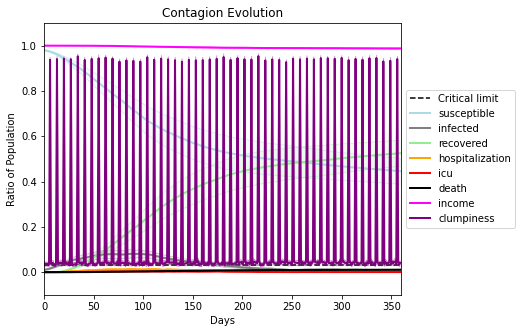

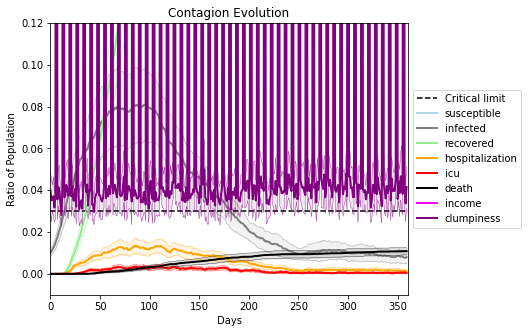

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2444, 6817, 7232, 3290, 7966, 8671, 4494, 5624, 3255, 3225, 9312, 7698, 5279, 4687, 9109, 6623, 3467, 1526, 2789, 6070]
Average similarity between family members is 0.9164400848279745 at temperature -0.991
Average similarity between family and home is 0.999858879595485 at temperature -1
Average similarity between students and their classroom is 0.5242947456904897 at temperature -0.991
Average classroom occupancy is 3.9714285714285715 and number classrooms is 70
Average similarity between workers is 0.8248534935757711 at temperature -0.991
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.8327965869541858 for kids: 0.6435527446870194
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.4678384209170949
avg restaurant similarity 0.6290103207593117
avg restaurant similarity 0.4801083745990721
avg restaurant similarity 0.5230438828674485
avg restaurant similarity 0.516560353206299
avg restaurant similarity 0.5810562914092114
avg restaurant similarity 0.5300922913681311
avg restaurant similarity 0.5216230186777939
avg restaurant similarity 0.6054594275141757
avg restaurant similarity 0.5495871229524342
avg restaurant similarity 0.5593850387177616
avg restaurant similarity 0.4490566542265501
avg restaurant similarity 0.6029752352518967
avg restaurant similarity 0.6520025825174687
avg restaurant similarity 0.637129974450279
avg restaurant similarity 0.6654917295010769
avg restaurant similarity 0.41756084566580187
avg restaurant similarity 0.5878815641650768
avg restaurant similarity 0.5257503642330278
avg restaurant similarity 0.5949092020409295
avg restaurant similarity 0.4961523828472405
avg restaurant similarity 0.4504878205544343
avg restaur

avg restaurant similarity 0.53242896354762
avg restaurant similarity 0.505222137909441
avg restaurant similarity 0.7202359400318883
avg restaurant similarity 0.44524327858964163
avg restaurant similarity 0.5925609843147588
avg restaurant similarity 0.6086900477740319
avg restaurant similarity 0.5249856738155856
avg restaurant similarity 0.5747257335058524
avg restaurant similarity 0.4774553106738117
avg restaurant similarity 0.47929460436088506
avg restaurant similarity 0.5248213304535825
avg restaurant similarity 0.8097115209693365
avg restaurant similarity 0.3315901700725019
avg restaurant similarity 0.4873960989859383
avg restaurant similarity 0.5035373841230846
avg restaurant similarity 0.4150419631139374
avg restaurant similarity 0.3560507068840177
avg restaurant similarity 0.47412668240538797
avg restaurant similarity 0.30300467499715616
avg restaurant similarity 0.5249971682300194
avg restaurant similarity 0.3063188178031763
avg restaurant similarity 0.5570302509816225
avg resta

avg restaurant similarity 0.5376996447991808
avg restaurant similarity 0.4826746269036437
avg restaurant similarity 0.6572435375054414
avg restaurant similarity 0.5493885180112027
avg restaurant similarity 0.4632488801948172
avg restaurant similarity 0.5814769569376433
avg restaurant similarity 0.4850977830095069
avg restaurant similarity 0.5570267837435106
avg restaurant similarity 0.5048201484002315
avg restaurant similarity 0.4851299557055946
avg restaurant similarity 0.43146017903397454
avg restaurant similarity 0.4361276754115646
avg restaurant similarity 0.5369808330132757
avg restaurant similarity 0.5256357364980787
avg restaurant similarity 0.4720151839822067
avg restaurant similarity 0.4506353429875355
avg restaurant similarity 0.5635616078008749
avg restaurant similarity 0.5212391644197398
avg restaurant similarity 0.4737520369818262
avg restaurant similarity 0.4762339080618018
avg restaurant similarity 0.7442963336142212
avg restaurant similarity 0.5834068619560313
avg resta

avg restaurant similarity 0.4574706947745452
avg restaurant similarity 0.47092596763018774
avg restaurant similarity 0.4606184277419973
avg restaurant similarity 0.5583777478170144
avg restaurant similarity 0.4877037410811271
avg restaurant similarity 0.5782008487330309
avg restaurant similarity 0.5703521722584359
avg restaurant similarity 0.552270929113667
avg restaurant similarity 0.5765838084685033
avg restaurant similarity 0.5456993804799638
avg restaurant similarity 0.5406073672715974
avg restaurant similarity 0.5323434348796894
avg restaurant similarity 0.5545896337861664
avg restaurant similarity 0.5046058226240476
avg restaurant similarity 0.3970541399376752
avg restaurant similarity 0.5243986913359895
avg restaurant similarity 0.6283556339622679
avg restaurant similarity 0.5472060456325101
avg restaurant similarity 0.5270929122019318
avg restaurant similarity 0.5365426160346736
avg restaurant similarity 0.532459440638024
avg restaurant similarity 0.6924881659212951
avg restaur

avg restaurant similarity 0.6683031140726697
avg restaurant similarity 0.466392610526861
avg restaurant similarity 0.4437480518191407
avg restaurant similarity 0.46387391603611566
avg restaurant similarity 0.5893801918654805
avg restaurant similarity 0.7472829239635126
avg restaurant similarity 0.7647650298132957
avg restaurant similarity 0.4324650348218195
avg restaurant similarity 0.5080457821523517
avg restaurant similarity 0.5062814473366406
avg restaurant similarity 0.49396381131160605
avg restaurant similarity 0.4183285165288714
avg restaurant similarity 0.9997055561615915
avg restaurant similarity 0.6709982236715997
avg restaurant similarity 0.6441237721550184
avg restaurant similarity 0.5685759140906643
avg restaurant similarity 0.4753316430724032
avg restaurant similarity 0.5686469413837781
avg restaurant similarity 0.746983774589
avg restaurant similarity 0.44528875289600783
avg restaurant similarity 0.6749307811144155
avg restaurant similarity 0.6127010715157601
avg restaura

avg restaurant similarity 0.531033879337756
avg restaurant similarity 0.5496927822801856
avg restaurant similarity 0.6463439365999147
avg restaurant similarity 0.5238131318912674
avg restaurant similarity 0.6786453878140639
avg restaurant similarity 0.57570381349296
avg restaurant similarity 0.5441868016879302
avg restaurant similarity 0.46749052640204586
avg restaurant similarity 0.3725118152252588
avg restaurant similarity 0.7310194798679268
avg restaurant similarity 0.5162168719331546
avg restaurant similarity 0.5664966996657388
avg restaurant similarity 0.4498546280790194
avg restaurant similarity 0.5881468638960062
avg restaurant similarity 0.33715159648192516
avg restaurant similarity 0.5798393250994578
avg restaurant similarity 0.39588610456160905
avg restaurant similarity 0.5963874047399328
avg restaurant similarity 0.5110821050336724
avg restaurant similarity 0.45653237853679257
avg restaurant similarity 0.6467812152755874
avg restaurant similarity 0.5739246334907678
avg resta

avg restaurant similarity 0.6867454608320842
avg restaurant similarity 0.8232858268004593
avg restaurant similarity 0.5013294756999026
avg restaurant similarity 0.5176032434891092
avg restaurant similarity 0.5045563467441053
avg restaurant similarity 0.3884228290235867
avg restaurant similarity 0.44695223519933813
avg restaurant similarity 0.5111023787049133
avg restaurant similarity 0.47224873073008766
avg restaurant similarity 0.6571135499077708
avg restaurant similarity 0.6323844650703365
avg restaurant similarity 0.7334058502014185
avg restaurant similarity 0.66775149361012
avg restaurant similarity 0.8186781801578904
avg restaurant similarity 0.38463565234276453
avg restaurant similarity 0.6855991877820783
avg restaurant similarity 0.5187196200993064
avg restaurant similarity 0.5999524356417454
avg restaurant similarity 0.6639859030794708
avg restaurant similarity 0.7676755409004931
avg restaurant similarity 0.39179149990815126
avg restaurant similarity 0.6153231635695419
avg rest

avg restaurant similarity 0.3369727134003612
avg restaurant similarity 0.4628154194117828
avg restaurant similarity 0.4253273218033845
avg restaurant similarity 0.47298420195627167
avg restaurant similarity 0.5236476350829128
avg restaurant similarity 0.48280836098928587
avg restaurant similarity 0.43582635674012815
avg restaurant similarity 0.5115250230781903
avg restaurant similarity 0.5896383547320654
avg restaurant similarity 0.8523634020544454
avg restaurant similarity 0.4208309627792581
avg restaurant similarity 0.5567573909861179
avg restaurant similarity 0.5861083876401232
avg restaurant similarity 0.5548119272347524
avg restaurant similarity 0.5220978757203986
avg restaurant similarity 0.4612295647621111
avg restaurant similarity 0.6002621568194063
avg restaurant similarity 0.3172334838409264
avg restaurant similarity 0.5152085656905881
avg restaurant similarity 0.4505533534984108
avg restaurant similarity 0.44554471605054047
avg restaurant similarity 0.4817165799672099
avg re

avg restaurant similarity 0.45492829005895397
avg restaurant similarity 0.4408509422292796
avg restaurant similarity 0.6430739369866737
avg restaurant similarity 0.6103880056611413
avg restaurant similarity 0.7807666745829664
avg restaurant similarity 0.4663586965184039
avg restaurant similarity 0.6314099401401756
avg restaurant similarity 0.5030048032994258
avg restaurant similarity 0.46491398548176094
avg restaurant similarity 0.46674286290682376
avg restaurant similarity 0.3299619571670454
avg restaurant similarity 0.3420191706927511
avg restaurant similarity 0.480038856035757
avg restaurant similarity 0.3187883391152433
avg restaurant similarity 0.4746552823044068
avg restaurant similarity 0.6378838328456149
avg restaurant similarity 0.3544660503076949
avg restaurant similarity 0.4777312085495556
avg restaurant similarity 0.7019513197295335
avg restaurant similarity 0.5435455429698547
avg restaurant similarity 0.40142655356511336
avg restaurant similarity 0.49773934565405176
avg re

avg restaurant similarity 0.5448858508226113
avg restaurant similarity 0.6079286011131939
avg restaurant similarity 0.4031910353683648
avg restaurant similarity 0.612005074985205
avg restaurant similarity 0.605166175786797
avg restaurant similarity 0.5774640574194718
avg restaurant similarity 0.6112926742579418
avg restaurant similarity 0.5933663335182938
avg restaurant similarity 0.5830284356698743
avg restaurant similarity 0.3551261516924974
avg restaurant similarity 0.5416057350688832
avg restaurant similarity 0.4402905560381537
avg restaurant similarity 0.4142206915300394
avg restaurant similarity 0.7177024003474921
avg restaurant similarity 0.5731399096443629
avg restaurant similarity 0.4972499990905409
avg restaurant similarity 0.6230094847336982
avg restaurant similarity 0.5688808928527492
avg restaurant similarity 0.49905044689005185
avg restaurant similarity 0.4766701204045814
avg restaurant similarity 0.43477950978137087
avg restaurant similarity 0.49691568673980313
avg resta

avg restaurant similarity 0.380315715048853
avg restaurant similarity 0.5615000990955547
avg restaurant similarity 0.4715992060429519
avg restaurant similarity 0.43595076666048965
avg restaurant similarity 0.5854481766693398
avg restaurant similarity 0.5373317933877509
avg restaurant similarity 0.5715711738560592
avg restaurant similarity 0.4644643726626568
avg restaurant similarity 0.5346345035208285
avg restaurant similarity 0.6906750947104867
avg restaurant similarity 0.5729403502473487
avg restaurant similarity 0.6357752006202044
avg restaurant similarity 0.2906504149333642
avg restaurant similarity 0.7021360810398777
avg restaurant similarity 0.24992546955815279
avg restaurant similarity 0.6354347520301324
avg restaurant similarity 0.5912299408413282
avg restaurant similarity 0.38235009598995895
avg restaurant similarity 0.582053241047609
avg restaurant similarity 0.47491524297928744
avg restaurant similarity 0.5533317951190068
avg restaurant similarity 0.4414329468563036
avg rest

avg restaurant similarity 0.529826138011364
avg restaurant similarity 0.48874293971438504
avg restaurant similarity 0.4537934611894143
avg restaurant similarity 0.6080762446388507
avg restaurant similarity 0.5290979400472327
avg restaurant similarity 0.6585981350902286
avg restaurant similarity 0.4700409015912602
avg restaurant similarity 0.4273384593651093
avg restaurant similarity 0.648724839505167
avg restaurant similarity 0.36839753188344887
avg restaurant similarity 0.5959764338269425
avg restaurant similarity 0.5807879086029434
avg restaurant similarity 0.3691553194905084
avg restaurant similarity 0.5413080138648815
avg restaurant similarity 0.5632703702188164
avg restaurant similarity 0.46869816052909663
avg restaurant similarity 0.5212450852003653
avg restaurant similarity 0.5195458324388313
avg restaurant similarity 0.5832439611878244
avg restaurant similarity 0.4754698603751169
avg restaurant similarity 0.6353331675019909
avg restaurant similarity 0.3857081902995926
avg resta

avg restaurant similarity 0.47863723771581135
avg restaurant similarity 0.3906906165209219
avg restaurant similarity 0.5080693477244614
avg restaurant similarity 0.43877906457223487
avg restaurant similarity 0.42360280848741966
avg restaurant similarity 0.34155782309093186
avg restaurant similarity 0.521209477815913
avg restaurant similarity 0.4829787493588036
avg restaurant similarity 0.33980141976153705
avg restaurant similarity 0.29159923590808534
avg restaurant similarity 0.4741375033134269
avg restaurant similarity 0.395807720064866
avg restaurant similarity 0.41285677002660226
avg restaurant similarity 0.4264257731605346
avg restaurant similarity 0.6643576675005383
avg restaurant similarity 0.384283841223354
avg restaurant similarity 0.45699018859339685
avg restaurant similarity 0.46675368939747275
avg restaurant similarity 0.4088199303619793
avg restaurant similarity 0.3836964457777174
avg restaurant similarity 0.5848717588618325
avg restaurant similarity 0.49687518988064955
avg

avg restaurant similarity 0.5039158333591534
avg restaurant similarity 0.5761585882541658
avg restaurant similarity 0.5043294194236422
avg restaurant similarity 0.5515927211097441
avg restaurant similarity 0.5353347242064808
avg restaurant similarity 0.6113541058353966
avg restaurant similarity 0.4324256323242321
avg restaurant similarity 0.37640834860122885
avg restaurant similarity 0.568491533101008
avg restaurant similarity 0.627809636226456
avg restaurant similarity 0.3905062954116747
avg restaurant similarity 0.367146905642639
avg restaurant similarity 0.38991642938383225
avg restaurant similarity 0.46624113905874937
avg restaurant similarity 0.5066810996350458
avg restaurant similarity 0.48334590947280187
avg restaurant similarity 0.41761927055812664
avg restaurant similarity 0.4956539151097301
avg restaurant similarity 0.36181605757947577
avg restaurant similarity 0.6538802993394979
avg restaurant similarity 0.506938193952825
avg restaurant similarity 0.47139062818989813
avg res

avg restaurant similarity 0.49469156099645645
avg restaurant similarity 0.5861443690465814
avg restaurant similarity 0.5725928227593424
avg restaurant similarity 0.6407481719496174
avg restaurant similarity 0.5415072814006496
avg restaurant similarity 0.5720971079916984
avg restaurant similarity 0.5927439257213156
avg restaurant similarity 0.4680347030824268
avg restaurant similarity 0.4511863765170402
avg restaurant similarity 0.36818211506198356
avg restaurant similarity 0.5103995970801727
avg restaurant similarity 0.6355433510135003
avg restaurant similarity 0.6082301882158898
avg restaurant similarity 0.4337065788025063
avg restaurant similarity 0.6015384955810291
avg restaurant similarity 0.586082710455689
avg restaurant similarity 0.6359842630891177
avg restaurant similarity 0.6086071383182534
avg restaurant similarity 0.5301766036300238
avg restaurant similarity 0.4232007671484602
avg restaurant similarity 0.47943712794966065
avg restaurant similarity 0.6231040775669752
avg rest

avg restaurant similarity 0.595451298984976
avg restaurant similarity 0.5580989903906045
avg restaurant similarity 0.5296473411433005
avg restaurant similarity 0.5915399461248181
avg restaurant similarity 0.34383322111307857
avg restaurant similarity 0.5759044134384034
avg restaurant similarity 0.61380253440764
avg restaurant similarity 0.5508032017330472
avg restaurant similarity 0.55330365420979
avg restaurant similarity 0.5023001994404769
avg restaurant similarity 0.6576824341148888
avg restaurant similarity 0.6346059060290792
avg restaurant similarity 0.34678100841152276
avg restaurant similarity 0.3248551954129793
avg restaurant similarity 0.49300462941407225
avg restaurant similarity 0.4497446399202033
avg restaurant similarity 0.4636368277577953
avg restaurant similarity 0.4824010491346268
avg restaurant similarity 0.4512385828203357
avg restaurant similarity 0.5653821196033375
avg restaurant similarity 0.507732576414673
avg restaurant similarity 0.5372140229658992
avg restauran

avg restaurant similarity 0.49417624965409307
avg restaurant similarity 0.5071402209695303
avg restaurant similarity 0.5915282505149106
avg restaurant similarity 0.5442130054751055
avg restaurant similarity 0.4845625883054302
avg restaurant similarity 0.6360376709525912
avg restaurant similarity 0.5002390656101858
avg restaurant similarity 0.630776996763431
avg restaurant similarity 0.5435977320698061
avg restaurant similarity 0.6221427251625317
avg restaurant similarity 0.6014378721086779
avg restaurant similarity 0.6931064437600694
avg restaurant similarity 0.4080290797392401
avg restaurant similarity 0.8608333836917289
avg restaurant similarity 0.6236018289579444
avg restaurant similarity 0.6759829060428855
avg restaurant similarity 0.33670261889511477
avg restaurant similarity 0.4974158524983352
avg restaurant similarity 0.545029872589328
avg restaurant similarity 0.5706131214720401
avg restaurant similarity 0.37566225091172706
avg restaurant similarity 0.563831114639903
avg restau

avg restaurant similarity 0.5683906921235842
avg restaurant similarity 0.3631762729382005
avg restaurant similarity 0.6361459452044653
avg restaurant similarity 0.773672360303576
avg restaurant similarity 0.48739340183981106
avg restaurant similarity 0.6722197917105974
avg restaurant similarity 0.4430045328503783
avg restaurant similarity 0.4457843381182499
avg restaurant similarity 0.5267525043619528
avg restaurant similarity 0.4193618471054163
avg restaurant similarity 0.5317420859643895
avg restaurant similarity 0.4387296403237144
avg restaurant similarity 0.42989949012253803
avg restaurant similarity 0.25490469570232277
avg restaurant similarity 0.5330410608882975
avg restaurant similarity 0.41127029624668704
avg restaurant similarity 0.6190288727158646
avg restaurant similarity 0.33361642424275934
avg restaurant similarity 0.5152162250647965
avg restaurant similarity 0.4882873872109148
avg restaurant similarity 0.36130260991429375
avg restaurant similarity 0.5988843565642337
avg r

avg restaurant similarity 0.6120456039490458
avg restaurant similarity 0.49027345611327705
avg restaurant similarity 0.6333214298240611
avg restaurant similarity 0.5060716753861441
avg restaurant similarity 0.7724005567790295
avg restaurant similarity 0.43157104959478326
avg restaurant similarity 0.44911445152339946
avg restaurant similarity 0.5002612796959183
avg restaurant similarity 0.4260999060560088
avg restaurant similarity 0.48641439550447924
avg restaurant similarity 0.3343948588487361
avg restaurant similarity 0.7020829037702462
avg restaurant similarity 0.5165673653987257
avg restaurant similarity 0.5496831842147458
avg restaurant similarity 0.30808870956749934
avg restaurant similarity 0.41147905728301903
avg restaurant similarity 0.35265881875515553
avg restaurant similarity 0.5900885508432534
avg restaurant similarity 0.6913486587020804
avg restaurant similarity 0.49372129981859125
avg restaurant similarity 0.43922772266232435
avg restaurant similarity 0.3493540817975995
a

avg restaurant similarity 0.6895816033700228
avg restaurant similarity 0.5467154465103963
avg restaurant similarity 0.51131695678208
avg restaurant similarity 0.5153598042277088
avg restaurant similarity 0.5669565335885378
avg restaurant similarity 0.5925366015255847
avg restaurant similarity 0.4885996291998912
avg restaurant similarity 0.5169520221204972
avg restaurant similarity 0.539093051934101
avg restaurant similarity 0.5640257941730331
avg restaurant similarity 0.41719873701863075
avg restaurant similarity 0.48618729358291457
avg restaurant similarity 0.5692302486892585
avg restaurant similarity 0.4537238771774976
avg restaurant similarity 0.6458258005992586
avg restaurant similarity 0.48154224346979757
avg restaurant similarity 0.4204457309939269
avg restaurant similarity 0.44339427436095863
avg restaurant similarity 0.7167304439359414
avg restaurant similarity 0.5270802481700692
avg restaurant similarity 0.49797658228509933
avg restaurant similarity 0.44646340121719097
avg res

avg restaurant similarity 0.3883900699433886
avg restaurant similarity 0.3928484510840771
avg restaurant similarity 0.6154661723964482
avg restaurant similarity 0.5920684115024439
avg restaurant similarity 0.4804745290446892
avg restaurant similarity 0.7061030371718736
avg restaurant similarity 0.6675767010993059
avg restaurant similarity 0.31032593458541496
avg restaurant similarity 0.5135032226074812
avg restaurant similarity 0.6106085190739168
avg restaurant similarity 0.5331894070643384
avg restaurant similarity 0.447382117163755
avg restaurant similarity 0.511959291709806
avg restaurant similarity 0.5621348475045602
avg restaurant similarity 0.49881255158445487
avg restaurant similarity 0.27978327520595386
avg restaurant similarity 0.4887796754223048
avg restaurant similarity 0.4015974736777477
avg restaurant similarity 0.43550414597517445
avg restaurant similarity 0.4705858085864455
avg restaurant similarity 0.1895983318816067
avg restaurant similarity 0.632279813431934
avg resta

avg restaurant similarity 0.4762025068999873
avg restaurant similarity 0.7165668957763849
avg restaurant similarity 0.5046158951548024
avg restaurant similarity 0.5719631348713253
avg restaurant similarity 0.507669999406092
avg restaurant similarity 0.8685126893285071
avg restaurant similarity 0.7171552268266033
avg restaurant similarity 0.3872874261029288
avg restaurant similarity 0.494366989820168
avg restaurant similarity 0.6241266615603601
avg restaurant similarity 0.5981731909286387
avg restaurant similarity 0.2992918003858533
avg restaurant similarity 0.4567355871689322
avg restaurant similarity 0.4828731931901042
avg restaurant similarity 0.7990826285905701
avg restaurant similarity 0.4281575831952441
avg restaurant similarity 0.5981321131455108
avg restaurant similarity 0.4392747697287351
avg restaurant similarity 0.4458453949070865
avg restaurant similarity 0.5066234525860873
avg restaurant similarity 0.887890498109861
avg restaurant similarity 0.31596470210686217
avg restaura

avg restaurant similarity 0.4583768151210773
avg restaurant similarity 0.5377122638533418
avg restaurant similarity 0.5584181760731498
avg restaurant similarity 0.5644005726904465
avg restaurant similarity 0.5148740761670398
avg restaurant similarity 0.4012464051342203
avg restaurant similarity 0.469045859632741
avg restaurant similarity 0.4817397632178584
avg restaurant similarity 0.46330079010531716
avg restaurant similarity 0.6286921453975771
avg restaurant similarity 0.5165033424053045
avg restaurant similarity 0.43221067401856406
avg restaurant similarity 0.40802887738209936
avg restaurant similarity 0.47939764876846497
avg restaurant similarity 0.44786006935834866
avg restaurant similarity 0.39242405990250806
avg restaurant similarity 0.5517363092058214
avg restaurant similarity 0.5098001207749101
avg restaurant similarity 0.5893472870799714
avg restaurant similarity 0.5188452885293862
avg restaurant similarity 0.4878601518048051
avg restaurant similarity 0.5948443966659195
avg r

avg restaurant similarity 0.5725645229243024
avg restaurant similarity 0.2956912145612118
avg restaurant similarity 0.47422552403145374
avg restaurant similarity 0.48187639072124355
avg restaurant similarity 0.4840464276497484
avg restaurant similarity 0.46085659735656803
avg restaurant similarity 0.4637441682763517
avg restaurant similarity 0.48193088932156164
avg restaurant similarity 0.44135409145153287
avg restaurant similarity 0.478556606605047
avg restaurant similarity 0.405102643999841
avg restaurant similarity 0.4514636468139335
avg restaurant similarity 0.43700048070417313
avg restaurant similarity 0.535678250816163
avg restaurant similarity 0.5037733499189314
avg restaurant similarity 0.559523617618676
avg restaurant similarity 0.5408770478427244
avg restaurant similarity 0.6078902379366166
avg restaurant similarity 0.5312535307072747
avg restaurant similarity 0.599969852176856
avg restaurant similarity 0.42669628995308595
avg restaurant similarity 0.5640190268332438
avg rest

avg restaurant similarity 0.6447670509801801
avg restaurant similarity 0.5998472933564482
avg restaurant similarity 0.5898112803419465
avg restaurant similarity 0.4298890412609898
avg restaurant similarity 0.6939549748429006
avg restaurant similarity 0.3621605618137803
avg restaurant similarity 0.4984666580818894
avg restaurant similarity 0.6644022096046941
avg restaurant similarity 0.40078722768870545
avg restaurant similarity 0.5728482631018135
avg restaurant similarity 0.671772382529246
avg restaurant similarity 0.5175406729012929
avg restaurant similarity 0.4122312021075548
avg restaurant similarity 0.5328936909936622
avg restaurant similarity 0.5601845789579675
avg restaurant similarity 0.5669352001976738
avg restaurant similarity 0.47943782616129677
avg restaurant similarity 0.40336265794759685
avg restaurant similarity 0.46106695557895705
avg restaurant similarity 0.6415626167619555
avg restaurant similarity 0.7238485145883232
avg restaurant similarity 0.637240779120092
avg rest

avg restaurant similarity 0.4507342088638449
avg restaurant similarity 0.47097951211822603
avg restaurant similarity 0.4650800010014248
avg restaurant similarity 0.5257641016608213
avg restaurant similarity 0.6074592998783076
avg restaurant similarity 0.5471264218155353
avg restaurant similarity 0.7936254484544581
avg restaurant similarity 0.48084697382695396
avg restaurant similarity 0.5227208693131379
avg restaurant similarity 0.6570290524144947
avg restaurant similarity 0.5679026238468412
avg restaurant similarity 0.3592075844458731
avg restaurant similarity 0.45053910831932764
avg restaurant similarity 0.65197903331459
avg restaurant similarity 0.7099541997260295
avg restaurant similarity 0.2468830161887128
avg restaurant similarity 0.380522790574613
avg restaurant similarity 0.6710738205614086
avg restaurant similarity 0.42324436479118005
avg restaurant similarity 0.6138609005838156
avg restaurant similarity 0.49669059618224154
avg restaurant similarity 0.6290945702315789
avg rest

avg restaurant similarity 0.515957674434268
avg restaurant similarity 0.5512329349914348
avg restaurant similarity 0.478738926468126
avg restaurant similarity 0.6679910625376206
avg restaurant similarity 0.5950429449653962
avg restaurant similarity 0.5436575590744199
avg restaurant similarity 0.3981902835054657
avg restaurant similarity 0.5420881361103455
avg restaurant similarity 0.5104988192398926
avg restaurant similarity 0.5556083105444654
avg restaurant similarity 0.5617946667607665
avg restaurant similarity 0.8175503007275224
avg restaurant similarity 0.42395545904345155
avg restaurant similarity 0.5759766209551807
avg restaurant similarity 0.5166174756170823
avg restaurant similarity 0.5146598591708067
avg restaurant similarity 0.4345246572084045
avg restaurant similarity 0.7333806632290056
avg restaurant similarity 0.600590116289426
avg restaurant similarity 0.4691386112613559
avg restaurant similarity 0.5704982515520097
avg restaurant similarity 0.5270927810587759
avg restaura

avg restaurant similarity 0.6262810722329929
avg restaurant similarity 0.4851091356291637
avg restaurant similarity 0.46684236579797456
avg restaurant similarity 0.6798796046647146
avg restaurant similarity 0.5849487190935097
avg restaurant similarity 0.5824262722822852
avg restaurant similarity 0.5732536628009052
avg restaurant similarity 0.7208063443531453
avg restaurant similarity 0.5705450224549612
avg restaurant similarity 0.5822850763478435
avg restaurant similarity 0.5149743157729073
avg restaurant similarity 0.46658531950815374
avg restaurant similarity 0.5618727567804255
avg restaurant similarity 0.3077246022053322
avg restaurant similarity 0.42437100284901713
avg restaurant similarity 0.4912748177986478
avg restaurant similarity 0.4109081222454557
avg restaurant similarity 0.5425682864045642
avg restaurant similarity 0.6628802384823189
avg restaurant similarity 0.684835245844012
avg restaurant similarity 0.5072515041994656
avg restaurant similarity 0.5213737746795902
avg rest

avg restaurant similarity 0.5874464277006124
avg restaurant similarity 0.5050738590989292
avg restaurant similarity 0.46189388034554874
avg restaurant similarity 0.5313788248435092
avg restaurant similarity 0.48614031101932675
avg restaurant similarity 0.5828807589298509
avg restaurant similarity 0.3904211778780075
avg restaurant similarity 0.5499654943599666
avg restaurant similarity 0.3805383132920521
avg restaurant similarity 0.616540082212211
avg restaurant similarity 0.6874362183607218
avg restaurant similarity 0.45077260211827386
avg restaurant similarity 0.393791321492878
avg restaurant similarity 0.46002631755825274
avg restaurant similarity 0.5769534452824377
avg restaurant similarity 0.5133429795500739
avg restaurant similarity 0.5440950317784683
avg restaurant similarity 0.6285086877451236
avg restaurant similarity 0.5215173232561513
avg restaurant similarity 0.5805619412936608
avg restaurant similarity 0.5667742177953323
avg restaurant similarity 0.3788120448484579
avg rest

avg restaurant similarity 0.5640191286292919
avg restaurant similarity 0.5527974090410849
avg restaurant similarity 0.7487249250268756
avg restaurant similarity 0.44978817284968536
avg restaurant similarity 0.6122657799586065
avg restaurant similarity 0.8315141475286708
avg restaurant similarity 0.4675015569135752
avg restaurant similarity 0.713541897206933
avg restaurant similarity 0.7132756523245056
avg restaurant similarity 0.4887688523484252
avg restaurant similarity 0.4518403908138054
avg restaurant similarity 0.4425103696760828
avg restaurant similarity 0.6170959136178648
avg restaurant similarity 0.6800274441858486
avg restaurant similarity 0.4889503456861841
avg restaurant similarity 0.5411601260513402
avg restaurant similarity 0.6353346226520649
avg restaurant similarity 0.5329075453470845
avg restaurant similarity 0.7314449817357929
avg restaurant similarity 0.5565660913280588
avg restaurant similarity 0.4403335868014013
avg restaurant similarity 0.6611459432929605
avg restau

avg restaurant similarity 0.4970423303723797
avg restaurant similarity 0.5637255860123248
avg restaurant similarity 0.7247401146199421
avg restaurant similarity 0.5231026612624141
avg restaurant similarity 0.5378703998803777
avg restaurant similarity 0.580129705429432
avg restaurant similarity 0.49621649426935194
avg restaurant similarity 0.6083406994151751
avg restaurant similarity 0.5149694323584952
avg restaurant similarity 0.6388050957827679
avg restaurant similarity 0.4084949452905354
avg restaurant similarity 0.5088766995619944
avg restaurant similarity 0.5504665920554571
avg restaurant similarity 0.4214665486658122
avg restaurant similarity 0.4457619337794661
avg restaurant similarity 0.4430053528926382
avg restaurant similarity 0.5051059130676574
avg restaurant similarity 0.6331098825598175
avg restaurant similarity 0.9311707205044079
avg restaurant similarity 0.42742148245254225
avg restaurant similarity 0.3441566684674012
avg restaurant similarity 0.47195497219563903
avg rest

avg restaurant similarity 0.6207154460608296
avg restaurant similarity 0.5107530722861622
avg restaurant similarity 0.5115358548898122
avg restaurant similarity 0.4344840360126862
avg restaurant similarity 0.5323146063309393
avg restaurant similarity 0.6239025749465316
avg restaurant similarity 0.44792810099401603
avg restaurant similarity 0.5011012947090662
avg restaurant similarity 0.341262793936132
avg restaurant similarity 0.5516541656975782
avg restaurant similarity 0.5813528241407215
avg restaurant similarity 0.3812585253138619
avg restaurant similarity 0.5042140992176982
avg restaurant similarity 0.5899776802518524
avg restaurant similarity 0.4101310731008703
avg restaurant similarity 0.4524075472599956
avg restaurant similarity 0.6137670013487362
avg restaurant similarity 0.4812022463973669
avg restaurant similarity 0.5318783275349722
avg restaurant similarity 0.5743947393513561
avg restaurant similarity 0.5208337775885302
avg restaurant similarity 0.5926365639552812
avg restau

avg restaurant similarity 0.6469079920647003
avg restaurant similarity 0.7148381566508162
avg restaurant similarity 0.3600369745660812
avg restaurant similarity 0.4579502709175931
avg restaurant similarity 0.48370160280533026
avg restaurant similarity 0.8479881629036488
avg restaurant similarity 0.5077591423104135
avg restaurant similarity 0.47240899631972766
avg restaurant similarity 0.4790664893538096
avg restaurant similarity 0.44480962859524137
avg restaurant similarity 0.41227472098311607
avg restaurant similarity 0.5389985445479533
avg restaurant similarity 0.7511852782037448
avg restaurant similarity 0.44335093402198394
avg restaurant similarity 0.42107743370778106
avg restaurant similarity 0.535443833735419
avg restaurant similarity 0.518720546800288
avg restaurant similarity 0.6953073435202894
avg restaurant similarity 0.34206159608308023
avg restaurant similarity 0.43846210369463956
avg restaurant similarity 0.49560358792178083
avg restaurant similarity 0.5014793769573858
avg

avg restaurant similarity 0.5213795791505578
avg restaurant similarity 0.49425305649421813
avg restaurant similarity 0.49218672692667353
avg restaurant similarity 0.6387607346453824
avg restaurant similarity 0.47762783282491716
avg restaurant similarity 0.4299188282750848
avg restaurant similarity 0.5418185734740047
avg restaurant similarity 0.5111835772379171
avg restaurant similarity 0.730209766937411
avg restaurant similarity 0.3887438210015862
avg restaurant similarity 0.6609069378513384
avg restaurant similarity 0.5283580486117443
avg restaurant similarity 0.6247783465377559
avg restaurant similarity 0.6531025708825078
avg restaurant similarity 0.7304316447644824
avg restaurant similarity 0.5645049668310873
avg restaurant similarity 0.47711820144099365
avg restaurant similarity 0.6845347118367011
avg restaurant similarity 0.5049729198380778
avg restaurant similarity 0.48911878241346435
avg restaurant similarity 0.7105474097879485
avg restaurant similarity 0.6499216809164182
avg re

avg restaurant similarity 0.5288276096581723
avg restaurant similarity 0.5454229507935594
avg restaurant similarity 0.6566262010648013
avg restaurant similarity 0.5805315261088348
avg restaurant similarity 0.4949154303058644
avg restaurant similarity 0.4947301422023398
avg restaurant similarity 0.5510462466128576
avg restaurant similarity 0.653390910627208
avg restaurant similarity 0.5789059654441628
avg restaurant similarity 0.4167966589239176
avg restaurant similarity 0.5223221531679241
avg restaurant similarity 0.5219666226472477
avg restaurant similarity 0.5258285799092423
avg restaurant similarity 0.5870324393955919
avg restaurant similarity 0.6416994433181742
avg restaurant similarity 0.35469967757070303
avg restaurant similarity 0.45831940971775254
avg restaurant similarity 0.46093170979410303
avg restaurant similarity 0.5164150413695873
avg restaurant similarity 0.5694947453873697
avg restaurant similarity 0.6121372136754045
avg restaurant similarity 0.5430262053197883
avg rest

avg restaurant similarity 0.6220088134579348
avg restaurant similarity 0.4724758555576188
avg restaurant similarity 0.5578731239934264
avg restaurant similarity 0.4929186294639888
avg restaurant similarity 0.4165894957957265
avg restaurant similarity 0.3789286903654453
avg restaurant similarity 0.5694262767831049
avg restaurant similarity 0.4891536106992144
avg restaurant similarity 0.5822842294479363
avg restaurant similarity 0.6177670808623813
avg restaurant similarity 0.5204757549404925
avg restaurant similarity 0.45378112922538794
avg restaurant similarity 0.4823285927682653
avg restaurant similarity 0.6212085628564515
avg restaurant similarity 0.4090490833879479
avg restaurant similarity 0.4463541343751875
avg restaurant similarity 0.4657990662733735
avg restaurant similarity 0.5841234625694959
avg restaurant similarity 0.41666315531151643
avg restaurant similarity 0.4912489573086299
avg restaurant similarity 0.4490968633029582
avg restaurant similarity 0.519346042791737
avg resta

avg restaurant similarity 0.6802808189593867
avg restaurant similarity 0.5465543151593902
avg restaurant similarity 0.5106982488841437
avg restaurant similarity 0.44937146511769016
avg restaurant similarity 0.39599215384663594
avg restaurant similarity 0.5918222409068423
avg restaurant similarity 0.6115231925087073
avg restaurant similarity 0.4440339794879968
avg restaurant similarity 0.5998071277374196
avg restaurant similarity 0.5980716919564345
avg restaurant similarity 0.6220993472536978
avg restaurant similarity 0.48130505360147846
avg restaurant similarity 0.44313337231700406
avg restaurant similarity 0.5700695356666137
avg restaurant similarity 0.5274766282872746
avg restaurant similarity 0.568125033896383
avg restaurant similarity 0.5157217558277716
avg restaurant similarity 0.5084501645515818
avg restaurant similarity 0.6348394826326161
avg restaurant similarity 0.3966919001744369
avg restaurant similarity 0.6027374047240428
avg restaurant similarity 0.5402392921171004
avg res

avg restaurant similarity 0.41488555330393223
avg restaurant similarity 0.47913838514902257
avg restaurant similarity 0.3341288546857205
avg restaurant similarity 0.5169683449603802
avg restaurant similarity 0.5363480487659701
avg restaurant similarity 0.5018678400228143
avg restaurant similarity 0.6563963932424831
avg restaurant similarity 0.550826054078196
avg restaurant similarity 0.4950290657176374
avg restaurant similarity 0.4669630552933614
avg restaurant similarity 0.4108555938772359
avg restaurant similarity 0.44607857278197693
avg restaurant similarity 0.5101361881784238
avg restaurant similarity 0.5344710675523561
avg restaurant similarity 0.6635874514560249
avg restaurant similarity 0.43109845807273606
avg restaurant similarity 0.45792052685713536
avg restaurant similarity 0.566044984398671
avg restaurant similarity 0.5400137036630368
avg restaurant similarity 0.5272367234515523
avg restaurant similarity 0.47056696988678026
avg restaurant similarity 0.5482462455597021
avg re

avg restaurant similarity 0.4223897713035852
avg restaurant similarity 0.3761397966625432
avg restaurant similarity 0.6107287505561463
avg restaurant similarity 0.6333765956656079
avg restaurant similarity 0.6622114541249883
avg restaurant similarity 0.4790265624496697
avg restaurant similarity 0.5365771067327666
avg restaurant similarity 0.6513939560994841
avg restaurant similarity 0.4164085394390655
avg restaurant similarity 0.6159449052539305
avg restaurant similarity 0.5422618562948377
avg restaurant similarity 0.4603322176522921
avg restaurant similarity 0.5360900341035775
avg restaurant similarity 0.4568426406856865
avg restaurant similarity 0.6784170790611305
avg restaurant similarity 0.6783070422445995
avg restaurant similarity 0.5577592368685058
avg restaurant similarity 0.2920500317694881
avg restaurant similarity 0.7449524398991048
avg restaurant similarity 0.6610393281104137
avg restaurant similarity 0.6340826371370019
avg restaurant similarity 0.4789528727415335
avg restau

avg restaurant similarity 0.5220621841982218
avg restaurant similarity 0.4969064908150954
avg restaurant similarity 0.5919439614593789
avg restaurant similarity 0.3151116002820777
avg restaurant similarity 0.6943324462427783
avg restaurant similarity 0.6999647866622154
avg restaurant similarity 0.4202456908220598
avg restaurant similarity 0.5294851737246847
avg restaurant similarity 0.5486820114124104
avg restaurant similarity 0.6448373855799352
avg restaurant similarity 0.3790791369268168
avg restaurant similarity 0.6038040549337338
avg restaurant similarity 0.5188560909038193
avg restaurant similarity 0.41645645484385585
avg restaurant similarity 0.6758583725859411
avg restaurant similarity 0.25786812411851284
avg restaurant similarity 0.21400622476264627
avg restaurant similarity 0.42841720805595673
avg restaurant similarity 0.4290587824063084
avg restaurant similarity 0.5084852042911333
avg restaurant similarity 0.5497945346734053
avg restaurant similarity 0.31197505316259355
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

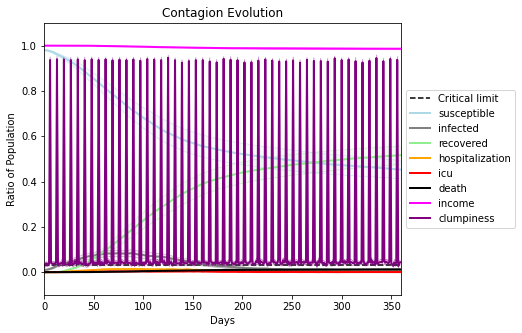

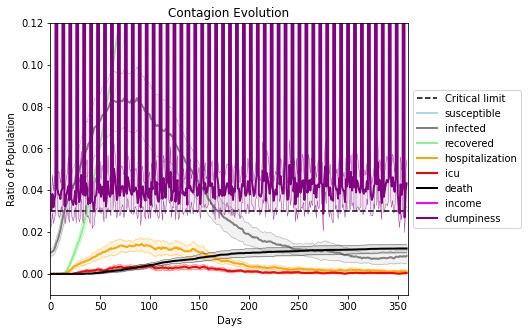

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3613, 3424, 4383, 748, 8757, 4553, 3716, 8587, 6791, 8634, 812, 2388, 7028, 2255, 7778, 397, 5669, 3360, 9238, 8063]
Average similarity between family members is 0.9034452409254715 at temperature -0.99
Average similarity between family and home is 0.9998602852048052 at temperature -1
Average similarity between students and their classroom is 0.501241301430219 at temperature -0.99
Average classroom occupancy is 4.084507042253521 and number classrooms is 71
Average similarity between workers is 0.8203214856589353 at temperature -0.99
Average office occupancy is 3.4270833333333335 and number offices is 192
Average friend similarity for adults: 0.8335291626096107 for kids: 0.6546450907436209
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.46146529256535307
avg restaurant similarity 0.4131285672381595
avg restaurant similarity 0.325962801691072
avg restaurant similarity 0.318984072659904
avg restaurant similarity 0.39051619012952987
avg restaurant similarity 0.5151964595745709
avg restaurant similarity 0.5553723620796539
avg restaurant similarity 0.41975099928275234
avg restaurant similarity 0.3310531016325429
avg restaurant similarity 0.6024860375757741
avg restaurant similarity 0.41834637240363204
avg restaurant similarity 0.468302009747138
avg restaurant similarity 0.484420841771571
avg restaurant similarity 0.5334248198889038
avg restaurant similarity 0.37235120812090583
avg restaurant similarity 0.3579585385000486
avg restaurant similarity 0.43966759867863003
avg restaurant similarity 0.5408976321193906
avg restaurant similarity 0.3281220198176634
avg restaurant similarity 0.43669189735249925
avg restaurant similarity 0.5205193709815437
avg restaurant similarity 0.48890332745388887
avg re

avg restaurant similarity 0.5032823143811567
avg restaurant similarity 0.46155709225293623
avg restaurant similarity 0.43391494518225504
avg restaurant similarity 0.7515010682165199
avg restaurant similarity 0.5663534843808923
avg restaurant similarity 0.4865021269595765
avg restaurant similarity 0.5709262131811341
avg restaurant similarity 0.4736356671214462
avg restaurant similarity 0.43316358847663655
avg restaurant similarity 0.43492818034837644
avg restaurant similarity 0.48170934111062635
avg restaurant similarity 0.393819246897933
avg restaurant similarity 0.42283375868932127
avg restaurant similarity 0.47730819534695473
avg restaurant similarity 0.3780012865237716
avg restaurant similarity 0.5042085379429001
avg restaurant similarity 0.5602408058825588
avg restaurant similarity 0.3776395070733424
avg restaurant similarity 0.5085851204067589
avg restaurant similarity 0.48602319671778665
avg restaurant similarity 0.5753979129293836
avg restaurant similarity 0.48472565322506944
av

avg restaurant similarity 0.4148859146366585
avg restaurant similarity 0.5014023649092426
avg restaurant similarity 0.503775732092699
avg restaurant similarity 0.386562993222466
avg restaurant similarity 0.43996854263978685
avg restaurant similarity 0.48775283359972665
avg restaurant similarity 0.39983922185392906
avg restaurant similarity 0.6311096089711693
avg restaurant similarity 0.5742188757966367
avg restaurant similarity 0.4454291084005478
avg restaurant similarity 0.5343352382467504
avg restaurant similarity 0.5411429704176002
avg restaurant similarity 0.49535145702754135
avg restaurant similarity 0.5741177705559531
avg restaurant similarity 0.7758516260823347
avg restaurant similarity 0.6430553846115205
avg restaurant similarity 0.6455530493328726
avg restaurant similarity 0.5646937541179414
avg restaurant similarity 0.47454788618643773
avg restaurant similarity 0.5706042518838966
avg restaurant similarity 0.42496559387214494
avg restaurant similarity 0.1906443829015768
avg re

avg restaurant similarity 0.44728415133157373
avg restaurant similarity 0.4471364786761491
avg restaurant similarity 0.43862346589070905
avg restaurant similarity 0.4343632351553889
avg restaurant similarity 0.4191980641487525
avg restaurant similarity 0.5161081342374453
avg restaurant similarity 0.2307520270814276
avg restaurant similarity 0.6045172477964775
avg restaurant similarity 0.6695365147591175
avg restaurant similarity 0.41264085758228125
avg restaurant similarity 0.609964882737212
avg restaurant similarity 0.38783591411492174
avg restaurant similarity 0.6451406797456356
avg restaurant similarity 0.3363568191567848
avg restaurant similarity 0.48972298060582414
avg restaurant similarity 0.6072808054388256
avg restaurant similarity 0.4836516476432995
avg restaurant similarity 0.45646127121220464
avg restaurant similarity 0.5410856531135493
avg restaurant similarity 0.45113902850477733
avg restaurant similarity 0.4496651137572314
avg restaurant similarity 0.5479711833978342
avg 

avg restaurant similarity 0.5451978118858057
avg restaurant similarity 0.4603955480295528
avg restaurant similarity 0.5313903549456582
avg restaurant similarity 0.38640957293736755
avg restaurant similarity 0.5699534544027115
avg restaurant similarity 0.5074010887619497
avg restaurant similarity 0.5038684529221271
avg restaurant similarity 0.4654607048112442
avg restaurant similarity 0.4386266242508768
avg restaurant similarity 0.45658671172083837
avg restaurant similarity 0.47640811118869475
avg restaurant similarity 0.5300076802752971
avg restaurant similarity 0.47802695650005295
avg restaurant similarity 0.4753079556387017
avg restaurant similarity 0.5233708282667121
avg restaurant similarity 0.6251928891318663
avg restaurant similarity 0.36840550867118366
avg restaurant similarity 0.4382137105587498
avg restaurant similarity 0.6710146424464335
avg restaurant similarity 0.5100894744271274
avg restaurant similarity 0.5006734166050526
avg restaurant similarity 0.4052280090316381
avg r

avg restaurant similarity 0.5682290770989701
avg restaurant similarity 0.5991336698123412
avg restaurant similarity 0.573522271212664
avg restaurant similarity 0.5669427674497969
avg restaurant similarity 0.6215795004443251
avg restaurant similarity 0.6125775534563275
avg restaurant similarity 0.5134882450409681
avg restaurant similarity 0.5738152741298636
avg restaurant similarity 0.5480434854094952
avg restaurant similarity 0.4413229712987883
avg restaurant similarity 0.541277816284598
avg restaurant similarity 0.5000429072576495
avg restaurant similarity 0.695316103307092
avg restaurant similarity 0.5055701739439817
avg restaurant similarity 0.81145789741639
avg restaurant similarity 0.4597842295463131
avg restaurant similarity 0.6554569419738997
avg restaurant similarity 0.5002824335811115
avg restaurant similarity 0.6273107136367233
avg restaurant similarity 0.5147410443671979
avg restaurant similarity 0.4687375282235116
avg restaurant similarity 0.4483679843022982
avg restaurant 

avg restaurant similarity 0.2961231120553491
avg restaurant similarity 0.5328051468725776
avg restaurant similarity 0.3760678453865975
avg restaurant similarity 0.40215119240813263
avg restaurant similarity 0.5489242884701871
avg restaurant similarity 0.5135674381513488
avg restaurant similarity 0.5026335791936197
avg restaurant similarity 0.5493277729092161
avg restaurant similarity 0.31899993386227776
avg restaurant similarity 0.6716245686352416
avg restaurant similarity 0.4151173707226286
avg restaurant similarity 0.573107547889503
avg restaurant similarity 0.39414337247781617
avg restaurant similarity 0.3570829695944165
avg restaurant similarity 0.6347164902848864
avg restaurant similarity 0.33042928553948364
avg restaurant similarity 0.43210748861053105
avg restaurant similarity 0.6419989630176683
avg restaurant similarity 0.427647290861099
avg restaurant similarity 0.5446282794891726
avg restaurant similarity 0.5494740529842642
avg restaurant similarity 0.4947640378615841
avg res

avg restaurant similarity 0.45657347749040234
avg restaurant similarity 0.5944226798376105
avg restaurant similarity 0.6734134287564255
avg restaurant similarity 0.36872975463867885
avg restaurant similarity 0.4403823149663064
avg restaurant similarity 0.43647076216249014
avg restaurant similarity 0.5371246865185603
avg restaurant similarity 0.4135163437500922
avg restaurant similarity 0.47040962608604364
avg restaurant similarity 0.5617790482584151
avg restaurant similarity 0.5701763109093766
avg restaurant similarity 0.7057511187421122
avg restaurant similarity 0.48648597245321223
avg restaurant similarity 0.471332072533583
avg restaurant similarity 0.6524229032121731
avg restaurant similarity 0.587096769644412
avg restaurant similarity 0.5265408475326206
avg restaurant similarity 0.284999224614258
avg restaurant similarity 0.5564638083245157
avg restaurant similarity 0.6269305119612459
avg restaurant similarity 0.525538409632906
avg restaurant similarity 0.5275606477360577
avg resta

avg restaurant similarity 0.5691543260832662
avg restaurant similarity 0.5639554100107708
avg restaurant similarity 0.37645997101160866
avg restaurant similarity 0.48769808850682167
avg restaurant similarity 0.36047957643092066
avg restaurant similarity 0.356781674593684
avg restaurant similarity 0.5539613173574153
avg restaurant similarity 0.47284736292263907
avg restaurant similarity 0.3946436258442726
avg restaurant similarity 0.35573214148222676
avg restaurant similarity 0.4517844267993114
avg restaurant similarity 0.47406300252790706
avg restaurant similarity 0.40126914245615053
avg restaurant similarity 0.40975218050733186
avg restaurant similarity 0.4292046367782838
avg restaurant similarity 0.3759794872476544
avg restaurant similarity 0.5789298478394288
avg restaurant similarity 0.4488103982736747
avg restaurant similarity 0.4547616256624121
avg restaurant similarity 0.4409945679564014
avg restaurant similarity 0.3810204249639408
avg restaurant similarity 0.28295981737167225
av

avg restaurant similarity 0.558268224630618
avg restaurant similarity 0.4726672942209734
avg restaurant similarity 0.43977342740786596
avg restaurant similarity 0.5497324918442553
avg restaurant similarity 0.5557196023348656
avg restaurant similarity 0.3758934832774365
avg restaurant similarity 0.48715976023550533
avg restaurant similarity 0.41155584729091665
avg restaurant similarity 0.3390105004243114
avg restaurant similarity 0.5219804121562404
avg restaurant similarity 0.25232741966158867
avg restaurant similarity 0.4593621763812002
avg restaurant similarity 0.41780288548185035
avg restaurant similarity 0.4395851595696376
avg restaurant similarity 0.6067914073909555
avg restaurant similarity 0.45481382846917917
avg restaurant similarity 0.38511570268109463
avg restaurant similarity 0.577985723684278
avg restaurant similarity 0.7993727063082305
avg restaurant similarity 0.5918743732375793
avg restaurant similarity 0.31746156005817355
avg restaurant similarity 0.3951581040122543
avg 

avg restaurant similarity 0.6519099217675381
avg restaurant similarity 0.5628995502403946
avg restaurant similarity 0.6401779748317168
avg restaurant similarity 0.5282918110721263
avg restaurant similarity 0.5092992700570399
avg restaurant similarity 0.46530477045987695
avg restaurant similarity 0.4728134176021089
avg restaurant similarity 0.5171427598622966
avg restaurant similarity 0.4622586733973894
avg restaurant similarity 0.4930034288993538
avg restaurant similarity 0.4940793843724476
avg restaurant similarity 0.4752378334883464
avg restaurant similarity 0.4924295214023914
avg restaurant similarity 0.44735913355686413
avg restaurant similarity 0.4685688728277246
avg restaurant similarity 0.47472313883495587
avg restaurant similarity 0.3058729746694076
avg restaurant similarity 0.4325029133242921
avg restaurant similarity 0.584595244002168
avg restaurant similarity 0.4973321232212325
avg restaurant similarity 0.43475283611974
avg restaurant similarity 0.441366854005923
avg restaur

avg restaurant similarity 0.5383743296067979
avg restaurant similarity 0.5725141454001363
avg restaurant similarity 0.4689411530914633
avg restaurant similarity 0.4718896156526718
avg restaurant similarity 0.613178148288402
avg restaurant similarity 0.5674154694250664
avg restaurant similarity 0.4589255472118267
avg restaurant similarity 0.5419040224732553
avg restaurant similarity 0.56944045206359
avg restaurant similarity 0.42909041968042677
avg restaurant similarity 0.454588040522195
avg restaurant similarity 0.3306399662718691
avg restaurant similarity 0.47808885569984677
avg restaurant similarity 0.43892881032415726
avg restaurant similarity 0.8040819984832437
avg restaurant similarity 0.5262533393256389
avg restaurant similarity 0.5918045157082981
avg restaurant similarity 0.28303747984256494
avg restaurant similarity 0.5288877249161432
avg restaurant similarity 0.5672235359331791
avg restaurant similarity 0.4963244699628827
avg restaurant similarity 0.45155860186519803
avg resta

avg restaurant similarity 0.5141488671544885
avg restaurant similarity 0.5084947204340494
avg restaurant similarity 0.42103450910254836
avg restaurant similarity 0.4355102877935824
avg restaurant similarity 0.46717416261760636
avg restaurant similarity 0.55977002943195
avg restaurant similarity 0.5463746106103573
avg restaurant similarity 0.40661293996709535
avg restaurant similarity 0.5129954450588842
avg restaurant similarity 0.47248359590636263
avg restaurant similarity 0.4441977863863052
avg restaurant similarity 0.4335657135394685
avg restaurant similarity 0.45242951288841027
avg restaurant similarity 0.45416076144520706
avg restaurant similarity 0.6492744747347442
avg restaurant similarity 0.44505727495046904
avg restaurant similarity 0.4437112661182842
avg restaurant similarity 0.40196939357705097
avg restaurant similarity 0.5501069487828025
avg restaurant similarity 0.47590896643535097
avg restaurant similarity 0.45920756608707647
avg restaurant similarity 0.5082947773081963
av

avg restaurant similarity 0.32047840700223523
avg restaurant similarity 0.5670722591437194
avg restaurant similarity 0.46991484568052316
avg restaurant similarity 0.6289461280373962
avg restaurant similarity 0.3920761388754707
avg restaurant similarity 0.5202642838103951
avg restaurant similarity 0.3826767062702897
avg restaurant similarity 0.47650528402909764
avg restaurant similarity 0.45617265239726407
avg restaurant similarity 0.5207820320347569
avg restaurant similarity 0.3626394494841164
avg restaurant similarity 0.36847156357280825
avg restaurant similarity 0.3869960595854824
avg restaurant similarity 0.403845962773632
avg restaurant similarity 0.563459633852831
avg restaurant similarity 0.4960871304394868
avg restaurant similarity 0.2325890158591299
avg restaurant similarity 0.7100758378995153
avg restaurant similarity 0.5030392696171807
avg restaurant similarity 0.5326406915431349
avg restaurant similarity 0.4461430918707083
avg restaurant similarity 0.3475033271480819
avg res

avg restaurant similarity 0.5625924559623331
avg restaurant similarity 0.6023596881572368
avg restaurant similarity 0.626911307872513
avg restaurant similarity 0.7036282702435769
avg restaurant similarity 0.5585045966902558
avg restaurant similarity 0.5853587361221183
avg restaurant similarity 0.5211243613372563
avg restaurant similarity 0.7034821897053757
avg restaurant similarity 0.5279384108940716
avg restaurant similarity 0.5325179037580375
avg restaurant similarity 0.45932077077852435
avg restaurant similarity 0.7723093120482913
avg restaurant similarity 0.6802710934032858
avg restaurant similarity 0.3468543169563212
avg restaurant similarity 0.3111003137479908
avg restaurant similarity 0.43297131639461406
avg restaurant similarity 0.7646669768717852
avg restaurant similarity 0.34118873872315825
avg restaurant similarity 0.6445533356049586
avg restaurant similarity 0.6769396289561459
avg restaurant similarity 0.5142558004776897
avg restaurant similarity 0.44044602273836037
avg res

avg restaurant similarity 0.867095725316616
avg restaurant similarity 0.5742724215904268
avg restaurant similarity 0.4470861766029511
avg restaurant similarity 0.6732557711926251
avg restaurant similarity 0.3862072011908974
avg restaurant similarity 0.502875323224448
avg restaurant similarity 0.5855392509891383
avg restaurant similarity 0.4926023210343651
avg restaurant similarity 0.40860357751339726
avg restaurant similarity 0.680693589369898
avg restaurant similarity 0.41765499110923177
avg restaurant similarity 0.480594934709881
avg restaurant similarity 0.6267265162323585
avg restaurant similarity 0.42922278286467014
avg restaurant similarity 0.5299761778908074
avg restaurant similarity 0.5673525028508749
avg restaurant similarity 0.6166983386141515
avg restaurant similarity 0.5245310302681109
avg restaurant similarity 0.4598927718275845
avg restaurant similarity 0.6825231208332037
avg restaurant similarity 0.5678589913641321
avg restaurant similarity 0.4631401965351149
avg restaur

avg restaurant similarity 0.4936621124288121
avg restaurant similarity 0.5781179454290267
avg restaurant similarity 0.3689271269950414
avg restaurant similarity 0.6278174732282318
avg restaurant similarity 0.37829022077515895
avg restaurant similarity 0.6884375652840596
avg restaurant similarity 0.5724310344625876
avg restaurant similarity 0.765814936976648
avg restaurant similarity 0.6064842916227466
avg restaurant similarity 0.6379440465039209
avg restaurant similarity 0.4090710782445399
avg restaurant similarity 0.5365643380147089
avg restaurant similarity 0.29524655964225577
avg restaurant similarity 0.4373508483372928
avg restaurant similarity 0.5492388560149047
avg restaurant similarity 0.44392048897312963
avg restaurant similarity 0.4510317312700012
avg restaurant similarity 0.6141206336154514
avg restaurant similarity 0.5576482415177942
avg restaurant similarity 0.322629260116479
avg restaurant similarity 0.4090710782445399
avg restaurant similarity 0.40416029399368614
avg rest

avg restaurant similarity 0.4069868493108493
avg restaurant similarity 0.613991798122374
avg restaurant similarity 0.5285103315166756
avg restaurant similarity 0.5543417231978581
avg restaurant similarity 0.5016171987918172
avg restaurant similarity 0.49682429588917015
avg restaurant similarity 0.5358737209843442
avg restaurant similarity 0.7649487039554989
avg restaurant similarity 0.6270195373485559
avg restaurant similarity 0.4679630648583362
avg restaurant similarity 0.47696817529192986
avg restaurant similarity 0.3658501691805095
avg restaurant similarity 0.6955878826208699
avg restaurant similarity 0.7335421875186764
avg restaurant similarity 0.45387295170287245
avg restaurant similarity 0.5529007891158096
avg restaurant similarity 0.5126977987581961
avg restaurant similarity 0.7019948914847683
avg restaurant similarity 0.6173556537742049
avg restaurant similarity 0.5674723861283534
avg restaurant similarity 0.36802709956943747
avg restaurant similarity 0.6225548204538589
avg res

avg restaurant similarity 0.42849300906360466
avg restaurant similarity 0.4707429970878406
avg restaurant similarity 0.6756484397530133
avg restaurant similarity 0.42808449376871494
avg restaurant similarity 0.6216874602748068
avg restaurant similarity 0.45994210959067666
avg restaurant similarity 0.37143300991159994
avg restaurant similarity 0.4463597423561532
avg restaurant similarity 0.47293208460725045
avg restaurant similarity 0.47256052256922365
avg restaurant similarity 0.48199255618335546
avg restaurant similarity 0.6055567215473192
avg restaurant similarity 0.38828422188309253
avg restaurant similarity 0.5366731283999038
avg restaurant similarity 0.4687523785274046
avg restaurant similarity 0.4977202261855256
avg restaurant similarity 0.588287944366276
avg restaurant similarity 0.49251530747517236
avg restaurant similarity 0.3863098559378261
avg restaurant similarity 0.4385416750286792
avg restaurant similarity 0.45123451367728307
avg restaurant similarity 0.5337005295785582
a

avg restaurant similarity 0.5169655888166687
avg restaurant similarity 0.4810729643485811
avg restaurant similarity 0.5766769087258063
avg restaurant similarity 0.45878801714876044
avg restaurant similarity 0.4593095298807748
avg restaurant similarity 0.6343936598850196
avg restaurant similarity 0.5212191428074439
avg restaurant similarity 0.593702902362305
avg restaurant similarity 0.4787946823619444
avg restaurant similarity 0.42594090096141735
avg restaurant similarity 0.3039409029567361
avg restaurant similarity 0.5237731725428567
avg restaurant similarity 0.4739539496239384
avg restaurant similarity 0.4304357443007005
avg restaurant similarity 0.47349037157089224
avg restaurant similarity 0.4796871055150156
avg restaurant similarity 0.4191815212658127
avg restaurant similarity 0.4903924538815111
avg restaurant similarity 0.632639986643914
avg restaurant similarity 0.41898851403370513
avg restaurant similarity 0.5243471592389997
avg restaurant similarity 0.4836864308662827
avg rest

avg restaurant similarity 0.6347502665404641
avg restaurant similarity 0.48170984950092066
avg restaurant similarity 0.7708709072330555
avg restaurant similarity 0.5090851128992607
avg restaurant similarity 0.6285770670584817
avg restaurant similarity 0.4527385411543619
avg restaurant similarity 0.6672480300963348
avg restaurant similarity 0.4705680677230691
avg restaurant similarity 0.6668787898328877
avg restaurant similarity 0.6260902480724067
avg restaurant similarity 0.5498777444237425
avg restaurant similarity 0.5529141466003816
avg restaurant similarity 0.7771622214639209
avg restaurant similarity 0.6936212138745578
avg restaurant similarity 0.5775157974279669
avg restaurant similarity 0.7639272925041168
avg restaurant similarity 0.2892119297747169
avg restaurant similarity 0.9998014813969487
avg restaurant similarity 0.44205337407702483
avg restaurant similarity 0.5195599599064304
avg restaurant similarity 0.9501291113566261
avg restaurant similarity 0.3953871627671936
avg rest

avg restaurant similarity 0.5502009690838002
avg restaurant similarity 0.5330765471424481
avg restaurant similarity 0.4373356206091645
avg restaurant similarity 0.4472065052728617
avg restaurant similarity 0.5325149560383345
avg restaurant similarity 0.42173513161214393
avg restaurant similarity 0.5322662661702513
avg restaurant similarity 0.4417488211189632
avg restaurant similarity 0.4596899871916583
avg restaurant similarity 0.5107822582439085
avg restaurant similarity 0.6077582391708568
avg restaurant similarity 0.7457116410559925
avg restaurant similarity 0.4438263595008986
avg restaurant similarity 0.46630652541020773
avg restaurant similarity 0.5831599126006294
avg restaurant similarity 0.41569604524336984
avg restaurant similarity 0.5528534747536701
avg restaurant similarity 0.4501410175150786
avg restaurant similarity 0.4781880655064993
avg restaurant similarity 0.5740505559704068
avg restaurant similarity 0.46967517538514153
avg restaurant similarity 0.6182632357900499
avg re

avg restaurant similarity 0.5908545566438338
avg restaurant similarity 0.6300748252277059
avg restaurant similarity 0.4475883093585677
avg restaurant similarity 0.49911806022091415
avg restaurant similarity 0.5806729560382877
avg restaurant similarity 0.4918948930750271
avg restaurant similarity 0.5701971785256764
avg restaurant similarity 0.6330067844358767
avg restaurant similarity 0.5705150966897209
avg restaurant similarity 0.5644394570452798
avg restaurant similarity 0.580220506908364
avg restaurant similarity 0.5559254301978516
avg restaurant similarity 0.449748720758814
avg restaurant similarity 0.46610779524187856
avg restaurant similarity 0.5904700876982587
avg restaurant similarity 0.5828155852402419
avg restaurant similarity 0.746469927842125
avg restaurant similarity 0.5953129534283272
avg restaurant similarity 0.6197570607631936
avg restaurant similarity 0.614516614640691
avg restaurant similarity 0.7741442029936452
avg restaurant similarity 0.5661871234662998
avg restaura

avg restaurant similarity 0.583342671871202
avg restaurant similarity 0.4933856932094648
avg restaurant similarity 0.5034777701322365
avg restaurant similarity 0.6099984146491956
avg restaurant similarity 0.5652709797833742
avg restaurant similarity 0.5799555895754427
avg restaurant similarity 0.49634166286754644
avg restaurant similarity 0.572683393311443
avg restaurant similarity 0.550878311200904
avg restaurant similarity 0.5605417487380439
avg restaurant similarity 0.5779754802935896
avg restaurant similarity 0.4970718074574283
avg restaurant similarity 0.6043336736842537
avg restaurant similarity 0.5931284329745141
avg restaurant similarity 0.7080276089720454
avg restaurant similarity 0.3707626347153362
avg restaurant similarity 0.5323313930184519
avg restaurant similarity 0.7548525278337925
avg restaurant similarity 0.586089590745819
avg restaurant similarity 0.6532730681479271
avg restaurant similarity 0.5713063501822737
avg restaurant similarity 0.6305498337571043
avg restauran

avg restaurant similarity 0.5350287987609331
avg restaurant similarity 0.7570760085856332
avg restaurant similarity 0.7372754448567065
avg restaurant similarity 0.4563017832893821
avg restaurant similarity 0.5495050420435551
avg restaurant similarity 0.6938872078997034
avg restaurant similarity 0.7636295007677809
avg restaurant similarity 0.5184650056084557
avg restaurant similarity 0.4413080397603612
avg restaurant similarity 0.5864385488495409
avg restaurant similarity 0.5733457228126325
avg restaurant similarity 0.5691228430427064
avg restaurant similarity 0.7937456972846677
avg restaurant similarity 0.47812216295298543
avg restaurant similarity 0.5820704709967207
avg restaurant similarity 0.3968149510443837
avg restaurant similarity 0.7297878123607455
avg restaurant similarity 0.7664607444890484
avg restaurant similarity 0.6181884904152073
avg restaurant similarity 0.37950251902292925
avg restaurant similarity 0.5660676672217368
avg restaurant similarity 0.4006576681472263
avg rest

avg restaurant similarity 0.520468493308342
avg restaurant similarity 0.5889755735932826
avg restaurant similarity 0.635359411309712
avg restaurant similarity 0.6327245180295339
avg restaurant similarity 0.49020436812898677
avg restaurant similarity 0.8772871255910271
avg restaurant similarity 0.5053465476961723
avg restaurant similarity 0.6426935970715272
avg restaurant similarity 0.7051134826430216
avg restaurant similarity 0.6166746655385837
avg restaurant similarity 0.4174298521461202
avg restaurant similarity 0.7266002252339449
avg restaurant similarity 0.5476271405611637
avg restaurant similarity 0.46690684305396923
avg restaurant similarity 0.5304446522188498
avg restaurant similarity 0.7536820155919371
avg restaurant similarity 0.6769440790970938
avg restaurant similarity 0.47188487083497227
avg restaurant similarity 0.611817575078505
avg restaurant similarity 0.5721874335485957
avg restaurant similarity 0.22449104869429656
avg restaurant similarity 0.3779048080422978
avg resta

avg restaurant similarity 0.5286099461085286
avg restaurant similarity 0.5144631118430957
avg restaurant similarity 0.5595963338234144
avg restaurant similarity 0.43314018250060315
avg restaurant similarity 0.46995439453340326
avg restaurant similarity 0.43793080020022573
avg restaurant similarity 0.47187294076068637
avg restaurant similarity 0.41350676396792474
avg restaurant similarity 0.7018301999323588
avg restaurant similarity 0.33963456757640875
avg restaurant similarity 0.37433353650774187
avg restaurant similarity 0.4522091057197762
avg restaurant similarity 0.5248075434776195
avg restaurant similarity 0.4538604206707123
avg restaurant similarity 0.33310087300689406
avg restaurant similarity 0.47983362407342867
avg restaurant similarity 0.38093115060766997
avg restaurant similarity 0.41885367063427476
avg restaurant similarity 0.3785806537615563
avg restaurant similarity 0.40289111253107884
avg restaurant similarity 0.45237068391377366
avg restaurant similarity 0.62199883903840

avg restaurant similarity 0.5284302586195359
avg restaurant similarity 0.705772737336928
avg restaurant similarity 0.5022329172521729
avg restaurant similarity 0.4758234641082839
avg restaurant similarity 0.6816494028219786
avg restaurant similarity 0.3469281224795377
avg restaurant similarity 0.35327839865165994
avg restaurant similarity 0.5212550792569741
avg restaurant similarity 0.5117309256456571
avg restaurant similarity 0.5376052814812086
avg restaurant similarity 0.18344192855935007
avg restaurant similarity 0.37388005322168716
avg restaurant similarity 0.48412989019756847
avg restaurant similarity 0.5166843818678631
avg restaurant similarity 0.3988999268699477
avg restaurant similarity 0.5467888037473587
avg restaurant similarity 0.5819883100747715
avg restaurant similarity 0.5103965665687196
avg restaurant similarity 0.36864662496016193
avg restaurant similarity 0.34476687820083973
avg restaurant similarity 0.5990165601194397
avg restaurant similarity 0.5095048382641906
avg r

avg restaurant similarity 0.4519956122243996
avg restaurant similarity 0.4378405531833107
avg restaurant similarity 0.5731200946877392
avg restaurant similarity 0.46228319809668383
avg restaurant similarity 0.8032746435783639
avg restaurant similarity 0.44314195913053034
avg restaurant similarity 0.5144083553524745
avg restaurant similarity 0.5037802556761711
avg restaurant similarity 0.5244070684301713
avg restaurant similarity 0.4750758203214964
avg restaurant similarity 0.48735066834723395
avg restaurant similarity 0.44380164701996344
avg restaurant similarity 0.5086601380104776
avg restaurant similarity 0.37462704787262746
avg restaurant similarity 0.5502637268861461
avg restaurant similarity 0.6258267023691004
avg restaurant similarity 0.5421233515203515
avg restaurant similarity 0.4945879811583834
avg restaurant similarity 0.3650916937802642
avg restaurant similarity 0.4072829075492419
avg restaurant similarity 0.3769740401282078
avg restaurant similarity 0.4297768799668357
avg r

avg restaurant similarity 0.3836049685104983
avg restaurant similarity 0.5790792270634607
avg restaurant similarity 0.32101412312218475
avg restaurant similarity 0.4592536083083344
avg restaurant similarity 0.5581602237122246
avg restaurant similarity 0.5555531330783219
avg restaurant similarity 0.418715810451173
avg restaurant similarity 0.38620505837922875
avg restaurant similarity 0.3710980097603849
avg restaurant similarity 0.41222261521029596
avg restaurant similarity 0.5413670442674479
avg restaurant similarity 0.5019133086601163
avg restaurant similarity 0.6317191490526797
avg restaurant similarity 0.7809280766493873
avg restaurant similarity 0.5065973384644091
avg restaurant similarity 0.3699746464716243
avg restaurant similarity 0.4589088768325693
avg restaurant similarity 0.643279027508125
avg restaurant similarity 0.3871779924421805
avg restaurant similarity 0.5717952124909622
avg restaurant similarity 0.608498567371815
avg restaurant similarity 0.5129400518620619
avg restau

avg restaurant similarity 0.3094597583535192
avg restaurant similarity 0.6255929815366902
avg restaurant similarity 0.4409999380340587
avg restaurant similarity 0.5512684704441203
avg restaurant similarity 0.6015933429936668
avg restaurant similarity 0.2548803256176836
avg restaurant similarity 0.43953209075933203
avg restaurant similarity 0.4799665073035603
avg restaurant similarity 0.5510984234143719
avg restaurant similarity 0.44612886309131916
avg restaurant similarity 0.47948274208708197
avg restaurant similarity 0.4848793802187228
avg restaurant similarity 0.3460563008964872
avg restaurant similarity 0.5710613352839196
avg restaurant similarity 0.41842554698320533
avg restaurant similarity 0.45317839512904273
avg restaurant similarity 0.5986249314011007
avg restaurant similarity 0.0768092081450536
avg restaurant similarity 0.7021160898168858
avg restaurant similarity 0.5399123478470789
avg restaurant similarity 0.3537339149129624
avg restaurant similarity 0.5749249040483716
avg r

avg restaurant similarity 0.5876241881176387
avg restaurant similarity 0.5058095619684555
avg restaurant similarity 0.4023579288605332
avg restaurant similarity 0.5716138340880089
avg restaurant similarity 0.5116429348587644
avg restaurant similarity 0.30258713647864616
avg restaurant similarity 0.41264679342699273
avg restaurant similarity 0.36360936935153393
avg restaurant similarity 0.4515407318529665
avg restaurant similarity 0.28511357064259435
avg restaurant similarity 0.5179556053308685
avg restaurant similarity 0.8970417177963872
avg restaurant similarity 0.43768865980292593
avg restaurant similarity 0.2518251506083139
avg restaurant similarity 0.573903207635872
avg restaurant similarity 0.48874803503356334
avg restaurant similarity 0.39312968360969636
avg restaurant similarity 0.35217064497462175
avg restaurant similarity 0.44369131740195655
avg restaurant similarity 0.416938371208799
avg restaurant similarity 0.3676961535151751
avg restaurant similarity 0.5572244993000077
avg

avg restaurant similarity 0.7192269970176403
avg restaurant similarity 0.5346959031046591
avg restaurant similarity 0.7087418797153467
avg restaurant similarity 0.5628818293292089
avg restaurant similarity 0.5746212945538538
avg restaurant similarity 0.6133284593645019
avg restaurant similarity 0.5864212827897322
avg restaurant similarity 0.6488575802894683
avg restaurant similarity 0.54283245791321
avg restaurant similarity 0.5000955338321937
avg restaurant similarity 0.5154784395237824
avg restaurant similarity 0.6814634759435386
avg restaurant similarity 0.5094455344238072
avg restaurant similarity 0.3656047465397021
avg restaurant similarity 0.5051634545864756
avg restaurant similarity 0.7771474033751864
avg restaurant similarity 0.6530908774218872
avg restaurant similarity 0.7017116290883143
avg restaurant similarity 0.5365772672543306
avg restaurant similarity 0.5158993387168117
avg restaurant similarity 0.519028913153797
avg restaurant similarity 0.6233570579268235
avg restauran

avg restaurant similarity 0.4353174346614811
avg restaurant similarity 0.5214290734118643
avg restaurant similarity 0.5140851477172911
avg restaurant similarity 0.8918168392686603
avg restaurant similarity 0.32538523031342603
avg restaurant similarity 0.4848864705107576
avg restaurant similarity 0.6247901659001068
avg restaurant similarity 0.4271899420451821
avg restaurant similarity 0.36720556641530716
avg restaurant similarity 0.5486417545741066
avg restaurant similarity 0.6170745796869217
avg restaurant similarity 0.5476900172569338
avg restaurant similarity 0.39106689306344755
avg restaurant similarity 0.5129663660547175
avg restaurant similarity 0.49630055866088796
avg restaurant similarity 0.698741021243159
avg restaurant similarity 0.6293387509874125
avg restaurant similarity 0.3964303432992679
avg restaurant similarity 0.46383926884169235
avg restaurant similarity 0.5335112135631114
avg restaurant similarity 0.5034587895125646
avg restaurant similarity 0.5639746805626952
avg re

avg restaurant similarity 0.3924761269510324
avg restaurant similarity 0.5120246002800359
avg restaurant similarity 0.33070900282817917
avg restaurant similarity 0.40347501591456725
avg restaurant similarity 0.3991132872990965
avg restaurant similarity 0.2837787994824833
avg restaurant similarity 0.5193327331654682
avg restaurant similarity 0.42117371125236513
avg restaurant similarity 0.32938328590739196
avg restaurant similarity 0.3651246987943505
avg restaurant similarity 0.4746431087564129
avg restaurant similarity 0.47301324511597626
avg restaurant similarity 0.5748618151976151
avg restaurant similarity 0.43796464855616846
avg restaurant similarity 0.5557551440906949
avg restaurant similarity 0.5498265621148349
avg restaurant similarity 0.48631726806460224
avg restaurant similarity 0.4770479964609653
avg restaurant similarity 0.46182286966326974
avg restaurant similarity 0.46525429985838096
avg restaurant similarity 0.4971316016036524
avg restaurant similarity 0.4463214229497418
a

avg restaurant similarity 0.6325905215511779
avg restaurant similarity 0.49127954139068225
avg restaurant similarity 0.5926846124583444
avg restaurant similarity 0.3851002204141379
avg restaurant similarity 0.409962301683444
avg restaurant similarity 0.3857503986569304
avg restaurant similarity 0.4400829558692533
avg restaurant similarity 0.42713140979334346
avg restaurant similarity 0.297098737161401
avg restaurant similarity 0.4658799974280183
avg restaurant similarity 0.46972380619423887
avg restaurant similarity 0.3426041743240436
avg restaurant similarity 0.37957845626948444
avg restaurant similarity 0.34661114021682465
avg restaurant similarity 0.5569097910602615
avg restaurant similarity 0.5930261799844716
avg restaurant similarity 0.32163685520766905
avg restaurant similarity 0.2849915054799745
avg restaurant similarity 0.3891722067713119
avg restaurant similarity 0.335438300714796
avg restaurant similarity 0.43855434083057765
avg restaurant similarity 0.40930857134774656
avg r

avg restaurant similarity 0.6180591470981655
avg restaurant similarity 0.45233292724832813
avg restaurant similarity 0.42810037402151396
avg restaurant similarity 0.48757787221288873
avg restaurant similarity 0.4488343643810623
avg restaurant similarity 0.4726353485934265
avg restaurant similarity 0.3874584815927923
avg restaurant similarity 0.46650259613818335
avg restaurant similarity 0.48824863383147954
avg restaurant similarity 0.3405965176614431
avg restaurant similarity 0.4618491753305851
avg restaurant similarity 0.45474280875304185
avg restaurant similarity 0.5399792537718999
avg restaurant similarity 0.3420271814547417
avg restaurant similarity 0.4706793384804513
avg restaurant similarity 0.471294080779417
avg restaurant similarity 0.502399321803711
avg restaurant similarity 0.4577499788058634
avg restaurant similarity 0.35733564300813514
avg restaurant similarity 0.48383399320252085
avg restaurant similarity 0.47643779256134244
avg restaurant similarity 0.5435744014377231
avg

avg restaurant similarity 0.4953548224591729
avg restaurant similarity 0.4835182891201102
avg restaurant similarity 0.4809291141008283
avg restaurant similarity 0.40602123491095804
avg restaurant similarity 0.46182917222331055
avg restaurant similarity 0.6157063314653889
avg restaurant similarity 0.5235871488120089
avg restaurant similarity 0.5470829962763163
avg restaurant similarity 0.5227717309229034
avg restaurant similarity 0.5343830017314757
avg restaurant similarity 0.39697303994981714
avg restaurant similarity 0.5722359237702781
avg restaurant similarity 0.4827399542939087
avg restaurant similarity 0.5327253088730068
avg restaurant similarity 0.5808356351255872
avg restaurant similarity 0.3249349946024973
avg restaurant similarity 0.4708004945186465
avg restaurant similarity 0.4298923976579562
avg restaurant similarity 0.6231023416461354
avg restaurant similarity 0.48938196979361553
avg restaurant similarity 0.3919981701261822
avg restaurant similarity 0.5716276903361659
avg re

avg restaurant similarity 0.5059692393300812
avg restaurant similarity 0.41105564995689725
avg restaurant similarity 0.5078874096486422
avg restaurant similarity 0.5603314188765719
avg restaurant similarity 0.6840585121941992
avg restaurant similarity 0.5153804101095312
avg restaurant similarity 0.45003470362788844
avg restaurant similarity 0.444192594736859
avg restaurant similarity 0.5622760514047607
avg restaurant similarity 0.49764582747786484
avg restaurant similarity 0.5218363380316229
avg restaurant similarity 0.5540887225619324
avg restaurant similarity 0.43480030485783205
avg restaurant similarity 0.5661555438926767
avg restaurant similarity 0.6714905761799769
avg restaurant similarity 0.4043750399782899
avg restaurant similarity 0.835830352868451
avg restaurant similarity 0.5039450656586181
avg restaurant similarity 0.45393066523718745
avg restaurant similarity 0.8407754633043926
avg restaurant similarity 0.9998620481180882
avg restaurant similarity 0.575413687916313
avg rest

avg restaurant similarity 0.5854523459587461
avg restaurant similarity 0.49232769917747365
avg restaurant similarity 0.5906684879506
avg restaurant similarity 0.9997996544096042
avg restaurant similarity 0.48480266292133695
avg restaurant similarity 0.5639760618900677
avg restaurant similarity 0.8706808649308176
avg restaurant similarity 0.4150830412237635
avg restaurant similarity 0.6142044926206383
avg restaurant similarity 0.41714279878435034
avg restaurant similarity 0.6950628281545933
avg restaurant similarity 0.34374098147373716
avg restaurant similarity 0.6990112087779582
avg restaurant similarity 0.46933913853787584
avg restaurant similarity 0.5246067638142807
avg restaurant similarity 0.5201779104684212
avg restaurant similarity 0.5847189527620906
avg restaurant similarity 0.5497735530182896
avg restaurant similarity 0.6206205087130136
avg restaurant similarity 0.5698909576504629
avg restaurant similarity 0.4672859580938583
avg restaurant similarity 0.5603326745802285
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

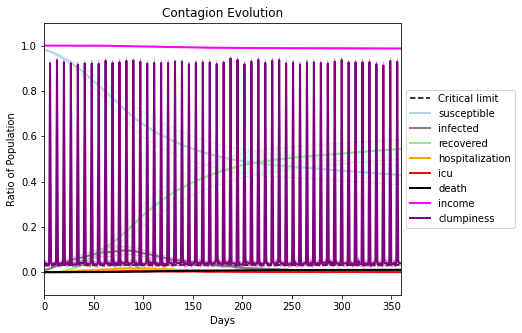

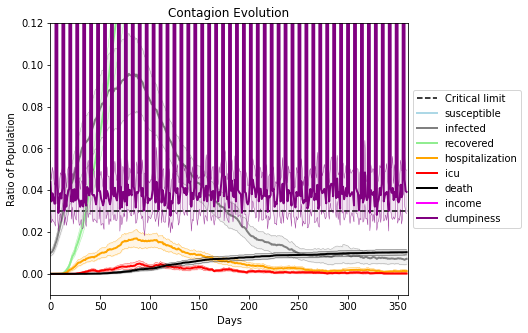

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[7083, 9327, 70, 6374, 2920, 3819, 3239, 5094, 1791, 5091, 7233, 8692, 9549, 9110, 9645, 6718, 5310, 4732, 8063, 4090]
Average similarity between family members is 0.5585288508406535 at temperature -0.9
Average similarity between family and home is 0.999859322135417 at temperature -1
Average similarity between students and their classroom is 0.20010414763244716 at temperature -0.9
Average classroom occupancy is 4.305555555555555 and number classrooms is 72
Average similarity between workers is 0.4479565221230177 at temperature -0.9
Average office occupancy is 3.2974358974358973 and number offices is 195
Average friend similarity for adults: 0.5913878749246481 for kids: 0.4670354981811907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity -0.0982754762221568
avg restaurant similarity 0.19451343662379542
avg restaurant similarity 0.1455484726170512
avg restaurant similarity 0.21528117936164454
avg restaurant similarity -0.1461804076733402
avg restaurant similarity 0.12332553240423272
avg restaurant similarity 0.18111815175132603
avg restaurant similarity 0.13106521700730892
avg restaurant similarity 0.23034725432984826
avg restaurant similarity 0.20730681531795966
avg restaurant similarity -0.05310076938839289
avg restaurant similarity 0.02633946928091111
avg restaurant similarity 0.1124570360824357
avg restaurant similarity 0.11676173384620592
avg restaurant similarity 0.36371734507472114
avg restaurant similarity -0.005442743133627831
avg restaurant similarity 0.47242687512267184
avg restaurant similarity 0.13845000464133358
avg restaurant similarity 0.21052047105859661
avg restaurant similarity 0.21136338565706894
avg restaurant similarity 0.23862617824536064
avg restaurant similarity 0.15473

avg restaurant similarity 0.2176328346261489
avg restaurant similarity -0.03138754142726931
avg restaurant similarity 0.14945024726652567
avg restaurant similarity 0.31915994760847066
avg restaurant similarity 0.23416661936961686
avg restaurant similarity 0.1937230689369173
avg restaurant similarity 0.18144020018631657
avg restaurant similarity 0.07860564574207722
avg restaurant similarity 0.1231831584976354
avg restaurant similarity 0.06167504981668164
avg restaurant similarity 0.18374549026018103
avg restaurant similarity 0.02499648824617538
avg restaurant similarity 0.16537003755914398
avg restaurant similarity 0.410084400043274
avg restaurant similarity 0.17770713383967957
avg restaurant similarity -0.18179352954533748
avg restaurant similarity 0.07938150489464597
avg restaurant similarity 0.5697491002066098
avg restaurant similarity 0.09639517305362885
avg restaurant similarity -0.014707957555792864
avg restaurant similarity 0.36717606018773724
avg restaurant similarity 0.32630821

avg restaurant similarity 0.08059603949605301
avg restaurant similarity 0.10152688573965307
avg restaurant similarity -0.04952644157725193
avg restaurant similarity 0.21789405394985772
avg restaurant similarity 0.10716198765890969
avg restaurant similarity 0.5067235889389987
avg restaurant similarity 0.06596863962223214
avg restaurant similarity 0.339195343253599
avg restaurant similarity 0.1970029158439358
avg restaurant similarity 0.20303118928679909
avg restaurant similarity 0.0718638891636679
avg restaurant similarity 0.15515523696623398
avg restaurant similarity 0.10732237370037373
avg restaurant similarity 0.3312404820986049
avg restaurant similarity -0.004004143752235591
avg restaurant similarity -0.0900382010303202
avg restaurant similarity 0.2954175840324423
avg restaurant similarity 0.011382527310293683
avg restaurant similarity 0.33977458165549046
avg restaurant similarity 0.04582228192767958
avg restaurant similarity 0.10202326074595204
avg restaurant similarity 0.105434454

avg restaurant similarity 0.1592381854895702
avg restaurant similarity 0.15962570784517627
avg restaurant similarity 0.0739904455293878
avg restaurant similarity 0.1597338011333646
avg restaurant similarity 0.09837393082400576
avg restaurant similarity 0.07470061160690918
avg restaurant similarity 0.35527054273909797
avg restaurant similarity 0.12112601132852203
avg restaurant similarity 0.32746396033620095
avg restaurant similarity 0.069355652342385
avg restaurant similarity 0.013725682080280294
avg restaurant similarity 0.14971392158399918
avg restaurant similarity 0.15200620873154938
avg restaurant similarity 0.12066337516878692
avg restaurant similarity 0.08504923865763936
avg restaurant similarity 0.0860642215860287
avg restaurant similarity 0.15262002440232444
avg restaurant similarity 0.2132446597472854
avg restaurant similarity -0.010325601359040633
avg restaurant similarity 0.09596023669160002
avg restaurant similarity -0.07039410593104953
avg restaurant similarity 0.045347699

avg restaurant similarity 0.3278932522306784
avg restaurant similarity 0.3239951510244498
avg restaurant similarity 0.17528102898982087
avg restaurant similarity 0.1647866228035308
avg restaurant similarity 0.14782029924081141
avg restaurant similarity 0.17284906639661188
avg restaurant similarity -0.1325844631655953
avg restaurant similarity 0.2022252897383843
avg restaurant similarity 0.1135555118476179
avg restaurant similarity -0.021555274482149996
avg restaurant similarity 0.05389457398815256
avg restaurant similarity 0.0418109866615147
avg restaurant similarity -0.17019251123012993
avg restaurant similarity -0.057207744568550434
avg restaurant similarity 0.11968318511786982
avg restaurant similarity 0.21169510982628684
avg restaurant similarity 0.2426505968655725
avg restaurant similarity 0.10967326846294172
avg restaurant similarity 0.2455391633206133
avg restaurant similarity 0.20134911262684718
avg restaurant similarity 0.411332526190287
avg restaurant similarity 0.03949812976

avg restaurant similarity 0.26849592376171333
avg restaurant similarity 0.17370952844147394
avg restaurant similarity 0.07096931439283097
avg restaurant similarity 0.14284515199121325
avg restaurant similarity -0.0012917893935962728
avg restaurant similarity 0.20276221273249204
avg restaurant similarity 0.14121766645354056
avg restaurant similarity -0.05239366886303962
avg restaurant similarity 0.3659150154663886
avg restaurant similarity 0.10176792768439132
avg restaurant similarity -0.11779391220815316
avg restaurant similarity 0.053543779574851014
avg restaurant similarity 0.1500934599252285
avg restaurant similarity 0.3048197936536276
avg restaurant similarity 0.4024700841646114
avg restaurant similarity 0.23969839872782017
avg restaurant similarity 0.0743704854178623
avg restaurant similarity -0.0573904102797756
avg restaurant similarity 0.20263056145443728
avg restaurant similarity -0.03971058258351198
avg restaurant similarity 0.28865597351253836
avg restaurant similarity 0.3881

avg restaurant similarity 0.06891110238778797
avg restaurant similarity 0.2821135216133647
avg restaurant similarity 0.09660487554611201
avg restaurant similarity 0.13001566814579849
avg restaurant similarity 0.2177840698448655
avg restaurant similarity 0.12244302459950082
avg restaurant similarity 0.2753164596607263
avg restaurant similarity 0.18269595979784958
avg restaurant similarity 0.1816670734448411
avg restaurant similarity 0.19978861386041902
avg restaurant similarity 0.2925227512029189
avg restaurant similarity 0.057798610413127595
avg restaurant similarity 0.09019175147202649
avg restaurant similarity 0.08620251890950997
avg restaurant similarity 0.2983438881483219
avg restaurant similarity 0.17353883361030342
avg restaurant similarity 0.12811785241786852
avg restaurant similarity 0.11768168481478557
avg restaurant similarity -0.012456214787992272
avg restaurant similarity 0.5768321417922715
avg restaurant similarity 0.13346994990480274
avg restaurant similarity 0.1605219107

avg restaurant similarity 0.2405225106954233
avg restaurant similarity 0.10810792397575025
avg restaurant similarity 0.2592171718431505
avg restaurant similarity 0.20422121291822137
avg restaurant similarity 0.2990279327781939
avg restaurant similarity 0.07391662418855412
avg restaurant similarity 0.08096680295832719
avg restaurant similarity 0.23677138468100392
avg restaurant similarity 0.12162202677906436
avg restaurant similarity 0.13055612758935767
avg restaurant similarity -0.4178077560836654
avg restaurant similarity 0.08315437768388345
avg restaurant similarity 0.24177598542138082
avg restaurant similarity 0.23732696994292335
avg restaurant similarity 0.24827259653863856
avg restaurant similarity 0.05872125438138864
avg restaurant similarity 0.10896733913234198
avg restaurant similarity 0.16100131101839488
avg restaurant similarity 0.2734010928192292
avg restaurant similarity 0.34278610438757634
avg restaurant similarity 0.20383457883802122
avg restaurant similarity 0.3625230632

avg restaurant similarity -0.02425572700579043
avg restaurant similarity -0.07414526976077729
avg restaurant similarity 0.338165395612008
avg restaurant similarity 0.19491873733500328
avg restaurant similarity 0.3074887181428598
avg restaurant similarity 0.31686645673602926
avg restaurant similarity 0.05205660895648178
avg restaurant similarity 0.26965426551422966
avg restaurant similarity 0.04821947767759092
avg restaurant similarity -0.03750877521776955
avg restaurant similarity -0.09990883396926224
avg restaurant similarity -0.04874568748658743
avg restaurant similarity 0.03761647154080995
avg restaurant similarity 0.10871269775442183
avg restaurant similarity -0.1551542098502705
avg restaurant similarity 0.03179251915715945
avg restaurant similarity 0.11616117010577642
avg restaurant similarity 0.18309636504253055
avg restaurant similarity 0.11951477944451694
avg restaurant similarity 0.24374299049899353
avg restaurant similarity -0.2456983631638811
avg restaurant similarity -0.453

avg restaurant similarity 0.09000987350315294
avg restaurant similarity 0.12721580984320235
avg restaurant similarity 0.050950571540337074
avg restaurant similarity 0.024188075800371345
avg restaurant similarity 0.11018668415724613
avg restaurant similarity 0.15174656087414454
avg restaurant similarity 0.18219394423104854
avg restaurant similarity -0.12581498523534257
avg restaurant similarity 0.16165803100128323
avg restaurant similarity 0.3427347404664875
avg restaurant similarity 0.13669462010249847
avg restaurant similarity -0.09048297338854684
avg restaurant similarity -0.010165791311320917
avg restaurant similarity -0.17186857339759654
avg restaurant similarity 0.04985409840626712
avg restaurant similarity 0.20259477584647148
avg restaurant similarity 0.02624051386355096
avg restaurant similarity 0.08187910914369154
avg restaurant similarity 0.004645056901006958
avg restaurant similarity -0.012010146487301162
avg restaurant similarity 0.03778227903248526
avg restaurant similarity

avg restaurant similarity 0.038124030831960184
avg restaurant similarity -0.03392442819487978
avg restaurant similarity 0.18102216521627695
avg restaurant similarity 0.12027739452915095
avg restaurant similarity 0.03821270890691082
avg restaurant similarity -0.0628125502727177
avg restaurant similarity 0.23327063703203246
avg restaurant similarity 0.1273029809828125
avg restaurant similarity 0.3438845115523018
avg restaurant similarity 0.20457886253975133
avg restaurant similarity 0.13733408441140146
avg restaurant similarity 0.14664760094297205
avg restaurant similarity -0.03950097446860211
avg restaurant similarity 0.24404152386653666
avg restaurant similarity 0.24062200849428753
avg restaurant similarity 0.037614950596954175
avg restaurant similarity 0.40930564776589967
avg restaurant similarity -0.18665169989630218
avg restaurant similarity 0.2338175747247174
avg restaurant similarity 0.22986780666312034
avg restaurant similarity 0.47357165231374926
avg restaurant similarity 0.1122

avg restaurant similarity 0.4898906802890728
avg restaurant similarity 0.224023423924627
avg restaurant similarity 0.18917293237573776
avg restaurant similarity 0.383270946930917
avg restaurant similarity 0.29201449743955743
avg restaurant similarity 0.028279016684663056
avg restaurant similarity 0.0806768123711857
avg restaurant similarity 0.14414950955652767
avg restaurant similarity 0.21608952159084951
avg restaurant similarity 0.1901898445185874
avg restaurant similarity 0.14682932152357553
avg restaurant similarity 0.08414999374463696
avg restaurant similarity 0.2958623832682071
avg restaurant similarity -0.04128942111891171
avg restaurant similarity 0.13550715223807322
avg restaurant similarity 0.5573349480491738
avg restaurant similarity 0.006512283469335751
avg restaurant similarity 0.06545444077159385
avg restaurant similarity 0.3528328220331365
avg restaurant similarity 0.4526818913367354
avg restaurant similarity 0.18936273080437976
avg restaurant similarity -0.2650868780143

avg restaurant similarity -0.0372163362440675
avg restaurant similarity -0.25838465647064723
avg restaurant similarity 0.09959481291241548
avg restaurant similarity 0.20760387855006826
avg restaurant similarity 0.12848404912634315
avg restaurant similarity 0.21741433727678597
avg restaurant similarity 0.3512817049630097
avg restaurant similarity 0.09432158172182906
avg restaurant similarity 0.041870979174850886
avg restaurant similarity 0.12380556524807877
avg restaurant similarity 0.17536717801792548
avg restaurant similarity -0.012259811210479707
avg restaurant similarity 0.11832363086529715
avg restaurant similarity 0.0028445791199371434
avg restaurant similarity 0.12715253610080485
avg restaurant similarity 0.2353401506222994
avg restaurant similarity -0.33573024105524524
avg restaurant similarity 0.09473623748513166
avg restaurant similarity -0.045658143623827384
avg restaurant similarity 0.10762398551149095
avg restaurant similarity -0.04155336070257752
avg restaurant similarity 

avg restaurant similarity 0.02475104173261387
avg restaurant similarity 0.026183265401670604
avg restaurant similarity 0.1947873296449861
avg restaurant similarity -0.0925082430135978
avg restaurant similarity -0.012350020629188392
avg restaurant similarity 0.1390990686390144
avg restaurant similarity 0.14902602091426947
avg restaurant similarity -0.14420003153332484
avg restaurant similarity 0.4125742630028022
avg restaurant similarity 0.23068667063958476
avg restaurant similarity 0.4494276274052902
avg restaurant similarity 0.1845954978542426
avg restaurant similarity 0.14210347197002238
avg restaurant similarity 0.1122496206418419
avg restaurant similarity 0.12962377392129038
avg restaurant similarity 0.238782762037875
avg restaurant similarity 0.17643581225579558
avg restaurant similarity 0.047438493214077525
avg restaurant similarity -0.032211612162195286
avg restaurant similarity -0.23520701497917842
avg restaurant similarity 0.09219500278672496
avg restaurant similarity 0.029361

avg restaurant similarity 0.12376945451615973
avg restaurant similarity -0.024494577256141414
avg restaurant similarity 0.08218627755814938
avg restaurant similarity 0.14046869887965105
avg restaurant similarity 0.2336568129373418
avg restaurant similarity -0.17384457800122996
avg restaurant similarity -0.2332325740230137
avg restaurant similarity 0.3416165131509859
avg restaurant similarity 0.05788346911986285
avg restaurant similarity 0.4406027699261781
avg restaurant similarity 0.026931270999419315
avg restaurant similarity 0.0031716174414924423
avg restaurant similarity 0.42847400048622336
avg restaurant similarity 0.6243615869306665
avg restaurant similarity 0.3819473171585228
avg restaurant similarity -0.17625745853970032
avg restaurant similarity -0.16727545448546066
avg restaurant similarity 0.026977400612953267
avg restaurant similarity -0.11903466927378946
avg restaurant similarity -0.3503747517969431
avg restaurant similarity 0.11034050365477283
avg restaurant similarity 0.0

avg restaurant similarity 0.05602993768635647
avg restaurant similarity 0.030416322478293144
avg restaurant similarity 0.1167548222711766
avg restaurant similarity 0.03548945927108002
avg restaurant similarity 0.19420677083002372
avg restaurant similarity 0.14326387599787724
avg restaurant similarity 0.16081008983675987
avg restaurant similarity 0.38319730675986713
avg restaurant similarity -0.12747867825844272
avg restaurant similarity 0.10826642316024877
avg restaurant similarity 0.1260264163506117
avg restaurant similarity -0.14969546558804014
avg restaurant similarity 0.16632713282795125
avg restaurant similarity 0.21431124512659538
avg restaurant similarity 0.12718279605072658
avg restaurant similarity 0.20448688080183916
avg restaurant similarity 0.050355015830426335
avg restaurant similarity -0.16122294565322248
avg restaurant similarity 0.14801285873162764
avg restaurant similarity -0.026374112117294977
avg restaurant similarity 0.18230134412235097
avg restaurant similarity -0.

avg restaurant similarity 0.09221322625380185
avg restaurant similarity -0.005197270091418434
avg restaurant similarity 0.09647815863954708
avg restaurant similarity 0.2699733625820335
avg restaurant similarity 0.02288219814867407
avg restaurant similarity -0.04147927856982762
avg restaurant similarity 0.11320893527679299
avg restaurant similarity 0.1447684423616018
avg restaurant similarity -0.04200259814428741
avg restaurant similarity -0.07541604051384863
avg restaurant similarity 0.12936230068387325
avg restaurant similarity -0.1150970682239866
avg restaurant similarity 0.07266412726219565
avg restaurant similarity 0.07994937668071163
avg restaurant similarity -0.08802899350831704
avg restaurant similarity 0.23908922147949627
avg restaurant similarity -0.02946319824415901
avg restaurant similarity 0.33672720294692643
avg restaurant similarity 0.055264792201162434
avg restaurant similarity 0.06307179542702389
avg restaurant similarity 0.05653729016492916
avg restaurant similarity -0

avg restaurant similarity 0.04309820345695878
avg restaurant similarity 0.13850338248803096
avg restaurant similarity 0.07270630580207162
avg restaurant similarity 0.1315966896438727
avg restaurant similarity 0.17072328339364157
avg restaurant similarity 0.23448978399666318
avg restaurant similarity 0.06774140054291071
avg restaurant similarity -0.05885626358899103
avg restaurant similarity 0.13113197643349198
avg restaurant similarity -0.1609113406561787
avg restaurant similarity 0.023079244122119202
avg restaurant similarity 0.10983046908687133
avg restaurant similarity -0.019116181507366617
avg restaurant similarity 0.08308636648841258
avg restaurant similarity -0.07324642687699087
avg restaurant similarity 0.05260475933721212
avg restaurant similarity 0.1419279535590866
avg restaurant similarity 0.11334962404674916
avg restaurant similarity 0.37604382366653605
avg restaurant similarity 0.08172163657014557
avg restaurant similarity -0.1781592742783294
avg restaurant similarity 0.183

avg restaurant similarity 0.05827142545720685
avg restaurant similarity 0.20986399966963065
avg restaurant similarity 0.09466825860939634
avg restaurant similarity 0.6852133885486417
avg restaurant similarity -0.1267053234806442
avg restaurant similarity 0.0784016350210996
avg restaurant similarity 0.36629910933800297
avg restaurant similarity 0.25085518488218933
avg restaurant similarity 0.14270543909320696
avg restaurant similarity -0.2049978784220924
avg restaurant similarity 0.20365581483044026
avg restaurant similarity 0.42536820645958734
avg restaurant similarity 0.19692187235089031
avg restaurant similarity -0.03842382989070329
avg restaurant similarity 0.08720385165533975
avg restaurant similarity 0.014724464902089507
avg restaurant similarity 0.3211379889502705
avg restaurant similarity 0.38963934346656176
avg restaurant similarity 0.36286508146142965
avg restaurant similarity -0.09255013143564629
avg restaurant similarity -0.0237181776887899
avg restaurant similarity 0.291441

avg restaurant similarity -0.06345842007925302
avg restaurant similarity 0.22837248122336953
avg restaurant similarity 0.27337910362225837
avg restaurant similarity 0.19600556754837228
avg restaurant similarity -0.22200244855436974
avg restaurant similarity 0.06828245942525649
avg restaurant similarity 0.013650393761776305
avg restaurant similarity 0.1453256017639214
avg restaurant similarity 0.18540958854867867
avg restaurant similarity 0.1000386534934002
avg restaurant similarity 0.14699847508589414
avg restaurant similarity 0.14979031760816952
avg restaurant similarity 0.1804277600909742
avg restaurant similarity -0.020763513704192497
avg restaurant similarity 0.19889245170573894
avg restaurant similarity -0.009639046139429758
avg restaurant similarity -0.016312886764852583
avg restaurant similarity 0.14141885323922931
avg restaurant similarity -0.19251220831292723
avg restaurant similarity -0.051259317439587025
avg restaurant similarity 0.015149844963108734
avg restaurant similarit

avg restaurant similarity -0.12043698028235389
avg restaurant similarity -0.08980675372681031
avg restaurant similarity -0.042949310041485673
avg restaurant similarity -0.002793628080803202
avg restaurant similarity -0.05166434665535116
avg restaurant similarity 0.0115514639792793
avg restaurant similarity 0.13684356594129884
avg restaurant similarity 0.12245295995353842
avg restaurant similarity -0.14527509611714312
avg restaurant similarity 0.14789225344761459
avg restaurant similarity 0.20952356575640965
avg restaurant similarity 0.49530309647288695
avg restaurant similarity 0.23811947918962248
avg restaurant similarity 0.029756285694410658
avg restaurant similarity 0.09222802497486426
avg restaurant similarity 0.12233402581435751
avg restaurant similarity 0.36261580478816124
avg restaurant similarity -0.011603341053707004
avg restaurant similarity 0.1818168972440063
avg restaurant similarity 0.1443472036320984
avg restaurant similarity -0.17474727853360938
avg restaurant similarity

avg restaurant similarity 0.010443636618670104
avg restaurant similarity 0.13854031553330182
avg restaurant similarity 0.2764432058435237
avg restaurant similarity 0.45780165269949347
avg restaurant similarity 0.08466205545390731
avg restaurant similarity 0.19006747239380856
avg restaurant similarity 0.19593964337941908
avg restaurant similarity 0.11719861307594139
avg restaurant similarity 0.005484358113967667
avg restaurant similarity 0.10345042418455552
avg restaurant similarity -0.058585025855467245
avg restaurant similarity 0.033660633779403315
avg restaurant similarity -0.15099063802847426
avg restaurant similarity 0.19562739828237405
avg restaurant similarity 0.0428327085284941
avg restaurant similarity 0.26410632979301213
avg restaurant similarity -0.10897545336365663
avg restaurant similarity 0.22338311213205256
avg restaurant similarity 0.14740469824520552
avg restaurant similarity 0.0014387410524497948
avg restaurant similarity 0.23664275403784069
avg restaurant similarity -

avg restaurant similarity 0.27413214473822395
avg restaurant similarity 0.19977217110385695
avg restaurant similarity 0.16820223286725502
avg restaurant similarity 0.5056869226334196
avg restaurant similarity 0.2266761287243713
avg restaurant similarity 0.25962242224751586
avg restaurant similarity 0.32386200671439125
avg restaurant similarity -0.16015220958950005
avg restaurant similarity -0.055312733948889935
avg restaurant similarity 0.14603179087528506
avg restaurant similarity 0.24196247150573288
avg restaurant similarity -0.07632353311209508
avg restaurant similarity 0.29221186849144365
avg restaurant similarity 0.2278904683955294
avg restaurant similarity 0.499387386334108
avg restaurant similarity 0.17659526096714467
avg restaurant similarity 0.24056732309824969
avg restaurant similarity 0.10287362417922706
avg restaurant similarity -0.0015500424392756488
avg restaurant similarity 0.8168000560456465
avg restaurant similarity -0.09258343019194966
avg restaurant similarity 0.1923

avg restaurant similarity 0.15636597574602928
avg restaurant similarity 0.13385132072171108
avg restaurant similarity -0.17517391454768622
avg restaurant similarity 0.27342824137145877
avg restaurant similarity 0.41166260696243573
avg restaurant similarity 0.31227971765684603
avg restaurant similarity 0.23941617649536293
avg restaurant similarity 0.25303459723301364
avg restaurant similarity 0.11064602344272845
avg restaurant similarity 0.164849356939416
avg restaurant similarity 0.10872987961549295
avg restaurant similarity -0.0030433051887020263
avg restaurant similarity 0.15850393438865434
avg restaurant similarity 0.06585544384686186
avg restaurant similarity 0.393016711897941
avg restaurant similarity 0.17422898451756647
avg restaurant similarity 0.2614269694803767
avg restaurant similarity 0.2139939133284496
avg restaurant similarity 0.4552838266140717
avg restaurant similarity 0.19238615902714354
avg restaurant similarity -0.011650809056074447
avg restaurant similarity 0.1165689

avg restaurant similarity 0.4862718277365388
avg restaurant similarity 0.3564373312560118
avg restaurant similarity 0.03600823856954505
avg restaurant similarity 0.253854247980818
avg restaurant similarity 0.2844206923387353
avg restaurant similarity 0.36163948709564475
avg restaurant similarity 0.2102025129313158
avg restaurant similarity 0.06385459581004126
avg restaurant similarity 0.1995687628403525
avg restaurant similarity 0.18516198601628778
avg restaurant similarity 0.14712879874694673
avg restaurant similarity 0.36362895045096555
avg restaurant similarity 0.33585583492231885
avg restaurant similarity 0.06807879950737551
avg restaurant similarity 0.40911262841367035
avg restaurant similarity 0.3177087219579932
avg restaurant similarity 0.20532909626330476
avg restaurant similarity -0.1455724452694567
avg restaurant similarity 0.032179888521354276
avg restaurant similarity 0.07467590748068953
avg restaurant similarity 0.27796929531537445
avg restaurant similarity -0.077422097495

avg restaurant similarity -0.20796854089985545
avg restaurant similarity 0.2404955423709402
avg restaurant similarity 0.4855360178348686
avg restaurant similarity 0.21114642117552873
avg restaurant similarity 0.08320844669698366
avg restaurant similarity 0.30917318847348396
avg restaurant similarity 0.03714727602475932
avg restaurant similarity 0.4821107166614171
avg restaurant similarity 0.016028119393058926
avg restaurant similarity 0.27414293900013986
avg restaurant similarity 0.047385169115038275
avg restaurant similarity 0.00136078724240829
avg restaurant similarity 0.004037612592135892
avg restaurant similarity 0.3206346288650101
avg restaurant similarity 0.1072385315549581
avg restaurant similarity 0.2855376389306064
avg restaurant similarity 0.16528022647341198
avg restaurant similarity -0.03451770362639375
avg restaurant similarity 0.16424171470248272
avg restaurant similarity 0.16388842099341994
avg restaurant similarity 0.03669227953993252
avg restaurant similarity 0.1990248

avg restaurant similarity 0.08114328380289475
avg restaurant similarity 0.29029062903028724
avg restaurant similarity 0.27628648605557155
avg restaurant similarity 0.3389929025230057
avg restaurant similarity 0.27752196674033835
avg restaurant similarity 0.3978521021629188
avg restaurant similarity 0.1592641619943833
avg restaurant similarity 0.14548679659632166
avg restaurant similarity 0.21062767349853173
avg restaurant similarity 0.21870836050602263
avg restaurant similarity 0.1084881361503361
avg restaurant similarity 0.28694117893435184
avg restaurant similarity 0.2985945903445823
avg restaurant similarity 0.11543372519155065
avg restaurant similarity 0.24537106419983742
avg restaurant similarity 0.1142200825600802
avg restaurant similarity -0.09450903598532921
avg restaurant similarity 0.2705133738866644
avg restaurant similarity -0.07045089749308639
avg restaurant similarity 0.2524734475146881
avg restaurant similarity 0.07361598035600855
avg restaurant similarity 0.126547787903

avg restaurant similarity 0.17305112261408492
avg restaurant similarity 0.06832790268139463
avg restaurant similarity 0.4819709486083481
avg restaurant similarity 0.19964235409765563
avg restaurant similarity 0.1367454314225645
avg restaurant similarity 0.25247328686193404
avg restaurant similarity 0.24379310377419378
avg restaurant similarity 0.31413478059362365
avg restaurant similarity 0.16878497488689018
avg restaurant similarity 0.14886124150062618
avg restaurant similarity 0.42141505010429714
avg restaurant similarity 0.08081251592222503
avg restaurant similarity 0.2177984988709371
avg restaurant similarity 0.2782257832664899
avg restaurant similarity 0.3066366346472426
avg restaurant similarity 0.19838358748233356
avg restaurant similarity 0.03905153710634664
avg restaurant similarity 0.2337925516244618
avg restaurant similarity 0.09786884069807962
avg restaurant similarity 0.1518446593060943
avg restaurant similarity 0.2921779515567034
avg restaurant similarity 0.17062856604180

avg restaurant similarity 0.19225804553739947
avg restaurant similarity -0.04661914584762797
avg restaurant similarity 0.19575127753277718
avg restaurant similarity 0.12271810908561447
avg restaurant similarity 0.19533976997073846
avg restaurant similarity 0.13383652406902347
avg restaurant similarity 0.001190315217077641
avg restaurant similarity 0.02638233167371148
avg restaurant similarity 0.05282907666950885
avg restaurant similarity 0.10007785395136282
avg restaurant similarity 0.10795535668210221
avg restaurant similarity 0.2631094936905106
avg restaurant similarity 0.13147629305356767
avg restaurant similarity 0.2086814243009787
avg restaurant similarity 0.1393331801374301
avg restaurant similarity 0.2608767563430937
avg restaurant similarity 0.008260145282681581
avg restaurant similarity 0.07586380264198414
avg restaurant similarity -0.0530837193713954
avg restaurant similarity 0.006858406476937043
avg restaurant similarity 0.05798954419775344
avg restaurant similarity 0.345348

avg restaurant similarity 0.050970706060905986
avg restaurant similarity -0.40640368683499867
avg restaurant similarity 0.0404729296112837
avg restaurant similarity 0.3592725270523981
avg restaurant similarity 0.29455659484320706
avg restaurant similarity 0.10304114134378724
avg restaurant similarity 0.005682550392004173
avg restaurant similarity 0.06829591369685759
avg restaurant similarity 0.004616681894659736
avg restaurant similarity 0.08877133308347893
avg restaurant similarity 0.17848111908064662
avg restaurant similarity -0.12705212819610767
avg restaurant similarity 0.32948753022343
avg restaurant similarity 0.024628104318424007
avg restaurant similarity 0.18457579494873885
avg restaurant similarity 0.0717940901842638
avg restaurant similarity 0.216557047440788
avg restaurant similarity 0.11486969341343665
avg restaurant similarity -0.02533389120145174
avg restaurant similarity 0.03968812126411141
avg restaurant similarity 0.40521321002855715
avg restaurant similarity 0.0689102

avg restaurant similarity 0.009365224474902506
avg restaurant similarity 0.4624629940600444
avg restaurant similarity 0.028357913123837657
avg restaurant similarity 0.11701562777381981
avg restaurant similarity 0.1815486797557927
avg restaurant similarity 0.07929676601556011
avg restaurant similarity 0.02609351959421674
avg restaurant similarity 0.3028341446195786
avg restaurant similarity 0.11001237517674116
avg restaurant similarity -0.07056847041849182
avg restaurant similarity 0.3587068223111707
avg restaurant similarity 0.39497910623680366
avg restaurant similarity -0.10944617348745697
avg restaurant similarity 0.1297453934767576
avg restaurant similarity 0.23534207041633803
avg restaurant similarity 0.5023572647267989
avg restaurant similarity 0.14894863515749535
avg restaurant similarity -0.34128918385117624
avg restaurant similarity 0.11919802523470506
avg restaurant similarity -0.23490104223815644
avg restaurant similarity 0.18620076836973565
avg restaurant similarity -0.20021

avg restaurant similarity 0.42759455782746136
avg restaurant similarity -0.14634151053684571
avg restaurant similarity 0.44884767848382134
avg restaurant similarity 0.41884739506643626
avg restaurant similarity 0.2672972407488374
avg restaurant similarity 0.3237945116175926
avg restaurant similarity 0.1310828112955862
avg restaurant similarity 0.4038660329497575
avg restaurant similarity 0.06786977073311884
avg restaurant similarity 0.34314531001136617
avg restaurant similarity 0.3676943519875062
avg restaurant similarity 0.5272742112538803
avg restaurant similarity 0.2983316148280762
avg restaurant similarity 0.18364753782556362
avg restaurant similarity 0.17991837278116807
avg restaurant similarity 0.3437031661065317
avg restaurant similarity 0.17314717134708024
avg restaurant similarity 0.22860662881179095
avg restaurant similarity 0.0895270292994102
avg restaurant similarity 0.18234036802242914
avg restaurant similarity 0.4271943226025571
avg restaurant similarity 0.112323665988401

avg restaurant similarity 0.09316680575843328
avg restaurant similarity 0.13411917439667478
avg restaurant similarity 0.40575010884703594
avg restaurant similarity 0.23002008930745882
avg restaurant similarity 0.31106427062550057
avg restaurant similarity 0.1699740795584708
avg restaurant similarity 0.139554298490056
avg restaurant similarity 0.21041817581671565
avg restaurant similarity 0.38188492221496034
avg restaurant similarity -0.021131692979867556
avg restaurant similarity -0.07021640275141354
avg restaurant similarity 0.19797291393689714
avg restaurant similarity 0.253027684175968
avg restaurant similarity -0.18003300895768273
avg restaurant similarity 0.12493336471303143
avg restaurant similarity -0.22703339224504812
avg restaurant similarity -0.039068888993212
avg restaurant similarity 0.17675100564277174
avg restaurant similarity -0.3851100448569801
avg restaurant similarity -0.04488880743976856
avg restaurant similarity -0.20052421450687608
avg restaurant similarity -0.1262

avg restaurant similarity 0.28775816264983944
avg restaurant similarity 0.38734909958766345
avg restaurant similarity 0.1788646480862539
avg restaurant similarity 0.21722365239484798
avg restaurant similarity 0.15155979288695332
avg restaurant similarity 0.296152985962541
avg restaurant similarity 0.130232193690298
avg restaurant similarity -0.24218551872347757
avg restaurant similarity 0.6154884802239067
avg restaurant similarity 0.2024706980632769
avg restaurant similarity 0.19247017702664335
avg restaurant similarity -0.015864490065413236
avg restaurant similarity -0.02209973857702373
avg restaurant similarity 0.054967308068197274
avg restaurant similarity 0.1580911516840817
avg restaurant similarity 0.19360597816721237
avg restaurant similarity 0.23784058272424483
avg restaurant similarity 0.2751106591076324
avg restaurant similarity 0.07482756279460348
avg restaurant similarity 0.32197326661082537
avg restaurant similarity 0.3653941212505428
avg restaurant similarity 0.39645960157

avg restaurant similarity 0.14490299498543982
avg restaurant similarity 0.14220803074563473
avg restaurant similarity 0.22792455431537706
avg restaurant similarity -0.06903435580274139
avg restaurant similarity 0.12151530242653259
avg restaurant similarity 0.09084764489441993
avg restaurant similarity 0.18807997013987568
avg restaurant similarity 0.21208938415855905
avg restaurant similarity 0.340935841268413
avg restaurant similarity 0.02769105014883208
avg restaurant similarity 0.049966765668934064
avg restaurant similarity -0.062359399318120685
avg restaurant similarity 0.110446659178149
avg restaurant similarity 0.3503779499121406
avg restaurant similarity 0.13051669940761296
avg restaurant similarity 0.10595269462394083
avg restaurant similarity 0.08040144302734047
avg restaurant similarity 0.15950051761788797
avg restaurant similarity 0.05907158008698552
avg restaurant similarity -0.16533701613842017
avg restaurant similarity 0.1314860412343146
avg restaurant similarity -0.446011

avg restaurant similarity -0.018264214690852196
avg restaurant similarity 0.0337941019070101
avg restaurant similarity 0.5553126835599742
avg restaurant similarity 0.17595381587861986
avg restaurant similarity 0.20096529802231733
avg restaurant similarity 0.1304365056643962
avg restaurant similarity 0.3200079232712778
avg restaurant similarity 0.3268045000900084
avg restaurant similarity 0.12405656282410721
avg restaurant similarity 0.2925122767659595
avg restaurant similarity 0.19502264358211902
avg restaurant similarity 0.12013511617458139
avg restaurant similarity 0.15911827897047268
avg restaurant similarity -0.02161868520852274
avg restaurant similarity 0.41303177938535773
avg restaurant similarity 0.2728665676849702
avg restaurant similarity 0.2453744076101143
avg restaurant similarity 0.17989848344248496
avg restaurant similarity 0.27820535295352766
avg restaurant similarity -0.024044161425360755
avg restaurant similarity -0.005087020808550495
avg restaurant similarity 0.1792132

avg restaurant similarity 0.11949255321060097
avg restaurant similarity 0.14103764491103044
avg restaurant similarity 0.1587004539617251
avg restaurant similarity 0.07919429734284804
avg restaurant similarity 0.2594450467747054
avg restaurant similarity 0.09014712142977928
avg restaurant similarity 0.1759188844492213
avg restaurant similarity -0.06725785979546865
avg restaurant similarity 0.21854854083762107
avg restaurant similarity 0.2492022674893717
avg restaurant similarity 0.0257625577947079
avg restaurant similarity 0.11677856915859049
avg restaurant similarity 0.30266926107038555
avg restaurant similarity 0.23506689993640484
avg restaurant similarity 0.18668115002688754
avg restaurant similarity -0.05908346488415867
avg restaurant similarity 0.012275137706420018
avg restaurant similarity 0.32567969682667297
avg restaurant similarity 0.13029016297428425
avg restaurant similarity 0.2101059463581309
avg restaurant similarity 0.10647960327302027
avg restaurant similarity 0.160256826

avg restaurant similarity 0.2768521063330892
avg restaurant similarity 0.16859036081515333
avg restaurant similarity 0.25950376320335566
avg restaurant similarity 0.34835287127049136
avg restaurant similarity 0.11209393277955886
avg restaurant similarity 0.26084055415452256
avg restaurant similarity 0.3166635206075241
avg restaurant similarity 0.057488567262263784
avg restaurant similarity 0.18014060351820838
avg restaurant similarity 0.09127905072709608
avg restaurant similarity 0.11338929761012866
avg restaurant similarity 0.2817163576619163
avg restaurant similarity 0.09494381037186804
avg restaurant similarity 0.09664294760180239
avg restaurant similarity 0.21733574726516364
avg restaurant similarity 0.3822794009054633
avg restaurant similarity 0.428077219245122
avg restaurant similarity 0.4716217107114167
avg restaurant similarity 0.09941335428462153
avg restaurant similarity 0.12192555751572952
avg restaurant similarity 0.343334052619745
avg restaurant similarity 0.29493555864770

avg restaurant similarity 0.3218592142268139
avg restaurant similarity 0.037747041371844856
avg restaurant similarity 0.12013638618440972
avg restaurant similarity 0.031142834331772246
avg restaurant similarity 0.03761615180453523
avg restaurant similarity 0.01934289991568302
avg restaurant similarity 0.08787595725544643
avg restaurant similarity 0.11519263190924771
avg restaurant similarity 0.1870789316149474
avg restaurant similarity 0.16320023722363322
avg restaurant similarity 0.23831063671816974
avg restaurant similarity 0.15734160646362078
avg restaurant similarity 0.33424000082767064
avg restaurant similarity 0.35267449578474186
avg restaurant similarity 0.025587894544746758
avg restaurant similarity 0.08712796832498881
avg restaurant similarity 0.3721131977611118
avg restaurant similarity 0.07389897944409532
avg restaurant similarity 0.2366594459117987
avg restaurant similarity 0.06520268134308949
avg restaurant similarity -0.0037600918261066927
avg restaurant similarity 0.2894

avg restaurant similarity -0.09568929087468855
avg restaurant similarity 0.3448573190094806
avg restaurant similarity 0.09150455877005857
avg restaurant similarity 0.21006638611036435
avg restaurant similarity -0.0036733523655413797
avg restaurant similarity 0.07007304947526351
avg restaurant similarity 0.13421801005236947
avg restaurant similarity 0.05692613890960116
avg restaurant similarity 0.18702401296432053
avg restaurant similarity 0.283753597434662
avg restaurant similarity 0.16412883971677222
avg restaurant similarity 0.04247400051514603
avg restaurant similarity 0.17613415635189478
avg restaurant similarity 0.28535504301824144
avg restaurant similarity 0.08863802971275331
avg restaurant similarity 0.09306774794708463
avg restaurant similarity 0.24200942405539913
avg restaurant similarity 0.036023722877741214
avg restaurant similarity 0.08651757980646192
avg restaurant similarity 0.06896206706782973
avg restaurant similarity 0.20216802750771845
avg restaurant similarity 0.2067

(<function dict.items>, <function dict.items>, <function dict.items>)

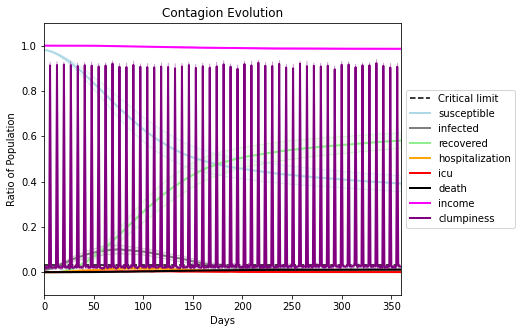

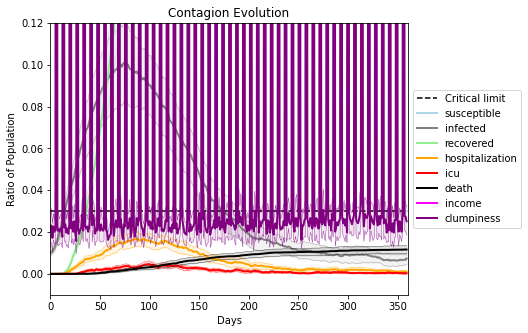

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7550, 6635, 1398, 2664, 200, 820, 1147, 6839, 5854, 1977, 544, 9191, 6753, 7468, 6433, 4590, 9645, 2702, 3652, 4330]
Average similarity between family members is 0.4488625047340414 at temperature -0.8
Average similarity between family and home is 0.9998548116934527 at temperature -1
Average similarity between students and their classroom is 0.17488206154473193 at temperature -0.8
Average classroom occupancy is 4.147058823529412 and number classrooms is 68
Average similarity between workers is 0.3023851157368069 at temperature -0.8
Average office occupancy is 3.234146341463415 and number offices is 205
Average friend similarity for adults: 0.5052154260542965 for kids: 0.35292632647398325
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.05491720871603497
avg restaurant similarity 0.168664398508917
avg restaurant similarity 0.0927999032019128
avg restaurant similarity 0.1818467511153204
avg restaurant similarity -0.13605787077165105
avg restaurant similarity 0.44013671099531676
avg restaurant similarity 0.2433459165502497
avg restaurant similarity -0.06512411903246222
avg restaurant similarity -0.024928681792697405
avg restaurant similarity 0.21626516654785383
avg restaurant similarity -0.04411467678616378
avg restaurant similarity 0.0005412544179679258
avg restaurant similarity 0.12160612790650074
avg restaurant similarity 0.036591304209553005
avg restaurant similarity -0.06465102961703541
avg restaurant similarity 0.05469565719701656
avg restaurant similarity 0.11500438356381507
avg restaurant similarity -0.2176310046868737
avg restaurant similarity 0.13903205536019092
avg restaurant similarity -0.10453483712885321
avg restaurant similarity 0.19311596267359318
avg restaurant similarity -0.

avg restaurant similarity -0.03472267749797717
avg restaurant similarity 0.046840224667694684
avg restaurant similarity 0.030792769772869235
avg restaurant similarity -0.0427962616986212
avg restaurant similarity 0.014561220494073242
avg restaurant similarity 0.050997498802795416
avg restaurant similarity 0.3023290284441796
avg restaurant similarity 0.16974238450920534
avg restaurant similarity 0.1579492613590447
avg restaurant similarity 0.3315766444770246
avg restaurant similarity 0.0036009947570004586
avg restaurant similarity -0.08720861358616683
avg restaurant similarity -0.05788309141484305
avg restaurant similarity 0.12445820828596767
avg restaurant similarity 0.08751203719768565
avg restaurant similarity 0.015547458395427658
avg restaurant similarity 0.2726512382387771
avg restaurant similarity 0.18508740894832978
avg restaurant similarity 0.26937775984793494
avg restaurant similarity 0.0009718774766984036
avg restaurant similarity 0.11667122210298356
avg restaurant similarity 

avg restaurant similarity 0.1301470497917541
avg restaurant similarity 0.14334859319144794
avg restaurant similarity -0.06471981348339838
avg restaurant similarity -0.2217189510041273
avg restaurant similarity 0.1314603518270914
avg restaurant similarity -0.0004950353932403256
avg restaurant similarity -0.09825355131970381
avg restaurant similarity 0.15735194624624907
avg restaurant similarity 0.11458420269227447
avg restaurant similarity 0.1175789823531951
avg restaurant similarity 0.12450835891822386
avg restaurant similarity 0.1995462257011369
avg restaurant similarity 0.06343141272127636
avg restaurant similarity -0.14150533370150223
avg restaurant similarity 0.1897428511079124
avg restaurant similarity 0.2532024870053335
avg restaurant similarity 0.16828412287799616
avg restaurant similarity 0.2463489937579612
avg restaurant similarity 0.11265347670300672
avg restaurant similarity 0.05638863542021302
avg restaurant similarity 0.6418718725840158
avg restaurant similarity -0.1021405

avg restaurant similarity 0.19863997838585415
avg restaurant similarity 0.24076454069917735
avg restaurant similarity 0.2786680042097775
avg restaurant similarity 0.15980049436669866
avg restaurant similarity 0.09165099056293877
avg restaurant similarity 0.12311214244743086
avg restaurant similarity 0.16886520149468653
avg restaurant similarity 0.039707161546648266
avg restaurant similarity 0.007693726517920739
avg restaurant similarity -0.11910060315683335
avg restaurant similarity 0.15418586741921023
avg restaurant similarity 0.06153783763817719
avg restaurant similarity 0.23752198541254035
avg restaurant similarity 0.21879059127827416
avg restaurant similarity -0.0013941751822943928
avg restaurant similarity 0.2775988046427246
avg restaurant similarity 0.19574823092253602
avg restaurant similarity 0.017605006027694957
avg restaurant similarity 0.32615747280211554
avg restaurant similarity 0.020673019361927485
avg restaurant similarity 0.27106807796585214
avg restaurant similarity -0

avg restaurant similarity 0.19953578736818575
avg restaurant similarity 0.27739938281777
avg restaurant similarity 0.08159193799286389
avg restaurant similarity 0.23021013538321694
avg restaurant similarity 0.35536402264930134
avg restaurant similarity 0.13289451292617904
avg restaurant similarity -0.07540877433238609
avg restaurant similarity -0.06145589209493503
avg restaurant similarity 0.3872396500983847
avg restaurant similarity 0.005208547516051543
avg restaurant similarity 0.19263237550305623
avg restaurant similarity 0.014983960631495503
avg restaurant similarity 0.15061974739189174
avg restaurant similarity 0.2092251473182384
avg restaurant similarity -0.047077068727193694
avg restaurant similarity 0.17291910539578542
avg restaurant similarity -0.07390486064546506
avg restaurant similarity 0.10119104512710908
avg restaurant similarity -0.021290362195134672
avg restaurant similarity 0.22744766875688036
avg restaurant similarity 0.20460707193230326
avg restaurant similarity 0.19

avg restaurant similarity 0.3606914584965654
avg restaurant similarity 0.20913072228555182
avg restaurant similarity 0.14455425251267712
avg restaurant similarity -0.007451939884309422
avg restaurant similarity 0.20034453043869246
avg restaurant similarity 0.13037869569708757
avg restaurant similarity 0.3044942707626373
avg restaurant similarity 0.06226394142236188
avg restaurant similarity 0.35619314949532893
avg restaurant similarity 0.03234673931544095
avg restaurant similarity -0.025975424921337188
avg restaurant similarity -0.0033834897589841207
avg restaurant similarity 0.011493713119018084
avg restaurant similarity -0.05592004103927971
avg restaurant similarity 0.15149394223414317
avg restaurant similarity -0.17687914773190433
avg restaurant similarity 0.2774688742318639
avg restaurant similarity 0.2478510637958893
avg restaurant similarity 0.09378730349024439
avg restaurant similarity 0.22137964009609437
avg restaurant similarity 0.17502015042544117
avg restaurant similarity 0.

avg restaurant similarity 0.18947017850099424
avg restaurant similarity 0.19523165575509632
avg restaurant similarity -0.03362252136959068
avg restaurant similarity 0.05327727097809046
avg restaurant similarity 0.17577515419938725
avg restaurant similarity 0.13395721708306504
avg restaurant similarity 0.1488757448846613
avg restaurant similarity 0.044333761917811805
avg restaurant similarity 0.09652263230111607
avg restaurant similarity -0.013305644311730876
avg restaurant similarity 0.011072189442268903
avg restaurant similarity 0.06085479599187071
avg restaurant similarity 0.07253871823371222
avg restaurant similarity 0.19194851816752742
avg restaurant similarity 0.08425930585423144
avg restaurant similarity 0.4196169404819322
avg restaurant similarity 0.07972365388599502
avg restaurant similarity 0.03383399969824505
avg restaurant similarity 0.13924815465495705
avg restaurant similarity 0.10133642916497519
avg restaurant similarity -0.044436653179941756
avg restaurant similarity -0.

avg restaurant similarity 0.0565931809965918
avg restaurant similarity 0.18083977668258366
avg restaurant similarity 0.23013668960717054
avg restaurant similarity 0.11764835164653298
avg restaurant similarity 0.23585639074875808
avg restaurant similarity 0.209724187436784
avg restaurant similarity -0.005782268360752827
avg restaurant similarity 0.0539171409553559
avg restaurant similarity 0.1417998575447596
avg restaurant similarity 0.18644782085677428
avg restaurant similarity -0.05128242276177974
avg restaurant similarity 0.31486095567945394
avg restaurant similarity 0.11641536241753166
avg restaurant similarity 0.07902150531062946
avg restaurant similarity 0.23150425068070538
avg restaurant similarity 0.21373177181221917
avg restaurant similarity 0.09878484012206794
avg restaurant similarity -0.10769494982675715
avg restaurant similarity 0.006755934339665221
avg restaurant similarity -0.22286127701222722
avg restaurant similarity 0.14467104473279072
avg restaurant similarity -0.0478

avg restaurant similarity -0.04599774931634981
avg restaurant similarity -0.026501404872528098
avg restaurant similarity 0.11586407032224368
avg restaurant similarity 0.33828477772514154
avg restaurant similarity 0.1537615828782023
avg restaurant similarity 0.04477145944416737
avg restaurant similarity 0.2234559314478572
avg restaurant similarity 0.4357806445812607
avg restaurant similarity 0.26423174476944855
avg restaurant similarity 0.04844068675461454
avg restaurant similarity 0.4141866274288015
avg restaurant similarity 0.20913393782089487
avg restaurant similarity -0.07724336253983749
avg restaurant similarity 0.16343144396294942
avg restaurant similarity -0.1000029803617187
avg restaurant similarity 0.22607609220103328
avg restaurant similarity 0.1856717722175352
avg restaurant similarity 0.008322688517916633
avg restaurant similarity -0.09334390121489558
avg restaurant similarity 0.11289557893526071
avg restaurant similarity 0.0759096489848863
avg restaurant similarity 0.186692

avg restaurant similarity -0.026975601360818335
avg restaurant similarity 0.16925031259004075
avg restaurant similarity 0.04593740947172459
avg restaurant similarity 0.21017884140720433
avg restaurant similarity -0.053940737991525656
avg restaurant similarity 0.11632487555034894
avg restaurant similarity -0.191722379877253
avg restaurant similarity 0.09886878875761329
avg restaurant similarity 0.05948404949130386
avg restaurant similarity 0.2219378426367495
avg restaurant similarity 0.29906040101714976
avg restaurant similarity 0.10419442308456557
avg restaurant similarity -0.04523855266894852
avg restaurant similarity -0.3319069962040771
avg restaurant similarity -0.08965698177492552
avg restaurant similarity -0.4346008507754892
avg restaurant similarity 0.27190830222451007
avg restaurant similarity 0.12210230595410818
avg restaurant similarity 0.22873200066848046
avg restaurant similarity 0.24011609431578018
avg restaurant similarity 0.13465441158096517
avg restaurant similarity 0.13

avg restaurant similarity 0.055801485101471725
avg restaurant similarity 0.13832047798584612
avg restaurant similarity 0.02913373493600241
avg restaurant similarity 0.11168244136982425
avg restaurant similarity 0.10758631873504074
avg restaurant similarity 0.11096112491901519
avg restaurant similarity 0.0660569013512299
avg restaurant similarity -0.05003074831784362
avg restaurant similarity 0.2081588832399802
avg restaurant similarity 0.008884476306693556
avg restaurant similarity 0.029736584385770266
avg restaurant similarity -0.026972623691364078
avg restaurant similarity 0.05524801934579559
avg restaurant similarity 0.1325233675102083
avg restaurant similarity 0.03181578863033047
avg restaurant similarity 0.08048880032293071
avg restaurant similarity 0.05649984396398543
avg restaurant similarity 0.11635072797929343
avg restaurant similarity 0.12784865320330344
avg restaurant similarity -0.007354532097150594
avg restaurant similarity 0.16312256928154728
avg restaurant similarity 0.2

avg restaurant similarity 0.5564833385254823
avg restaurant similarity 0.4544110995158419
avg restaurant similarity 0.09266936591809474
avg restaurant similarity 0.1842921807923296
avg restaurant similarity -0.0792029710930157
avg restaurant similarity -0.009502768487423716
avg restaurant similarity -0.0375823976877289
avg restaurant similarity 0.23736744706581012
avg restaurant similarity 0.055845887785001165
avg restaurant similarity -0.0050981974868887295
avg restaurant similarity 0.059288207353181355
avg restaurant similarity -0.12214226698102508
avg restaurant similarity 0.045437127871031845
avg restaurant similarity 0.06975378639323947
avg restaurant similarity 0.19706751339713527
avg restaurant similarity 0.1165173930168387
avg restaurant similarity 0.10214916757774657
avg restaurant similarity 0.07411534739753148
avg restaurant similarity 0.22052255084880173
avg restaurant similarity -0.11371045278805861
avg restaurant similarity 0.0850633152522974
avg restaurant similarity -0.

avg restaurant similarity 0.16531117196662262
avg restaurant similarity -0.0051544189594752285
avg restaurant similarity 0.21929894860013607
avg restaurant similarity 0.2112850099535905
avg restaurant similarity -0.0040612084776272955
avg restaurant similarity -0.2242903963641389
avg restaurant similarity -0.05185782228633202
avg restaurant similarity -0.08252690676105602
avg restaurant similarity 0.12886716118622452
avg restaurant similarity 0.10874503383243393
avg restaurant similarity 0.3910062497178722
avg restaurant similarity -0.037647316911296975
avg restaurant similarity -0.1404390310867196
avg restaurant similarity -0.3578175116611533
avg restaurant similarity 0.1641681321212696
avg restaurant similarity -0.19791134404924812
avg restaurant similarity -0.009496434872864723
avg restaurant similarity -0.00709779838696522
avg restaurant similarity 0.35833152786223044
avg restaurant similarity 0.09990126230088714
avg restaurant similarity 0.08994589874380651
avg restaurant similari

avg restaurant similarity 0.15314197683777742
avg restaurant similarity -0.18319613565339277
avg restaurant similarity 0.1666393889851863
avg restaurant similarity 0.08185803873738681
avg restaurant similarity 0.16563649688342705
avg restaurant similarity 0.1146409919151642
avg restaurant similarity 0.2039245129384785
avg restaurant similarity 0.059802899270672234
avg restaurant similarity 0.06440986550700355
avg restaurant similarity 0.08935927113260231
avg restaurant similarity 0.0011933716006085739
avg restaurant similarity 0.12475322779891596
avg restaurant similarity 0.1705606413623531
avg restaurant similarity -0.04461856265013131
avg restaurant similarity 0.12252480202125215
avg restaurant similarity 0.1234675564234608
avg restaurant similarity 0.1509359702261944
avg restaurant similarity 0.08895645684169996
avg restaurant similarity 0.19346375543910801
avg restaurant similarity 0.4361879331330848
avg restaurant similarity 0.24568306632026599
avg restaurant similarity 0.20467377

avg restaurant similarity 0.06446765657855172
avg restaurant similarity 0.1786218163258132
avg restaurant similarity 0.16141173946499968
avg restaurant similarity 0.1680336203152255
avg restaurant similarity 0.2460447154583624
avg restaurant similarity 0.45920730507247287
avg restaurant similarity 0.10276046845464133
avg restaurant similarity 0.21406065204864136
avg restaurant similarity 0.16868351887608965
avg restaurant similarity -0.06802624088685666
avg restaurant similarity 0.13327043655211518
avg restaurant similarity -0.013162338781113484
avg restaurant similarity 0.13690221707062838
avg restaurant similarity 0.40967853856591907
avg restaurant similarity 0.2831350250915463
avg restaurant similarity 0.009184432055029078
avg restaurant similarity 0.24452413762752606
avg restaurant similarity 0.03307543069137417
avg restaurant similarity 0.21064922578368997
avg restaurant similarity 0.13440075268213375
avg restaurant similarity 0.5872753710090202
avg restaurant similarity 0.2075914

avg restaurant similarity -0.10269626941531625
avg restaurant similarity 0.19160075174012828
avg restaurant similarity 0.35085227189766616
avg restaurant similarity 0.22893884674211107
avg restaurant similarity 0.3099920660898155
avg restaurant similarity 0.049953569615811655
avg restaurant similarity -0.026617823836002485
avg restaurant similarity 0.1777829010284401
avg restaurant similarity 0.20934504411157068
avg restaurant similarity 0.3121765160440295
avg restaurant similarity 0.33728214849624005
avg restaurant similarity 0.0508872453991349
avg restaurant similarity 0.2403607061376418
avg restaurant similarity 0.04815010638467643
avg restaurant similarity 0.04521516906776852
avg restaurant similarity 0.10292157074415781
avg restaurant similarity -0.030835037034867563
avg restaurant similarity 0.306519685564042
avg restaurant similarity -0.0617416059080875
avg restaurant similarity 0.1805250441639661
avg restaurant similarity 0.18760371700970124
avg restaurant similarity 0.38618382

avg restaurant similarity 0.14796038409591672
avg restaurant similarity 0.12949018699802184
avg restaurant similarity 0.29028034021510285
avg restaurant similarity -0.02401870725612515
avg restaurant similarity -0.013631595691225957
avg restaurant similarity 0.23854675370860864
avg restaurant similarity 0.20762159681598968
avg restaurant similarity 0.08014093848447633
avg restaurant similarity 0.18920450022820826
avg restaurant similarity 0.08908376838391398
avg restaurant similarity -0.022078259342837823
avg restaurant similarity 0.007750610082171318
avg restaurant similarity 0.054892180264162566
avg restaurant similarity 0.1997126522813552
avg restaurant similarity -0.05153201593221199
avg restaurant similarity 0.013655678523945483
avg restaurant similarity 0.03178367909155218
avg restaurant similarity -0.04636156958686003
avg restaurant similarity 0.3499006779549745
avg restaurant similarity 0.20944665297771656
avg restaurant similarity 0.17806093698080616
avg restaurant similarity 

avg restaurant similarity 0.06854291620514012
avg restaurant similarity 0.06083756883345426
avg restaurant similarity 0.21672745098749513
avg restaurant similarity 0.238287731405007
avg restaurant similarity -0.050582159632521606
avg restaurant similarity 0.10840921671833786
avg restaurant similarity 0.01694517141952271
avg restaurant similarity 0.30372079441601274
avg restaurant similarity 0.05896882311331134
avg restaurant similarity 0.16951391050005712
avg restaurant similarity -0.03776971189795083
avg restaurant similarity 0.5707535006616761
avg restaurant similarity 0.18081937140662993
avg restaurant similarity 0.055908664512306645
avg restaurant similarity -0.03129369708672625
avg restaurant similarity 0.22102559201146904
avg restaurant similarity 0.09123355219852113
avg restaurant similarity -0.005714679089750778
avg restaurant similarity 0.10404799963288283
avg restaurant similarity 0.036427242481555884
avg restaurant similarity 0.07692828754910268
avg restaurant similarity 0.0

avg restaurant similarity 0.24523304876324775
avg restaurant similarity 0.2099205847668875
avg restaurant similarity 0.0661405152393268
avg restaurant similarity 0.15680612320831744
avg restaurant similarity 0.10426772597489513
avg restaurant similarity -0.17114167465534177
avg restaurant similarity -0.27730531512472
avg restaurant similarity 0.1528248840041759
avg restaurant similarity -0.10991317028933198
avg restaurant similarity 0.08741797061407304
avg restaurant similarity -0.04510481929692799
avg restaurant similarity 0.11402307784295387
avg restaurant similarity 0.20774603493119567
avg restaurant similarity -0.0038727183181220043
avg restaurant similarity -0.0753824595843827
avg restaurant similarity 0.2053866052504986
avg restaurant similarity -0.005850242458742068
avg restaurant similarity 0.1698352214708656
avg restaurant similarity 0.011732569694094235
avg restaurant similarity 0.0864877989367442
avg restaurant similarity 0.054479117786495904
avg restaurant similarity 0.0631

avg restaurant similarity 0.1421017745310561
avg restaurant similarity 0.21999940959497805
avg restaurant similarity 0.18247178760848456
avg restaurant similarity -0.23455783571766617
avg restaurant similarity 0.006332169667177692
avg restaurant similarity -0.16238387821799666
avg restaurant similarity 0.19884129446482035
avg restaurant similarity 0.1735418301251176
avg restaurant similarity 0.1714030421709864
avg restaurant similarity 0.09785411961460552
avg restaurant similarity 0.09387702167768688
avg restaurant similarity 0.05863322823197191
avg restaurant similarity 0.021564209285829774
avg restaurant similarity 0.1594372094461059
avg restaurant similarity -0.05626413714562554
avg restaurant similarity 0.1102157032408593
avg restaurant similarity 0.061487891593431425
avg restaurant similarity -0.010439199362345688
avg restaurant similarity -0.0944889129175631
avg restaurant similarity -0.04020101732141598
avg restaurant similarity 0.094951801240766
avg restaurant similarity 0.1008

avg restaurant similarity 0.132903696130184
avg restaurant similarity 0.2979925653633205
avg restaurant similarity 0.12490196718930724
avg restaurant similarity 0.056719024412982266
avg restaurant similarity 0.19472430614685973
avg restaurant similarity 0.04594444774138958
avg restaurant similarity 0.12627050480455188
avg restaurant similarity 0.205359545460053
avg restaurant similarity -0.10071392537378514
avg restaurant similarity -0.07326729957258088
avg restaurant similarity 0.054299597006887336
avg restaurant similarity 0.15536066350477995
avg restaurant similarity 0.13744057021310843
avg restaurant similarity 0.09491947080215694
avg restaurant similarity 0.03830820593382385
avg restaurant similarity -0.061649319574268724
avg restaurant similarity 0.1187400349101931
avg restaurant similarity -0.3497193891589482
avg restaurant similarity 0.07188484404586927
avg restaurant similarity 0.1413844145636255
avg restaurant similarity 0.12643150761642608
avg restaurant similarity 0.0393080

avg restaurant similarity 0.2398037020856899
avg restaurant similarity 0.12301207593054386
avg restaurant similarity 0.10854611358088197
avg restaurant similarity 0.37076448163601855
avg restaurant similarity 0.027319830594257428
avg restaurant similarity 0.17226571566110083
avg restaurant similarity 0.2744586003215187
avg restaurant similarity 0.08866228522400538
avg restaurant similarity 0.13595357329672225
avg restaurant similarity 0.1989985352321837
avg restaurant similarity 0.04499473496071229
avg restaurant similarity -0.05462354171939088
avg restaurant similarity 0.004286773918344704
avg restaurant similarity 0.19845784840295583
avg restaurant similarity 0.15340354942600284
avg restaurant similarity 0.4181979076611008
avg restaurant similarity 0.25580860127800037
avg restaurant similarity 0.20084506344869377
avg restaurant similarity 0.0682332911396428
avg restaurant similarity 0.08363771070214295
avg restaurant similarity 0.08141314674684061
avg restaurant similarity 0.22979587

avg restaurant similarity 0.19491232177859746
avg restaurant similarity -9.45628546103805e-05
avg restaurant similarity 0.09967441081268914
avg restaurant similarity 0.05755010864623792
avg restaurant similarity 0.24294994694150607
avg restaurant similarity 0.04331974141168795
avg restaurant similarity 0.03839022647462853
avg restaurant similarity 0.05258415284836895
avg restaurant similarity -0.2238510731199456
avg restaurant similarity 0.16368873598279063
avg restaurant similarity -0.038268967485337806
avg restaurant similarity 0.13382877146169658
avg restaurant similarity -0.0856356539987516
avg restaurant similarity 0.11754848109717994
avg restaurant similarity -0.005185803626588814
avg restaurant similarity 0.2641935378457946
avg restaurant similarity 0.00501874825608338
avg restaurant similarity 0.10152334705747312
avg restaurant similarity 0.0358627543167427
avg restaurant similarity 0.3146273587829041
avg restaurant similarity 0.019809349646860715
avg restaurant similarity -0.0

avg restaurant similarity 0.08830419124296854
avg restaurant similarity -0.06729378421942699
avg restaurant similarity 0.3442889397167734
avg restaurant similarity -0.156609572177477
avg restaurant similarity 0.03847284790187702
avg restaurant similarity 0.0652757137432173
avg restaurant similarity 0.12258994355844566
avg restaurant similarity 0.2022891957071952
avg restaurant similarity 0.08851436251617656
avg restaurant similarity -0.02215314886604633
avg restaurant similarity 0.28302460767076304
avg restaurant similarity 0.18766911001355624
avg restaurant similarity -0.034898790255043007
avg restaurant similarity 0.09334828321859072
avg restaurant similarity 0.13673630224681188
avg restaurant similarity -0.04294940224521244
avg restaurant similarity -0.002286802649566876
avg restaurant similarity -0.13715776569711025
avg restaurant similarity 0.22729019388595928
avg restaurant similarity 0.2920170314461934
avg restaurant similarity -0.0014931558113304073
avg restaurant similarity -0

avg restaurant similarity 0.21038042452534683
avg restaurant similarity -0.08811536202133527
avg restaurant similarity 0.11066661256334263
avg restaurant similarity -0.15335401042705593
avg restaurant similarity 0.3079149208183319
avg restaurant similarity 0.2888667723174414
avg restaurant similarity 0.11362241954726196
avg restaurant similarity 0.20430013794940388
avg restaurant similarity 0.04044529523864829
avg restaurant similarity 0.0072012700841748
avg restaurant similarity 0.09592296137186365
avg restaurant similarity 0.1948813838327568
avg restaurant similarity 0.1998904610877137
avg restaurant similarity 0.18499414841015688
avg restaurant similarity 0.13290859929791501
avg restaurant similarity 0.15307510668410576
avg restaurant similarity 0.0465153872808756
avg restaurant similarity 0.05999004934781675
avg restaurant similarity 0.057867888779319004
avg restaurant similarity 0.24736938311681925
avg restaurant similarity -0.045244970626884824
avg restaurant similarity 0.0632261

avg restaurant similarity 0.1554078396862897
avg restaurant similarity -0.2160864002023903
avg restaurant similarity -0.12501768080577952
avg restaurant similarity 0.12245550382714403
avg restaurant similarity 0.12699530177458193
avg restaurant similarity 0.22700085315737473
avg restaurant similarity 0.29944000683572214
avg restaurant similarity 0.3376386786293802
avg restaurant similarity -0.011617580685519617
avg restaurant similarity -0.046434249473253524
avg restaurant similarity 0.1943201027506724
avg restaurant similarity 0.2935282815082255
avg restaurant similarity 0.353783870542283
avg restaurant similarity 0.25374788944889387
avg restaurant similarity 0.2201785137441566
avg restaurant similarity 0.32801781326195417
avg restaurant similarity 0.25631072988738046
avg restaurant similarity 0.281277721055828
avg restaurant similarity 0.2849478519755374
avg restaurant similarity 0.08778451718621294
avg restaurant similarity 0.24103865281896042
avg restaurant similarity 0.23177976639

avg restaurant similarity -0.009162659106794053
avg restaurant similarity 0.20654388789725378
avg restaurant similarity -0.012765228742724111
avg restaurant similarity 0.39634632901345207
avg restaurant similarity 0.05944979624005087
avg restaurant similarity 0.25194641923807454
avg restaurant similarity -0.06457410684912601
avg restaurant similarity -0.030994161692954263
avg restaurant similarity 0.04639870286223952
avg restaurant similarity 0.1276778812409367
avg restaurant similarity 0.775053592538107
avg restaurant similarity 0.09767305455691745
avg restaurant similarity 0.13601215529698937
avg restaurant similarity -0.07896273368338437
avg restaurant similarity 0.20120201457374165
avg restaurant similarity 0.1807454862502766
avg restaurant similarity -0.018828116466748184
avg restaurant similarity 0.0908723080355876
avg restaurant similarity 0.006840075493807565
avg restaurant similarity 0.11338028460856359
avg restaurant similarity -0.033419512928958915
avg restaurant similarity 

avg restaurant similarity -0.02862368508470557
avg restaurant similarity -0.02290490417651621
avg restaurant similarity -0.1266152793728476
avg restaurant similarity 0.1440549384854135
avg restaurant similarity 0.16792194982814315
avg restaurant similarity -0.03933639686954711
avg restaurant similarity 0.0014314702983728763
avg restaurant similarity 0.1579686685326187
avg restaurant similarity 0.017624679502266788
avg restaurant similarity 0.22456772549334653
avg restaurant similarity 0.08887867569985651
avg restaurant similarity -0.0932450188216171
avg restaurant similarity -0.02669466306588221
avg restaurant similarity -0.13099182160217204
avg restaurant similarity 0.22954225295316738
avg restaurant similarity -0.006516327064465552
avg restaurant similarity -0.12667548291657804
avg restaurant similarity 0.14575300676938704
avg restaurant similarity 0.0920117119381369
avg restaurant similarity 0.11597797219815915
avg restaurant similarity 0.019288217789551115
avg restaurant similarity

avg restaurant similarity 0.09153267054549626
avg restaurant similarity 0.12048714162997157
avg restaurant similarity 0.484432833514926
avg restaurant similarity 0.06496035539227404
avg restaurant similarity 0.14467381877820995
avg restaurant similarity 0.05462412911925658
avg restaurant similarity 0.14537732556965674
avg restaurant similarity 0.20285295567628753
avg restaurant similarity 0.34427120727219596
avg restaurant similarity 0.08404106304170265
avg restaurant similarity 0.16830585582044663
avg restaurant similarity 0.10707630235101022
avg restaurant similarity -0.015987717055188165
avg restaurant similarity 0.12173109333322728
avg restaurant similarity 0.16495825062688632
avg restaurant similarity 0.2476313217297802
avg restaurant similarity 0.12272980375634772
avg restaurant similarity 0.2859583177713633
avg restaurant similarity 0.31190536022998916
avg restaurant similarity 0.312204630310339
avg restaurant similarity -0.03928256134019556
avg restaurant similarity -0.02003865

avg restaurant similarity 0.19468002848485286
avg restaurant similarity -0.036438113329278675
avg restaurant similarity 0.1963724912321151
avg restaurant similarity -0.034623610622770154
avg restaurant similarity 0.20008893587908638
avg restaurant similarity 0.4827940852844271
avg restaurant similarity -0.01926524723698191
avg restaurant similarity 0.0171353023235953
avg restaurant similarity 0.3541657808300277
avg restaurant similarity 0.19265867142793333
avg restaurant similarity -0.011086201656499312
avg restaurant similarity 0.010094803818832728
avg restaurant similarity 0.2574016421110279
avg restaurant similarity 0.018641419233736425
avg restaurant similarity 0.23188474643129758
avg restaurant similarity 0.24054688232128837
avg restaurant similarity 0.2696515517302367
avg restaurant similarity 0.12151699260431575
avg restaurant similarity 0.11101233547144705
avg restaurant similarity 0.22108898163879978
avg restaurant similarity 0.05175122419019066
avg restaurant similarity 0.664

avg restaurant similarity -0.07187365862294787
avg restaurant similarity 0.16871868747406873
avg restaurant similarity 0.09141675579826594
avg restaurant similarity 0.10200149133561554
avg restaurant similarity 0.059153497701237526
avg restaurant similarity 0.01524363102835077
avg restaurant similarity 0.09808523463554042
avg restaurant similarity -0.3066944943930216
avg restaurant similarity 0.12963682394492893
avg restaurant similarity 0.2455966574744033
avg restaurant similarity 0.20709459802086555
avg restaurant similarity 0.25022548979082315
avg restaurant similarity 0.15305954969287558
avg restaurant similarity 0.2110497463084052
avg restaurant similarity 0.09538862376403427
avg restaurant similarity 0.15885506080366524
avg restaurant similarity 0.02827173183535485
avg restaurant similarity 0.05221592517307172
avg restaurant similarity 0.31856193207444417
avg restaurant similarity 0.14983023305852758
avg restaurant similarity 0.27408571447636204
avg restaurant similarity 0.328464

avg restaurant similarity 0.1850590514116097
avg restaurant similarity 0.11513817191323032
avg restaurant similarity 0.22278403669171298
avg restaurant similarity 0.1323138893090775
avg restaurant similarity 0.23099179123409636
avg restaurant similarity 0.20783201636138657
avg restaurant similarity 0.010178191723443662
avg restaurant similarity -0.02528470521896441
avg restaurant similarity 0.025482382340583833
avg restaurant similarity 0.19487214658463714
avg restaurant similarity 0.2916703545095797
avg restaurant similarity 0.002367869530916153
avg restaurant similarity 0.1510228214241234
avg restaurant similarity 0.2624590287420235
avg restaurant similarity 0.04081909169346457
avg restaurant similarity 0.1291306456020523
avg restaurant similarity -0.07509693936694707
avg restaurant similarity -0.05430340703707254
avg restaurant similarity 0.03491466568617578
avg restaurant similarity 0.10768920834483957
avg restaurant similarity 0.22483391678697404
avg restaurant similarity 0.179034

avg restaurant similarity 0.22684412555233543
avg restaurant similarity 0.10774393371238995
avg restaurant similarity -0.036921941700991265
avg restaurant similarity 0.2375793615233467
avg restaurant similarity 0.35825113626030824
avg restaurant similarity -0.03719584524409449
avg restaurant similarity -0.061092425867723274
avg restaurant similarity 0.028001505395264158
avg restaurant similarity -0.08320433734369574
avg restaurant similarity 0.1560844264001039
avg restaurant similarity 0.34694822127989716
avg restaurant similarity 0.009523429224441066
avg restaurant similarity -0.003548014926042839
avg restaurant similarity 0.011022979413252186
avg restaurant similarity 0.06695398570052322
avg restaurant similarity 0.02259400286899033
avg restaurant similarity -0.09701929536302595
avg restaurant similarity 0.04767849918982679
avg restaurant similarity 0.17012556909863322
avg restaurant similarity 0.19988710531001883
avg restaurant similarity 0.10273976576251558
avg restaurant similarit

avg restaurant similarity 0.05794290217903945
avg restaurant similarity 0.0042212838339817085
avg restaurant similarity 0.1755287776764584
avg restaurant similarity -0.12514205976752427
avg restaurant similarity 0.19365308461030872
avg restaurant similarity 0.13947987463618403
avg restaurant similarity 0.09979585987843509
avg restaurant similarity 0.19075269439156187
avg restaurant similarity 0.3811101325031607
avg restaurant similarity 0.25760593677499743
avg restaurant similarity 0.13761379103420548
avg restaurant similarity 0.0415553953167183
avg restaurant similarity 0.04548528005382514
avg restaurant similarity 0.11213106324598071
avg restaurant similarity 0.020726799376501924
avg restaurant similarity 0.03661224276908361
avg restaurant similarity 0.2901304533421711
avg restaurant similarity 0.31672782158143736
avg restaurant similarity 0.07480208030618604
avg restaurant similarity 0.049078171298977576
avg restaurant similarity 0.07476848590237843
avg restaurant similarity 0.03833

avg restaurant similarity 0.04408573765299212
avg restaurant similarity 0.024711199344340812
avg restaurant similarity -0.13777388971778814
avg restaurant similarity 0.012807153183112902
avg restaurant similarity 0.12783129205639157
avg restaurant similarity -0.09216695393088953
avg restaurant similarity -0.05828910721330131
avg restaurant similarity -0.3075340446577246
avg restaurant similarity 0.09004909487424213
avg restaurant similarity -0.07175604849686962
avg restaurant similarity 0.05557415349642676
avg restaurant similarity 0.011516164410050777
avg restaurant similarity -0.20974946386860913
avg restaurant similarity 0.06336340496072733
avg restaurant similarity 0.11434688664745676
avg restaurant similarity -0.2956357013670364
avg restaurant similarity 0.101111305109623
avg restaurant similarity -0.3043440605844609
avg restaurant similarity -0.03126563202692205
avg restaurant similarity 0.3170427805232603
avg restaurant similarity 0.13954597016615597
avg restaurant similarity -0

avg restaurant similarity 0.0642677154576502
avg restaurant similarity -0.0010958441357084888
avg restaurant similarity 0.042184344105898865
avg restaurant similarity 0.19843518035033114
avg restaurant similarity -0.1132115212362154
avg restaurant similarity -0.10867621904863271
avg restaurant similarity 0.12526311328254888
avg restaurant similarity 0.18034397248148243
avg restaurant similarity 0.01072909942746335
avg restaurant similarity -0.6349191478943692
avg restaurant similarity 0.02610126418519145
avg restaurant similarity 0.19464677968423175
avg restaurant similarity 0.18202505086856519
avg restaurant similarity 0.707702725772779
avg restaurant similarity -0.22419088782776309
avg restaurant similarity 0.17061128763304761
avg restaurant similarity -0.011586437310836266
avg restaurant similarity -0.2287177119917086
avg restaurant similarity 0.008816903032597254
avg restaurant similarity 0.1665242587135728
avg restaurant similarity 0.34661791536812
avg restaurant similarity 0.0436

avg restaurant similarity 0.1515564509546292
avg restaurant similarity 0.19690788101812942
avg restaurant similarity 0.008252873188723428
avg restaurant similarity 0.20045494650048873
avg restaurant similarity 0.24205508282795546
avg restaurant similarity 0.25446719823550457
avg restaurant similarity -0.03359863375278292
avg restaurant similarity -0.03639516627940598
avg restaurant similarity 0.3433841628687079
avg restaurant similarity 0.20960890987718203
avg restaurant similarity 0.13841676402582995
avg restaurant similarity -0.023436030062026714
avg restaurant similarity -0.045497420185645975
avg restaurant similarity 0.2790894196754378
avg restaurant similarity -0.0052775080508092875
avg restaurant similarity 0.15724293991333563
avg restaurant similarity -0.07591428721324375
avg restaurant similarity 0.5233650350880821
avg restaurant similarity 0.17525548623890647
avg restaurant similarity 0.09192862807589515
avg restaurant similarity -0.09601388978170704
avg restaurant similarity 

avg restaurant similarity 0.34525276945851596
avg restaurant similarity 0.0671036144442321
avg restaurant similarity 0.3257464686289795
avg restaurant similarity 0.25091014498155395
avg restaurant similarity 0.1886718216965063
avg restaurant similarity 0.019312080302122447
avg restaurant similarity 0.01989747866395063
avg restaurant similarity 0.040812942609051474
avg restaurant similarity -0.010793509772668538
avg restaurant similarity 0.4600589889551246
avg restaurant similarity 0.38990282751808136
avg restaurant similarity -0.2451847974201511
avg restaurant similarity 0.07961264256412881
avg restaurant similarity 0.14089801697233942
avg restaurant similarity 0.03448749813601958
avg restaurant similarity 0.03735119500792069
avg restaurant similarity 0.2660966588134923
avg restaurant similarity -0.08572284320240524
avg restaurant similarity 0.21427554413666305
avg restaurant similarity 0.3225669390529998
avg restaurant similarity 0.36988326081786227
avg restaurant similarity 0.1428006

avg restaurant similarity 0.06269477400548372
avg restaurant similarity -0.00910958215381244
avg restaurant similarity 0.3128348246041072
avg restaurant similarity 0.05856864921043198
avg restaurant similarity -0.07195756402732097
avg restaurant similarity -0.08746334469592149
avg restaurant similarity 0.2436871203583154
avg restaurant similarity 0.11994693006284274
avg restaurant similarity 0.3826133822810607
avg restaurant similarity -0.030412123558941004
avg restaurant similarity 0.028415120225993656
avg restaurant similarity 0.1215064866304811
avg restaurant similarity -0.035424218966467774
avg restaurant similarity 0.08278143007186112
avg restaurant similarity 0.0402309992958398
avg restaurant similarity 0.27423227132824113
avg restaurant similarity 0.1079080090508853
avg restaurant similarity 0.2706665387428846
avg restaurant similarity 0.043359736510779165
avg restaurant similarity -0.20583375751384003
avg restaurant similarity 0.09039960273334911
avg restaurant similarity -0.37

avg restaurant similarity 0.11275656896773431
avg restaurant similarity 0.09757158640518779
avg restaurant similarity 0.03386340254047362
avg restaurant similarity 0.019095430611946587
avg restaurant similarity 0.07332775719734326
avg restaurant similarity -0.10752496138624204
avg restaurant similarity 0.23594458446263447
avg restaurant similarity 0.16993473079462793
avg restaurant similarity 0.17007474867876046
avg restaurant similarity 0.20492389389990692
avg restaurant similarity -0.08683335488980064
avg restaurant similarity 0.10569907528100955
avg restaurant similarity -0.206748562142353
avg restaurant similarity -0.05164215728854999
avg restaurant similarity 0.0210622542803969
avg restaurant similarity -0.17409388071040813
avg restaurant similarity 0.1659812763809828
avg restaurant similarity 0.07319943400374444
avg restaurant similarity 0.24951157970109086
avg restaurant similarity 0.2174621747798961
avg restaurant similarity 0.023887925145798447
avg restaurant similarity 0.1576

(<function dict.items>, <function dict.items>, <function dict.items>)

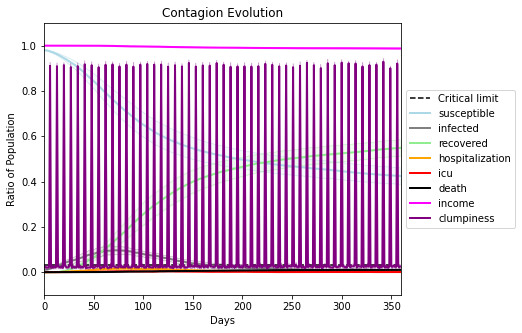

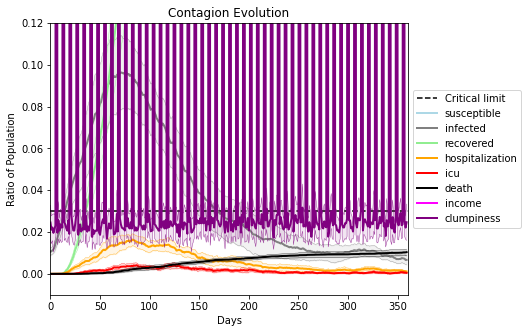

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4850, 3521, 4134, 9522, 1384, 8651, 2461, 8058, 1314, 7144, 456, 9127, 7890, 3978, 5255, 1, 1866, 9926, 6698, 9301]
Average similarity between family members is 0.3402466384417123 at temperature -0.7
Average similarity between family and home is 0.9998549079190266 at temperature -1
Average similarity between students and their classroom is 0.17200662683516127 at temperature -0.7
Average classroom occupancy is 4.225352112676056 and number classrooms is 71
Average similarity between workers is 0.1732303314718003 at temperature -0.7
Average office occupancy is 3.140096618357488 and number offices is 207
Average friend similarity for adults: 0.42572517741779703 for kids: 0.2758120536708853
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.08549681021593947
avg restaurant similarity -0.0851071132018766
avg restaurant similarity 0.07643988596811589
avg restaurant similarity 0.0842943854773842
avg restaurant similarity 0.13115607015012545
avg restaurant similarity 0.11259237165603891
avg restaurant similarity -0.03399092826545901
avg restaurant similarity 0.13665206738986607
avg restaurant similarity 0.4103354324031956
avg restaurant similarity 0.034731480667184754
avg restaurant similarity -0.021270701497701883
avg restaurant similarity 0.2550824624833038
avg restaurant similarity -0.014468208760756149
avg restaurant similarity -0.03241128181735227
avg restaurant similarity 0.11786367982953223
avg restaurant similarity -0.1458581171886631
avg restaurant similarity -0.0464297873624039
avg restaurant similarity -0.04143535200958845
avg restaurant similarity -0.09637869998377402
avg restaurant similarity 0.1179621639730958
avg restaurant similarity 0.05485136534715025
avg restaurant similarity 0.2

avg restaurant similarity 0.500515377535572
avg restaurant similarity 0.11731683640754224
avg restaurant similarity 0.19802353681701307
avg restaurant similarity 0.038329808110238096
avg restaurant similarity 0.22667164023183534
avg restaurant similarity 0.1507678663487368
avg restaurant similarity 0.09276728946546436
avg restaurant similarity 0.07262361657897988
avg restaurant similarity 0.11425538495985675
avg restaurant similarity 0.02808924725672034
avg restaurant similarity 0.025515699517244934
avg restaurant similarity -0.07351142761448812
avg restaurant similarity 0.18337777269173824
avg restaurant similarity 0.08981890364838398
avg restaurant similarity 0.21844585016467288
avg restaurant similarity -0.027784124619495802
avg restaurant similarity 0.2880175886261313
avg restaurant similarity 0.08185559358936356
avg restaurant similarity -0.21015787070293504
avg restaurant similarity -0.08355858831431126
avg restaurant similarity 0.06164566826688507
avg restaurant similarity -0.09

avg restaurant similarity 0.16025233131247896
avg restaurant similarity 0.278740215386321
avg restaurant similarity -0.00014475302785051566
avg restaurant similarity 0.1915222474754462
avg restaurant similarity 0.15492709797040494
avg restaurant similarity 0.2842521262357745
avg restaurant similarity 0.18743481781780882
avg restaurant similarity 0.14705086722238353
avg restaurant similarity 0.2440008968206937
avg restaurant similarity 0.13875884714460704
avg restaurant similarity 0.09230482274174541
avg restaurant similarity 0.07409130111197124
avg restaurant similarity 0.20439620901344827
avg restaurant similarity 0.2858020090924531
avg restaurant similarity -0.04661388053317379
avg restaurant similarity 0.21410615457988413
avg restaurant similarity 0.03879019961671781
avg restaurant similarity 0.35999152228041237
avg restaurant similarity 0.06746517610510024
avg restaurant similarity 0.27862330282920594
avg restaurant similarity 0.024783014372877478
avg restaurant similarity 0.143917

avg restaurant similarity 0.2457560878603149
avg restaurant similarity -0.13851263929510443
avg restaurant similarity 0.025963403267322018
avg restaurant similarity -0.027790041811947358
avg restaurant similarity -0.06672400285025101
avg restaurant similarity 0.15193792388699953
avg restaurant similarity 0.02616474452359004
avg restaurant similarity 0.22214585566435022
avg restaurant similarity 0.1747620449932573
avg restaurant similarity 0.3141533701958496
avg restaurant similarity 0.12806490751067093
avg restaurant similarity 0.17941276644703785
avg restaurant similarity 0.2217738755431794
avg restaurant similarity 0.16849441172625704
avg restaurant similarity 0.30384668630688133
avg restaurant similarity 0.0391462289757089
avg restaurant similarity 0.17540381176945746
avg restaurant similarity 0.35717922753599973
avg restaurant similarity 0.07591149464056703
avg restaurant similarity 0.11401937374576217
avg restaurant similarity 0.2654029135619341
avg restaurant similarity -0.043240

avg restaurant similarity 0.05034361968385641
avg restaurant similarity 0.23610930225713736
avg restaurant similarity 0.09091299899604262
avg restaurant similarity 0.26279857275285856
avg restaurant similarity 0.34026751244759534
avg restaurant similarity 0.07836311439249548
avg restaurant similarity 0.2278368310062346
avg restaurant similarity 0.10451189755440787
avg restaurant similarity 0.37683515473028856
avg restaurant similarity -0.2003551947857398
avg restaurant similarity -0.21250650894503978
avg restaurant similarity 0.3839788153734487
avg restaurant similarity 0.04985566861868959
avg restaurant similarity -0.08558476505569307
avg restaurant similarity -0.1409660405323013
avg restaurant similarity 0.22563333529944168
avg restaurant similarity -0.06864192287197679
avg restaurant similarity -0.023889875259419893
avg restaurant similarity 0.3862148395970876
avg restaurant similarity -0.11393728344654208
avg restaurant similarity -0.18606379672656084
avg restaurant similarity 0.13

avg restaurant similarity 0.18468724304272066
avg restaurant similarity -0.22875467840663463
avg restaurant similarity 0.0984927784207593
avg restaurant similarity 0.23873462108488228
avg restaurant similarity 0.04109090300691085
avg restaurant similarity 0.13297633485921567
avg restaurant similarity 0.06149220376582214
avg restaurant similarity -0.09876714312249174
avg restaurant similarity 0.1450483855047941
avg restaurant similarity 0.22352989499987816
avg restaurant similarity 0.059687244643423495
avg restaurant similarity -0.26057290249991005
avg restaurant similarity -0.07420072439806627
avg restaurant similarity 0.0091943861422337
avg restaurant similarity 0.17773616686891766
avg restaurant similarity -0.02717384406676377
avg restaurant similarity 0.15677118588765881
avg restaurant similarity 0.12346245630362522
avg restaurant similarity 0.194818208861441
avg restaurant similarity -0.1132782398853488
avg restaurant similarity 0.15425431470240883
avg restaurant similarity 0.13929

avg restaurant similarity -0.06816346241422312
avg restaurant similarity 0.10587010767154915
avg restaurant similarity 0.22179107687861488
avg restaurant similarity 0.018896960678632474
avg restaurant similarity 0.00723537414828921
avg restaurant similarity 0.3471425437953546
avg restaurant similarity -0.1376426545750131
avg restaurant similarity -0.16090399605072622
avg restaurant similarity 0.1520260733539232
avg restaurant similarity 0.1376156358905772
avg restaurant similarity 0.04838788443157832
avg restaurant similarity 0.19611007751670723
avg restaurant similarity 0.17679997066967704
avg restaurant similarity 0.01643948341153084
avg restaurant similarity 0.35390051220299223
avg restaurant similarity 0.243987547474339
avg restaurant similarity 0.24335609296527907
avg restaurant similarity 0.08204358435439903
avg restaurant similarity 0.1514810070981977
avg restaurant similarity 0.21720099086946665
avg restaurant similarity 0.05179371215022272
avg restaurant similarity -0.01776901

avg restaurant similarity 0.1783703727356909
avg restaurant similarity -0.04315632389909354
avg restaurant similarity 0.006760808911200553
avg restaurant similarity 0.1254881844048271
avg restaurant similarity 0.04342745038323806
avg restaurant similarity -0.048025326651184384
avg restaurant similarity 0.05004480408999087
avg restaurant similarity -0.055933241701466734
avg restaurant similarity 0.0627846847544908
avg restaurant similarity 0.3530089766951803
avg restaurant similarity 0.009469529591207837
avg restaurant similarity 0.16416050905468016
avg restaurant similarity 0.03695309463647029
avg restaurant similarity -0.024128346463608074
avg restaurant similarity 0.07515511821106267
avg restaurant similarity -0.02252822498870725
avg restaurant similarity 0.1656378845656307
avg restaurant similarity 0.30704794962278226
avg restaurant similarity 0.12391660902187612
avg restaurant similarity -0.063465517860379
avg restaurant similarity 0.15612241743531227
avg restaurant similarity 0.12

avg restaurant similarity -0.1358221580053445
avg restaurant similarity 0.4594434634985082
avg restaurant similarity -0.005497137499119953
avg restaurant similarity 0.009888409328618003
avg restaurant similarity 0.05886265992134217
avg restaurant similarity 0.08866678262525275
avg restaurant similarity -0.015727033365297596
avg restaurant similarity 0.2737404544187905
avg restaurant similarity 0.15119644732394294
avg restaurant similarity 0.1713510777395243
avg restaurant similarity 0.13874577083291822
avg restaurant similarity 0.2710566406375073
avg restaurant similarity 0.2881479864357826
avg restaurant similarity 0.07852044592813967
avg restaurant similarity 0.22411098354765455
avg restaurant similarity 0.09062692018505887
avg restaurant similarity -0.0032395711100219535
avg restaurant similarity -0.025208679839555815
avg restaurant similarity 0.2641036037936459
avg restaurant similarity -0.07326899838521102
avg restaurant similarity -0.16288354005324598
avg restaurant similarity -0

avg restaurant similarity -0.05538066216651481
avg restaurant similarity 0.15898603897507702
avg restaurant similarity -0.007555575758977029
avg restaurant similarity 0.1104522847042527
avg restaurant similarity 0.1814926145641707
avg restaurant similarity 0.11038235931859573
avg restaurant similarity -0.019500444256415762
avg restaurant similarity 0.25521112649107985
avg restaurant similarity 0.3708094054329738
avg restaurant similarity -0.06993979327042613
avg restaurant similarity 0.1406868337654235
avg restaurant similarity 0.2505589280889071
avg restaurant similarity 0.20681185650716855
avg restaurant similarity 0.29697786899630013
avg restaurant similarity 0.1443727276599314
avg restaurant similarity 0.036629234205638364
avg restaurant similarity 0.3517473105890428
avg restaurant similarity 0.11675852351619591
avg restaurant similarity 0.14365770859797386
avg restaurant similarity 0.048160906396527633
avg restaurant similarity 0.12626729366263525
avg restaurant similarity 0.01095

avg restaurant similarity 0.28034627925295613
avg restaurant similarity 0.10451738414511255
avg restaurant similarity 0.16848032577490685
avg restaurant similarity 0.06476856264199071
avg restaurant similarity 0.2767325199241014
avg restaurant similarity 0.2554064113029003
avg restaurant similarity 0.12306198352880755
avg restaurant similarity 0.07878467536272746
avg restaurant similarity 0.23592512484228997
avg restaurant similarity 0.27029062858862607
avg restaurant similarity 0.2675725767121464
avg restaurant similarity 0.08773625744624029
avg restaurant similarity 0.20817724622011213
avg restaurant similarity 0.1813519503716521
avg restaurant similarity 0.014248905234288269
avg restaurant similarity 0.12996373903419495
avg restaurant similarity 0.0697403193702459
avg restaurant similarity 0.11036659745149124
avg restaurant similarity 0.19570553211137057
avg restaurant similarity 0.1569480654781282
avg restaurant similarity -0.15489289107555326
avg restaurant similarity 0.1465443169

avg restaurant similarity -0.09188658641569458
avg restaurant similarity -0.04896176664610296
avg restaurant similarity 0.08392762493227304
avg restaurant similarity -0.03437297240753862
avg restaurant similarity 0.8746054523224444
avg restaurant similarity 0.09907733235893365
avg restaurant similarity 0.04497896413821659
avg restaurant similarity 0.04740184743741734
avg restaurant similarity 0.22729353585542086
avg restaurant similarity 0.08639987778307956
avg restaurant similarity 0.14410199887354086
avg restaurant similarity 0.6434350072111389
avg restaurant similarity 0.21413208395411115
avg restaurant similarity 0.4080842576053962
avg restaurant similarity 0.08426972803631436
avg restaurant similarity 0.13447535788458878
avg restaurant similarity 0.0729125867232253
avg restaurant similarity 0.4729037361689204
avg restaurant similarity 0.046030938440917414
avg restaurant similarity 0.0592131581364057
avg restaurant similarity 0.06856610633443917
avg restaurant similarity 0.21246208

avg restaurant similarity 0.06961419623117879
avg restaurant similarity 0.3492055061867517
avg restaurant similarity 0.18667384289579494
avg restaurant similarity 0.1267083201425143
avg restaurant similarity 0.27433979778530365
avg restaurant similarity 0.047939618461231966
avg restaurant similarity 0.11182661485506008
avg restaurant similarity 0.20761708752542443
avg restaurant similarity 0.31430080486782824
avg restaurant similarity 0.2773331198752046
avg restaurant similarity 0.10553018664577529
avg restaurant similarity 0.14471742340896787
avg restaurant similarity 0.2857722489698708
avg restaurant similarity 0.10349188841331895
avg restaurant similarity -0.051469971767299526
avg restaurant similarity 0.07579807459547289
avg restaurant similarity 0.27364211150169543
avg restaurant similarity 0.20443584417828536
avg restaurant similarity 0.25927608701053906
avg restaurant similarity 0.232532334624449
avg restaurant similarity 0.43997930880757385
avg restaurant similarity 0.068955040

avg restaurant similarity 0.10835485004269198
avg restaurant similarity 0.041082319590909744
avg restaurant similarity -0.19834153194377624
avg restaurant similarity 0.18001159809051004
avg restaurant similarity 0.3141548729163599
avg restaurant similarity 0.19712251103338643
avg restaurant similarity 0.21150657562799546
avg restaurant similarity 0.23949298793774754
avg restaurant similarity 0.04974260770242992
avg restaurant similarity 0.012892548309395725
avg restaurant similarity 0.06333677419275813
avg restaurant similarity 0.21222369260078824
avg restaurant similarity 0.37959601286091255
avg restaurant similarity 0.134451363474451
avg restaurant similarity 0.39124982171566425
avg restaurant similarity 0.024036495567303345
avg restaurant similarity -0.02573665835526064
avg restaurant similarity 0.16960977995951187
avg restaurant similarity 0.3138327382152416
avg restaurant similarity 0.3140135481873146
avg restaurant similarity 0.2575467626942594
avg restaurant similarity 0.3671814

avg restaurant similarity 0.16929044469118318
avg restaurant similarity 0.2550537390656031
avg restaurant similarity 0.18328514936662932
avg restaurant similarity 0.13454857474544035
avg restaurant similarity 0.1095963549404044
avg restaurant similarity 0.058597737850125765
avg restaurant similarity 0.22351714083919022
avg restaurant similarity 0.2070459885286654
avg restaurant similarity 0.06016253374787111
avg restaurant similarity 0.19338089533395017
avg restaurant similarity 0.03561511232866167
avg restaurant similarity 0.1644694399576949
avg restaurant similarity 0.21911511553789248
avg restaurant similarity 0.11248373829717567
avg restaurant similarity 0.02790236205027084
avg restaurant similarity 0.2781046499714895
avg restaurant similarity -0.026587603097880642
avg restaurant similarity 0.060836691672763336
avg restaurant similarity 0.2300504754364255
avg restaurant similarity 0.08099316403793165
avg restaurant similarity 0.29823369194970367
avg restaurant similarity 0.34401014

avg restaurant similarity -0.2953785429283858
avg restaurant similarity 0.1287800256042497
avg restaurant similarity -0.1025446157075697
avg restaurant similarity 0.01800146722638944
avg restaurant similarity 0.04436843038602411
avg restaurant similarity 0.11267528032974461
avg restaurant similarity 0.1256334981010977
avg restaurant similarity 0.05063648610098432
avg restaurant similarity -0.0010278019656618804
avg restaurant similarity 0.0009965594235178306
avg restaurant similarity 0.248275041956452
avg restaurant similarity 0.004049594453189605
avg restaurant similarity 0.21099172598980223
avg restaurant similarity -0.07170953996140622
avg restaurant similarity 0.03674035260843303
avg restaurant similarity 0.24255166102663742
avg restaurant similarity 0.18869788417480216
avg restaurant similarity 0.13674274157789496
avg restaurant similarity 0.20232889258550557
avg restaurant similarity 0.22305986539581565
avg restaurant similarity 0.11713156111968223
avg restaurant similarity 0.336

avg restaurant similarity 0.001255290380794189
avg restaurant similarity -0.12175589436833724
avg restaurant similarity 0.15442459762852115
avg restaurant similarity 0.07145423552483157
avg restaurant similarity 0.0918597267824068
avg restaurant similarity -0.01940718642434231
avg restaurant similarity -0.0712753561537873
avg restaurant similarity -0.13045026335489596
avg restaurant similarity 0.06343685698031161
avg restaurant similarity 0.1406885056072136
avg restaurant similarity 0.15025028761519124
avg restaurant similarity 0.21045246821001712
avg restaurant similarity 0.14250194492617488
avg restaurant similarity -0.2530613821668423
avg restaurant similarity -0.3076259866819322
avg restaurant similarity 0.24687087027517465
avg restaurant similarity 0.09265291281787114
avg restaurant similarity 0.08824656122933038
avg restaurant similarity -0.026847599472209726
avg restaurant similarity -0.10052760850724006
avg restaurant similarity 0.04638357282388132
avg restaurant similarity 0.0

avg restaurant similarity 0.05148661575051024
avg restaurant similarity 0.11323030396312454
avg restaurant similarity -0.21784461381503392
avg restaurant similarity 0.12120539948376294
avg restaurant similarity 0.070472449850019
avg restaurant similarity -0.02795361131664693
avg restaurant similarity 0.1578344060183293
avg restaurant similarity 0.14313846129879912
avg restaurant similarity -0.13027467125526251
avg restaurant similarity 0.09448222202091801
avg restaurant similarity 0.1777300838289648
avg restaurant similarity 0.09399553346076907
avg restaurant similarity 0.04751005151522373
avg restaurant similarity 0.0779417460062691
avg restaurant similarity -0.05467083836805071
avg restaurant similarity 0.19696464006736839
avg restaurant similarity -0.06544790607889656
avg restaurant similarity 0.015358451554199857
avg restaurant similarity 0.06413455485124775
avg restaurant similarity 0.0013379826551089948
avg restaurant similarity 0.13216866348661566
avg restaurant similarity 0.128

avg restaurant similarity -0.09981575407746286
avg restaurant similarity 0.16639393404203046
avg restaurant similarity 0.36909212165443434
avg restaurant similarity 0.23901586133555242
avg restaurant similarity -0.3591627172096629
avg restaurant similarity 0.01945483226999631
avg restaurant similarity 0.24971951025566216
avg restaurant similarity 0.046964101166230454
avg restaurant similarity 0.17297402713668014
avg restaurant similarity 0.24392137237535683
avg restaurant similarity -0.12567146954860128
avg restaurant similarity 0.1573417635759992
avg restaurant similarity -0.008774575333095114
avg restaurant similarity -0.1529067712941833
avg restaurant similarity 0.09368027008592544
avg restaurant similarity 0.061593691498746383
avg restaurant similarity 0.08911654294557303
avg restaurant similarity 0.03621573748694027
avg restaurant similarity 0.039737036652678165
avg restaurant similarity 0.1665458732674965
avg restaurant similarity 0.5136081689316667
avg restaurant similarity -0.3

avg restaurant similarity 0.009867673465174623
avg restaurant similarity 0.21483495873622482
avg restaurant similarity 0.22585750428025925
avg restaurant similarity -0.00860423224504206
avg restaurant similarity 0.13102431072672713
avg restaurant similarity 0.1237926269084481
avg restaurant similarity -0.09383013582768393
avg restaurant similarity 0.4528220141350157
avg restaurant similarity 0.4177616355409367
avg restaurant similarity 0.33270002557214406
avg restaurant similarity 0.1482233555737232
avg restaurant similarity 0.06364654829699924
avg restaurant similarity 0.1047072448299865
avg restaurant similarity -0.2525916453896845
avg restaurant similarity 0.009163793969369852
avg restaurant similarity -0.0051463199572154795
avg restaurant similarity -0.06255197604763137
avg restaurant similarity 0.2205902170163504
avg restaurant similarity 0.04735704416877508
avg restaurant similarity 0.06937348124830883
avg restaurant similarity 0.14457161837963053
avg restaurant similarity 0.0522

avg restaurant similarity 0.09388471146998245
avg restaurant similarity -0.3042480638168873
avg restaurant similarity -0.0398941218006864
avg restaurant similarity -0.2859177610127183
avg restaurant similarity 0.2703086317380212
avg restaurant similarity 0.03224767759329207
avg restaurant similarity 0.33682582750415296
avg restaurant similarity -0.3708406190057054
avg restaurant similarity -0.034745149741264324
avg restaurant similarity 0.21677108071837894
avg restaurant similarity 0.04871098990993051
avg restaurant similarity -0.03206100615147651
avg restaurant similarity -0.046365757435713945
avg restaurant similarity -0.07208864756175462
avg restaurant similarity -0.20144049099243483
avg restaurant similarity 0.14135251387260991
avg restaurant similarity 0.4057614269059022
avg restaurant similarity 0.1310847399898632
avg restaurant similarity 0.22518200621882642
avg restaurant similarity 0.07735822772254027
avg restaurant similarity -0.042599163038865594
avg restaurant similarity 0.

avg restaurant similarity 0.1456891010365519
avg restaurant similarity 0.015435523433476907
avg restaurant similarity 0.119143519304228
avg restaurant similarity 0.10902398310964635
avg restaurant similarity 0.1764263346735836
avg restaurant similarity -0.11038003644832274
avg restaurant similarity -0.01802940893495811
avg restaurant similarity 0.42473997310355716
avg restaurant similarity 0.21742305047940133
avg restaurant similarity -0.006049649210617105
avg restaurant similarity 0.13827689755485276
avg restaurant similarity 0.2694919296664206
avg restaurant similarity 0.052036287081987785
avg restaurant similarity -0.0501655079805976
avg restaurant similarity -0.04621282378072298
avg restaurant similarity 0.1061369116670362
avg restaurant similarity -0.16631112564564882
avg restaurant similarity 0.09879197090192791
avg restaurant similarity 0.16900412025325853
avg restaurant similarity 0.2387120253131195
avg restaurant similarity 0.1898727659779266
avg restaurant similarity 0.013269

avg restaurant similarity 0.09639098330544202
avg restaurant similarity 0.49338711137142033
avg restaurant similarity 0.1332136126174173
avg restaurant similarity 0.012762625086338658
avg restaurant similarity 0.15778239650247586
avg restaurant similarity 0.17058977569751696
avg restaurant similarity -0.0005089133937694764
avg restaurant similarity 0.20106842642272188
avg restaurant similarity 0.37211970724066945
avg restaurant similarity 0.2536548837744321
avg restaurant similarity 0.12723166909058495
avg restaurant similarity 0.023273529996201744
avg restaurant similarity 0.05453266723139822
avg restaurant similarity 0.26776553798107466
avg restaurant similarity 0.04444502982613298
avg restaurant similarity -0.11176004412106573
avg restaurant similarity 0.22617661449495938
avg restaurant similarity -0.24944694076125556
avg restaurant similarity 0.1139250757311006
avg restaurant similarity 0.20594144260160474
avg restaurant similarity 0.005966754915211284
avg restaurant similarity 0.0

avg restaurant similarity 0.14478778362613481
avg restaurant similarity 0.4224212098547258
avg restaurant similarity 0.0766099916824764
avg restaurant similarity 0.22291297018356843
avg restaurant similarity 0.3369896188369086
avg restaurant similarity 0.1575709685216593
avg restaurant similarity 0.096477634358408
avg restaurant similarity 0.13297515946772384
avg restaurant similarity -0.0478615450911432
avg restaurant similarity 0.3653020407022285
avg restaurant similarity -0.21642839818079268
avg restaurant similarity 0.16683729284107673
avg restaurant similarity -0.00023882231489105732
avg restaurant similarity -0.0012728185641668888
avg restaurant similarity 0.17218330181276
avg restaurant similarity 0.12302121901480723
avg restaurant similarity -0.06337529064082381
avg restaurant similarity 0.4078381638761549
avg restaurant similarity 0.21382130177296416
avg restaurant similarity 0.061675822645038486
avg restaurant similarity 0.04599347080613607
avg restaurant similarity 0.1699787

avg restaurant similarity 0.19870756693154112
avg restaurant similarity 0.23266275478135803
avg restaurant similarity 0.07496816088951816
avg restaurant similarity 0.2131280845446854
avg restaurant similarity 0.16117156893956422
avg restaurant similarity 0.30231684697292827
avg restaurant similarity -0.03273481673002943
avg restaurant similarity -0.01057738623933328
avg restaurant similarity -0.25402909729786466
avg restaurant similarity -0.12402808596076018
avg restaurant similarity -0.04750764663455729
avg restaurant similarity 0.06881865512634325
avg restaurant similarity 0.1322886856854722
avg restaurant similarity -0.05435461448672969
avg restaurant similarity -0.07372535801745966
avg restaurant similarity 0.10877662944078313
avg restaurant similarity 0.07991309254135255
avg restaurant similarity 0.2474598310072524
avg restaurant similarity 0.12930625005432606
avg restaurant similarity 0.13954791263595262
avg restaurant similarity 0.11358337921022313
avg restaurant similarity -0.1

avg restaurant similarity -0.10464101471688782
avg restaurant similarity 0.1684724789775829
avg restaurant similarity 0.15857478619339557
avg restaurant similarity 0.13133381064569535
avg restaurant similarity 0.2964997394547322
avg restaurant similarity 0.1724189180201887
avg restaurant similarity 0.29455075879309206
avg restaurant similarity 0.0008021016834215272
avg restaurant similarity 0.11755766689974284
avg restaurant similarity 0.006391131892495544
avg restaurant similarity 0.28428253314836865
avg restaurant similarity 0.12311618271706326
avg restaurant similarity 0.34392809445534456
avg restaurant similarity -0.15660114819306886
avg restaurant similarity 0.18533124373037943
avg restaurant similarity 0.07748852373857432
avg restaurant similarity 0.05389887684921062
avg restaurant similarity -0.3622362992948605
avg restaurant similarity 0.08818863672794221
avg restaurant similarity 0.41420171750129814
avg restaurant similarity -0.008877812724108477
avg restaurant similarity 0.27

avg restaurant similarity 0.15912830839320946
avg restaurant similarity 0.2777485083783487
avg restaurant similarity 0.34301688170630906
avg restaurant similarity 0.09427892883614877
avg restaurant similarity 0.01352654973477491
avg restaurant similarity 0.3927767745936713
avg restaurant similarity 0.19109154594535877
avg restaurant similarity -0.0024890188553342886
avg restaurant similarity 0.4239438176269296
avg restaurant similarity 0.1264571899503579
avg restaurant similarity 0.5886006649887743
avg restaurant similarity 0.13103720470906066
avg restaurant similarity 0.20366362650437667
avg restaurant similarity 0.2965474610580557
avg restaurant similarity 0.04154229496827415
avg restaurant similarity -0.006410635050396724
avg restaurant similarity 0.19694132597523215
avg restaurant similarity -0.06185784349935232
avg restaurant similarity 0.1438939032281964
avg restaurant similarity 0.14009195031047436
avg restaurant similarity 0.28081617899840244
avg restaurant similarity 0.2649426

avg restaurant similarity 0.4256399160484951
avg restaurant similarity 0.10575094430465598
avg restaurant similarity 0.243006144780003
avg restaurant similarity 0.11490022336759148
avg restaurant similarity 0.4885660003925458
avg restaurant similarity 0.37673235999843396
avg restaurant similarity 0.15629200028663537
avg restaurant similarity 0.30791164289376516
avg restaurant similarity 0.11947333909936818
avg restaurant similarity 0.1274919759894254
avg restaurant similarity -0.09500454387932443
avg restaurant similarity 0.3403606191918561
avg restaurant similarity 0.3369734710903017
avg restaurant similarity 0.24157998902143674
avg restaurant similarity 0.06716097190398082
avg restaurant similarity 0.10575094430465598
avg restaurant similarity 0.22170924036364445
avg restaurant similarity 0.16763363967590816
avg restaurant similarity 0.33475010288489776
avg restaurant similarity 0.2362249190161263
avg restaurant similarity 0.1239376809029245
avg restaurant similarity -0.0682615404925

avg restaurant similarity 0.2748352606793135
avg restaurant similarity 0.19750931238571698
avg restaurant similarity 0.3622548567389817
avg restaurant similarity -0.17128690245735512
avg restaurant similarity -0.0028041103593115864
avg restaurant similarity 0.03878995320403689
avg restaurant similarity 0.19189418526993987
avg restaurant similarity 0.0896429831517553
avg restaurant similarity 0.33487683998357
avg restaurant similarity 0.05512233193601666
avg restaurant similarity 0.31252904011396593
avg restaurant similarity 0.08785822008455857
avg restaurant similarity 0.12447243319505394
avg restaurant similarity 0.02315035995187081
avg restaurant similarity -0.004840219148766182
avg restaurant similarity 0.06575524371727681
avg restaurant similarity 0.09631241132507593
avg restaurant similarity 0.24896930332067843
avg restaurant similarity 0.22482322099725252
avg restaurant similarity 0.3997682111702391
avg restaurant similarity 0.17391284160950882
avg restaurant similarity 0.1667698

avg restaurant similarity 0.2812688583042286
avg restaurant similarity 0.1191781526698384
avg restaurant similarity 0.0250979013859223
avg restaurant similarity 0.04579870635247121
avg restaurant similarity 0.11752384480610199
avg restaurant similarity 0.0712282919809475
avg restaurant similarity 0.35644584619237263
avg restaurant similarity 0.12782072542044806
avg restaurant similarity 0.10075527483998603
avg restaurant similarity 0.2685355267096359
avg restaurant similarity -0.11998690739288183
avg restaurant similarity 0.1385509715957468
avg restaurant similarity 0.10957075405473464
avg restaurant similarity 0.16259641950075934
avg restaurant similarity 0.14594163487842454
avg restaurant similarity 0.3119866166904979
avg restaurant similarity 0.042403948114353836
avg restaurant similarity -0.022616950752880668
avg restaurant similarity -0.0019841587384048925
avg restaurant similarity 0.10032585916028314
avg restaurant similarity 0.2986692920105899
avg restaurant similarity 0.0020259

avg restaurant similarity 0.16445079768485363
avg restaurant similarity -0.049803000108430154
avg restaurant similarity 0.056455416932333774
avg restaurant similarity 0.04916611385540669
avg restaurant similarity -0.11880950257043271
avg restaurant similarity 0.27456651627175005
avg restaurant similarity -0.1286100639626811
avg restaurant similarity -0.04093758949899879
avg restaurant similarity -0.022430646170736805
avg restaurant similarity 0.16308749282837112
avg restaurant similarity -0.01846632694308762
avg restaurant similarity 0.17186320034520436
avg restaurant similarity 0.1590623492906737
avg restaurant similarity 0.33254286439717556
avg restaurant similarity -0.028355946794852007
avg restaurant similarity 0.036208206171046954
avg restaurant similarity 0.24905445396956016
avg restaurant similarity 0.001136561200187288
avg restaurant similarity 0.006912227115194173
avg restaurant similarity 0.13429316038335742
avg restaurant similarity 0.3422399128864774
avg restaurant similari

avg restaurant similarity 0.09877937665067016
avg restaurant similarity -0.12100999095851699
avg restaurant similarity 0.06498323135123557
avg restaurant similarity -0.041172733954022704
avg restaurant similarity -0.0523607684831685
avg restaurant similarity 0.034220520254787654
avg restaurant similarity -0.03724605191230955
avg restaurant similarity -0.03994270645825039
avg restaurant similarity -0.02408626625475861
avg restaurant similarity 0.26301211537559765
avg restaurant similarity 0.09074003498524326
avg restaurant similarity 0.1898043963453882
avg restaurant similarity -0.008977350820628961
avg restaurant similarity 0.09648811763419964
avg restaurant similarity -0.05053339258475895
avg restaurant similarity 0.2039189453756598
avg restaurant similarity 0.10322277975951474
avg restaurant similarity 0.020600003904034044
avg restaurant similarity -0.09597010181545475
avg restaurant similarity 0.12778236238935428
avg restaurant similarity -0.07792007794290717
avg restaurant similari

avg restaurant similarity 0.1959384755628097
avg restaurant similarity 0.0790444219686721
avg restaurant similarity 0.03745422526962012
avg restaurant similarity -0.019571151715790838
avg restaurant similarity 0.00823093425857961
avg restaurant similarity 0.04273136062729952
avg restaurant similarity 0.23686087342761006
avg restaurant similarity 0.08943851901503079
avg restaurant similarity 0.17707229319293893
avg restaurant similarity 0.01980434318815145
avg restaurant similarity 0.12377474657553
avg restaurant similarity 0.11330312826481437
avg restaurant similarity 0.00550642708368342
avg restaurant similarity -0.032556770823882114
avg restaurant similarity 0.015617801139130848
avg restaurant similarity 0.08451192484426284
avg restaurant similarity -0.006207337935537965
avg restaurant similarity 0.1664059301578456
avg restaurant similarity -0.027132096239800518
avg restaurant similarity 0.14444882559965846
avg restaurant similarity -0.007042843378897337
avg restaurant similarity 0.1

avg restaurant similarity 0.03098875786144307
avg restaurant similarity -0.006967793745867479
avg restaurant similarity 0.00402118270538864
avg restaurant similarity -0.022835649340007695
avg restaurant similarity 0.028227289833910388
avg restaurant similarity 0.11275817992299578
avg restaurant similarity 0.0005857495034096369
avg restaurant similarity -0.011818322499497382
avg restaurant similarity 0.2166652491536476
avg restaurant similarity -0.09068259622223075
avg restaurant similarity 0.053395053384311573
avg restaurant similarity 0.09854706309270737
avg restaurant similarity -0.053179908561532575
avg restaurant similarity 0.0511777183716108
avg restaurant similarity 0.09143568265894136
avg restaurant similarity 0.1773790014995753
avg restaurant similarity 0.18290643845295035
avg restaurant similarity 0.021871600292762392
avg restaurant similarity -0.10284664765177132
avg restaurant similarity -0.09639344817164401
avg restaurant similarity -0.13451509005551274
avg restaurant simil

avg restaurant similarity 0.0647193062900673
avg restaurant similarity 0.12283520948870943
avg restaurant similarity 0.011376074019265804
avg restaurant similarity -0.06861797227565157
avg restaurant similarity 0.15082831255397153
avg restaurant similarity 0.06864590517146918
avg restaurant similarity 0.01900040879787835
avg restaurant similarity 0.03429988488610354
avg restaurant similarity 0.20348893220175504
avg restaurant similarity 0.025332872265509572
avg restaurant similarity 0.038585416904777126
avg restaurant similarity 0.12571523437592091
avg restaurant similarity 0.07002477153948279
avg restaurant similarity 0.2961028019965981
avg restaurant similarity 0.07174250414924582
avg restaurant similarity 0.1128522478014128
avg restaurant similarity 0.07615457232109889
avg restaurant similarity 0.15559262864459233
avg restaurant similarity 0.11526513442388198
avg restaurant similarity 0.05781574837399617
avg restaurant similarity 0.12828118403533767
avg restaurant similarity 0.10370

avg restaurant similarity 0.03349503035667619
avg restaurant similarity 0.23490940091524146
avg restaurant similarity 0.16189080492334595
avg restaurant similarity 0.19028349176989046
avg restaurant similarity 0.09651615228447998
avg restaurant similarity 0.04454372306314995
avg restaurant similarity 0.12185838473349274
avg restaurant similarity 0.1095467116765595
avg restaurant similarity 0.25505640231359006
avg restaurant similarity 0.02129850086499022
avg restaurant similarity 0.1429561517114975
avg restaurant similarity 0.304666107752905
avg restaurant similarity 0.29571673774355667
avg restaurant similarity 0.14993604151872036
avg restaurant similarity 0.013107720777972443
avg restaurant similarity 0.28633305728291786
avg restaurant similarity 0.18026023965558446
avg restaurant similarity 0.019073557740009094
avg restaurant similarity 0.11708936791202496
avg restaurant similarity 0.20174249584270926
avg restaurant similarity 0.04718547895542195
avg restaurant similarity 0.02913405

avg restaurant similarity 0.04859501937288232
avg restaurant similarity 0.029428337717359383
avg restaurant similarity 0.06440858542428733
avg restaurant similarity -0.05508730572067169
avg restaurant similarity 0.1007596850141382
avg restaurant similarity -0.08557281512515641
avg restaurant similarity 0.20971173232845328
avg restaurant similarity 0.02278504800462734
avg restaurant similarity 0.060091887989695704
avg restaurant similarity 0.1616421655278197
avg restaurant similarity 0.0005295542483409576
avg restaurant similarity -0.22859668678445652
avg restaurant similarity 0.06460181602136392
avg restaurant similarity 0.10138008163305502
avg restaurant similarity -0.04315373328986786
avg restaurant similarity 0.18867788741674216
avg restaurant similarity 0.0884021068520493
avg restaurant similarity 0.12961811997713524
avg restaurant similarity 0.2660190360244646
avg restaurant similarity 0.342138727651628
avg restaurant similarity 0.058294935671900444
avg restaurant similarity 0.099

avg restaurant similarity 0.22155720093369688
avg restaurant similarity 0.017665708841881855
avg restaurant similarity -0.0794621243780282
avg restaurant similarity 0.04463217933705917
avg restaurant similarity 0.11129046577436615
avg restaurant similarity -0.014079195991081001
avg restaurant similarity 0.11020031075852732
avg restaurant similarity 0.1518273673962492
avg restaurant similarity 0.19145338767888267
avg restaurant similarity 0.237324163671326
avg restaurant similarity 0.14946807564890346
avg restaurant similarity 0.012358260776711087
avg restaurant similarity -0.06560143670906096
avg restaurant similarity 0.16233841820509504
avg restaurant similarity 0.2961988488602782
avg restaurant similarity 0.283155267446174
avg restaurant similarity 0.0655115549303101
avg restaurant similarity 0.2117480249187992
avg restaurant similarity 0.15090566210273076
avg restaurant similarity 0.18286658215419743
avg restaurant similarity -0.06359620526404755
avg restaurant similarity 0.28607434

avg restaurant similarity -0.0970268677229004
avg restaurant similarity 0.21230597818072397
avg restaurant similarity 0.0026802211577299268
avg restaurant similarity 0.03529496051114506
avg restaurant similarity 0.1750109225043653
avg restaurant similarity 0.11866393694693257
avg restaurant similarity 0.3554830978247959
avg restaurant similarity 0.028943673129841856
avg restaurant similarity 0.09363017471176678
avg restaurant similarity 0.09455426270271472
avg restaurant similarity 0.19902626755400973
avg restaurant similarity -0.4205928826642678
avg restaurant similarity 0.09793522522300016
avg restaurant similarity 0.10227055234314729
avg restaurant similarity -0.32199925616313163
avg restaurant similarity 0.08181829866720206
avg restaurant similarity 0.17745571627441842
avg restaurant similarity 0.08303013674372228
avg restaurant similarity -0.024352508328047973
avg restaurant similarity 0.06564442220811609
avg restaurant similarity 0.04537718614672219
avg restaurant similarity -0.0

avg restaurant similarity 0.09558641311271031
avg restaurant similarity 0.3476937573792623
avg restaurant similarity 0.08898819299004385
avg restaurant similarity -0.09884988314631614
avg restaurant similarity 0.6564006498323419
avg restaurant similarity 0.08285623134653984
avg restaurant similarity -0.025111408965087307
avg restaurant similarity 0.2304492935361835
avg restaurant similarity -0.0572374555236885
avg restaurant similarity 0.10281436059008323
avg restaurant similarity -0.03248379698274214
avg restaurant similarity 0.36009259112911596
avg restaurant similarity 0.17949816279695732
avg restaurant similarity 0.07448840782932478
avg restaurant similarity 0.12311968438181987
avg restaurant similarity 0.2566351680464924
avg restaurant similarity 0.20431415752734397
avg restaurant similarity -0.1016426665400581
avg restaurant similarity 0.19061884393432654
avg restaurant similarity 0.11214097894177655
avg restaurant similarity -0.039599853653600955
avg restaurant similarity -0.083

(<function dict.items>, <function dict.items>, <function dict.items>)

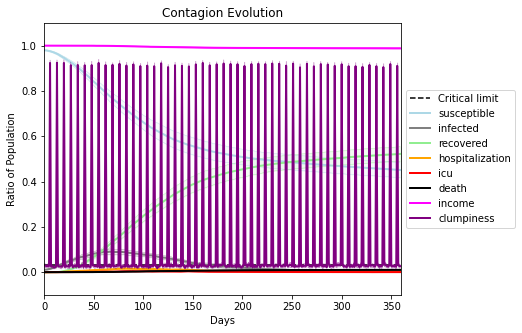

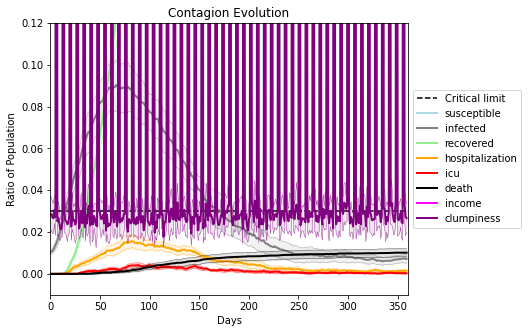

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[4293, 804, 5984, 2649, 8851, 4946, 5890, 5344, 4409, 8397, 3696, 8864, 2830, 4750, 7260, 5123, 2186, 4270, 4273, 5971]
Average similarity between family members is 0.2904948399549303 at temperature -0.6
Average similarity between family and home is 0.9998552806186636 at temperature -1
Average similarity between students and their classroom is 0.15103248981498324 at temperature -0.6
Average classroom occupancy is 3.6714285714285713 and number classrooms is 70
Average similarity between workers is 0.15847529736230603 at temperature -0.6
Average office occupancy is 3.4405940594059405 and number offices is 202
Average friend similarity for adults: 0.3790454336479241 for kids: 0.20068296152145695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.09749003958938948
avg restaurant similarity 0.009957452067836922
avg restaurant similarity 0.2700984263423243
avg restaurant similarity 0.01233747397541424
avg restaurant similarity 0.0663545855145106
avg restaurant similarity -0.11000366536908533
avg restaurant similarity 0.02199326606495113
avg restaurant similarity 0.2219046216838719
avg restaurant similarity 0.06823712638714675
avg restaurant similarity 0.12728907821792562
avg restaurant similarity -0.005274583777962926
avg restaurant similarity 0.1576277584337914
avg restaurant similarity -0.08443351189150511
avg restaurant similarity -0.2177364422867707
avg restaurant similarity 0.06518305249601127
avg restaurant similarity -0.06010662280816002
avg restaurant similarity 0.06463271469690356
avg restaurant similarity 0.07055759436912999
avg restaurant similarity 0.002937607616719769
avg restaurant similarity 0.05431801614535004
avg restaurant similarity 0.062035169106055325
avg restaurant similarity 0.16

avg restaurant similarity 0.11882578137697944
avg restaurant similarity 0.10617456794737666
avg restaurant similarity 0.36478577549562774
avg restaurant similarity 0.2296452447526693
avg restaurant similarity 0.17623434777321742
avg restaurant similarity 0.1183124235240163
avg restaurant similarity 0.2742967432570207
avg restaurant similarity 0.14307509450431646
avg restaurant similarity -0.07880485146389973
avg restaurant similarity -0.007976378936054743
avg restaurant similarity 0.1228329869624559
avg restaurant similarity 0.034415829534231564
avg restaurant similarity 0.0356868201863161
avg restaurant similarity -0.05775433744289657
avg restaurant similarity -0.12052161740108808
avg restaurant similarity 0.08308923463908129
avg restaurant similarity 0.07145988825049522
avg restaurant similarity 0.12831523684010815
avg restaurant similarity -0.02318681772936921
avg restaurant similarity 0.13268368871422412
avg restaurant similarity -0.0016113851969837372
avg restaurant similarity 0.1

avg restaurant similarity 0.21024923560061948
avg restaurant similarity 0.08763420138487808
avg restaurant similarity 0.04785055234252437
avg restaurant similarity 0.06274302754030238
avg restaurant similarity -0.02797875494135793
avg restaurant similarity 0.01266930341014734
avg restaurant similarity -0.11858259589067419
avg restaurant similarity 0.1299608232578014
avg restaurant similarity 0.08196571265964504
avg restaurant similarity 0.010079440257054456
avg restaurant similarity 0.2456426766196264
avg restaurant similarity 0.015945601802506516
avg restaurant similarity 0.0706113988328423
avg restaurant similarity 0.06695875820163552
avg restaurant similarity 0.3081890793871377
avg restaurant similarity 0.10589003938791852
avg restaurant similarity 0.25532480046812356
avg restaurant similarity 0.05398641839207246
avg restaurant similarity 0.35780755352548016
avg restaurant similarity 0.40084018394400667
avg restaurant similarity -0.23973331311720636
avg restaurant similarity -0.1573

avg restaurant similarity 0.21943413969888814
avg restaurant similarity 0.16407318736383733
avg restaurant similarity 0.06840900341989853
avg restaurant similarity 0.16800104564370139
avg restaurant similarity 0.0873882259757816
avg restaurant similarity 0.09723172510524716
avg restaurant similarity -0.19448269429011428
avg restaurant similarity 0.23868336490607656
avg restaurant similarity 0.01121310616961522
avg restaurant similarity 0.05214394931219737
avg restaurant similarity -0.1223173455743297
avg restaurant similarity 0.011755520572078114
avg restaurant similarity 0.3633861150983645
avg restaurant similarity -0.03551450491232488
avg restaurant similarity 0.08770597184282314
avg restaurant similarity 0.020554604269852235
avg restaurant similarity 0.14964793494127515
avg restaurant similarity 0.10812227198091386
avg restaurant similarity 0.08639200796881383
avg restaurant similarity -0.013303492304005836
avg restaurant similarity 0.01846426097630499
avg restaurant similarity -0.1

avg restaurant similarity 0.06423654947757264
avg restaurant similarity 0.17360225573849242
avg restaurant similarity 0.15201037081103966
avg restaurant similarity 0.12819781940351596
avg restaurant similarity -0.12196110295937994
avg restaurant similarity 0.12364940259109129
avg restaurant similarity 0.08051539172549402
avg restaurant similarity 0.31546801762210747
avg restaurant similarity 0.10674309581688171
avg restaurant similarity 0.14006870037452174
avg restaurant similarity 0.05110468581527723
avg restaurant similarity 0.10708167185866398
avg restaurant similarity 0.2055181887841751
avg restaurant similarity 0.004486516368648459
avg restaurant similarity 0.07248883141516534
avg restaurant similarity -0.039274913938117634
avg restaurant similarity -0.059744192619493805
avg restaurant similarity 0.08535951422750111
avg restaurant similarity -0.04685981599923165
avg restaurant similarity -0.02004656589096929
avg restaurant similarity 0.35167064942597465
avg restaurant similarity 0

avg restaurant similarity -0.023195456619992533
avg restaurant similarity -0.21312213060740226
avg restaurant similarity 0.20271974184261313
avg restaurant similarity -0.06516513590431741
avg restaurant similarity -0.07707563698374949
avg restaurant similarity 0.25073429706809464
avg restaurant similarity 0.30881501982874143
avg restaurant similarity 0.005233221134626015
avg restaurant similarity 0.13758220619059353
avg restaurant similarity 0.10928682180924183
avg restaurant similarity 0.18148708502720348
avg restaurant similarity -0.0595767162948295
avg restaurant similarity 0.30655373553122
avg restaurant similarity 0.14259436348027482
avg restaurant similarity -0.1277386044719551
avg restaurant similarity 0.10740008498100706
avg restaurant similarity 0.02298828280051824
avg restaurant similarity 0.214454295891299
avg restaurant similarity 0.1634618536840519
avg restaurant similarity 0.07740717950398375
avg restaurant similarity 0.2507023962912263
avg restaurant similarity -0.026429

avg restaurant similarity 0.03442470226403324
avg restaurant similarity 0.1915617165304385
avg restaurant similarity 0.1058111478854966
avg restaurant similarity -0.05899536830972607
avg restaurant similarity 0.2043040146601296
avg restaurant similarity 0.08125237459609211
avg restaurant similarity 0.13574500898886468
avg restaurant similarity 0.03274687392936738
avg restaurant similarity -0.1568682963876223
avg restaurant similarity 0.13727627807212203
avg restaurant similarity 0.11948301654410061
avg restaurant similarity 0.241316245551458
avg restaurant similarity 0.05787470902621259
avg restaurant similarity 0.2208336991334782
avg restaurant similarity -0.014773163918213773
avg restaurant similarity 0.07953490476446266
avg restaurant similarity 0.18127641574481324
avg restaurant similarity -0.24224566578126328
avg restaurant similarity 0.06813116624479096
avg restaurant similarity -0.06916287965598292
avg restaurant similarity -0.050770127724198845
avg restaurant similarity 0.06561

avg restaurant similarity 0.03326261193021052
avg restaurant similarity 0.2668659936266594
avg restaurant similarity 0.0896550793118809
avg restaurant similarity -0.11739581943055559
avg restaurant similarity 0.22251270223145947
avg restaurant similarity 0.1817352964996751
avg restaurant similarity 0.05088579953544449
avg restaurant similarity 0.09208002967642065
avg restaurant similarity 0.2484661655530219
avg restaurant similarity 0.021993957721701828
avg restaurant similarity 0.1302847067766739
avg restaurant similarity -0.12812710822503526
avg restaurant similarity 0.1816827256700281
avg restaurant similarity 0.057788501667996116
avg restaurant similarity 0.005970684697152094
avg restaurant similarity 0.14475345222970593
avg restaurant similarity -0.027550795780088642
avg restaurant similarity 0.05778014948152364
avg restaurant similarity 0.08224508652760618
avg restaurant similarity 0.2070126538218613
avg restaurant similarity 0.07448672496130479
avg restaurant similarity 0.240543

avg restaurant similarity 0.21873074789616795
avg restaurant similarity 0.24951009450798667
avg restaurant similarity -0.05584774804278456
avg restaurant similarity 0.1108376464820609
avg restaurant similarity -0.1581423011863302
avg restaurant similarity -0.11483944599558922
avg restaurant similarity -0.10117607879185306
avg restaurant similarity 0.2608999732832178
avg restaurant similarity 0.031282192694793244
avg restaurant similarity 0.08590591523116567
avg restaurant similarity 0.09773869542585041
avg restaurant similarity -0.05792865389283224
avg restaurant similarity 0.08526320429255986
avg restaurant similarity 0.06339167294282269
avg restaurant similarity -0.14154084248854082
avg restaurant similarity 0.2889027449003747
avg restaurant similarity 0.20294298349386833
avg restaurant similarity 0.31944383834384954
avg restaurant similarity 0.05206821427901575
avg restaurant similarity 0.04043503456044225
avg restaurant similarity 0.0763206522310966
avg restaurant similarity 0.0222

avg restaurant similarity -0.09489340932523815
avg restaurant similarity -0.04696959400554237
avg restaurant similarity 0.48836345284037397
avg restaurant similarity 0.11462278983156086
avg restaurant similarity -0.21042639240568406
avg restaurant similarity 0.028312499945322422
avg restaurant similarity 0.09462524891589615
avg restaurant similarity 0.26202058758064506
avg restaurant similarity 0.12562165631318803
avg restaurant similarity 0.15761332666133973
avg restaurant similarity 0.13779132018291276
avg restaurant similarity 0.27771545683388565
avg restaurant similarity 0.11009459035928275
avg restaurant similarity 0.1833127699551164
avg restaurant similarity -0.0541374364047286
avg restaurant similarity 0.06811131128840865
avg restaurant similarity 0.3253415608086188
avg restaurant similarity 0.06045271013531835
avg restaurant similarity 0.20572055490009356
avg restaurant similarity 0.22042007811533573
avg restaurant similarity -0.021733686007413714
avg restaurant similarity -0.0

avg restaurant similarity 0.057117164122378564
avg restaurant similarity 0.1446645816968111
avg restaurant similarity 0.2308968520418679
avg restaurant similarity -0.09802664840737339
avg restaurant similarity 0.026906117026551667
avg restaurant similarity 0.09203257123812739
avg restaurant similarity 0.07954361088039726
avg restaurant similarity 0.13470033629850667
avg restaurant similarity 0.06414593416560761
avg restaurant similarity 0.10372350718765505
avg restaurant similarity -0.03454648006376003
avg restaurant similarity 0.1313791988826466
avg restaurant similarity -0.007750897335485807
avg restaurant similarity -0.13881248997097373
avg restaurant similarity 0.03798295949690629
avg restaurant similarity -0.029573220879011
avg restaurant similarity 0.12221247802321258
avg restaurant similarity -0.00294422047865621
avg restaurant similarity 0.12557990661447857
avg restaurant similarity 0.14609966219915232
avg restaurant similarity -0.15210208444082918
avg restaurant similarity 0.1

avg restaurant similarity 0.1015595090612565
avg restaurant similarity 0.19385277390902061
avg restaurant similarity 0.05874793995039933
avg restaurant similarity 0.09783742688235504
avg restaurant similarity 0.028432960824392523
avg restaurant similarity -0.05300818763839297
avg restaurant similarity -0.05778777127152248
avg restaurant similarity -0.04128085396083113
avg restaurant similarity 0.17087576241761146
avg restaurant similarity -0.06257419845475734
avg restaurant similarity 0.01169372291493131
avg restaurant similarity 0.08795580661604536
avg restaurant similarity 0.21900740560478454
avg restaurant similarity 0.23291185666977887
avg restaurant similarity 0.07210833577969138
avg restaurant similarity 0.1706082209332397
avg restaurant similarity 0.23484699849684726
avg restaurant similarity 0.16144240454236042
avg restaurant similarity -0.04353929073634342
avg restaurant similarity 0.03200162802979765
avg restaurant similarity 0.1779643344479467
avg restaurant similarity -0.24

avg restaurant similarity -0.033980915164520405
avg restaurant similarity 0.19646438523169799
avg restaurant similarity 0.005985400147071407
avg restaurant similarity -0.016752818715732042
avg restaurant similarity 0.10207467478161537
avg restaurant similarity 0.08553492270036267
avg restaurant similarity 0.049727412387239725
avg restaurant similarity 0.09285358274246565
avg restaurant similarity -0.02223172668816472
avg restaurant similarity 0.11116476383907875
avg restaurant similarity -0.14970520159043585
avg restaurant similarity -0.1664969679717832
avg restaurant similarity -0.05113710451470488
avg restaurant similarity -0.06626822889690426
avg restaurant similarity 0.2848241803890167
avg restaurant similarity 0.11268877919489924
avg restaurant similarity 0.1786488713587716
avg restaurant similarity -0.09497043114477634
avg restaurant similarity 0.06334675134713494
avg restaurant similarity 0.10197876800660467
avg restaurant similarity 0.19813267392274952
avg restaurant similarity

avg restaurant similarity 0.06398276013513433
avg restaurant similarity 0.10180286689516449
avg restaurant similarity 0.281972288770909
avg restaurant similarity 0.00997165204899321
avg restaurant similarity 0.09999915515146932
avg restaurant similarity -0.009969340037438256
avg restaurant similarity 0.17003844136634283
avg restaurant similarity -0.025095452224423637
avg restaurant similarity 0.08889181904425639
avg restaurant similarity 0.18754656621656024
avg restaurant similarity 0.06336164883283286
avg restaurant similarity 0.17816424367100708
avg restaurant similarity -0.06017536543966192
avg restaurant similarity 0.016978202139903784
avg restaurant similarity -0.13123410037405914
avg restaurant similarity 0.06346364792394946
avg restaurant similarity 0.006641629560265962
avg restaurant similarity 0.1105633007777291
avg restaurant similarity 0.06179702741087699
avg restaurant similarity 0.02335189625621086
avg restaurant similarity 0.34169464022860796
avg restaurant similarity 0.0

avg restaurant similarity 0.1146226873216472
avg restaurant similarity 0.0878246586536965
avg restaurant similarity 0.10626271314278844
avg restaurant similarity -0.09550271539702533
avg restaurant similarity 0.17764891320110057
avg restaurant similarity 0.15836751615497452
avg restaurant similarity 0.041301067994087164
avg restaurant similarity 0.1465445708178793
avg restaurant similarity 0.11052036931920033
avg restaurant similarity -0.07821339455698763
avg restaurant similarity 0.05885275013624917
avg restaurant similarity 0.18813301805740823
avg restaurant similarity -0.1314561743139181
avg restaurant similarity 0.27520080309286654
avg restaurant similarity -0.2944455798039467
avg restaurant similarity 0.30394338233563484
avg restaurant similarity -0.02963903075752681
avg restaurant similarity 0.043785465627153686
avg restaurant similarity 0.024994484428787135
avg restaurant similarity 0.024178489080552163
avg restaurant similarity 0.09461693800655567
avg restaurant similarity 0.10

avg restaurant similarity 0.283219235487865
avg restaurant similarity 0.10489494227368422
avg restaurant similarity -0.17359177286414865
avg restaurant similarity 0.036578207626984494
avg restaurant similarity 0.39670388734799045
avg restaurant similarity 0.12019966593393533
avg restaurant similarity 0.0071748302702056566
avg restaurant similarity -0.041913842490533246
avg restaurant similarity 0.3346884166436236
avg restaurant similarity 0.031985223782153446
avg restaurant similarity 0.023311011182247227
avg restaurant similarity 0.07960592383262141
avg restaurant similarity 0.34831941720032084
avg restaurant similarity 0.2947182239722469
avg restaurant similarity -0.029897601290820638
avg restaurant similarity -0.023219447423947492
avg restaurant similarity -0.05953251675002531
avg restaurant similarity 0.1723917978926435
avg restaurant similarity 0.049559581223964845
avg restaurant similarity -0.05789971546940677
avg restaurant similarity 0.09997107996932542
avg restaurant similarit

avg restaurant similarity 0.03880595073746893
avg restaurant similarity -0.027766537953209228
avg restaurant similarity 0.07100460596120449
avg restaurant similarity 0.26207390044843504
avg restaurant similarity 0.20234615494608396
avg restaurant similarity 0.1849552397523134
avg restaurant similarity 0.09892311738851853
avg restaurant similarity 0.08107026359677402
avg restaurant similarity 0.14565626384209587
avg restaurant similarity 0.09884110461473491
avg restaurant similarity 0.2616695157624869
avg restaurant similarity 0.1895485425582208
avg restaurant similarity 0.11629143002717154
avg restaurant similarity 0.0678965488493446
avg restaurant similarity 0.09634286982733319
avg restaurant similarity 0.14924344052655508
avg restaurant similarity 0.18055409552741636
avg restaurant similarity 0.15205543721977252
avg restaurant similarity 0.0134460756392794
avg restaurant similarity 0.019924277677422757
avg restaurant similarity 0.10399995798231769
avg restaurant similarity 0.02481903

avg restaurant similarity 0.042457496424861865
avg restaurant similarity 0.07554005895580086
avg restaurant similarity -0.01752881117442984
avg restaurant similarity 0.1493608336269653
avg restaurant similarity 0.10827657415043246
avg restaurant similarity 0.010799881198705348
avg restaurant similarity 0.11373632377041286
avg restaurant similarity 0.469983780813209
avg restaurant similarity 0.046552963516779296
avg restaurant similarity -0.07053605287819585
avg restaurant similarity 0.1282722669790026
avg restaurant similarity 0.14301430119272013
avg restaurant similarity 0.029627369572933646
avg restaurant similarity 0.1190968512259872
avg restaurant similarity 0.11591051341091155
avg restaurant similarity 0.13384735012441973
avg restaurant similarity 0.04930606647015764
avg restaurant similarity 0.15539530132818843
avg restaurant similarity 0.2742899287431504
avg restaurant similarity 0.040344901944226595
avg restaurant similarity 0.12558478209892443
avg restaurant similarity 0.12468

avg restaurant similarity 0.20715540955172823
avg restaurant similarity 0.0827010153272984
avg restaurant similarity 0.04874374938986755
avg restaurant similarity -0.020112957979691367
avg restaurant similarity 0.06613240736608837
avg restaurant similarity 0.29677019937626453
avg restaurant similarity 0.08749953009798703
avg restaurant similarity 0.3555867078914215
avg restaurant similarity 0.2789638528490329
avg restaurant similarity -0.1529927811295408
avg restaurant similarity 0.12467822844459557
avg restaurant similarity 0.1342044469901948
avg restaurant similarity 0.0419451673339757
avg restaurant similarity 0.3200890955725832
avg restaurant similarity 0.10783060027708613
avg restaurant similarity 0.28984854153380063
avg restaurant similarity -0.09615790491500821
avg restaurant similarity 0.1181888649061134
avg restaurant similarity -0.08337093918201861
avg restaurant similarity 0.012533186050522302
avg restaurant similarity 0.11236593280804422
avg restaurant similarity 0.12702955

avg restaurant similarity 0.2128756815290291
avg restaurant similarity 0.026085263657148482
avg restaurant similarity -0.04213698828531479
avg restaurant similarity 0.31792095442579943
avg restaurant similarity 0.13906437845631883
avg restaurant similarity 0.15617975181277063
avg restaurant similarity 0.11238907540095336
avg restaurant similarity 0.11074382376803922
avg restaurant similarity 0.1868305168129696
avg restaurant similarity 0.21488296770964094
avg restaurant similarity 0.11085005056743935
avg restaurant similarity 0.10988520923718062
avg restaurant similarity 0.23838380602745549
avg restaurant similarity 0.2646040542479301
avg restaurant similarity -0.006769428440218231
avg restaurant similarity -0.0036129548692001093
avg restaurant similarity -0.016359279233725002
avg restaurant similarity 0.03768420862590104
avg restaurant similarity 0.15806134372268257
avg restaurant similarity 0.06914510054359556
avg restaurant similarity -0.025452291601739094
avg restaurant similarity 

avg restaurant similarity 0.09460308969782558
avg restaurant similarity 0.052626843228255483
avg restaurant similarity 0.24078043648217143
avg restaurant similarity 0.06895094356833693
avg restaurant similarity 0.008319677960789619
avg restaurant similarity 0.23139016235111257
avg restaurant similarity 0.06829662964576264
avg restaurant similarity 0.08992932018061729
avg restaurant similarity -0.050914034513066954
avg restaurant similarity 0.20773929497808977
avg restaurant similarity 0.11494891761766352
avg restaurant similarity 0.24590519885817747
avg restaurant similarity 0.10524727256976177
avg restaurant similarity 0.23731279524400284
avg restaurant similarity 0.36544635181843993
avg restaurant similarity -0.009487377325351667
avg restaurant similarity 0.0626086704328755
avg restaurant similarity 0.09454592094582048
avg restaurant similarity 0.1398012019130392
avg restaurant similarity 0.3498731749779612
avg restaurant similarity 0.20090756702119428
avg restaurant similarity 0.150

avg restaurant similarity 0.09405327892837564
avg restaurant similarity 0.2763516660445547
avg restaurant similarity 0.1703352262803374
avg restaurant similarity -0.08342549303385503
avg restaurant similarity -0.079011628537434
avg restaurant similarity -0.029209062685957656
avg restaurant similarity 0.08422478193851748
avg restaurant similarity -0.08487991014002992
avg restaurant similarity 0.04950636274568929
avg restaurant similarity 0.0007221131583204273
avg restaurant similarity 0.0443564512414537
avg restaurant similarity -0.1251134999823185
avg restaurant similarity 0.014490365962516776
avg restaurant similarity 0.04005942431341514
avg restaurant similarity 0.08813095448737741
avg restaurant similarity 0.08511781123920518
avg restaurant similarity 0.25719217743196027
avg restaurant similarity 0.31916265920843656
avg restaurant similarity 0.17708969211378955
avg restaurant similarity 0.045079761746868494
avg restaurant similarity 0.25374996712834214
avg restaurant similarity 0.08

avg restaurant similarity 0.04601182127690748
avg restaurant similarity 0.1544981005298729
avg restaurant similarity 0.31658463268985465
avg restaurant similarity -0.021527254274681412
avg restaurant similarity 0.10183058715359661
avg restaurant similarity 0.07965530421924412
avg restaurant similarity 0.017208299362867514
avg restaurant similarity 0.044886536253303584
avg restaurant similarity 0.016127032046601267
avg restaurant similarity 0.23350782487710342
avg restaurant similarity -0.04982377280090987
avg restaurant similarity 0.02194074248507469
avg restaurant similarity 0.10935067727042298
avg restaurant similarity -0.11804525045721939
avg restaurant similarity -0.00669344191135873
avg restaurant similarity -0.13137459971501325
avg restaurant similarity 0.12222631331155331
avg restaurant similarity -0.390576285193214
avg restaurant similarity -0.1455922935539712
avg restaurant similarity 0.3571408945192005
avg restaurant similarity 0.046201602260850905
avg restaurant similarity 0

avg restaurant similarity 0.10831047447182418
avg restaurant similarity 0.006329150045539733
avg restaurant similarity 0.14879509411084388
avg restaurant similarity 0.07220471800444461
avg restaurant similarity 0.11601415801698949
avg restaurant similarity 0.0988279532635768
avg restaurant similarity 0.17698438623798818
avg restaurant similarity 0.05187371897397901
avg restaurant similarity 0.20838993895481556
avg restaurant similarity 0.0007929778321268298
avg restaurant similarity 0.3498891300774178
avg restaurant similarity -0.015293506431134418
avg restaurant similarity 0.18061138852974237
avg restaurant similarity 0.17523134312217986
avg restaurant similarity 0.05380002920842898
avg restaurant similarity 0.19206600174152655
avg restaurant similarity 0.09156252777112989
avg restaurant similarity -0.022393973161073055
avg restaurant similarity -0.0023444072879662214
avg restaurant similarity 0.185179198259699
avg restaurant similarity 0.11185150007954063
avg restaurant similarity 0.

avg restaurant similarity 0.08815097788105497
avg restaurant similarity 0.10994004813190258
avg restaurant similarity 0.11514161990043394
avg restaurant similarity 0.10110319898825101
avg restaurant similarity 0.024494800633120095
avg restaurant similarity 0.07997682391440537
avg restaurant similarity 0.09321235586418426
avg restaurant similarity -0.15795404955607262
avg restaurant similarity 0.12415366196543773
avg restaurant similarity 0.3012596263730401
avg restaurant similarity 0.2439611157539584
avg restaurant similarity 0.051931659138500126
avg restaurant similarity 0.2212800400232504
avg restaurant similarity 0.1212832730273284
avg restaurant similarity 0.149772083476587
avg restaurant similarity 0.021154195423085546
avg restaurant similarity 0.18262976802978806
avg restaurant similarity 0.25056668851971675
avg restaurant similarity 0.2526237690772805
avg restaurant similarity 0.10672864343569742
avg restaurant similarity -0.061855238134418414
avg restaurant similarity -0.021565

avg restaurant similarity 0.20028303685074378
avg restaurant similarity 0.3184662540926369
avg restaurant similarity 0.1170804452598961
avg restaurant similarity 0.5154799893723564
avg restaurant similarity 0.16534591550012437
avg restaurant similarity -0.09625304546403426
avg restaurant similarity -0.03526471462682227
avg restaurant similarity 0.07198633737766705
avg restaurant similarity 0.028268357806580095
avg restaurant similarity 0.12173863735186607
avg restaurant similarity 0.1131755085845388
avg restaurant similarity 0.21748142143977142
avg restaurant similarity 0.16072771085821577
avg restaurant similarity 0.15545299814248564
avg restaurant similarity 0.15068776165946884
avg restaurant similarity 0.06251321453874059
avg restaurant similarity 0.2130203047437253
avg restaurant similarity 0.0844901482509932
avg restaurant similarity 0.031018479568396512
avg restaurant similarity 0.18944456786390773
avg restaurant similarity 0.25691455106249567
avg restaurant similarity 0.17695129

avg restaurant similarity 0.17925274896625115
avg restaurant similarity -0.03616455014427336
avg restaurant similarity 0.18399897083844474
avg restaurant similarity 0.09956984008810583
avg restaurant similarity 0.09259079949333823
avg restaurant similarity 0.028763823419278484
avg restaurant similarity 0.11281600680541089
avg restaurant similarity -0.07938934650975386
avg restaurant similarity 0.04299592973549808
avg restaurant similarity 0.14777008162602334
avg restaurant similarity 0.14741031068580415
avg restaurant similarity 0.26663245722160456
avg restaurant similarity -0.00841843951839287
avg restaurant similarity 0.20579853491276262
avg restaurant similarity 0.1645646950464295
avg restaurant similarity 0.13974165165684807
avg restaurant similarity 0.21537455915032422
avg restaurant similarity 0.07452611432586145
avg restaurant similarity 0.08857717608911339
avg restaurant similarity 0.1393558633942284
avg restaurant similarity 0.3197187719546729
avg restaurant similarity -0.0092

avg restaurant similarity -0.038646063471789616
avg restaurant similarity -0.010784618525271267
avg restaurant similarity 0.1895131157783767
avg restaurant similarity 0.21329008775959957
avg restaurant similarity 0.14529738941834994
avg restaurant similarity 0.08703020734757606
avg restaurant similarity 0.16982836501247306
avg restaurant similarity 0.03251116615874641
avg restaurant similarity -0.1504650187698449
avg restaurant similarity 0.10866728035710127
avg restaurant similarity -0.11307876643069029
avg restaurant similarity 0.1346591481470935
avg restaurant similarity 0.10531361218924976
avg restaurant similarity 0.03716901463304386
avg restaurant similarity 0.21418828380371352
avg restaurant similarity 0.19333264678953793
avg restaurant similarity 0.11781957023191643
avg restaurant similarity 0.04379502419307584
avg restaurant similarity 0.07138871621663989
avg restaurant similarity 0.11403536386284466
avg restaurant similarity -0.20478585764110846
avg restaurant similarity -0.0

avg restaurant similarity 0.13933341727318033
avg restaurant similarity 0.04536417838000207
avg restaurant similarity 0.017282076476436405
avg restaurant similarity -0.07665918427916307
avg restaurant similarity -0.15585999424920555
avg restaurant similarity 0.09708171797941371
avg restaurant similarity 0.1370571681736167
avg restaurant similarity 0.23706975169350578
avg restaurant similarity 0.050133695514899546
avg restaurant similarity 0.15833286494229581
avg restaurant similarity 0.20885150816191253
avg restaurant similarity 0.09307767756340987
avg restaurant similarity 0.16055355144330627
avg restaurant similarity 0.11404293149531658
avg restaurant similarity -0.032423010455198686
avg restaurant similarity 0.17824076973608097
avg restaurant similarity -0.02513444014976006
avg restaurant similarity 0.11358584280211637
avg restaurant similarity 0.21801283187194445
avg restaurant similarity 0.21519603630187703
avg restaurant similarity -0.10080643363328035
avg restaurant similarity -

avg restaurant similarity 0.1598097849893531
avg restaurant similarity 0.21033246369601077
avg restaurant similarity 0.37696519949913765
avg restaurant similarity -0.10964659343914422
avg restaurant similarity 0.06546726532576988
avg restaurant similarity 0.10067098318106406
avg restaurant similarity 0.07144790832430416
avg restaurant similarity 0.39769157278794526
avg restaurant similarity 0.1978928117826737
avg restaurant similarity 0.07177021442696387
avg restaurant similarity 0.07463072040949013
avg restaurant similarity 0.1003826934596005
avg restaurant similarity 0.04627297608865305
avg restaurant similarity 0.14176352738545753
avg restaurant similarity 0.21172393748201268
avg restaurant similarity 0.09936782346626195
avg restaurant similarity 0.2712493547219219
avg restaurant similarity 0.010384778615660362
avg restaurant similarity 0.2717711568668026
avg restaurant similarity -0.10608340533475451
avg restaurant similarity 0.02352652089388824
avg restaurant similarity 0.11152845

avg restaurant similarity -0.007735456287789762
avg restaurant similarity 0.2917189975817769
avg restaurant similarity 0.07622451074097376
avg restaurant similarity -0.030703677633041195
avg restaurant similarity 0.22356265280527382
avg restaurant similarity 0.09161564597680465
avg restaurant similarity 0.10024969188996383
avg restaurant similarity 0.14391307879936743
avg restaurant similarity -0.019669731638759045
avg restaurant similarity 0.31411889645467833
avg restaurant similarity 0.08180669792982083
avg restaurant similarity -0.020766303339912223
avg restaurant similarity 0.2109203609390442
avg restaurant similarity 0.058355152213157846
avg restaurant similarity 0.22643339271930488
avg restaurant similarity -0.07900177537433735
avg restaurant similarity 0.024873208870190795
avg restaurant similarity -0.0022818460641303474
avg restaurant similarity 0.12101997778634321
avg restaurant similarity 0.004226105451833223
avg restaurant similarity 0.13350415069380206
avg restaurant simila

avg restaurant similarity -0.007175851325158869
avg restaurant similarity 0.09230256423306456
avg restaurant similarity -0.05326823624515144
avg restaurant similarity -0.08407514109955198
avg restaurant similarity -0.06363340144971605
avg restaurant similarity 0.08859297482828857
avg restaurant similarity 0.18639193025033174
avg restaurant similarity 0.24963786707965455
avg restaurant similarity 0.15376030245557987
avg restaurant similarity 0.12027261906503599
avg restaurant similarity 0.16568858567105324
avg restaurant similarity 0.23808524473353032
avg restaurant similarity 0.12037547961182665
avg restaurant similarity 0.09951069854518338
avg restaurant similarity 0.09426630529134487
avg restaurant similarity 0.08235790771880704
avg restaurant similarity 0.06288754051909184
avg restaurant similarity 0.0868171065215296
avg restaurant similarity -0.0016982321528898725
avg restaurant similarity 0.0013583385137744743
avg restaurant similarity 0.06349116178504843
avg restaurant similarity

avg restaurant similarity 0.1496012538065227
avg restaurant similarity 0.19306204195483298
avg restaurant similarity 0.17034995738214043
avg restaurant similarity 0.00016342432875892377
avg restaurant similarity 0.1989621311779492
avg restaurant similarity 0.11476359027192588
avg restaurant similarity 0.13125417509854911
avg restaurant similarity 0.1357993623398853
avg restaurant similarity 0.11509584558362979
avg restaurant similarity -0.048070232694922055
avg restaurant similarity 0.03536148804074055
avg restaurant similarity 0.09231919317900879
avg restaurant similarity 0.2687482293327676
avg restaurant similarity 0.03626038957645141
avg restaurant similarity 0.21157689032314322
avg restaurant similarity 0.28354753184770565
avg restaurant similarity 0.3267422598461189
avg restaurant similarity 0.21994981538249786
avg restaurant similarity 0.12838191755464942
avg restaurant similarity -0.014735992741136877
avg restaurant similarity 0.028263917373257494
avg restaurant similarity -0.00

avg restaurant similarity 0.09606475396394883
avg restaurant similarity 0.07560993012651698
avg restaurant similarity 0.12199986731883636
avg restaurant similarity 0.09487988436445882
avg restaurant similarity 0.19795387346157414
avg restaurant similarity -0.0013131205827333532
avg restaurant similarity 0.056363532805295095
avg restaurant similarity 0.17024006004802436
avg restaurant similarity 0.12422690475641249
avg restaurant similarity 0.08250995472703258
avg restaurant similarity -0.013571964795700003
avg restaurant similarity 0.04006111080827768
avg restaurant similarity 0.2506132317906812
avg restaurant similarity 0.09911222262945658
avg restaurant similarity 0.21213972454095284
avg restaurant similarity 0.10416706783437785
avg restaurant similarity 0.13450227634440248
avg restaurant similarity -0.00729290288299371
avg restaurant similarity 0.18016526398319288
avg restaurant similarity 0.06725675713774076
avg restaurant similarity -0.02843008334641354
avg restaurant similarity -

avg restaurant similarity 0.2076314738950988
avg restaurant similarity 0.2389733867620425
avg restaurant similarity 0.0288404208311053
avg restaurant similarity -0.014105324364236687
avg restaurant similarity 0.030456771800894292
avg restaurant similarity 0.789136501156106
avg restaurant similarity 0.020282199322961575
avg restaurant similarity 0.20651350329621943
avg restaurant similarity 0.25347031859889335
avg restaurant similarity 0.32243903788300887
avg restaurant similarity 0.13960712475464418
avg restaurant similarity 0.2568426427214622
avg restaurant similarity 0.01526445356666435
avg restaurant similarity 0.30300930554701644
avg restaurant similarity 0.12156113843715179
avg restaurant similarity 0.21149970488493264
avg restaurant similarity -0.15486906708560663
avg restaurant similarity 0.09912963415976929
avg restaurant similarity 0.21860324335921352
avg restaurant similarity 0.2587339515182952
avg restaurant similarity 0.3484671468214332
avg restaurant similarity 0.300098372

avg restaurant similarity 0.013840911091367689
avg restaurant similarity 0.14158019082457132
avg restaurant similarity 0.30391964671040694
avg restaurant similarity 0.04657947376383747
avg restaurant similarity 0.16915774986941068
avg restaurant similarity 0.04547721585750533
avg restaurant similarity 0.15208237058106508
avg restaurant similarity -0.15665653168835666
avg restaurant similarity 0.048861736304653354
avg restaurant similarity 0.4435863333512001
avg restaurant similarity -0.0073094727868531426
avg restaurant similarity 0.1962679391887546
avg restaurant similarity 0.10840848109457003
avg restaurant similarity 0.12420001578604431
avg restaurant similarity 0.11770069742365731
avg restaurant similarity 0.23517963506013395
avg restaurant similarity 0.06591382284125909
avg restaurant similarity 0.014771408167194628
avg restaurant similarity 0.14508531461384588
avg restaurant similarity -0.008944137665418156
avg restaurant similarity -0.0775169270505954
avg restaurant similarity 0

avg restaurant similarity 0.16277932914073323
avg restaurant similarity 0.0025490859019917525
avg restaurant similarity 0.058177176262746336
avg restaurant similarity 0.21089878756387645
avg restaurant similarity -0.0024932765608399244
avg restaurant similarity 0.14909843927319316
avg restaurant similarity 0.1564714028994597
avg restaurant similarity 0.2251766415553195
avg restaurant similarity -0.07855337520575015
avg restaurant similarity 0.03802381530102631
avg restaurant similarity -0.1724081886587631
avg restaurant similarity 0.09554677178467572
avg restaurant similarity 0.12014524528771808
avg restaurant similarity 0.14321156113219322
avg restaurant similarity -0.058740948391162444
avg restaurant similarity 0.22388340397529463
avg restaurant similarity 0.36599729056891095
avg restaurant similarity 0.35995947844228177
avg restaurant similarity 0.23688201985463886
avg restaurant similarity 0.08988583049099093
avg restaurant similarity 0.2603592396166218
avg restaurant similarity 0.

avg restaurant similarity 0.012394240131721843
avg restaurant similarity 0.12482171036314467
avg restaurant similarity 0.0804260176008586
avg restaurant similarity 0.15463554539826926
avg restaurant similarity 0.2603325496690822
avg restaurant similarity -0.04144600324542599
avg restaurant similarity 0.007034643161392137
avg restaurant similarity -0.09036389073205166
avg restaurant similarity 0.18322194383221846
avg restaurant similarity 0.15771607733329968
avg restaurant similarity 0.09344128414354556
avg restaurant similarity -0.004729214893511341
avg restaurant similarity 0.11508753982574786
avg restaurant similarity -0.05260273798974966
avg restaurant similarity 0.33864403202765947
avg restaurant similarity 0.056397559900884214
avg restaurant similarity 0.2173835548742656
avg restaurant similarity 0.0867706432430275
avg restaurant similarity 0.16801947730751463
avg restaurant similarity 0.2161224823535868
avg restaurant similarity 0.09903482928270078
avg restaurant similarity 0.090

avg restaurant similarity 0.07517973943894794
avg restaurant similarity 0.038800356014253794
avg restaurant similarity 0.20068128265729898
avg restaurant similarity 0.09712848943820278
avg restaurant similarity 0.20503197896667952
avg restaurant similarity -0.1999347542139597
avg restaurant similarity -0.0650622643426076
avg restaurant similarity 0.11163335012184143
avg restaurant similarity 0.07351604541266962
avg restaurant similarity 0.16959409992202948
avg restaurant similarity -0.048431410870729094
avg restaurant similarity -0.019380166987866095
avg restaurant similarity 0.1616897933302497
avg restaurant similarity 0.0711898014105067
avg restaurant similarity 0.2349025884123459
avg restaurant similarity 0.038965048545971465
avg restaurant similarity 0.16026256571357006
avg restaurant similarity 0.0373439332517385
avg restaurant similarity 0.041114402820517405
avg restaurant similarity 0.12255815008469699
avg restaurant similarity 0.12606705881425742
avg restaurant similarity -0.10

avg restaurant similarity 0.0808427912091451
avg restaurant similarity 0.06957292038946337
avg restaurant similarity -0.15915232643891525
avg restaurant similarity 0.16373048710283153
avg restaurant similarity 0.17857633579751284
avg restaurant similarity -0.1044580096856212
avg restaurant similarity 0.17342622767690433
avg restaurant similarity 0.11087404087815814
avg restaurant similarity 0.02101182666306632
avg restaurant similarity 0.03117449535609534
avg restaurant similarity 0.038707108837698075
avg restaurant similarity 0.07131600313337173
avg restaurant similarity 0.141637930246664
avg restaurant similarity -0.010618803524757671
avg restaurant similarity -0.0587309366976611
avg restaurant similarity 0.011229861396180171
avg restaurant similarity 0.10829070035842184
avg restaurant similarity 0.1386072096602312
avg restaurant similarity 0.05580230300407694
avg restaurant similarity 0.10970669463466627
avg restaurant similarity 0.04094004894735474
avg restaurant similarity 0.02325

(<function dict.items>, <function dict.items>, <function dict.items>)

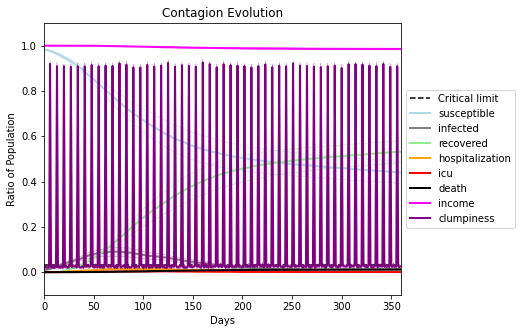

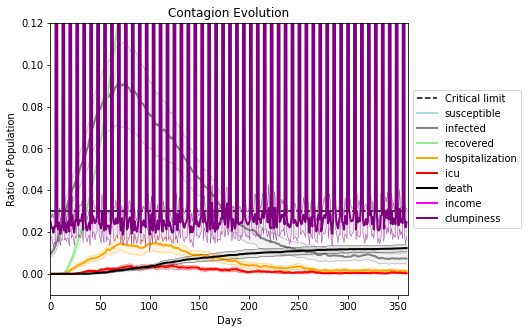

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7576, 2115, 9545, 7371, 1222, 8518, 408, 563, 7991, 442, 4415, 7363, 6279, 81, 979, 3378, 9453, 7011, 8146, 5657]
Average similarity between family members is 0.2721438732957426 at temperature -0.5
Average similarity between family and home is 0.9998453772094374 at temperature -1
Average similarity between students and their classroom is 0.1898100142056176 at temperature -0.5
Average classroom occupancy is 4 and number classrooms is 71
Average similarity between workers is 0.18337561022682114 at temperature -0.5
Average office occupancy is 3.263959390862944 and number offices is 197
Average friend similarity for adults: 0.34213143691075 for kids: 0.22118939809462024
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 

avg restaurant similarity -0.21260789542848793
avg restaurant similarity 0.042264637835646504
avg restaurant similarity -0.02511793807135404
avg restaurant similarity 0.0345859053093795
avg restaurant similarity -0.00562573995526507
avg restaurant similarity 0.052188785443897906
avg restaurant similarity 0.053285396916552166
avg restaurant similarity 0.29838281321034954
avg restaurant similarity 0.09099708389277086
avg restaurant similarity 0.034473468534981615
avg restaurant similarity 0.34159354626705163
avg restaurant similarity 0.019020329216013567
avg restaurant similarity -0.004992424955927844
avg restaurant similarity 0.021161335495104305
avg restaurant similarity 0.06768772700762993
avg restaurant similarity 0.40453539177511844
avg restaurant similarity 0.06390018294621942
avg restaurant similarity 0.3096666546068309
avg restaurant similarity 0.1851906124427858
avg restaurant similarity 0.2292003851960421
avg restaurant similarity 0.16523637802250696
avg restaurant similarity 0

avg restaurant similarity 0.14282408734849622
avg restaurant similarity 0.024262879192748908
avg restaurant similarity 0.10629043190153556
avg restaurant similarity -0.08335050083307186
avg restaurant similarity 0.11323814785136195
avg restaurant similarity 0.10556413989477295
avg restaurant similarity 0.04234692770366374
avg restaurant similarity 0.20592960513246483
avg restaurant similarity 0.15334064984130388
avg restaurant similarity 0.1508177923992875
avg restaurant similarity 0.26539328520028693
avg restaurant similarity 0.2922748399426175
avg restaurant similarity 0.15849321621898443
avg restaurant similarity 0.44208220730398085
avg restaurant similarity 0.06373076535588587
avg restaurant similarity -0.04772211834466941
avg restaurant similarity -0.10544988555669305
avg restaurant similarity 0.3685031274973373
avg restaurant similarity 0.14008888312387238
avg restaurant similarity 0.13583324457592286
avg restaurant similarity 0.3319581544871848
avg restaurant similarity 0.267146

avg restaurant similarity 0.12838297618846028
avg restaurant similarity 0.08656908075652087
avg restaurant similarity -0.04024141299990008
avg restaurant similarity 0.058646935338639315
avg restaurant similarity -0.02694002621372726
avg restaurant similarity 0.08980951625660515
avg restaurant similarity 0.07707765395198508
avg restaurant similarity 0.22292660504649733
avg restaurant similarity 0.043669004771035726
avg restaurant similarity 0.15368555202317247
avg restaurant similarity 0.07764236963215054
avg restaurant similarity 0.1624041242459572
avg restaurant similarity 0.19056384013678054
avg restaurant similarity -0.03798510552344001
avg restaurant similarity 0.4632729141822889
avg restaurant similarity 0.21844890269696154
avg restaurant similarity 0.0028563303685008854
avg restaurant similarity 0.167436190445837
avg restaurant similarity 0.25510597524386924
avg restaurant similarity 0.13870566386716518
avg restaurant similarity 0.15997837372911738
avg restaurant similarity 0.137

avg restaurant similarity 0.13848711391549573
avg restaurant similarity -0.0880056615090329
avg restaurant similarity -0.072030113982027
avg restaurant similarity 0.2386154051443519
avg restaurant similarity 0.018795752419555365
avg restaurant similarity -0.017778897311508206
avg restaurant similarity 0.22760809860491296
avg restaurant similarity -0.30115091189053017
avg restaurant similarity -0.08734105095330813
avg restaurant similarity 0.07632662092197418
avg restaurant similarity 0.21316411914104555
avg restaurant similarity 0.07704129514449469
avg restaurant similarity -0.05619311351732101
avg restaurant similarity -0.10461297161523682
avg restaurant similarity 0.08037587545845114
avg restaurant similarity 0.14334292306989363
avg restaurant similarity 0.35918809060729817
avg restaurant similarity -0.09892944199173513
avg restaurant similarity -0.018005354460708885
avg restaurant similarity -0.08409117339868043
avg restaurant similarity 0.1272279026422145
avg restaurant similarity 

avg restaurant similarity 0.2261479984338716
avg restaurant similarity -0.09828226177448961
avg restaurant similarity 0.15799150314294935
avg restaurant similarity 0.243252027695343
avg restaurant similarity -0.08061604373999555
avg restaurant similarity 0.048081677179720915
avg restaurant similarity 0.1062341102589933
avg restaurant similarity 0.24533567274428245
avg restaurant similarity 0.12520323603493083
avg restaurant similarity 0.3138369530383068
avg restaurant similarity 0.20961151683866364
avg restaurant similarity -0.06554017585755281
avg restaurant similarity 0.08813208954869937
avg restaurant similarity -0.01465563975538775
avg restaurant similarity -0.016492653771273066
avg restaurant similarity 0.07985814293139518
avg restaurant similarity 0.254439909662671
avg restaurant similarity 0.11655092680238062
avg restaurant similarity 0.34831345424659826
avg restaurant similarity 0.05344193115581138
avg restaurant similarity 0.08327970457243966
avg restaurant similarity 0.126199

avg restaurant similarity 0.04470987556709025
avg restaurant similarity 0.3446269195176218
avg restaurant similarity 0.06624064377270632
avg restaurant similarity 0.08315520239711166
avg restaurant similarity 0.18546062146677073
avg restaurant similarity -0.013393499312003718
avg restaurant similarity 0.19533121091864095
avg restaurant similarity 0.15316522561211213
avg restaurant similarity 0.3448231551023428
avg restaurant similarity 0.36617572919472324
avg restaurant similarity 0.20402976572355183
avg restaurant similarity 0.22924691981746076
avg restaurant similarity 0.05079106357027989
avg restaurant similarity -0.02414845843454204
avg restaurant similarity 0.12477050934600485
avg restaurant similarity 0.0787104058448507
avg restaurant similarity -0.3112506498738839
avg restaurant similarity 0.11436034947213608
avg restaurant similarity 0.0907044915695892
avg restaurant similarity -0.04577311733349317
avg restaurant similarity 0.07730773996664013
avg restaurant similarity 0.249675

avg restaurant similarity 0.16585116627759777
avg restaurant similarity 0.057825477561492415
avg restaurant similarity 0.18341746000530348
avg restaurant similarity -0.083897044958681
avg restaurant similarity -0.003704293041414921
avg restaurant similarity -0.016111105340117643
avg restaurant similarity 0.1317132537588049
avg restaurant similarity 0.2588100974784533
avg restaurant similarity 0.26768610903985834
avg restaurant similarity 0.014948082189173297
avg restaurant similarity 0.21078499835437334
avg restaurant similarity 0.1653496860433553
avg restaurant similarity 0.0521213522323433
avg restaurant similarity 0.2145052330646908
avg restaurant similarity -0.09253515331344314
avg restaurant similarity 0.4499468021789087
avg restaurant similarity 0.4486615197324787
avg restaurant similarity 0.26139954780418867
avg restaurant similarity 0.2826869419105073
avg restaurant similarity -0.015133545073443458
avg restaurant similarity -0.03647890391308864
avg restaurant similarity 0.01684

avg restaurant similarity 0.0706756223559369
avg restaurant similarity 0.23421013038771782
avg restaurant similarity 0.044816070105418895
avg restaurant similarity 0.05720095336582462
avg restaurant similarity -0.14988942269368216
avg restaurant similarity 0.1209683331239731
avg restaurant similarity 0.18329277141138525
avg restaurant similarity -0.11571796723670194
avg restaurant similarity 0.07320942330636028
avg restaurant similarity 0.2930413275403179
avg restaurant similarity 0.13420314774535932
avg restaurant similarity -0.09408108994941745
avg restaurant similarity 0.08523632912745438
avg restaurant similarity 0.08682245878277145
avg restaurant similarity 0.10345379840652373
avg restaurant similarity 0.1935361844855289
avg restaurant similarity 0.07457888115347736
avg restaurant similarity 0.2525808519155221
avg restaurant similarity 0.08773358859059872
avg restaurant similarity 0.08194211149919187
avg restaurant similarity -0.07199519778656227
avg restaurant similarity -0.00166

avg restaurant similarity 0.10001826661873119
avg restaurant similarity 0.31979188577322426
avg restaurant similarity 0.23482457920897049
avg restaurant similarity 0.1584647368655575
avg restaurant similarity 0.05667536622115471
avg restaurant similarity 0.10492478601237944
avg restaurant similarity 0.0496082962018191
avg restaurant similarity 0.06814581300858992
avg restaurant similarity -0.1563420174195414
avg restaurant similarity -0.1381730443464139
avg restaurant similarity 0.0185630554146321
avg restaurant similarity 0.110032678852019
avg restaurant similarity 0.19450546662066917
avg restaurant similarity -0.022400607257154724
avg restaurant similarity 0.03747655400204358
avg restaurant similarity 0.07924446262472618
avg restaurant similarity 0.09728835014774154
avg restaurant similarity 0.12711145585781566
avg restaurant similarity 0.05971036874361745
avg restaurant similarity 0.2575204631764269
avg restaurant similarity 0.03687680285525607
avg restaurant similarity 0.1830038412

avg restaurant similarity 0.06311689414393461
avg restaurant similarity 0.08777961626987298
avg restaurant similarity 0.0587304616127457
avg restaurant similarity -0.03339534734899317
avg restaurant similarity 0.021980313482878863
avg restaurant similarity 0.19067692367434547
avg restaurant similarity -0.14529848265285947
avg restaurant similarity 0.08032102585036315
avg restaurant similarity 0.09073367562045015
avg restaurant similarity 0.037530474885892486
avg restaurant similarity 0.19747277357321213
avg restaurant similarity -0.07099342482289993
avg restaurant similarity 0.1486883814137617
avg restaurant similarity 0.260589643863103
avg restaurant similarity 0.155016490241769
avg restaurant similarity 0.35961517100601137
avg restaurant similarity 0.13089220115962713
avg restaurant similarity 0.13799433828027485
avg restaurant similarity 0.04817593996837277
avg restaurant similarity -0.06799415434053337
avg restaurant similarity 0.12956349421392252
avg restaurant similarity 0.135823

avg restaurant similarity 0.29241062710115207
avg restaurant similarity 0.16836849004800622
avg restaurant similarity 0.1363291835538931
avg restaurant similarity -0.13540884553667135
avg restaurant similarity 0.02052531137341272
avg restaurant similarity 0.3685457996755265
avg restaurant similarity 0.6124425592403755
avg restaurant similarity 0.4266463018630845
avg restaurant similarity -0.12011898200391982
avg restaurant similarity 0.024398368293197276
avg restaurant similarity 0.19702452634646864
avg restaurant similarity 0.2727724457111931
avg restaurant similarity 0.05080761728039791
avg restaurant similarity 0.20702297151622237
avg restaurant similarity 0.4323907243788574
avg restaurant similarity 0.014714695015962186
avg restaurant similarity 0.1839371124912394
avg restaurant similarity 0.36083169210487237
avg restaurant similarity 0.2116362173593761
avg restaurant similarity -0.00826930970965573
avg restaurant similarity 0.006750912493704492
avg restaurant similarity -0.0371411

avg restaurant similarity 0.22061788270647517
avg restaurant similarity 0.3184718574634118
avg restaurant similarity -0.002716315150862229
avg restaurant similarity -0.1471154122538951
avg restaurant similarity 0.23407204199923076
avg restaurant similarity -0.19478638121911315
avg restaurant similarity 0.15085349637471843
avg restaurant similarity 0.36250915930690475
avg restaurant similarity 0.1954508326143579
avg restaurant similarity 0.23200176171434467
avg restaurant similarity 0.1125006731912273
avg restaurant similarity 0.4557932656854635
avg restaurant similarity 0.10088598987357113
avg restaurant similarity 0.17167698580258675
avg restaurant similarity 0.4120129411015919
avg restaurant similarity 0.2634452227978872
avg restaurant similarity 0.28129068387292566
avg restaurant similarity 0.1090757540114538
avg restaurant similarity 0.1588754541225839
avg restaurant similarity -0.1615119315202291
avg restaurant similarity 0.002998927087124542
avg restaurant similarity -0.112247088

avg restaurant similarity 0.07590347431419062
avg restaurant similarity 0.16248626478493025
avg restaurant similarity 0.09641755545463812
avg restaurant similarity 0.02709470752046261
avg restaurant similarity 0.03415740927650334
avg restaurant similarity 0.07383403265905378
avg restaurant similarity -0.1416285611999616
avg restaurant similarity 0.12765367785282744
avg restaurant similarity 0.32380343644398574
avg restaurant similarity 0.06334861339402466
avg restaurant similarity -0.05569986505337635
avg restaurant similarity 0.00536636265541034
avg restaurant similarity 0.10459718377775262
avg restaurant similarity -0.08308618642068372
avg restaurant similarity 0.2021853736768819
avg restaurant similarity 0.08255651632999146
avg restaurant similarity 0.017554922400101137
avg restaurant similarity 0.4298902331732657
avg restaurant similarity 0.06670463990154347
avg restaurant similarity 0.07224064413768327
avg restaurant similarity -0.14631438570365182
avg restaurant similarity 0.0709

avg restaurant similarity 0.08458487699491439
avg restaurant similarity -0.043020826343849156
avg restaurant similarity 0.08411527279588468
avg restaurant similarity 0.03168168294515009
avg restaurant similarity 0.15726515987693296
avg restaurant similarity 0.046439525949975594
avg restaurant similarity 0.022293752132443726
avg restaurant similarity 0.10666972237705323
avg restaurant similarity -0.02288001798251037
avg restaurant similarity -0.02709311343203545
avg restaurant similarity -0.009019407945672278
avg restaurant similarity -0.01160909842056517
avg restaurant similarity 0.09158132211617812
avg restaurant similarity 0.10609027953023405
avg restaurant similarity 0.054243743204501885
avg restaurant similarity 0.3354370698489409
avg restaurant similarity -0.07048368618186188
avg restaurant similarity 0.15270458663689307
avg restaurant similarity 0.03391583256187121
avg restaurant similarity -0.019642045689870952
avg restaurant similarity 0.06490021660217588
avg restaurant similar

avg restaurant similarity 0.1857246967008377
avg restaurant similarity 0.08870173447677096
avg restaurant similarity 0.08163616476142856
avg restaurant similarity 0.12385243441176726
avg restaurant similarity 0.04337770413749808
avg restaurant similarity 0.188934720304833
avg restaurant similarity 0.0832916689636755
avg restaurant similarity 0.24032627134861032
avg restaurant similarity 0.03374698946572398
avg restaurant similarity 0.1535199638640034
avg restaurant similarity 0.14350140459395322
avg restaurant similarity 0.23758955401412304
avg restaurant similarity 0.31307726822340437
avg restaurant similarity 0.00959338060096991
avg restaurant similarity 0.13620056728544158
avg restaurant similarity 0.23209271045284718
avg restaurant similarity 0.20412201208096997
avg restaurant similarity 0.2218415575422365
avg restaurant similarity 0.16075216905958756
avg restaurant similarity 0.1549586187020153
avg restaurant similarity 0.13315207904451443
avg restaurant similarity -0.001961352357

avg restaurant similarity 0.07289470284779416
avg restaurant similarity -0.019093845190050585
avg restaurant similarity 0.27026295140799794
avg restaurant similarity 0.17606784815130036
avg restaurant similarity 0.04853424068233952
avg restaurant similarity 0.03394054222770858
avg restaurant similarity 0.12931521615369085
avg restaurant similarity 0.20159378455990437
avg restaurant similarity 0.18910253003645786
avg restaurant similarity 0.027693208763042536
avg restaurant similarity 0.10875108712077154
avg restaurant similarity -0.11095846773126193
avg restaurant similarity 0.04824587857777521
avg restaurant similarity 0.06545020671120821
avg restaurant similarity 0.10805960702174194
avg restaurant similarity 0.16502872985411318
avg restaurant similarity 0.044679917659825576
avg restaurant similarity 0.10787075208022497
avg restaurant similarity 0.16637265913346946
avg restaurant similarity -0.017951213609502213
avg restaurant similarity 0.0183957572367896
avg restaurant similarity 0.

avg restaurant similarity 0.1872410818764312
avg restaurant similarity 0.1034695330000748
avg restaurant similarity -0.07950695743686638
avg restaurant similarity 0.01857113563280069
avg restaurant similarity 0.1421955687730783
avg restaurant similarity -0.08775958574428479
avg restaurant similarity 0.043701207221507075
avg restaurant similarity 0.07363106562136745
avg restaurant similarity 0.2156610426325929
avg restaurant similarity -0.05553831824263858
avg restaurant similarity 0.11399607296894376
avg restaurant similarity 0.4636290437851537
avg restaurant similarity -0.03067672892176008
avg restaurant similarity -0.013796638161271912
avg restaurant similarity 0.15385895381979156
avg restaurant similarity 0.20089497877817056
avg restaurant similarity 0.04414541276272246
avg restaurant similarity -0.08754002341423835
avg restaurant similarity 0.06318145935811732
avg restaurant similarity 0.09415897966680513
avg restaurant similarity -0.24940963159983892
avg restaurant similarity 0.08

avg restaurant similarity -0.12185416787149826
avg restaurant similarity 0.04572240873239802
avg restaurant similarity 0.11467838108352928
avg restaurant similarity 0.15516233929308254
avg restaurant similarity 0.03522760328508705
avg restaurant similarity -0.16796699101796164
avg restaurant similarity -0.04509080321487155
avg restaurant similarity 0.13477324166087273
avg restaurant similarity 0.11776013461874374
avg restaurant similarity -0.07138430836372436
avg restaurant similarity 0.010929182203664992
avg restaurant similarity 0.1283597164693425
avg restaurant similarity 0.14160764691006036
avg restaurant similarity 0.28278828200910666
avg restaurant similarity 0.06675901962832141
avg restaurant similarity 0.09969562343120947
avg restaurant similarity 0.3168393863282475
avg restaurant similarity 0.18161891005951716
avg restaurant similarity 0.16972088947312203
avg restaurant similarity 0.07704022542601348
avg restaurant similarity -0.04686695145546045
avg restaurant similarity -0.1

avg restaurant similarity 0.06422047567075814
avg restaurant similarity 0.18981126671413553
avg restaurant similarity 0.28928629851297805
avg restaurant similarity 0.18981074692290698
avg restaurant similarity 0.1553610552620441
avg restaurant similarity -0.053912749021622464
avg restaurant similarity 8.591985837464178e-05
avg restaurant similarity 0.04743701006214971
avg restaurant similarity -0.06815945791206833
avg restaurant similarity 0.18388812182355124
avg restaurant similarity 0.09997148242800348
avg restaurant similarity 0.0848135212140951
avg restaurant similarity -0.06867582035923483
avg restaurant similarity 0.23128271325934632
avg restaurant similarity 0.06334417629444322
avg restaurant similarity 0.07861745782196132
avg restaurant similarity 0.3045270298393794
avg restaurant similarity -0.1067861077091064
avg restaurant similarity 0.10643732428114457
avg restaurant similarity 0.16856827690155934
avg restaurant similarity 0.12470760857635209
avg restaurant similarity 0.112

avg restaurant similarity 0.0645993872580743
avg restaurant similarity 0.09921962182542639
avg restaurant similarity 0.1449018523136007
avg restaurant similarity -0.0716618154648096
avg restaurant similarity 0.05784383573767802
avg restaurant similarity 0.1638964084080685
avg restaurant similarity 0.009057396479028021
avg restaurant similarity 0.07134559691804615
avg restaurant similarity -0.12031724343640432
avg restaurant similarity 0.022614774780405366
avg restaurant similarity 0.1665561691156748
avg restaurant similarity 0.08402915416565652
avg restaurant similarity 0.006249445958863731
avg restaurant similarity 0.18342865181116647
avg restaurant similarity 0.01443255934628987
avg restaurant similarity 0.033841222714488146
avg restaurant similarity 0.14086728634958665
avg restaurant similarity 0.09885724059432573
avg restaurant similarity 0.27234708393100365
avg restaurant similarity -0.020082215502864518
avg restaurant similarity -0.134103663278892
avg restaurant similarity 0.1953

avg restaurant similarity 0.14576223698761878
avg restaurant similarity 0.24790345253312987
avg restaurant similarity 0.1620038309360495
avg restaurant similarity 0.22015926153293378
avg restaurant similarity 0.30674217183803043
avg restaurant similarity 0.2385892968434059
avg restaurant similarity 0.22442840927712351
avg restaurant similarity 0.29927903991696037
avg restaurant similarity 0.1362415987300543
avg restaurant similarity -0.23619777136227788
avg restaurant similarity 0.4255995752037371
avg restaurant similarity 0.16182618188730433
avg restaurant similarity 0.0871462469317253
avg restaurant similarity -0.08666279810239863
avg restaurant similarity 0.3094312318574797
avg restaurant similarity 0.16680695411246316
avg restaurant similarity 0.18617920839021762
avg restaurant similarity 0.01698953612608492
avg restaurant similarity 0.17258863252048579
avg restaurant similarity 0.22001071099602112
avg restaurant similarity 0.19128519213414583
avg restaurant similarity 0.0165802273

avg restaurant similarity -0.16065269966612278
avg restaurant similarity 0.01730187556795465
avg restaurant similarity 0.21735138289656486
avg restaurant similarity 0.17750316245056277
avg restaurant similarity 0.2702648307538425
avg restaurant similarity -0.1964278004824454
avg restaurant similarity 0.1493719791210766
avg restaurant similarity 0.08479503216727914
avg restaurant similarity 0.21879382270626446
avg restaurant similarity 0.04477842321426037
avg restaurant similarity 0.17093136005591303
avg restaurant similarity 0.09117905340033726
avg restaurant similarity 0.06565637413672909
avg restaurant similarity 0.16818451748285018
avg restaurant similarity 0.0003328899538552902
avg restaurant similarity 0.08656694759242847
avg restaurant similarity 0.10728205566869731
avg restaurant similarity -0.03035442130941959
avg restaurant similarity 0.15111063959759655
avg restaurant similarity 0.03870540359984929
avg restaurant similarity 0.059919288193849986
avg restaurant similarity 0.045

avg restaurant similarity 0.27319775059330975
avg restaurant similarity 0.2810395110713885
avg restaurant similarity 0.0020044062049164703
avg restaurant similarity 0.3333699127628449
avg restaurant similarity 0.13275236764341009
avg restaurant similarity 0.10064937749782181
avg restaurant similarity 0.0888140205058943
avg restaurant similarity 0.11965926155264442
avg restaurant similarity 0.14061211899523407
avg restaurant similarity 0.10777865105704941
avg restaurant similarity 0.009024065067768663
avg restaurant similarity 0.18295822184835148
avg restaurant similarity 0.09966299769244152
avg restaurant similarity 0.0987419076886293
avg restaurant similarity 0.1825420312421856
avg restaurant similarity 0.37471494433921776
avg restaurant similarity 0.07250608478673505
avg restaurant similarity 0.43105515674258355
avg restaurant similarity 0.15037403330212157
avg restaurant similarity 0.2352108880568541
avg restaurant similarity 0.1809564030328998
avg restaurant similarity 0.1348579328

avg restaurant similarity 0.30856424481282596
avg restaurant similarity 0.28296808308033095
avg restaurant similarity 0.24673653728631811
avg restaurant similarity 0.10112726593582723
avg restaurant similarity 0.027117575830726874
avg restaurant similarity -0.09459206946263002
avg restaurant similarity 0.2460017024992136
avg restaurant similarity 0.18383934373596383
avg restaurant similarity 0.11373292070759079
avg restaurant similarity 0.25874635851929145
avg restaurant similarity -0.10895902883462258
avg restaurant similarity 0.19716094841630713
avg restaurant similarity 0.21978469037295495
avg restaurant similarity 0.1183338100939597
avg restaurant similarity 0.15743182924007187
avg restaurant similarity 0.12945129825079052
avg restaurant similarity 0.24913923178721759
avg restaurant similarity 0.1374205395806175
avg restaurant similarity 0.3016335646043362
avg restaurant similarity 0.2136932924250891
avg restaurant similarity 0.058861215657899424
avg restaurant similarity -0.011675

avg restaurant similarity -0.03814119432819038
avg restaurant similarity -0.018918947039458088
avg restaurant similarity 0.049531439708273166
avg restaurant similarity 0.6906609522299421
avg restaurant similarity 0.33066498640623404
avg restaurant similarity 0.023136481954017064
avg restaurant similarity 0.352941556020507
avg restaurant similarity 0.02392255420937084
avg restaurant similarity -0.017582521464494943
avg restaurant similarity 0.23820422467303323
avg restaurant similarity 0.3655329704858523
avg restaurant similarity 0.10597713200189347
avg restaurant similarity 0.2092573209533565
avg restaurant similarity 0.063009678066766
avg restaurant similarity 0.17975386181452283
avg restaurant similarity 0.11757014793348655
avg restaurant similarity 0.13091132509710823
avg restaurant similarity 0.05421847371434373
avg restaurant similarity 0.1906519067265977
avg restaurant similarity 0.2191950975085527
avg restaurant similarity 0.17108511584367392
avg restaurant similarity -0.0116395

avg restaurant similarity 0.2814311459502621
avg restaurant similarity 0.05781294559148544
avg restaurant similarity 0.062350908012015656
avg restaurant similarity -0.18423117901866207
avg restaurant similarity 0.18244432062398228
avg restaurant similarity -0.09218313060143062
avg restaurant similarity 0.0744921477955642
avg restaurant similarity 0.1342865106777253
avg restaurant similarity 0.07033694830272925
avg restaurant similarity 0.0981018765156969
avg restaurant similarity 0.32967677668700257
avg restaurant similarity 0.23769707495544873
avg restaurant similarity 0.05427752339630533
avg restaurant similarity 0.3251669018984261
avg restaurant similarity 0.2592270229372133
avg restaurant similarity 0.0692991055680391
avg restaurant similarity 0.20287753862560476
avg restaurant similarity -0.06532603390362156
avg restaurant similarity 0.011532256004819025
avg restaurant similarity 0.03282931414996692
avg restaurant similarity 0.058147116475510116
avg restaurant similarity -0.056834

avg restaurant similarity 0.37247271637115764
avg restaurant similarity 0.38628482476716325
avg restaurant similarity 0.12435833256206288
avg restaurant similarity 0.09136719654098567
avg restaurant similarity 0.02677572367769765
avg restaurant similarity -0.10541218433389883
avg restaurant similarity 0.13123725688502821
avg restaurant similarity 0.05541705830900369
avg restaurant similarity 0.1046979833360177
avg restaurant similarity 0.08335424418940612
avg restaurant similarity 0.10780287796600006
avg restaurant similarity -0.025374883057315
avg restaurant similarity 0.11785407879020898
avg restaurant similarity 0.14754954266663534
avg restaurant similarity 0.2391232098190874
avg restaurant similarity 0.0501187698699765
avg restaurant similarity 0.10267511094851706
avg restaurant similarity -0.021747351033975598
avg restaurant similarity 0.0664062321601515
avg restaurant similarity 0.006892126417027018
avg restaurant similarity 0.1525311809409696
avg restaurant similarity -0.0212810

avg restaurant similarity 0.09610727905102011
avg restaurant similarity 0.02949257032260397
avg restaurant similarity 0.14363824325891475
avg restaurant similarity 0.002684629392427341
avg restaurant similarity 0.3216904273261487
avg restaurant similarity -0.024339302631436965
avg restaurant similarity -0.2117497680547343
avg restaurant similarity 0.1507805968220598
avg restaurant similarity 0.0825024634044311
avg restaurant similarity 0.13998384149165438
avg restaurant similarity 0.20503614608437992
avg restaurant similarity 0.016510734647821577
avg restaurant similarity -0.00981313312915703
avg restaurant similarity 0.1147895654040283
avg restaurant similarity 0.23644436178165895
avg restaurant similarity 0.06401797574220898
avg restaurant similarity 0.11325696807953821
avg restaurant similarity -0.14339653276242256
avg restaurant similarity 0.1557225463027793
avg restaurant similarity 0.09950464641613696
avg restaurant similarity 0.09863128984720308
avg restaurant similarity 0.08296

avg restaurant similarity 0.23284922619419332
avg restaurant similarity 0.0690386006346686
avg restaurant similarity 0.008486225612622697
avg restaurant similarity 0.19678223090345165
avg restaurant similarity 0.32278298704948494
avg restaurant similarity 0.213458318142361
avg restaurant similarity 0.19759564784616554
avg restaurant similarity 0.09792176318442632
avg restaurant similarity 0.01903486722601296
avg restaurant similarity 0.18024666763371805
avg restaurant similarity 0.031289634700167906
avg restaurant similarity 0.13333438458180555
avg restaurant similarity 0.08712211657930298
avg restaurant similarity 0.17207628730656468
avg restaurant similarity 0.06043099927902081
avg restaurant similarity 0.33628643305661055
avg restaurant similarity 0.16362245024022176
avg restaurant similarity 0.08971732934395818
avg restaurant similarity 0.16961297253855706
avg restaurant similarity 0.06819733999364552
avg restaurant similarity 0.0981010502278626
avg restaurant similarity 0.26844345

avg restaurant similarity 0.4220752730162283
avg restaurant similarity -0.027804612621104525
avg restaurant similarity 0.0871409887109304
avg restaurant similarity 0.21419778594161
avg restaurant similarity 0.11200063568652857
avg restaurant similarity 0.08327666230895801
avg restaurant similarity 0.08176451549236179
avg restaurant similarity -0.11378396257200767
avg restaurant similarity 0.004000725421063303
avg restaurant similarity -0.1342248801035211
avg restaurant similarity 0.21370111051344107
avg restaurant similarity 0.007182763032369921
avg restaurant similarity 0.03174460516631076
avg restaurant similarity 0.16218478058329683
avg restaurant similarity 0.12106065280397289
avg restaurant similarity 0.09686684491962237
avg restaurant similarity 0.1918793572746234
avg restaurant similarity 0.21574640057132644
avg restaurant similarity 0.0914305934827829
avg restaurant similarity 0.04085379853030473
avg restaurant similarity 0.1036766568730425
avg restaurant similarity 0.092105108

avg restaurant similarity 0.15990373452536036
avg restaurant similarity 0.13510635880334426
avg restaurant similarity -0.022298726831780066
avg restaurant similarity 0.31074582260002614
avg restaurant similarity 0.2725517089902541
avg restaurant similarity 0.12246938459495033
avg restaurant similarity 0.13954046380330948
avg restaurant similarity 0.019042824562263253
avg restaurant similarity 0.002697186532872209
avg restaurant similarity 0.10696834697666158
avg restaurant similarity -0.06255942601421864
avg restaurant similarity 0.5471729550480746
avg restaurant similarity 0.30226413936425495
avg restaurant similarity 0.1785209089817345
avg restaurant similarity 0.25201796945955385
avg restaurant similarity 0.17991226976022862
avg restaurant similarity 0.19179575895505674
avg restaurant similarity 0.12666283537629816
avg restaurant similarity 0.20062400795045549
avg restaurant similarity 0.29892841511026125
avg restaurant similarity 0.20553939466202542
avg restaurant similarity -0.039

avg restaurant similarity -0.04526593692455382
avg restaurant similarity 0.0011929048825767216
avg restaurant similarity 0.05232897776748862
avg restaurant similarity 0.2308933263098326
avg restaurant similarity 0.09872816112698124
avg restaurant similarity 0.1346039148433785
avg restaurant similarity 0.03817976898406242
avg restaurant similarity 0.010891673312158318
avg restaurant similarity -0.015224330998545477
avg restaurant similarity 0.03273172762158121
avg restaurant similarity 0.1542485424053734
avg restaurant similarity 0.05214313633608644
avg restaurant similarity 0.0210843451052523
avg restaurant similarity 0.17106998146021601
avg restaurant similarity -0.009126451900344073
avg restaurant similarity 0.3223930886144183
avg restaurant similarity -0.10708227831734861
avg restaurant similarity 0.0007914556558786048
avg restaurant similarity 0.18623564019961478
avg restaurant similarity 0.03747907967279188
avg restaurant similarity 0.15133341567569256
avg restaurant similarity 0.

avg restaurant similarity 0.17907268762368797
avg restaurant similarity 0.06721721108946975
avg restaurant similarity 0.09555013677349483
avg restaurant similarity -0.08391445239266998
avg restaurant similarity 0.18888414107030957
avg restaurant similarity 0.4245421074640771
avg restaurant similarity 0.03775736703944945
avg restaurant similarity 0.24880158831010638
avg restaurant similarity 0.34217038559360147
avg restaurant similarity 0.4030052411162839
avg restaurant similarity -0.002663381150019864
avg restaurant similarity -0.17771068257855321
avg restaurant similarity 0.09864297344019612
avg restaurant similarity 0.29922972183860963
avg restaurant similarity 0.08384701682975575
avg restaurant similarity 0.25349433012605566
avg restaurant similarity 0.23307859501851277
avg restaurant similarity 0.07404142514607957
avg restaurant similarity 0.1283484162474556
avg restaurant similarity 0.2735176746249875
avg restaurant similarity 0.12254932348208557
avg restaurant similarity 0.404102

avg restaurant similarity 0.17742364786721987
avg restaurant similarity 0.005482844221916985
avg restaurant similarity -0.04943641720890782
avg restaurant similarity -0.012457641937431253
avg restaurant similarity 0.2739011668542804
avg restaurant similarity -0.015629508517262265
avg restaurant similarity 0.08661531704522088
avg restaurant similarity 0.2462753461986238
avg restaurant similarity 0.12702809616776756
avg restaurant similarity 0.08420945925088456
avg restaurant similarity 0.03530452746620737
avg restaurant similarity 0.08608691199569114
avg restaurant similarity 0.17122934378711654
avg restaurant similarity 0.03396498268519172
avg restaurant similarity 0.21368992538746295
avg restaurant similarity 0.06508363774522188
avg restaurant similarity 0.10699326311522071
avg restaurant similarity -0.10641324614078433
avg restaurant similarity 0.17500071774316817
avg restaurant similarity 0.17058134876601222
avg restaurant similarity -0.1555059275776661
avg restaurant similarity -0.

avg restaurant similarity 0.1155515078963878
avg restaurant similarity 0.22705984039382435
avg restaurant similarity -0.030082702622541965
avg restaurant similarity -0.018142686941368433
avg restaurant similarity 0.05264770290991689
avg restaurant similarity 0.285369471316687
avg restaurant similarity 0.14471318885558138
avg restaurant similarity 0.09078347589238606
avg restaurant similarity 0.09668989382736888
avg restaurant similarity 0.2563245248147723
avg restaurant similarity 0.2148047197832272
avg restaurant similarity 0.13911490435825744
avg restaurant similarity 0.012870007093157412
avg restaurant similarity 0.12006241524573588
avg restaurant similarity -0.009130420598264735
avg restaurant similarity 0.04524070677085528
avg restaurant similarity 0.3214100510922655
avg restaurant similarity 0.18133691076797576
avg restaurant similarity 0.10061720130294881
avg restaurant similarity -0.07199640201610819
avg restaurant similarity 0.3734650600293453
avg restaurant similarity 0.13364

avg restaurant similarity 0.2916415636561778
avg restaurant similarity 0.11965183152787699
avg restaurant similarity 0.0789867319213144
avg restaurant similarity 0.1719276025352548
avg restaurant similarity 0.1479438053878565
avg restaurant similarity 0.07700401477129475
avg restaurant similarity 0.06406079993917975
avg restaurant similarity 0.25006940340534345
avg restaurant similarity 0.09058419209412943
avg restaurant similarity 0.04042473495979054
avg restaurant similarity 0.11551776615352433
avg restaurant similarity 0.3294591154204316
avg restaurant similarity 0.1078904559109358
avg restaurant similarity 0.07090127421819829
avg restaurant similarity 0.07781201522665283
avg restaurant similarity 0.18937836735839944
avg restaurant similarity -0.023971065593772836
avg restaurant similarity 0.035077240561603565
avg restaurant similarity -0.09736369719665605
avg restaurant similarity 0.2565562924933562
avg restaurant similarity 0.08587722500428509
avg restaurant similarity -0.08964084

avg restaurant similarity 0.14059767013382254
avg restaurant similarity 0.04967289164401268
avg restaurant similarity 0.16918703323660467
avg restaurant similarity 0.05092291097120598
avg restaurant similarity 0.24940036676575922
avg restaurant similarity 0.1599855432313458
avg restaurant similarity 0.0885202611702315
avg restaurant similarity 0.1372950678551858
avg restaurant similarity 0.02234419077235347
avg restaurant similarity 0.03218659993080722
avg restaurant similarity -0.03529789250788453
avg restaurant similarity -0.013233295293637024
avg restaurant similarity 0.3179007437394218
avg restaurant similarity 0.17175586396355785
avg restaurant similarity 0.09573218315391785
avg restaurant similarity 0.16344051823739403
avg restaurant similarity 0.2583038964171533
avg restaurant similarity 0.08338379355203548
avg restaurant similarity 0.13006748556074968
avg restaurant similarity 0.13884622589682752
avg restaurant similarity 0.1451316452422795
avg restaurant similarity 0.594233914

avg restaurant similarity 0.17547582949304075
avg restaurant similarity 0.21011556391868386
avg restaurant similarity 0.12957952515237875
avg restaurant similarity 0.09681124199950111
avg restaurant similarity 0.053290777261743597
avg restaurant similarity 0.029958477753475377
avg restaurant similarity 0.3081250926577486
avg restaurant similarity -0.004390188738098303
avg restaurant similarity 0.13666192666092716
avg restaurant similarity 0.029696734871860947
avg restaurant similarity 0.03738963549964579
avg restaurant similarity 0.17164046871514474
avg restaurant similarity -0.0026505167554653985
avg restaurant similarity 0.058575471186258596
avg restaurant similarity 0.031309238741331305
avg restaurant similarity 0.09396929523256635
avg restaurant similarity 0.03203046500635031
avg restaurant similarity 0.25547571928464247
avg restaurant similarity 0.12749531580445497
avg restaurant similarity 0.21896376175044896
avg restaurant similarity 0.023391873492925885
avg restaurant similarit

avg restaurant similarity 0.14652886727354428
avg restaurant similarity 0.14883332950508144
avg restaurant similarity 0.07183189097418426
avg restaurant similarity -0.17673057830954467
avg restaurant similarity 0.05845298700667954
avg restaurant similarity 0.08113919190630635
avg restaurant similarity 0.13155816073570378
avg restaurant similarity -0.06460564547156818
avg restaurant similarity 0.038459136422110136
avg restaurant similarity 0.1697018909585082
avg restaurant similarity -0.03489492818886456
avg restaurant similarity 0.11800009034730458
avg restaurant similarity 0.1733322894113556
avg restaurant similarity 0.06991500675342881
avg restaurant similarity 0.1787398523309884
avg restaurant similarity 0.11034696304090975
avg restaurant similarity -0.017238667905257726
avg restaurant similarity -0.08651244907272838
avg restaurant similarity 0.30204955950617945
avg restaurant similarity -0.07845190079554354
avg restaurant similarity 0.1186192731241557
avg restaurant similarity 0.23

avg restaurant similarity 0.24032209245133285
avg restaurant similarity 0.17081431459514174
avg restaurant similarity -0.05436535584203549
avg restaurant similarity 0.13701517269189697
avg restaurant similarity 0.03921855459799947
avg restaurant similarity -0.0847073573248299
avg restaurant similarity 0.026392901918844764
avg restaurant similarity 0.1582234340116112
avg restaurant similarity 0.07855327941491448
avg restaurant similarity 0.09569105785475722
avg restaurant similarity 0.19289724364567024
avg restaurant similarity 0.06962610106259672
avg restaurant similarity 0.07133351084100405
avg restaurant similarity 0.1952167266543854
avg restaurant similarity -0.12829333983768895
avg restaurant similarity 0.29474695422076613
avg restaurant similarity 0.21633827771087813
avg restaurant similarity 0.07405761093984602
avg restaurant similarity -0.40826359324938
avg restaurant similarity -0.06805146238479451
avg restaurant similarity 0.011507866659789085
avg restaurant similarity 0.19915

(<function dict.items>, <function dict.items>, <function dict.items>)

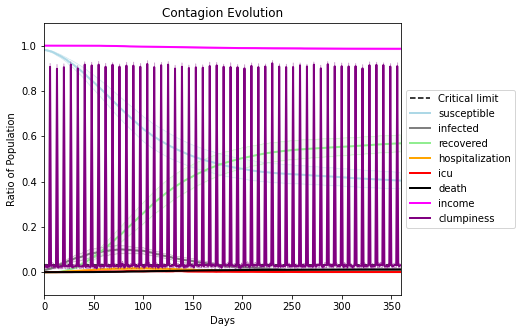

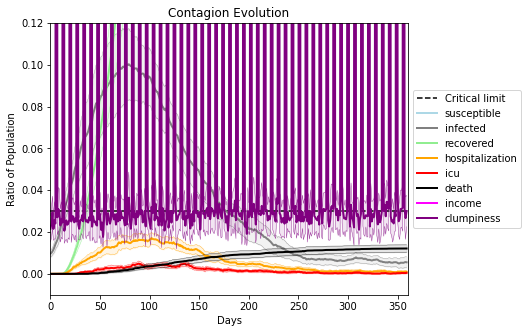

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3967, 6497, 1790, 574, 2598, 4894, 4431, 2037, 2796, 4548, 660, 6581, 7985, 8839, 91, 2519, 6978, 6856, 9478, 4683]
Average similarity between family members is 0.23103570274417595 at temperature -0.4
Average similarity between family and home is 0.9998507836957498 at temperature -1
Average similarity between students and their classroom is 0.14927376588729863 at temperature -0.4
Average classroom occupancy is 4.041666666666667 and number classrooms is 72
Average similarity between workers is 0.1353905032285826 at temperature -0.4
Average office occupancy is 3.1414634146341465 and number offices is 205
Average friend similarity for adults: 0.2707224577160271 for kids: 0.19489976027745096
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.08130725299156424
avg restaurant similarity 0.22393831501089512
avg restaurant similarity 0.11785583169872949
avg restaurant similarity 0.1506668563245102
avg restaurant similarity 0.2924630536738929
avg restaurant similarity 0.14068273868922357
avg restaurant similarity 0.2946055411241959
avg restaurant similarity -0.1798611884376835
avg restaurant similarity 0.008521409971091224
avg restaurant similarity 0.00040086812530403594
avg restaurant similarity 0.16039680883087698
avg restaurant similarity -0.05170223730016449
avg restaurant similarity -0.04481854033547672
avg restaurant similarity 0.08115686432915556
avg restaurant similarity 0.29285620445629734
avg restaurant similarity 0.16878130784022244
avg restaurant similarity -0.025538944198644897
avg restaurant similarity 0.18324339657925182
avg restaurant similarity -0.17785221178937288
avg restaurant similarity 0.12675230760441733
avg restaurant similarity 0.11993833787780478
avg restaurant similarity 0.

avg restaurant similarity 0.25516811625825886
avg restaurant similarity 0.1281698085682908
avg restaurant similarity 0.030055552018887023
avg restaurant similarity -0.09789813043840945
avg restaurant similarity 0.15843784604132644
avg restaurant similarity -0.025254057226443014
avg restaurant similarity 0.1692540684244457
avg restaurant similarity 0.1920244135848509
avg restaurant similarity 0.09614065895058792
avg restaurant similarity 0.027547010875020084
avg restaurant similarity 0.2221638887930213
avg restaurant similarity 0.08248980300530478
avg restaurant similarity 0.03634794875458982
avg restaurant similarity 0.2589251089371294
avg restaurant similarity 0.020135271344459933
avg restaurant similarity 0.009668830231293363
avg restaurant similarity 0.15657080867884712
avg restaurant similarity 0.10859239367174585
avg restaurant similarity 0.15559421344070237
avg restaurant similarity 0.0733854503708421
avg restaurant similarity 0.15250185620911713
avg restaurant similarity 0.08658

avg restaurant similarity 0.11863111140302918
avg restaurant similarity 0.3398546080784363
avg restaurant similarity 0.006712389405106358
avg restaurant similarity 0.088309781831589
avg restaurant similarity 0.13383979106470986
avg restaurant similarity 0.11676304590760316
avg restaurant similarity 0.02531411787881389
avg restaurant similarity 0.15834571726559904
avg restaurant similarity 0.22526355250115587
avg restaurant similarity 0.058149447624229016
avg restaurant similarity -0.058096081667444115
avg restaurant similarity 0.19517705968429397
avg restaurant similarity -0.04880276555977699
avg restaurant similarity -0.07839097099741293
avg restaurant similarity 0.06528583416351642
avg restaurant similarity -0.1358625529862962
avg restaurant similarity 0.31596111957374123
avg restaurant similarity 0.05364684723845829
avg restaurant similarity -0.06948704736589828
avg restaurant similarity 0.12779595263950985
avg restaurant similarity -0.031122001947642027
avg restaurant similarity 0.

avg restaurant similarity 0.1680403532429159
avg restaurant similarity -0.15316502951636654
avg restaurant similarity -0.07774062362366833
avg restaurant similarity -0.1318713592520746
avg restaurant similarity 0.038913194173610326
avg restaurant similarity 0.04582973454698739
avg restaurant similarity 0.047934875545191956
avg restaurant similarity 0.17961607901285678
avg restaurant similarity 0.16395345713203835
avg restaurant similarity 0.08066810063024317
avg restaurant similarity 0.22477212102779112
avg restaurant similarity 0.02162056966104566
avg restaurant similarity 0.20955050200520142
avg restaurant similarity 0.12460754454541804
avg restaurant similarity 0.10119031282812374
avg restaurant similarity -0.0035418248964508015
avg restaurant similarity 0.35553242516399575
avg restaurant similarity 0.20432477402552207
avg restaurant similarity 0.005840302296731011
avg restaurant similarity 0.17947745949758595
avg restaurant similarity 0.1477756424282304
avg restaurant similarity 0.

avg restaurant similarity 0.11334150732185212
avg restaurant similarity 0.08060111710779859
avg restaurant similarity -0.13319248819207147
avg restaurant similarity 0.04399790887871865
avg restaurant similarity 0.11278455329355574
avg restaurant similarity 0.09897472231613064
avg restaurant similarity 0.09445774182937682
avg restaurant similarity 0.11994018229963599
avg restaurant similarity 0.07605851551802988
avg restaurant similarity 0.10576338091042296
avg restaurant similarity 0.14959562012804226
avg restaurant similarity -0.00645320389112567
avg restaurant similarity 0.03756774615583673
avg restaurant similarity -0.017537251398397846
avg restaurant similarity 0.029607163554355026
avg restaurant similarity 0.16752545909113872
avg restaurant similarity 0.02263946696607201
avg restaurant similarity 0.017210783713889448
avg restaurant similarity 0.010866265045111245
avg restaurant similarity 0.35128973474822733
avg restaurant similarity -0.022945091312760957
avg restaurant similarity

avg restaurant similarity 0.16353469375008448
avg restaurant similarity -0.05813395949512545
avg restaurant similarity -0.04560524559222318
avg restaurant similarity 0.06165056279521555
avg restaurant similarity 0.3739418972171338
avg restaurant similarity 0.012936289883473775
avg restaurant similarity 0.10955796777521166
avg restaurant similarity -0.10158320419077767
avg restaurant similarity 0.03225732139799528
avg restaurant similarity 0.2102074401188848
avg restaurant similarity -0.07681622013348353
avg restaurant similarity 0.12057410065091761
avg restaurant similarity 0.1021564675260517
avg restaurant similarity 0.14636082452209123
avg restaurant similarity 0.16879873394029835
avg restaurant similarity 0.23949152144190208
avg restaurant similarity 0.19934301921482347
avg restaurant similarity 0.04931544235365253
avg restaurant similarity 0.05702681606983565
avg restaurant similarity 0.17475270254673458
avg restaurant similarity -0.012083138601747466
avg restaurant similarity -0.0

avg restaurant similarity 0.17805745365039655
avg restaurant similarity 0.15001890594714823
avg restaurant similarity 0.12249008575588459
avg restaurant similarity 0.13223329768653755
avg restaurant similarity 0.35114563684657085
avg restaurant similarity 0.07986888374491005
avg restaurant similarity 0.11051671371215911
avg restaurant similarity 0.18365739497591757
avg restaurant similarity 0.2658069615319909
avg restaurant similarity 0.22248154136704468
avg restaurant similarity -0.06979814000298096
avg restaurant similarity 0.10098550491992354
avg restaurant similarity 0.15565906393734155
avg restaurant similarity 0.18666161051159416
avg restaurant similarity 0.18737299843315147
avg restaurant similarity 0.18500025805751114
avg restaurant similarity 0.005896722648430705
avg restaurant similarity -0.005689598272241104
avg restaurant similarity -0.07999164796600576
avg restaurant similarity 0.14646287093385504
avg restaurant similarity 0.03028294240071526
avg restaurant similarity 0.24

avg restaurant similarity 0.26010257092304717
avg restaurant similarity 0.15409607593932415
avg restaurant similarity 0.07114865147460603
avg restaurant similarity 0.2164266624129929
avg restaurant similarity 0.19494500730926878
avg restaurant similarity -0.043750542030789194
avg restaurant similarity 0.10954862082613369
avg restaurant similarity 0.062176012078303464
avg restaurant similarity 0.06628233796977329
avg restaurant similarity 0.12586276285393636
avg restaurant similarity 0.10086034724420116
avg restaurant similarity 0.12484388053047081
avg restaurant similarity 0.17496543206869866
avg restaurant similarity 0.24772503445358776
avg restaurant similarity 0.15148151696331738
avg restaurant similarity 0.30481491604458094
avg restaurant similarity 0.24070348382984283
avg restaurant similarity 0.011900262163120054
avg restaurant similarity 0.20633464695358983
avg restaurant similarity 0.18581818280146317
avg restaurant similarity 0.1192708284304091
avg restaurant similarity 0.1143

avg restaurant similarity 0.1689772079402761
avg restaurant similarity 0.056949259979710586
avg restaurant similarity -0.0609467530145231
avg restaurant similarity 0.052913873642532964
avg restaurant similarity 0.07163534908584575
avg restaurant similarity 0.1337935238580821
avg restaurant similarity -0.310407305803296
avg restaurant similarity -0.028814250092721375
avg restaurant similarity -0.12637630815131423
avg restaurant similarity 0.25919191964979343
avg restaurant similarity -0.030066784868115166
avg restaurant similarity 0.2059035166017966
avg restaurant similarity 0.211055644191631
avg restaurant similarity -0.23105223658119622
avg restaurant similarity 0.14587114566273546
avg restaurant similarity 0.15590858313944975
avg restaurant similarity 0.07231912903152739
avg restaurant similarity 0.27084627816082457
avg restaurant similarity 0.17883243401735394
avg restaurant similarity 0.3737930779646455
avg restaurant similarity 0.29831147198925334
avg restaurant similarity -0.2165

avg restaurant similarity 0.1591713333093896
avg restaurant similarity 0.04133505788562009
avg restaurant similarity 0.1696790949916931
avg restaurant similarity 0.10199691798532476
avg restaurant similarity 0.05223104603356412
avg restaurant similarity 0.34486678777133223
avg restaurant similarity 0.11517942676406127
avg restaurant similarity 0.11380943034269263
avg restaurant similarity 0.050472983851643116
avg restaurant similarity 0.08336403508438105
avg restaurant similarity 0.18913059162801438
avg restaurant similarity 0.07906606186691455
avg restaurant similarity 0.19814350173900241
avg restaurant similarity 0.08106859674510197
avg restaurant similarity 0.1727425294093414
avg restaurant similarity 0.04916194472863483
avg restaurant similarity 0.3103010170173223
avg restaurant similarity 0.28751826557337307
avg restaurant similarity 0.0797327730542879
avg restaurant similarity 0.03102907433261731
avg restaurant similarity 0.0992620615549079
avg restaurant similarity 0.17811407467

avg restaurant similarity -0.014876959318189092
avg restaurant similarity 0.09616672922974595
avg restaurant similarity 0.13689886577209257
avg restaurant similarity 0.04482689680099127
avg restaurant similarity 0.024573361625430352
avg restaurant similarity 0.1626166862196291
avg restaurant similarity -0.06721639092867374
avg restaurant similarity -0.012204319396341059
avg restaurant similarity 0.0038383251630295686
avg restaurant similarity 0.11941445804245764
avg restaurant similarity 0.086589124684153
avg restaurant similarity 0.08974345931074354
avg restaurant similarity 0.2028589686320349
avg restaurant similarity 0.23175201776352022
avg restaurant similarity 0.1588386413936002
avg restaurant similarity -0.028769193271458583
avg restaurant similarity -0.09561330545084273
avg restaurant similarity 0.1755113714071126
avg restaurant similarity 0.0680192275934528
avg restaurant similarity 0.01337173809342321
avg restaurant similarity 0.0678352024635545
avg restaurant similarity 0.059

avg restaurant similarity -0.09704501571373694
avg restaurant similarity 0.14290146972768905
avg restaurant similarity 0.09650999057940508
avg restaurant similarity 0.043514988380743164
avg restaurant similarity 0.09780423793954704
avg restaurant similarity -0.0387176734048183
avg restaurant similarity 0.07401907379433578
avg restaurant similarity 0.17311016624486011
avg restaurant similarity 0.09428844019010849
avg restaurant similarity -0.1107956151874794
avg restaurant similarity 0.13254259309087346
avg restaurant similarity 0.11769645927936472
avg restaurant similarity 0.057418377639422744
avg restaurant similarity 0.0888698296542914
avg restaurant similarity 0.02914149001321277
avg restaurant similarity -0.07389816814089079
avg restaurant similarity -0.10437415914953863
avg restaurant similarity 0.22098532890540218
avg restaurant similarity 0.2618538393912633
avg restaurant similarity 0.21336253574971278
avg restaurant similarity -0.04810583125628409
avg restaurant similarity 0.13

avg restaurant similarity -0.09997777548401736
avg restaurant similarity 0.2381111236598339
avg restaurant similarity -0.1297594771629401
avg restaurant similarity 0.096888234395615
avg restaurant similarity 0.112704644342618
avg restaurant similarity 0.1847500926643839
avg restaurant similarity 0.013944197477669031
avg restaurant similarity 0.10034458317098381
avg restaurant similarity 0.04899177822493466
avg restaurant similarity 0.20875158447092246
avg restaurant similarity 0.11697779076167114
avg restaurant similarity 0.1881669262903303
avg restaurant similarity 0.10766008619330168
avg restaurant similarity 0.32672868255712495
avg restaurant similarity 0.39721090664505243
avg restaurant similarity -0.06403912840157695
avg restaurant similarity 0.041369697681288224
avg restaurant similarity 0.2024937344078921
avg restaurant similarity 0.15774124981562615
avg restaurant similarity 0.014058621800135025
avg restaurant similarity 0.28143934633604106
avg restaurant similarity 0.282441381

avg restaurant similarity 0.18421203369957354
avg restaurant similarity 0.24844625143364643
avg restaurant similarity -0.025492161577688452
avg restaurant similarity -0.03267587027234639
avg restaurant similarity 0.19998508850023594
avg restaurant similarity 0.07517271027427941
avg restaurant similarity 0.15694607342809866
avg restaurant similarity 0.006635942825400574
avg restaurant similarity 0.1650392787537579
avg restaurant similarity 0.019263076378961914
avg restaurant similarity 0.10520783807997879
avg restaurant similarity 0.1408468470075533
avg restaurant similarity 0.22617186209515727
avg restaurant similarity 0.08797207725952966
avg restaurant similarity 0.11976555641066211
avg restaurant similarity 0.10964868016498551
avg restaurant similarity 0.06992090815231429
avg restaurant similarity 0.042408012699547956
avg restaurant similarity 0.2963647307417639
avg restaurant similarity 0.20056950339660695
avg restaurant similarity 0.13095423538122286
avg restaurant similarity 0.108

avg restaurant similarity 0.1357866541365486
avg restaurant similarity 0.001924903115598564
avg restaurant similarity 0.10445898640760044
avg restaurant similarity 0.025940399545421523
avg restaurant similarity 0.04999676459204946
avg restaurant similarity 0.04972434688273613
avg restaurant similarity 0.2917666602781949
avg restaurant similarity 0.18091731721484028
avg restaurant similarity 0.08571671518932789
avg restaurant similarity 0.06737966800849694
avg restaurant similarity 0.030321864020678158
avg restaurant similarity 0.0025833223180750423
avg restaurant similarity -0.08079304984382549
avg restaurant similarity -0.1388205739859069
avg restaurant similarity 0.21775143501790759
avg restaurant similarity 0.1109760174787604
avg restaurant similarity 0.08417205640759508
avg restaurant similarity 0.24746884735242486
avg restaurant similarity 0.06976580386784764
avg restaurant similarity 0.10389484192230858
avg restaurant similarity -0.0026122930386354992
avg restaurant similarity 0.

avg restaurant similarity -0.03055594133533671
avg restaurant similarity 0.7474513515494376
avg restaurant similarity 0.14030561003252948
avg restaurant similarity 0.08601478558495608
avg restaurant similarity 0.026866355204214733
avg restaurant similarity -0.13900888809313064
avg restaurant similarity 0.08145282608177082
avg restaurant similarity 0.21444602483380495
avg restaurant similarity 0.06512387283642555
avg restaurant similarity -0.07063386968834554
avg restaurant similarity 0.10217659599441599
avg restaurant similarity 0.12468398348558161
avg restaurant similarity -0.016213320428547118
avg restaurant similarity -0.012526574490282341
avg restaurant similarity 0.15747333517334086
avg restaurant similarity 0.08191936680443737
avg restaurant similarity 0.10404750122686057
avg restaurant similarity 0.26746234007403724
avg restaurant similarity 0.09164880553611976
avg restaurant similarity 0.10698738281553018
avg restaurant similarity 0.20369578200184027
avg restaurant similarity 0

avg restaurant similarity 0.2857908317401596
avg restaurant similarity 0.1296031769427378
avg restaurant similarity 0.46853669437244305
avg restaurant similarity 0.1462750176999
avg restaurant similarity 0.056667480123683674
avg restaurant similarity -0.09672450593679204
avg restaurant similarity 0.2842011699939274
avg restaurant similarity 0.2648792298053194
avg restaurant similarity 0.22397394830368453
avg restaurant similarity 0.1122444899372959
avg restaurant similarity 0.4139263539745449
avg restaurant similarity 0.2542803638184856
avg restaurant similarity 0.09641883698846034
avg restaurant similarity 0.28369333998231916
avg restaurant similarity 0.3002430351008041
avg restaurant similarity -0.004731232377357758
avg restaurant similarity 0.04250283847452101
avg restaurant similarity 0.4239112290493335
avg restaurant similarity 0.19653014208026273
avg restaurant similarity 0.4585462165032331
avg restaurant similarity 0.055641979068601695
avg restaurant similarity 0.188384246523285

avg restaurant similarity 0.1413537597533934
avg restaurant similarity 0.2027872639409506
avg restaurant similarity 0.31311673439071847
avg restaurant similarity 0.2081937832081833
avg restaurant similarity 0.13954781739113867
avg restaurant similarity 0.07177807251262538
avg restaurant similarity 0.32454424002831356
avg restaurant similarity 0.03618647932309681
avg restaurant similarity -0.025227887829006406
avg restaurant similarity -0.008414389978398764
avg restaurant similarity -0.03199282403821429
avg restaurant similarity 0.07794439284249119
avg restaurant similarity 0.2505041016085373
avg restaurant similarity 0.10577825162943695
avg restaurant similarity 0.3342279258413545
avg restaurant similarity 0.05949101931257638
avg restaurant similarity 0.21063716995880138
avg restaurant similarity 0.09093335933542075
avg restaurant similarity 0.16992188738823422
avg restaurant similarity 0.03668792764671923
avg restaurant similarity 0.007332149006085457
avg restaurant similarity 0.31634

avg restaurant similarity 0.04385994952237597
avg restaurant similarity 0.06970106728086244
avg restaurant similarity -0.03585509482826737
avg restaurant similarity -0.10416467293017354
avg restaurant similarity 0.13338674649704188
avg restaurant similarity -0.1728598402703878
avg restaurant similarity 0.021827045492741188
avg restaurant similarity 0.28211030686716543
avg restaurant similarity -0.092680958381927
avg restaurant similarity -0.02536666360703689
avg restaurant similarity 0.09543876555465715
avg restaurant similarity 0.19014581249574541
avg restaurant similarity 0.10684456891942588
avg restaurant similarity 0.017690759399672615
avg restaurant similarity 0.07857450993514582
avg restaurant similarity 0.12189532264326382
avg restaurant similarity 0.10172344639045058
avg restaurant similarity 0.05725089117693327
avg restaurant similarity -0.0466083468378439
avg restaurant similarity -0.08176934712860214
avg restaurant similarity 0.1304074542074162
avg restaurant similarity 0.02

avg restaurant similarity 0.7976982825560386
avg restaurant similarity 0.14565598980055727
avg restaurant similarity -0.06892390222856269
avg restaurant similarity 0.18239823502345137
avg restaurant similarity -0.050927605564814085
avg restaurant similarity 0.26528376409270266
avg restaurant similarity 0.27464567378486726
avg restaurant similarity 0.007143386109426876
avg restaurant similarity -0.10365098317549379
avg restaurant similarity 0.17042079924798811
avg restaurant similarity -0.024726657874303656
avg restaurant similarity -0.04134456207910912
avg restaurant similarity 0.1799581846233851
avg restaurant similarity -0.24363011774845955
avg restaurant similarity 0.03457199657989178
avg restaurant similarity 0.2603195785291255
avg restaurant similarity 0.029502382738345014
avg restaurant similarity 0.08158349566394212
avg restaurant similarity 0.026370909491281902
avg restaurant similarity -0.01736720571735617
avg restaurant similarity -0.02284377536570537
avg restaurant similarit

avg restaurant similarity 0.27642434246927094
avg restaurant similarity 0.1565984147454509
avg restaurant similarity 0.12256388208639968
avg restaurant similarity 0.1707162167401001
avg restaurant similarity 0.09379160826583968
avg restaurant similarity 0.05663957299954996
avg restaurant similarity 0.03565088035854458
avg restaurant similarity 0.0063867039564279235
avg restaurant similarity -0.029096594742876382
avg restaurant similarity 0.026516288683075106
avg restaurant similarity 0.02531803704144784
avg restaurant similarity 0.11749557329439733
avg restaurant similarity -0.2521469937388889
avg restaurant similarity 0.23605970454979408
avg restaurant similarity 0.2017423143207513
avg restaurant similarity 0.03737733611611854
avg restaurant similarity 0.1834748712175899
avg restaurant similarity -0.06322275454916161
avg restaurant similarity -0.08843501779846123
avg restaurant similarity -0.12008841922839927
avg restaurant similarity 0.4375478726447476
avg restaurant similarity -0.01

avg restaurant similarity -0.027865040526696982
avg restaurant similarity -0.006691336985201803
avg restaurant similarity -0.014275897380862646
avg restaurant similarity 0.08734053629216308
avg restaurant similarity -0.09030941124484794
avg restaurant similarity -0.012660048773764703
avg restaurant similarity 0.2559916245086463
avg restaurant similarity 0.23749926289818668
avg restaurant similarity 0.2265187076342019
avg restaurant similarity 0.04566909750443348
avg restaurant similarity 0.15467930436081553
avg restaurant similarity 0.06324360321422993
avg restaurant similarity 0.3984340200121464
avg restaurant similarity 0.278497962780106
avg restaurant similarity -0.016977817463044734
avg restaurant similarity 0.12090684364143209
avg restaurant similarity 0.10094652637251289
avg restaurant similarity 0.11527616950925475
avg restaurant similarity -0.07868908936385764
avg restaurant similarity 0.12137104450207939
avg restaurant similarity -0.0031063879242287026
avg restaurant similarit

avg restaurant similarity 0.08869008185615515
avg restaurant similarity 0.11241966377032103
avg restaurant similarity 0.12816979475222237
avg restaurant similarity -0.011864070879963495
avg restaurant similarity 0.21580463898243443
avg restaurant similarity -0.07740883093006133
avg restaurant similarity 0.16720405259546064
avg restaurant similarity 0.07251658570353549
avg restaurant similarity 0.4412470105233955
avg restaurant similarity 0.0954747914580189
avg restaurant similarity -0.003727142882100503
avg restaurant similarity 0.09221078805913888
avg restaurant similarity 0.12584592491021904
avg restaurant similarity 0.1342377495441472
avg restaurant similarity -0.10756308849179753
avg restaurant similarity 0.05924968134733159
avg restaurant similarity 0.11683313410641004
avg restaurant similarity 0.07597954520765195
avg restaurant similarity 0.1213043334748813
avg restaurant similarity -0.10230868347980404
avg restaurant similarity 0.049516472946300155
avg restaurant similarity 0.45

avg restaurant similarity 0.2511133709144679
avg restaurant similarity -0.01289908327482453
avg restaurant similarity 0.18916193540930504
avg restaurant similarity 0.19192604777789482
avg restaurant similarity -0.015123614847623205
avg restaurant similarity 0.11806022820876057
avg restaurant similarity -0.016471083045682823
avg restaurant similarity 0.1127990224447169
avg restaurant similarity 0.19019005370111072
avg restaurant similarity 0.020255885981920643
avg restaurant similarity 0.1425165846639205
avg restaurant similarity -0.09540217078750661
avg restaurant similarity 0.7734340504378288
avg restaurant similarity -0.10822714502666184
avg restaurant similarity 0.1029450923442233
avg restaurant similarity 0.11260246791787525
avg restaurant similarity 0.16765243475346023
avg restaurant similarity 0.2244805700245568
avg restaurant similarity 0.22724275877281727
avg restaurant similarity 0.153271719935743
avg restaurant similarity 0.19778305048602907
avg restaurant similarity 0.089646

avg restaurant similarity 0.2520806471302664
avg restaurant similarity 0.09868725074064787
avg restaurant similarity 0.2679968507668889
avg restaurant similarity 0.17276742507599915
avg restaurant similarity 0.43200292542362156
avg restaurant similarity 0.049533618540378604
avg restaurant similarity 0.19620277876929287
avg restaurant similarity -0.10720598986688079
avg restaurant similarity 0.1570153523626499
avg restaurant similarity -0.22012847668883462
avg restaurant similarity -0.09317003969269262
avg restaurant similarity 0.14689734000841634
avg restaurant similarity 0.08368585880035322
avg restaurant similarity 0.03538199268846474
avg restaurant similarity 0.23474157755515934
avg restaurant similarity 0.17597364711084493
avg restaurant similarity 0.12947150949948544
avg restaurant similarity 0.07419175114153394
avg restaurant similarity 0.007205204854526092
avg restaurant similarity 0.2056513349287857
avg restaurant similarity 0.12053884347602517
avg restaurant similarity 0.29475

avg restaurant similarity 0.0018611868933964132
avg restaurant similarity 0.2463077860627296
avg restaurant similarity -0.051980719537780544
avg restaurant similarity 0.16139338835403932
avg restaurant similarity 0.4007550103414649
avg restaurant similarity 0.08116810829886045
avg restaurant similarity -0.06971491274737614
avg restaurant similarity -0.15163234010598084
avg restaurant similarity 0.05791092485764102
avg restaurant similarity 0.12943550196190945
avg restaurant similarity 0.3716576796820523
avg restaurant similarity 0.21405582751769012
avg restaurant similarity 0.2972630677017032
avg restaurant similarity 0.1971259193823595
avg restaurant similarity 0.1807997008884276
avg restaurant similarity 0.36683279411674957
avg restaurant similarity -0.07048320096175237
avg restaurant similarity 0.1600511545172438
avg restaurant similarity 0.17048419395993078
avg restaurant similarity 0.1843191091781815
avg restaurant similarity 0.14023690750159729
avg restaurant similarity 0.1489312

avg restaurant similarity 0.16046246902506486
avg restaurant similarity 0.2519266477773602
avg restaurant similarity 0.07042145898772041
avg restaurant similarity 0.061235090029959895
avg restaurant similarity 0.07736657720575406
avg restaurant similarity -0.05010130552568359
avg restaurant similarity 0.15072260712517876
avg restaurant similarity 0.1490456444146558
avg restaurant similarity -0.10692737547574135
avg restaurant similarity -0.012351922699448964
avg restaurant similarity -0.003895994679296692
avg restaurant similarity 0.05327810680390398
avg restaurant similarity 0.10870797075210577
avg restaurant similarity 0.13446503666248397
avg restaurant similarity 0.2047646268751089
avg restaurant similarity 0.09607058123300387
avg restaurant similarity 0.16777580387733643
avg restaurant similarity 0.10376285038501111
avg restaurant similarity 0.06402039884464512
avg restaurant similarity 0.2117194098035245
avg restaurant similarity -0.0903388722829714
avg restaurant similarity 0.021

avg restaurant similarity 0.022330693874570547
avg restaurant similarity 0.23002685325163436
avg restaurant similarity 0.13262131546904618
avg restaurant similarity 0.04537367387465955
avg restaurant similarity 0.2855088779225447
avg restaurant similarity -0.0371461033284107
avg restaurant similarity 0.2162049312712093
avg restaurant similarity 0.1196651723371529
avg restaurant similarity 0.11560959463994469
avg restaurant similarity 0.13910702683383167
avg restaurant similarity 0.14356544544919056
avg restaurant similarity 0.11717256115144185
avg restaurant similarity 0.20364151754545334
avg restaurant similarity 0.15374276548120736
avg restaurant similarity 0.27622768165307987
avg restaurant similarity 0.11588017508479148
avg restaurant similarity -0.16316635690167355
avg restaurant similarity 0.07028547562025361
avg restaurant similarity 0.021292511687044234
avg restaurant similarity -0.09253762675671832
avg restaurant similarity -0.07010833054354124
avg restaurant similarity 0.1291

avg restaurant similarity -0.02245752250207115
avg restaurant similarity 0.2841774359300957
avg restaurant similarity 0.11069133933796815
avg restaurant similarity -0.0011555412196277066
avg restaurant similarity 0.08061021516257814
avg restaurant similarity -0.008666008507851404
avg restaurant similarity 0.3622937664293683
avg restaurant similarity 0.150367334595001
avg restaurant similarity 0.19581538996933257
avg restaurant similarity 0.23847162636284752
avg restaurant similarity 0.23960544353711785
avg restaurant similarity 0.18267433212937323
avg restaurant similarity 0.22302626323246003
avg restaurant similarity 0.11051564841174429
avg restaurant similarity 0.16499378678413293
avg restaurant similarity 0.14129294595957498
avg restaurant similarity 0.1968751324655358
avg restaurant similarity 0.032551462392278095
avg restaurant similarity 0.1455457532705101
avg restaurant similarity 0.13796741774126256
avg restaurant similarity 0.16457829285982667
avg restaurant similarity 0.02433

avg restaurant similarity 0.11573239855394396
avg restaurant similarity 0.2736704991870311
avg restaurant similarity 0.014567936479817986
avg restaurant similarity 0.20673142452076199
avg restaurant similarity 0.23578085241367866
avg restaurant similarity -0.051539619506244444
avg restaurant similarity 0.19003067328333342
avg restaurant similarity 0.02595300307724274
avg restaurant similarity -0.21757858109932934
avg restaurant similarity 0.20416328756259028
avg restaurant similarity 0.1106645248439537
avg restaurant similarity 0.06621881503313315
avg restaurant similarity 0.1603141965241679
avg restaurant similarity 0.16396059985216502
avg restaurant similarity 0.20983740390765096
avg restaurant similarity 0.009550151832145243
avg restaurant similarity 0.2016913137724983
avg restaurant similarity -0.1289815931004202
avg restaurant similarity 0.062128394486114014
avg restaurant similarity -0.16720683493269325
avg restaurant similarity 0.08385401028279679
avg restaurant similarity 0.166

avg restaurant similarity 0.05137592814113086
avg restaurant similarity 0.02513133175591963
avg restaurant similarity 0.011055289063928303
avg restaurant similarity 0.04189976296081515
avg restaurant similarity 0.030927952735542174
avg restaurant similarity 0.07203910299499004
avg restaurant similarity 0.14372893097731676
avg restaurant similarity 0.16270151948476805
avg restaurant similarity 0.07993905086268252
avg restaurant similarity 0.2197804956509343
avg restaurant similarity 0.2310483992250099
avg restaurant similarity 0.015055526694484817
avg restaurant similarity -0.04894913689747909
avg restaurant similarity 0.15517083870180842
avg restaurant similarity -0.036153017615810856
avg restaurant similarity 0.27572069000688254
avg restaurant similarity -0.011717590841327619
avg restaurant similarity 0.18140319873520971
avg restaurant similarity -0.0899962374836774
avg restaurant similarity 0.2160790282610487
avg restaurant similarity 0.06478496585617369
avg restaurant similarity 0.3

avg restaurant similarity 0.20059382407397086
avg restaurant similarity 0.18787518132618064
avg restaurant similarity 0.28040105305864904
avg restaurant similarity 0.045865284401805574
avg restaurant similarity 0.4856908201766766
avg restaurant similarity 0.30498532716853893
avg restaurant similarity 0.13175613289199833
avg restaurant similarity 0.06624138148623354
avg restaurant similarity 0.05545083377670762
avg restaurant similarity 0.02865300608904292
avg restaurant similarity 0.022445248479573923
avg restaurant similarity 0.17691944819360664
avg restaurant similarity 0.05046341083704866
avg restaurant similarity 0.0780017168966822
avg restaurant similarity 0.15284367223710288
avg restaurant similarity -0.018025279529755522
avg restaurant similarity 0.08825935902811015
avg restaurant similarity 0.0011972284195995468
avg restaurant similarity 0.24011772508213974
avg restaurant similarity 0.1608657652116292
avg restaurant similarity 0.007568742835507847
avg restaurant similarity -0.0

avg restaurant similarity 0.045177716947956435
avg restaurant similarity 0.14787104388370964
avg restaurant similarity 0.010943709709784519
avg restaurant similarity 0.08928683798408713
avg restaurant similarity 0.020555395998753744
avg restaurant similarity 0.16965293843611948
avg restaurant similarity 0.060400796507695295
avg restaurant similarity 0.1506670277956288
avg restaurant similarity 0.25323628206916426
avg restaurant similarity -0.18634973275221758
avg restaurant similarity 0.11880326191778462
avg restaurant similarity 0.16020968089821144
avg restaurant similarity 0.05775823162194406
avg restaurant similarity -0.20222649241261492
avg restaurant similarity 0.18704912661053058
avg restaurant similarity -0.03844458323052573
avg restaurant similarity 0.061661827186330787
avg restaurant similarity 0.20080973302757976
avg restaurant similarity 0.12079802442951781
avg restaurant similarity 0.10299096711609966
avg restaurant similarity 0.005181763204077275
avg restaurant similarity 

avg restaurant similarity 0.030888424711146743
avg restaurant similarity 0.12701427418655273
avg restaurant similarity -0.02581203357207995
avg restaurant similarity 0.11029566787851802
avg restaurant similarity 0.27743797870033615
avg restaurant similarity 0.3400253849277669
avg restaurant similarity 0.042375472947146456
avg restaurant similarity -0.04550178405238618
avg restaurant similarity 0.28757565922398204
avg restaurant similarity 0.0683150380573581
avg restaurant similarity 0.18690347365302357
avg restaurant similarity 0.03426351083230587
avg restaurant similarity -0.04086345839064443
avg restaurant similarity -0.054070279682090314
avg restaurant similarity -0.09570751567744006
avg restaurant similarity 0.0408869589748391
avg restaurant similarity 0.0487344286896107
avg restaurant similarity 0.015131280391857155
avg restaurant similarity -0.09994401220520963
avg restaurant similarity 0.07193839763764008
avg restaurant similarity 0.0961848015046942
avg restaurant similarity 0.0

avg restaurant similarity -0.03240770317135703
avg restaurant similarity 0.12445239881077982
avg restaurant similarity 0.12526937091750903
avg restaurant similarity 0.20591414094083801
avg restaurant similarity -0.07403182125328592
avg restaurant similarity 0.17279561262345308
avg restaurant similarity 0.06049975037303902
avg restaurant similarity -0.019671361644206856
avg restaurant similarity 0.01604190416674378
avg restaurant similarity -0.026826510083074358
avg restaurant similarity 0.23654542219312702
avg restaurant similarity 0.04542244082056736
avg restaurant similarity 0.44454229069704465
avg restaurant similarity 0.12568589631126154
avg restaurant similarity 0.13423751513257023
avg restaurant similarity 0.18334100131063066
avg restaurant similarity 0.07929880275627271
avg restaurant similarity 0.11205909076103875
avg restaurant similarity -0.078101636297495
avg restaurant similarity 0.08430543448297376
avg restaurant similarity 0.11490331594688905
avg restaurant similarity 0.0

avg restaurant similarity -0.19154142573905503
avg restaurant similarity -0.18824190285424294
avg restaurant similarity 0.08994716968669961
avg restaurant similarity 0.17112906614220227
avg restaurant similarity 0.02253943087686188
avg restaurant similarity -0.02590662598683474
avg restaurant similarity 0.09509908273226327
avg restaurant similarity 0.23083520794318702
avg restaurant similarity -0.11324466868675807
avg restaurant similarity -0.007607885789378657
avg restaurant similarity -0.04865779443910809
avg restaurant similarity 0.02777131050463674
avg restaurant similarity 0.18136480090766421
avg restaurant similarity -0.11511851329313882
avg restaurant similarity 0.115889773831008
avg restaurant similarity 0.1501331308419108
avg restaurant similarity -0.024205755051103117
avg restaurant similarity 0.08951352989376249
avg restaurant similarity 0.22667022896170552
avg restaurant similarity 0.08594466689830214
avg restaurant similarity -0.08272111301709238
avg restaurant similarity 

avg restaurant similarity 0.12771715919884782
avg restaurant similarity 0.17164697535092707
avg restaurant similarity 0.07987442427424009
avg restaurant similarity 0.0368218386594619
avg restaurant similarity 0.06698981211139123
avg restaurant similarity 0.13356157758738568
avg restaurant similarity 0.2769163758978518
avg restaurant similarity 0.08973634603085753
avg restaurant similarity 0.11014376798806406
avg restaurant similarity 0.1803031257185244
avg restaurant similarity -0.05964212539833592
avg restaurant similarity 0.1256550570302323
avg restaurant similarity -0.09125499618043159
avg restaurant similarity 0.17960305891109563
avg restaurant similarity -0.10511900542402586
avg restaurant similarity 0.18981785219208241
avg restaurant similarity 0.050506689374021786
avg restaurant similarity 0.2457586183703452
avg restaurant similarity 0.07615318804686755
avg restaurant similarity 0.15729382966497918
avg restaurant similarity 0.06805385309453331
avg restaurant similarity 0.0444737

avg restaurant similarity 0.03888020821586992
avg restaurant similarity 0.07038822314419613
avg restaurant similarity -0.006741268868223425
avg restaurant similarity 0.16908498532123867
avg restaurant similarity 0.015074397806850359
avg restaurant similarity 0.026194520457905903
avg restaurant similarity 0.12082706982552528
avg restaurant similarity 0.05172050584138747
avg restaurant similarity 0.2761299910156576
avg restaurant similarity -0.09603662427395587
avg restaurant similarity 0.15911889616552768
avg restaurant similarity -0.03091380977063808
avg restaurant similarity -0.025837910815853436
avg restaurant similarity 0.16099841128646233
avg restaurant similarity 0.03168055236641213
avg restaurant similarity 0.20315843903874312
avg restaurant similarity 0.0657754028190613
avg restaurant similarity 0.28363479375216205
avg restaurant similarity 0.07784749567656965
avg restaurant similarity 0.22720828204618382
avg restaurant similarity 0.09945226208800328
avg restaurant similarity 0.

avg restaurant similarity 0.16720214159664148
avg restaurant similarity 0.16237828690472975
avg restaurant similarity -0.09696588240046289
avg restaurant similarity 0.15648797151339605
avg restaurant similarity -0.03473772401202647
avg restaurant similarity 0.036212643526494434
avg restaurant similarity 0.09106467859013838
avg restaurant similarity 0.2535719770433028
avg restaurant similarity -0.41091540450623554
avg restaurant similarity 0.17493440786926673
avg restaurant similarity -0.09210635524563879
avg restaurant similarity -0.02378809955615291
avg restaurant similarity 0.3088102841982388
avg restaurant similarity 0.023290685300785968
avg restaurant similarity 0.09020680474554905
avg restaurant similarity 0.49342958349302385
avg restaurant similarity -0.03895967387568449
avg restaurant similarity 0.04699329850679275
avg restaurant similarity 0.16439631883461964
avg restaurant similarity 0.014933642350511419
avg restaurant similarity 0.19123013828373342
avg restaurant similarity 0

avg restaurant similarity 0.09453878516842372
avg restaurant similarity 0.0006083148753439682
avg restaurant similarity 0.01920864164659967
avg restaurant similarity 0.12854993145463933
avg restaurant similarity -0.035391413620411885
avg restaurant similarity 0.24371826348452924
avg restaurant similarity 0.1460035139700249
avg restaurant similarity 0.07848888046320682
avg restaurant similarity 0.11486903772909439
avg restaurant similarity 0.5509251654002164
avg restaurant similarity -0.02373044701322137
avg restaurant similarity 0.24485440496225241
avg restaurant similarity 0.06189545498769265
avg restaurant similarity -0.1235268453182738
avg restaurant similarity 0.23260482012893904
avg restaurant similarity 0.07965459102919475
avg restaurant similarity 0.34123838731853473
avg restaurant similarity 0.2105354052990208
avg restaurant similarity 0.07576383675975115
avg restaurant similarity 0.14611047434887342
avg restaurant similarity 0.02956347224822617
avg restaurant similarity 0.0548

(<function dict.items>, <function dict.items>, <function dict.items>)

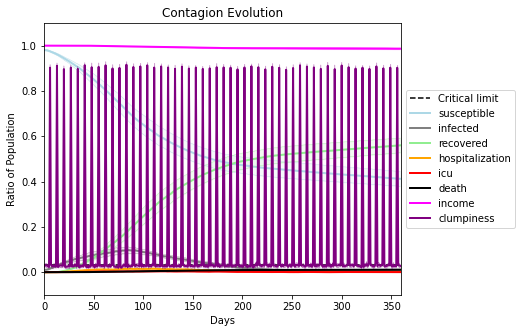

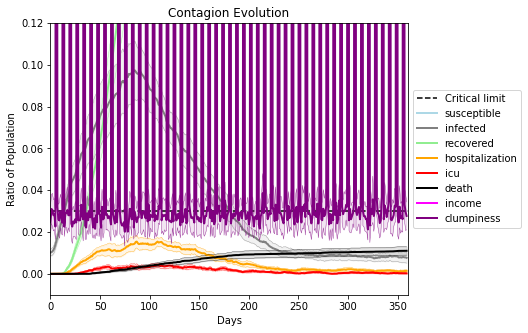

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[990, 857, 6075, 9556, 7600, 1409, 4045, 1267, 2776, 8536, 9132, 1011, 9797, 2386, 7078, 8435, 844, 6884, 3956, 8]
Average similarity between family members is 0.18072452597367875 at temperature -0.3
Average similarity between family and home is 0.9998481440754076 at temperature -1
Average similarity between students and their classroom is 0.18736542752741733 at temperature -0.3
Average classroom occupancy is 4.47887323943662 and number classrooms is 71
Average similarity between workers is 0.14077699324383805 at temperature -0.3
Average office occupancy is 3.18407960199005 and number offices is 201
Average friend similarity for adults: 0.23104653420504173 for kids: 0.19916209876829982
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity -0.2708936108934648
avg restaurant similarity -0.08105410784311902
avg restaurant similarity 0.02190820973978368
avg restaurant similarity 0.054429036762451075
avg restaurant similarity 0.25827339191619364
avg restaurant similarity 0.033228075196788005
avg restaurant similarity 0.201214461537688
avg restaurant similarity -0.12442449507548471
avg restaurant similarity 0.14360128350797613
avg restaurant similarity 0.07619121491630772
avg restaurant similarity -0.007677548296856232
avg restaurant similarity 0.01530166144555319
avg restaurant similarity -0.030096027762103548
avg restaurant similarity 0.09240322345580228
avg restaurant similarity -0.003660609211923053
avg restaurant similarity 0.016768054285601127
avg restaurant similarity 0.30803031001596
avg restaurant similarity -0.005887927613473401
avg restaurant similarity -0.12490877822352187
avg restaurant similarity 0.0361872938660765
avg restaurant similarity 0.10629239250756686
avg restaurant similarity 

avg restaurant similarity 0.16480265981133496
avg restaurant similarity 0.24014971226680548
avg restaurant similarity 0.058137965070333995
avg restaurant similarity -0.03007579817885106
avg restaurant similarity 0.04136033567122631
avg restaurant similarity 0.287700482791141
avg restaurant similarity 0.030826687780967716
avg restaurant similarity 0.34750109290567194
avg restaurant similarity -0.09642160758327131
avg restaurant similarity -0.16499453383483217
avg restaurant similarity 0.052550814461498174
avg restaurant similarity 0.09431710450541454
avg restaurant similarity 0.11290879096104371
avg restaurant similarity -0.1023924611231326
avg restaurant similarity 0.1256531390328795
avg restaurant similarity 0.020173370833200813
avg restaurant similarity -0.018394976126378165
avg restaurant similarity 0.2613341896686856
avg restaurant similarity 0.019030788569391673
avg restaurant similarity 0.13358869247963406
avg restaurant similarity 0.16398798524321082
avg restaurant similarity 0.

avg restaurant similarity 0.05475164799481606
avg restaurant similarity 0.0019274522392095927
avg restaurant similarity 0.2148994163972199
avg restaurant similarity 0.039417817284444746
avg restaurant similarity 0.01517639701902417
avg restaurant similarity 0.12904384300392485
avg restaurant similarity -0.04700408859933177
avg restaurant similarity -0.13857861264060073
avg restaurant similarity -0.26750149268396
avg restaurant similarity 0.132282159695589
avg restaurant similarity 0.15771991451462608
avg restaurant similarity 0.12557295762182227
avg restaurant similarity 0.09730141717157523
avg restaurant similarity 0.5217910161430396
avg restaurant similarity 0.09293001322596456
avg restaurant similarity 0.08456887343148645
avg restaurant similarity 0.06795902016751172
avg restaurant similarity -0.02012055655850067
avg restaurant similarity 0.04150917547722238
avg restaurant similarity 0.10481693760830438
avg restaurant similarity -0.283265345563134
avg restaurant similarity 0.0635469

avg restaurant similarity 0.14008654287012148
avg restaurant similarity 0.033677944518504484
avg restaurant similarity 0.0013127017554016792
avg restaurant similarity 0.18226939707101328
avg restaurant similarity -0.045509727366694945
avg restaurant similarity -0.15344659076955994
avg restaurant similarity 0.3765514885268022
avg restaurant similarity 0.11501920927051335
avg restaurant similarity -0.07755254651992569
avg restaurant similarity -0.011225072036606248
avg restaurant similarity 0.05214314881272473
avg restaurant similarity -0.025015165964974696
avg restaurant similarity 0.10641674064848926
avg restaurant similarity 0.10561366333011077
avg restaurant similarity 0.006111073519449693
avg restaurant similarity 0.24084066664014464
avg restaurant similarity 0.10116459576138474
avg restaurant similarity -0.0195031231224025
avg restaurant similarity -0.007800363736555698
avg restaurant similarity 0.18267425738731502
avg restaurant similarity -0.061076245090816945
avg restaurant simi

avg restaurant similarity 0.22005811186770247
avg restaurant similarity 0.04667502261723911
avg restaurant similarity -0.035052070567634694
avg restaurant similarity 0.06310452010371781
avg restaurant similarity -0.14825996178828585
avg restaurant similarity 0.10173242471272674
avg restaurant similarity -0.015743925656503982
avg restaurant similarity 0.09898856888976117
avg restaurant similarity -0.03620946396294343
avg restaurant similarity -0.04612125798242323
avg restaurant similarity 0.10349808568200151
avg restaurant similarity 0.01652738192408392
avg restaurant similarity -0.057509129530952954
avg restaurant similarity 0.10338213347182847
avg restaurant similarity 0.022407748297193743
avg restaurant similarity 0.03163540118289223
avg restaurant similarity 0.14769803767309703
avg restaurant similarity 0.11581522252680158
avg restaurant similarity 0.01755107435928368
avg restaurant similarity 0.2592686013317978
avg restaurant similarity 0.040297357250399284
avg restaurant similarit

avg restaurant similarity -0.019830004764441654
avg restaurant similarity 0.1359016409599933
avg restaurant similarity 0.042766162857730015
avg restaurant similarity 0.2009341694285261
avg restaurant similarity 0.05629384942926559
avg restaurant similarity -0.010052566366196778
avg restaurant similarity 0.011613672952861477
avg restaurant similarity -0.04504545143001043
avg restaurant similarity 0.10946376745753945
avg restaurant similarity 0.02274759473911406
avg restaurant similarity -0.0671295895751571
avg restaurant similarity 0.24107866942909556
avg restaurant similarity -0.06680802060252766
avg restaurant similarity 0.22914786526603817
avg restaurant similarity 0.1857841011653899
avg restaurant similarity 0.015749815560869507
avg restaurant similarity 0.042259263446314366
avg restaurant similarity 0.2802660240413504
avg restaurant similarity 0.29632324407093025
avg restaurant similarity 0.26523176381786784
avg restaurant similarity -0.09102459927796291
avg restaurant similarity 0

avg restaurant similarity 0.06749138870742673
avg restaurant similarity 0.2993009707247616
avg restaurant similarity 0.04242274183468055
avg restaurant similarity -0.11056066148584005
avg restaurant similarity 0.052301766076616296
avg restaurant similarity -0.0432635598175232
avg restaurant similarity -0.17169056217521209
avg restaurant similarity -0.16103609244823297
avg restaurant similarity 0.15457453153914072
avg restaurant similarity 0.024272326803904763
avg restaurant similarity -0.17412927886247662
avg restaurant similarity 0.026662235417057006
avg restaurant similarity 0.11291815288060625
avg restaurant similarity 0.02133737994570479
avg restaurant similarity 0.17655574894447468
avg restaurant similarity 0.15709996437043963
avg restaurant similarity 0.21345056512146704
avg restaurant similarity 0.09082640186074575
avg restaurant similarity -0.24866782149105765
avg restaurant similarity -0.01750480273136093
avg restaurant similarity 0.03325456793892539
avg restaurant similarity 

avg restaurant similarity -0.18799971074161073
avg restaurant similarity -0.07801399035626629
avg restaurant similarity 0.21665562101396646
avg restaurant similarity -0.16599912074524545
avg restaurant similarity 0.10473045354919057
avg restaurant similarity -0.16614151560488477
avg restaurant similarity -0.16706507610379714
avg restaurant similarity -0.09718537634433755
avg restaurant similarity 0.036706076862762
avg restaurant similarity -0.17615718225575244
avg restaurant similarity 0.08420388873370176
avg restaurant similarity 0.020104209414110053
avg restaurant similarity -0.09648114871124305
avg restaurant similarity 0.010360525756389082
avg restaurant similarity 0.10513237664238173
avg restaurant similarity 0.1018835211912201
avg restaurant similarity 0.1716748765477151
avg restaurant similarity -0.11641107304904105
avg restaurant similarity -0.05478608469980264
avg restaurant similarity -0.03428423211379755
avg restaurant similarity 0.07183091414579099
avg restaurant similarity

avg restaurant similarity 0.06960054542466738
avg restaurant similarity 0.08876478095112805
avg restaurant similarity 0.23626845056925383
avg restaurant similarity 0.05992575470167766
avg restaurant similarity 0.3088577304650667
avg restaurant similarity 0.11554039551067587
avg restaurant similarity -0.19641159066966804
avg restaurant similarity -0.09805407208185685
avg restaurant similarity 0.10063813751892464
avg restaurant similarity -0.06763545161431977
avg restaurant similarity -0.0011034735034694543
avg restaurant similarity 0.32534396032353274
avg restaurant similarity 0.13237816908769065
avg restaurant similarity 0.08582242182257711
avg restaurant similarity -0.056227055439563724
avg restaurant similarity 0.12748194599067775
avg restaurant similarity 0.04045058221664617
avg restaurant similarity -0.08733540485996888
avg restaurant similarity -0.0347966716401222
avg restaurant similarity 0.12137202389269969
avg restaurant similarity -0.1294626536328944
avg restaurant similarity 

avg restaurant similarity -0.03934902891969314
avg restaurant similarity -0.13575132129167958
avg restaurant similarity -0.05423139016740565
avg restaurant similarity 0.007594191711926527
avg restaurant similarity 0.07044388542324001
avg restaurant similarity -0.004289529556916527
avg restaurant similarity 0.06015197391593657
avg restaurant similarity 0.10095346317037938
avg restaurant similarity -0.04083963852593507
avg restaurant similarity 0.28336844557263674
avg restaurant similarity -0.1247581261205042
avg restaurant similarity -0.2677775841992321
avg restaurant similarity -0.13387508842709764
avg restaurant similarity 0.10927381147056288
avg restaurant similarity 0.028017379460884367
avg restaurant similarity -0.13392375845732143
avg restaurant similarity 0.11496814102814146
avg restaurant similarity -0.010293841616021366
avg restaurant similarity -0.00961084928343022
avg restaurant similarity -0.11272833614044846
avg restaurant similarity -0.020968443286168047
avg restaurant sim

avg restaurant similarity 0.20173693967119488
avg restaurant similarity -0.08214351618701381
avg restaurant similarity 0.3941288385668696
avg restaurant similarity 0.07777120511406226
avg restaurant similarity -0.349455085720799
avg restaurant similarity 0.29632993123863755
avg restaurant similarity 0.10185609470067
avg restaurant similarity 0.19158030183783356
avg restaurant similarity 0.16080408085665024
avg restaurant similarity 0.22215935813260645
avg restaurant similarity 0.5349439315671465
avg restaurant similarity 0.19958134352755827
avg restaurant similarity 0.4378513647174782
avg restaurant similarity 0.041779509476330745
avg restaurant similarity 0.06019961447666981
avg restaurant similarity -0.1574264479745236
avg restaurant similarity -0.01981361172548544
avg restaurant similarity -0.02883862086408772
avg restaurant similarity 0.03318256482289164
avg restaurant similarity -0.3184880380381414
avg restaurant similarity 0.0980384499228621
avg restaurant similarity 0.0344640377

avg restaurant similarity 0.26885963913034766
avg restaurant similarity 0.27320258067311903
avg restaurant similarity 0.04933811309284056
avg restaurant similarity 0.001980090442428417
avg restaurant similarity 0.08571096338491792
avg restaurant similarity 0.07381398758128674
avg restaurant similarity 0.22081871763293723
avg restaurant similarity 0.08557958537811046
avg restaurant similarity 0.1599426279826646
avg restaurant similarity -0.009202779560827837
avg restaurant similarity 0.2256832805300424
avg restaurant similarity -0.09916226325383985
avg restaurant similarity 0.0815912744080334
avg restaurant similarity 0.12089053060042772
avg restaurant similarity 0.20767004577441972
avg restaurant similarity 0.18978183071847224
avg restaurant similarity 0.042678591892810286
avg restaurant similarity 0.13497549857784755
avg restaurant similarity 0.31220428580225146
avg restaurant similarity 0.4682031533892703
avg restaurant similarity 0.25466979871392714
avg restaurant similarity -0.2495

avg restaurant similarity -0.06563621877156374
avg restaurant similarity -0.15080570339610333
avg restaurant similarity 0.004711386565382771
avg restaurant similarity -0.08224858616592046
avg restaurant similarity 0.1244175637274529
avg restaurant similarity 0.023918264976824703
avg restaurant similarity 0.16442664660575176
avg restaurant similarity -4.310869431070156e-05
avg restaurant similarity 0.03560503156150451
avg restaurant similarity -0.0630573173215128
avg restaurant similarity 0.10717732700830085
avg restaurant similarity 0.06611444934383091
avg restaurant similarity 0.27696529547562454
avg restaurant similarity 0.12057431842348443
avg restaurant similarity 0.061397588141674335
avg restaurant similarity 0.023489771001522296
avg restaurant similarity 0.26692663729220745
avg restaurant similarity -0.022166513659273718
avg restaurant similarity -0.12342344866734077
avg restaurant similarity 0.22222534738786368
avg restaurant similarity 0.13432928724185375
avg restaurant similar

avg restaurant similarity 0.16000953235743373
avg restaurant similarity -0.009086928878677347
avg restaurant similarity -0.06163346485501928
avg restaurant similarity 0.05630217968638263
avg restaurant similarity -0.029141872915387917
avg restaurant similarity 0.37116250500493125
avg restaurant similarity 0.060788646088006326
avg restaurant similarity -0.37884235036615266
avg restaurant similarity 0.1568856284801547
avg restaurant similarity 0.17534893631151074
avg restaurant similarity -0.04075131200332667
avg restaurant similarity 0.0907704883685731
avg restaurant similarity 0.1204995989060957
avg restaurant similarity 0.10144740177937013
avg restaurant similarity 0.1502868094513477
avg restaurant similarity 0.07841864646327065
avg restaurant similarity 0.07959791373655326
avg restaurant similarity -0.007012021791392042
avg restaurant similarity -0.06037856538528395
avg restaurant similarity -0.09215204455387581
avg restaurant similarity 0.02399747684199364
avg restaurant similarity 

avg restaurant similarity 0.03366906080135681
avg restaurant similarity 0.06279383656444944
avg restaurant similarity -0.09792124828557307
avg restaurant similarity 0.2466442359507046
avg restaurant similarity 0.13941783195704754
avg restaurant similarity -0.014253565192351622
avg restaurant similarity 0.009871126428864537
avg restaurant similarity 0.02870392658333069
avg restaurant similarity 0.04058574332876259
avg restaurant similarity -0.07356311039325546
avg restaurant similarity 0.061738694915888105
avg restaurant similarity -0.058894844126202196
avg restaurant similarity -0.005583967774274649
avg restaurant similarity 0.034708538536190735
avg restaurant similarity 0.13041606828486513
avg restaurant similarity 0.02636491416536504
avg restaurant similarity 0.19091908021742582
avg restaurant similarity 0.14219534186103525
avg restaurant similarity 0.07386894214639515
avg restaurant similarity 0.07567228831050772
avg restaurant similarity 0.08487835717941078
avg restaurant similarit

avg restaurant similarity -0.023584945499351643
avg restaurant similarity 0.23953941839676962
avg restaurant similarity 0.32927430092091636
avg restaurant similarity 0.013377278895774555
avg restaurant similarity 0.11707093767018632
avg restaurant similarity -0.2708365949793844
avg restaurant similarity 0.08544554473517801
avg restaurant similarity 0.06431451166183373
avg restaurant similarity 0.030457281085618435
avg restaurant similarity 0.12360521650944072
avg restaurant similarity 0.09411654944521892
avg restaurant similarity -0.04417970761485764
avg restaurant similarity 0.05566608738144606
avg restaurant similarity 0.08069949297452525
avg restaurant similarity 0.09077820173889639
avg restaurant similarity 0.1317710001942187
avg restaurant similarity -0.006182021321842806
avg restaurant similarity 0.04264943250459346
avg restaurant similarity 0.05171279232404792
avg restaurant similarity 0.21752957935376271
avg restaurant similarity 0.1587491693531933
avg restaurant similarity 0.0

avg restaurant similarity 0.1527029065933285
avg restaurant similarity 0.022037587645357057
avg restaurant similarity -0.13412208567736542
avg restaurant similarity 0.05911402298178059
avg restaurant similarity 0.08794837117337748
avg restaurant similarity 0.10412188007965227
avg restaurant similarity -0.04958323689897421
avg restaurant similarity -0.12759716200933632
avg restaurant similarity 0.26513618447966186
avg restaurant similarity 0.1278727918337262
avg restaurant similarity 0.02359029062937822
avg restaurant similarity -0.068623290053035
avg restaurant similarity 0.3805539951755507
avg restaurant similarity 0.2470003899224147
avg restaurant similarity 0.12552306403103405
avg restaurant similarity 0.2093567881093443
avg restaurant similarity -0.014314359507503416
avg restaurant similarity 0.01985863039804324
avg restaurant similarity -0.03286246750780383
avg restaurant similarity 0.01852569024223895
avg restaurant similarity 0.16289660189666083
avg restaurant similarity 0.12847

avg restaurant similarity 0.022160665038917504
avg restaurant similarity 0.10411490201395315
avg restaurant similarity -0.042322311091042154
avg restaurant similarity -0.022501271268846122
avg restaurant similarity 0.17498210736906078
avg restaurant similarity 0.07435397390474575
avg restaurant similarity 0.027913413153858424
avg restaurant similarity -0.1001016039165831
avg restaurant similarity 0.10068821651912666
avg restaurant similarity -0.030455614712295513
avg restaurant similarity 0.06154092002439171
avg restaurant similarity 0.0909645759899752
avg restaurant similarity 0.09976526748411474
avg restaurant similarity 0.001620173080878887
avg restaurant similarity -0.07792634774505998
avg restaurant similarity -0.17156324400072595
avg restaurant similarity -0.009208720401299098
avg restaurant similarity 0.09568150623957043
avg restaurant similarity 0.13979577959857578
avg restaurant similarity -0.014246054784701196
avg restaurant similarity 0.03693667529471104
avg restaurant simil

avg restaurant similarity 0.04170378990652521
avg restaurant similarity 0.1596587085738345
avg restaurant similarity 0.00845494483638658
avg restaurant similarity 0.23638701367204834
avg restaurant similarity 0.07842950011032411
avg restaurant similarity 0.10053950585302014
avg restaurant similarity 0.05308607014983821
avg restaurant similarity -0.38985657585671923
avg restaurant similarity 0.19779194761732907
avg restaurant similarity 0.24614454925815393
avg restaurant similarity 0.13446342045780849
avg restaurant similarity 0.06414260316013007
avg restaurant similarity 0.1913930649481202
avg restaurant similarity 0.06190685891400786
avg restaurant similarity 0.19458566506618344
avg restaurant similarity 0.012317660172645389
avg restaurant similarity 0.21450970836918196
avg restaurant similarity 0.43051422956755114
avg restaurant similarity 0.23778432169728317
avg restaurant similarity 0.1066536866644029
avg restaurant similarity 0.0843788548000568
avg restaurant similarity 0.09048895

avg restaurant similarity 0.0024011133749610057
avg restaurant similarity 0.0014822686141501506
avg restaurant similarity 0.035700003357224314
avg restaurant similarity 0.15930550938795035
avg restaurant similarity -0.02275907395099376
avg restaurant similarity 0.2457835232465105
avg restaurant similarity 0.06375189613166725
avg restaurant similarity -0.03538515524177718
avg restaurant similarity 0.1513944541062247
avg restaurant similarity -0.08929169046875163
avg restaurant similarity 0.19404433893670486
avg restaurant similarity 0.01965216832030997
avg restaurant similarity 0.10010024565647449
avg restaurant similarity -0.22379214073826767
avg restaurant similarity 0.1646629564090354
avg restaurant similarity 0.025656737408065754
avg restaurant similarity 0.3507478779528883
avg restaurant similarity -0.11827006657408148
avg restaurant similarity 0.025855731619466905
avg restaurant similarity 0.1756018549801969
avg restaurant similarity 0.21180411364005025
avg restaurant similarity 0

avg restaurant similarity 0.1536290703370319
avg restaurant similarity 0.1304838235668162
avg restaurant similarity 0.24096812200923154
avg restaurant similarity 0.028229127943971217
avg restaurant similarity 0.20068371760998205
avg restaurant similarity 0.22318967507687124
avg restaurant similarity 0.14841527752425313
avg restaurant similarity 0.03107688215030252
avg restaurant similarity 0.007761465284808709
avg restaurant similarity 0.07583936304804609
avg restaurant similarity 0.087137377282873
avg restaurant similarity 0.21006124170126395
avg restaurant similarity -0.01586578422522894
avg restaurant similarity -0.055958132884360176
avg restaurant similarity 0.2488190982372403
avg restaurant similarity -0.01019740211285169
avg restaurant similarity 0.158105336271092
avg restaurant similarity 0.11252176539877955
avg restaurant similarity 0.07558738853738374
avg restaurant similarity 0.24593988536326827
avg restaurant similarity 0.011749365945074738
avg restaurant similarity -0.00151

avg restaurant similarity 0.15285529760573846
avg restaurant similarity 0.1902920804188385
avg restaurant similarity 0.008666863973796115
avg restaurant similarity 0.3357384571343023
avg restaurant similarity 0.010988581062398204
avg restaurant similarity -0.08760013190541652
avg restaurant similarity 0.1546747603409019
avg restaurant similarity 0.07746100574087753
avg restaurant similarity 0.1257412045317713
avg restaurant similarity 0.21845297667733665
avg restaurant similarity 0.14144016267745876
avg restaurant similarity 0.090334456035033
avg restaurant similarity 0.18790958738368801
avg restaurant similarity 0.011681297128429325
avg restaurant similarity 0.3171467962209267
avg restaurant similarity -0.044948658377585216
avg restaurant similarity 0.07298282980644905
avg restaurant similarity 0.10776995084782315
avg restaurant similarity 0.11905444903750509
avg restaurant similarity 0.09200677323948846
avg restaurant similarity -0.037255354167614725
avg restaurant similarity 0.13126

avg restaurant similarity 0.2491391411227305
avg restaurant similarity 0.08142640917653805
avg restaurant similarity 0.11896480736811817
avg restaurant similarity 0.1238605519046753
avg restaurant similarity 0.06923789201897267
avg restaurant similarity 0.27363342827483284
avg restaurant similarity -0.05288893079252837
avg restaurant similarity 0.038335405608417576
avg restaurant similarity -0.02502294174977393
avg restaurant similarity -0.09979125588131367
avg restaurant similarity 0.09005890572834593
avg restaurant similarity 0.1286901807659505
avg restaurant similarity 0.15359367209410854
avg restaurant similarity 0.21656498339439084
avg restaurant similarity 0.13576341415579626
avg restaurant similarity 0.08483133851955088
avg restaurant similarity 0.06752411539554462
avg restaurant similarity 0.20519800550746473
avg restaurant similarity 0.15100679657197932
avg restaurant similarity 0.04737258458298811
avg restaurant similarity 0.04878220533186729
avg restaurant similarity 0.32991

avg restaurant similarity 0.18333833673885294
avg restaurant similarity 0.09705975826354518
avg restaurant similarity 0.23944890885062362
avg restaurant similarity -0.11790062629034952
avg restaurant similarity 0.15666711310628006
avg restaurant similarity 0.29141687106561853
avg restaurant similarity -0.04232897985757132
avg restaurant similarity 0.26513279362226994
avg restaurant similarity 0.11934899675134038
avg restaurant similarity -0.0556809551812909
avg restaurant similarity -0.03501677173843762
avg restaurant similarity -0.033344510752411294
avg restaurant similarity 0.35673583203793363
avg restaurant similarity -0.05721499101768031
avg restaurant similarity 0.1547553293781748
avg restaurant similarity 0.13013607961324758
avg restaurant similarity 0.13775666159849143
avg restaurant similarity 0.1330614099544663
avg restaurant similarity 0.2393253504267673
avg restaurant similarity 0.18118269720659264
avg restaurant similarity 0.030329888739219366
avg restaurant similarity 0.08

avg restaurant similarity 0.13182390991013235
avg restaurant similarity 0.11259870940495374
avg restaurant similarity 0.06087850776988196
avg restaurant similarity 0.12897785684512897
avg restaurant similarity 0.06691636180026861
avg restaurant similarity 0.07057380686277658
avg restaurant similarity 0.22842376655094787
avg restaurant similarity 0.03252841584933215
avg restaurant similarity 0.18939306146867158
avg restaurant similarity 0.11031413693958862
avg restaurant similarity -0.09290623773088978
avg restaurant similarity 0.06194595114298678
avg restaurant similarity 0.13310210510215328
avg restaurant similarity 0.004838680503194168
avg restaurant similarity 0.2674140986265668
avg restaurant similarity -0.026729193924661374
avg restaurant similarity 0.1713837959928508
avg restaurant similarity 0.07751106687173169
avg restaurant similarity 0.08784906037794739
avg restaurant similarity -0.02152987610589193
avg restaurant similarity 0.17631554605830574
avg restaurant similarity 0.012

avg restaurant similarity 0.15464513342939593
avg restaurant similarity 0.15830181736654067
avg restaurant similarity 0.13373036581499478
avg restaurant similarity -0.020402146316679085
avg restaurant similarity 0.11173973629779407
avg restaurant similarity 0.11246091901896622
avg restaurant similarity -0.002663277443607263
avg restaurant similarity 0.15838473832897804
avg restaurant similarity -0.046857389795545365
avg restaurant similarity 0.07202325633611281
avg restaurant similarity -0.0012648385633850733
avg restaurant similarity 0.14503225183016966
avg restaurant similarity -0.02991589136214043
avg restaurant similarity 0.15908287160183052
avg restaurant similarity 0.1547238252971678
avg restaurant similarity -0.27711734400356713
avg restaurant similarity 0.14424081427648547
avg restaurant similarity 0.2567670441568514
avg restaurant similarity 0.0026970800915036286
avg restaurant similarity 0.2027865371804421
avg restaurant similarity 0.11214194559773473
avg restaurant similarit

avg restaurant similarity 0.14700142292984825
avg restaurant similarity 0.1464567619234958
avg restaurant similarity 0.05175767838507136
avg restaurant similarity -0.0013736132085704345
avg restaurant similarity 0.08286951762958787
avg restaurant similarity 0.11466324446578595
avg restaurant similarity 0.2025052267502067
avg restaurant similarity -0.11277487056727101
avg restaurant similarity 0.22378960055585673
avg restaurant similarity 0.08661206418956958
avg restaurant similarity 0.01954145486138219
avg restaurant similarity 0.17673013050615075
avg restaurant similarity -0.014773249623566555
avg restaurant similarity -0.1699479254714861
avg restaurant similarity 0.5527725964546819
avg restaurant similarity 0.03479255029537194
avg restaurant similarity -0.383489453166731
avg restaurant similarity 0.08239189486722408
avg restaurant similarity 0.21543493649928547
avg restaurant similarity 0.06305651251254138
avg restaurant similarity 0.20883827872197674
avg restaurant similarity 0.1978

avg restaurant similarity -0.0839947712129097
avg restaurant similarity 0.2746735436845415
avg restaurant similarity 0.24915560379205584
avg restaurant similarity 0.045330315630278825
avg restaurant similarity 0.031495709389012944
avg restaurant similarity 0.5284923245912987
avg restaurant similarity 0.34396289289115306
avg restaurant similarity -0.09403291300961365
avg restaurant similarity 0.06372736666541928
avg restaurant similarity 0.14841039955290602
avg restaurant similarity 0.4497890662466471
avg restaurant similarity 0.13223745874602164
avg restaurant similarity -0.1660418727852736
avg restaurant similarity 0.021546906428411155
avg restaurant similarity -0.05946148404400809
avg restaurant similarity 0.04538541300012115
avg restaurant similarity 0.2362523212836878
avg restaurant similarity 0.07279598925770392
avg restaurant similarity 0.12336257474771005
avg restaurant similarity -0.021306108712034137
avg restaurant similarity 0.13228888946662595
avg restaurant similarity 0.126

avg restaurant similarity 0.31582471446942545
avg restaurant similarity 0.08908083481363657
avg restaurant similarity 0.16033802069639735
avg restaurant similarity 0.06410816323432236
avg restaurant similarity 0.2369498338724202
avg restaurant similarity 0.1437338828341131
avg restaurant similarity 0.07816518295081841
avg restaurant similarity 0.13048875213501185
avg restaurant similarity 0.0486458130938048
avg restaurant similarity 0.2562079242956795
avg restaurant similarity 0.012599982915800488
avg restaurant similarity 0.18967058911969176
avg restaurant similarity 0.08986629009037989
avg restaurant similarity 0.26366526977548754
avg restaurant similarity 0.11704611578215007
avg restaurant similarity 0.30901012294669605
avg restaurant similarity 0.13355717032126013
avg restaurant similarity 0.11637332243384448
avg restaurant similarity 0.15332804274681383
avg restaurant similarity 0.19524355999916454
avg restaurant similarity 0.03319763803818938
avg restaurant similarity 0.041034172

avg restaurant similarity 0.12051891216365102
avg restaurant similarity -0.06775115938582228
avg restaurant similarity 0.10115600861475642
avg restaurant similarity 0.32771581500433367
avg restaurant similarity 0.011171091031230979
avg restaurant similarity 0.09652019640662685
avg restaurant similarity 0.22119612029741897
avg restaurant similarity 0.13315443479312755
avg restaurant similarity -0.1433623238148579
avg restaurant similarity 0.08622834529240554
avg restaurant similarity 0.19234980869474516
avg restaurant similarity 0.04853097185821609
avg restaurant similarity 0.28160307200041357
avg restaurant similarity 0.2697255413804088
avg restaurant similarity -0.060932908614815436
avg restaurant similarity 0.0709821201808767
avg restaurant similarity 0.09127139096720006
avg restaurant similarity 0.0771929583719844
avg restaurant similarity 0.3452135315767868
avg restaurant similarity -0.11299492291904659
avg restaurant similarity 0.030523555508331152
avg restaurant similarity 0.1157

avg restaurant similarity 0.17114350021149854
avg restaurant similarity 0.09592884969714827
avg restaurant similarity 0.097360184339404
avg restaurant similarity 0.11619587223501422
avg restaurant similarity 0.24525929024527668
avg restaurant similarity 0.06808152503213581
avg restaurant similarity 0.06667784796775021
avg restaurant similarity -0.02593490427199194
avg restaurant similarity 0.14586157488565804
avg restaurant similarity -0.06429337757491153
avg restaurant similarity 0.06708776558294577
avg restaurant similarity 0.1573204275359316
avg restaurant similarity 0.15007884373538682
avg restaurant similarity -0.06566337469086593
avg restaurant similarity -0.02279070911195062
avg restaurant similarity -0.01117218703422258
avg restaurant similarity -0.014213324591534012
avg restaurant similarity -0.024235140967077996
avg restaurant similarity -0.029602772626964553
avg restaurant similarity 0.05951343993113325
avg restaurant similarity 0.1895200804654035
avg restaurant similarity 0

avg restaurant similarity 0.01832244443867894
avg restaurant similarity 0.04910047134307159
avg restaurant similarity 0.06490825329738106
avg restaurant similarity -0.0357154388173704
avg restaurant similarity 0.041856482885633234
avg restaurant similarity 0.17425558130531013
avg restaurant similarity 0.012110692575879137
avg restaurant similarity 0.16475631466171176
avg restaurant similarity 0.10999495560457019
avg restaurant similarity 0.0697095991956501
avg restaurant similarity 0.22424002816005337
avg restaurant similarity 0.07099510359978198
avg restaurant similarity -0.009466712804502253
avg restaurant similarity 0.11287318420693065
avg restaurant similarity 0.04852635080861707
avg restaurant similarity 0.08235293849517351
avg restaurant similarity 0.13181745044705534
avg restaurant similarity 0.12038643325277876
avg restaurant similarity 0.056507707893970915
avg restaurant similarity 0.010322856000909734
avg restaurant similarity 0.11332051473229783
avg restaurant similarity -0.

avg restaurant similarity 0.12730051270491277
avg restaurant similarity 0.2737820657946031
avg restaurant similarity 0.12121212480484092
avg restaurant similarity 0.07152419070668363
avg restaurant similarity 0.21438873067307362
avg restaurant similarity 0.12380724413278843
avg restaurant similarity 0.09765964842068715
avg restaurant similarity 0.19785711352393923
avg restaurant similarity 0.15106687687972492
avg restaurant similarity 0.10426865223015666
avg restaurant similarity 0.08566270226514003
avg restaurant similarity 0.1403022600145674
avg restaurant similarity 0.126758699089654
avg restaurant similarity 0.2068883397759831
avg restaurant similarity 0.17373678030555348
avg restaurant similarity 0.22334492650591303
avg restaurant similarity -0.014256904623185018
avg restaurant similarity -0.005846369737630484
avg restaurant similarity 0.010380912003536847
avg restaurant similarity 0.3270040891249039
avg restaurant similarity 0.19987658265325312
avg restaurant similarity 0.1913446

avg restaurant similarity -0.008737458076625211
avg restaurant similarity 0.2843920212051125
avg restaurant similarity 0.15275814627226444
avg restaurant similarity 0.39658107842807766
avg restaurant similarity 0.15130701454509338
avg restaurant similarity 0.2337519127247282
avg restaurant similarity 0.14908027658116527
avg restaurant similarity 0.253825887569001
avg restaurant similarity 0.3803183709001751
avg restaurant similarity 0.2766611540057453
avg restaurant similarity -0.005904367520435336
avg restaurant similarity 0.27488515319312967
avg restaurant similarity 0.1548751208727974
avg restaurant similarity -0.014916725982374562
avg restaurant similarity 0.19469088736593954
avg restaurant similarity 0.21841177080247945
avg restaurant similarity -0.07251716133230694
avg restaurant similarity 0.07056674645652265
avg restaurant similarity 0.19224679598704067
avg restaurant similarity 0.09158391576779125
avg restaurant similarity 0.16585699142433205
avg restaurant similarity 0.145770

avg restaurant similarity 0.1939026244424293
avg restaurant similarity 0.11319699139435524
avg restaurant similarity 0.0034787555333424675
avg restaurant similarity 0.09247204920939893
avg restaurant similarity 0.04930495270860554
avg restaurant similarity 0.10602968865868907
avg restaurant similarity 0.03131771535348697
avg restaurant similarity 0.1449843601102155
avg restaurant similarity -0.04370357949432119
avg restaurant similarity 0.14378861149143893
avg restaurant similarity -0.017500343335255207
avg restaurant similarity -0.02566237801298399
avg restaurant similarity 0.18563329745739654
avg restaurant similarity 0.07959328222252277
avg restaurant similarity 0.043988055470975895
avg restaurant similarity 0.2090360571746812
avg restaurant similarity 0.05905337318121119
avg restaurant similarity 0.0073299520656821965
avg restaurant similarity 0.09839109235059988
avg restaurant similarity 0.34421864349193293
avg restaurant similarity 0.05431128878607382
avg restaurant similarity 0.

avg restaurant similarity 0.13297787125714072
avg restaurant similarity 0.050889372581256934
avg restaurant similarity 0.2723925533556144
avg restaurant similarity 0.19226618991023361
avg restaurant similarity 0.07772483228367544
avg restaurant similarity -0.17018401756985257
avg restaurant similarity 0.025880489404055573
avg restaurant similarity 0.27288851132383535
avg restaurant similarity 0.08128153180822341
avg restaurant similarity 0.031481165838343955
avg restaurant similarity 0.025878461595437482
avg restaurant similarity 0.011936100976922145
avg restaurant similarity 0.0438034759474319
avg restaurant similarity 0.0926842088833721
avg restaurant similarity -0.04253192846169145
avg restaurant similarity 0.1690748228095074
avg restaurant similarity 0.03760089104929802
avg restaurant similarity 0.04172553036630628
avg restaurant similarity -0.0797690037865496
avg restaurant similarity -0.0396390525590164
avg restaurant similarity 0.2595689741127203
avg restaurant similarity 0.0406

avg restaurant similarity 0.1771399826249836
avg restaurant similarity 0.10292174009761758
avg restaurant similarity 0.13426188600603853
avg restaurant similarity 0.07136479057896708
avg restaurant similarity -0.029361792707970274
avg restaurant similarity 0.22069438355538873
avg restaurant similarity 0.18764582172714642
avg restaurant similarity 0.04572745028925816
avg restaurant similarity 0.31283451369234955
avg restaurant similarity 0.24502569843068855
avg restaurant similarity 0.2730034991964386
avg restaurant similarity 0.18380631533137673
avg restaurant similarity 0.407369889578249
avg restaurant similarity 0.2372821079321643
avg restaurant similarity 0.16584049620296987
avg restaurant similarity 0.24569896225749333
avg restaurant similarity 0.07505537531657493
avg restaurant similarity 0.10575463134365173
avg restaurant similarity 0.3083149384031879
avg restaurant similarity 0.04272908709678093
avg restaurant similarity -0.0043088066283385835
avg restaurant similarity -0.114332

avg restaurant similarity 0.16958861164514977
avg restaurant similarity -0.17137961702558824
avg restaurant similarity 0.43297145804302134
avg restaurant similarity 0.19099896733822136
avg restaurant similarity 0.04506800292009879
avg restaurant similarity -0.08043485664533231
avg restaurant similarity 0.3175854280898076
avg restaurant similarity 0.541560676339505
avg restaurant similarity -0.14426049433538846
avg restaurant similarity 0.3465526080943757
avg restaurant similarity 0.04463710883533317
avg restaurant similarity 0.33152154342253504
avg restaurant similarity 0.15102970393700485
avg restaurant similarity 0.1843839677973838
avg restaurant similarity 0.05482832329163132
avg restaurant similarity 0.19474099395688318
avg restaurant similarity 0.3294815275413542
avg restaurant similarity 0.41576977578962904
avg restaurant similarity 0.22578978236053904
avg restaurant similarity -0.08411125937571695
avg restaurant similarity 0.26013944797405586
avg restaurant similarity 0.08720818

avg restaurant similarity -0.0116050714731811
avg restaurant similarity 0.29298782290512654
avg restaurant similarity 0.3633254197744964
avg restaurant similarity 0.17348286997091647
avg restaurant similarity 0.053309347109336165
avg restaurant similarity 0.16532246611509424
avg restaurant similarity 0.044769743667408206
avg restaurant similarity -0.08571486808460033
avg restaurant similarity 0.1456576086430161
avg restaurant similarity -0.1594608791696262
avg restaurant similarity -0.019548875647843588
avg restaurant similarity -0.20385784155919698
avg restaurant similarity 0.3184942489238293
avg restaurant similarity 0.21691966469196913
avg restaurant similarity 0.2476285816071106
avg restaurant similarity -0.2382417631422205
avg restaurant similarity 0.020056194458868148
avg restaurant similarity 0.0773635939484305
avg restaurant similarity 0.06464599752423328
avg restaurant similarity -0.23137529817470454
avg restaurant similarity 0.14548239194262072
avg restaurant similarity 0.306

avg restaurant similarity -0.02926129978863599
avg restaurant similarity -0.002942688428264963
avg restaurant similarity 0.2665525023567721
avg restaurant similarity 0.28762289733549296
avg restaurant similarity -0.11000688301041853
avg restaurant similarity 0.16734160555771244
avg restaurant similarity 0.0707387390101129
avg restaurant similarity 0.25617515543282154
avg restaurant similarity 0.1456407254345442
avg restaurant similarity 0.018299859786924676
avg restaurant similarity 0.14404978214965214
avg restaurant similarity 0.05334828199484294
avg restaurant similarity 0.2381395422798852
avg restaurant similarity 0.03854842172840855
avg restaurant similarity 0.2704869684220653
avg restaurant similarity -0.17292782169767387
avg restaurant similarity -0.13712641450623736
avg restaurant similarity 0.09409695141536845
avg restaurant similarity 0.09701552411061636
avg restaurant similarity -0.16281497611772283
avg restaurant similarity 0.022744127579509936
avg restaurant similarity 0.11

(<function dict.items>, <function dict.items>, <function dict.items>)

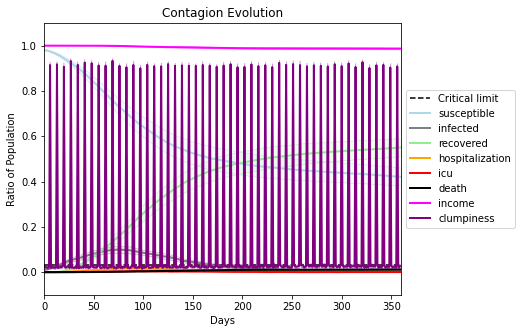

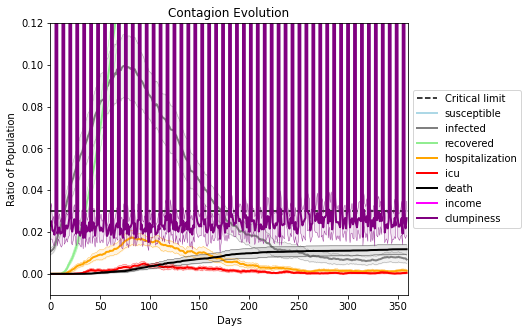

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1742, 6953, 9715, 5044, 3448, 2595, 2868, 6377, 1872, 9302, 1903, 864, 9786, 6682, 9915, 7540, 2138, 8512, 3648, 1704]
Average similarity between family members is 0.18166675458035406 at temperature -0.2
Average similarity between family and home is 0.9998521175784075 at temperature -1
Average similarity between students and their classroom is 0.17304783126537296 at temperature -0.2
Average classroom occupancy is 4.214285714285714 and number classrooms is 70
Average similarity between workers is 0.17768086281520235 at temperature -0.2
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.22108024864417236 for kids: 0.19265177076026796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.0719986251664557
avg restaurant similarity 0.10823139144930811
avg restaurant similarity -0.03643448172974349
avg restaurant similarity -0.06992602773385954
avg restaurant similarity -0.04622157501148019
avg restaurant similarity 0.01581952027883639
avg restaurant similarity 0.053150374921908744
avg restaurant similarity 0.22625156604688068
avg restaurant similarity 0.033573820031943306
avg restaurant similarity 0.08503026472318974
avg restaurant similarity 0.3900105865933755
avg restaurant similarity 0.2988719497996893
avg restaurant similarity -0.007826264566735935
avg restaurant similarity 0.22760792368448302
avg restaurant similarity 0.13687645316644834
avg restaurant similarity -0.011978611578916009
avg restaurant similarity 0.050321143364648234
avg restaurant similarity 0.17898593448460842
avg restaurant similarity 0.08991428028037132
avg restaurant similarity 0.08367305848944993
avg restaurant similarity 0.25050439300459726
avg restaurant similarity 0

avg restaurant similarity -0.1831847340156669
avg restaurant similarity 0.18360351890642176
avg restaurant similarity -0.14991026468396376
avg restaurant similarity 0.03395324120613225
avg restaurant similarity 0.172149093802228
avg restaurant similarity -0.03655897627689652
avg restaurant similarity 0.04213845684556327
avg restaurant similarity 0.01731456247183173
avg restaurant similarity 0.14399161895708446
avg restaurant similarity 0.01024063391218871
avg restaurant similarity 0.3574045096433391
avg restaurant similarity 0.03918631335376937
avg restaurant similarity 0.15323577651102133
avg restaurant similarity 0.047538116954547203
avg restaurant similarity 0.06586866210649596
avg restaurant similarity 0.18996602254146078
avg restaurant similarity 0.033204545824528774
avg restaurant similarity 0.2519260922082541
avg restaurant similarity 0.018681406747411658
avg restaurant similarity 0.06640802739956546
avg restaurant similarity 0.0063421365956428935
avg restaurant similarity 0.134

avg restaurant similarity 0.1637523090237232
avg restaurant similarity 0.11525036227228665
avg restaurant similarity 0.20415069241233472
avg restaurant similarity 0.1282124863476573
avg restaurant similarity -0.01960971661684246
avg restaurant similarity 0.15915666322174737
avg restaurant similarity 0.07426481938355055
avg restaurant similarity 0.10225090768415258
avg restaurant similarity 0.09062131867298764
avg restaurant similarity -0.17313769392805237
avg restaurant similarity 0.07450439434254742
avg restaurant similarity 0.17879995878331173
avg restaurant similarity 0.06505344763388948
avg restaurant similarity -0.005589126281451732
avg restaurant similarity -0.009265185456101442
avg restaurant similarity 0.19598660358092254
avg restaurant similarity -0.029386826105885847
avg restaurant similarity 0.002100477653673549
avg restaurant similarity 0.3584246760178173
avg restaurant similarity 0.33268446077788527
avg restaurant similarity 0.06875350711168912
avg restaurant similarity 0.

avg restaurant similarity 0.09570334179886206
avg restaurant similarity -0.0023245314250423324
avg restaurant similarity -0.04552816963506602
avg restaurant similarity 0.2652010390801874
avg restaurant similarity -0.1426062331303634
avg restaurant similarity 0.12780960430801963
avg restaurant similarity 0.0035313708810200016
avg restaurant similarity -0.04951569689578179
avg restaurant similarity 0.006228726524189404
avg restaurant similarity -0.13225499629632523
avg restaurant similarity 0.08629003822661281
avg restaurant similarity -0.12220072714248556
avg restaurant similarity 0.16912850661174003
avg restaurant similarity -0.0053693477281205396
avg restaurant similarity 0.12587756090235336
avg restaurant similarity 0.03598173318501234
avg restaurant similarity -0.09540020433152324
avg restaurant similarity 0.23651645321409345
avg restaurant similarity 0.11172826944267875
avg restaurant similarity 0.03600598343775592
avg restaurant similarity 0.16455112883119183
avg restaurant simila

avg restaurant similarity 0.18112130786735542
avg restaurant similarity 0.28205778099893725
avg restaurant similarity 0.15664681914221382
avg restaurant similarity 0.07944039550061562
avg restaurant similarity 0.0522581698162801
avg restaurant similarity 0.19780565115898918
avg restaurant similarity 0.1525760128348671
avg restaurant similarity 0.3317380964806406
avg restaurant similarity 0.05384077656870099
avg restaurant similarity -0.23297128080221285
avg restaurant similarity 0.09771208982051809
avg restaurant similarity 0.18126836339879307
avg restaurant similarity 0.3613133316966559
avg restaurant similarity 0.14370914763359424
avg restaurant similarity 0.1129630640013092
avg restaurant similarity 0.21010020524756778
avg restaurant similarity 0.25390279437896296
avg restaurant similarity 0.26590544761249846
avg restaurant similarity 0.23990732880389926
avg restaurant similarity -0.008345360180822695
avg restaurant similarity 0.1036781024251606
avg restaurant similarity 0.321726734

avg restaurant similarity 0.13428034281524226
avg restaurant similarity 0.024716212958343114
avg restaurant similarity -0.10319268555308181
avg restaurant similarity 0.033719018615298184
avg restaurant similarity -0.034070108088657264
avg restaurant similarity 0.08917496248864411
avg restaurant similarity -0.03721628437404682
avg restaurant similarity 0.08626158269646436
avg restaurant similarity 0.11387152080574807
avg restaurant similarity 0.05503625868428447
avg restaurant similarity 0.05158475109073712
avg restaurant similarity 0.14826292371219088
avg restaurant similarity 0.3030621132810168
avg restaurant similarity 0.2252022131023321
avg restaurant similarity 0.12191265638453777
avg restaurant similarity 0.2908891185027198
avg restaurant similarity 0.17800590297074617
avg restaurant similarity 0.3468618186831687
avg restaurant similarity 0.1446346185765567
avg restaurant similarity 0.1514318432025671
avg restaurant similarity 0.0649868408902338
avg restaurant similarity 0.0531704

avg restaurant similarity 0.11987669853572425
avg restaurant similarity -0.11627936486036364
avg restaurant similarity -0.029861881195041608
avg restaurant similarity -0.14344170743028842
avg restaurant similarity -0.04857302251781495
avg restaurant similarity -0.10069921333820428
avg restaurant similarity 0.026130735961774936
avg restaurant similarity -0.04148954598737799
avg restaurant similarity 0.14146518735888583
avg restaurant similarity -0.05355255971298699
avg restaurant similarity 0.07764958562121156
avg restaurant similarity 0.15982883521649527
avg restaurant similarity 0.0050460736935893785
avg restaurant similarity 0.05134849004469207
avg restaurant similarity 0.13227508424368636
avg restaurant similarity 0.061359833620159655
avg restaurant similarity 0.09398394447738283
avg restaurant similarity 0.09347308417276956
avg restaurant similarity 0.02012149401481712
avg restaurant similarity 0.054825002782920795
avg restaurant similarity 0.0650509972241711
avg restaurant similar

avg restaurant similarity -0.16464465382805893
avg restaurant similarity -0.06226430436532516
avg restaurant similarity -0.013280690691900392
avg restaurant similarity 0.011214638422637126
avg restaurant similarity -0.026189778458686943
avg restaurant similarity -0.16245588347167003
avg restaurant similarity 0.05489311614824493
avg restaurant similarity -0.12304282898522018
avg restaurant similarity 0.06511849144726625
avg restaurant similarity -0.02492192850505266
avg restaurant similarity 0.12037863943448501
avg restaurant similarity 0.04627628721446541
avg restaurant similarity -0.04506078012500339
avg restaurant similarity -0.006201325749901299
avg restaurant similarity -0.05150529663939357
avg restaurant similarity 0.1198869254661425
avg restaurant similarity 0.21803518935776753
avg restaurant similarity 0.010878180381381906
avg restaurant similarity -0.008676083913231016
avg restaurant similarity -0.0076867314157830005
avg restaurant similarity 0.1811354748368143
avg restaurant s

avg restaurant similarity 0.11262515617056625
avg restaurant similarity 0.09495357851481305
avg restaurant similarity 0.009383013235784105
avg restaurant similarity -0.014492194567191722
avg restaurant similarity -0.010980640155686382
avg restaurant similarity 0.16078269942450632
avg restaurant similarity 0.04912705807543649
avg restaurant similarity 0.09940420845938683
avg restaurant similarity 0.053372690624212384
avg restaurant similarity 0.10733575920749597
avg restaurant similarity 0.013106352065433473
avg restaurant similarity -0.06226806348570215
avg restaurant similarity 0.2493517793517149
avg restaurant similarity 0.07566021766644945
avg restaurant similarity 0.17181719386831926
avg restaurant similarity -0.014503210630230474
avg restaurant similarity 0.11640917902365003
avg restaurant similarity 0.04752555030658803
avg restaurant similarity 0.026809266236153113
avg restaurant similarity 0.28932743429497576
avg restaurant similarity 0.13280991726432517
avg restaurant similarit

avg restaurant similarity 0.3598912989732379
avg restaurant similarity 0.2575847225372309
avg restaurant similarity 0.04825144916588322
avg restaurant similarity 0.1625951930458794
avg restaurant similarity 0.18851637218956224
avg restaurant similarity 0.17256579547804238
avg restaurant similarity 0.095938493220617
avg restaurant similarity 0.0394115882646772
avg restaurant similarity 0.20221805483937536
avg restaurant similarity 0.03498486940630155
avg restaurant similarity 0.041342799708021044
avg restaurant similarity 0.18026935292309176
avg restaurant similarity -0.16727142400316267
avg restaurant similarity 0.2554870775736299
avg restaurant similarity 0.20820941331665702
avg restaurant similarity -0.13999979779210472
avg restaurant similarity 0.4603002715410415
avg restaurant similarity 0.032155304113004185
avg restaurant similarity 0.23163145608217742
avg restaurant similarity 0.11771633949932718
avg restaurant similarity 0.05298813076067138
avg restaurant similarity 0.4269133160

avg restaurant similarity 0.11355186585606199
avg restaurant similarity 0.21554007651782267
avg restaurant similarity 0.05934020410110094
avg restaurant similarity 0.11416688845772363
avg restaurant similarity 0.03484400454988
avg restaurant similarity 0.09006630350215593
avg restaurant similarity 0.13524288378051758
avg restaurant similarity -0.0050042929269366
avg restaurant similarity 0.044134811820313063
avg restaurant similarity 0.012353145742497795
avg restaurant similarity 0.07751671195780974
avg restaurant similarity 0.1608420301706763
avg restaurant similarity 0.11755977421626825
avg restaurant similarity 0.1191710918395791
avg restaurant similarity 0.13844300125179318
avg restaurant similarity 0.0963711767288938
avg restaurant similarity 0.24285878587472828
avg restaurant similarity 0.11789383392920016
avg restaurant similarity 0.020235049708812167
avg restaurant similarity 0.07671285959117066
avg restaurant similarity 0.05321806087720933
avg restaurant similarity -0.01670300

avg restaurant similarity 0.03313316931670577
avg restaurant similarity 0.10476549769233308
avg restaurant similarity 0.10021688403221081
avg restaurant similarity -0.0005936759342804743
avg restaurant similarity -0.03292735017659543
avg restaurant similarity 0.10101598991105523
avg restaurant similarity 0.15332946776147688
avg restaurant similarity 0.1701036731227249
avg restaurant similarity 0.09327327031843904
avg restaurant similarity 0.0655714624278127
avg restaurant similarity 0.1361214849787839
avg restaurant similarity 0.048812453984432104
avg restaurant similarity 0.10480922752931979
avg restaurant similarity 0.05699050786854201
avg restaurant similarity 0.03573516919632548
avg restaurant similarity 0.18532420406062092
avg restaurant similarity 0.04673088599148575
avg restaurant similarity -0.0015459570591914566
avg restaurant similarity 0.07067841137061817
avg restaurant similarity 0.058591222219082056
avg restaurant similarity 0.06321257996844104
avg restaurant similarity 0.

avg restaurant similarity -0.027141816825713195
avg restaurant similarity 0.04859629866760192
avg restaurant similarity 0.04121885189702912
avg restaurant similarity 0.16973956336894783
avg restaurant similarity 0.12519658636404082
avg restaurant similarity 0.1901366839733816
avg restaurant similarity -0.01001958574974403
avg restaurant similarity 0.17507167532038628
avg restaurant similarity 0.03701978633083268
avg restaurant similarity 0.2067903059019143
avg restaurant similarity -0.2323040374832566
avg restaurant similarity 0.42222979813168976
avg restaurant similarity 0.15524909988501714
avg restaurant similarity -0.07598532717911827
avg restaurant similarity 0.08008076089787418
avg restaurant similarity -0.13149663603458284
avg restaurant similarity -0.05013771234599031
avg restaurant similarity 0.09764823138322544
avg restaurant similarity -0.11461330096200478
avg restaurant similarity -0.04606778064046431
avg restaurant similarity 0.016975342189190657
avg restaurant similarity -

avg restaurant similarity -0.11799522000907879
avg restaurant similarity 0.09660225885189488
avg restaurant similarity 0.04151490517116764
avg restaurant similarity -0.07002151713922564
avg restaurant similarity -0.1416978635537154
avg restaurant similarity 0.14250003896332483
avg restaurant similarity 0.046553059760717046
avg restaurant similarity 0.08152908607453492
avg restaurant similarity 0.31718861783804597
avg restaurant similarity 0.16778854226520512
avg restaurant similarity 0.00613975471408329
avg restaurant similarity -0.028599476773290063
avg restaurant similarity -0.4249403262873084
avg restaurant similarity 0.1509856889824323
avg restaurant similarity 0.1413325883501753
avg restaurant similarity 0.1128740717096726
avg restaurant similarity -0.22659327203983828
avg restaurant similarity 0.1333076103127743
avg restaurant similarity 0.1360357526237198
avg restaurant similarity 0.01490139165173246
avg restaurant similarity -0.0092332832423879
avg restaurant similarity -0.0768

avg restaurant similarity 0.033860925323786005
avg restaurant similarity 0.06249547470887157
avg restaurant similarity 0.09653027790496374
avg restaurant similarity 0.18041359179696453
avg restaurant similarity 0.3184636191881807
avg restaurant similarity 0.18894350635344237
avg restaurant similarity 0.3006324833944851
avg restaurant similarity 0.003293968346537751
avg restaurant similarity 0.041961466067176156
avg restaurant similarity 0.14430370854146227
avg restaurant similarity 0.021649610682475777
avg restaurant similarity 0.1743456931119647
avg restaurant similarity 0.4295210662025651
avg restaurant similarity 0.274098428105127
avg restaurant similarity 0.49044096949532157
avg restaurant similarity 0.13684182757870922
avg restaurant similarity 0.14220416628777902
avg restaurant similarity -0.05200398126820162
avg restaurant similarity -0.06314001880527327
avg restaurant similarity 0.4976710140223925
avg restaurant similarity 0.28908405856986313
avg restaurant similarity 0.0304676

avg restaurant similarity -0.055829768864675104
avg restaurant similarity 0.06001121603379971
avg restaurant similarity 0.23630944083335567
avg restaurant similarity 0.07130791065493138
avg restaurant similarity 0.02283245588004501
avg restaurant similarity 0.19989217040024748
avg restaurant similarity 0.13858330363629662
avg restaurant similarity -0.03370532972931169
avg restaurant similarity -0.05388133675606041
avg restaurant similarity 0.02052151404206982
avg restaurant similarity 0.11289263718954676
avg restaurant similarity 0.06958892076737454
avg restaurant similarity 0.21872717988262858
avg restaurant similarity 0.10738548356606688
avg restaurant similarity 0.027257858321974318
avg restaurant similarity 0.10397986209118866
avg restaurant similarity 0.12623661909261066
avg restaurant similarity 0.2546560665233002
avg restaurant similarity 0.22502339864454127
avg restaurant similarity 0.2990646883021498
avg restaurant similarity 0.1324135752106958
avg restaurant similarity 0.0269

avg restaurant similarity 0.10437495199616557
avg restaurant similarity -0.050135115414235265
avg restaurant similarity 0.17546065814513198
avg restaurant similarity 0.061408626283988375
avg restaurant similarity 0.009449083958994412
avg restaurant similarity 0.1205489136969262
avg restaurant similarity 0.3732543911052841
avg restaurant similarity 0.45934383508572807
avg restaurant similarity 0.11750356790160348
avg restaurant similarity 0.0034176369815954177
avg restaurant similarity -0.15047092959109315
avg restaurant similarity 0.05227321489892467
avg restaurant similarity 0.4397939306758595
avg restaurant similarity 0.21623791790230698
avg restaurant similarity 0.26830815330872115
avg restaurant similarity 0.042077109651507204
avg restaurant similarity 0.27463626829699067
avg restaurant similarity -0.034473081694172195
avg restaurant similarity 0.09011608167266161
avg restaurant similarity -0.05580645091274317
avg restaurant similarity 0.23232477799956566
avg restaurant similarity 

avg restaurant similarity 0.05919191752649674
avg restaurant similarity 0.2066218524857605
avg restaurant similarity -0.12363414675487011
avg restaurant similarity 0.1432194648331118
avg restaurant similarity 0.24450679868473055
avg restaurant similarity -0.04938512502391296
avg restaurant similarity 0.3253050377930822
avg restaurant similarity 0.2404802483581941
avg restaurant similarity 0.15515116183738223
avg restaurant similarity 0.011145326770327514
avg restaurant similarity 0.22679999808879403
avg restaurant similarity 0.10663115200426711
avg restaurant similarity 0.2851193056636797
avg restaurant similarity 0.10571170814024772
avg restaurant similarity 0.0782554342597986
avg restaurant similarity 0.07731104067178152
avg restaurant similarity 0.15548730937998448
avg restaurant similarity 0.2432128699304166
avg restaurant similarity 0.2680645914942714
avg restaurant similarity 0.31670191099756606
avg restaurant similarity 0.13178196682475135
avg restaurant similarity 0.05937908633

avg restaurant similarity 0.09844046936197244
avg restaurant similarity 0.10730509531679859
avg restaurant similarity 0.1780770286897447
avg restaurant similarity -0.0732702063644514
avg restaurant similarity -0.0123048239596927
avg restaurant similarity 0.1850155063402038
avg restaurant similarity -0.09996803852081441
avg restaurant similarity -0.10999502346557996
avg restaurant similarity 0.3058140942593498
avg restaurant similarity 0.3657984383958135
avg restaurant similarity 0.09262708807651628
avg restaurant similarity 0.39516705131418334
avg restaurant similarity 0.02672754826259307
avg restaurant similarity -0.03281453639177454
avg restaurant similarity -0.2449269255597561
avg restaurant similarity 0.14947621928206353
avg restaurant similarity 0.04076455114883635
avg restaurant similarity -0.05796649513831177
avg restaurant similarity 0.24909668370733795
avg restaurant similarity 0.053554583959710515
avg restaurant similarity -0.16078053325406405
avg restaurant similarity 0.1383

avg restaurant similarity -0.258325939148759
avg restaurant similarity -0.01732321902103108
avg restaurant similarity 0.16408080701317537
avg restaurant similarity 0.008182403961519364
avg restaurant similarity -0.09828660535991297
avg restaurant similarity 0.068203067988283
avg restaurant similarity -0.08974157279665716
avg restaurant similarity 0.08514440441632083
avg restaurant similarity 0.14649813157807345
avg restaurant similarity -0.027505232953858115
avg restaurant similarity 0.08886618419086763
avg restaurant similarity 0.260579495883908
avg restaurant similarity 0.04030206738840076
avg restaurant similarity 0.15157828050982594
avg restaurant similarity -0.002244654129600565
avg restaurant similarity 0.12076850025481495
avg restaurant similarity 0.11782392633437873
avg restaurant similarity 0.061544786699590424
avg restaurant similarity -0.032944867564014886
avg restaurant similarity 0.38028925253987517
avg restaurant similarity 0.13442079369258503
avg restaurant similarity 0.

avg restaurant similarity -0.2384426240768882
avg restaurant similarity -0.08381216159293971
avg restaurant similarity -0.12683222985025772
avg restaurant similarity -0.170590735358808
avg restaurant similarity -0.07511784444283402
avg restaurant similarity 0.07949864308251849
avg restaurant similarity 0.17990575476250148
avg restaurant similarity -0.17513968814592865
avg restaurant similarity 0.017840453498538536
avg restaurant similarity -0.02145360590518615
avg restaurant similarity -0.12377746375727429
avg restaurant similarity -0.08066611629546858
avg restaurant similarity 0.15230818592206072
avg restaurant similarity 0.1464798938249859
avg restaurant similarity -0.10721208379629332
avg restaurant similarity -0.11131331276463541
avg restaurant similarity 0.0026074248633697616
avg restaurant similarity -0.019749066723063674
avg restaurant similarity -0.05006636862510526
avg restaurant similarity -0.055094105363550125
avg restaurant similarity 0.17463894804836436
avg restaurant simi

avg restaurant similarity 0.09359880065929968
avg restaurant similarity -0.33076243605824096
avg restaurant similarity -0.04955689225218435
avg restaurant similarity -0.11240039784282045
avg restaurant similarity -0.07265829049393575
avg restaurant similarity 0.09695796188799498
avg restaurant similarity -0.03334755887018898
avg restaurant similarity 0.011463571849543372
avg restaurant similarity -0.001210906845310944
avg restaurant similarity 0.1410315888532854
avg restaurant similarity 0.12692406245711296
avg restaurant similarity -0.08053635270402328
avg restaurant similarity 0.18371018147085855
avg restaurant similarity -0.14776832920605912
avg restaurant similarity 0.058762257442787416
avg restaurant similarity 0.0130399130447513
avg restaurant similarity -0.04134396698551976
avg restaurant similarity 0.1967265147390634
avg restaurant similarity -0.09950596932640393
avg restaurant similarity 0.12379937932643313
avg restaurant similarity -0.0080482328544157
avg restaurant similarit

avg restaurant similarity 0.3024575611444449
avg restaurant similarity 0.20713017857571883
avg restaurant similarity 0.07542925268915224
avg restaurant similarity 0.38102694316352126
avg restaurant similarity 0.11357672935005277
avg restaurant similarity 0.43797618641912994
avg restaurant similarity 0.1450414631650516
avg restaurant similarity 0.08400040484079506
avg restaurant similarity -0.055670201185017226
avg restaurant similarity 0.005267195795850595
avg restaurant similarity 0.18246696821244898
avg restaurant similarity 0.14527438438613396
avg restaurant similarity 0.016288188792886626
avg restaurant similarity 0.17101923823687168
avg restaurant similarity 0.01609680383217964
avg restaurant similarity -0.012592097561993023
avg restaurant similarity 0.12572341538790147
avg restaurant similarity 0.021168000284221777
avg restaurant similarity -0.21610965932034656
avg restaurant similarity 0.04147389707846155
avg restaurant similarity 0.11192345357060234
avg restaurant similarity 0.

avg restaurant similarity 0.025845201680447676
avg restaurant similarity 0.18161763056524782
avg restaurant similarity 0.10705801007149364
avg restaurant similarity -0.024756614669496614
avg restaurant similarity 0.07584240143374453
avg restaurant similarity -0.09481707540509383
avg restaurant similarity 0.28520250401576464
avg restaurant similarity 0.16315607768054186
avg restaurant similarity 0.13761825889239107
avg restaurant similarity 0.07408146265177826
avg restaurant similarity 0.1249215113684059
avg restaurant similarity 0.04865396429299481
avg restaurant similarity 0.16009891602008386
avg restaurant similarity -0.11100677752961931
avg restaurant similarity 0.1227007937022844
avg restaurant similarity 0.050602554267402754
avg restaurant similarity -0.08174014885618314
avg restaurant similarity 0.09037402587421318
avg restaurant similarity 0.24492997694483667
avg restaurant similarity 0.04429655695587411
avg restaurant similarity 0.10725262244336924
avg restaurant similarity 0.0

avg restaurant similarity 0.103392733078299
avg restaurant similarity -0.07164292541636634
avg restaurant similarity 0.06438723070008831
avg restaurant similarity 0.15631099837442802
avg restaurant similarity 0.0273580757580998
avg restaurant similarity 0.09426235407169353
avg restaurant similarity 0.010727448367922776
avg restaurant similarity 0.1959632098326877
avg restaurant similarity 0.15263789085738394
avg restaurant similarity -0.01831133835553556
avg restaurant similarity -0.030495751959452793
avg restaurant similarity 0.0751156010750457
avg restaurant similarity -0.052203555591285804
avg restaurant similarity -0.017690595932730806
avg restaurant similarity 0.1796818798819142
avg restaurant similarity -0.052647058294625
avg restaurant similarity 0.3560702598230097
avg restaurant similarity 0.07543362670060169
avg restaurant similarity 0.029425511068035665
avg restaurant similarity -0.07300271643675371
avg restaurant similarity 0.005425358085057177
avg restaurant similarity 0.03

avg restaurant similarity -1.9892307843369372e-05
avg restaurant similarity -0.06882762693235027
avg restaurant similarity 0.19393520321611385
avg restaurant similarity 0.2634396598426632
avg restaurant similarity -0.0013813748165411005
avg restaurant similarity 0.03854825032547596
avg restaurant similarity 0.22612136623919893
avg restaurant similarity 0.21648556561497806
avg restaurant similarity 0.13485589533395262
avg restaurant similarity 0.11220627190872388
avg restaurant similarity 0.16381113460715074
avg restaurant similarity 0.32616770971357606
avg restaurant similarity 0.20759502722817694
avg restaurant similarity 0.12559487391085442
avg restaurant similarity 0.27305325637363376
avg restaurant similarity 0.12050967235682791
avg restaurant similarity 0.01884262746429493
avg restaurant similarity 0.08102356790006315
avg restaurant similarity 0.025878808553159757
avg restaurant similarity 0.0005926312206098006
avg restaurant similarity -0.014684099838737114
avg restaurant similar

avg restaurant similarity 0.1285408308904847
avg restaurant similarity 0.04453449323558493
avg restaurant similarity 0.12423802824923424
avg restaurant similarity 0.2235670478751398
avg restaurant similarity 0.09675456747595979
avg restaurant similarity 0.04891369198860959
avg restaurant similarity -0.121944978865053
avg restaurant similarity 0.04129349555243827
avg restaurant similarity 0.4499425875997301
avg restaurant similarity 0.24515771473035142
avg restaurant similarity -0.12365430535546773
avg restaurant similarity 0.16118042117869236
avg restaurant similarity 0.03302470881991123
avg restaurant similarity 0.1937295491765579
avg restaurant similarity -0.04275319525876142
avg restaurant similarity 0.1063501838820791
avg restaurant similarity 0.006149559519976186
avg restaurant similarity -0.007572476548622406
avg restaurant similarity -0.048568212617217964
avg restaurant similarity 0.01365064294415698
avg restaurant similarity 0.013217492974515651
avg restaurant similarity 0.0893

avg restaurant similarity 0.15598868962525692
avg restaurant similarity 0.06927715499718208
avg restaurant similarity 0.12824065108321808
avg restaurant similarity 0.11486911577522219
avg restaurant similarity 0.23698812579940798
avg restaurant similarity 0.06259381606377853
avg restaurant similarity 0.19256898416655172
avg restaurant similarity -0.11084453023601062
avg restaurant similarity 0.3032929698605329
avg restaurant similarity 0.15489724818905629
avg restaurant similarity -0.04726851592195517
avg restaurant similarity 0.03343487197797743
avg restaurant similarity 0.12953285159728534
avg restaurant similarity 0.003986911579378978
avg restaurant similarity 0.062166870426207166
avg restaurant similarity 0.21993118675150725
avg restaurant similarity -0.15675738871927614
avg restaurant similarity 0.06510793280074491
avg restaurant similarity 0.11605364325406649
avg restaurant similarity -0.038571946930025844
avg restaurant similarity 0.24938427165003152
avg restaurant similarity 0.

avg restaurant similarity 0.2721661984656354
avg restaurant similarity 0.2204432449149946
avg restaurant similarity 0.11700872150262741
avg restaurant similarity 0.14552378813402506
avg restaurant similarity 0.12820667534340985
avg restaurant similarity -0.0055787490923333944
avg restaurant similarity 0.15159109567643803
avg restaurant similarity 0.09067757700623277
avg restaurant similarity 0.048331515563171314
avg restaurant similarity 0.20728218647353733
avg restaurant similarity 0.0011011724694995895
avg restaurant similarity -0.05804812995083665
avg restaurant similarity 0.2579848501203603
avg restaurant similarity 0.04527884381740863
avg restaurant similarity 0.1531533497240401
avg restaurant similarity -0.00036329614917414156
avg restaurant similarity 0.17830075235378148
avg restaurant similarity 0.057745663016913695
avg restaurant similarity 0.07341158166327497
avg restaurant similarity 0.09652887074128103
avg restaurant similarity -0.03453221296768821
avg restaurant similarity

avg restaurant similarity 0.02992333211929119
avg restaurant similarity 0.14882409375144504
avg restaurant similarity 0.35495451526739386
avg restaurant similarity 0.11274894300147033
avg restaurant similarity 0.1389751336770988
avg restaurant similarity 0.24551246166185017
avg restaurant similarity 0.08268908014618614
avg restaurant similarity 0.03442289652291387
avg restaurant similarity 0.12164421283386165
avg restaurant similarity 0.24958389486869748
avg restaurant similarity 0.07419732891280564
avg restaurant similarity 0.14967895801053735
avg restaurant similarity 0.08308062228464716
avg restaurant similarity 0.28552786544959197
avg restaurant similarity 0.15434042645476748
avg restaurant similarity 0.05459438895538182
avg restaurant similarity -0.057400873922097424
avg restaurant similarity -0.04864253622809588
avg restaurant similarity 0.18806759817046376
avg restaurant similarity 0.043237971949044794
avg restaurant similarity 0.2130100701713647
avg restaurant similarity 0.1083

avg restaurant similarity 0.01647014305528921
avg restaurant similarity 0.07845282094206586
avg restaurant similarity 0.13895906235351435
avg restaurant similarity 0.26555500585528635
avg restaurant similarity 0.19836270187008695
avg restaurant similarity -0.121810897977149
avg restaurant similarity -0.10562796420765735
avg restaurant similarity 0.10015592058448997
avg restaurant similarity 0.12698222239027068
avg restaurant similarity 0.28516704977685775
avg restaurant similarity 0.007133950770660159
avg restaurant similarity 0.021033906232512115
avg restaurant similarity 0.009637251522531113
avg restaurant similarity 0.8534186559197654
avg restaurant similarity 0.01620661513809624
avg restaurant similarity 0.15609374929707526
avg restaurant similarity 0.09107896851382381
avg restaurant similarity 0.20278199428461055
avg restaurant similarity 0.4029957059109064
avg restaurant similarity -0.09190294549665107
avg restaurant similarity -0.02696838436166692
avg restaurant similarity -0.04

avg restaurant similarity -0.24521089123370357
avg restaurant similarity -0.14826234591456655
avg restaurant similarity -0.07937542521512328
avg restaurant similarity 0.13504993729094486
avg restaurant similarity 0.16091180006633193
avg restaurant similarity 0.15223624310726727
avg restaurant similarity 0.16807596771179045
avg restaurant similarity -0.032541031046218485
avg restaurant similarity 0.1361959439925098
avg restaurant similarity 0.005379351987149138
avg restaurant similarity 0.021927739583377005
avg restaurant similarity 0.11787123264819493
avg restaurant similarity -0.1005795179521725
avg restaurant similarity 0.024000962888123166
avg restaurant similarity -0.0036026225945263116
avg restaurant similarity -0.002590653796511714
avg restaurant similarity 0.12172480323253608
avg restaurant similarity -0.014010022259466471
avg restaurant similarity -0.027731833456206216
avg restaurant similarity -0.22987653043162903
avg restaurant similarity 0.06447786862021035
avg restaurant si

avg restaurant similarity 0.12481921098730818
avg restaurant similarity -0.0021352207687555746
avg restaurant similarity 0.15378615825143607
avg restaurant similarity -0.05705355510119644
avg restaurant similarity 0.19907509227781847
avg restaurant similarity 0.01659040607701576
avg restaurant similarity -0.002443149752752697
avg restaurant similarity 0.09482275096931886
avg restaurant similarity 0.12630014523643113
avg restaurant similarity 0.1899993040990103
avg restaurant similarity -0.08921108515318578
avg restaurant similarity -0.13444604160221713
avg restaurant similarity 0.08429491151385315
avg restaurant similarity -0.19882358002342695
avg restaurant similarity 0.1618509213362514
avg restaurant similarity 0.12722959814148618
avg restaurant similarity 0.09406969419273002
avg restaurant similarity -0.13532278120027025
avg restaurant similarity -0.015463983460633435
avg restaurant similarity -0.1765921533458937
avg restaurant similarity 0.10523559778440168
avg restaurant similarit

avg restaurant similarity 0.01605069379045496
avg restaurant similarity 0.005592047222790109
avg restaurant similarity 0.05907620572189017
avg restaurant similarity -0.06867792936911309
avg restaurant similarity 0.10705716065434473
avg restaurant similarity 0.23380619592600257
avg restaurant similarity 0.25907118146714286
avg restaurant similarity 0.18768155993402422
avg restaurant similarity 0.07217202177286759
avg restaurant similarity 0.03493444653284469
avg restaurant similarity -0.011098205484824408
avg restaurant similarity -0.027563631867404716
avg restaurant similarity 0.07122825455476568
avg restaurant similarity -0.014797722396746057
avg restaurant similarity 0.042480126891777416
avg restaurant similarity 0.1885679447170853
avg restaurant similarity 0.006714897356266254
avg restaurant similarity 0.08443629630008198
avg restaurant similarity -0.019441720926027164
avg restaurant similarity 0.0614723457607748
avg restaurant similarity 0.25516554623673304
avg restaurant similarit

avg restaurant similarity 0.21705143733196613
avg restaurant similarity -0.09374362803060245
avg restaurant similarity -0.007336185991919213
avg restaurant similarity 0.09181426218778027
avg restaurant similarity 0.18659168024660827
avg restaurant similarity 0.005587652681332556
avg restaurant similarity -0.02361687591875659
avg restaurant similarity 0.17361561112003498
avg restaurant similarity 0.17981807692968477
avg restaurant similarity 0.08264032819225287
avg restaurant similarity 0.23062297771205015
avg restaurant similarity 0.11370092599426207
avg restaurant similarity 0.1333307187073877
avg restaurant similarity -0.03964571826310534
avg restaurant similarity -0.019529260176560346
avg restaurant similarity -0.08949471298548002
avg restaurant similarity 0.04674977172929798
avg restaurant similarity 0.2231297835986749
avg restaurant similarity -0.10089351582029264
avg restaurant similarity 0.1206714270106282
avg restaurant similarity 0.14246972608189568
avg restaurant similarity 0

avg restaurant similarity 0.010567185185211018
avg restaurant similarity -0.1105300206512863
avg restaurant similarity 0.07590140992452421
avg restaurant similarity 0.09768129264769332
avg restaurant similarity -0.08323986974785838
avg restaurant similarity -0.04985279181508458
avg restaurant similarity 0.06719708848737686
avg restaurant similarity 0.04124369332665975
avg restaurant similarity -0.094060425553389
avg restaurant similarity -0.0493794145323446
avg restaurant similarity -0.06067310982970344
avg restaurant similarity 0.1085977061866043
avg restaurant similarity 0.13566165887346943
avg restaurant similarity 0.04184472660557587
avg restaurant similarity -0.06062393494455798
avg restaurant similarity -0.03671063175513654
avg restaurant similarity -0.04383796850351869
avg restaurant similarity 0.10755639226851074
avg restaurant similarity -0.0978021852523273
avg restaurant similarity -0.013106790952271742
avg restaurant similarity -0.014635604619380793
avg restaurant similarity

avg restaurant similarity 0.22537513252268077
avg restaurant similarity 0.24901390943869822
avg restaurant similarity 0.30901434136501293
avg restaurant similarity 0.041996154158972135
avg restaurant similarity 0.0074183383215924645
avg restaurant similarity 0.0603704262884469
avg restaurant similarity 0.1813990188524986
avg restaurant similarity -0.0012210427976436014
avg restaurant similarity 0.03103128812003482
avg restaurant similarity 0.07138439567361869
avg restaurant similarity -0.01960248780578766
avg restaurant similarity 0.061265491017609454
avg restaurant similarity 0.3124196035823894
avg restaurant similarity -0.17831164557796458
avg restaurant similarity 0.001740684327963718
avg restaurant similarity -0.03967911798791291
avg restaurant similarity 0.12302498560414274
avg restaurant similarity -0.11509289535013607
avg restaurant similarity -0.02099300701621959
avg restaurant similarity 0.06957779187677661
avg restaurant similarity 0.08840248234222414
avg restaurant similarit

avg restaurant similarity 0.012678673253471169
avg restaurant similarity 0.04410735521638782
avg restaurant similarity 0.12984634165315598
avg restaurant similarity -0.07260765565558826
avg restaurant similarity 0.18280661510370755
avg restaurant similarity -0.0859059699743465
avg restaurant similarity 0.018982683089901656
avg restaurant similarity -0.026578024307917874
avg restaurant similarity 0.16678839316412672
avg restaurant similarity 0.13918178042850582
avg restaurant similarity -0.017534165295339115
avg restaurant similarity -0.039588927775515856
avg restaurant similarity 0.1628533329305176
avg restaurant similarity 0.10092863784377097
avg restaurant similarity 0.09760686790705526
avg restaurant similarity 0.15756287143363082
avg restaurant similarity 0.2131486790401504
avg restaurant similarity 0.0353368833607534
avg restaurant similarity 0.0330155340605361
avg restaurant similarity 0.07989127356937421
avg restaurant similarity 0.16624049194473178
avg restaurant similarity 0.1

avg restaurant similarity 0.1355016989572433
avg restaurant similarity 0.14689170011706304
avg restaurant similarity 0.0976387408416896
avg restaurant similarity 0.00022976344399781536
avg restaurant similarity -0.01152141684925693
avg restaurant similarity -0.048027143576465293
avg restaurant similarity -0.10708182699634117
avg restaurant similarity 0.13911974404000138
avg restaurant similarity 0.09572206732905078
avg restaurant similarity 0.10956181716749344
avg restaurant similarity -0.023884310667962417
avg restaurant similarity 0.1724524650032112
avg restaurant similarity 0.2131979779970205
avg restaurant similarity 0.102995793279918
avg restaurant similarity 0.10593006973690156
avg restaurant similarity 0.09474878444753998
avg restaurant similarity 0.29534280512112326
avg restaurant similarity 0.20764766057337777
avg restaurant similarity 0.08079287194892126
avg restaurant similarity 0.11398335010669786
avg restaurant similarity 0.1481496749469946
avg restaurant similarity 0.1234

avg restaurant similarity 0.1009370209543304
avg restaurant similarity -0.08954603954716664
avg restaurant similarity 0.06465004669255384
avg restaurant similarity 0.0787224150115569
avg restaurant similarity 0.05662361757254158
avg restaurant similarity -0.0419386489053191
avg restaurant similarity 0.10671674885825351
avg restaurant similarity 0.16098809292379435
avg restaurant similarity 0.12984771777198634
avg restaurant similarity 0.10736906973257339
avg restaurant similarity 0.14478361622450378
avg restaurant similarity 0.16556881591392136
avg restaurant similarity 0.1022839308416932
avg restaurant similarity -0.01942908567811254
avg restaurant similarity 0.03496042849197701
avg restaurant similarity 0.04196543502614548
avg restaurant similarity 0.0019380369248080953
avg restaurant similarity 0.025826661323234575
avg restaurant similarity 0.15082594673320346
avg restaurant similarity 0.1232557330933016
avg restaurant similarity 0.09571436986945939
avg restaurant similarity 0.13101

(<function dict.items>, <function dict.items>, <function dict.items>)

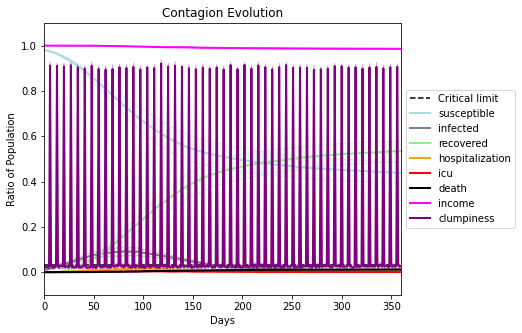

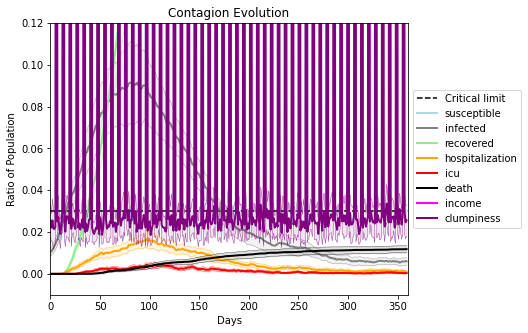

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[960, 2815, 2786, 4709, 1319, 9363, 5032, 2233, 2704, 327, 6157, 549, 2120, 1465, 4475, 1318, 6306, 3433, 9626, 3298]
Average similarity between family members is 0.17736513100715032 at temperature -0.1
Average similarity between family and home is 0.9998508195221374 at temperature -1
Average similarity between students and their classroom is 0.1653961850335597 at temperature -0.1
Average classroom occupancy is 3.8115942028985508 and number classrooms is 69
Average similarity between workers is 0.14473971570841423 at temperature -0.1
Average office occupancy is 3.396039603960396 and number offices is 202
Average friend similarity for adults: 0.21370689852386704 for kids: 0.20421109728660192
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.2097188977591235
avg restaurant similarity 0.19230301396360988
avg restaurant similarity 0.007365712590309167
avg restaurant similarity 0.04288105288588556
avg restaurant similarity 0.29891549492747016
avg restaurant similarity -0.0955448347084458
avg restaurant similarity 0.15450394241875398
avg restaurant similarity 0.17307711824854824
avg restaurant similarity 0.399699904965873
avg restaurant similarity -0.13670338141096955
avg restaurant similarity 0.056306189710177805
avg restaurant similarity -0.04495141935545895
avg restaurant similarity 0.15874399858912472
avg restaurant similarity 0.08143306166855449
avg restaurant similarity 0.20222492801367706
avg restaurant similarity -0.011194817329436446
avg restaurant similarity 0.29426370088184917
avg restaurant similarity -0.14553351389531974
avg restaurant similarity 0.00692940699349424
avg restaurant similarity 0.06673316215205743
avg restaurant similarity 0.0072664130157473195
avg restaurant similarity 0.

avg restaurant similarity 0.01273960009139031
avg restaurant similarity 0.11172691748015118
avg restaurant similarity 0.012343421739356217
avg restaurant similarity 0.20015857469760773
avg restaurant similarity 0.1442059857233337
avg restaurant similarity 0.06132022701877901
avg restaurant similarity 0.06889460432277701
avg restaurant similarity 0.19409194592727683
avg restaurant similarity -0.23043023414523434
avg restaurant similarity 0.09109522854216136
avg restaurant similarity 0.08444640767865523
avg restaurant similarity 0.10012263196045199
avg restaurant similarity 0.26653908787914193
avg restaurant similarity -0.08941575425107348
avg restaurant similarity -0.03117861220098605
avg restaurant similarity 0.18181924547566758
avg restaurant similarity 0.06870561585572123
avg restaurant similarity -0.03297774087045815
avg restaurant similarity 0.11585998390722195
avg restaurant similarity 0.05096409627642128
avg restaurant similarity 0.15230240769125625
avg restaurant similarity 0.10

avg restaurant similarity -0.008478400653552903
avg restaurant similarity 0.2750610275229465
avg restaurant similarity 0.08453921078532864
avg restaurant similarity 0.13995190477522645
avg restaurant similarity 0.04478604498355457
avg restaurant similarity 0.048891749747034564
avg restaurant similarity 0.03027401823953859
avg restaurant similarity 0.22918892386063194
avg restaurant similarity 0.05918455130305844
avg restaurant similarity -0.0034665500388654014
avg restaurant similarity 0.2149592714431416
avg restaurant similarity 0.09975931297087076
avg restaurant similarity 0.27895837711721766
avg restaurant similarity 0.10532165708932746
avg restaurant similarity -0.0444794853138295
avg restaurant similarity 0.16672083849455072
avg restaurant similarity -0.02119131005982651
avg restaurant similarity 0.036026759825973545
avg restaurant similarity 0.00753856033546804
avg restaurant similarity 0.04728037185236047
avg restaurant similarity 0.17630183129159843
avg restaurant similarity 0.

avg restaurant similarity 0.12716448436332026
avg restaurant similarity 0.05208726722551811
avg restaurant similarity 0.048503114576860976
avg restaurant similarity -0.017101999233398276
avg restaurant similarity 0.11745947013449619
avg restaurant similarity 0.2371350569506446
avg restaurant similarity 0.20885499131268503
avg restaurant similarity 0.027100253461871074
avg restaurant similarity 0.09187607646598243
avg restaurant similarity 0.10062475977809533
avg restaurant similarity 0.03319955353234123
avg restaurant similarity -0.01615709939105307
avg restaurant similarity 0.03134777719450555
avg restaurant similarity 0.1135617974907169
avg restaurant similarity -0.010453845469188093
avg restaurant similarity -0.04386076956985017
avg restaurant similarity -0.06751804040446169
avg restaurant similarity 0.05051212048520813
avg restaurant similarity 0.08380308914489452
avg restaurant similarity 0.06921377176600335
avg restaurant similarity 0.3086301462132069
avg restaurant similarity -0

avg restaurant similarity 0.09410698416894521
avg restaurant similarity -0.011920539259135998
avg restaurant similarity -0.07390861672364589
avg restaurant similarity 0.11197720867448153
avg restaurant similarity 0.2105993549948633
avg restaurant similarity -0.025021260755833732
avg restaurant similarity -0.07608347396786527
avg restaurant similarity 0.13341191125340907
avg restaurant similarity -0.006007539795655217
avg restaurant similarity 0.11238153519823661
avg restaurant similarity 0.02726953968599379
avg restaurant similarity 0.09818853359016808
avg restaurant similarity 0.10151922295591934
avg restaurant similarity -0.013121691140229097
avg restaurant similarity 0.009661977908205895
avg restaurant similarity 0.10159007933451121
avg restaurant similarity 0.3395204958326124
avg restaurant similarity -0.017474744163326277
avg restaurant similarity -0.061804157129080446
avg restaurant similarity 0.10771995409484529
avg restaurant similarity 0.07580554554274808
avg restaurant simila

avg restaurant similarity -0.29281076061885636
avg restaurant similarity -0.14959861112942952
avg restaurant similarity 0.17098437219943308
avg restaurant similarity 0.05253577190291416
avg restaurant similarity -0.07058087557072248
avg restaurant similarity 0.10213832382966961
avg restaurant similarity 0.09759707667670299
avg restaurant similarity -0.0026931357058171588
avg restaurant similarity 0.15293839091913894
avg restaurant similarity 0.059706628035348056
avg restaurant similarity -0.005958331978254537
avg restaurant similarity 0.06121613160059902
avg restaurant similarity 0.1265015371552674
avg restaurant similarity 0.07632856051554954
avg restaurant similarity 0.04984966755637171
avg restaurant similarity -0.022071080116795604
avg restaurant similarity 0.0012016483333729844
avg restaurant similarity -0.07924113856048524
avg restaurant similarity 0.056416045860502834
avg restaurant similarity -0.03757736316829158
avg restaurant similarity 0.08065336849617574
avg restaurant simi

avg restaurant similarity 0.11611664503816893
avg restaurant similarity 0.30301389597906064
avg restaurant similarity 0.11333033425505097
avg restaurant similarity -0.03940517060531396
avg restaurant similarity 0.07776876389434255
avg restaurant similarity 0.011027533807934517
avg restaurant similarity 0.05752165213818581
avg restaurant similarity 0.19545158748844077
avg restaurant similarity 0.21424569230599425
avg restaurant similarity 0.012687604550607759
avg restaurant similarity 0.18847395073369597
avg restaurant similarity 0.15243847176771017
avg restaurant similarity 0.06378461757365314
avg restaurant similarity -0.1653334706634239
avg restaurant similarity 0.09662529102102774
avg restaurant similarity 0.1221368471111269
avg restaurant similarity -0.001770688492194944
avg restaurant similarity 0.1635755257238674
avg restaurant similarity 0.01823281978269377
avg restaurant similarity 0.13596974152556776
avg restaurant similarity 0.16496477822285488
avg restaurant similarity -0.15

avg restaurant similarity 0.148989530452964
avg restaurant similarity 0.13206322819085375
avg restaurant similarity 0.10608157662504604
avg restaurant similarity 0.1697367775386859
avg restaurant similarity 0.12665815601499597
avg restaurant similarity 0.22842089800842869
avg restaurant similarity 0.183494323433665
avg restaurant similarity 0.18806700772237742
avg restaurant similarity 0.01569351844681602
avg restaurant similarity 0.16564583763268848
avg restaurant similarity 0.18257438913931154
avg restaurant similarity 0.16261221528175737
avg restaurant similarity 0.13910733141136283
avg restaurant similarity 0.4421033106770391
avg restaurant similarity 0.07328813384284144
avg restaurant similarity 0.19204520128019292
avg restaurant similarity 0.06415830390574166
avg restaurant similarity 0.17703703207191962
avg restaurant similarity 0.045001206903599926
avg restaurant similarity -0.035274140300861824
avg restaurant similarity 0.056318241923987857
avg restaurant similarity 0.01200351

avg restaurant similarity 0.14694922289142937
avg restaurant similarity 0.022596522936390914
avg restaurant similarity 0.18261383190611902
avg restaurant similarity 0.05286744009702004
avg restaurant similarity 0.20992893457928266
avg restaurant similarity 0.1745388304019781
avg restaurant similarity 0.23410447802230422
avg restaurant similarity 0.25444931471662113
avg restaurant similarity 0.04122896757207917
avg restaurant similarity 0.10135818401170311
avg restaurant similarity -0.13896277551274275
avg restaurant similarity 0.10417589848235363
avg restaurant similarity 0.24817140658646344
avg restaurant similarity 0.017530724882735417
avg restaurant similarity 0.12076363838308192
avg restaurant similarity 0.05475521517343444
avg restaurant similarity 0.6344722482398893
avg restaurant similarity 0.21329362498159554
avg restaurant similarity 0.03804656893971629
avg restaurant similarity 0.4578588593764308
avg restaurant similarity 0.025832062944043083
avg restaurant similarity 0.17396

avg restaurant similarity 0.02081628818126961
avg restaurant similarity 0.14622491240039442
avg restaurant similarity 0.061482957657967484
avg restaurant similarity -0.04073907975830954
avg restaurant similarity 0.4115800947656521
avg restaurant similarity -0.043809530117167324
avg restaurant similarity -0.27415624307414477
avg restaurant similarity 0.09733440575913285
avg restaurant similarity -0.02985480556128913
avg restaurant similarity 0.13193934363055707
avg restaurant similarity 0.0007227514395697711
avg restaurant similarity 0.16426313845395404
avg restaurant similarity 0.19463887619337258
avg restaurant similarity 0.06014108049526608
avg restaurant similarity -0.2963137798298842
avg restaurant similarity 0.05090303081718667
avg restaurant similarity 0.10419769500195653
avg restaurant similarity 0.3063929491900063
avg restaurant similarity 0.14930948986308207
avg restaurant similarity 0.006996020307780136
avg restaurant similarity 0.09638381473151056
avg restaurant similarity 0

avg restaurant similarity 0.12983483882295796
avg restaurant similarity -0.018785023787852278
avg restaurant similarity 0.21036506853970122
avg restaurant similarity 0.05781665303083135
avg restaurant similarity -0.1484794695488733
avg restaurant similarity 0.16911944113900157
avg restaurant similarity 0.0033862416264344997
avg restaurant similarity -0.08285674557524644
avg restaurant similarity 0.06723305783004198
avg restaurant similarity 0.06742836871191794
avg restaurant similarity 0.04143903346474801
avg restaurant similarity 0.0794326395344203
avg restaurant similarity 0.2732833818967228
avg restaurant similarity 0.016572029917653244
avg restaurant similarity 0.01672650041497053
avg restaurant similarity 0.06259099693238164
avg restaurant similarity 0.05234833614372029
avg restaurant similarity 0.09337374935934858
avg restaurant similarity 0.0540472809906634
avg restaurant similarity -0.10623753917671548
avg restaurant similarity -0.155596763709674
avg restaurant similarity -0.03

avg restaurant similarity 0.05173978615095507
avg restaurant similarity -0.0036860478952193063
avg restaurant similarity -0.011312889035327334
avg restaurant similarity 0.08079026877916887
avg restaurant similarity 0.07726622265336956
avg restaurant similarity -0.18969210139310974
avg restaurant similarity 0.2673723335888862
avg restaurant similarity 0.16450274235222567
avg restaurant similarity 0.12861338934836658
avg restaurant similarity 0.07150035176135193
avg restaurant similarity 0.059269949401487755
avg restaurant similarity 0.03158926272042209
avg restaurant similarity 0.10785726224830681
avg restaurant similarity 0.2582667479761517
avg restaurant similarity 0.07936598182682698
avg restaurant similarity 0.026562748265766094
avg restaurant similarity 0.05248136664850868
avg restaurant similarity 0.18081101165747654
avg restaurant similarity -0.05030726141917374
avg restaurant similarity 0.20595372157880476
avg restaurant similarity 0.1531750627802323
avg restaurant similarity -0

avg restaurant similarity 0.12190184102974819
avg restaurant similarity -0.10307928230318994
avg restaurant similarity 0.09336124381436653
avg restaurant similarity 0.20701711290428854
avg restaurant similarity 0.34516324289406475
avg restaurant similarity 0.12678126220496896
avg restaurant similarity 0.0780565982026474
avg restaurant similarity 0.1819022798383492
avg restaurant similarity 0.010801847410059193
avg restaurant similarity 0.036357567501860436
avg restaurant similarity -0.012864413014210652
avg restaurant similarity -0.207982837478866
avg restaurant similarity 0.190166885871119
avg restaurant similarity 0.18643108146276963
avg restaurant similarity 0.09271954125924338
avg restaurant similarity -0.4275625721462851
avg restaurant similarity 0.1302060607977116
avg restaurant similarity 0.19576486737908627
avg restaurant similarity 0.04428633651942142
avg restaurant similarity -0.019935215869378915
avg restaurant similarity -0.12204042132393152
avg restaurant similarity 0.2656

avg restaurant similarity -0.018441787158329732
avg restaurant similarity 0.0322866693276402
avg restaurant similarity 0.07325598078301158
avg restaurant similarity 0.1537678937817368
avg restaurant similarity 0.12343239886825344
avg restaurant similarity -0.009534213170444221
avg restaurant similarity 0.2045638623430129
avg restaurant similarity 0.07031618608537217
avg restaurant similarity 0.19476908117814656
avg restaurant similarity 0.22878012803602135
avg restaurant similarity 0.012024462953265154
avg restaurant similarity 0.011688811970849125
avg restaurant similarity -0.23597606876696514
avg restaurant similarity 0.008928530371350942
avg restaurant similarity 0.06632195629005988
avg restaurant similarity 0.11754630599795911
avg restaurant similarity 0.21752296684648204
avg restaurant similarity -0.0810855046856121
avg restaurant similarity 0.13400714034753217
avg restaurant similarity 0.13467655839562612
avg restaurant similarity 0.07916492435335855
avg restaurant similarity 0.1

avg restaurant similarity -0.2352371828095008
avg restaurant similarity 0.24618162886200548
avg restaurant similarity -0.16444389765150924
avg restaurant similarity 0.18873331589084544
avg restaurant similarity 0.01733535356566652
avg restaurant similarity 0.17438229190760995
avg restaurant similarity 0.0033078346250548576
avg restaurant similarity 0.028366280253786437
avg restaurant similarity -0.04197033389709751
avg restaurant similarity -0.15132564532602893
avg restaurant similarity -0.13404906322667923
avg restaurant similarity 0.2226444875123043
avg restaurant similarity 0.12814073990917896
avg restaurant similarity -0.04456112858169367
avg restaurant similarity -0.09559326020032126
avg restaurant similarity 0.012952331098562517
avg restaurant similarity 0.005501506658040462
avg restaurant similarity 0.1118844238349489
avg restaurant similarity -0.02409817116028474
avg restaurant similarity 0.17380125389760318
avg restaurant similarity 0.2245029445387348
avg restaurant similarity

avg restaurant similarity 0.3547412902822166
avg restaurant similarity 0.19362627015692419
avg restaurant similarity 0.27113257082656206
avg restaurant similarity 0.23376911445078932
avg restaurant similarity 0.265242953298601
avg restaurant similarity 0.003056250656656347
avg restaurant similarity 0.37394113813162144
avg restaurant similarity 0.1796921411761186
avg restaurant similarity -0.00838045131805447
avg restaurant similarity 0.37913579530731845
avg restaurant similarity 0.1785637044697502
avg restaurant similarity 0.16643292502800663
avg restaurant similarity 0.16056984242807917
avg restaurant similarity -0.30135284200726664
avg restaurant similarity 0.1614666239825443
avg restaurant similarity -0.04995158722205914
avg restaurant similarity 0.02092361217117348
avg restaurant similarity 0.11778046036072858
avg restaurant similarity 0.2138359298817386
avg restaurant similarity 0.21745081347644069
avg restaurant similarity 0.011660315559940173
avg restaurant similarity 0.00761823

avg restaurant similarity 0.004433445899901211
avg restaurant similarity 0.23813863313823633
avg restaurant similarity 0.00246590075807175
avg restaurant similarity 0.07420318497285731
avg restaurant similarity 0.1630052258152512
avg restaurant similarity -0.02639984097266826
avg restaurant similarity 0.19263162052353586
avg restaurant similarity 0.27850692704642027
avg restaurant similarity -0.09982104983709116
avg restaurant similarity 0.31321085140308813
avg restaurant similarity 0.08010932010698833
avg restaurant similarity 0.32426036557804444
avg restaurant similarity 0.028873950892569278
avg restaurant similarity 0.13884214481777707
avg restaurant similarity 0.1735746238874708
avg restaurant similarity 0.07625479553361822
avg restaurant similarity -0.005828791618114181
avg restaurant similarity 0.1548898769420603
avg restaurant similarity -0.03376755887479889
avg restaurant similarity 0.032458448901996416
avg restaurant similarity 0.22736684128699583
avg restaurant similarity -0.

avg restaurant similarity 0.10329653697061425
avg restaurant similarity 0.11627847701626787
avg restaurant similarity 0.09790697092051259
avg restaurant similarity -0.05630030550752667
avg restaurant similarity 0.06159224662290901
avg restaurant similarity -0.07638449508467529
avg restaurant similarity 0.09185041115452748
avg restaurant similarity 0.2356092505718561
avg restaurant similarity 0.004658886593711563
avg restaurant similarity 0.24123417091280425
avg restaurant similarity 0.2641674146835056
avg restaurant similarity 0.08712055837357971
avg restaurant similarity 0.09579584423571856
avg restaurant similarity 0.03683416467204657
avg restaurant similarity 0.10872993429165255
avg restaurant similarity 0.11011209062530977
avg restaurant similarity 0.1621109137712476
avg restaurant similarity 0.1605152174494079
avg restaurant similarity 0.3032285866831874
avg restaurant similarity 0.02358489802391331
avg restaurant similarity -0.07634672226291105
avg restaurant similarity -0.156913

avg restaurant similarity 0.07983676179173764
avg restaurant similarity 0.251057934983724
avg restaurant similarity 0.27890523056011324
avg restaurant similarity -0.0768669666038283
avg restaurant similarity 0.10745439363152251
avg restaurant similarity 0.04827110362119438
avg restaurant similarity 0.03426805377850328
avg restaurant similarity 0.25318321311403
avg restaurant similarity 0.023215986688590668
avg restaurant similarity 0.14706371458693096
avg restaurant similarity -0.3236444507488175
avg restaurant similarity 0.07181461689168281
avg restaurant similarity 0.08142227700068899
avg restaurant similarity 0.11099085079039911
avg restaurant similarity 0.10690476761314671
avg restaurant similarity 0.19250998550227705
avg restaurant similarity 0.02641319093687424
avg restaurant similarity 0.031000397748951483
avg restaurant similarity 0.38891964887825853
avg restaurant similarity 0.06220483957508257
avg restaurant similarity 0.09586960582140941
avg restaurant similarity 0.208621041

avg restaurant similarity 0.19843443236324862
avg restaurant similarity 0.22681215532151117
avg restaurant similarity 0.04831928853236775
avg restaurant similarity 0.10767078495468169
avg restaurant similarity 0.22635263296998023
avg restaurant similarity 0.18340110224633624
avg restaurant similarity 0.22966501259883954
avg restaurant similarity 0.10364258658117842
avg restaurant similarity 0.052601365195060486
avg restaurant similarity -0.17544821545235748
avg restaurant similarity 0.21826671022076277
avg restaurant similarity -0.026396651913113106
avg restaurant similarity -0.051613826638822316
avg restaurant similarity -0.06758623003581905
avg restaurant similarity 0.12448989648996815
avg restaurant similarity 0.050043256288909994
avg restaurant similarity 0.24163489101071953
avg restaurant similarity 0.05443915570238906
avg restaurant similarity -0.04132199248682404
avg restaurant similarity 0.0035962272746345586
avg restaurant similarity 0.11130513778844255
avg restaurant similari

avg restaurant similarity 0.003949952481796312
avg restaurant similarity 0.11898646199539788
avg restaurant similarity 0.1699322638331534
avg restaurant similarity 0.182254566829361
avg restaurant similarity 0.15842789897353013
avg restaurant similarity -0.03274234775534919
avg restaurant similarity 0.16233767203848928
avg restaurant similarity 0.1273989343909852
avg restaurant similarity 0.059851335243484446
avg restaurant similarity 0.31317596542877674
avg restaurant similarity 0.025445502115538064
avg restaurant similarity 0.10320519520148601
avg restaurant similarity 0.005755491714222627
avg restaurant similarity 0.18704192791536686
avg restaurant similarity 0.15683635094260764
avg restaurant similarity 0.1915471764985413
avg restaurant similarity 0.19385727122715302
avg restaurant similarity 0.44262822570279126
avg restaurant similarity 0.24355520599731525
avg restaurant similarity -0.0025498931164989747
avg restaurant similarity 0.029355404474590598
avg restaurant similarity 0.00

avg restaurant similarity 0.3079605936606105
avg restaurant similarity 0.02904745679879913
avg restaurant similarity 0.050116276721135035
avg restaurant similarity 0.3777321404480315
avg restaurant similarity -0.06790771004329023
avg restaurant similarity 0.2049055242212509
avg restaurant similarity -0.039256093464488384
avg restaurant similarity 0.07431253645495337
avg restaurant similarity 0.021717848892245057
avg restaurant similarity -0.014327927973136055
avg restaurant similarity 0.11438145224031025
avg restaurant similarity 0.2372519829978257
avg restaurant similarity 0.01938637488771188
avg restaurant similarity -0.07566949155867961
avg restaurant similarity -0.02857928672565066
avg restaurant similarity 0.14114043921950228
avg restaurant similarity 0.07947864688798244
avg restaurant similarity 0.14596169032402123
avg restaurant similarity -0.010897286637206877
avg restaurant similarity -0.04917610799062381
avg restaurant similarity 0.06661579574232415
avg restaurant similarity 

avg restaurant similarity 0.008125406545976181
avg restaurant similarity 0.3415249978773264
avg restaurant similarity -0.059359204751602876
avg restaurant similarity -0.18416888865665634
avg restaurant similarity 0.03297295505888062
avg restaurant similarity 0.2966859573328623
avg restaurant similarity -0.1653276661877207
avg restaurant similarity 0.08816937525364031
avg restaurant similarity 0.42110870227555197
avg restaurant similarity 0.056029560652982764
avg restaurant similarity 0.33908192390921027
avg restaurant similarity 0.09380639319687614
avg restaurant similarity 0.18150730908153156
avg restaurant similarity -0.0022985127694902497
avg restaurant similarity 0.09953063861384812
avg restaurant similarity -0.10023438450298798
avg restaurant similarity 0.1540826173953023
avg restaurant similarity 0.057374739776853485
avg restaurant similarity 0.08039584708519142
avg restaurant similarity 0.1572581028263319
avg restaurant similarity 0.12570411733589745
avg restaurant similarity -0

avg restaurant similarity -0.012610334498756879
avg restaurant similarity -0.03905998022303491
avg restaurant similarity 0.05851043557658833
avg restaurant similarity 0.1073159219845818
avg restaurant similarity 0.22385077185246516
avg restaurant similarity 0.26167275039234833
avg restaurant similarity 0.4085752120155628
avg restaurant similarity -0.19735995791889469
avg restaurant similarity -0.023376687056719234
avg restaurant similarity 0.10083199318447726
avg restaurant similarity -0.026453709975695818
avg restaurant similarity 0.0441954559581618
avg restaurant similarity 0.31341986107414394
avg restaurant similarity 0.13054415143156758
avg restaurant similarity 0.006279043260974282
avg restaurant similarity 0.1328376163411134
avg restaurant similarity 0.1491513867838963
avg restaurant similarity -0.05363897411859882
avg restaurant similarity 0.1310807863538006
avg restaurant similarity -0.029768169885098884
avg restaurant similarity -0.07263521813366751
avg restaurant similarity 0

avg restaurant similarity 0.04799544149333032
avg restaurant similarity 0.024212854475569586
avg restaurant similarity -0.05478069151563595
avg restaurant similarity 0.0658192182758333
avg restaurant similarity 0.11265104649292784
avg restaurant similarity 0.14448704147747857
avg restaurant similarity 0.005268069504527406
avg restaurant similarity 0.03885181049933273
avg restaurant similarity 0.2796216506690158
avg restaurant similarity -0.01455087385956877
avg restaurant similarity 0.09429748133389215
avg restaurant similarity -0.039327124446534405
avg restaurant similarity 0.07014227741717285
avg restaurant similarity -0.005703151501799168
avg restaurant similarity 0.08217545225099762
avg restaurant similarity 0.12172566220495207
avg restaurant similarity 0.31051855482855456
avg restaurant similarity 0.04331069743569788
avg restaurant similarity 0.1039963362563091
avg restaurant similarity -0.10165811818394355
avg restaurant similarity 0.022467681190836218
avg restaurant similarity 0

avg restaurant similarity 0.1008579856529716
avg restaurant similarity 0.07880783995741407
avg restaurant similarity 0.3193824667782928
avg restaurant similarity 0.3014354610050797
avg restaurant similarity -0.039512762263091215
avg restaurant similarity 0.03446103063487829
avg restaurant similarity -0.016961468138049673
avg restaurant similarity -0.005506044389565791
avg restaurant similarity 0.10657135211620966
avg restaurant similarity 0.04985495256925906
avg restaurant similarity -0.09023694548834289
avg restaurant similarity -0.061367380116997446
avg restaurant similarity 0.1379516785789152
avg restaurant similarity 0.21128915750647537
avg restaurant similarity 0.18844691190723628
avg restaurant similarity -0.07168894900810988
avg restaurant similarity 0.10423762630940753
avg restaurant similarity 0.033322037369568805
avg restaurant similarity 0.12961918224407631
avg restaurant similarity -0.042231670069010234
avg restaurant similarity -0.04384527949432037
avg restaurant similarit

avg restaurant similarity 0.2777513316394578
avg restaurant similarity 0.2382957252533918
avg restaurant similarity -0.288345276268826
avg restaurant similarity -0.17573646218303218
avg restaurant similarity 0.4120822353629593
avg restaurant similarity 0.2510790089220853
avg restaurant similarity 0.12934336407780983
avg restaurant similarity 0.10334364989066233
avg restaurant similarity 0.13513620697966625
avg restaurant similarity 0.24185587349478466
avg restaurant similarity 0.20503623193132317
avg restaurant similarity 0.15735360937919363
avg restaurant similarity 0.015371643688801812
avg restaurant similarity 0.17742142446520065
avg restaurant similarity 0.1390633157208469
avg restaurant similarity 0.09668248306694376
avg restaurant similarity 0.365481829809774
avg restaurant similarity 0.188975309008348
avg restaurant similarity 0.2624266531850428
avg restaurant similarity -0.09304208731277878
avg restaurant similarity 0.08076878808431708
avg restaurant similarity 0.18587497173927

avg restaurant similarity 0.16153899433643984
avg restaurant similarity -0.164875014849632
avg restaurant similarity 0.18466291165834042
avg restaurant similarity 0.34222264383624934
avg restaurant similarity -0.06845004443681305
avg restaurant similarity 0.5447201275973039
avg restaurant similarity 0.13554249326702258
avg restaurant similarity 0.12523347357348194
avg restaurant similarity 0.07249295922296352
avg restaurant similarity 0.26317688643365467
avg restaurant similarity -0.05990148813184442
avg restaurant similarity 0.21016098190568258
avg restaurant similarity 0.25741326918791296
avg restaurant similarity 0.14962334202896652
avg restaurant similarity -0.08641365324784331
avg restaurant similarity 0.25279013131309175
avg restaurant similarity 0.289322377856089
avg restaurant similarity 0.07764480762213781
avg restaurant similarity -0.16885067398010326
avg restaurant similarity 0.19123510468906238
avg restaurant similarity 0.288383640629241
avg restaurant similarity 0.20601074

avg restaurant similarity 0.1794573722205508
avg restaurant similarity 0.2821973392103229
avg restaurant similarity 0.03679687231585998
avg restaurant similarity -0.008056913097526403
avg restaurant similarity -0.07185514295677795
avg restaurant similarity 0.15321127685411168
avg restaurant similarity 0.044058213129609
avg restaurant similarity -0.19940537936499203
avg restaurant similarity -0.040875578392209476
avg restaurant similarity 0.008284915553696806
avg restaurant similarity 0.2545830856470453
avg restaurant similarity -0.020338095011505762
avg restaurant similarity 0.10098093137416968
avg restaurant similarity 0.11514605959294462
avg restaurant similarity 0.32623723602073
avg restaurant similarity -0.07573606184163935
avg restaurant similarity 0.024127825264632818
avg restaurant similarity 0.02687678483625532
avg restaurant similarity 0.2770788544214653
avg restaurant similarity 0.1475164655718471
avg restaurant similarity -0.04748495881770185
avg restaurant similarity 0.0314

avg restaurant similarity -0.004592956361614761
avg restaurant similarity 0.019515144790135427
avg restaurant similarity 0.13184889469427793
avg restaurant similarity -0.1130197736886217
avg restaurant similarity 0.10182188126353317
avg restaurant similarity 0.2309328028654487
avg restaurant similarity 0.07485048369105021
avg restaurant similarity 0.051822728691500265
avg restaurant similarity 0.051985900188295006
avg restaurant similarity 0.06974808407235403
avg restaurant similarity -0.1175629995921701
avg restaurant similarity 0.11523526546878282
avg restaurant similarity -0.06276375959562078
avg restaurant similarity 0.00920766880666994
avg restaurant similarity -0.015328966789167807
avg restaurant similarity -0.034539618147123634
avg restaurant similarity 0.0376773229865583
avg restaurant similarity 0.07877096949759782
avg restaurant similarity 0.06141433914571048
avg restaurant similarity -0.04010618358868375
avg restaurant similarity 0.1893587616034297
avg restaurant similarity 

avg restaurant similarity 0.08618423439309078
avg restaurant similarity 0.0980932611382023
avg restaurant similarity -0.02862350023115991
avg restaurant similarity 0.0695786142852289
avg restaurant similarity 0.23061031926714148
avg restaurant similarity 0.12319641064827902
avg restaurant similarity 0.08830727229072596
avg restaurant similarity 0.017177539876478326
avg restaurant similarity -0.08923777461315831
avg restaurant similarity 0.026899799341076613
avg restaurant similarity 0.13989757976339928
avg restaurant similarity 0.2028349249537867
avg restaurant similarity 0.034930205853673825
avg restaurant similarity -0.06137543038399771
avg restaurant similarity 0.08055445181704551
avg restaurant similarity 0.24023395344142232
avg restaurant similarity 0.09483947720022494
avg restaurant similarity 0.1707353265972386
avg restaurant similarity 0.08877386927114365
avg restaurant similarity 0.041104317732023624
avg restaurant similarity -0.07712345575627853
avg restaurant similarity 0.04

avg restaurant similarity 0.21568726850599718
avg restaurant similarity 0.2848593753032324
avg restaurant similarity 0.11417160386353077
avg restaurant similarity -0.022699219351467202
avg restaurant similarity 0.1459975225601145
avg restaurant similarity 0.027850381626636767
avg restaurant similarity 0.188236367736237
avg restaurant similarity 0.07200806625776998
avg restaurant similarity 0.11226876817605369
avg restaurant similarity 0.11751006815451019
avg restaurant similarity 0.3717200226419146
avg restaurant similarity 0.1395047506416427
avg restaurant similarity 0.05491642134906882
avg restaurant similarity 0.1604828488235122
avg restaurant similarity -0.09105666852716912
avg restaurant similarity 0.044172295107754445
avg restaurant similarity 0.0020710024316044576
avg restaurant similarity 0.2576730389023765
avg restaurant similarity -0.116665486647251
avg restaurant similarity -0.05155891190324913
avg restaurant similarity 0.10781613744557639
avg restaurant similarity 0.2408834

avg restaurant similarity 0.0141758414226804
avg restaurant similarity 0.21100740371303162
avg restaurant similarity 0.23192214046213674
avg restaurant similarity 0.011701269682813438
avg restaurant similarity 0.08980104381321587
avg restaurant similarity 0.14268276843879407
avg restaurant similarity 0.05182118061145043
avg restaurant similarity 0.22486273321437783
avg restaurant similarity -0.046408568393762964
avg restaurant similarity -0.005894309969215546
avg restaurant similarity -0.13506303014453683
avg restaurant similarity -0.21496798315424137
avg restaurant similarity 0.07364088145152554
avg restaurant similarity 0.05231763996821733
avg restaurant similarity -0.16383815387678685
avg restaurant similarity 0.0454701470926426
avg restaurant similarity 0.16255341468705917
avg restaurant similarity 0.13798691894214538
avg restaurant similarity 0.09299939557804057
avg restaurant similarity -0.2161493358231336
avg restaurant similarity -0.12304240667186461
avg restaurant similarity 0

avg restaurant similarity 0.06784462064302346
avg restaurant similarity 0.03547229331239123
avg restaurant similarity 0.1542829062794702
avg restaurant similarity 0.041496139659129454
avg restaurant similarity 0.16781401150427908
avg restaurant similarity -0.012724972226487528
avg restaurant similarity 0.057594857665150274
avg restaurant similarity 0.005235872945026641
avg restaurant similarity 0.12984916629901963
avg restaurant similarity 0.06812880844220677
avg restaurant similarity 0.029178596086364233
avg restaurant similarity 0.03899368355292618
avg restaurant similarity -0.043793748235672975
avg restaurant similarity -0.08818850263213715
avg restaurant similarity -0.003702209731348225
avg restaurant similarity 0.01146909416146739
avg restaurant similarity 0.11461773670347811
avg restaurant similarity -0.15804896246809058
avg restaurant similarity -0.003304393568473123
avg restaurant similarity 0.06489520187550096
avg restaurant similarity -0.13279544151264217
avg restaurant simil

avg restaurant similarity 0.2813244833208843
avg restaurant similarity 0.1153709850304983
avg restaurant similarity 0.027657624157065287
avg restaurant similarity 0.05095527024507913
avg restaurant similarity 0.25696699895110825
avg restaurant similarity 0.08933056912518153
avg restaurant similarity 0.19926756126862272
avg restaurant similarity 0.0660220863338541
avg restaurant similarity -0.08462625011784912
avg restaurant similarity -0.07987825091331763
avg restaurant similarity 0.046009831487317916
avg restaurant similarity 0.1107945977870501
avg restaurant similarity -0.023227473480707396
avg restaurant similarity 0.06126269350351212
avg restaurant similarity 0.08931364021750501
avg restaurant similarity 0.1508556195420589
avg restaurant similarity 0.0970293530378177
avg restaurant similarity -0.09151624227321836
avg restaurant similarity 0.146562320121932
avg restaurant similarity 0.11829920209053832
avg restaurant similarity 0.038500687451102994
avg restaurant similarity 0.276781

avg restaurant similarity -0.11378530590323666
avg restaurant similarity 0.05981015178211547
avg restaurant similarity -0.0667046594835776
avg restaurant similarity 0.0399752834210113
avg restaurant similarity 0.22105673188270356
avg restaurant similarity 0.1167738401036147
avg restaurant similarity 0.17412168879763304
avg restaurant similarity 0.03950534449401971
avg restaurant similarity 0.08288741111547089
avg restaurant similarity 0.21875991245412746
avg restaurant similarity 0.2672127397668814
avg restaurant similarity -0.09286954799990114
avg restaurant similarity 0.2391833154706316
avg restaurant similarity -0.05205501900910063
avg restaurant similarity 0.25905333538504527
avg restaurant similarity -0.019574782733658876
avg restaurant similarity 0.2286020681697739
avg restaurant similarity 0.07349240730442237
avg restaurant similarity 0.14996020002567406
avg restaurant similarity 0.20828167537874437
avg restaurant similarity 0.22643765662540274
avg restaurant similarity 0.172669

avg restaurant similarity 0.17833743539868588
avg restaurant similarity 0.18988248096812352
avg restaurant similarity 0.17372495666023915
avg restaurant similarity -0.05952353124956329
avg restaurant similarity -0.036267040818452105
avg restaurant similarity 0.0703183360950263
avg restaurant similarity 0.29126083825111126
avg restaurant similarity 0.1475786466026795
avg restaurant similarity 0.1741649911180028
avg restaurant similarity 0.1251703761617323
avg restaurant similarity -0.02102955323754026
avg restaurant similarity 0.28938131564200775
avg restaurant similarity 0.3738457467822089
avg restaurant similarity 0.16542364156833164
avg restaurant similarity 0.160449464109296
avg restaurant similarity 0.5345463088272866
avg restaurant similarity 0.15738641835271888
avg restaurant similarity 0.3058485485892915
avg restaurant similarity 0.22855709991845163
avg restaurant similarity 0.015376576062769265
avg restaurant similarity 0.15736404511798252
avg restaurant similarity 0.1307910074

avg restaurant similarity 0.1451026444117081
avg restaurant similarity 0.15066921185273366
avg restaurant similarity 0.16322675210141488
avg restaurant similarity -0.017630341493045994
avg restaurant similarity 0.05313556261291165
avg restaurant similarity 0.19401614839075418
avg restaurant similarity -0.03120182636486584
avg restaurant similarity 0.22491132070776998
avg restaurant similarity 0.17797060686497812
avg restaurant similarity 0.08579536802547887
avg restaurant similarity 0.18467940480737138
avg restaurant similarity 0.06629678964863273
avg restaurant similarity -0.09822108284539129
avg restaurant similarity 0.0933141064277841
avg restaurant similarity 0.1444567581782884
avg restaurant similarity 0.059142557431754374
avg restaurant similarity 0.06134262193289695
avg restaurant similarity 0.03621612177719279
avg restaurant similarity 0.08815245608121156
avg restaurant similarity 0.0725712645557032
avg restaurant similarity -0.022570155752690498
avg restaurant similarity 0.182

avg restaurant similarity 0.5536872142415347
avg restaurant similarity -0.022724110756442418
avg restaurant similarity 0.12022668194919299
avg restaurant similarity 0.21020315336786521
avg restaurant similarity 0.16059390428505543
avg restaurant similarity 0.275732667658432
avg restaurant similarity 0.12936491753819676
avg restaurant similarity 0.13791964100924883
avg restaurant similarity 0.17822559993704964
avg restaurant similarity 0.3763364247392244
avg restaurant similarity 0.37925785833073067
avg restaurant similarity 0.46585961147937305
avg restaurant similarity 0.17390012578525868
avg restaurant similarity 0.16090013956095067
avg restaurant similarity -0.09025428823043298
avg restaurant similarity -0.019109897677652407
avg restaurant similarity 0.36620023901163734
avg restaurant similarity -0.053085046189893834
avg restaurant similarity 0.25351635390808563
avg restaurant similarity 0.1116901161616213
avg restaurant similarity 0.10773244213966356
avg restaurant similarity 0.1126

avg restaurant similarity 0.16631084358457768
avg restaurant similarity 0.16328662967670984
avg restaurant similarity 0.12081853227805774
avg restaurant similarity 0.056049180396742164
avg restaurant similarity 0.11505969124449873
avg restaurant similarity -0.012449970659010157
avg restaurant similarity 0.2708593839434932
avg restaurant similarity 0.04443547623308755
avg restaurant similarity 0.3190258926712465
avg restaurant similarity 0.27091643295138657
avg restaurant similarity -0.003271196960472833
avg restaurant similarity 0.11166902582557293
avg restaurant similarity 0.2544958424662161
avg restaurant similarity 0.24092109817332796
avg restaurant similarity 0.04994365825801518
avg restaurant similarity 0.09404270549975276
avg restaurant similarity 0.043260146451752225
avg restaurant similarity 0.1835391781760367
avg restaurant similarity -0.054131403428227996
avg restaurant similarity -0.05648961967096458
avg restaurant similarity 0.2889380439750162
avg restaurant similarity 0.16

(<function dict.items>, <function dict.items>, <function dict.items>)

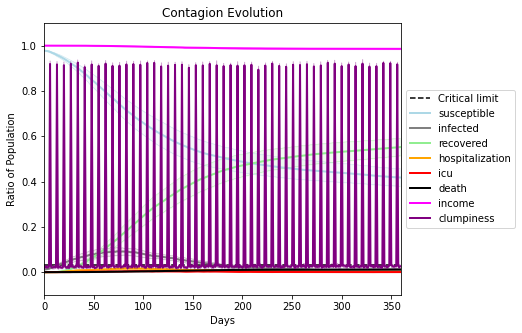

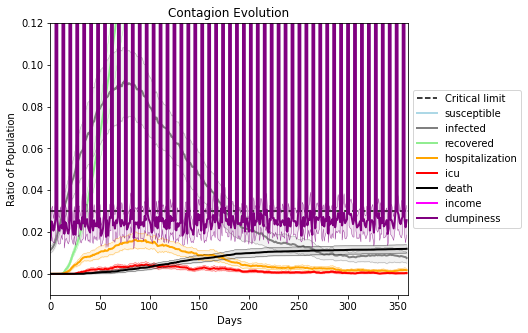

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3196, 7632, 8638, 3875, 4242, 8290, 4527, 9418, 4780, 7235, 6923, 1210, 9817, 7931, 2600, 6954, 7500, 3680, 5666, 8574]
Average similarity between family members is 0.1511318750531571 at temperature 0
Average similarity between family and home is 0.9998552676894363 at temperature -1
Average similarity between students and their classroom is 0.1717998310041761 at temperature 0
Average classroom occupancy is 4.166666666666667 and number classrooms is 72
Average similarity between workers is 0.13497951041077016 at temperature 0
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.20220063302511238 for kids: 0.20645423157896398
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20

avg restaurant similarity 0.0768126482272467
avg restaurant similarity 0.1900197026852549
avg restaurant similarity 0.08730463628507548
avg restaurant similarity 0.3752119739490412
avg restaurant similarity 0.017848575422246164
avg restaurant similarity 0.3298661503868733
avg restaurant similarity 0.02448586361402927
avg restaurant similarity -0.009136014436778682
avg restaurant similarity -0.09111246085502099
avg restaurant similarity 0.16781455773623874
avg restaurant similarity -0.04720315981504168
avg restaurant similarity 0.14902077193518426
avg restaurant similarity -0.1191683642783871
avg restaurant similarity -0.03444701230689984
avg restaurant similarity -0.04457652978955451
avg restaurant similarity 0.21621087308563325
avg restaurant similarity 0.12547030802278902
avg restaurant similarity -0.009920948691837867
avg restaurant similarity 0.16301141519180598
avg restaurant similarity 0.062245742546913715
avg restaurant similarity -0.08358326607505916
avg restaurant similarity 0

avg restaurant similarity 0.03824244675769103
avg restaurant similarity 0.06928437700151864
avg restaurant similarity 0.14701319239313093
avg restaurant similarity -0.0039494057456162385
avg restaurant similarity 0.008836083177242328
avg restaurant similarity 0.0028180440575002277
avg restaurant similarity 0.205689918196036
avg restaurant similarity 0.1309292175089212
avg restaurant similarity 0.10453142539647983
avg restaurant similarity 0.11902310827929148
avg restaurant similarity 0.19020990303976207
avg restaurant similarity -0.021630781121990933
avg restaurant similarity 0.12992524410615708
avg restaurant similarity 0.11038856096535257
avg restaurant similarity -0.12713464828198326
avg restaurant similarity 0.04446644243599705
avg restaurant similarity 0.07753205481251468
avg restaurant similarity 0.1895428141203611
avg restaurant similarity 0.13550031686777617
avg restaurant similarity 0.1842570110483178
avg restaurant similarity -0.1448435656303071
avg restaurant similarity 0.06

avg restaurant similarity 0.1338908807164709
avg restaurant similarity 0.1207871055904229
avg restaurant similarity -0.021275512422236065
avg restaurant similarity -0.03894722093012954
avg restaurant similarity 0.20839424332825668
avg restaurant similarity 0.06466784746877412
avg restaurant similarity 0.05319605318701454
avg restaurant similarity -0.038288091704175645
avg restaurant similarity 0.23787537618422827
avg restaurant similarity 0.06405105050262841
avg restaurant similarity 0.01831256334571624
avg restaurant similarity 0.2367343059743895
avg restaurant similarity 0.12358098239333332
avg restaurant similarity -0.011641279702459885
avg restaurant similarity 0.1748450525036656
avg restaurant similarity 0.04311162919582333
avg restaurant similarity 0.11959114565899691
avg restaurant similarity 0.18570390269240247
avg restaurant similarity -0.11432162973215182
avg restaurant similarity -0.01578313087591976
avg restaurant similarity 0.40946777885965335
avg restaurant similarity 0.1

avg restaurant similarity 0.1928404255265322
avg restaurant similarity -0.07470795335892876
avg restaurant similarity 0.01521559911683271
avg restaurant similarity 0.017231507254276322
avg restaurant similarity 0.13898617047517334
avg restaurant similarity 0.16606956515405674
avg restaurant similarity 0.19200464353755844
avg restaurant similarity 0.09154814165630702
avg restaurant similarity 0.09967191345017638
avg restaurant similarity 0.02270902762935521
avg restaurant similarity 0.14167816064848288
avg restaurant similarity 0.04427805127205154
avg restaurant similarity 0.030616199803075724
avg restaurant similarity 0.11280762442141626
avg restaurant similarity 0.2052521496090779
avg restaurant similarity 0.2506099973638469
avg restaurant similarity 0.0044799876099800295
avg restaurant similarity 0.17805879618002607
avg restaurant similarity 0.24662745806062225
avg restaurant similarity -0.014275319913352055
avg restaurant similarity 0.07039836341520057
avg restaurant similarity 0.24

avg restaurant similarity 0.16067146260044632
avg restaurant similarity 0.032013244095945956
avg restaurant similarity 0.12426503202734217
avg restaurant similarity 0.0861273850906391
avg restaurant similarity 0.20459838907640981
avg restaurant similarity 0.276703780388973
avg restaurant similarity 0.152158674042601
avg restaurant similarity 0.007199317472151294
avg restaurant similarity 0.12686619909158264
avg restaurant similarity 0.07718584088841901
avg restaurant similarity 0.13797843767419088
avg restaurant similarity 0.1419944548149628
avg restaurant similarity 0.20570630890012243
avg restaurant similarity 0.09523866653313644
avg restaurant similarity 0.041067205982973684
avg restaurant similarity 0.10376007031523227
avg restaurant similarity 0.11914281699125533
avg restaurant similarity 0.15668287571228684
avg restaurant similarity 0.09945775082824847
avg restaurant similarity 0.07141735299026622
avg restaurant similarity 0.012764399848385665
avg restaurant similarity -0.1013776

avg restaurant similarity -0.0824575002512736
avg restaurant similarity 0.13518772753627828
avg restaurant similarity 0.14696212607034445
avg restaurant similarity 0.04848683467488869
avg restaurant similarity 0.07326987466091721
avg restaurant similarity 0.1547520825672303
avg restaurant similarity 0.01018677041424069
avg restaurant similarity 0.10066288335145072
avg restaurant similarity 0.156992781792916
avg restaurant similarity 0.004548554078059115
avg restaurant similarity 0.06478172762892899
avg restaurant similarity 0.2363783223136222
avg restaurant similarity 0.2187707371212421
avg restaurant similarity 0.07976225844985058
avg restaurant similarity -0.0795911663038564
avg restaurant similarity 0.05862805721301253
avg restaurant similarity 0.09327059308492583
avg restaurant similarity 0.11797875194690038
avg restaurant similarity 0.04814947242916868
avg restaurant similarity 0.02059830830719393
avg restaurant similarity 0.052007273086546686
avg restaurant similarity 0.188676160

avg restaurant similarity 0.061018642815704516
avg restaurant similarity 0.20310664528641398
avg restaurant similarity 0.06186997339349884
avg restaurant similarity 0.04997938149432755
avg restaurant similarity 0.039077187028106926
avg restaurant similarity 0.16919410519517786
avg restaurant similarity 0.2133446908032666
avg restaurant similarity 0.23198153250706824
avg restaurant similarity -0.03875913673143234
avg restaurant similarity 0.15509143421739624
avg restaurant similarity 0.10123185008464267
avg restaurant similarity 0.04238056844927396
avg restaurant similarity 0.25489933930047814
avg restaurant similarity 0.1176211370900072
avg restaurant similarity 0.06637193149516567
avg restaurant similarity 0.06819887178324291
avg restaurant similarity 0.19713996948305768
avg restaurant similarity 0.14789403801904993
avg restaurant similarity 0.00102392073422259
avg restaurant similarity -0.09166040640971132
avg restaurant similarity 0.0517523220489907
avg restaurant similarity 0.06280

avg restaurant similarity 0.057169885710827394
avg restaurant similarity 0.06708320774810156
avg restaurant similarity 0.11256644582299194
avg restaurant similarity 0.018010846291791543
avg restaurant similarity 0.1976437376099292
avg restaurant similarity 0.09940227308605909
avg restaurant similarity 0.1639306246450323
avg restaurant similarity 0.05405483446707304
avg restaurant similarity 0.08739622709003568
avg restaurant similarity 0.18895748804021367
avg restaurant similarity 0.21867603062109167
avg restaurant similarity 0.19630583566612464
avg restaurant similarity 0.14046244405600578
avg restaurant similarity 0.14330821460975265
avg restaurant similarity 0.032195606585069314
avg restaurant similarity 0.3367900411621947
avg restaurant similarity 0.10441300765378507
avg restaurant similarity 0.1878571895165653
avg restaurant similarity 0.08619352277206925
avg restaurant similarity 0.004589914305210268
avg restaurant similarity -0.04334619355780121
avg restaurant similarity 0.14235

avg restaurant similarity 0.09804343638383406
avg restaurant similarity 0.047135774844166825
avg restaurant similarity -0.08118891500454432
avg restaurant similarity 0.11804551889627786
avg restaurant similarity -0.04476678332602923
avg restaurant similarity -0.06318144037624432
avg restaurant similarity 0.13250508602095595
avg restaurant similarity 0.021993228890329265
avg restaurant similarity -0.09346547976370344
avg restaurant similarity -0.012410403961414806
avg restaurant similarity 0.020184582741390213
avg restaurant similarity 0.03064399272604675
avg restaurant similarity -0.051678948039342795
avg restaurant similarity 0.051674973548926674
avg restaurant similarity 0.05305484708106195
avg restaurant similarity 0.24539883831906226
avg restaurant similarity 0.32273920360379044
avg restaurant similarity 0.2226113774326817
avg restaurant similarity 0.18165352574648844
avg restaurant similarity 0.021017893601404696
avg restaurant similarity -0.10405263717041345
avg restaurant simila

avg restaurant similarity 0.04589553181071537
avg restaurant similarity -0.03242546048685968
avg restaurant similarity 0.14662144366967597
avg restaurant similarity 0.09921418819700391
avg restaurant similarity 0.011850693649428529
avg restaurant similarity 0.08529578166632043
avg restaurant similarity 0.16786678448633194
avg restaurant similarity 0.026546570057403202
avg restaurant similarity 0.20183101824191876
avg restaurant similarity -0.03651581480871028
avg restaurant similarity -0.0017147363638291755
avg restaurant similarity 0.11080286724792811
avg restaurant similarity 0.027630964947944387
avg restaurant similarity 0.08022861235715223
avg restaurant similarity 0.1257787088942021
avg restaurant similarity 0.11752528768683723
avg restaurant similarity 0.0004440189140622053
avg restaurant similarity -0.05094425082818697
avg restaurant similarity -0.1313444129624153
avg restaurant similarity 0.22694432025322142
avg restaurant similarity 0.07073902544535857
avg restaurant similarit

avg restaurant similarity 0.04635036011140466
avg restaurant similarity 0.06355843018202618
avg restaurant similarity 0.028669383118840524
avg restaurant similarity -0.008409171217374996
avg restaurant similarity 0.3709111443992501
avg restaurant similarity 0.1444123897993158
avg restaurant similarity -0.09316504716158203
avg restaurant similarity 0.08832435653859981
avg restaurant similarity -0.12222173104776485
avg restaurant similarity 0.32455837514939445
avg restaurant similarity 0.11983745979768053
avg restaurant similarity 0.11936103015476023
avg restaurant similarity 0.030721529032565295
avg restaurant similarity 0.17937913135892183
avg restaurant similarity 0.08290851515416527
avg restaurant similarity 0.10495834849611625
avg restaurant similarity 0.04232329717708495
avg restaurant similarity 0.22891274329516037
avg restaurant similarity 0.04313796060640129
avg restaurant similarity 0.15511863846443946
avg restaurant similarity 0.20198413165038342
avg restaurant similarity 0.17

avg restaurant similarity 0.23275051119074913
avg restaurant similarity 0.18658941569554777
avg restaurant similarity -0.5852714714788531
avg restaurant similarity 0.2334850794100543
avg restaurant similarity 0.27079413479283215
avg restaurant similarity 0.048830316169611754
avg restaurant similarity 0.35995665396817755
avg restaurant similarity 0.10766302118096413
avg restaurant similarity 0.1369331522789128
avg restaurant similarity -0.016505034846821393
avg restaurant similarity 0.051436094175522924
avg restaurant similarity 0.05155848814529142
avg restaurant similarity 0.1519490351885501
avg restaurant similarity 0.4355016309808167
avg restaurant similarity -0.01995328826307472
avg restaurant similarity 0.039609659160834094
avg restaurant similarity 0.05009197462319293
avg restaurant similarity 0.1720238775906897
avg restaurant similarity 0.2209982176313575
avg restaurant similarity -0.033148985969094005
avg restaurant similarity -0.12913929984088146
avg restaurant similarity -0.02

avg restaurant similarity 0.23810290203248602
avg restaurant similarity 0.241051124819406
avg restaurant similarity 0.16728510795465146
avg restaurant similarity 0.020930131707506135
avg restaurant similarity -0.0018606519350689073
avg restaurant similarity 0.11372598400852334
avg restaurant similarity 0.13047655011408402
avg restaurant similarity -0.11178516511560041
avg restaurant similarity 0.05947010091758978
avg restaurant similarity 0.1868267363319131
avg restaurant similarity -0.05459529509810814
avg restaurant similarity 0.08737897724831221
avg restaurant similarity -0.16250959661385858
avg restaurant similarity -0.005660387933459979
avg restaurant similarity -0.061005170154750266
avg restaurant similarity 0.07311957262581789
avg restaurant similarity 0.1994311441779788
avg restaurant similarity -0.18337233861678673
avg restaurant similarity 0.36882535904174735
avg restaurant similarity -0.13491093861039716
avg restaurant similarity 0.14998691975200523
avg restaurant similarity

avg restaurant similarity 0.15783208557894654
avg restaurant similarity 0.6230454109696524
avg restaurant similarity 0.05724561979247123
avg restaurant similarity 0.2837966242145021
avg restaurant similarity 0.4250181997741259
avg restaurant similarity 0.049842388619263295
avg restaurant similarity 0.09749088935814643
avg restaurant similarity 0.001566950892185781
avg restaurant similarity 0.2688456896049182
avg restaurant similarity -0.016948866439813665
avg restaurant similarity 0.15773828798541067
avg restaurant similarity 0.18910178564537078
avg restaurant similarity 0.11543690318079966
avg restaurant similarity 0.04313972898118064
avg restaurant similarity 0.1941616644121215
avg restaurant similarity 0.03220393914909328
avg restaurant similarity 0.13297477452509254
avg restaurant similarity 0.17927738219125963
avg restaurant similarity 0.1509601923232988
avg restaurant similarity -0.007774458374050108
avg restaurant similarity 0.056818545584070644
avg restaurant similarity 0.20654

avg restaurant similarity -0.01280847091689824
avg restaurant similarity 0.007573766779036383
avg restaurant similarity -0.21709520531687285
avg restaurant similarity -0.06633260875372518
avg restaurant similarity 0.05160749941378497
avg restaurant similarity 0.015701059498951685
avg restaurant similarity 0.031115854484030175
avg restaurant similarity 0.19703047092783585
avg restaurant similarity 0.037740228316024235
avg restaurant similarity 0.34526599951820675
avg restaurant similarity 0.3134254493577583
avg restaurant similarity 0.19528084785637753
avg restaurant similarity -0.25824607475852257
avg restaurant similarity 0.04814726561676952
avg restaurant similarity -0.0612066328167016
avg restaurant similarity 0.18900827300908282
avg restaurant similarity 0.11277455376664788
avg restaurant similarity -0.015808799950045384
avg restaurant similarity -0.03241268360517241
avg restaurant similarity 0.05841295687975058
avg restaurant similarity -0.12469051748055723
avg restaurant similari

avg restaurant similarity -0.03923757384428943
avg restaurant similarity 0.32283514708381233
avg restaurant similarity -0.04523130832683449
avg restaurant similarity 0.00789657419641201
avg restaurant similarity -0.0011393257889275624
avg restaurant similarity 0.044749294987701464
avg restaurant similarity 0.20843542229338968
avg restaurant similarity 0.058982728559555775
avg restaurant similarity 0.10961986102367569
avg restaurant similarity 0.0667222280986693
avg restaurant similarity -0.039764541413234857
avg restaurant similarity 0.275286511630464
avg restaurant similarity 0.12131099944943599
avg restaurant similarity 0.1640382341534236
avg restaurant similarity 0.25054898412114335
avg restaurant similarity 0.12222138489725995
avg restaurant similarity 0.21438762514382964
avg restaurant similarity 0.21506321791307684
avg restaurant similarity 0.2355594484123834
avg restaurant similarity 0.03743397151670352
avg restaurant similarity 0.010790899812382869
avg restaurant similarity 0.1

avg restaurant similarity 0.003921939690289905
avg restaurant similarity 0.11382858891885674
avg restaurant similarity 0.020780111688261358
avg restaurant similarity 0.46309272126772677
avg restaurant similarity 0.12987888814657822
avg restaurant similarity -0.026872390801374456
avg restaurant similarity 0.16603388985842646
avg restaurant similarity 0.10108693981866748
avg restaurant similarity 0.16688600853891922
avg restaurant similarity 0.2157281814333248
avg restaurant similarity 0.09776317027112096
avg restaurant similarity 0.006758058968285935
avg restaurant similarity 0.07672144147232267
avg restaurant similarity 0.0693264996896701
avg restaurant similarity 0.19309417587240396
avg restaurant similarity -0.024668983331293956
avg restaurant similarity -0.007867204840911982
avg restaurant similarity 0.04939484999876255
avg restaurant similarity 0.21946727745085232
avg restaurant similarity 0.004758059589051303
avg restaurant similarity 0.21602335720681326
avg restaurant similarity 

avg restaurant similarity 0.03612951159620685
avg restaurant similarity 0.053448988594536874
avg restaurant similarity 0.33503326461525185
avg restaurant similarity 0.1140123579114444
avg restaurant similarity 0.09948868683582357
avg restaurant similarity 0.12195883636802914
avg restaurant similarity 0.08670699958905481
avg restaurant similarity 0.0391531122506784
avg restaurant similarity 0.12958725270224106
avg restaurant similarity 0.10523199370977449
avg restaurant similarity -0.0031261951215992142
avg restaurant similarity -0.02442679459068284
avg restaurant similarity 0.02310942899745429
avg restaurant similarity 0.11124524321853269
avg restaurant similarity 0.09974454636112019
avg restaurant similarity 0.1982412729495615
avg restaurant similarity -0.019194809266131978
avg restaurant similarity 0.1028599257803992
avg restaurant similarity -0.043487860247298074
avg restaurant similarity -0.007872219327211204
avg restaurant similarity 0.18575724993907522
avg restaurant similarity 0

avg restaurant similarity 0.11040814031022943
avg restaurant similarity 0.17098014254251334
avg restaurant similarity 0.18076193018151168
avg restaurant similarity 0.07359990405080724
avg restaurant similarity 0.2688621716458082
avg restaurant similarity 0.22884195686459144
avg restaurant similarity 0.09306381030200157
avg restaurant similarity 0.02854439183589893
avg restaurant similarity -0.305214030392154
avg restaurant similarity 0.16976739020895873
avg restaurant similarity 0.2109420922320225
avg restaurant similarity -0.030258462563604205
avg restaurant similarity 0.15741743478061782
avg restaurant similarity 0.06145873555748184
avg restaurant similarity 0.05499817144635433
avg restaurant similarity 0.2647904821752324
avg restaurant similarity 0.20079000344496487
avg restaurant similarity -0.12534678385159384
avg restaurant similarity 0.005698319267353903
avg restaurant similarity 0.07643623310550185
avg restaurant similarity 0.08718963513968353
avg restaurant similarity 0.188600

avg restaurant similarity 0.18024560733356537
avg restaurant similarity 0.19499151176431273
avg restaurant similarity 0.03833624573634162
avg restaurant similarity 0.10126496836795547
avg restaurant similarity 0.1932679972689805
avg restaurant similarity 0.06746243310694425
avg restaurant similarity 0.1403409634853723
avg restaurant similarity -0.030402355772568796
avg restaurant similarity 0.11991779154368798
avg restaurant similarity 0.10148706475526091
avg restaurant similarity 0.06563846502919335
avg restaurant similarity 0.20619675462198964
avg restaurant similarity 0.23136764422723366
avg restaurant similarity 0.1491481575480727
avg restaurant similarity 0.19801174939741248
avg restaurant similarity 0.12033524607551452
avg restaurant similarity 0.3934539173163011
avg restaurant similarity 0.06621058552185577
avg restaurant similarity 0.13146760060939083
avg restaurant similarity 0.2547492077757434
avg restaurant similarity 0.06119346232260506
avg restaurant similarity 0.062854710

avg restaurant similarity 0.3117846767290681
avg restaurant similarity 0.1992077864485987
avg restaurant similarity -0.20950230007483508
avg restaurant similarity 0.23141664369682002
avg restaurant similarity 0.16922854217175506
avg restaurant similarity 0.2701025814356121
avg restaurant similarity 0.11380252499569025
avg restaurant similarity 0.24683310695906088
avg restaurant similarity -0.012619030271899537
avg restaurant similarity 0.041766379863256736
avg restaurant similarity 0.41008134879153685
avg restaurant similarity -0.05087335814019848
avg restaurant similarity 0.20029547870081513
avg restaurant similarity -0.016615499975953033
avg restaurant similarity -0.11083107613901459
avg restaurant similarity -0.022748537303165395
avg restaurant similarity 0.05791384904694259
avg restaurant similarity 0.057367637890275644
avg restaurant similarity 0.13509955699376594
avg restaurant similarity 0.05121617365680662
avg restaurant similarity -0.01424652982148729
avg restaurant similarity

avg restaurant similarity 0.07252890513454885
avg restaurant similarity 0.17782987117813373
avg restaurant similarity -0.04872706152669216
avg restaurant similarity 0.5205244897872688
avg restaurant similarity 0.2517929220652077
avg restaurant similarity 0.4718143312209084
avg restaurant similarity -0.08531180988499933
avg restaurant similarity 0.15036645050474778
avg restaurant similarity -0.21311000605371125
avg restaurant similarity 0.2096513888133944
avg restaurant similarity 0.12512980075806213
avg restaurant similarity 0.06688886069032385
avg restaurant similarity 0.1835191471970348
avg restaurant similarity 0.23115142887248458
avg restaurant similarity 0.12149078661763457
avg restaurant similarity -0.01648590644923616
avg restaurant similarity 0.13472200349468563
avg restaurant similarity 0.20005355833657554
avg restaurant similarity 0.10467121604479873
avg restaurant similarity -0.12360110507283005
avg restaurant similarity 0.08450030342156196
avg restaurant similarity 0.006545

avg restaurant similarity -0.09116306082299315
avg restaurant similarity 0.10815561678325127
avg restaurant similarity -0.007694821999966865
avg restaurant similarity -0.05914225756690965
avg restaurant similarity -0.04400291352439306
avg restaurant similarity 0.1917359145270381
avg restaurant similarity 0.32490613591611855
avg restaurant similarity 0.07186610181417781
avg restaurant similarity 0.1265740401619098
avg restaurant similarity 0.01723677431333608
avg restaurant similarity 0.3977096692020321
avg restaurant similarity 0.09510351773615565
avg restaurant similarity 0.029889357570761943
avg restaurant similarity 0.1259330206830709
avg restaurant similarity 0.5525795645646141
avg restaurant similarity -0.03690112950823136
avg restaurant similarity -0.06503355703869558
avg restaurant similarity 0.12367927045828647
avg restaurant similarity 0.08844515627084129
avg restaurant similarity 0.017661975431183405
avg restaurant similarity 0.01802722186115793
avg restaurant similarity 0.18

avg restaurant similarity 0.032348754385689495
avg restaurant similarity 0.10478945815597594
avg restaurant similarity -0.05966609552829459
avg restaurant similarity 0.2959438674510161
avg restaurant similarity 0.11605110557880977
avg restaurant similarity 0.07933738483874062
avg restaurant similarity -0.08385369117314351
avg restaurant similarity 0.04555713024615075
avg restaurant similarity 0.06861536636872502
avg restaurant similarity -0.04213400857751637
avg restaurant similarity 0.15508003305754206
avg restaurant similarity -0.09185938620337239
avg restaurant similarity 0.1388397084070952
avg restaurant similarity -0.041919395146650405
avg restaurant similarity 0.08765900798908004
avg restaurant similarity 0.16511829105840903
avg restaurant similarity -0.06236151994313236
avg restaurant similarity 0.05052134544464692
avg restaurant similarity 0.14747789555434812
avg restaurant similarity 0.210133191244531
avg restaurant similarity -0.09316959498550331
avg restaurant similarity 0.2

avg restaurant similarity 0.08609129133233293
avg restaurant similarity -0.1723868624190926
avg restaurant similarity -0.012679986920488027
avg restaurant similarity 0.08905690465214458
avg restaurant similarity 0.17246907860522273
avg restaurant similarity 0.10618903389319835
avg restaurant similarity 0.0059230701622544546
avg restaurant similarity 0.17369123269323838
avg restaurant similarity -0.02258131667434934
avg restaurant similarity -0.027890386916519284
avg restaurant similarity -0.0882364404306199
avg restaurant similarity -0.05695785720732383
avg restaurant similarity 0.16672535558948218
avg restaurant similarity 0.10441305449253413
avg restaurant similarity 0.2709191096138553
avg restaurant similarity 0.1061367012133169
avg restaurant similarity 0.052957568147261734
avg restaurant similarity 0.10066588114518102
avg restaurant similarity 0.1712628992507024
avg restaurant similarity -0.16195423133794706
avg restaurant similarity 0.22732668958287608
avg restaurant similarity 0

avg restaurant similarity -0.1119134216592911
avg restaurant similarity 0.14822526898346755
avg restaurant similarity 0.2855586166587505
avg restaurant similarity -0.027424544022724363
avg restaurant similarity 0.05648509024314343
avg restaurant similarity -0.11680212030689523
avg restaurant similarity -0.04936867400777157
avg restaurant similarity 0.1145532827742193
avg restaurant similarity 0.2529238119283012
avg restaurant similarity 0.12403242932868824
avg restaurant similarity 0.22808183873122648
avg restaurant similarity -0.2100402702614806
avg restaurant similarity 0.032129393297490524
avg restaurant similarity 0.023663271567923423
avg restaurant similarity 0.11262144859159917
avg restaurant similarity 0.07816577537511506
avg restaurant similarity 0.024788162124347868
avg restaurant similarity 0.16643223926914974
avg restaurant similarity 0.08139838329490544
avg restaurant similarity 0.02710377892142084
avg restaurant similarity -0.004463374788999333
avg restaurant similarity -0

avg restaurant similarity -0.0376888172945528
avg restaurant similarity 0.26869355327534666
avg restaurant similarity 0.11622581449633888
avg restaurant similarity 0.28788735455004816
avg restaurant similarity 0.20481598268560597
avg restaurant similarity 0.07542329360368069
avg restaurant similarity -0.002391629963678118
avg restaurant similarity 0.23365980455483082
avg restaurant similarity 0.06394193824036691
avg restaurant similarity 0.035521472564993224
avg restaurant similarity 0.10482516534068553
avg restaurant similarity 0.06792390523549903
avg restaurant similarity 0.1408827714497179
avg restaurant similarity -0.14946262885319408
avg restaurant similarity 0.21974521840417277
avg restaurant similarity 0.023425353170195184
avg restaurant similarity 0.030223499847203815
avg restaurant similarity -0.023503987469794804
avg restaurant similarity 0.11927041924061771
avg restaurant similarity 0.2913464025522554
avg restaurant similarity 0.11112013599847152
avg restaurant similarity 0.

avg restaurant similarity -0.028451922012026707
avg restaurant similarity -0.13268170312102362
avg restaurant similarity 0.08312814086527727
avg restaurant similarity 0.08256477800836157
avg restaurant similarity -0.03223729824950394
avg restaurant similarity 0.21932776414191926
avg restaurant similarity 0.09396818674843857
avg restaurant similarity -0.039200682126721585
avg restaurant similarity -0.09046223830287208
avg restaurant similarity 0.021706544459903426
avg restaurant similarity 0.22134378690448073
avg restaurant similarity -0.009814088773427173
avg restaurant similarity 0.11867296186524386
avg restaurant similarity 0.17979525731579657
avg restaurant similarity 0.0909991401814065
avg restaurant similarity -0.011246664808877373
avg restaurant similarity 0.1675745606991305
avg restaurant similarity 0.4369429341619117
avg restaurant similarity 0.21017067896515784
avg restaurant similarity 0.1609440403991382
avg restaurant similarity 0.09338970336346376
avg restaurant similarity 

avg restaurant similarity 0.4782682757884219
avg restaurant similarity 0.11324612889775694
avg restaurant similarity 0.021442913369405535
avg restaurant similarity 0.08000602272313624
avg restaurant similarity -0.03968455360691309
avg restaurant similarity -0.1764517136263346
avg restaurant similarity 0.1755312788796797
avg restaurant similarity 0.19870877664581715
avg restaurant similarity 0.06469911962597863
avg restaurant similarity 0.04140575488414935
avg restaurant similarity -0.02548681286960092
avg restaurant similarity 0.1014215867618127
avg restaurant similarity 0.015463272387687244
avg restaurant similarity 0.05712755759290535
avg restaurant similarity 0.18473807946716497
avg restaurant similarity 0.3320087960116379
avg restaurant similarity 0.07475730447019621
avg restaurant similarity -0.022721063093143676
avg restaurant similarity 0.13373992910055738
avg restaurant similarity 0.25760994004515214
avg restaurant similarity 0.13439266771825803
avg restaurant similarity 0.0646

avg restaurant similarity -0.09157213370741411
avg restaurant similarity 0.06393666899617179
avg restaurant similarity 0.030365877203382186
avg restaurant similarity 0.25607596505550667
avg restaurant similarity -0.07240962023492045
avg restaurant similarity 0.1868876954793525
avg restaurant similarity 0.13479469712922543
avg restaurant similarity 0.14777601777135885
avg restaurant similarity 0.09734794562242606
avg restaurant similarity -0.046872394607376605
avg restaurant similarity 0.1356296627300135
avg restaurant similarity 0.19122753927083683
avg restaurant similarity 0.12957098784519896
avg restaurant similarity 0.3244391160487906
avg restaurant similarity 0.04547630479384874
avg restaurant similarity 0.05421412750065342
avg restaurant similarity 0.0902569938116307
avg restaurant similarity 0.13529427180908526
avg restaurant similarity 0.15124393357634988
avg restaurant similarity 0.016496096423027216
avg restaurant similarity 0.24724287502842932
avg restaurant similarity -0.115

avg restaurant similarity 0.17704661507343156
avg restaurant similarity 0.219914819233526
avg restaurant similarity 0.2902675494301632
avg restaurant similarity 0.1301358300785338
avg restaurant similarity 0.22777324587957992
avg restaurant similarity 0.1511673155037376
avg restaurant similarity 0.06505110270876954
avg restaurant similarity 0.07003932410534576
avg restaurant similarity 0.017572503667764743
avg restaurant similarity 0.1123950221715587
avg restaurant similarity -0.04560692561504531
avg restaurant similarity 0.19480639809549158
avg restaurant similarity -0.0811276516628958
avg restaurant similarity 0.16831648996279502
avg restaurant similarity 0.15695101897676428
avg restaurant similarity 0.18948114154526974
avg restaurant similarity 0.26838457379338865
avg restaurant similarity -0.10563682372703159
avg restaurant similarity -0.18521965607156163
avg restaurant similarity -0.13803919201568635
avg restaurant similarity 0.16003359285145868
avg restaurant similarity -0.006584

avg restaurant similarity 0.2338751554530976
avg restaurant similarity 0.17317137051301637
avg restaurant similarity 0.29608699488725115
avg restaurant similarity 0.23109857844178536
avg restaurant similarity 0.1906304812009129
avg restaurant similarity 0.05224937410181265
avg restaurant similarity 0.2665933725804066
avg restaurant similarity 0.22474829328403198
avg restaurant similarity 0.12953788427734222
avg restaurant similarity -0.11649135071777476
avg restaurant similarity 0.16687199207423667
avg restaurant similarity 0.15412305872430448
avg restaurant similarity 0.24834805251304082
avg restaurant similarity -0.21200912507959171
avg restaurant similarity -0.03368972947799326
avg restaurant similarity 0.19446641995830616
avg restaurant similarity -0.005636722891057738
avg restaurant similarity 0.1212559672056258
avg restaurant similarity 0.029487519483505142
avg restaurant similarity 0.014097592163441239
avg restaurant similarity 0.27884935008402806
avg restaurant similarity 0.165

avg restaurant similarity -0.02653560834833964
avg restaurant similarity -0.010013190630127317
avg restaurant similarity 0.028939055184149687
avg restaurant similarity 0.1513445002475951
avg restaurant similarity 0.02760109565007361
avg restaurant similarity 0.033687315882811326
avg restaurant similarity -0.005551097385691844
avg restaurant similarity 0.08391054288374086
avg restaurant similarity 0.005471120138802567
avg restaurant similarity -0.12336329664361914
avg restaurant similarity 0.04120387350321323
avg restaurant similarity -0.0471388584035427
avg restaurant similarity -0.06249020107951553
avg restaurant similarity -0.21222685687339485
avg restaurant similarity -0.0353240301528401
avg restaurant similarity 0.01754953484563192
avg restaurant similarity -0.008772202889429558
avg restaurant similarity -0.05196357712073103
avg restaurant similarity 0.19324442164371597
avg restaurant similarity 0.032204396768287936
avg restaurant similarity 0.11604584278176881
avg restaurant simil

avg restaurant similarity -0.052369341187802364
avg restaurant similarity 0.1514835850765294
avg restaurant similarity 0.09170114256177697
avg restaurant similarity -0.06125367967764133
avg restaurant similarity 0.23554202806751906
avg restaurant similarity 0.008396411751168426
avg restaurant similarity 0.07424449205410484
avg restaurant similarity 0.1287276921071872
avg restaurant similarity -0.17852460156731845
avg restaurant similarity -0.07928894828365796
avg restaurant similarity -0.003102772490944869
avg restaurant similarity 0.03474712464291688
avg restaurant similarity -0.11208203017298582
avg restaurant similarity 0.13996080430036303
avg restaurant similarity 0.05241049771673194
avg restaurant similarity -0.10707473403082547
avg restaurant similarity -0.027085531033772575
avg restaurant similarity -0.00775094109719775
avg restaurant similarity 0.0784333976705982
avg restaurant similarity -0.18006631311878085
avg restaurant similarity 0.157808865239394
avg restaurant similarity

avg restaurant similarity 0.16503322419245467
avg restaurant similarity -0.029658921487513444
avg restaurant similarity -0.036099710957960836
avg restaurant similarity 0.14928735332100757
avg restaurant similarity 0.03855777952195757
avg restaurant similarity 0.14536644008933955
avg restaurant similarity 0.15758015557960545
avg restaurant similarity 0.0100556692506028
avg restaurant similarity -0.18656886830680958
avg restaurant similarity 0.07939989817894544
avg restaurant similarity 0.12638564758657359
avg restaurant similarity 0.4563322471779184
avg restaurant similarity -0.019301256946591086
avg restaurant similarity 0.006858980424090849
avg restaurant similarity 0.08862840832241044
avg restaurant similarity -0.06259482989965477
avg restaurant similarity -0.09194688671408224
avg restaurant similarity 0.37502913977439156
avg restaurant similarity 0.1055658397733894
avg restaurant similarity 0.04878357467013959
avg restaurant similarity 0.08542651883583739
avg restaurant similarity 0

avg restaurant similarity 0.08367891764027151
avg restaurant similarity 0.039270802457959136
avg restaurant similarity 0.25536243501518185
avg restaurant similarity 0.11122514002441354
avg restaurant similarity -0.08802727796640458
avg restaurant similarity -0.1142122813511916
avg restaurant similarity 0.0005209092275278576
avg restaurant similarity 0.2446395508749737
avg restaurant similarity 0.08317485551617258
avg restaurant similarity 0.05437743995106604
avg restaurant similarity 0.26611834085600816
avg restaurant similarity 0.17851591905801623
avg restaurant similarity 0.04291805338468121
avg restaurant similarity 0.10432000155962261
avg restaurant similarity 0.08258578251335551
avg restaurant similarity 6.19227589024977e-05
avg restaurant similarity 0.04367376559374248
avg restaurant similarity 0.20970330635773815
avg restaurant similarity 0.2566174638376403
avg restaurant similarity -0.2657400448655404
avg restaurant similarity 0.07807361532597659
avg restaurant similarity -0.09

avg restaurant similarity 0.2599559630163732
avg restaurant similarity 0.07538409286328306
avg restaurant similarity -0.02687304196038971
avg restaurant similarity 0.11175819924543988
avg restaurant similarity -0.0347845013906811
avg restaurant similarity 0.07036272798706973
avg restaurant similarity -0.06569742126531815
avg restaurant similarity -0.05023617216175527
avg restaurant similarity 0.1391509695016819
avg restaurant similarity 0.13286808170599174
avg restaurant similarity 0.07739100099307215
avg restaurant similarity 0.09306602553987942
avg restaurant similarity 0.07147896140134499
avg restaurant similarity -0.3225536767183414
avg restaurant similarity 0.17877391078492552
avg restaurant similarity -0.0027252880418649596
avg restaurant similarity 0.01221260360988008
avg restaurant similarity -0.04786037435604022
avg restaurant similarity 0.40712131550562974
avg restaurant similarity 0.08331424889947597
avg restaurant similarity -0.11904216016448745
avg restaurant similarity 0.

avg restaurant similarity 0.09069133582296564
avg restaurant similarity 0.029099929007991313
avg restaurant similarity 0.3335847467375069
avg restaurant similarity 0.06289376586609019
avg restaurant similarity 0.14281174123217952
avg restaurant similarity 0.11103276827792832
avg restaurant similarity -0.008596729313798339
avg restaurant similarity 0.05224712557684837
avg restaurant similarity -0.23316810410641664
avg restaurant similarity -0.18274311230668605
avg restaurant similarity 0.23512540287499809
avg restaurant similarity 0.029371614106063405
avg restaurant similarity -0.0770092555679208
avg restaurant similarity 0.13212241326127103
avg restaurant similarity -0.007433579683197938
avg restaurant similarity 0.1263440132699568
avg restaurant similarity 0.0785281940189552
avg restaurant similarity 0.0025050609569986482
avg restaurant similarity 0.040772781065458896
avg restaurant similarity 0.1828734063838129
avg restaurant similarity 0.12522617515336618
avg restaurant similarity 0

avg restaurant similarity 0.1626266198437236
avg restaurant similarity 0.2051938197378114
avg restaurant similarity -0.04145419829939963
avg restaurant similarity -0.03726610729786451
avg restaurant similarity 0.18230912787107312
avg restaurant similarity -0.10759203347880356
avg restaurant similarity 0.04827950052116432
avg restaurant similarity -0.011892412224678814
avg restaurant similarity 0.13798904391089817
avg restaurant similarity 0.1530254742981288
avg restaurant similarity 0.15566613636755638
avg restaurant similarity 0.1546927584498585
avg restaurant similarity -0.05655212116345801
avg restaurant similarity 0.06846246663138349
avg restaurant similarity 0.05627203484897964
avg restaurant similarity -0.006595322558490242
avg restaurant similarity 0.1756727811583682
avg restaurant similarity 0.09299011414889126
avg restaurant similarity 0.16311436060521503
avg restaurant similarity 0.313556133245596
avg restaurant similarity 0.13959973530784187
avg restaurant similarity 0.08027

avg restaurant similarity -0.075763840138194
avg restaurant similarity 0.20535617035588796
avg restaurant similarity -0.0574889076838815
avg restaurant similarity 0.1600111801706813
avg restaurant similarity 0.23159412045605518
avg restaurant similarity 0.12770958939102556
avg restaurant similarity 0.20450560016260466
avg restaurant similarity 0.10879196079407687
avg restaurant similarity 0.12728000799409664
avg restaurant similarity -0.09490991308639535
avg restaurant similarity 0.018495151833830315
avg restaurant similarity 0.12249156000876835
avg restaurant similarity -0.20856233137778446
avg restaurant similarity 0.011026963462276924
avg restaurant similarity 0.17563950705987705
avg restaurant similarity 0.2422698217382854
avg restaurant similarity 0.2651812594849271
avg restaurant similarity 0.10857391642420636
avg restaurant similarity 0.13199035875546997
avg restaurant similarity -0.0027012054113611517
avg restaurant similarity 0.10787922144835058
avg restaurant similarity -0.00

(<function dict.items>, <function dict.items>, <function dict.items>)

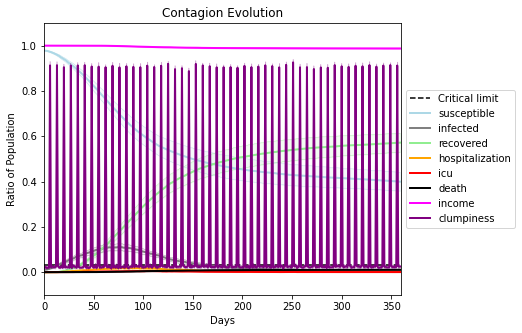

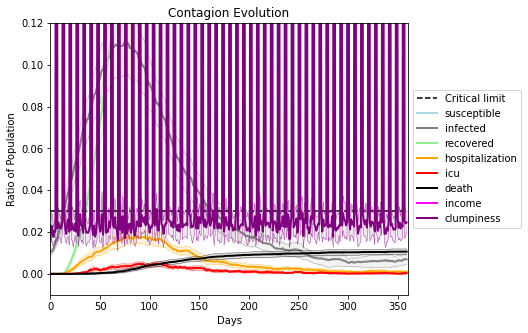

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5768, 7384, 6143, 1641, 9382, 5776, 4029, 8661, 1989, 8504, 4967, 6338, 2786, 987, 1812, 306, 6592, 7837, 4994, 6316]
Average similarity between family members is 0.10345612727010045 at temperature 0.33
Average similarity between family and home is 0.999872878254677 at temperature -1
Average similarity between students and their classroom is 0.1382328439310727 at temperature 0.33
Average classroom occupancy is 3.927536231884058 and number classrooms is 69
Average similarity between workers is 0.11756517553439831 at temperature 0.33
Average office occupancy is 3.375 and number offices is 200
Average friend similarity for adults: 0.1719015160032556 for kids: 0.15918107314288207
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuild

avg restaurant similarity 0.0049053911903927825
avg restaurant similarity 0.16837520463731662
avg restaurant similarity -0.0329540692364262
avg restaurant similarity 0.049565026102736366
avg restaurant similarity 0.0003718754760044206
avg restaurant similarity 0.07544217482418898
avg restaurant similarity 0.2039128933211513
avg restaurant similarity 0.12639723303429196
avg restaurant similarity 0.07921182851506924
avg restaurant similarity 0.30175598791642305
avg restaurant similarity 0.04386716965539345
avg restaurant similarity 0.14721309172670793
avg restaurant similarity -0.03827334593017187
avg restaurant similarity 0.1857451509180268
avg restaurant similarity 0.05242148976711002
avg restaurant similarity -0.034680314217909916
avg restaurant similarity 0.07743954405420639
avg restaurant similarity 0.03392141600656638
avg restaurant similarity 0.3506031214749653
avg restaurant similarity 0.03759647659737189
avg restaurant similarity 0.05054475315672701
avg restaurant similarity 0.0

avg restaurant similarity -0.06755206209535142
avg restaurant similarity 0.1361339494084242
avg restaurant similarity -0.05914764773221872
avg restaurant similarity 0.009842056915450929
avg restaurant similarity -0.07789039965350437
avg restaurant similarity 0.018744280330662833
avg restaurant similarity -0.12774194085415505
avg restaurant similarity 0.1725383214073628
avg restaurant similarity 0.11137415192814071
avg restaurant similarity 0.08654486945331442
avg restaurant similarity -0.05155276335821855
avg restaurant similarity 0.07468227356133741
avg restaurant similarity 0.06241176832255102
avg restaurant similarity 0.02886285092460664
avg restaurant similarity 0.12844474803689587
avg restaurant similarity 0.11621334732988413
avg restaurant similarity 0.15395288469020038
avg restaurant similarity 0.2800360752301969
avg restaurant similarity 0.10230911597550384
avg restaurant similarity 0.14505080273531792
avg restaurant similarity 0.14645800323092056
avg restaurant similarity 0.03

avg restaurant similarity -0.06312137499540514
avg restaurant similarity -0.35604269029772123
avg restaurant similarity 0.01608177559411677
avg restaurant similarity 0.06250977772026356
avg restaurant similarity 0.18835244235223683
avg restaurant similarity -0.04379531014218777
avg restaurant similarity 0.31435923890058637
avg restaurant similarity 0.09355379846046212
avg restaurant similarity 0.28466962646535543
avg restaurant similarity 0.10940402098137218
avg restaurant similarity -0.014363118001797036
avg restaurant similarity 0.009572240018851421
avg restaurant similarity 0.05300151175083883
avg restaurant similarity 0.3226225455021623
avg restaurant similarity -0.051071706910254255
avg restaurant similarity -0.15805014439907739
avg restaurant similarity 0.23456238992764247
avg restaurant similarity 0.015831957308850945
avg restaurant similarity 0.08449994539035831
avg restaurant similarity 0.1621953576353408
avg restaurant similarity 0.06618050745890465
avg restaurant similarity 

avg restaurant similarity 0.13196233220939388
avg restaurant similarity 0.01859673737691979
avg restaurant similarity -0.03849934414464576
avg restaurant similarity 0.11071970083338598
avg restaurant similarity 0.03353770841240733
avg restaurant similarity 0.0864355072767122
avg restaurant similarity 0.1134134076805478
avg restaurant similarity 0.1440717578988472
avg restaurant similarity 0.09215568573993199
avg restaurant similarity -0.1335506767474195
avg restaurant similarity 0.007625055315564252
avg restaurant similarity 0.0948496293880137
avg restaurant similarity 0.025224537154699456
avg restaurant similarity 0.11001314140828292
avg restaurant similarity 0.19518859919708964
avg restaurant similarity 0.00793001398128353
avg restaurant similarity 0.09062328638129191
avg restaurant similarity 0.18839303288673878
avg restaurant similarity 0.08662251811808241
avg restaurant similarity -0.0068203784044023
avg restaurant similarity 0.1630027765401428
avg restaurant similarity 0.06173261

avg restaurant similarity 0.014932732452491073
avg restaurant similarity 0.004825930988682596
avg restaurant similarity 0.06793576911912083
avg restaurant similarity 0.18617862678004413
avg restaurant similarity 0.22474699085445352
avg restaurant similarity 0.12349294963197921
avg restaurant similarity 0.037942924181050344
avg restaurant similarity 0.06536286680367656
avg restaurant similarity 0.19746949241428186
avg restaurant similarity 0.05701104119268609
avg restaurant similarity 0.09471915934933028
avg restaurant similarity 0.18863023475994714
avg restaurant similarity 0.03343998892064934
avg restaurant similarity 0.02815759672876461
avg restaurant similarity 0.03838279534991808
avg restaurant similarity 0.014061499241321987
avg restaurant similarity 0.09185228036825206
avg restaurant similarity 0.2292891031248335
avg restaurant similarity 0.09177881000938709
avg restaurant similarity -0.12385654054478741
avg restaurant similarity 0.14206118756296454
avg restaurant similarity 0.10

avg restaurant similarity 0.20958932454203402
avg restaurant similarity -0.0015545320511682614
avg restaurant similarity 0.23107875419217302
avg restaurant similarity 0.06397407018820352
avg restaurant similarity 0.18927916200165315
avg restaurant similarity 0.10312315082992561
avg restaurant similarity 0.15702008555549116
avg restaurant similarity -0.013287111613943484
avg restaurant similarity 0.016867790691029214
avg restaurant similarity 0.1924164864831672
avg restaurant similarity 0.25381758619518874
avg restaurant similarity 0.1337937354642211
avg restaurant similarity -0.0025704056911991916
avg restaurant similarity -0.03939857701101415
avg restaurant similarity 0.11489536623792374
avg restaurant similarity 0.07926943442558661
avg restaurant similarity -0.12256220399702224
avg restaurant similarity -0.05087005454241003
avg restaurant similarity 0.2803505354619469
avg restaurant similarity 0.05502220396576342
avg restaurant similarity -0.0014329152675333634
avg restaurant similar

avg restaurant similarity 0.15172641007560442
avg restaurant similarity 0.03369185050355144
avg restaurant similarity 0.10274174361180602
avg restaurant similarity 0.12270569173606316
avg restaurant similarity 0.05624206595320896
avg restaurant similarity -0.16991326848719715
avg restaurant similarity 0.1183835599229186
avg restaurant similarity 0.08454737215359674
avg restaurant similarity 0.015707077354754073
avg restaurant similarity -0.05688201485712044
avg restaurant similarity 0.00859432982986976
avg restaurant similarity 0.10334253180476018
avg restaurant similarity 0.02228931749366933
avg restaurant similarity 0.22316691184390525
avg restaurant similarity 0.19568947352987057
avg restaurant similarity 0.03758321369841044
avg restaurant similarity 0.15610592867372824
avg restaurant similarity -0.021756734832498122
avg restaurant similarity 0.06338950939822197
avg restaurant similarity 0.17622952370955683
avg restaurant similarity 0.04918729091040669
avg restaurant similarity 0.12

avg restaurant similarity 0.10227385342167453
avg restaurant similarity 0.2588141633422847
avg restaurant similarity -0.002712197821453897
avg restaurant similarity 0.1909425608983727
avg restaurant similarity -0.02707574756789616
avg restaurant similarity 0.10888209623128711
avg restaurant similarity 0.16339920736088465
avg restaurant similarity 0.043380319823588705
avg restaurant similarity 0.07169516893915577
avg restaurant similarity 0.12186000326210132
avg restaurant similarity 0.1637428283713556
avg restaurant similarity 0.11719060681323322
avg restaurant similarity 0.0861087370959504
avg restaurant similarity 0.14673781292887958
avg restaurant similarity -0.009600607157802858
avg restaurant similarity -0.020450563184473795
avg restaurant similarity 0.1372711736918148
avg restaurant similarity 0.16447385713117016
avg restaurant similarity 0.03807327186136898
avg restaurant similarity 0.23366280339850387
avg restaurant similarity -0.016194262564859282
avg restaurant similarity 0.0

avg restaurant similarity -0.020687020579180614
avg restaurant similarity -0.02844369630941595
avg restaurant similarity 0.01141537247373763
avg restaurant similarity 0.06642447045033359
avg restaurant similarity 0.08225445847458811
avg restaurant similarity 0.17166584025140094
avg restaurant similarity 0.08016708933090161
avg restaurant similarity 0.14312222861151427
avg restaurant similarity 0.11243849655146254
avg restaurant similarity 0.07454606684481103
avg restaurant similarity -0.06160631489418219
avg restaurant similarity -0.267123217107305
avg restaurant similarity -0.011464318793434299
avg restaurant similarity 0.05305075269047249
avg restaurant similarity 0.29475478555540013
avg restaurant similarity 0.17155065321462554
avg restaurant similarity 0.13119418883061343
avg restaurant similarity -0.2061356363010859
avg restaurant similarity 0.16976612165044536
avg restaurant similarity 0.04553955692709841
avg restaurant similarity 0.030146454036299092
avg restaurant similarity 0.

avg restaurant similarity 0.022296369627685764
avg restaurant similarity 0.05608447979410122
avg restaurant similarity 0.1415950592353312
avg restaurant similarity 0.042419047112880505
avg restaurant similarity -0.06737233776110062
avg restaurant similarity 0.10039605392897315
avg restaurant similarity -0.04566780130638884
avg restaurant similarity 0.059620475670634776
avg restaurant similarity -0.050526006483863906
avg restaurant similarity -0.06289839867022293
avg restaurant similarity -0.054362291946496506
avg restaurant similarity 0.07674945883227335
avg restaurant similarity 0.026718896364823497
avg restaurant similarity -0.025474141468420048
avg restaurant similarity 0.07391860070773348
avg restaurant similarity 0.02875605577487973
avg restaurant similarity -0.1006705376471
avg restaurant similarity 0.10153779477134883
avg restaurant similarity -0.07545648607494922
avg restaurant similarity 0.15669511980272693
avg restaurant similarity -0.09074381309827521
avg restaurant similari

avg restaurant similarity -0.06609123698277582
avg restaurant similarity 0.06782238896445318
avg restaurant similarity 0.007220657742233756
avg restaurant similarity 0.12995663572272162
avg restaurant similarity 0.008776781815892691
avg restaurant similarity -0.10639191879218471
avg restaurant similarity 0.29046824045246167
avg restaurant similarity 0.1294878987011035
avg restaurant similarity -0.07517450621274276
avg restaurant similarity 0.017292299843537976
avg restaurant similarity 0.11983289470224151
avg restaurant similarity 0.10114994862962592
avg restaurant similarity 0.09648993842443161
avg restaurant similarity 0.01127682565113878
avg restaurant similarity 0.20069606810121973
avg restaurant similarity 0.09254649060988157
avg restaurant similarity 0.0846733479492747
avg restaurant similarity 0.04169059714137974
avg restaurant similarity 0.044899524933156104
avg restaurant similarity -0.06359086543236574
avg restaurant similarity 0.0655165052579508
avg restaurant similarity 0.0

avg restaurant similarity -0.019894772872018546
avg restaurant similarity 0.12394980527903995
avg restaurant similarity -0.09823721683964992
avg restaurant similarity 0.12268426383458893
avg restaurant similarity 0.24590074730155947
avg restaurant similarity 0.19447536545497227
avg restaurant similarity 0.004403704026161935
avg restaurant similarity 0.14154123768452154
avg restaurant similarity 0.007391676606949076
avg restaurant similarity -0.0036531575841207476
avg restaurant similarity -0.05967520473913671
avg restaurant similarity -0.01415956958172198
avg restaurant similarity 0.07068781721028759
avg restaurant similarity 0.14212032317826487
avg restaurant similarity 0.05394027869330277
avg restaurant similarity 0.10994071139056452
avg restaurant similarity 0.11963279002792963
avg restaurant similarity 0.04791123988308748
avg restaurant similarity 0.045725223255407586
avg restaurant similarity -0.008744150978395574
avg restaurant similarity -0.011274418950870141
avg restaurant simi

avg restaurant similarity -0.11417861277317966
avg restaurant similarity 0.07272826621344093
avg restaurant similarity -0.011735373085838283
avg restaurant similarity -0.06850820816530714
avg restaurant similarity -0.043345926444345206
avg restaurant similarity 0.09527034572596016
avg restaurant similarity -0.08752137104353878
avg restaurant similarity 0.1041842548689371
avg restaurant similarity 0.004834253774631929
avg restaurant similarity 0.08724847292085845
avg restaurant similarity -0.026880122436071446
avg restaurant similarity 0.14719282094652772
avg restaurant similarity -0.02459729436602081
avg restaurant similarity -0.008086848905261798
avg restaurant similarity 0.0632649230816275
avg restaurant similarity -0.03074651463890829
avg restaurant similarity 0.22455482907351643
avg restaurant similarity -0.06721994722666834
avg restaurant similarity 0.11766836410565605
avg restaurant similarity 0.13121440395497597
avg restaurant similarity 0.11497910799462711
avg restaurant simila

avg restaurant similarity 0.07131042644140223
avg restaurant similarity 0.09366617063799922
avg restaurant similarity 0.03729982016388724
avg restaurant similarity 0.04841630431306676
avg restaurant similarity 0.16969940595044244
avg restaurant similarity -0.13138846777945815
avg restaurant similarity 0.05250617253694735
avg restaurant similarity 0.08183193961551383
avg restaurant similarity 0.05097873993451472
avg restaurant similarity -0.06508323022454843
avg restaurant similarity 0.050230491987258805
avg restaurant similarity -0.3623381396721994
avg restaurant similarity 0.15645352447392027
avg restaurant similarity -0.08439354581199945
avg restaurant similarity 0.014379936266428861
avg restaurant similarity 0.03543235529008294
avg restaurant similarity 0.030634278787368914
avg restaurant similarity 0.0888517376613762
avg restaurant similarity -0.20982671062086558
avg restaurant similarity 0.031596747397675484
avg restaurant similarity 0.012590648774266779
avg restaurant similarity 

avg restaurant similarity 0.2626008163632904
avg restaurant similarity -0.34766097474647806
avg restaurant similarity -0.2430149026245914
avg restaurant similarity 0.007745172046061283
avg restaurant similarity 0.17904725626194912
avg restaurant similarity -0.10022852645994926
avg restaurant similarity 0.13657158119160404
avg restaurant similarity 0.18848275041347226
avg restaurant similarity 0.005025575029406184
avg restaurant similarity -0.0631354030389574
avg restaurant similarity 0.11436807898455406
avg restaurant similarity 0.05162922603019598
avg restaurant similarity 0.16152084666330255
avg restaurant similarity 0.07669933933262445
avg restaurant similarity 0.01617821881790699
avg restaurant similarity 0.05158091147797303
avg restaurant similarity 0.17969216298060095
avg restaurant similarity 0.09932767940014407
avg restaurant similarity -0.03686499898645616
avg restaurant similarity 0.3538992441126884
avg restaurant similarity 0.13281902102283039
avg restaurant similarity 0.222

avg restaurant similarity 0.1715466241752327
avg restaurant similarity 0.3153227940403822
avg restaurant similarity 0.15046936235635708
avg restaurant similarity -0.09012936267257167
avg restaurant similarity -0.05512658374907567
avg restaurant similarity 0.22535671012473768
avg restaurant similarity 0.12424505501023918
avg restaurant similarity 0.17883394322537582
avg restaurant similarity 0.06424473830459454
avg restaurant similarity -0.04990990099127641
avg restaurant similarity 0.09626871925597462
avg restaurant similarity -0.03434989950633516
avg restaurant similarity 0.018829147697305492
avg restaurant similarity 0.13271787307306324
avg restaurant similarity 0.159895977662955
avg restaurant similarity 0.22895427164421678
avg restaurant similarity 0.23333477065041267
avg restaurant similarity 0.2594490844699778
avg restaurant similarity 0.00953237270733239
avg restaurant similarity 0.16107602376446184
avg restaurant similarity 0.13665205534698535
avg restaurant similarity 0.114300

avg restaurant similarity -0.10439716062566827
avg restaurant similarity -0.06519336119735893
avg restaurant similarity 0.17567939588296524
avg restaurant similarity -0.055469059948760654
avg restaurant similarity 0.24523101769447078
avg restaurant similarity 0.050667295530941694
avg restaurant similarity 0.1424819765691153
avg restaurant similarity 0.037410463549199635
avg restaurant similarity 0.08728574080217946
avg restaurant similarity -0.276013826740563
avg restaurant similarity 0.16804700526471164
avg restaurant similarity 0.14139939079586794
avg restaurant similarity 0.4391355722519481
avg restaurant similarity -0.050650279393442216
avg restaurant similarity 0.10193453252646958
avg restaurant similarity 0.045480541674158194
avg restaurant similarity 0.013823633568394023
avg restaurant similarity -0.05587188383207742
avg restaurant similarity 0.15919600137588244
avg restaurant similarity 0.1073641620661055
avg restaurant similarity 0.03912210335413355
avg restaurant similarity -

avg restaurant similarity 0.09803970526332903
avg restaurant similarity 0.2680408651950776
avg restaurant similarity 0.27328402148761904
avg restaurant similarity 0.026405839613288278
avg restaurant similarity -0.11168097846182604
avg restaurant similarity -0.007300329568531903
avg restaurant similarity -0.0032276324581864482
avg restaurant similarity 0.017397841605299447
avg restaurant similarity -0.014798211286737898
avg restaurant similarity -0.11058935174844957
avg restaurant similarity 0.11192614737608403
avg restaurant similarity 0.020669040437509265
avg restaurant similarity 0.2251400105156588
avg restaurant similarity -0.003888752694560635
avg restaurant similarity 0.2931596261288324
avg restaurant similarity 0.1086331679461453
avg restaurant similarity 0.2862114100910572
avg restaurant similarity 0.18331338619256154
avg restaurant similarity -0.03590599476089186
avg restaurant similarity -0.12236889810545526
avg restaurant similarity 0.0379950681729939
avg restaurant similarit

avg restaurant similarity 0.13369553724008795
avg restaurant similarity 0.012663865924274195
avg restaurant similarity 0.02054217159188145
avg restaurant similarity 0.06679747106426077
avg restaurant similarity 0.17320898814171157
avg restaurant similarity -0.04461810216439903
avg restaurant similarity 0.10809174443626425
avg restaurant similarity 0.17951935811501535
avg restaurant similarity -0.06473562657085072
avg restaurant similarity 0.07324517852127431
avg restaurant similarity 0.11727571121622811
avg restaurant similarity -0.05050503498293729
avg restaurant similarity 0.1409633631192792
avg restaurant similarity 0.15344329390096803
avg restaurant similarity -0.10394983760234416
avg restaurant similarity 0.3626395951826145
avg restaurant similarity -0.043783645591887424
avg restaurant similarity 0.06500131180495199
avg restaurant similarity -0.010049718765130566
avg restaurant similarity 0.0007362285328841373
avg restaurant similarity -0.17236600445731845
avg restaurant similarit

avg restaurant similarity -0.14649702725391195
avg restaurant similarity 0.08291278935697538
avg restaurant similarity 0.04095917278728224
avg restaurant similarity -0.15942825186531231
avg restaurant similarity 0.094551144010919
avg restaurant similarity -0.304384992795295
avg restaurant similarity 0.22338974404443715
avg restaurant similarity 0.2872274284182472
avg restaurant similarity -0.041720664469112455
avg restaurant similarity -0.19611381386546958
avg restaurant similarity 0.09975526028619745
avg restaurant similarity 0.0342417419594533
avg restaurant similarity 0.06575703407225243
avg restaurant similarity 0.029093030798841027
avg restaurant similarity -0.041091007589205926
avg restaurant similarity 0.0863491111042898
avg restaurant similarity 0.028264916130757368
avg restaurant similarity 0.041358488220780844
avg restaurant similarity 0.004247180951955393
avg restaurant similarity 0.022981464673067546
avg restaurant similarity 0.030306615736865283
avg restaurant similarity 0

avg restaurant similarity -0.03279767109807605
avg restaurant similarity 0.10302202450709218
avg restaurant similarity 0.028777262823617755
avg restaurant similarity 0.08732620263217349
avg restaurant similarity 0.02022895489446231
avg restaurant similarity -0.00891734439081062
avg restaurant similarity 0.046246153974213194
avg restaurant similarity -0.02884119930801693
avg restaurant similarity 0.08827246688056406
avg restaurant similarity 0.03732636179831235
avg restaurant similarity -0.11079041824938521
avg restaurant similarity -0.053752145904792624
avg restaurant similarity 0.17494414328514085
avg restaurant similarity -0.034050956238645215
avg restaurant similarity -0.03637054906725414
avg restaurant similarity 0.10447902149883843
avg restaurant similarity 0.3233048194625575
avg restaurant similarity 0.06989367171588153
avg restaurant similarity 0.07215703049776134
avg restaurant similarity 0.09771603996083857
avg restaurant similarity 0.14032206594135346
avg restaurant similarit

avg restaurant similarity 0.06488549268862459
avg restaurant similarity 0.11518282279607828
avg restaurant similarity -0.039748047638534977
avg restaurant similarity 0.13321441155265215
avg restaurant similarity 0.01710662155127928
avg restaurant similarity 0.24096586866212996
avg restaurant similarity -0.03282799810525393
avg restaurant similarity 0.16875341385677983
avg restaurant similarity -0.0857549407054807
avg restaurant similarity -0.14696996915647628
avg restaurant similarity -0.01042397914686314
avg restaurant similarity -0.09228068936669626
avg restaurant similarity 0.04454443833169459
avg restaurant similarity 0.040235808043706675
avg restaurant similarity 0.10088236468368893
avg restaurant similarity 0.019263925156912356
avg restaurant similarity -0.11269539318878259
avg restaurant similarity 0.09109177102471434
avg restaurant similarity -0.05372915341968458
avg restaurant similarity -0.10300760170715333
avg restaurant similarity 0.13276003671818373
avg restaurant similari

avg restaurant similarity 0.10615673085874842
avg restaurant similarity 0.21162853905704213
avg restaurant similarity 0.019572919573246503
avg restaurant similarity 0.021436992598316655
avg restaurant similarity 0.15377607137185162
avg restaurant similarity -0.01247231437346675
avg restaurant similarity -0.05743509789741919
avg restaurant similarity 0.2460017655503444
avg restaurant similarity 0.4413255257022314
avg restaurant similarity 0.0879668843213976
avg restaurant similarity 0.14624007169935796
avg restaurant similarity -0.16126887474672646
avg restaurant similarity 0.0820727863961831
avg restaurant similarity 0.10228236208558637
avg restaurant similarity 0.02352160286749104
avg restaurant similarity 0.2719553265624121
avg restaurant similarity 0.1932798559279505
avg restaurant similarity 0.10152314505942577
avg restaurant similarity 0.14954310198948512
avg restaurant similarity 0.06455154269213315
avg restaurant similarity 0.03244026102031414
avg restaurant similarity 0.7048243

avg restaurant similarity -0.02887741581800557
avg restaurant similarity 0.11952266447975574
avg restaurant similarity 0.2109815564726033
avg restaurant similarity -0.05998350635560283
avg restaurant similarity 0.22339914120824966
avg restaurant similarity 0.04515131033309802
avg restaurant similarity 0.06875947462429227
avg restaurant similarity -0.06312410545210542
avg restaurant similarity 0.23654076135509938
avg restaurant similarity 0.11224002675532595
avg restaurant similarity 0.1553729332792442
avg restaurant similarity 0.2133801480649245
avg restaurant similarity 0.010161974779603811
avg restaurant similarity -0.14524268527082318
avg restaurant similarity -0.007785254003928581
avg restaurant similarity 0.23005669135186582
avg restaurant similarity 0.0751865049391338
avg restaurant similarity 0.11853230215622727
avg restaurant similarity 0.2332679937572288
avg restaurant similarity 0.046095401840891656
avg restaurant similarity 0.11032670319753461
avg restaurant similarity 0.076

avg restaurant similarity 0.143929796567064
avg restaurant similarity 0.04693480934741773
avg restaurant similarity 0.09382405220031424
avg restaurant similarity 0.04475631208872066
avg restaurant similarity 0.12423331569774734
avg restaurant similarity 0.17824398394931276
avg restaurant similarity 0.16678227141498655
avg restaurant similarity 0.06492268702793505
avg restaurant similarity -0.00282913524608056
avg restaurant similarity -0.02430965116787424
avg restaurant similarity 0.09322021345661248
avg restaurant similarity 0.06475104372490187
avg restaurant similarity 0.3846932895842625
avg restaurant similarity 0.08127752183536545
avg restaurant similarity 0.1624163122856898
avg restaurant similarity 0.07430313956156336
avg restaurant similarity 0.005216571008855825
avg restaurant similarity -0.00205200492473615
avg restaurant similarity 0.15539062879909882
avg restaurant similarity 0.09894469525006228
avg restaurant similarity -0.07028999749966505
avg restaurant similarity 0.21355

avg restaurant similarity -0.008628390288881856
avg restaurant similarity 0.05666080316697218
avg restaurant similarity 0.06892999684228227
avg restaurant similarity 0.17259357092004982
avg restaurant similarity 0.16903298119765972
avg restaurant similarity -0.12256394113781384
avg restaurant similarity -0.04496325627275811
avg restaurant similarity 0.07465914880481431
avg restaurant similarity 0.0762891281003246
avg restaurant similarity -0.062054829642584436
avg restaurant similarity -0.01235871327545529
avg restaurant similarity 0.03638996932621443
avg restaurant similarity 0.12254204734039717
avg restaurant similarity 0.284236953271851
avg restaurant similarity 0.01267401416777333
avg restaurant similarity -0.056125508944303536
avg restaurant similarity 0.21351046758746117
avg restaurant similarity 0.21101552725710718
avg restaurant similarity -0.1278750884206889
avg restaurant similarity 0.07079417533268001
avg restaurant similarity -0.02947268545820971
avg restaurant similarity 0

avg restaurant similarity -0.10201750331083431
avg restaurant similarity 0.002346481726794384
avg restaurant similarity -0.022989201284505364
avg restaurant similarity -0.13619163718545027
avg restaurant similarity 0.15349923465722626
avg restaurant similarity 0.10220520557145822
avg restaurant similarity 0.060204061703550416
avg restaurant similarity 0.00991198475074255
avg restaurant similarity 0.12524806050491227
avg restaurant similarity -0.07171202181014802
avg restaurant similarity -0.10359831616324572
avg restaurant similarity 0.16692275767953585
avg restaurant similarity -0.0017153045841809729
avg restaurant similarity 0.064552317674201
avg restaurant similarity -0.06065290456324687
avg restaurant similarity 0.1989628417523698
avg restaurant similarity 0.041928759924246516
avg restaurant similarity 0.004996711061280366
avg restaurant similarity 0.07553871325727204
avg restaurant similarity -0.1704109056356991
avg restaurant similarity 0.039417137957516626
avg restaurant similar

avg restaurant similarity 0.01774906575706608
avg restaurant similarity 0.15219175886387612
avg restaurant similarity -0.0017884811372107883
avg restaurant similarity 0.13920478374995274
avg restaurant similarity 0.00045543336838282624
avg restaurant similarity 0.11581489472659956
avg restaurant similarity -0.027120792472994083
avg restaurant similarity 0.20406677688640804
avg restaurant similarity 0.15857788933366251
avg restaurant similarity 0.04644928999512074
avg restaurant similarity -0.024993192384038465
avg restaurant similarity 0.028857299400758516
avg restaurant similarity 0.15753801635742634
avg restaurant similarity 0.008260997216768526
avg restaurant similarity 0.045493497401906655
avg restaurant similarity 0.06053162998277638
avg restaurant similarity 0.059646067247461264
avg restaurant similarity -0.0004640046793839392
avg restaurant similarity 0.22655289720270125
avg restaurant similarity 0.01084768142094352
avg restaurant similarity -0.018885687510155177
avg restaurant 

avg restaurant similarity 0.003357994379015114
avg restaurant similarity -0.03458863983661602
avg restaurant similarity 0.1367897751460928
avg restaurant similarity 0.1696806682686637
avg restaurant similarity 0.08194866602168568
avg restaurant similarity 0.07883871459063833
avg restaurant similarity -0.05443849618423979
avg restaurant similarity 0.069331953684926
avg restaurant similarity 0.18949749540191752
avg restaurant similarity 0.11012616237324911
avg restaurant similarity 0.025767923104568047
avg restaurant similarity 0.22825089916968624
avg restaurant similarity 0.027586299382714875
avg restaurant similarity -0.19315903593487133
avg restaurant similarity -0.022330502746238712
avg restaurant similarity 0.16806232264770446
avg restaurant similarity 0.008875731236092537
avg restaurant similarity -0.10870075260245263
avg restaurant similarity 0.06833295889905801
avg restaurant similarity 0.06893535365365237
avg restaurant similarity -0.04943395282616678
avg restaurant similarity -

avg restaurant similarity -0.0022394744124029564
avg restaurant similarity 0.04634943684403451
avg restaurant similarity -0.09782998961456703
avg restaurant similarity 0.16947516769505505
avg restaurant similarity 0.07842233846629244
avg restaurant similarity 0.03869796739637318
avg restaurant similarity 0.14674802095835066
avg restaurant similarity 0.09593347560801653
avg restaurant similarity -0.04122367355743271
avg restaurant similarity 0.1911713879483147
avg restaurant similarity 0.20421532166284864
avg restaurant similarity 0.1817858133602474
avg restaurant similarity -0.06620422580864756
avg restaurant similarity -0.005339044821011575
avg restaurant similarity 0.08729332851841327
avg restaurant similarity -0.4913894944714765
avg restaurant similarity 0.02940706236736057
avg restaurant similarity -0.04402931110603136
avg restaurant similarity 0.1910400263258886
avg restaurant similarity -0.08352641953422522
avg restaurant similarity 0.02645395829408881
avg restaurant similarity -

avg restaurant similarity 0.029420522332169154
avg restaurant similarity 0.159090610037659
avg restaurant similarity 0.08252309013980665
avg restaurant similarity -0.02560752657105804
avg restaurant similarity -0.00016948666854842912
avg restaurant similarity 0.15992214941500169
avg restaurant similarity 0.24322831045547538
avg restaurant similarity 0.23802337045893265
avg restaurant similarity -0.056694967949891324
avg restaurant similarity 0.005454258837812424
avg restaurant similarity 0.12302622983218892
avg restaurant similarity 0.10068902720170689
avg restaurant similarity 0.04528474109477999
avg restaurant similarity -0.0948263726895611
avg restaurant similarity 0.1848499106221832
avg restaurant similarity 0.007533259927336751
avg restaurant similarity -0.15155773042014917
avg restaurant similarity 0.1036611620137658
avg restaurant similarity -0.07351398804395812
avg restaurant similarity 0.2505692446145921
avg restaurant similarity -0.30579798129175806
avg restaurant similarity 

avg restaurant similarity -0.11377805812750504
avg restaurant similarity 0.319764099612253
avg restaurant similarity 0.09861426466261879
avg restaurant similarity -0.06704848666409637
avg restaurant similarity 0.12699420943539197
avg restaurant similarity 0.09565993515703784
avg restaurant similarity 0.031391042520519254
avg restaurant similarity 0.036312809030840464
avg restaurant similarity 0.07639302176520207
avg restaurant similarity 0.1280567252534644
avg restaurant similarity 0.010599274489609796
avg restaurant similarity -0.04645136927869436
avg restaurant similarity -0.06871533641830749
avg restaurant similarity 0.03560046579974248
avg restaurant similarity 0.14849568421382534
avg restaurant similarity 0.07145897872058998
avg restaurant similarity -0.00792855349977518
avg restaurant similarity 0.21528125030825723
avg restaurant similarity 0.2557479873377209
avg restaurant similarity 0.06288477678660495
avg restaurant similarity 0.15579800559943133
avg restaurant similarity 0.07

avg restaurant similarity 0.0342350826454027
avg restaurant similarity -0.1304219588410991
avg restaurant similarity -0.002514683844370302
avg restaurant similarity -0.0829705728880167
avg restaurant similarity 0.07799887569531937
avg restaurant similarity 0.08250304907424871
avg restaurant similarity 0.24737786817452032
avg restaurant similarity 0.00789311672235402
avg restaurant similarity -0.13581646554802707
avg restaurant similarity 0.08881158730038777
avg restaurant similarity 0.1173819765733437
avg restaurant similarity -0.065651861610849
avg restaurant similarity -0.014387230431464124
avg restaurant similarity -0.07636058373256942
avg restaurant similarity 0.09253455376873689
avg restaurant similarity 0.15283552096632103
avg restaurant similarity 0.04362418086152331
avg restaurant similarity 0.07876898097358938
avg restaurant similarity 0.42857703230810384
avg restaurant similarity 0.1258799039470352
avg restaurant similarity -0.0027294295979087557
avg restaurant similarity -0.

avg restaurant similarity 0.02156181377341608
avg restaurant similarity -0.018627624568314047
avg restaurant similarity -0.14259538848234718
avg restaurant similarity -0.02747431266963109
avg restaurant similarity 0.17355872421440663
avg restaurant similarity -0.014090203989948757
avg restaurant similarity 0.26823046264180794
avg restaurant similarity 0.26043723509385336
avg restaurant similarity -0.01812815507800383
avg restaurant similarity -0.09391587779337782
avg restaurant similarity 0.17387491801032975
avg restaurant similarity -0.08192231473031412
avg restaurant similarity 0.18761404672355772
avg restaurant similarity -0.003830919726268244
avg restaurant similarity 0.4377756139661142
avg restaurant similarity -0.0669789143771185
avg restaurant similarity -0.09050990415706862
avg restaurant similarity -0.02327370351268084
avg restaurant similarity 0.17785349360647726
avg restaurant similarity 0.015231725450511777
avg restaurant similarity 0.013183495063036735
avg restaurant simil

avg restaurant similarity 0.08648334485882006
avg restaurant similarity 0.10504168538856035
avg restaurant similarity 0.09451998573966854
avg restaurant similarity -0.165751520018892
avg restaurant similarity 0.17896604797272303
avg restaurant similarity 0.032953861213194685
avg restaurant similarity 0.13509645197383316
avg restaurant similarity 0.2489704551002391
avg restaurant similarity -0.027031934395017956
avg restaurant similarity -0.22358210510448792
avg restaurant similarity 0.06694898098220765
avg restaurant similarity 0.08474959521990172
avg restaurant similarity 0.1884257336919341
avg restaurant similarity -0.057920245713988766
avg restaurant similarity 0.0038343496448127153
avg restaurant similarity 0.11405565195942881
avg restaurant similarity 0.1313649687355475
avg restaurant similarity 0.03543609904929983
avg restaurant similarity 0.1319812780484877
avg restaurant similarity 0.061906034308407
avg restaurant similarity 0.18146393395477192
avg restaurant similarity 0.41401

avg restaurant similarity 0.04776976235451373
avg restaurant similarity 0.18470368392435174
avg restaurant similarity 0.1732959450597735
avg restaurant similarity 0.15772221542750703
avg restaurant similarity 0.09489621888449606
avg restaurant similarity -0.012002642033827546
avg restaurant similarity 0.17618607064813532
avg restaurant similarity 0.1573906502624776
avg restaurant similarity -0.07862914113473041
avg restaurant similarity 0.11286647379840525
avg restaurant similarity 0.09601323447639079
avg restaurant similarity 0.03477693595428606
avg restaurant similarity 0.12319535733440652
avg restaurant similarity 0.2984215820282967
avg restaurant similarity 0.11920054156917714
avg restaurant similarity 0.026306239845143617
avg restaurant similarity 0.2027595418981034
avg restaurant similarity 0.20308593909451964
avg restaurant similarity -0.001959957436257135
avg restaurant similarity -0.09110895311114109
avg restaurant similarity 0.030895841379027424
avg restaurant similarity 0.06

avg restaurant similarity 0.30168946712903055
avg restaurant similarity 0.12814251892979706
avg restaurant similarity -0.0038103958513368737
avg restaurant similarity 0.15579448386933853
avg restaurant similarity -0.02310247731966738
avg restaurant similarity 0.13072878392688558
avg restaurant similarity 0.14048511854050894
avg restaurant similarity -0.05170557684876305
avg restaurant similarity 0.16866019345617325
avg restaurant similarity 0.01027425781172956
avg restaurant similarity 0.010938999814661725
avg restaurant similarity -0.18517789193027143
avg restaurant similarity 0.055678937629932354
avg restaurant similarity 0.008447839635806871
avg restaurant similarity 0.10890796050917924
avg restaurant similarity 0.1053701320610556
avg restaurant similarity 0.03171693395320198
avg restaurant similarity -0.07704848419319175
avg restaurant similarity -0.16861918296110848
avg restaurant similarity 0.13200321733627218
avg restaurant similarity 0.21544181388257988
avg restaurant similarit

avg restaurant similarity 0.2132829730465097
avg restaurant similarity 0.06926961913084928
avg restaurant similarity 0.062037466594197066
avg restaurant similarity 0.08826677718435073
avg restaurant similarity -0.034072565396549966
avg restaurant similarity -0.11677564759447494
avg restaurant similarity 0.13452707251340273
avg restaurant similarity -0.05306920265839956
avg restaurant similarity 0.07159781474649694
avg restaurant similarity 0.042158039439634365
avg restaurant similarity 0.19196478375368953
avg restaurant similarity -0.11023072082133356
avg restaurant similarity 0.12139319964328982
avg restaurant similarity 0.1031209632019975
avg restaurant similarity 0.03236054631311835
avg restaurant similarity 0.22794918968185457
avg restaurant similarity 0.05436744951764756
avg restaurant similarity -0.03354104829967257
avg restaurant similarity -0.05029714158679978
avg restaurant similarity 0.1479896731064078
avg restaurant similarity 0.04581573974751875
avg restaurant similarity -0

avg restaurant similarity -0.055313903165010045
avg restaurant similarity 0.15397242462523061
avg restaurant similarity 0.12830532565433964
avg restaurant similarity 0.32288830082011155
avg restaurant similarity 0.35384267514146367
avg restaurant similarity 0.2100349836903449
avg restaurant similarity 0.18179458059131176
avg restaurant similarity 0.08347617495391933
avg restaurant similarity -0.17127436150212216
avg restaurant similarity 0.10391370132320621
avg restaurant similarity -0.5589312145981691
avg restaurant similarity 0.08291556224778796
avg restaurant similarity -0.05783592372428826
avg restaurant similarity -0.03392697125523604
avg restaurant similarity 0.0002744386137741861
avg restaurant similarity 0.19661153397805142
avg restaurant similarity -0.042559164586742394
avg restaurant similarity -0.5255664274984485
avg restaurant similarity 0.0034452169015113474
avg restaurant similarity 0.25452825400786194
avg restaurant similarity 0.09635722326402935
avg restaurant similarit

avg restaurant similarity -0.06410254278324407
avg restaurant similarity 0.208180298051785
avg restaurant similarity 0.14870278877624268
avg restaurant similarity 0.03433269014119202
avg restaurant similarity -0.02662271335699652
avg restaurant similarity -0.051247329624120985
avg restaurant similarity 0.1940155516804757
avg restaurant similarity 0.13534385494352574
avg restaurant similarity 0.00659996218099719
avg restaurant similarity -0.18966933096102243
avg restaurant similarity 0.007929275980074573
avg restaurant similarity 0.03646094815985763
avg restaurant similarity 0.17682892716978238
avg restaurant similarity 0.09004536243899901
avg restaurant similarity 0.10530728303216144
avg restaurant similarity 0.07987096561813302
avg restaurant similarity 0.001901793660460921
avg restaurant similarity 0.1634079436189584
avg restaurant similarity 0.10560439630555436
avg restaurant similarity 0.29140804071645576
avg restaurant similarity -0.046631944820942926
avg restaurant similarity 0.1

(<function dict.items>, <function dict.items>, <function dict.items>)

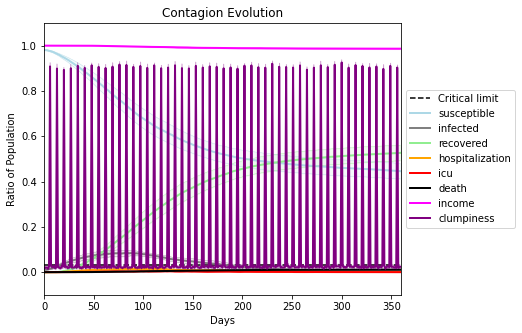

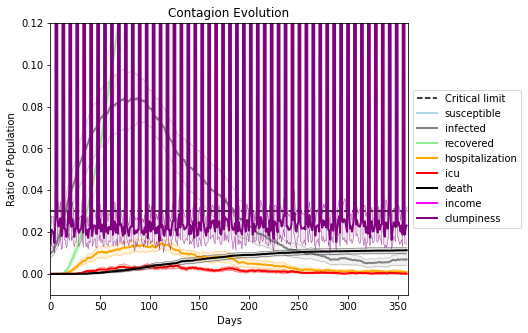

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7340, 8862, 4497, 7642, 9081, 3318, 5806, 1672, 8444, 2144, 8159, 1438, 4437, 3012, 9396, 9582, 9305, 1013, 4118, 4578]
Average similarity between family members is 0.05192781517109634 at temperature 0.66
Average similarity between family and home is 0.9998412630676281 at temperature -1
Average similarity between students and their classroom is 0.0736838799429198 at temperature 0.66
Average classroom occupancy is 3.739130434782609 and number classrooms is 69
Average similarity between workers is 0.043497962707942726 at temperature 0.66
Average office occupancy is 3.4896907216494846 and number offices is 194
Average friend similarity for adults: 0.11823729722215258 for kids: 0.11262388522701292
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.1118724462476291
avg restaurant similarity 0.16647774220800995
avg restaurant similarity 0.020475510832619274
avg restaurant similarity -0.08746951584995222
avg restaurant similarity -0.10236922002137323
avg restaurant similarity -0.10219226076096351
avg restaurant similarity -0.026303756060280493
avg restaurant similarity 0.06310409740954363
avg restaurant similarity 0.1575349837456234
avg restaurant similarity 0.04952524332740271
avg restaurant similarity -0.042197635278121204
avg restaurant similarity 0.16473995620294948
avg restaurant similarity 0.035433775337822805
avg restaurant similarity 0.04060545594470276
avg restaurant similarity -0.05127636847312489
avg restaurant similarity 0.00653022439346156
avg restaurant similarity -0.027900418194234812
avg restaurant similarity -0.03758293635224027
avg restaurant similarity 0.011585092297654365
avg restaurant similarity 0.028573262603057318
avg restaurant similarity 0.03298327601942969
avg restaurant simila

avg restaurant similarity 0.16643306265306157
avg restaurant similarity -0.05193717852934953
avg restaurant similarity -0.0746688619022238
avg restaurant similarity 0.09499133741989553
avg restaurant similarity 0.08974375904327443
avg restaurant similarity 0.05871930034736696
avg restaurant similarity 0.14248995131841022
avg restaurant similarity -0.07653165528118079
avg restaurant similarity -0.038916823531007776
avg restaurant similarity 0.054158896128647105
avg restaurant similarity -0.24324092342814846
avg restaurant similarity 0.1000913788558437
avg restaurant similarity 0.025268880081414646
avg restaurant similarity -0.11933973574207411
avg restaurant similarity 0.14797955326746717
avg restaurant similarity -0.03691775390697841
avg restaurant similarity -0.07986247150347547
avg restaurant similarity 0.06690043908244453
avg restaurant similarity 0.1687113012016394
avg restaurant similarity -0.03268925892904993
avg restaurant similarity -0.05998166408846407
avg restaurant similarit

avg restaurant similarity -0.22671249242881886
avg restaurant similarity 0.2735549780147453
avg restaurant similarity 0.004191242627023123
avg restaurant similarity 0.24544283492310726
avg restaurant similarity -0.050028842173905644
avg restaurant similarity 0.305794249818059
avg restaurant similarity -0.012361176698711151
avg restaurant similarity 0.1903022665537156
avg restaurant similarity -0.019131742435477724
avg restaurant similarity 0.23742093761506325
avg restaurant similarity -0.044765481082340956
avg restaurant similarity 0.03634151572554957
avg restaurant similarity -0.010284995274240183
avg restaurant similarity -0.047901835754872946
avg restaurant similarity -0.045817910028241045
avg restaurant similarity 0.03712259452139029
avg restaurant similarity 0.02084408578068764
avg restaurant similarity -0.22771771723422862
avg restaurant similarity 0.3234133826297122
avg restaurant similarity 0.10518895530075545
avg restaurant similarity 0.1863985892484151
avg restaurant similari

avg restaurant similarity -0.021685099832196353
avg restaurant similarity 0.09678634576645834
avg restaurant similarity -0.12290381456924462
avg restaurant similarity -0.3438695920593848
avg restaurant similarity 0.2398429652038772
avg restaurant similarity -0.013756990010151354
avg restaurant similarity 0.035097630300978885
avg restaurant similarity 0.09538597559960657
avg restaurant similarity -0.09364796756798646
avg restaurant similarity 0.0669839749207492
avg restaurant similarity 0.07042468111737173
avg restaurant similarity -0.06110668176679397
avg restaurant similarity 0.18581532295938916
avg restaurant similarity 0.2590918192163843
avg restaurant similarity -0.1203620616344442
avg restaurant similarity -0.19152366775180824
avg restaurant similarity -0.19785710687694658
avg restaurant similarity 0.0920483590516572
avg restaurant similarity -0.17388693292961313
avg restaurant similarity -0.0976654089728663
avg restaurant similarity -0.011864065541421095
avg restaurant similarity

avg restaurant similarity 0.19614621109592437
avg restaurant similarity -0.021777973504899954
avg restaurant similarity -0.11610772639092681
avg restaurant similarity 0.17286791162575596
avg restaurant similarity 0.036058591248837514
avg restaurant similarity 0.00880399808988189
avg restaurant similarity -0.058750564135384084
avg restaurant similarity -0.02139545007455609
avg restaurant similarity 0.12816703335515736
avg restaurant similarity 0.1214285601698782
avg restaurant similarity 0.06863723722490452
avg restaurant similarity 0.1129227928536765
avg restaurant similarity -0.0897393683713011
avg restaurant similarity 0.1324568236746071
avg restaurant similarity -0.1705922094119692
avg restaurant similarity 0.03763377058915144
avg restaurant similarity 0.33374546007767175
avg restaurant similarity 0.01982167643303069
avg restaurant similarity 0.0398064471406571
avg restaurant similarity 0.17072584916057001
avg restaurant similarity 0.01969882028444657
avg restaurant similarity 0.140

avg restaurant similarity 0.14282701165226994
avg restaurant similarity 0.04155560843514275
avg restaurant similarity 0.07227955881527319
avg restaurant similarity 0.06123074759327481
avg restaurant similarity 0.1650182240999854
avg restaurant similarity 0.015665852720760237
avg restaurant similarity 0.12882184947149192
avg restaurant similarity -0.10329439309490847
avg restaurant similarity 0.5440441462072301
avg restaurant similarity -0.12273987592807196
avg restaurant similarity 0.0894613004838223
avg restaurant similarity 0.11420789140880985
avg restaurant similarity -0.1812822051117979
avg restaurant similarity -0.07145485770000737
avg restaurant similarity 0.11340026188625048
avg restaurant similarity 0.14537673420138872
avg restaurant similarity 0.18233567130643216
avg restaurant similarity 0.30886628820142725
avg restaurant similarity -0.12858029755047512
avg restaurant similarity -0.11431314723582595
avg restaurant similarity 0.020771821191844834
avg restaurant similarity -0.0

avg restaurant similarity 0.11455954738348342
avg restaurant similarity 0.08591613790721939
avg restaurant similarity -0.04344433043952461
avg restaurant similarity -0.10033797191824677
avg restaurant similarity -0.00729461579177991
avg restaurant similarity -0.055665269108855706
avg restaurant similarity 0.07542669170483644
avg restaurant similarity 0.07505958606477765
avg restaurant similarity -0.04084925257070259
avg restaurant similarity 0.03485408109047998
avg restaurant similarity -0.12158048941507625
avg restaurant similarity 0.04528447266516844
avg restaurant similarity 0.06400423310872955
avg restaurant similarity 0.11355796010375849
avg restaurant similarity -0.08003343286169592
avg restaurant similarity 0.15805916377860862
avg restaurant similarity 0.04860240133170787
avg restaurant similarity -0.11698885832448284
avg restaurant similarity 0.02389643716852396
avg restaurant similarity 0.025085561191513454
avg restaurant similarity 0.0636320779152797
avg restaurant similarity

avg restaurant similarity -0.10971412052748497
avg restaurant similarity -0.07414468014613414
avg restaurant similarity 0.029327858841566183
avg restaurant similarity 0.1949487200508413
avg restaurant similarity -0.21394020343688547
avg restaurant similarity 0.16047831066150425
avg restaurant similarity 0.02562017250300283
avg restaurant similarity -0.01981131467816223
avg restaurant similarity -0.028215111507511974
avg restaurant similarity 0.10838831957888195
avg restaurant similarity -0.017159941014502137
avg restaurant similarity 0.04655073109493158
avg restaurant similarity 0.18077723341731686
avg restaurant similarity 0.009729002810697726
avg restaurant similarity 0.36897695741333103
avg restaurant similarity -0.08258491431636598
avg restaurant similarity 0.03170784349380969
avg restaurant similarity -0.18024703313024693
avg restaurant similarity -0.04533465925463646
avg restaurant similarity 0.09477498304341811
avg restaurant similarity 0.06987850431570111
avg restaurant similar

avg restaurant similarity 0.20031673883543735
avg restaurant similarity -0.03201957790160011
avg restaurant similarity 0.09695762206495889
avg restaurant similarity 0.04823472252086624
avg restaurant similarity 0.3548086973774217
avg restaurant similarity -0.006223378330390661
avg restaurant similarity -0.16347667135512162
avg restaurant similarity -0.0044553048304608045
avg restaurant similarity 0.01288899368501452
avg restaurant similarity -0.25861765033444895
avg restaurant similarity 0.11825902964225482
avg restaurant similarity 0.023401166719753418
avg restaurant similarity -0.07865165691924247
avg restaurant similarity -0.11027843733161426
avg restaurant similarity -0.08966324801386572
avg restaurant similarity 0.06016551392761434
avg restaurant similarity 0.0389513118082414
avg restaurant similarity -0.06877576240109765
avg restaurant similarity 0.017828668604596035
avg restaurant similarity 0.10556861925256636
avg restaurant similarity 0.023930117699736526
avg restaurant simila

avg restaurant similarity -0.1278900528710133
avg restaurant similarity 0.03158519323066983
avg restaurant similarity 0.015106491495809088
avg restaurant similarity -0.05075372122390753
avg restaurant similarity -0.10622262660918552
avg restaurant similarity 0.10459876955378701
avg restaurant similarity 0.11214066384830154
avg restaurant similarity 0.056033963463168114
avg restaurant similarity -0.02696737698054938
avg restaurant similarity 0.20515500302837075
avg restaurant similarity 0.00869500052245738
avg restaurant similarity 0.27014133648360633
avg restaurant similarity -0.0761358071351153
avg restaurant similarity 0.18089287347232832
avg restaurant similarity 0.09118789217699126
avg restaurant similarity -0.010000527270107737
avg restaurant similarity -0.09336292811096705
avg restaurant similarity -0.00016024560045745928
avg restaurant similarity 0.37935303285283106
avg restaurant similarity 0.19383884280900318
avg restaurant similarity 0.15148406015684598
avg restaurant similar

avg restaurant similarity -0.03280260107397558
avg restaurant similarity 0.1122249395863254
avg restaurant similarity 0.09707705142182876
avg restaurant similarity 0.10320259879547207
avg restaurant similarity 0.02233785847681823
avg restaurant similarity 0.2009589454353141
avg restaurant similarity 0.059832432443681145
avg restaurant similarity 0.29421950433637706
avg restaurant similarity -0.2587101242749084
avg restaurant similarity 0.08340924987818264
avg restaurant similarity 0.05503347149352047
avg restaurant similarity 0.09739416352523772
avg restaurant similarity 0.14458946262146186
avg restaurant similarity 0.01577019918583311
avg restaurant similarity -0.11318255819997723
avg restaurant similarity 0.08432884541671137
avg restaurant similarity -0.1074313876031708
avg restaurant similarity -0.1859353883839325
avg restaurant similarity 0.275108300788929
avg restaurant similarity 0.028629857023926633
avg restaurant similarity 0.2774208967110154
avg restaurant similarity 0.3939186

avg restaurant similarity 0.2612723093917601
avg restaurant similarity 0.012812958412336362
avg restaurant similarity 0.25158285820794357
avg restaurant similarity -0.11408500484554351
avg restaurant similarity 0.21463532545683664
avg restaurant similarity -0.06124168654514128
avg restaurant similarity -0.0698935544591225
avg restaurant similarity 0.22931950953827457
avg restaurant similarity 0.0642419530472415
avg restaurant similarity 0.13217126086740105
avg restaurant similarity 0.37927503377538757
avg restaurant similarity -0.10789593626799811
avg restaurant similarity -0.053931697625767244
avg restaurant similarity 0.3074955322952547
avg restaurant similarity -0.004774352172712951
avg restaurant similarity 0.05391894097901609
avg restaurant similarity 0.08904434243778041
avg restaurant similarity -0.06395723088731008
avg restaurant similarity -0.20084430631101052
avg restaurant similarity 0.2504049821642331
avg restaurant similarity 0.01952486727553282
avg restaurant similarity -0

avg restaurant similarity -0.10125355700132284
avg restaurant similarity 0.1993802348746002
avg restaurant similarity 0.15101838936484466
avg restaurant similarity 0.17179510051390037
avg restaurant similarity 0.09823508874991253
avg restaurant similarity -0.06206201319124088
avg restaurant similarity 0.0166882942267164
avg restaurant similarity 0.10002440791977492
avg restaurant similarity 0.04209969744908712
avg restaurant similarity 0.16591375563472965
avg restaurant similarity 0.14255680894977113
avg restaurant similarity -0.09512542216660057
avg restaurant similarity 0.1073296865678372
avg restaurant similarity 0.10902242872785933
avg restaurant similarity 0.10169198099601179
avg restaurant similarity -0.043181624686609583
avg restaurant similarity -0.10037831515569784
avg restaurant similarity 0.1113666893524405
avg restaurant similarity -0.08736223732591965
avg restaurant similarity 0.08974320066613439
avg restaurant similarity 0.18142523345771425
avg restaurant similarity 0.079

avg restaurant similarity 0.08159105377928215
avg restaurant similarity -0.04263481842068427
avg restaurant similarity 0.049834456660275174
avg restaurant similarity 0.09973477187911053
avg restaurant similarity 0.05634415358719119
avg restaurant similarity 0.1394275930071202
avg restaurant similarity -0.14438584369561222
avg restaurant similarity 0.053645452266534416
avg restaurant similarity 0.11175337537472609
avg restaurant similarity 0.10470744401691508
avg restaurant similarity 0.0978055481362059
avg restaurant similarity -0.14214861602874423
avg restaurant similarity 0.14708511786940934
avg restaurant similarity 0.12485844548935893
avg restaurant similarity -0.15072122900580975
avg restaurant similarity 0.04237054075160229
avg restaurant similarity 0.001304333336413622
avg restaurant similarity -0.10717069035571822
avg restaurant similarity 0.2177577995415968
avg restaurant similarity -0.013292661654227178
avg restaurant similarity 0.14549684880115113
avg restaurant similarity 0

avg restaurant similarity -0.06556607861606219
avg restaurant similarity -0.32746168266386244
avg restaurant similarity 0.25762151868562233
avg restaurant similarity -0.10151225292689275
avg restaurant similarity 0.11349083609870371
avg restaurant similarity 0.26120051875581257
avg restaurant similarity 0.048530672586725776
avg restaurant similarity 0.1474688393386634
avg restaurant similarity 0.058702624268436546
avg restaurant similarity 0.05614122647462263
avg restaurant similarity -0.07884424321009266
avg restaurant similarity 0.3343035773042531
avg restaurant similarity 0.27366785098426777
avg restaurant similarity -0.14610082065176005
avg restaurant similarity -0.14766702005078366
avg restaurant similarity -0.05663293894230722
avg restaurant similarity -0.18089120664486671
avg restaurant similarity -0.078374889438506
avg restaurant similarity -0.09999234527184489
avg restaurant similarity 0.017041447801877746
avg restaurant similarity 0.019346547501910227
avg restaurant similarit

avg restaurant similarity 0.28959093410869147
avg restaurant similarity -0.06285551062442005
avg restaurant similarity -0.05384692967546866
avg restaurant similarity 0.05596178804701957
avg restaurant similarity -0.03231529647677665
avg restaurant similarity -0.00818388965228905
avg restaurant similarity 0.11249585266329555
avg restaurant similarity -0.11306326568415725
avg restaurant similarity 0.09879755000713468
avg restaurant similarity -0.07740412644751712
avg restaurant similarity 0.06685849656724696
avg restaurant similarity -0.18302807039682126
avg restaurant similarity -0.09003086276800412
avg restaurant similarity -0.0038649510046266794
avg restaurant similarity 0.15849456978564844
avg restaurant similarity -0.008308675220299848
avg restaurant similarity -0.0005012703218354613
avg restaurant similarity -0.2085657288439168
avg restaurant similarity -0.012482351754391295
avg restaurant similarity -0.0828970551531335
avg restaurant similarity -0.01197784235299506
avg restaurant 

avg restaurant similarity -0.018634295874794697
avg restaurant similarity 0.004648965345276023
avg restaurant similarity 0.13436568619383396
avg restaurant similarity 0.1704738806236762
avg restaurant similarity 0.15494566631167656
avg restaurant similarity 0.11174016559640013
avg restaurant similarity -0.15222663646345574
avg restaurant similarity 0.03565397174152913
avg restaurant similarity 0.05226943832583286
avg restaurant similarity -0.09194886349253854
avg restaurant similarity 0.11221948842962963
avg restaurant similarity 0.23719041794356976
avg restaurant similarity 0.04897003383672836
avg restaurant similarity 0.004490691503275739
avg restaurant similarity 0.23139459143146143
avg restaurant similarity 0.2258276329365478
avg restaurant similarity -0.04135346674538004
avg restaurant similarity -0.028856700629795243
avg restaurant similarity -0.10693817279057945
avg restaurant similarity 0.05239892885055484
avg restaurant similarity -0.01863570577169425
avg restaurant similarity

avg restaurant similarity -0.025302407141331165
avg restaurant similarity 0.029791786649368296
avg restaurant similarity 0.10775056747475462
avg restaurant similarity -0.18038413182344418
avg restaurant similarity 0.09222574803284235
avg restaurant similarity 0.19216928541723968
avg restaurant similarity -0.09684089879418459
avg restaurant similarity -0.024826856341760795
avg restaurant similarity 0.03084797696769877
avg restaurant similarity 0.03210728258727808
avg restaurant similarity 0.1267811158229868
avg restaurant similarity 0.21906792924861215
avg restaurant similarity 0.013303037427340176
avg restaurant similarity -0.035488501876597064
avg restaurant similarity 0.044711035883811215
avg restaurant similarity -0.046702505683683206
avg restaurant similarity 0.019548165666060664
avg restaurant similarity 5.4051387790491435e-06
avg restaurant similarity 0.007710053518980505
avg restaurant similarity 0.0288423099275601
avg restaurant similarity 0.00869343386052969
avg restaurant sim

avg restaurant similarity -0.09275505246488883
avg restaurant similarity 0.012153747983393878
avg restaurant similarity -0.0002154359264402994
avg restaurant similarity -0.07209172922456586
avg restaurant similarity 0.07081929449253224
avg restaurant similarity -0.004803425056364006
avg restaurant similarity -0.12955651831564266
avg restaurant similarity 0.25465064113193675
avg restaurant similarity -0.06140816344578263
avg restaurant similarity -0.0553421515657682
avg restaurant similarity 0.07259699679237253
avg restaurant similarity 0.11247947523243049
avg restaurant similarity -0.09018279872005142
avg restaurant similarity -0.05922396227155915
avg restaurant similarity -0.03018476864902449
avg restaurant similarity -0.01818315071351543
avg restaurant similarity 0.1549780052730229
avg restaurant similarity -0.022279392481789177
avg restaurant similarity 0.014661690131684613
avg restaurant similarity 0.05516678989091783
avg restaurant similarity -0.022061949706646145
avg restaurant s

avg restaurant similarity 0.07813884566254864
avg restaurant similarity 0.14924931108451225
avg restaurant similarity 0.0024761757953678885
avg restaurant similarity 0.026106235002703725
avg restaurant similarity 0.17732044323197182
avg restaurant similarity -0.030790412164886576
avg restaurant similarity 0.0005237794628907474
avg restaurant similarity 0.07680574987688589
avg restaurant similarity 0.036593278516983095
avg restaurant similarity -0.07136137281161774
avg restaurant similarity 0.04821418390587715
avg restaurant similarity -0.10217330793890822
avg restaurant similarity 0.27256659997938415
avg restaurant similarity -0.18452062469547267
avg restaurant similarity 0.2106144352218273
avg restaurant similarity 0.031150863727503413
avg restaurant similarity 0.06025290075310586
avg restaurant similarity -0.02810786603406311
avg restaurant similarity -0.15027558430601157
avg restaurant similarity 0.1374329402641284
avg restaurant similarity 0.06904836175025576
avg restaurant similar

avg restaurant similarity 0.027601362943052956
avg restaurant similarity 0.05399157752590985
avg restaurant similarity 0.012099945169116316
avg restaurant similarity 0.11865467192405625
avg restaurant similarity -0.03913649194570874
avg restaurant similarity 0.06387787003207361
avg restaurant similarity 0.10374242864228526
avg restaurant similarity 0.15964925553757306
avg restaurant similarity -0.02235660185803296
avg restaurant similarity -0.029862342330292363
avg restaurant similarity 0.11134144244030865
avg restaurant similarity 0.1405470355886304
avg restaurant similarity -0.1818787121125411
avg restaurant similarity 0.07098244895826343
avg restaurant similarity -0.12264592291973364
avg restaurant similarity 0.0198567869744676
avg restaurant similarity -0.10838048194044891
avg restaurant similarity -0.1410252384754738
avg restaurant similarity -0.007105891725487324
avg restaurant similarity 0.3048032573417806
avg restaurant similarity 0.08602740486829913
avg restaurant similarity 0

avg restaurant similarity -0.018581452069796056
avg restaurant similarity -0.0014534335769273293
avg restaurant similarity 0.05641828735602111
avg restaurant similarity -0.005271085923302907
avg restaurant similarity 0.24872250532075066
avg restaurant similarity 0.12549141075299358
avg restaurant similarity -0.20612908671905814
avg restaurant similarity -0.06682476739830599
avg restaurant similarity 0.29912806246922546
avg restaurant similarity -0.11742694623779733
avg restaurant similarity 0.10198321565169163
avg restaurant similarity -0.07783034978515878
avg restaurant similarity -0.08954306793201001
avg restaurant similarity 0.051224383792734654
avg restaurant similarity 0.1418433553129996
avg restaurant similarity 0.08342628756773154
avg restaurant similarity 0.04855081250867514
avg restaurant similarity -0.20489261115986088
avg restaurant similarity 0.11551676539259731
avg restaurant similarity 0.0018897727647138466
avg restaurant similarity -0.12692027167417969
avg restaurant sim

avg restaurant similarity 0.2033985789872244
avg restaurant similarity 0.01268521990955015
avg restaurant similarity 0.17935808868014294
avg restaurant similarity -0.0027584378106616445
avg restaurant similarity -0.042150192220385144
avg restaurant similarity -0.09218849366305779
avg restaurant similarity 0.04416525984062655
avg restaurant similarity 0.0826729014648089
avg restaurant similarity 0.1776486578234859
avg restaurant similarity -0.034535276144755385
avg restaurant similarity 0.023690014034285577
avg restaurant similarity 0.07207555615840175
avg restaurant similarity 0.08452609847132447
avg restaurant similarity 0.11429957516116462
avg restaurant similarity -0.1514111323261346
avg restaurant similarity -0.13481523924771416
avg restaurant similarity 0.07063708659061868
avg restaurant similarity -0.19629666575358065
avg restaurant similarity 0.14007861348616088
avg restaurant similarity -0.014660284933566763
avg restaurant similarity 0.33996725722382803
avg restaurant similarit

avg restaurant similarity 0.21150857943733323
avg restaurant similarity 0.2391880843076786
avg restaurant similarity 0.10475907873948632
avg restaurant similarity -0.04890834399143588
avg restaurant similarity 0.11658807713694133
avg restaurant similarity 0.17426003261227482
avg restaurant similarity -0.3335246904309766
avg restaurant similarity 0.14426245993163767
avg restaurant similarity -0.025664260377202916
avg restaurant similarity 0.1594689223339961
avg restaurant similarity 0.03636708143397163
avg restaurant similarity 0.3814252151077863
avg restaurant similarity 0.04681015615696488
avg restaurant similarity 0.14853742560888172
avg restaurant similarity 0.025026857248364832
avg restaurant similarity 0.11548473593822
avg restaurant similarity 0.12566075639233462
avg restaurant similarity 0.10568634794884961
avg restaurant similarity -0.05047143208137739
avg restaurant similarity 0.11507446199357851
avg restaurant similarity 0.15043739808999576
avg restaurant similarity 0.1377036

avg restaurant similarity 0.18864315641165838
avg restaurant similarity 0.025815406307467058
avg restaurant similarity 0.063225583498423
avg restaurant similarity 0.0356429959635944
avg restaurant similarity -0.07672319230309645
avg restaurant similarity -0.09633391938042055
avg restaurant similarity 0.13743876903372468
avg restaurant similarity -0.09432965193182506
avg restaurant similarity 0.05832877718754697
avg restaurant similarity -0.0042934514448873945
avg restaurant similarity -0.016546240264532483
avg restaurant similarity 0.036291050816958624
avg restaurant similarity 0.09850749936545142
avg restaurant similarity 0.008819952822781724
avg restaurant similarity 0.14530812575986204
avg restaurant similarity -0.1954214869191829
avg restaurant similarity -0.010152342785743554
avg restaurant similarity 0.0027263914173966605
avg restaurant similarity -0.0027218798817223583
avg restaurant similarity 0.18760730993973096
avg restaurant similarity 0.45174518603725644
avg restaurant simi

avg restaurant similarity -0.006613284151894605
avg restaurant similarity 0.12327221602277455
avg restaurant similarity -0.08700579279879889
avg restaurant similarity 0.140811763281215
avg restaurant similarity -0.018021221806420802
avg restaurant similarity 0.16675501856248134
avg restaurant similarity 0.11623218788339618
avg restaurant similarity -0.06328611558298441
avg restaurant similarity -0.10871583366177097
avg restaurant similarity 0.0638036695867664
avg restaurant similarity 0.03482504559332957
avg restaurant similarity -0.01064134739078469
avg restaurant similarity -0.12953533937524078
avg restaurant similarity -0.013241060890751333
avg restaurant similarity 0.09342492156156575
avg restaurant similarity -0.16327998831871662
avg restaurant similarity -0.13954271668178797
avg restaurant similarity -0.09818171115863257
avg restaurant similarity 0.17206189339296726
avg restaurant similarity -0.12260838821476808
avg restaurant similarity -0.06813518910929807
avg restaurant simila

avg restaurant similarity -0.13131239450197318
avg restaurant similarity 0.11902574158610868
avg restaurant similarity 0.03509926390810554
avg restaurant similarity 0.0064186208492350615
avg restaurant similarity -0.06303822136673198
avg restaurant similarity 0.1631935206116047
avg restaurant similarity 0.1046542946982527
avg restaurant similarity 0.055840615473245994
avg restaurant similarity 0.10563239308259738
avg restaurant similarity -0.02527456552636293
avg restaurant similarity 0.0830720104080561
avg restaurant similarity -0.06650491008099521
avg restaurant similarity -0.08086324200077097
avg restaurant similarity 0.102257440607317
avg restaurant similarity 0.25066073764436536
avg restaurant similarity -0.0014379377703461146
avg restaurant similarity -0.0792291939007636
avg restaurant similarity -0.03215705140627466
avg restaurant similarity 0.23440764767010464
avg restaurant similarity -0.06230196691560083
avg restaurant similarity 0.24263081014741691
avg restaurant similarity 

avg restaurant similarity 0.31401293462871377
avg restaurant similarity -0.06825557106027683
avg restaurant similarity -0.09311447910506127
avg restaurant similarity 0.0112020316477716
avg restaurant similarity 0.19212760843504834
avg restaurant similarity -0.23298975165328825
avg restaurant similarity -0.07427791356458291
avg restaurant similarity 0.17583177038957434
avg restaurant similarity -0.2345505407940118
avg restaurant similarity -0.07193181266053643
avg restaurant similarity 0.051880558618215916
avg restaurant similarity 0.10467112666315534
avg restaurant similarity 0.06320967146305013
avg restaurant similarity 0.10866415745573578
avg restaurant similarity 0.0033656622639988043
avg restaurant similarity 0.5120069367523193
avg restaurant similarity 0.07641243295331727
avg restaurant similarity 0.27797453316726567
avg restaurant similarity -0.027149284336892468
avg restaurant similarity 0.2031747226046656
avg restaurant similarity -0.07027062778863039
avg restaurant similarity 

avg restaurant similarity 0.19830370922376717
avg restaurant similarity -0.07471757922018735
avg restaurant similarity -0.011659069943376411
avg restaurant similarity -0.04206502848616979
avg restaurant similarity -0.0983810271070796
avg restaurant similarity 0.07260887126280431
avg restaurant similarity 0.11168962606563722
avg restaurant similarity 0.06383183149002329
avg restaurant similarity 0.123918782680239
avg restaurant similarity 0.09474806739322378
avg restaurant similarity 0.05619167705566976
avg restaurant similarity -0.05149728352777584
avg restaurant similarity -0.11366913791562257
avg restaurant similarity -0.07080505618198557
avg restaurant similarity -0.22409766370736484
avg restaurant similarity -0.0067008482020193
avg restaurant similarity -0.03875825949113247
avg restaurant similarity -0.021576847282925304
avg restaurant similarity 0.16099357351244556
avg restaurant similarity 0.13827959937136872
avg restaurant similarity -0.39169658160588006
avg restaurant similarit

avg restaurant similarity 0.09038484838809589
avg restaurant similarity 0.23944504222263868
avg restaurant similarity -0.25545638033278295
avg restaurant similarity -0.07214439023550197
avg restaurant similarity -0.07649600164315876
avg restaurant similarity 0.002409308132051459
avg restaurant similarity 0.11487902496006244
avg restaurant similarity -0.04605320859462747
avg restaurant similarity -0.0330075077640788
avg restaurant similarity 0.04796798264378914
avg restaurant similarity -0.17770534587066172
avg restaurant similarity 0.11015635994908686
avg restaurant similarity -0.08333473845014841
avg restaurant similarity -0.09616993264938582
avg restaurant similarity -0.13317541648296174
avg restaurant similarity 0.05637546575382409
avg restaurant similarity 0.0935139065981415
avg restaurant similarity -0.07305022254681202
avg restaurant similarity 0.0912262924722847
avg restaurant similarity 0.0756626756328355
avg restaurant similarity 0.023371540978966383
avg restaurant similarity 

avg restaurant similarity 0.04972436268319081
avg restaurant similarity -0.1047890992208534
avg restaurant similarity -0.10496838526350555
avg restaurant similarity -0.008899197628420213
avg restaurant similarity -0.019680101272667276
avg restaurant similarity -0.0519077023522535
avg restaurant similarity -0.026049290631724193
avg restaurant similarity -0.3627851679852538
avg restaurant similarity -0.03164274664704437
avg restaurant similarity -4.861277423898588e-05
avg restaurant similarity 0.07692873369049096
avg restaurant similarity 0.21287947934505816
avg restaurant similarity -0.09461542738836022
avg restaurant similarity -0.07120422038527989
avg restaurant similarity -0.3102012233255042
avg restaurant similarity -0.2487884517187574
avg restaurant similarity 0.049286199500302094
avg restaurant similarity 0.09403916882854402
avg restaurant similarity -0.057017145424496325
avg restaurant similarity 0.10655873452066156
avg restaurant similarity -0.06309972922938889
avg restaurant si

avg restaurant similarity 0.1279331795685066
avg restaurant similarity -0.06847237177737958
avg restaurant similarity 0.010690295705689615
avg restaurant similarity -0.08658641574087263
avg restaurant similarity -0.019517182974622415
avg restaurant similarity -0.13209159543979157
avg restaurant similarity 0.1655244555820059
avg restaurant similarity -0.13559760272818835
avg restaurant similarity 0.10777992332525545
avg restaurant similarity 0.030515070429598196
avg restaurant similarity -0.3323374155015166
avg restaurant similarity -0.25575383794438034
avg restaurant similarity 0.2840287696928118
avg restaurant similarity 0.08627926028149917
avg restaurant similarity 0.1003492365372873
avg restaurant similarity 0.005082552371179014
avg restaurant similarity -0.151358436309691
avg restaurant similarity 0.0036832009567372564
avg restaurant similarity 0.02141957420046755
avg restaurant similarity 0.006465002328092089
avg restaurant similarity 0.0487288337704881
avg restaurant similarity 0

avg restaurant similarity 0.07914218136289151
avg restaurant similarity -0.01231122433175318
avg restaurant similarity 0.12299827687345616
avg restaurant similarity 0.019734186798413222
avg restaurant similarity 0.14972477838710596
avg restaurant similarity 0.03950916632245857
avg restaurant similarity 0.10951765352628326
avg restaurant similarity 0.07110463082584262
avg restaurant similarity 0.07968005028756442
avg restaurant similarity 0.012401002369937734
avg restaurant similarity 0.19720405265907287
avg restaurant similarity 0.10053788369923841
avg restaurant similarity 0.25552177790559044
avg restaurant similarity 0.13981144802639794
avg restaurant similarity 0.16535761784970324
avg restaurant similarity -0.005545244046495253
avg restaurant similarity 0.14898481880647546
avg restaurant similarity 0.22433387865822219
avg restaurant similarity 0.11066530352412657
avg restaurant similarity 0.12249939124905769
avg restaurant similarity 0.00035747681870009206
avg restaurant similarity 

avg restaurant similarity -0.26981847879229287
avg restaurant similarity 0.1322271508300071
avg restaurant similarity 0.13341176396057916
avg restaurant similarity -0.08464674374925624
avg restaurant similarity 0.14986107780612684
avg restaurant similarity 0.00842361072460795
avg restaurant similarity 0.01569568776429698
avg restaurant similarity 0.004555680924222153
avg restaurant similarity 0.024871903772939814
avg restaurant similarity 0.1802118816591593
avg restaurant similarity 0.09640463732718318
avg restaurant similarity -0.035596772091097205
avg restaurant similarity -0.2105642515864283
avg restaurant similarity -0.14825828625769566
avg restaurant similarity -0.0028789487565376247
avg restaurant similarity 0.09385169678877091
avg restaurant similarity 0.08386013397147966
avg restaurant similarity 0.13287748580874786
avg restaurant similarity -0.010493500196889872
avg restaurant similarity 0.2674694410274435
avg restaurant similarity 0.19188799739441068
avg restaurant similarity

avg restaurant similarity 0.13621456840017881
avg restaurant similarity 0.17592485627972035
avg restaurant similarity -0.043869824379942364
avg restaurant similarity -0.06420715368935187
avg restaurant similarity 0.23507474726932676
avg restaurant similarity 0.24296404946263306
avg restaurant similarity 0.13516189218437547
avg restaurant similarity -0.02474939843425176
avg restaurant similarity 0.13173150214370663
avg restaurant similarity 0.022748794253155395
avg restaurant similarity 0.09353811081071493
avg restaurant similarity -0.025720601369929843
avg restaurant similarity 0.2608037142392054
avg restaurant similarity 0.10542230853623166
avg restaurant similarity 0.2591717921840783
avg restaurant similarity 0.051081678208562784
avg restaurant similarity 0.054663242557096745
avg restaurant similarity 0.10327026911442916
avg restaurant similarity 0.056211392093163
avg restaurant similarity 0.024521036756766736
avg restaurant similarity 0.15290223528968427
avg restaurant similarity 0.

avg restaurant similarity 0.18162921649182898
avg restaurant similarity 0.0480224801386092
avg restaurant similarity 0.0048946978416936765
avg restaurant similarity 0.02154724168407685
avg restaurant similarity 0.11378875422255773
avg restaurant similarity -0.05257237643198365
avg restaurant similarity 0.22989145261124344
avg restaurant similarity 0.06200079449262586
avg restaurant similarity -0.021994326477295614
avg restaurant similarity 0.1679099426243121
avg restaurant similarity 0.0321821917016022
avg restaurant similarity 0.1359036413355275
avg restaurant similarity 0.10463852442616035
avg restaurant similarity 0.4326928427694653
avg restaurant similarity 0.15667313367196203
avg restaurant similarity 0.09113516329090894
avg restaurant similarity 0.11996594401409123
avg restaurant similarity 0.040429426549768346
avg restaurant similarity -0.0182152474437893
avg restaurant similarity 0.21151537343425303
avg restaurant similarity 0.1676323678564211
avg restaurant similarity 0.219474

avg restaurant similarity 0.0224367188740235
avg restaurant similarity 0.09439756762282214
avg restaurant similarity -0.09155963972710768
avg restaurant similarity -0.06937355526402661
avg restaurant similarity -0.09391940307607832
avg restaurant similarity -0.027695567184174083
avg restaurant similarity 0.0630642184619241
avg restaurant similarity -0.14716679371911948
avg restaurant similarity -0.011341922541538886
avg restaurant similarity 0.018243958890870215
avg restaurant similarity 0.03394938649529581
avg restaurant similarity -0.04506784412352955
avg restaurant similarity 0.041694630550158256
avg restaurant similarity -0.15230291780895908
avg restaurant similarity -0.03788080024706073
avg restaurant similarity -0.061197661928241394
avg restaurant similarity -0.08652375555320613
avg restaurant similarity -0.13031703890413823
avg restaurant similarity 0.04888548710984808
avg restaurant similarity 0.10130443659015549
avg restaurant similarity 0.021780972595366786
avg restaurant sim

avg restaurant similarity -0.1199891499589768
avg restaurant similarity 0.16515964914683326
avg restaurant similarity 0.04412336059272677
avg restaurant similarity -0.06232812259145389
avg restaurant similarity -0.030927350277109664
avg restaurant similarity -0.09553378116030942
avg restaurant similarity 0.05937605065416685
avg restaurant similarity -0.07486274872132109
avg restaurant similarity -0.14545111123510612
avg restaurant similarity 0.1173004234675546
avg restaurant similarity 0.11570463110074065
avg restaurant similarity 0.10981524275915203
avg restaurant similarity 0.08166834286787145
avg restaurant similarity 0.13074558881139692
avg restaurant similarity -0.013809524843734655
avg restaurant similarity -0.08262153290722123
avg restaurant similarity -0.25585113260212416
avg restaurant similarity -0.03700743143550519
avg restaurant similarity -0.00880196880364629
avg restaurant similarity 0.016118352905867606
avg restaurant similarity 0.07195384643031658
avg restaurant similar

avg restaurant similarity -0.14423323192325824
avg restaurant similarity 0.06992502789852104
avg restaurant similarity 0.004360534803036228
avg restaurant similarity -0.0047725822449528705
avg restaurant similarity -0.010313552344553785
avg restaurant similarity -0.08680554375394213
avg restaurant similarity -0.21616446619816387
avg restaurant similarity 0.17763898369659278
avg restaurant similarity 0.030325452965974484
avg restaurant similarity -0.2084247965640286
avg restaurant similarity -0.2703806965475081
avg restaurant similarity -0.06948413550628235
avg restaurant similarity -0.06125501306727775
avg restaurant similarity -0.0025656010760395365
avg restaurant similarity -0.042250411495254325
avg restaurant similarity -0.3125276400418429
avg restaurant similarity -0.216101698097159
avg restaurant similarity 0.012587731916513073
avg restaurant similarity 0.107949021154432
avg restaurant similarity -0.2037357184567669
avg restaurant similarity 0.16663562355920833
avg restaurant simi

avg restaurant similarity -0.19779222742248323
avg restaurant similarity -0.24892237429260783
avg restaurant similarity -0.025875371241136442
avg restaurant similarity 0.01865403735187865
avg restaurant similarity -0.016827991202377345
avg restaurant similarity 0.14352026613577717
avg restaurant similarity 0.06498070664658605
avg restaurant similarity -0.06053960229446191
avg restaurant similarity -0.05575257304457039
avg restaurant similarity 0.09352514254027951
avg restaurant similarity 0.171818245798874
avg restaurant similarity -0.1683786562877173
avg restaurant similarity -0.10192290151142207
avg restaurant similarity -0.0234107164104753
avg restaurant similarity -0.054662476756480144
avg restaurant similarity 0.051063633514724704
avg restaurant similarity 0.2020559928407343
avg restaurant similarity 0.020001469187285827
avg restaurant similarity -0.1105981867999179
avg restaurant similarity -0.010989956895306659
avg restaurant similarity 0.06830910303771925
avg restaurant similar

(<function dict.items>, <function dict.items>, <function dict.items>)

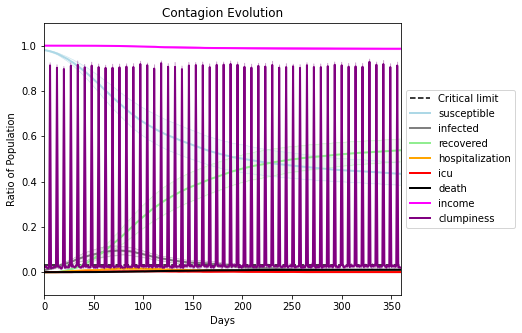

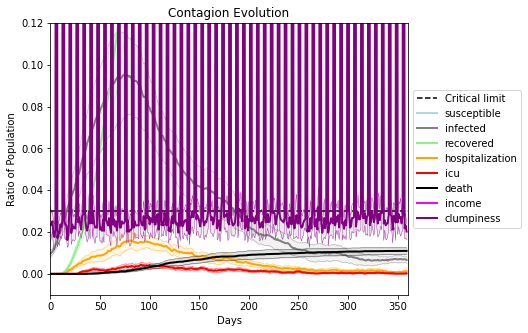

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3461, 9982, 1316, 920, 8723, 1007, 4857, 9918, 9040, 186, 6431, 4863, 4320, 6820, 7586, 192, 1626, 6665, 3634, 9007]
Average similarity between family members is -0.00041589793470430786 at temperature 1
Average similarity between family and home is 0.9998467576539729 at temperature -1
Average similarity between students and their classroom is 0.01563065536012612 at temperature 1
Average classroom occupancy is 4.014285714285714 and number classrooms is 70
Average similarity between workers is 0.010505796361221531 at temperature 1
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.0889980432188664 for kids: 0.0918170798894395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.03435840666175395
avg restaurant similarity -0.13518936167912446
avg restaurant similarity -0.1424666366060987
avg restaurant similarity 0.05913640376949102
avg restaurant similarity -0.04600311502711614
avg restaurant similarity -0.06812753908145575
avg restaurant similarity -0.018090080562030982
avg restaurant similarity 0.048647878160147706
avg restaurant similarity 0.18020325857562225
avg restaurant similarity 0.00626182494850923
avg restaurant similarity 0.03866134999937995
avg restaurant similarity 0.2162462538734703
avg restaurant similarity 0.1331355781811894
avg restaurant similarity 0.2346516650453161
avg restaurant similarity 0.1102095794673398
avg restaurant similarity 0.07956289802269434
avg restaurant similarity 0.18470919521154644
avg restaurant similarity 0.154166904725284
avg restaurant similarity -0.14533919130132067
avg restaurant similarity 0.23578460984010824
avg restaurant similarity 0.12992206786990776
avg restaurant similarity -0.1284

avg restaurant similarity -0.29232029896736816
avg restaurant similarity 0.07939067714525687
avg restaurant similarity 0.2725267111799095
avg restaurant similarity 0.01596873446463508
avg restaurant similarity 0.015344551417056117
avg restaurant similarity -0.020482559493595884
avg restaurant similarity 0.07315045560094172
avg restaurant similarity -0.07836277426156175
avg restaurant similarity -0.03310235252052092
avg restaurant similarity -0.05824023878006668
avg restaurant similarity -0.1880950367119313
avg restaurant similarity -0.08374920575350481
avg restaurant similarity 0.09709350131182684
avg restaurant similarity -0.10240741735776719
avg restaurant similarity 0.03999043468272099
avg restaurant similarity -0.2299892856896276
avg restaurant similarity 0.2509426897265078
avg restaurant similarity 0.029295794068750523
avg restaurant similarity -0.0016516111108370035
avg restaurant similarity 0.006234026042298853
avg restaurant similarity 0.14842821551254548
avg restaurant similar

avg restaurant similarity -0.07804033090866576
avg restaurant similarity -0.042839035798271925
avg restaurant similarity -0.09906250690513585
avg restaurant similarity -0.18811747443935367
avg restaurant similarity 0.02281726012978668
avg restaurant similarity 0.37816447077508214
avg restaurant similarity 0.08725354190335981
avg restaurant similarity -0.09954929582926492
avg restaurant similarity 0.3127481314655196
avg restaurant similarity -0.048685732100244045
avg restaurant similarity 0.1259520841309904
avg restaurant similarity 0.07088405123170478
avg restaurant similarity 0.18354297842004905
avg restaurant similarity 0.18171518343774345
avg restaurant similarity -0.039341413589772466
avg restaurant similarity 0.12665985080319367
avg restaurant similarity 0.12007876508194783
avg restaurant similarity 0.06850231572731677
avg restaurant similarity 0.1000891616058364
avg restaurant similarity -0.08862033243296187
avg restaurant similarity -0.1543073570199293
avg restaurant similarity 

avg restaurant similarity 0.24747693180437275
avg restaurant similarity 0.036086672112115435
avg restaurant similarity 0.03774019233552248
avg restaurant similarity -0.008652652144575113
avg restaurant similarity 0.013192374908662258
avg restaurant similarity -0.14829217907341985
avg restaurant similarity 0.25089351616774513
avg restaurant similarity 0.05472721471483418
avg restaurant similarity 0.08924342265961711
avg restaurant similarity 0.19507609454177552
avg restaurant similarity -0.0014466716506232925
avg restaurant similarity 0.013293785946104426
avg restaurant similarity 0.040215876441905926
avg restaurant similarity 0.22942015508485253
avg restaurant similarity 0.35730059194114916
avg restaurant similarity 0.060155610018389746
avg restaurant similarity 0.13331204910453376
avg restaurant similarity 0.17785092421704202
avg restaurant similarity 0.12099700338472268
avg restaurant similarity 0.05224431915876399
avg restaurant similarity 0.11084049635408953
avg restaurant similari

avg restaurant similarity -0.09410777779104698
avg restaurant similarity 0.15502185662557053
avg restaurant similarity -0.05480343585314879
avg restaurant similarity -0.05056694791567776
avg restaurant similarity 0.01727985390787433
avg restaurant similarity -0.06535356294438674
avg restaurant similarity 0.07855299616459055
avg restaurant similarity 0.03143461757157003
avg restaurant similarity 0.06785466795841262
avg restaurant similarity -0.10311182458471871
avg restaurant similarity 0.14528338678726016
avg restaurant similarity -0.10030779913539765
avg restaurant similarity 0.0010438403969160708
avg restaurant similarity -0.14072370457959493
avg restaurant similarity 0.010949558317806427
avg restaurant similarity -0.06989710643850862
avg restaurant similarity -0.0608045003252758
avg restaurant similarity 0.08299188302952108
avg restaurant similarity -0.07922479146572463
avg restaurant similarity -0.21362504854929296
avg restaurant similarity 0.009857293094857653
avg restaurant simil

avg restaurant similarity -0.38378271194099745
avg restaurant similarity 0.010248139191640823
avg restaurant similarity 0.07411161232671358
avg restaurant similarity -0.22719635423359455
avg restaurant similarity -0.06635824519148624
avg restaurant similarity 0.05037910848435075
avg restaurant similarity -0.07349471314256144
avg restaurant similarity -0.006024448646106035
avg restaurant similarity -0.09808896315421597
avg restaurant similarity 0.04466453184648402
avg restaurant similarity 0.08524872864973969
avg restaurant similarity -0.2922265723925597
avg restaurant similarity 0.006065247016994522
avg restaurant similarity 0.19906152848707412
avg restaurant similarity -0.07769497920630389
avg restaurant similarity 0.1675136120207513
avg restaurant similarity 0.03399048355727571
avg restaurant similarity 0.00205587806846693
avg restaurant similarity 0.03457228142451205
avg restaurant similarity 0.1337140533818858
avg restaurant similarity 0.16117272080735304
avg restaurant similarity 

avg restaurant similarity 0.04577622497746431
avg restaurant similarity 0.052596833962526984
avg restaurant similarity 0.077482070653455
avg restaurant similarity 0.22899167440447415
avg restaurant similarity -0.04719049787870144
avg restaurant similarity -0.07317178107186209
avg restaurant similarity 0.003209778248243818
avg restaurant similarity -0.09479514248167344
avg restaurant similarity 0.2451285250487876
avg restaurant similarity -0.11996482508586265
avg restaurant similarity -0.0003054663371676869
avg restaurant similarity 0.08830964159794326
avg restaurant similarity -0.1762746876541036
avg restaurant similarity 0.23835532562466621
avg restaurant similarity 0.30870442134716103
avg restaurant similarity 0.10795170023057933
avg restaurant similarity 0.09538280495496473
avg restaurant similarity -0.13637890065419575
avg restaurant similarity -0.018607166272393207
avg restaurant similarity 0.09123846962931433
avg restaurant similarity -0.11519235978673983
avg restaurant similarit

avg restaurant similarity 0.06283148855216686
avg restaurant similarity -0.06242391605685395
avg restaurant similarity -0.07488256081447435
avg restaurant similarity 0.2602383447285008
avg restaurant similarity -0.17403760866307363
avg restaurant similarity 0.005128291871419859
avg restaurant similarity 0.283187325318269
avg restaurant similarity 0.1325466222845252
avg restaurant similarity 0.14939416182091186
avg restaurant similarity 0.01787782973057422
avg restaurant similarity -0.07439004510345083
avg restaurant similarity 0.18374895879313774
avg restaurant similarity -0.01764665596103366
avg restaurant similarity -0.00848398990729972
avg restaurant similarity 0.011908036400402555
avg restaurant similarity -0.2408177153620834
avg restaurant similarity -0.001406474339841198
avg restaurant similarity -0.051853242464580424
avg restaurant similarity -0.07929141828983355
avg restaurant similarity 0.0837713028747431
avg restaurant similarity 0.03288954901604845
avg restaurant similarity 

avg restaurant similarity 0.12275097012072939
avg restaurant similarity 0.1993856508843232
avg restaurant similarity -0.1269946096483843
avg restaurant similarity -0.1514540619778082
avg restaurant similarity 0.056705862659758965
avg restaurant similarity -0.21664405045015833
avg restaurant similarity 0.02531299412691439
avg restaurant similarity 0.121546387696192
avg restaurant similarity -0.14344892821670882
avg restaurant similarity 0.02989805041134027
avg restaurant similarity -0.05636293168030835
avg restaurant similarity -0.06743705723299673
avg restaurant similarity -0.16212191915479968
avg restaurant similarity -0.016450262744136735
avg restaurant similarity 0.07426174943644026
avg restaurant similarity -0.05345966136755029
avg restaurant similarity 0.10764801045871181
avg restaurant similarity 0.10791095674621123
avg restaurant similarity 0.036939267197741335
avg restaurant similarity 0.04300019513296519
avg restaurant similarity 0.008639096978976066
avg restaurant similarity 

avg restaurant similarity 0.07197004761542733
avg restaurant similarity -0.10212895322165005
avg restaurant similarity 0.21432553459138315
avg restaurant similarity -0.034846585342819585
avg restaurant similarity 0.20844183882031628
avg restaurant similarity 0.05584579347970693
avg restaurant similarity 0.03033868228959263
avg restaurant similarity 0.20782322375124954
avg restaurant similarity 0.011937360631906303
avg restaurant similarity -0.007898845374155897
avg restaurant similarity 0.17742392273466945
avg restaurant similarity -0.025879615363852936
avg restaurant similarity 0.021115895630879847
avg restaurant similarity -0.1377710021526187
avg restaurant similarity 0.01875178406974104
avg restaurant similarity -0.12035865426069921
avg restaurant similarity 0.07655265010854345
avg restaurant similarity 0.15903867583314887
avg restaurant similarity -0.008601980110409272
avg restaurant similarity 0.0707973539494816
avg restaurant similarity 0.1480401239653461
avg restaurant similarit

avg restaurant similarity -0.0950052132368035
avg restaurant similarity -0.0373918813730308
avg restaurant similarity -0.014461865338570419
avg restaurant similarity -0.09027527607063665
avg restaurant similarity 0.01684440068000434
avg restaurant similarity 0.11589442998641755
avg restaurant similarity -0.10647297207306669
avg restaurant similarity 0.13184613080157223
avg restaurant similarity -0.1902092968114802
avg restaurant similarity -0.11572191554373797
avg restaurant similarity -0.04019321368831017
avg restaurant similarity 0.07076725404883019
avg restaurant similarity -0.038226164196095855
avg restaurant similarity -0.05040310089007285
avg restaurant similarity -0.08923161041018284
avg restaurant similarity -0.057569001188816804
avg restaurant similarity -0.005303764666129612
avg restaurant similarity -0.045034717746564916
avg restaurant similarity 0.1397762518120661
avg restaurant similarity 0.09622938622103316
avg restaurant similarity -0.009357760294560513
avg restaurant si

avg restaurant similarity -0.05740358799949368
avg restaurant similarity 0.10092751087358431
avg restaurant similarity -0.21892865834347566
avg restaurant similarity 0.05871328216875738
avg restaurant similarity 0.04146252581692554
avg restaurant similarity -0.0662010356239379
avg restaurant similarity -0.04618307740860703
avg restaurant similarity -0.10447639836869253
avg restaurant similarity 0.060546871669593674
avg restaurant similarity 0.08977191307681621
avg restaurant similarity 0.05846098999251145
avg restaurant similarity 0.0032668568593093674
avg restaurant similarity -0.12296281951783362
avg restaurant similarity -0.07432970838703915
avg restaurant similarity 0.2683300438423142
avg restaurant similarity -0.010053085729668275
avg restaurant similarity -0.10456917037552417
avg restaurant similarity 0.007580421009899398
avg restaurant similarity 0.1782001731909804
avg restaurant similarity -0.16304782213928015
avg restaurant similarity -0.057104528352556194
avg restaurant simil

avg restaurant similarity 0.01715592857470185
avg restaurant similarity -0.012994943995976366
avg restaurant similarity -0.02529119771253079
avg restaurant similarity 0.02964115877271245
avg restaurant similarity -0.07054100724300294
avg restaurant similarity 0.0007810870676067408
avg restaurant similarity 0.09717581368933836
avg restaurant similarity 0.06589673575914073
avg restaurant similarity -0.034811604382604826
avg restaurant similarity 0.036314901279803885
avg restaurant similarity 0.06616503982483746
avg restaurant similarity 0.06228444682453848
avg restaurant similarity -0.006373673181764618
avg restaurant similarity 0.08288967465447161
avg restaurant similarity -0.05978042753263345
avg restaurant similarity 0.019435079708249065
avg restaurant similarity -0.05409665499341803
avg restaurant similarity 0.04358162999246491
avg restaurant similarity -0.01829135373974525
avg restaurant similarity -0.15780708252903666
avg restaurant similarity 0.11151795448505337
avg restaurant sim

avg restaurant similarity 0.22124560998381637
avg restaurant similarity -0.006968806677188759
avg restaurant similarity 0.06744459010575551
avg restaurant similarity 0.067887482905287
avg restaurant similarity -0.10706384109302593
avg restaurant similarity 0.003260451049393025
avg restaurant similarity 0.07244106166917902
avg restaurant similarity 0.05784382758329501
avg restaurant similarity 0.04861417843681585
avg restaurant similarity 0.08668482229488121
avg restaurant similarity -0.02895312016337866
avg restaurant similarity -0.08019761818333648
avg restaurant similarity 0.04298919563553124
avg restaurant similarity 0.07108989198652406
avg restaurant similarity 0.051595077389139814
avg restaurant similarity 0.23196948450859134
avg restaurant similarity 0.013769181620744475
avg restaurant similarity 0.06701409146347478
avg restaurant similarity -0.039985487878282204
avg restaurant similarity -0.0930175999037583
avg restaurant similarity -0.023481261226859874
avg restaurant similarit

avg restaurant similarity 0.0006428139169198424
avg restaurant similarity 0.1964330156329875
avg restaurant similarity -0.30729497959815094
avg restaurant similarity 0.03863564863632708
avg restaurant similarity 0.039615491197129225
avg restaurant similarity -0.14393338536207284
avg restaurant similarity 0.08359914842136468
avg restaurant similarity -0.02796024133185003
avg restaurant similarity -0.08859877290849999
avg restaurant similarity -0.197739605732444
avg restaurant similarity 0.1309006925599208
avg restaurant similarity 0.10558672657270955
avg restaurant similarity 0.033605909751461306
avg restaurant similarity -0.016668288621947927
avg restaurant similarity 0.10757094370266783
avg restaurant similarity 0.12369102043534286
avg restaurant similarity 0.17044946394994168
avg restaurant similarity -0.023555237644055205
avg restaurant similarity -0.019621854347857928
avg restaurant similarity 0.1410542838316726
avg restaurant similarity -0.2982538715689382
avg restaurant similarit

avg restaurant similarity 0.09382599489419435
avg restaurant similarity 0.17131117354730419
avg restaurant similarity 0.5048326587774319
avg restaurant similarity -0.08695192985480653
avg restaurant similarity -0.005738169184681091
avg restaurant similarity -0.10686336057589829
avg restaurant similarity 0.006080348488377051
avg restaurant similarity 0.3884442762227174
avg restaurant similarity 0.08147295849877925
avg restaurant similarity -0.06379422376668031
avg restaurant similarity 0.02867739987171673
avg restaurant similarity -0.05612682358671607
avg restaurant similarity 0.18718359839478835
avg restaurant similarity 0.15637408017225773
avg restaurant similarity -0.06576354321594359
avg restaurant similarity -0.3184050442286632
avg restaurant similarity 0.06916329987649712
avg restaurant similarity 0.09525908459676657
avg restaurant similarity 0.11526517540340021
avg restaurant similarity -0.11939550345013292
avg restaurant similarity -0.130898855086128
avg restaurant similarity 0.

avg restaurant similarity -0.13253505396063145
avg restaurant similarity -0.020074842675484157
avg restaurant similarity 0.04529735892621338
avg restaurant similarity 0.12800255808213734
avg restaurant similarity 0.05385428491973
avg restaurant similarity -0.1265011090799321
avg restaurant similarity -0.07318822125577158
avg restaurant similarity -0.05912796270956549
avg restaurant similarity 0.00798091983938853
avg restaurant similarity 0.0925087591129965
avg restaurant similarity -0.1527093800470009
avg restaurant similarity 0.09311680162981847
avg restaurant similarity -0.03711751354920264
avg restaurant similarity 0.10592632368237635
avg restaurant similarity 0.024726898418222246
avg restaurant similarity 0.010233359654519504
avg restaurant similarity 0.15445112364642422
avg restaurant similarity 0.11671499893038838
avg restaurant similarity 0.0231742663973219
avg restaurant similarity -0.015682883446192453
avg restaurant similarity -0.051608432602972175
avg restaurant similarity -

avg restaurant similarity 0.06426894926315213
avg restaurant similarity 0.12698076285679352
avg restaurant similarity 0.1516996346479927
avg restaurant similarity -0.004456808512824241
avg restaurant similarity 0.13094004770321563
avg restaurant similarity -0.11477784014214103
avg restaurant similarity 0.13805459625047523
avg restaurant similarity -0.06212848916889935
avg restaurant similarity 0.06486921020718331
avg restaurant similarity 0.041736167495704635
avg restaurant similarity 0.3076560825852581
avg restaurant similarity -0.11253987335576614
avg restaurant similarity -0.1774911164138884
avg restaurant similarity 0.24041883789566748
avg restaurant similarity -0.19674323913114178
avg restaurant similarity -0.011976609190019298
avg restaurant similarity -0.05918627595912298
avg restaurant similarity -0.03451370317037134
avg restaurant similarity 0.06395191934253609
avg restaurant similarity 0.008141752829065745
avg restaurant similarity -0.17548370245408848
avg restaurant similari

avg restaurant similarity 0.016683762271566333
avg restaurant similarity -0.029064019052892492
avg restaurant similarity -0.07836253830641893
avg restaurant similarity -0.3174160287414733
avg restaurant similarity 0.17075338359951883
avg restaurant similarity -0.03982078254114731
avg restaurant similarity 0.14098294588479673
avg restaurant similarity -0.2565089707234818
avg restaurant similarity 0.029420722475089072
avg restaurant similarity 0.04475397476094242
avg restaurant similarity 0.033547344577015456
avg restaurant similarity 0.03357568992752264
avg restaurant similarity 5.1477603214056256e-05
avg restaurant similarity 0.0551557505353408
avg restaurant similarity 0.14358722982631808
avg restaurant similarity 0.2600778414370811
avg restaurant similarity -0.07723572492936537
avg restaurant similarity -0.08805088374332702
avg restaurant similarity 0.0972457681889545
avg restaurant similarity 0.05421729769168903
avg restaurant similarity 0.25473060035846257
avg restaurant similarity

avg restaurant similarity 0.011689589806669063
avg restaurant similarity -0.10760372785566882
avg restaurant similarity 0.08843394933462725
avg restaurant similarity 0.5301449762032276
avg restaurant similarity -0.15568167893974272
avg restaurant similarity 0.11471003016757142
avg restaurant similarity -0.050940026770168685
avg restaurant similarity -0.1470980238973749
avg restaurant similarity 0.10033510084227866
avg restaurant similarity 0.08510780671301287
avg restaurant similarity 0.005301811065913424
avg restaurant similarity 0.18343713057857325
avg restaurant similarity -0.018550306584716465
avg restaurant similarity 0.04851114111469946
avg restaurant similarity 0.17847334733484455
avg restaurant similarity 0.03920315178452576
avg restaurant similarity 0.09268494209187099
avg restaurant similarity 0.15615606553512718
avg restaurant similarity 0.1534628172778677
avg restaurant similarity -0.06311543964704887
avg restaurant similarity 0.1120870803787127
avg restaurant similarity 0.

avg restaurant similarity -0.0499529675816969
avg restaurant similarity -0.14808925006376283
avg restaurant similarity -0.02992108803846785
avg restaurant similarity -0.1261932235607917
avg restaurant similarity -0.20288971661236208
avg restaurant similarity 0.10178699760435002
avg restaurant similarity 0.08457686515299971
avg restaurant similarity 0.04803656843993341
avg restaurant similarity -0.029042947585134055
avg restaurant similarity -0.011038387242763816
avg restaurant similarity 0.044455552008632784
avg restaurant similarity 0.0987932315724654
avg restaurant similarity 0.10340945661498396
avg restaurant similarity 0.1054919917329729
avg restaurant similarity 0.00863623123320352
avg restaurant similarity 0.09872983246110617
avg restaurant similarity -0.05333010901803307
avg restaurant similarity 0.017247364277328696
avg restaurant similarity -0.13302732888133653
avg restaurant similarity 0.1421441374795004
avg restaurant similarity -0.026669942562808156
avg restaurant similarit

avg restaurant similarity 0.17125649179509772
avg restaurant similarity 0.15346363779681554
avg restaurant similarity 0.001939097648716955
avg restaurant similarity 0.062348706571045465
avg restaurant similarity 0.1664761242887522
avg restaurant similarity -0.003970962013939284
avg restaurant similarity -0.05746523478753856
avg restaurant similarity 0.08521747713225554
avg restaurant similarity 0.08061214920620055
avg restaurant similarity 0.042319905692121455
avg restaurant similarity 0.10849601618816695
avg restaurant similarity 0.1862726157444158
avg restaurant similarity 0.1595401180739037
avg restaurant similarity -0.006066297756814619
avg restaurant similarity 0.016639215194808963
avg restaurant similarity -0.08319497940541419
avg restaurant similarity -0.0020214108689456264
avg restaurant similarity -0.05746163994081508
avg restaurant similarity 0.07492016669788781
avg restaurant similarity 0.08378346119376649
avg restaurant similarity -0.16116827651166732
avg restaurant similar

avg restaurant similarity 0.040234573262120085
avg restaurant similarity -0.0703843990335045
avg restaurant similarity -0.005444189081203989
avg restaurant similarity 0.00601054545713408
avg restaurant similarity -0.06372388907836862
avg restaurant similarity 0.07329595756560446
avg restaurant similarity -0.17507120313580152
avg restaurant similarity 0.06503602629005752
avg restaurant similarity 0.07585763867379888
avg restaurant similarity 0.06702969040269943
avg restaurant similarity 0.0014524451730535252
avg restaurant similarity 0.04604481498161495
avg restaurant similarity -0.000752675420080858
avg restaurant similarity -0.16112034807342837
avg restaurant similarity 0.03539869958769371
avg restaurant similarity -0.11790361886623105
avg restaurant similarity -0.08532691948194945
avg restaurant similarity -0.11571111848188323
avg restaurant similarity -0.03382844665833635
avg restaurant similarity -0.17598311725200116
avg restaurant similarity -0.024876475244273093
avg restaurant si

avg restaurant similarity -0.08955592857345429
avg restaurant similarity -0.0764498521992102
avg restaurant similarity 0.0678025970180063
avg restaurant similarity -0.09189549186501596
avg restaurant similarity -0.1357105007489281
avg restaurant similarity -0.011685255548358461
avg restaurant similarity 0.004215671858940729
avg restaurant similarity -0.03594522552818614
avg restaurant similarity -0.01085136767047198
avg restaurant similarity -0.10566544402725989
avg restaurant similarity 0.04063959654613793
avg restaurant similarity 0.002562173410581061
avg restaurant similarity -0.0006045614318842263
avg restaurant similarity 0.17485410874436919
avg restaurant similarity -0.1226850074131687
avg restaurant similarity 0.1830405932013037
avg restaurant similarity -0.32036664654053565
avg restaurant similarity -0.07544132817905508
avg restaurant similarity 0.050039203743393885
avg restaurant similarity 0.009503276422175211
avg restaurant similarity 0.027740245684759454
avg restaurant simi

avg restaurant similarity -0.04550841146030791
avg restaurant similarity -0.05090842528951151
avg restaurant similarity 0.05314578382540981
avg restaurant similarity -0.04166208935470363
avg restaurant similarity 0.03412618695933465
avg restaurant similarity -0.03418152836603721
avg restaurant similarity 0.10124796086047036
avg restaurant similarity 0.15008974900962954
avg restaurant similarity 0.11512501777466266
avg restaurant similarity 0.09531227839985333
avg restaurant similarity -0.11311378855037235
avg restaurant similarity -0.07394775115322788
avg restaurant similarity 0.09276259760420671
avg restaurant similarity 0.02002422855853093
avg restaurant similarity 0.22630504988351813
avg restaurant similarity 0.24567415034408233
avg restaurant similarity 0.027376314899319062
avg restaurant similarity -0.16651558659733387
avg restaurant similarity 0.0941349127860541
avg restaurant similarity 0.2082620669361337
avg restaurant similarity -0.05123311172650233
avg restaurant similarity 0

avg restaurant similarity -0.0017788497063213858
avg restaurant similarity 0.20734142395032373
avg restaurant similarity 0.07342037037796578
avg restaurant similarity 0.03738136845746686
avg restaurant similarity 0.019277166735190848
avg restaurant similarity 0.1375937961957851
avg restaurant similarity 0.056520949924990974
avg restaurant similarity 0.09191681010298539
avg restaurant similarity 0.08291445422817892
avg restaurant similarity 0.057718353503493414
avg restaurant similarity -0.08381862263923939
avg restaurant similarity -0.058543723002096246
avg restaurant similarity 0.03781039140095304
avg restaurant similarity -0.05570877482405891
avg restaurant similarity -0.006727714133370953
avg restaurant similarity 0.05869090224113168
avg restaurant similarity -0.003167338189412949
avg restaurant similarity -0.025052271043630614
avg restaurant similarity 0.12084766824144119
avg restaurant similarity 0.06855851905429715
avg restaurant similarity -0.18409184238103116
avg restaurant sim

avg restaurant similarity 0.2972542537209702
avg restaurant similarity -0.10394891555247047
avg restaurant similarity -0.22325316484587657
avg restaurant similarity 0.294044124868313
avg restaurant similarity 0.03608226208194375
avg restaurant similarity -0.080777164849551
avg restaurant similarity 0.16736177213101863
avg restaurant similarity -0.003584491966335383
avg restaurant similarity 0.02604088322668576
avg restaurant similarity -0.09335715173552676
avg restaurant similarity 0.07690908636089534
avg restaurant similarity -0.025900437474608295
avg restaurant similarity 0.1411558273256924
avg restaurant similarity 0.12469691275377234
avg restaurant similarity -0.183945155422056
avg restaurant similarity 0.04774210130949257
avg restaurant similarity -0.11978511188433656
avg restaurant similarity -0.12364814143061899
avg restaurant similarity 0.2177027669262918
avg restaurant similarity 0.10522520621517512
avg restaurant similarity -0.1154566898585038
avg restaurant similarity 0.0138

avg restaurant similarity 0.047691524253275205
avg restaurant similarity -0.24010700228848103
avg restaurant similarity -0.04252924524645139
avg restaurant similarity 0.05207026825864527
avg restaurant similarity 0.07485019250686188
avg restaurant similarity 0.12522610674973314
avg restaurant similarity 0.05014918917469005
avg restaurant similarity 0.03060326287701767
avg restaurant similarity -0.35031431424183535
avg restaurant similarity 0.015942913931113887
avg restaurant similarity -0.08171267030148287
avg restaurant similarity 0.13411483534857024
avg restaurant similarity 0.0025889353992157916
avg restaurant similarity -0.23148685993897433
avg restaurant similarity 0.08257008168362424
avg restaurant similarity -0.15833252437757359
avg restaurant similarity -0.294212117194797
avg restaurant similarity 0.023781640118734453
avg restaurant similarity -0.01958412047976724
avg restaurant similarity -0.09615362212602599
avg restaurant similarity -0.19596168608949754
avg restaurant simila

avg restaurant similarity 0.22563749152361687
avg restaurant similarity 0.21011537473353306
avg restaurant similarity 0.09895268189848071
avg restaurant similarity -0.16408492124087776
avg restaurant similarity -0.06036843750126085
avg restaurant similarity -0.24460404916233516
avg restaurant similarity -0.02652879782420801
avg restaurant similarity 0.1220586050893355
avg restaurant similarity 0.08069361170191193
avg restaurant similarity -0.02997348432745529
avg restaurant similarity 0.11161881790867957
avg restaurant similarity -0.1096347517707085
avg restaurant similarity 0.13773489594715774
avg restaurant similarity 0.0821437882852413
avg restaurant similarity -0.2305162308011526
avg restaurant similarity 0.09316749002150987
avg restaurant similarity -0.2155585012471439
avg restaurant similarity 0.004557675126298538
avg restaurant similarity 0.019295894547492774
avg restaurant similarity 0.07358082435266504
avg restaurant similarity -0.06273905863766938
avg restaurant similarity -0

avg restaurant similarity 0.16549432028357883
avg restaurant similarity 0.023699524778690525
avg restaurant similarity 0.025213758543413393
avg restaurant similarity -0.006849279521533174
avg restaurant similarity -0.09001535563211982
avg restaurant similarity -0.1044480806854273
avg restaurant similarity 0.23078124005557332
avg restaurant similarity 0.22548595311902148
avg restaurant similarity 0.005809865249253615
avg restaurant similarity -0.05518092770887727
avg restaurant similarity 0.0963323658749135
avg restaurant similarity -0.0018197043419096958
avg restaurant similarity -0.196946480162208
avg restaurant similarity -0.35255173176296223
avg restaurant similarity -0.10445876365704403
avg restaurant similarity 0.11719709759954144
avg restaurant similarity -0.011752177589031128
avg restaurant similarity 0.25656425181535775
avg restaurant similarity 0.0245613834836026
avg restaurant similarity 0.0054617047822005105
avg restaurant similarity -0.2041192858518152
avg restaurant simila

avg restaurant similarity 0.021222976665858075
avg restaurant similarity 0.05621193137824857
avg restaurant similarity 0.07151421594782668
avg restaurant similarity 0.14497105890538922
avg restaurant similarity -0.039099864755859984
avg restaurant similarity 0.2365976230732537
avg restaurant similarity 0.04999405241493712
avg restaurant similarity 0.09197407262048783
avg restaurant similarity 0.0713359348281675
avg restaurant similarity 0.12847504507025584
avg restaurant similarity -0.06982351412564335
avg restaurant similarity -0.039112600886073184
avg restaurant similarity 0.003550942470173679
avg restaurant similarity -0.13522972628758187
avg restaurant similarity 0.24802971549890368
avg restaurant similarity 0.19358832336955228
avg restaurant similarity 0.3238499721367297
avg restaurant similarity 0.04920907619201684
avg restaurant similarity 0.3182645411569596
avg restaurant similarity -0.010549383825856351
avg restaurant similarity 0.04696909855324414
avg restaurant similarity 0.

avg restaurant similarity 0.003857516950373331
avg restaurant similarity -0.0430779121690395
avg restaurant similarity 0.019799422270350968
avg restaurant similarity 0.049467584554718294
avg restaurant similarity -0.07564262235556238
avg restaurant similarity -0.06270699899688553
avg restaurant similarity -0.032922909856779085
avg restaurant similarity -0.25845835551405666
avg restaurant similarity 0.11082167392375476
avg restaurant similarity -0.056822881475113426
avg restaurant similarity -0.019289952251318597
avg restaurant similarity -0.01012679500276969
avg restaurant similarity 0.1407244223166503
avg restaurant similarity 0.3059008055847103
avg restaurant similarity 0.2000719521123427
avg restaurant similarity 0.03761202480639335
avg restaurant similarity 0.1560809435654334
avg restaurant similarity -0.040702009109212886
avg restaurant similarity 0.07870818326390537
avg restaurant similarity 0.07723668241876083
avg restaurant similarity 0.021556411630507484
avg restaurant similar

avg restaurant similarity -0.18195574575790086
avg restaurant similarity 0.03950481061019803
avg restaurant similarity 0.051825089428096036
avg restaurant similarity -0.2956122068213125
avg restaurant similarity -0.08633105927294522
avg restaurant similarity -0.02634235314789286
avg restaurant similarity -0.1537658475985732
avg restaurant similarity -0.16419415532260256
avg restaurant similarity -0.019897100783682498
avg restaurant similarity -0.10410062302806393
avg restaurant similarity 0.0864865004812839
avg restaurant similarity -0.024314215676127432
avg restaurant similarity -0.14399207954789411
avg restaurant similarity -0.020886982085985804
avg restaurant similarity 0.06116700761527049
avg restaurant similarity 0.05519825148029963
avg restaurant similarity -0.1417662616503406
avg restaurant similarity 0.07611337808524965
avg restaurant similarity -0.004939465807021092
avg restaurant similarity 0.17467788762313466
avg restaurant similarity 0.009959429838567013
avg restaurant simi

avg restaurant similarity 0.04949515980430863
avg restaurant similarity 0.015492169517412164
avg restaurant similarity -0.21656316328179104
avg restaurant similarity 0.32886348523003606
avg restaurant similarity 0.03087620623329217
avg restaurant similarity 0.1255900796808045
avg restaurant similarity 0.03762767799974415
avg restaurant similarity 0.04763477627129472
avg restaurant similarity -0.08134080305038544
avg restaurant similarity 0.10424074125581335
avg restaurant similarity 0.07570063917853716
avg restaurant similarity -0.09830789795216033
avg restaurant similarity 0.034063089368568895
avg restaurant similarity 0.042516256829476504
avg restaurant similarity 0.06050563711378156
avg restaurant similarity -0.001490566902945074
avg restaurant similarity -0.11706993558084225
avg restaurant similarity 0.10350298401633778
avg restaurant similarity -0.11205985917589774
avg restaurant similarity -0.0021667844034442044
avg restaurant similarity 0.08832125674850998
avg restaurant similar

avg restaurant similarity 0.006825571642396175
avg restaurant similarity -0.07592705065157845
avg restaurant similarity 0.1046690911052305
avg restaurant similarity -0.06810649993615796
avg restaurant similarity -0.20880244190697167
avg restaurant similarity -0.08410910044069929
avg restaurant similarity -0.01959236103800919
avg restaurant similarity 0.002928020740986397
avg restaurant similarity 0.13724617956429105
avg restaurant similarity -0.129008100420987
avg restaurant similarity -0.001229595307177013
avg restaurant similarity 0.2348145381209189
avg restaurant similarity -0.18772493177777802
avg restaurant similarity 0.020991475007624744
avg restaurant similarity 0.2821110675806093
avg restaurant similarity 0.21264034359638012
avg restaurant similarity -0.01857752091390729
avg restaurant similarity 0.058935538676459336
avg restaurant similarity 0.08789110915296136
avg restaurant similarity -0.008588966882179427
avg restaurant similarity 0.2058574474209408
avg restaurant similarit

avg restaurant similarity 0.04520314501141509
avg restaurant similarity -0.04408697882588352
avg restaurant similarity 0.1279097765562494
avg restaurant similarity 0.004402860629333659
avg restaurant similarity 0.25741744383173165
avg restaurant similarity -0.008701157081563094
avg restaurant similarity -0.15317377266400511
avg restaurant similarity 0.01999833115018089
avg restaurant similarity -0.07129363961660887
avg restaurant similarity 0.004690008412744057
avg restaurant similarity -0.04366984795722566
avg restaurant similarity 0.21159108103159405
avg restaurant similarity 0.07165784648610785
avg restaurant similarity -0.08010443424747567
avg restaurant similarity 0.2011989584864688
avg restaurant similarity -0.07718998927790251
avg restaurant similarity -0.062317903402007026
avg restaurant similarity -0.2088808601083948
avg restaurant similarity 0.1711816839108492
avg restaurant similarity -0.16052218723713796
avg restaurant similarity 0.12305423206589064
avg restaurant similarit

avg restaurant similarity 0.08546281079220279
avg restaurant similarity -0.07005906954837453
avg restaurant similarity 0.06468769354399298
avg restaurant similarity -0.0005210415272162274
avg restaurant similarity -0.03694394455187272
avg restaurant similarity -0.35158413911871644
avg restaurant similarity -0.1248739775436571
avg restaurant similarity 0.06582625246103063
avg restaurant similarity -0.058525964398796475
avg restaurant similarity -0.07145405710450099
avg restaurant similarity 0.1069927091790367
avg restaurant similarity 0.27585011138438587
avg restaurant similarity 0.23615081199451
avg restaurant similarity -0.1959909147499328
avg restaurant similarity 0.060294316498497785
avg restaurant similarity 0.27535339513077417
avg restaurant similarity -0.18121158428622408
avg restaurant similarity -0.2691661759502931
avg restaurant similarity -0.05420303731943152
avg restaurant similarity -0.05434026265893293
avg restaurant similarity -0.2273616288944572
avg restaurant similarity

avg restaurant similarity 0.20818412959919239
avg restaurant similarity 0.017122440927051598
avg restaurant similarity -0.22854524186492312
avg restaurant similarity -0.07171768563123679
avg restaurant similarity -0.04875197809587836
avg restaurant similarity 0.2010071831977359
avg restaurant similarity -0.31298216432010456
avg restaurant similarity 0.35447314770198346
avg restaurant similarity 0.11885013850294342
avg restaurant similarity -0.04306237865201049
avg restaurant similarity -0.10274613020386977
avg restaurant similarity -0.14604532427818134
avg restaurant similarity -0.07072484514883223
avg restaurant similarity -0.2122683876512506
avg restaurant similarity -0.02632185764976295
avg restaurant similarity 0.13136782357015026
avg restaurant similarity -0.04510047510797688
avg restaurant similarity -0.03341364653560301
avg restaurant similarity -0.013716871926843384
avg restaurant similarity -0.15634606411399118
avg restaurant similarity -0.17908342557880066
avg restaurant simi

avg restaurant similarity 0.044211212922995506
avg restaurant similarity -0.1388844824676106
avg restaurant similarity -0.11612623587517282
avg restaurant similarity 0.06879524252501419
avg restaurant similarity -0.1351133404211049
avg restaurant similarity -0.02846367614118746
avg restaurant similarity -0.10657558808023501
avg restaurant similarity -0.09412728080600585
avg restaurant similarity 0.09360741147205041
avg restaurant similarity 0.06505226237675385
avg restaurant similarity -0.017129124223516118
avg restaurant similarity 0.03729440871555443
avg restaurant similarity 0.04570307235769566
avg restaurant similarity 0.07440693629395606
avg restaurant similarity 0.14837242807416207
avg restaurant similarity 0.11432194163342424
avg restaurant similarity -0.15024696339024288
avg restaurant similarity 0.12483954017296889
avg restaurant similarity -0.01808517494180946
avg restaurant similarity 0.04651583923728026
avg restaurant similarity -0.04382065412720658
avg restaurant similarit

avg restaurant similarity -0.02469441790320551
avg restaurant similarity -0.05382290371418015
avg restaurant similarity -0.15225928943764938
avg restaurant similarity 0.25794194079193083
avg restaurant similarity -0.10315657390397308
avg restaurant similarity 0.00570076427185155
avg restaurant similarity 0.04386105268372266
avg restaurant similarity -0.39567283596748265
avg restaurant similarity -0.11952546176000793
avg restaurant similarity 0.04858781089737789
avg restaurant similarity -0.05170243766486881
avg restaurant similarity 0.07612543904952793
avg restaurant similarity -0.16550161159992888
avg restaurant similarity -0.05175698067878739
avg restaurant similarity 0.1488410613382941
avg restaurant similarity 0.174833593850555
avg restaurant similarity 0.02883935170049269
avg restaurant similarity 0.14778007267302867
avg restaurant similarity 0.0008524646805700167
avg restaurant similarity -0.035252909591508605
avg restaurant similarity -0.030857991039879667
avg restaurant similar

(<function dict.items>, <function dict.items>, <function dict.items>)

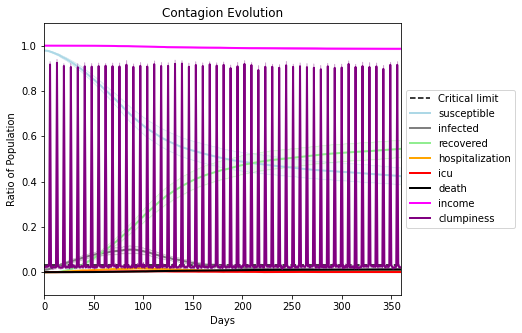

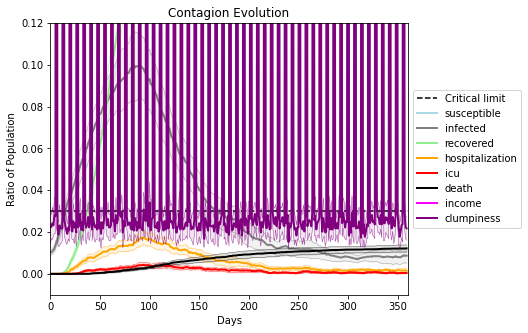

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)